In [1]:
import os
import pandas as pd
import mne  #https://mne.tools/stable/index.html
import numpy as np
import matplotlib.pyplot as plt


'''
people data load
'''

peoplelist = ['02wxw','03sf','04cmm', '06zhy','08zqh', '09hsq','10mqk','11cx','12wlz','13cxt',
              '14zyr','15yyw','17sh','19hpy','20wrq','22wf','23wh','24hc','25gyz']


for people in peoplelist:
    st = r".\EEG\ " + people +'_epoched.set'
    st = st.replace(" " , "")
    epochs=mne.io.read_epochs_eeglab(st).apply_baseline(baseline=(-1,0))
    epochs=mne.io.read_epochs_eeglab(st).set_eeg_reference('average').apply_baseline(baseline=(-0.5,0))
    globals()['subject_{}_EEG_data'.format(people)] = epochs.crop(0,3.999).get_data()


Extracting parameters from C:\Users\hyejeong\python\VREED\EEG\02wxw_epoched.set...
Not setting metadata
Not setting metadata
111 matching events found
No baseline correction applied
0 projection items activated
Ready.
Applying baseline correction (mode: mean)
Extracting parameters from C:\Users\hyejeong\python\VREED\EEG\02wxw_epoched.set...
Not setting metadata
Not setting metadata
111 matching events found
No baseline correction applied
0 projection items activated
Ready.
EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.
Applying baseline correction (mode: mean)
Extracting parameters from C:\Users\hyejeong\python\VREED\EEG\03sf_epoched.set...
Not setting metadata
Not setting metadata
108 matching events found
No baseline correction applied
0 projection items activated
Ready.
Applying baseline correction (mode: mean)
Extracting parameters from C:\Users\hyejeong\python\VREED\EEG\03sf_epoched.set...
Not setting metadata
Not set

C:\Users\hyejeong\AppData\Local\Temp/ipykernel_22420/1514282442.py:19: RuntimeWarning: Data file name in EEG.data (15yyw_filter_ICA_pruned_no1699.fdt) is incorrect, the file name must have changed on disk, using the correct file name (15yyw_epoched.fdt).
  epochs=mne.io.read_epochs_eeglab(st).apply_baseline(baseline=(-1,0))


No baseline correction applied
0 projection items activated
Ready.
Applying baseline correction (mode: mean)
Extracting parameters from C:\Users\hyejeong\python\VREED\EEG\15yyw_epoched.set...
Not setting metadata
Not setting metadata
95 matching events found


C:\Users\hyejeong\AppData\Local\Temp/ipykernel_22420/1514282442.py:20: RuntimeWarning: Data file name in EEG.data (15yyw_filter_ICA_pruned_no1699.fdt) is incorrect, the file name must have changed on disk, using the correct file name (15yyw_epoched.fdt).
  epochs=mne.io.read_epochs_eeglab(st).set_eeg_reference('average').apply_baseline(baseline=(-0.5,0))


No baseline correction applied
0 projection items activated
Ready.
EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.
Applying baseline correction (mode: mean)
Extracting parameters from C:\Users\hyejeong\python\VREED\EEG\17sh_epoched.set...
Not setting metadata
Not setting metadata
101 matching events found
No baseline correction applied
0 projection items activated
Ready.
Applying baseline correction (mode: mean)
Extracting parameters from C:\Users\hyejeong\python\VREED\EEG\17sh_epoched.set...
Not setting metadata
Not setting metadata
101 matching events found
No baseline correction applied
0 projection items activated
Ready.
EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.
Applying baseline correction (mode: mean)
Extracting parameters from C:\Users\hyejeong\python\VREED\EEG\19hpy_epoched.set...
Not setting metadata
Not setting metadata
106 matching events found


In [2]:
Positive = []
Neutral = []
Negative = []
positivevalence = []
neutralvalence = []
negativevalence = []

all_valence_data = pd.read_csv(r'.\valence\valence.txt',delimiter='\t')
for people in peoplelist:
    globals()['subject_{}_valence_data'.format(people)] = all_valence_data[all_valence_data['subject_id'] == people]['valence']
    globals()['subject_{}_valence_data'.format(people)] = globals()['subject_{}_valence_data'.format(people)].reset_index(drop=True)
    positiveind = globals()['subject_{}_valence_data'.format(people)].index[globals()['subject_{}_valence_data'.format(people)]>5].tolist()
    negativeind = globals()['subject_{}_valence_data'.format(people)].index[globals()['subject_{}_valence_data'.format(people)]<5].tolist()
    neutralind = globals()['subject_{}_valence_data'.format(people)].index[globals()['subject_{}_valence_data'.format(people)]==5].tolist()
    print('subject_{}_valence_data'.format(people), "=", len(positiveind+negativeind+neutralind))
    
    for _ in positiveind:
        Positive.append(globals()['subject_{}_EEG_data'.format(people)][_])
        positivevalence.append(globals()['subject_{}_valence_data'.format(people)][_])
    for _ in neutralind:
        Neutral.append(globals()['subject_{}_EEG_data'.format(people)][_])
        neutralvalence.append(globals()['subject_{}_valence_data'.format(people)][_])
    for _ in negativeind:
        Negative.append(globals()['subject_{}_EEG_data'.format(people)][_])
        negativevalence.append(globals()['subject_{}_valence_data'.format(people)][_])

subject_02wxw_valence_data = 111
subject_03sf_valence_data = 108
subject_04cmm_valence_data = 100
subject_06zhy_valence_data = 91
subject_08zqh_valence_data = 113
subject_09hsq_valence_data = 106
subject_10mqk_valence_data = 116
subject_11cx_valence_data = 113
subject_12wlz_valence_data = 116
subject_13cxt_valence_data = 112
subject_14zyr_valence_data = 120
subject_15yyw_valence_data = 95
subject_17sh_valence_data = 101
subject_19hpy_valence_data = 106
subject_20wrq_valence_data = 108
subject_22wf_valence_data = 114
subject_23wh_valence_data = 91
subject_24hc_valence_data = 109
subject_25gyz_valence_data = 113


In [3]:
from scipy.signal import butter
#video1[0]
import matplotlib.pyplot as plt
import numpy as np
from scipy import signal
import pywt
ch_names = epochs.info.ch_names
#ch_names

In [4]:
positive = np.array(Positive)
negative = np.array(Negative)
neutral = np.array(Neutral)

print(positive.shape)
print(negative.shape)
print(neutral.shape)

print("Positive length is ",positive.shape[0])
print("Negative length is ",negative.shape[0])
print("Neutral length is ", neutral.shape[0])
print("Total length is ",negative.shape[0]+positive.shape[0]+neutral.shape[0] )

(708, 59, 4000)
(696, 59, 4000)
(639, 59, 4000)
Positive length is  708
Negative length is  696
Neutral length is  639
Total length is  2043


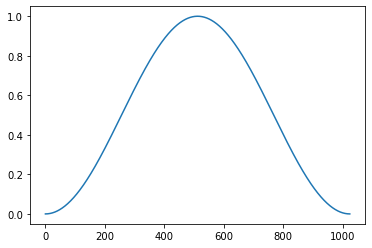

In [5]:

'''
plot the window 

'''
from scipy import signal
window = signal.windows.hann(1024)
plt.plot(window)

In [6]:
positive_filter_EEG = np.array(np.array(Positive))
negative_filter_EEG = np.array(np.array(Negative))
neutral_filter_EEG = np.array(np.array(Neutral))

In [32]:
import time
from datetime import datetime

current_time = datetime.now()
print(current_time)

start = time.time()

'''
delta = [0, 2] #index값 0,1.95,3.9 
theta = [3, 4] #5.85, 7.81
alpha = [5, 6] #9.76,11.71
beta = [7, 15] #13.67, 29.29
gamma = [16, 25] #31.25 48.82
high gamma = [52, 83] # 50.78125 80.078125

'''
bandfreq = [[0,5,'delta'],[5,9,'theta'],[9,15,'alpha'],[15,32,'beta'],[32,52,'gamma'],[52,83,'highgamma']]
Valence = [['positive',708],['negative',696],['neutral',639]]


for val in Valence: #positive, negative, neutral
    for band in bandfreq: #delta, theta, alpha, beta, gamma
        globals()['{}_{}_coh_matrixs'.format(val[0], band[2])]=[]
        for i in range(val[1]):
            globals()['{}_{}_cohmat'.format(val[0],band[2])] = [] # 59*59
            for c in range(chan_len):
                globals()['{}_coh'.format(val[0])] =[] # 1*59
                for j in range(chan_len):
                    _, coh = signal.coherence(globals()['{}_filter_EEG'.format(val[0])][i][c],globals()['{}_filter_EEG'.format(val[0])][i][j],fs =1000,window=window)
                    cohb = np.mean(coh[band[0]:band[1]])
                    globals()['{}_coh'.format(val[0])].append(cohb)
                globals()['{}_{}_cohmat'.format(val[0],band[2])].append(globals()['{}_coh'.format(val[0])])
            globals()['{}_{}_coh_matrixs'.format(val[0], band[2])].append(globals()['{}_{}_cohmat'.format(val[0],band[2])])
        print('{}_{}_completed!'.format(val[0], band[2]))

        
        
print("time :", ((time.time() - start)/60)/60 ,"hours")
current_time = datetime.now()
print(current_time)

2022-06-06 22:06:09.077246
positive_delta_completed!
positive_theta_completed!
positive_alpha_completed!
positive_beta_completed!
positive_gamma_completed!
positive_highgamma_completed!
negative_delta_completed!
negative_theta_completed!
negative_alpha_completed!
negative_beta_completed!
negative_gamma_completed!
negative_highgamma_completed!
neutral_delta_completed!
neutral_theta_completed!
neutral_alpha_completed!
neutral_beta_completed!
neutral_gamma_completed!
neutral_highgamma_completed!
time : 4.127441903352738 hours
2022-06-07 02:13:47.883746


In [34]:
'''
소수점 버림
'''
for val in Valence: #positive, negative, neutral
    for band in bandfreq: #delta, theta, alpha, beta, gamma
        globals()['{}_{}_coh_matrixs'.format(val[0], band[2])] = np.round(globals()['{}_{}_coh_matrixs'.format(val[0], band[2])],3) 
        np.fill_diagonal(globals()['{}_{}_coh_matrixs'.format(val[0], band[2])][i] ,0)

In [35]:
for val in Valence: #positive, negative, neutral
    for band in bandfreq: #delta, theta, alpha, beta, gamma
         globals()['{}_{}_EEG'.format(val[0], band[2])] = np.array(globals()['{}_{}_coh_matrixs'.format(val[0], band[2])])

for fr in bandfreq:
    for num in range(positive_delta_EEG.shape[0]): # Positive Length:
        np.fill_diagonal(globals()['positive_{}_EEG'.format(fr[2])][num],0)
    for num in range(negative_delta_EEG.shape[0]): # Negative Length:
        np.fill_diagonal(globals()['negative_{}_EEG'.format(fr[2])][num],0)
    for num in range(neutral_delta_EEG.shape[0]): # Neutral Length:
        np.fill_diagonal(globals()['neutral_{}_EEG'.format(fr[2])][num],0)

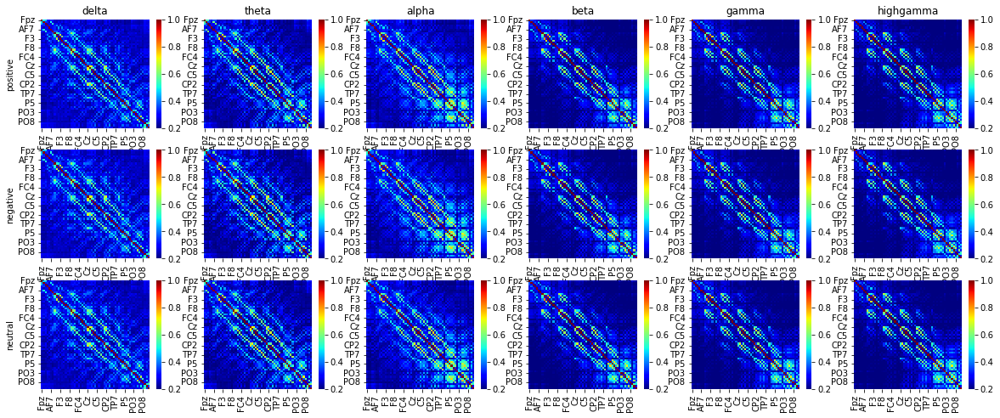

In [36]:
'''
Plotting subject mean coherence matrix
'''
bandfreq = [[0,5,'delta'],[5,9,'theta'],[9,15,'alpha'],[15,32,'beta'],[32,52,'gamma'],[52,83,'highgamma']]
Valence = [['positive',708],['negative',696],['neutral',639]]
for val in Valence:
    for band in bandfreq:
        globals()['{}_{}_mean_matrix'.format(val[0], band[2])] = np.mean(np.array(globals()['{}_{}_coh_matrixs'.format(val[0], band[2])]),axis=0)
import seaborn as sns
fig, axes = plt.subplots(3,6,figsize=(20,8))

for i, val in enumerate(Valence):
    for q, band in enumerate(bandfreq):
        a= pd.DataFrame(globals()['{}_{}_mean_matrix'.format(val[0], band[2])], columns = ch_names, index = ch_names)
        sns.heatmap(a,cmap='jet',ax = axes[i][q],vmin=0.2,vmax=1)
        if i == 0:
            axes[i][q].set_title(band[2])
        if q ==0:
            axes[i][q].set_ylabel(val[0])
#plt.savefig("Mean coherence map", dpi = 600)

In [37]:

import brainconn as bc
'''
positive_delta_EEG
example.
we use cij 
cij , _ = bc.utils.visualization.backbone_wu(positive_alpha_EEG[13],3)
'''
bandfreq = [[0,5,'delta'],[5,9,'theta'],[9,15,'alpha'],[15,32,'beta'],[32,52,'gamma'],[52,83,'highgamma']]
Valence = [['positive',708],['negative',696],['neutral',639]]
current_time = datetime.now()
print(current_time)
start = time.time()

for fr in bandfreq:
    for num in range(globals()['positive_{}_EEG'.format(fr[2])].shape[0]): # Positive Length:
        _, globals()['Positive_{}_{}_corrcoef_Matrix_binarize'.format(fr[2], num)] = bc.utils.visualization.backbone_wu(globals()['positive_{}_EEG'.format(fr[2])][num], 5)
    for num in range(globals()['negative_{}_EEG'.format(fr[2])].shape[0]): # Negative Length:
        _, globals()['Negative_{}_{}_corrcoef_Matrix_binarize'.format(fr[2],num)]= bc.utils.visualization.backbone_wu(globals()['negative_{}_EEG'.format(fr[2])][num], 5)
    for num in range(globals()['neutral_{}_EEG'.format(fr[2])].shape[0]): # Neutral Length:
        _, globals()['Neutral_{}_{}_corrcoef_Matrix_binarize'.format(fr[2],num)]= bc.utils.visualization.backbone_wu(globals()['neutral_{}_EEG'.format(fr[2])][num], 5)
print("time :", ((time.time() - start)/60)/60 ,"hours")
current_time = datetime.now()
print(current_time)

2022-06-07 09:56:15.935987
[1] [18]
[2] [28]
[3] [35]
[4] [41]
[5] [47]
[3] [44]
[7] [29]
[8] [35]
[8] [21]
[10] [19]
[10] [8]
[12] [7]
[7] [39]
[14] [34]
[11] [8]
[4] [32]
[12] [3]
[17] [26]
[19] [20]
[20] [18]
[21] [12]
[21] [15]
[23] [20]
[23] [10]
[25] [10]
[23] [13]
[27] [13]
[28] [16]
[28] [13]
[30] [15]
[30] [11]
[27] [13]
[26] [9]
[32] [10]
[35] [11]
[35] [10]
[36] [8]
[35] [6]
[24] [1]
[40] [3]
[40] [0]
[28] [1]
[42] [14]
[44] [12]
[45] [8]
[42] [11]
[28] [3]
[33] [3]
[33] [8]
[50] [5]
[33] [3]
[42] [0]
[32] [1]
[28] [2]
[47] [2]
[16] [1]
[50] [0]
[1] [9]
[2] [20]
[3] [28]
[4] [26]
[5] [18]
[3] [11]
[5] [27]
[8] [19]
[7] [14]
[10] [10]
[10] [11]
[10] [17]
[12] [11]
[14] [15]
[15] [19]
[4] [14]
[17] [8]
[17] [16]
[19] [21]
[20] [19]
[21] [15]
[22] [12]
[23] [3]
[21] [25]
[25] [26]
[26] [20]
[27] [21]
[25] [24]
[29] [20]
[28] [23]
[2 3] [6 6]
[26] [17]
[20] [18]
[34] [20]
[22] [11]
[36] [12]
[37] [15]
[2] [12]
[39] [11]
[40] [10]
[36] [0]
[42] [0]
[43] [2]
[38] [6]
[30] [11]
[46

[12] [13]
[16] [18]
[17] [22]
[17] [16]
[18 19] [16  4]
[20] [4]
[20] [11]
[22] [10]
[20] [16]
[13] [0]
[25] [0]
[25] [1]
[3] [2]
[28] [8]
[28] [10]
[30] [12]
[31] [11]
[32] [9]
[31] [17]
[34] [18]
[31] [16]
[36] [20]
[17] [8]
[38] [8]
[29] [7]
[13] [0]
[10] [16]
[42] [8]
[43] [9]
[44] [12]
[29] [1]
[44] [10]
[47] [7]
[48] [8]
[47] [6]
[22 29] [3 5]
[29] [4]
[16] [3]
[22] [0]
[46] [0]
[45] [1]
[56] [1]
[51] [0]
[1] [18]
[1] [27]
[3] [34]
[4] [32]
[5] [37]
[3] [25]
[4] [37]
[8] [43]
[9] [41]
[6] [29]
[11] [23]
[8] [36]
[13] [26]
[14] [18]
[15] [19]
[16] [11]
[3] [27]
[13] [35]
[18] [15]
[20] [19]
[21] [22]
[22] [18]
[20] [13]
[22] [20]
[25] [23]
[26] [23]
[27] [26]
[25] [17]
[29] [19]
[30] [17]
[26] [25]
[24] [7]
[19] [21]
[17] [8]
[31] [13]
[24] [11]
[37] [2]
[38] [5]
[37] [5]
[40] [5]
[41] [7]
[30] [9]
[43] [8]
[43] [9]
[11] [8]
[39] [5]
[40] [5]
[45] [7]
[34 45] [6 2]
[45] [2]
[12] [0]
[52] [4]
[53] [4]
[52] [0]
[55] [1]
[11] [1]
[42] [0]
[1] [18]
[2] [1]
[3] [4]
[3] [0]
[5] [0]
[3] 

[32] [22]
[33] [20]
[34] [14]
[35] [11]
[33] [16]
[37] [12]
[38] [10]
[39] [6]
[32] [11]
[36] [6]
[30] [7]
[26] [11]
[38] [12]
[44] [10]
[4] [6]
[47] [5]
[48] [2]
[31] [6]
[44] [5]
[15] [3]
[25] [3]
[21] [0]
[46] [2]
[55] [2]
[7] [0]
[45] [0]
[1] [18]
[2] [1]
[0] [34]
[4] [26]
[4] [31]
[5] [17]
[7] [18]
[8] [25]
[9] [30]
[7] [10]
[11] [4]
[6] [20]
[9] [33]
[14] [39]
[ 9 10] [17 12]
[16] [23]
[17] [18]
[18] [13]
[17] [21]
[20] [17]
[21] [17]
[20] [19]
[10] [12]
[24] [5]
[25] [9]
[26] [5]
[27] [2]
[28] [5]
[27] [9]
[25] [6]
[28] [7]
[20] [13]
[33] [14]
[34] [19]
[16] [9]
[36] [7]
[33] [15]
[38] [13]
[29] [6]
[38] [8]
[23] [0]
[27] [0]
[33] [13]
[44] [12]
[45] [12]
[30] [4]
[47] [4]
[48] [6]
[38] [0]
[50] [1]
[26 28] [1 1]
[49] [3]
[53] [3]
[53] [2]
[55] [1]
[49] [1]
[43] [0]
[1] [16]
[2] [24]
[3] [31]
[3] [25]
[4] [22]
[5] [30]
[7] [31]
[8] [25]
[9] [19]
[10] [20]
[11] [24]
[12] [28]
[13] [36]
[14] [31]
[15] [36]
[15] [29]
[15] [31]
[17] [26]
[19] [25]
[19] [22]
[21] [21]
[21] [21]
[23] 

[24] [20]
[27] [25]
[31] [21]
[32] [17]
[11] [8]
[34] [10]
[34] [10]
[30] [18]
[36] [12]
[38] [13]
[1] [12]
[16] [6]
[41] [6]
[21 26] [12  8]
[26] [8]
[20] [2]
[45] [4]
[46] [5]
[1] [7]
[28 40] [0 1]
[40] [0]
[34] [1]
[29] [3]
[44] [3]
[0] [4]
[54] [3]
[34] [2]
[47] [0]
[38] [0]
[1] [7]
[2] [9]
[3] [10]
[4] [5]
[2] [12]
[6] [18]
[7] [18]
[7] [18]
[8] [24]
[10] [18]
[11] [12]
[7] [22]
[2] [15]
[13] [16]
[15] [41]
[16] [38]
[17] [31]
[17] [35]
[16] [21]
[14] [18]
[21] [22]
[17] [27]
[23] [21]
[24] [21]
[25] [18]
[19] [23]
[27] [28]
[28] [27]
[29] [19]
[10] [1]
[21 24] [12 16]
[24] [15]
[18] [16]
[34] [21]
[35] [19]
[19] [19]
[3] [11]
[7] [9]
[22] [15]
[7] [9]
[12] [5]
[42] [5]
[36] [0]
[44] [2]
[30] [7]
[14] [6]
[25] [8]
[4] [7]
[35] [0]
[50] [1]
[51] [2]
[16] [0]
[10] [2]
[12] [0]
[14] [2]
[31] [1]
[44] [0]
[0] [38]
[2] [19]
[3] [29]
[3] [20]
[5] [10]
[6] [11]
[7] [14]
[8] [20]
[9] [12]
[10] [17]
[11] [17]
[12] [22]
[13] [17]
[14] [13]
[0] [7]
[16] [7]
[11] [29]
[18] [35]
[19] [37]
[20]

[9] [12]
[23] [9]
[15] [3]
[21] [8]
[4] [8]
[23] [4]
[28] [5]
[24] [9]
[25] [4]
[31] [1]
[32] [1]
[6] [6]
[34] [8]
[34] [3]
[12] [9]
[16] [8]
[38] [9]
[12] [2]
[23] [2]
[25] [14]
[42] [14]
[43] [12]
[0] [2]
[38] [3]
[31] [1]
[15] [5]
[8] [8]
[49] [8]
[50] [0]
[48] [5]
[19] [3]
[37] [4]
[54] [3]
[52] [0]
[17] [0]
[57] [0]
[0] [25]
[2] [32]
[1] [25]
[0] [24]
[5] [7]
[6] [7]
[3] [27]
[8] [25]
[1] [6]
[10] [14]
[3] [31]
[12] [24]
[2] [34]
[14] [28]
[12] [20]
[16] [15]
[16] [2]
[6] [13]
[19] [12]
[6] [5]
[5] [10]
[4] [13]
[2 8] [ 8 20]
[8] [19]
[25] [19]
[25] [22]
[26] [26]
[25] [17]
[2] [11]
[ 2 13] [22 25]
[13] [24]
[23] [8]
[4] [12]
[25] [17]
[34] [18]
[16 34] [19 14]
[34] [14]
[14] [15]
[34 39] [ 9 16]
[39] [15]
[28] [15]
[4] [11]
[43] [9]
[32] [13]
[34] [9]
[46] [9]
[47] [9]
[7] [5]
[27] [8]
[27] [1]
[51] [0]
[51] [0]
[52] [0]
[16 17] [2 2]
[24] [1]
[55] [0]
[32] [0]
[0] [25]
[0] [32]
[3] [39]
[3] [51]
[0] [38]
[1] [25]
[0] [17]
[7] [31]
[5] [47]
[6] [34]
[4 4] [30 31]
[12] [24]
[13] [

[19] [17]
[2] [30]
[21] [28]
[22] [33]
[20] [10]
[24] [14]
[24] [13]
[10] [16]
[27] [13]
[27] [10]
[29] [11]
[5] [24]
[31] [22]
[32] [17]
[33] [18]
[3] [14]
[29] [11]
[36] [9]
[12] [11]
[6] [6]
[14 37] [1 4]
[37] [3]
[24] [1]
[27] [9]
[43] [11]
[43] [8]
[22] [0]
[42] [0]
[47] [3]
[44] [7]
[47] [2]
[8] [1]
[41] [6]
[35] [1]
[31] [2]
[42] [3]
[49] [1]
[56] [1]
[56] [0]
[0] [4]
[2] [53]
[3] [46]
[4] [46]
[5] [13]
[6] [6]
[6] [13]
[5] [44]
[9] [45]
[9] [39]
[9] [39]
[12] [42]
[12] [40]
[14] [41]
[15] [22]
[16] [20]
[16] [26]
[17] [19]
[19] [32]
[16] [21]
[21] [15]
[22] [16]
[20] [22]
[24] [17]
[13] [21]
[17] [25]
[27] [20]
[28] [22]
[29] [7]
[30] [5]
[17] [10]
[30] [5]
[20 24] [ 8 12]
[34] [18]
[24] [11]
[23] [13]
[37] [7]
[14] [19]
[31] [2]
[31] [0]
[41] [0]
[42] [1]
[24] [11]
[44] [8]
[10] [11]
[21] [8]
[33] [0]
[48] [0]
[49] [8]
[22] [6]
[19] [6]
[35] [3]
[4] [4]
[47] [1]
[41] [2]
[56] [1]
[16] [0]
[0] [45]
[1] [39]
[3] [10]
[3] [28]
[5] [35]
[5] [26]
[7] [24]
[8] [36]
[8] [31]
[8] [24]

[41] [2]
[11] [2]
[34] [1]
[43] [0]
[0] [37]
[2] [43]
[3] [38]
[4] [33]
[5] [24]
[5] [37]
[7] [40]
[8] [41]
[7] [8]
[10] [6]
[5] [15]
[12] [22]
[13] [21]
[14] [21]
[12] [21]
[16] [25]
[17] [29]
[15] [25]
[5] [13]
[11] [2]
[10] [7]
[22] [8]
[23] [17]
[22] [14]
[25] [16]
[25] [15]
[26] [7]
[28] [6]
[29] [3]
[30] [5]
[18] [12]
[7] [23]
[33] [23]
[21] [2]
[35] [1]
[36] [1]
[10] [1]
[21] [0]
[9] [10]
[40] [10]
[40] [8]
[42] [7]
[43] [13]
[23] [6]
[19] [7]
[26] [5]
[27] [0]
[ 8 48] [8 0]
[48] [0]
[13] [7]
[24] [2]
[33] [3]
[25] [0]
[13] [0]
[42] [2]
[56] [1]
[54] [0]
[1] [21]
[2] [19]
[3] [26]
[2] [27]
[4] [4]
[2] [11]
[3] [16]
[4] [21]
[9] [38]
[9] [15]
[9] [18]
[12] [13]
[12] [16]
[14] [21]
[15] [16]
[10] [37]
[17] [35]
[14] [26]
[10] [25]
[20] [18]
[4] [22]
[22] [17]
[5] [16]
[24] [18]
[ 5 10] [18 29]
[26] [21]
[10] [27]
[21] [19]
[28] [25]
[30] [20]
[31] [19]
[12] [16]
[26] [18]
[21] [15]
[4] [19]
[19] [14]
[ 7 13] [ 6 12]
[13] [11]
[5] [17]
[40] [13]
[ 3 35] [ 7 12]
[42] [7]
[43] [4]
[3

[28] [25]
[29] [23]
[30] [20]
[9] [15]
[19] [7]
[19] [22]
[6] [18]
[35] [20]
[35] [19]
[6] [16]
[38] [17]
[15] [14]
[40] [13]
[41] [9]
[12] [10]
[31] [0]
[44] [1]
[7] [10]
[46] [3]
[47] [0]
[47] [8]
[28] [4]
[11] [6]
[25] [2]
[10] [5]
[17] [4]
[54] [2]
[28] [0]
[55] [0]
[31] [0]
[1] [11]
[0] [51]
[3] [49]
[4] [47]
[4] [42]
[3] [14]
[7] [42]
[8] [34]
[9] [26]
[9] [31]
[11] [39]
[12] [34]
[13] [32]
[14] [28]
[13] [18]
[14] [25]
[14 15] [28 34]
[15] [33]
[14] [34]
[20] [32]
[20] [23]
[22] [15]
[13] [9]
[18] [24]
[25] [18]
[25] [19]
[26] [23]
[28] [21]
[26] [13]
[26] [20]
[27] [18]
[25] [6]
[33] [2]
[27] [0]
[26] [12]
[25] [10]
[35] [9]
[38] [4]
[39] [4]
[38] [14]
[40] [5]
[6] [5]
[10] [10]
[12] [0]
[22] [4]
[21] [9]
[24] [3]
[16] [8]
[14] [3]
[49] [0]
[11] [2]
[47] [1]
[39] [3]
[54] [0]
[55] [2]
[34] [0]
[12] [0]
[1] [26]
[2] [18]
[2] [33]
[0] [24]
[5] [30]
[2] [16]
[7] [7]
[2] [0]
[9] [0]
[9] [21]
[0] [3]
[3] [14]
[13] [9]
[14] [7]
[15] [5]
[8] [4]
[16] [19]
[18] [15]
[18] [18]
[20] [24]

[33] [0]
[39] [1]
[47] [0]
[0] [9]
[2] [19]
[3] [40]
[4] [33]
[4] [34]
[6] [35]
[7] [9]
[4] [37]
[9] [43]
[3] [16]
[0] [24]
[12] [30]
[13] [29]
[11] [23]
[11] [10]
[11] [20]
[17] [25]
[17] [18]
[19] [18]
[19] [22]
[19] [23]
[17] [11]
[20] [13]
[24] [16]
[25] [20]
[16] [13]
[16] [28]
[19] [0]
[15] [15]
[30] [24]
[31] [23]
[32] [17]
[24] [1]
[34] [4]
[3] [1]
[36] [20]
[13] [14]
[23] [3]
[23] [7]
[8 9] [11 14]
[41] [4]
[9] [12]
[43] [10]
[40] [0]
[16] [11]
[5] [7]
[14] [7]
[24] [2]
[46] [7]
[25] [7]
[42] [2]
[30] [3]
[52] [1]
[54] [2]
[35] [0]
[40] [0]
[23] [0]
[1] [15]
[2] [6]
[3] [12]
[4] [19]
[5] [27]
[5] [17]
[7] [10]
[3] [18]
[2] [11]
[10] [6]
[10] [15]
[12] [15]
[13] [21]
[7] [24]
[15] [18]
[7] [24]
[9] [19]
[12] [23]
[13] [10]
[20] [6]
[8] [9]
[22] [2]
[15] [24]
[24] [15]
[20] [7]
[24] [28]
[20] [9]
[20] [12]
[29] [14]
[30] [18]
[31] [13]
[32] [21]
[33] [16]
[30] [15]
[25] [13]
[26] [13]
[7] [14]
[38] [13]
[22] [9]
[16 21] [13  5]
[21] [5]
[42] [3]
[42] [5]
[44] [3]
[45] [1]
[43] [

[26] [1]
[16 37] [11  0]
[37] [0]
[33] [10]
[24] [6]
[49] [5]
[49] [6]
[50] [1]
[52] [1]
[39] [4]
[24] [3]
[33] [1]
[40] [0]
[48] [0]
[0] [42]
[2] [34]
[3] [26]
[3] [25]
[5] [16]
[5] [24]
[7] [17]
[7] [29]
[5] [16]
[10] [15]
[11] [20]
[12] [18]
[13] [13]
[11] [6]
[13] [22]
[13] [7]
[17] [8]
[11] [6]
[17] [10]
[2] [30]
[7] [12]
[ 8 22] [ 6 16]
[22] [15]
[24] [19]
[24] [24]
[26] [17]
[24] [10]
[28] [12]
[24] [18]
[13] [3]
[16] [15]
[32] [18]
[33] [17]
[34] [14]
[15] [11]
[4] [2]
[11] [1]
[25] [13]
[39] [12]
[30] [13]
[20] [7]
[29] [9]
[43] [7]
[43] [5]
[44] [5]
[46] [3]
[23] [1]
[35] [1]
[37] [2]
[33] [4]
[51] [3]
[52] [5]
[53] [3]
[43] [1]
[50] [1]
[8] [0]
[0] [0]
[0] [42]
[2] [34]
[2] [15]
[4] [23]
[5] [21]
[5] [30]
[4] [6]
[3] [22]
[9] [21]
[10] [14]
[10] [26]
[12] [20]
[11] [15]
[12] [25]
[15] [30]
[15] [20]
[15] [25]
[18] [29]
[11] [6]
[20] [21]
[14] [7]
[22] [8]
[20] [15]
[21 24] [20 10]
[25] [23]
[26] [19]
[24] [10]
[24] [13]
[4] [9]
[28] [5]
[6] [5]
[32] [5]
[29] [10]
[11] [6]
[3

[19 25] [11 26]
[32] [10]
[33] [17]
[25] [23]
[35] [21]
[4] [17]
[20 28] [7 7]
[3] [17]
[17] [7]
[0] [3]
[38] [7]
[32] [9]
[43] [10]
[44] [9]
[44] [9]
[45] [8]
[3] [8]
[40] [7]
[31] [7]
[20 23] [6 3]
[23] [3]
[50] [1]
[10 13 17] [2 2 2]
[31] [0]
[35] [2]
[38] [0]
[57] [0]
[0] [50]
[0] [31]
[3] [32]
[4] [24]
[4] [38]
[6] [44]
[5] [15]
[8] [13]
[8] [28]
[10] [21]
[11] [26]
[11] [13]
[13] [12]
[13] [14]
[15] [12]
[16] [12]
[16] [7]
[18] [8]
[16] [16]
[20] [14]
[21] [14]
[22] [16]
[23] [16]
[24] [17]
[20] [15]
[23] [15]
[27] [19]
[27] [14]
[13] [7]
[6] [14]
[31] [18]
[32] [16]
[19] [8]
[14] [10]
[35] [11]
[5] [10]
[12] [10]
[10] [14]
[30] [7]
[15] [8]
[19] [4]
[28] [12]
[43] [11]
[35] [4]
[17] [1]
[46] [3]
[39] [7]
[8] [6]
[46] [0]
[5] [1]
[28] [3]
[3] [0]
[25] [3]
[25] [2]
[55] [2]
[37] [0]
[1] [0]
[1] [37]
[2] [29]
[3] [27]
[4] [18]
[4] [32]
[5] [5]
[4] [24]
[8] [23]
[3] [18]
[5] [15]
[11] [15]
[9] [18]
[13] [22]
[13] [14]
[15] [12]
[6] [25]
[8] [21]
[18] [17]
[19] [20]
[12] [7]
[12] [11

[49] [2]
[25] [3]
[3] [3]
[33] [5]
[53] [3]
[49] [2]
[19] [1]
[49] [1]
[11] [0]
[0] [50]
[2] [39]
[3] [31]
[4] [32]
[5] [24]
[5] [37]
[7] [15]
[8] [13]
[8] [21]
[10] [27]
[1] [36]
[11] [26]
[13] [19]
[8] [8]
[15] [14]
[15] [9]
[16] [12]
[18] [7]
[19] [7]
[20] [4]
[19] [5]
[16] [13]
[23] [16]
[24] [17]
[25] [21]
[16 20] [9 8]
[27] [13]
[20] [8]
[29] [4]
[26] [20]
[29] [4]
[24] [15]
[32] [6]
[34] [9]
[35] [10]
[36] [8]
[37] [8]
[32] [9]
[22] [2]
[12] [7]
[41] [7]
[42] [7]
[43] [10]
[44] [10]
[11] [9]
[9] [5]
[30] [5]
[40] [8]
[16] [4]
[25] [7]
[51] [6]
[48] [2]
[46] [3]
[29] [1]
[14] [1]
[27] [0]
[2] [0]
[1] [51]
[2] [52]
[1] [46]
[4] [41]
[5] [33]
[6] [24]
[5] [43]
[8] [43]
[5] [37]
[10] [30]
[8] [44]
[12] [45]
[12] [44]
[11] [8]
[15] [7]
[16] [14]
[17] [7]
[18] [4]
[18] [13]
[20] [20]
[21] [21]
[22] [26]
[22] [14]
[21] [23]
[25] [26]
[26] [22]
[27] [18]
[17] [12]
[20 25] [8 8]
[30] [9]
[31] [13]
[32] [16]
[32] [15]
[33] [21]
[25] [20]
[36] [13]
[15] [9]
[38] [8]
[33] [13]
[24] [7]
[37]

[32] [1]
[44] [3]
[45] [3]
[46] [4]
[45] [3]
[45] [8]
[24] [3]
[5] [0]
[51] [5]
[18] [3]
[30] [0]
[7] [0]
[7] [2]
[14] [1]
[56] [0]
[0] [15]
[2] [14]
[2] [6]
[4] [5]
[4] [6]
[3] [11]
[2] [11]
[8] [17]
[9] [16]
[10] [23]
[10] [30]
[12] [23]
[11] [23]
[11] [28]
[15] [42]
[10] [16]
[11] [39]
[16] [28]
[13] [27]
[20] [14]
[16] [35]
[20] [24]
[23] [26]
[24] [16]
[20] [31]
[26] [29]
[15] [14]
[28] [10]
[29] [8]
[29] [8]
[21] [14]
[32] [12]
[27] [23]
[34] [18]
[7] [0]
[2] [10]
[19] [7]
[17] [3]
[39] [0]
[9] [7]
[32] [9]
[24] [8]
[39] [14]
[19] [6]
[13] [6]
[25] [0]
[14] [7]
[16 23] [8 9]
[23] [8]
[7] [1]
[51] [1]
[12] [4]
[28] [1]
[0] [0]
[33] [0]
[47] [0]
[54] [0]
[1] [45]
[1 2] [52 52]
[0] [46]
[2] [30]
[5] [31]
[5] [41]
[7] [32]
[7] [31]
[9] [44]
[10] [44]
[11] [40]
[7] [41]
[13] [35]
[14] [39]
[12] [17]
[16] [22]
[10] [28]
[13] [20]
[19] [18]
[12] [34]
[10] [33]
[16] [15]
[23] [14]
[10] [32]
[14] [6]
[26] [2]
[5] [16]
[27] [23]
[29] [13]
[29] [20]
[31] [16]
[32] [23]
[33] [19]
[34] [17]
[

[29] [4]
[34] [5]
[34] [1]
[36] [1]
[37] [2]
[38] [1]
[39] [0]
[39] [0]
[41] [1]
[32] [1]
[21 23] [3 3]
[16] [11]
[45] [11]
[46] [6]
[47] [10]
[3] [5]
[48] [5]
[47] [3]
[36] [0]
[47] [0]
[9] [0]
[10] [3]
[ 6 51] [2 2]
[51] [0]
[10] [0]
[0] [51]
[0] [28]
[1] [47]
[4] [46]
[4] [40]
[4] [46]
[7] [46]
[8] [30]
[9] [28]
[10] [34]
[11] [39]
[11] [20]
[13] [0]
[14] [4]
[15] [0]
[16] [40]
[13] [0]
[18] [2]
[13] [25]
[20] [11]
[21] [2]
[22] [9]
[21] [9]
[21] [9]
[24] [25]
[26] [16]
[26] [14]
[25] [3]
[25] [7]
[30] [10]
[28] [11]
[27] [9]
[29] [4]
[13 24] [ 6 19]
[24] [18]
[36] [15]
[37] [9]
[38] [8]
[6] [8]
[23] [7]
[23] [5]
[35] [3]
[23] [4]
[11] [4]
[20] [11]
[46] [11]
[26] [10]
[48] [8]
[49] [5]
[1] [3]
[24] [2]
[0] [1]
[53] [0]
[2] [0]
[39] [2]
[26] [1]
[41] [0]
[0] [51]
[0] [43]
[3] [19]
[4] [17]
[5] [16]
[6] [7]
[7] [9]
[7] [7]
[7] [5]
[10] [1]
[11] [0]
[12] [0]
[13] [2]
[13] [41]
[15] [14]
[16] [30]
[17] [22]
[16] [14]
[6] [8]
[20] [13]
[21] [19]
[15] [35]
[10] [2]
[20] [7]
[25] [12]
[26

[7] [17]
[12 30] [15  2]
[30] [2]
[37] [3]
[38] [19]
[38] [3]
[16] [7]
[6] [12]
[2] [2]
[43] [1]
[26] [7]
[26 37] [12  0]
[46] [11]
[37] [0]
[26] [1]
[49] [2]
[0] [5]
[15] [2]
[52] [3]
[18] [4]
[14] [3]
[40] [0]
[37 47] [1 1]
[50] [0]
[0] [8]
[1] [16]
[3] [24]
[4] [31]
[5] [5]
[6] [15]
[7] [32]
[7] [22]
[9] [14]
[10] [13]
[7] [34]
[8] [27]
[13] [20]
[11] [17]
[15] [22]
[16] [17]
[16] [21]
[18] [24]
[18] [17]
[18] [20]
[21] [23]
[7] [18]
[21] [3]
[13] [8]
[25] [11]
[26] [6]
[27] [5]
[27] [7]
[9] [11]
[30] [8]
[31] [25]
[30] [24]
[22] [15]
[34] [21]
[22] [14]
[36] [18]
[9] [0]
[17] [13]
[39] [17]
[39] [11]
[27] [14]
[42] [12]
[27] [4]
[33] [4]
[42] [2]
[6] [0]
[5] [10]
[32] [6]
[29] [3]
[36] [6]
[13] [6]
[41] [5]
[41] [2]
[54] [1]
[55] [0]
[2] [0]
[57] [0]
[0] [22]
[1] [37]
[0] [23]
[1] [29]
[3] [40]
[6] [40]
[7] [39]
[7] [44]
[7] [38]
[10] [33]
[11] [27]
[12] [40]
[12] [18]
[14] [24]
[14] [16]
[16] [27]
[17] [21]
[18] [15]
[18] [20]
[20] [23]
[20] [20]
[22] [22]
[22] [16]
[22] [21]
[25]

[41] [16]
[39] [14]
[20] [3]
[25] [13]
[11] [4]
[41] [3]
[24] [5]
[33] [3]
[29] [8]
[50] [5]
[51] [4]
[52] [3]
[50] [3]
[37] [3]
[14] [1]
[56] [1]
[57] [0]
[1] [19]
[1] [34]
[1] [5]
[3] [24]
[3] [51]
[5] [15]
[7] [21]
[8] [28]
[8] [27]
[8] [32]
[2] [36]
[12] [42]
[3] [43]
[14] [43]
[2] [3]
[9] [32]
[13] [28]
[18] [23]
[19] [17]
[20] [11]
[21] [9]
[18] [33]
[13 19] [28 25]
[19] [25]
[25] [21]
[26] [16]
[7 9] [22 10]
[9] [10]
[29] [14]
[30] [17]
[21 22] [1 1]
[32] [1]
[33] [0]
[26] [19]
[7] [2]
[36] [9]
[37] [5]
[8] [8]
[39] [6]
[40] [4]
[40] [5]
[21] [4]
[17] [12]
[39] [1]
[45] [0]
[43] [6]
[36] [1]
[28] [2]
[49] [4]
[50] [3]
[41] [0]
[45] [5]
[53] [2]
[54] [2]
[53] [0]
[27] [0]
[48] [0]
[0] [17]
[2] [25]
[3] [4]
[1] [7]
[3] [24]
[6] [31]
[7] [32]
[8] [18]
[8] [24]
[10] [36]
[11] [34]
[6 6] [16 27]
[13] [8]
[6] [25]
[9] [10]
[16] [8]
[16] [10]
[18] [4]
[18] [9]
[20] [15]
[21] [19]
[22] [23]
[22] [18]
[24] [20]
[24] [14]
[26] [12]
[27] [8]
[28] [10]
[28] [7]
[15] [27]
[20] [5]
[32] [5]
[

[6] [22]
[13] [13]
[13] [21]
[15] [14]
[16] [21]
[16] [8]
[16] [5]
[17] [8]
[17] [14]
[21] [0]
[21] [7]
[2] [29]
[17] [10]
[21] [15]
[26] [16]
[27] [12]
[28] [7]
[10] [10]
[14] [14]
[27] [16]
[32] [17]
[33] [21]
[34] [20]
[25] [2]
[3] [18]
[9] [18]
[38] [19]
[39] [12]
[40] [14]
[26] [13]
[29] [3]
[0] [9]
[10] [7]
[29] [3]
[46] [4]
[47] [3]
[47] [4]
[49] [3]
[22] [1]
[20 22] [0 0]
[2] [5]
[1] [1]
[40] [1]
[24] [2]
[44] [1]
[12] [0]
[0] [25]
[2] [25]
[1] [38]
[0] [22]
[5] [27]
[5] [13]
[5] [11]
[3] [27]
[7] [13]
[10] [20]
[11] [30]
[12] [35]
[13] [30]
[13] [40]
[8] [17]
[14] [24]
[17] [19]
[16] [9]
[19] [16]
[17] [15]
[21] [9]
[22] [12]
[3] [11]
[24] [11]
[25] [12]
[25] [7]
[27] [9]
[28] [5]
[29] [6]
[28] [7]
[6] [0]
[22] [8]
[4] [16]
[34] [16]
[35] [17]
[36] [13]
[19 20 31] [7 6 6]
[38] [10]
[38] [6]
[39] [11]
[30] [2]
[13] [15]
[35] [13]
[11] [4]
[36] [11]
[9] [4]
[40] [4]
[48] [2]
[48] [2]
[47] [3]
[51] [4]
[52] [4]
[53] [3]
[5] [2]
[ 0 44] [2 2]
[35] [1]
[55] [0]
[0] [17]
[0] [8]
[0]

[9] [2]
[31] [12]
[40] [13]
[35] [9]
[42] [10]
[43] [10]
[4] [10]
[44] [5]
[20] [9]
[47] [10]
[22] [4]
[37] [2]
[33] [0]
[31] [2]
[52] [2]
[53] [2]
[40] [2]
[41] [2]
[1] [1]
[50] [0]
[0 1] [52 53]
[1] [52]
[0] [50]
[4] [39]
[5] [45]
[4] [49]
[7] [50]
[5] [29]
[9] [20]
[10] [18]
[9] [25]
[12] [33]
[13] [38]
[4] [29]
[15] [34]
[16] [38]
[16] [27]
[15] [37]
[15] [22]
[10] [12]
[19] [35]
[18] [19]
[23] [8]
[24] [9]
[10] [11]
[26] [16]
[13] [22]
[28] [16]
[29] [16]
[30] [19]
[31] [22]
[1] [0]
[13] [24]
[26] [11]
[31] [14]
[36] [16]
[27] [13]
[35] [11]
[39] [10]
[37] [15]
[10] [9]
[42] [8]
[43] [7]
[42] [0]
[13] [4]
[14] [10]
[47] [10]
[48] [9]
[49] [7]
[50] [6]
[51] [4]
[49] [5]
[36] [4]
[33] [1]
[55] [1]
[45] [1]
[46] [0]
[0] [55]
[0] [44]
[3] [32]
[4] [39]
[4] [23]
[6] [14]
[6] [20]
[7] [12]
[8] [26]
[10] [32]
[9] [31]
[12] [31]
[13] [31]
[13] [36]
[14] [27]
[16] [20]
[14] [19]
[18] [24]
[13] [30]
[17] [8]
[21] [9]
[15] [32]
[23] [32]
[22] [15]
[25] [13]
[26] [12]
[27] [7]
[26] [6]
[27] [

[38] [9]
[10] [9]
[41] [8]
[41] [10]
[37] [0]
[44] [4]
[45] [3]
[25 46] [11  2]
[46] [2]
[0] [4]
[39] [6]
[50] [5]
[51] [4]
[51] [5]
[37] [3]
[10] [3]
[37] [1]
[38] [1]
[57] [0]
[1] [5]
[2] [11]
[3] [14]
[4] [22]
[5] [15]
[4] [17]
[7] [24]
[7] [15]
[5] [17]
[5] [19]
[11] [25]
[12] [23]
[13] [28]
[7] [12]
[15] [6]
[15] [11]
[8] [28]
[18] [26]
[18] [33]
[10] [14]
[8] [20]
[22] [15]
[7] [20]
[24] [22]
[25] [21]
[25] [21]
[26] [15]
[28] [12]
[12] [26]
[12] [26]
[27] [23]
[32] [23]
[33] [22]
[21] [0]
[35] [1]
[14] [13]
[36] [3]
[38] [10]
[30] [4]
[40] [3]
[8] [8]
[42] [10]
[42] [7]
[44] [5]
[2] [0]
[40] [4]
[35] [1]
[13] [3]
[34] [5]
[27] [3]
[40] [6]
[50] [4]
[40] [2]
[17] [2]
[49] [2]
[47] [0]
[53] [0]
[1] [45]
[0] [40]
[2] [48]
[4] [49]
[0] [46]
[2] [39]
[7] [31]
[8] [22]
[2] [47]
[8] [23]
[3] [27]
[12] [20]
[13] [32]
[13] [24]
[15] [18]
[16] [16]
[17] [19]
[15] [19]
[18] [22]
[19] [19]
[21] [16]
[19] [14]
[19] [25]
[24] [20]
[23] [5]
[13] [0]
[23] [10]
[25] [23]
[26] [9]
[30] [7]
[28] [

[13] [17]
[20] [15]
[15] [27]
[19] [5]
[23] [10]
[24] [8]
[18] [14]
[15 21] [18 12]
[21] [12]
[26] [9]
[11] [27]
[11] [16]
[31] [26]
[32] [25]
[32] [13]
[34] [15]
[32] [22]
[36] [17]
[21] [6]
[3] [17]
[39] [15]
[40] [13]
[40] [11]
[42] [9]
[26] [10]
[17] [11]
[44] [10]
[26] [7]
[47] [6]
[24] [6]
[49] [6]
[48] [2]
[51] [0]
[4] [5]
[14] [1]
[25] [0]
[38] [1]
[38] [1]
[25] [0]
[1] [45]
[1] [40]
[2] [48]
[4] [49]
[3] [29]
[6] [20]
[7] [11]
[8] [9]
[8] [16]
[10] [23]
[6] [31]
[11] [10]
[13] [25]
[14] [18]
[11] [19]
[16] [19]
[17] [14]
[18] [13]
[19] [7]
[ 6 15] [21  5]
[15] [5]
[17] [19]
[23] [23]
[23] [19]
[15] [9]
[5] [27]
[13] [11]
[3] [3]
[23] [21]
[30] [18]
[31] [15]
[31] [12]
[33] [24]
[34] [22]
[2] [14]
[36] [12]
[0] [15]
[38] [14]
[30] [17]
[35] [17]
[32] [11]
[31] [12]
[43] [11]
[44] [10]
[44] [11]
[16] [10]
[47] [10]
[28] [5]
[49] [5]
[22] [3]
[51] [4]
[51] [5]
[26] [0]
[54] [1]
[55] [1]
[27] [0]
[50] [0]
[1] [18]
[1] [1]
[0] [6]
[4] [12]
[5] [13]
[6] [20]
[7] [18]
[8] [25]
[9] [1

[9] [22]
[9] [17]
[11] [8]
[11] [10]
[12] [9]
[14] [6]
[15] [9]
[16] [10]
[12] [4]
[13] [10]
[15] [36]
[20] [37]
[20] [30]
[22 22 22] [31 33 35]
[22 22 23 23] [32 34 32 34]
[22 23 24] [33 33 33]
[21] [29]
[26] [29]
[26] [23]
[27] [28]
[29] [23]
[30] [27]
[31] [24]
[32] [21]
[33] [20]
[16 31] [ 8 23]
[35] [5]
[36] [5]
[36] [3]
[31] [19]
[6] [18]
[40] [17]
[37] [5]
[6] [9]
[8] [11]
[44] [12]
[35] [6]
[13] [7]
[13] [4]
[26] [9]
[6] [3]
[50] [2]
[51] [0]
[52] [0]
[44] [3]
[28] [0]
[46] [0]
[54] [0]
[54] [0]
[0] [12]
[2] [13]
[0 1] [26 26]
[0 1] [32 32]
[5] [30]
[6] [21]
[7] [22]
[6] [31]
[8] [4]
[10] [10]
[11] [16]
[10] [8]
[12] [13]
[14] [6]
[15] [10]
[10] [22]
[12] [16]
[12] [8]
[3] [4]
[0] [9]
[21] [22]
[22] [30]
[22] [28]
[24] [26]
[22 23] [23 23]
[26] [28]
[26] [19]
[28] [18]
[25] [18]
[27] [21]
[19] [9]
[24] [20]
[33 33 33] [20 21 23]
[33 33 34 34] [20 22 20 22]
[33 34 35] [21 21 21]
[35] [20]
[37] [20]
[17] [0]
[39] [1]
[40] [2]
[21] [1]
[42] [4]
[43] [1]
[44] [1]
[25] [10]
[10] [6]

[48] [2]
[48] [3]
[50] [4]
[32] [2]
[48] [2]
[44] [1]
[41] [3]
[34] [2]
[27] [0]
[29] [0]
[1] [7]
[2] [13]
[3] [13]
[4] [20]
[5] [20]
[3] [13]
[5] [19]
[8] [26]
[9] [34]
[6] [32]
[2] [23]
[12] [29]
[12] [17]
[13] [20]
[15] [15]
[12] [11]
[15] [23]
[11 13] [20 28]
[13] [27]
[18] [25]
[19] [20]
[22] [16]
[20] [27]
[24] [25]
[25] [21]
[26] [18]
[27] [14]
[27] [18]
[29] [16]
[28] [14]
[25] [24]
[24] [21]
[8] [15]
[34] [14]
[2] [7]
[26] [15]
[31] [10]
[6] [5]
[39] [1]
[7] [9]
[37] [9]
[42] [11]
[43] [10]
[23] [3]
[30] [11]
[46] [9]
[32] [10]
[41] [3]
[33] [8]
[45] [3]
[45] [1]
[40] [0]
[53] [0]
[29] [2]
[0] [1]
[53] [0]
[33] [0]
[0] [37]
[2] [54]
[3] [51]
[4] [46]
[5] [44]
[6] [48]
[6] [39]
[8] [37]
[9] [30]
[7] [40]
[5] [43]
[3] [0]
[13] [18]
[14] [24]
[15] [25]
[16] [31]
[15] [29]
[15] [16]
[19] [15]
[19] [9]
[21] [7]
[20] [13]
[19] [0]
[24] [3]
[18] [25]
[22] [4]
[23] [10]
[28] [5]
[28] [1]
[23] [13]
[31] [17]
[31] [13]
[29] [3]
[14] [0]
[17] [16]
[36] [16]
[37] [18]
[38] [16]
[28] [1]
[

[13] [7]
[13] [16]
[14] [14]
[16] [25]
[17] [18]
[16] [18]
[17] [24]
[20] [19]
[21] [15]
[13] [7]
[12] [28]
[24] [22]
[13 16] [6 6]
[20] [5]
[4] [13]
[6 6] [2 5]
[6] [4]
[15 28] [11 23]
[28] [22]
[18] [9]
[9] [0]
[2] [12]
[35] [11]
[13 16] [3 6]
[16] [5]
[29] [4]
[2] [17]
[36] [10]
[41] [9]
[42] [12]
[43] [13]
[44] [13]
[42] [7]
[42] [6]
[32] [6]
[48] [5]
[49] [8]
[28] [4]
[41] [0]
[42] [3]
[2] [4]
[31] [2]
[50] [0]
[39] [0]
[28] [0]
[1] [16]
[0] [23]
[2] [23]
[4] [22]
[5] [29]
[0] [15]
[7] [20]
[7] [14]
[0] [8]
[10] [7]
[2] [10]
[8] [14]
[8] [14]
[14] [18]
[15] [26]
[15] [13]
[15] [15]
[18] [22]
[19] [27]
[20] [20]
[20] [31]
[20] [31]
[21] [24]
[18] [26]
[19] [27]
[16] [23]
[16] [17]
[28] [21]
[29] [17]
[29] [24]
[31] [5]
[32] [1]
[16] [17]
[34] [19]
[34] [14]
[24] [18]
[10] [13]
[22] [15]
[6] [4]
[6] [12]
[ 3 31] [10 10]
[42] [8]
[24] [2]
[13] [6]
[45] [5]
[41] [6]
[47] [5]
[48] [4]
[31 43] [7 2]
[50] [6]
[51] [6]
[43] [2]
[29] [4]
[14] [2]
[13] [2]
[30] [0]
[32] [0]
[0] [45]
[1] [46

[22] [8]
[23] [21]
[13] [20]
[16] [8]
[38] [17]
[7] [0]
[10] [10]
[42] [12]
[43] [13]
[16] [10]
[45] [11]
[6] [10]
[47] [9]
[39] [5]
[49] [4]
[36] [6]
[48] [5]
[32] [3]
[50] [0]
[52] [0]
[35] [2]
[52] [1]
[46] [0]
[0] [3]
[1] [6]
[0] [18]
[3] [19]
[5] [27]
[6] [8]
[5] [12]
[8] [18]
[9] [19]
[10] [25]
[9] [23]
[12] [17]
[13] [17]
[14] [12]
[12] [26]
[14] [20]
[14] [19]
[15] [11]
[18] [21]
[17] [15]
[21] [32]
[22] [34]
[23] [33]
[24] [33]
[8] [5]
[25] [31]
[10] [10]
[17] [23]
[14] [10]
[17 18] [19 19]
[4] [13]
[22] [19]
[22] [15]
[19] [10]
[35] [8]
[35] [5]
[37] [3]
[38] [8]
[39] [7]
[40] [9]
[41] [13]
[40] [4]
[40] [14]
[27] [8]
[45] [12]
[45] [8]
[ 5 13 26] [5 8 2]
[48] [4]
[13 26] [6 2]
[26] [2]
[4] [1]
[52] [1]
[52] [0]
[35] [2]
[55] [2]
[55] [1]
[24] [0]
[1] [15]
[2] [23]
[3] [30]
[3] [22]
[5] [22]
[6] [14]
[3] [21]
[8] [27]
[8] [15]
[2] [6]
[6] [11]
[9] [30]
[13] [41]
[13] [38]
[15] [31]
[3] [22]
[17] [10]
[17] [16]
[17] [14]
[14] [31]
[16] [32]
[22] [27]
[14] [25]
[24] [24]
[4] [3

[55] [0]
[56] [0]
[21] [0]
[0 1] [ 3 15]
[1] [14]
[3] [13]
[3] [21]
[5] [28]
[6] [20]
[7] [20]
[7] [26]
[8] [13]
[10] [14]
[11] [25]
[10] [19]
[4] [6]
[9] [16]
[3] [5]
[2] [33]
[17] [26]
[18] [27]
[1] [22]
[6] [36]
[15] [10]
[22] [8]
[12 13] [27 23]
[13] [23]
[9] [0]
[25] [27]
[11] [5]
[28] [2]
[29] [10]
[30] [14]
[28] [3]
[16] [1]
[25 29] [8 4]
[34] [7]
[34] [17]
[34] [11]
[29] [4]
[11] [12]
[22] [8]
[40] [6]
[29] [4]
[22 40] [6 4]
[40] [4]
[9] [4]
[12] [10]
[46] [10]
[47] [10]
[47] [9]
[24] [7]
[30] [1]
[51] [0]
[37] [4]
[45] [3]
[31] [2]
[51] [2]
[46] [1]
[44] [0]
[1] [15]
[2] [23]
[3] [6]
[3] [29]
[3] [6]
[3] [20]
[7] [20]
[7] [13]
[3] [12]
[3] [11]
[11] [9]
[11] [21]
[13] [15]
[12 13] [20 21]
[13] [20]
[15] [20]
[13] [38]
[10] [9]
[8] [15]
[5] [21]
[20] [26]
[13 14] [35 12]
[14] [12]
[ 3 23] [13 32]
[23] [31]
[26] [20]
[27] [25]
[15] [20]
[14] [19]
[10] [6]
[2] [26]
[32] [25]
[14] [1]
[34] [4]
[34] [0]
[36] [18]
[22] [16]
[4] [0]
[5] [13]
[22 29] [15 10]
[29] [10]
[2] [7]
[21] [8]

[44] [10]
[43] [11]
[46] [11]
[23] [10]
[41] [2]
[44] [5]
[16] [3]
[36] [6]
[31] [4]
[21] [1]
[30] [1]
[17] [0]
[56] [0]
[51] [0]
[0 1] [14 15]
[1] [14]
[3] [15]
[3] [3]
[5] [7]
[0] [6]
[0] [3]
[4] [12]
[9] [6]
[0] [5]
[11] [5]
[12] [4]
[13] [2]
[13] [4]
[14] [33]
[16] [7]
[16] [32]
[18] [33]
[19] [34]
[16] [1]
[21] [1]
[21] [1]
[16] [0]
[0] [0]
[25] [0]
[20] [30]
[24] [21]
[28] [26]
[29] [25]
[29] [22]
[18] [20]
[29] [23]
[33] [24]
[34] [23]
[29 32] [22 19]
[32] [19]
[37] [12]
[20] [18]
[39] [18]
[10] [13]
[9] [7]
[42] [8]
[42] [5]
[37] [8]
[26] [0]
[45] [1]
[44] [1]
[45] [5]
[38] [1]
[50] [1]
[33] [4]
[43] [4]
[49] [3]
[46] [0]
[41] [0]
[56] [1]
[32] [0]
[0] [7]
[2] [14]
[0 1] [15 15]
[4] [23]
[3] [21]
[6] [27]
[7] [20]
[8] [26]
[9] [27]
[8 9] [31 31]
[1] [8]
[3] [13]
[8] [18]
[14] [18]
[14] [13]
[4] [40]
[17] [37]
[17] [38]
[19] [38]
[20] [37]
[21] [31]
[20] [35]
[12] [3]
[18] [27]
[25] [28]
[19] [6]
[23] [26]
[23] [28]
[29] [26]
[30] [26]
[28] [8]
[11] [16]
[33] [9]
[34] [12]
[35] 

[24] [0]
[25] [1]
[19] [3]
[27] [11]
[19] [0]
[29] [0]
[30] [11]
[31] [18]
[32] [1]
[32] [10]
[12] [18]
[35] [19]
[35] [16]
[37] [10]
[5] [0]
[34] [3]
[ 8 16] [16 16]
[40] [4]
[42] [7]
[36] [9]
[9] [8]
[41] [9]
[32] [1]
[47] [1]
[38] [5]
[38] [1]
[50] [1]
[51] [5]
[52] [4]
[50] [4]
[28] [2]
[55] [2]
[44] [1]
[47] [0]
[0] [17]
[2] [9]
[1] [7]
[4] [13]
[3] [3]
[5] [12]
[7] [6]
[8] [3]
[7] [10]
[5] [15]
[11] [14]
[12] [29]
[13] [21]
[13] [21]
[13] [0]
[16] [0]
[16] [0]
[18] [1]
[19] [3]
[20] [4]
[19] [6]
[20] [5]
[20] [1]
[20] [24]
[25] [24]
[25] [24]
[27] [21]
[27] [29]
[29] [27]
[29] [26]
[31] [22]
[32] [17]
[32] [15]
[17] [0]
[26] [19]
[36] [20]
[37] [20]
[22] [9]
[39] [7]
[39] [12]
[41] [15]
[42] [14]
[43] [11]
[40] [13]
[17] [4]
[23] [3]
[47] [6]
[15 16] [7 9]
[49] [4]
[16] [7]
[36] [6]
[3] [0]
[53] [1]
[52] [3]
[2] [1]
[48] [1]
[35] [0]
[1] [7]
[2] [14]
[0] [15]
[3] [14]
[1] [20]
[4] [8]
[7] [3]
[7] [8]
[9] [12]
[6] [15]
[11] [15]
[11] [29]
[13] [21]
[13] [21]
[2] [40]
[16] [41]
[13

[50] [1]
[50] [0]
[34] [4]
[17] [3]
[22] [2]
[41] [0]
[43] [0]
[29] [0]
[1] [36]
[2] [42]
[3] [34]
[0] [36]
[5] [30]
[5] [43]
[5] [19]
[8] [1]
[8] [26]
[6] [19]
[11] [20]
[12] [20]
[13] [13]
[13] [13]
[15] [15]
[15] [13]
[17] [17]
[17] [22]
[19] [22]
[19] [18]
[19] [25]
[15] [6]
[14] [4]
[15] [14]
[25] [6]
[26] [10]
[21] [12]
[21] [25]
[29] [25]
[29] [26]
[30] [21]
[32] [23]
[32] [19]
[24] [4]
[17] [17]
[31] [19]
[37] [14]
[38] [15]
[38] [11]
[33] [12]
[22] [13]
[23 40] [ 5 10]
[43] [4]
[40] [8]
[5] [11]
[46] [10]
[7] [9]
[48] [3]
[20] [2]
[9] [0]
[48] [5]
[52] [0]
[4] [4]
[14] [1]
[45] [1]
[56] [0]
[43] [0]
[1] [43]
[2] [28]
[3] [19]
[3] [17]
[3] [33]
[2] [34]
[6] [42]
[6] [28]
[9] [20]
[9] [32]
[11] [33]
[5] [15]
[13] [20]
[13] [14]
[15] [18]
[16] [12]
[16] [17]
[18] [17]
[18] [17]
[20] [14]
[18] [21]
[22] [24]
[23] [21]
[23] [25]
[21] [7]
[26] [12]
[7] [15]
[7] [20]
[8] [20]
[2] [21]
[3] [17]
[21] [5]
[33] [1]
[34] [0]
[35] [0]
[34] [21]
[2] [19]
[38] [2]
[15] [15]
[40] [14]
[13] [1

[29] [18]
[29] [16]
[32] [11]
[31] [15]
[32] [17]
[34] [12]
[36] [11]
[36] [8]
[34] [14]
[36] [7]
[40] [16]
[41] [16]
[41] [13]
[2] [2]
[44] [4]
[45] [3]
[24] [7]
[47] [8]
[41] [7]
[37] [5]
[10] [7]
[51] [6]
[52] [0]
[14] [2]
[19] [0]
[2] [0]
[10] [0]
[57] [0]
[1] [47]
[2] [44]
[3] [45]
[3] [37]
[5] [29]
[5] [50]
[5] [34]
[6] [36]
[7] [47]
[8] [18]
[11] [26]
[12] [24]
[13] [24]
[13] [16]
[15] [7]
[11] [5]
[17] [12]
[17] [1]
[19] [0]
[20] [11]
[9] [19]
[10] [35]
[2] [32]
[21] [11]
[13 19] [3 0]
[19] [0]
[20] [9]
[24] [26]
[8] [11]
[19] [4]
[31] [2]
[15] [6]
[18] [18]
[10] [13]
[28] [7]
[ 2 30] [17  4]
[37] [16]
[38] [12]
[39] [12]
[39] [8]
[40] [8]
[30] [4]
[28] [2]
[23] [13]
[45] [12]
[4] [8]
[47] [6]
[22] [9]
[44] [3]
[50] [2]
[29 32] [2 0]
[32] [0]
[9] [3]
[54] [1]
[55] [1]
[55] [0]
[46] [0]
[0] [41]
[2] [42]
[3] [29]
[4] [36]
[4] [20]
[6] [13]
[5] [32]
[8] [25]
[9] [29]
[10] [21]
[11] [13]
[11] [20]
[12] [5]
[12] [6]
[10] [18]
[13] [11]
[11] [15]
[17] [16]
[17] [5]
[8] [36]
[21] [35

[24] [11]
[25] [14]
[26] [17]
[27] [15]
[28] [19]
[1] [11]
[10] [26]
[27] [22]
[13 26] [11 11]
[15] [11]
[21] [0]
[35] [0]
[35] [21]
[37] [20]
[7] [9]
[11] [0]
[17] [4]
[4] [12]
[5] [11]
[43] [5]
[36] [5]
[34] [1]
[20 43] [6 7]
[43] [6]
[48] [6]
[38] [7]
[22] [6]
[16] [0]
[37] [0]
[7] [3]
[41] [3]
[38] [0]
[45] [1]
[45] [0]
[0] [7]
[1] [30]
[3] [37]
[4] [28]
[0] [12]
[5] [38]
[7] [44]
[7] [39]
[7] [38]
[0] [6]
[4] [37]
[12] [27]
[13] [21]
[13] [20]
[15] [12]
[16] [11]
[5] [31]
[18] [25]
[19] [20]
[7] [33]
[19] [25]
[16] [26]
[15] [22]
[24] [18]
[24] [20]
[26] [22]
[24] [12]
[26] [14]
[29] [15]
[19] [26]
[5] [18]
[32] [23]
[14] [17]
[22] [16]
[7] [14]
[12] [8]
[ 4 12] [13 13]
[11] [10]
[28] [0]
[5] [2]
[24] [7]
[17] [5]
[18] [5]
[44] [3]
[45] [0]
[16] [5]
[ 2 11] [2 2]
[41] [4]
[22] [4]
[43] [1]
[43] [3]
[43] [4]
[53] [0]
[27] [2]
[42] [0]
[5] [0]
[35] [0]
[1] [33]
[1] [24]
[0] [16]
[2] [37]
[1] [30]
[4] [7]
[1] [22]
[7] [13]
[9] [13]
[10] [6]
[4] [12]
[2 9] [25 17]
[9] [17]
[7] [6]
[7]

[9] [13]
[16] [24]
[23] [15]
[3] [21]
[24] [18]
[16] [14]
[21] [26]
[10] [6]
[0] [23]
[25] [21]
[2] [6]
[27] [12]
[20] [6]
[24] [21]
[18] [12]
[18] [4]
[14] [2]
[6] [3]
[5] [3]
[13] [2]
[23] [16]
[22 35] [4 0]
[35] [0]
[44] [0]
[28] [10]
[34] [0]
[23] [6]
[18] [1]
[47] [0]
[49] [6]
[12] [0]
[52] [0]
[53] [0]
[54] [1]
[55] [1]
[44] [1]
[52] [0]
[0] [14]
[2] [21]
[0] [20]
[2] [6]
[0] [6]
[6] [14]
[5] [2]
[3] [24]
[0] [10]
[10] [11]
[4] [5]
[1] [13]
[13] [9]
[13] [13]
[13] [12]
[16] [17]
[14] [17]
[18] [18]
[19] [24]
[18] [22]
[9] [21]
[22] [25]
[9] [15]
[24] [11]
[25] [8]
[26] [10]
[27] [13]
[4] [12]
[28] [6]
[29] [13]
[31] [16]
[32] [14]
[33] [11]
[34] [10]
[35] [8]
[19] [8]
[19] [19]
[38] [18]
[39] [18]
[22] [8]
[20] [12]
[30] [3]
[28] [14]
[43] [4]
[45] [2]
[23] [8]
[25] [4]
[22] [6]
[48] [6]
[36] [5]
[38] [0]
[24 30] [2 1]
[30] [1]
[54] [0]
[15] [2]
[30] [1]
[44] [0]
[0] [23]
[1] [44]
[2] [14]
[3] [41]
[5] [46]
[3] [35]
[4] [32]
[8] [38]
[5] [28]
[10] [20]
[9] [31]
[12] [41]
[12] [35

[7] [17]
[28] [14]
[25] [14]
[19 23] [21 14]
[23] [14]
[33] [0]
[36] [0]
[37] [3]
[33] [10]
[18] [9]
[36] [16]
[27] [3]
[41] [15]
[30] [10]
[11] [8]
[36] [1]
[5] [11]
[27] [3]
[48] [2]
[49] [2]
[48] [2]
[48] [0]
[16] [2]
[52] [0]
[52] [2]
[6] [1]
[1] [1]
[21] [0]
[1] [23]
[2] [23]
[1] [8]
[4] [7]
[5] [7]
[6] [13]
[7] [1]
[8] [0]
[2] [17]
[9] [0]
[4] [9]
[12] [23]
[13] [29]
[13] [15]
[14] [19]
[16] [25]
[16] [14]
[17] [22]
[19] [16]
[18] [12]
[15] [7]
[15] [18]
[23] [13]
[3] [3]
[15] [19]
[20] [11]
[12] [12]
[15] [1]
[29] [6]
[24] [12]
[31] [15]
[31] [11]
[28] [10]
[23] [18]
[35] [16]
[17] [13]
[35] [12]
[38] [7]
[38] [13]
[38] [10]
[37] [13]
[11] [1]
[18] [1]
[34] [7]
[41] [9]
[9] [7]
[9] [0]
[8] [7]
[49] [8]
[8] [3]
[49] [6]
[32] [3]
[53] [3]
[51] [0]
[44] [1]
[47] [1]
[57] [0]
[0] [24]
[2] [27]
[2] [31]
[3] [43]
[0] [22]
[6] [15]
[6] [33]
[8] [27]
[3] [34]
[8] [41]
[11] [35]
[12] [36]
[13] [32]
[12] [39]
[12] [38]
[12] [0]
[17] [16]
[18] [14]
[19] [14]
[19] [6]
[18] [19]
[22] [17]
[1

[12] [25]
[13] [19]
[14] [19]
[15] [22]
[15] [19]
[17] [21]
[18] [21]
[19] [19]
[18] [37]
[21] [35]
[18] [22]
[17] [15]
[17] [0]
[25] [0]
[26] [2]
[23] [8]
[22] [22]
[29] [23]
[20] [11]
[24] [0]
[28] [8]
[30] [21]
[34] [17]
[35] [15]
[36] [18]
[37] [17]
[38] [17]
[34] [15]
[26] [0]
[22 41] [16  2]
[41] [2]
[32] [0]
[20 33] [8 4]
[45] [6]
[46] [3]
[47] [2]
[33] [2]
[31] [4]
[40] [5]
[12] [2]
[11] [2]
[34] [4]
[3] [0]
[11] [0]
[16] [0]
[9] [0]
[0] [17]
[2] [18]
[3] [26]
[4] [33]
[5] [46]
[6] [39]
[7] [45]
[6] [39]
[9] [38]
[10] [32]
[11] [23]
[12] [16]
[12] [20]
[11] [42]
[14] [27]
[14] [26]
[11] [22]
[13] [14]
[19] [19]
[20] [14]
[20] [18]
[22] [21]
[12] [26]
[16] [24]
[25] [26]
[26] [27]
[17] [24]
[28] [20]
[29] [22]
[29] [15]
[31] [17]
[32] [18]
[28] [16]
[34] [13]
[35] [8]
[36] [7]
[30] [15]
[24] [12]
[39] [12]
[39] [12]
[39] [10]
[39] [9]
[24] [11]
[15] [12]
[45] [12]
[23] [5]
[47] [1]
[48] [0]
[38] [8]
[36] [5]
[38] [6]
[39] [4]
[49] [1]
[52] [1]
[3] [0]
[56] [0]
[1] [0]
[1] [18]
[

[30] [5]
[38] [5]
[39] [5]
[34] [5]
[29] [9]
[38] [2]
[15] [9]
[44] [8]
[18] [6]
[46] [5]
[20] [7]
[46] [4]
[49] [2]
[34] [4]
[26 47] [6 3]
[52] [4]
[53] [4]
[47] [3]
[15] [2]
[32] [0]
[2] [0]
[1] [18]
[1] [16]
[3] [23]
[4] [21]
[4] [29]
[4] [23]
[7] [29]
[8] [30]
[9] [24]
[9] [30]
[11] [25]
[12] [36]
[13] [37]
[13] [43]
[15] [41]
[16] [41]
[10] [18]
[8] [30]
[5] [24]
[20] [20]
[11] [31]
[19] [29]
[23] [32]
[11] [30]
[17] [1]
[18] [7]
[27] [2]
[27] [5]
[29] [10]
[30] [10]
[12] [13]
[29] [17]
[33] [14]
[34] [11]
[33] [14]
[36] [12]
[35] [5]
[38] [2]
[35] [10]
[40] [9]
[40] [9]
[36] [10]
[17] [0]
[40] [10]
[45] [9]
[46] [9]
[20] [8]
[26] [1]
[6] [7]
[50] [0]
[51] [0]
[29] [3]
[53] [2]
[54] [0]
[3] [0]
[37] [0]
[2] [0]
[0] [4]
[2] [16]
[3] [24]
[4] [25]
[5 5] [17 32]
[5 6] [31 25]
[7] [29]
[6] [25]
[9] [30]
[9] [18]
[7] [40]
[12] [38]
[12] [33]
[12] [31]
[7] [32]
[16] [36]
[16] [33]
[18] [36]
[11] [8]
[20] [10]
[17] [29]
[11] [6]
[23] [9]
[24] [1]
[24] [10]
[26] [15]
[27] [19]
[26] [13]
[

[7] [7]
[11] [6]
[12] [9]
[13] [14]
[11] [6]
[15] [11]
[15] [17]
[12] [3]
[17] [21]
[12] [11]
[20] [15]
[21] [19]
[22] [18]
[23] [22]
[22] [23]
[23] [16]
[23] [23]
[23] [26]
[28] [21]
[27] [18]
[23] [14]
[25] [23]
[32] [22]
[28] [12]
[23] [18]
[23] [21]
[32] [17]
[34] [9]
[28] [0]
[25] [13]
[34] [13]
[35] [13]
[22] [2]
[38] [7]
[44] [4]
[26] [5]
[37] [8]
[47] [6]
[30] [7]
[36] [1]
[50] [1]
[0] [2]
[10] [1]
[5] [0]
[2] [0]
[13] [2]
[41] [0]
[44] [0]
[0] [22]
[2] [8]
[3] [7]
[4] [10]
[5] [13]
[6] [11]
[6] [13]
[8] [20]
[5] [30]
[10] [15]
[11] [21]
[12] [16]
[13] [15]
[14] [21]
[6] [15]
[6] [5]
[14] [7]
[18] [14]
[19] [19]
[20] [24]
[21] [22]
[19] [28]
[22] [23]
[24] [19]
[25] [19]
[25] [14]
[24] [27]
[28] [25]
[26] [21]
[25] [22]
[17] [1]
[6] [16]
[3] [9]
[34] [11]
[35] [12]
[35] [8]
[36] [11]
[19] [14]
[22] [12]
[39] [10]
[23] [1]
[36] [0]
[3] [3]
[43] [11]
[45] [0]
[31] [10]
[47] [9]
[48] [7]
[48] [7]
[41] [5]
[39] [5]
[29] [5]
[20] [1]
[3] [1]
[0] [0]
[50] [0]
[8] [0]
[1] [4]
[1] [15]

[1] [4]
[1] [17]
[3] [25]
[4] [23]
[5] [31]
[6] [4]
[6] [28]
[8] [20]
[9] [20]
[10] [25]
[11] [20]
[9] [14]
[13] [12]
[12] [13]
[11] [21]
[16] [38]
[17] [36]
[13] [10]
[19] [8]
[20] [13]
[21] [23]
[21] [16]
[23] [11]
[12 21] [33  5]
[25] [31]
[21] [5]
[18] [15]
[28] [12]
[8] [17]
[16] [18]
[16] [20]
[32] [16]
[33] [13]
[33] [13]
[35] [12]
[33] [16]
[37] [17]
[35] [16]
[34] [11]
[39] [15]
[41] [13]
[35 39] [10 10]
[26] [14]
[44] [13]
[45] [12]
[23] [10]
[47] [10]
[34] [9]
[2] [2]
[1] [7]
[15] [4]
[52] [4]
[52] [3]
[52] [3]
[55] [0]
[56] [1]
[56] [0]
[1] [18]
[0] [7]
[3] [15]
[4] [20]
[5] [20]
[6] [27]
[7] [21]
[8] [15]
[7] [26]
[4] [13]
[5] [16]
[12] [11]
[5] [23]
[12] [20]
[15] [24]
[15] [13]
[15] [25]
[14] [15]
[14] [15]
[5] [9]
[5] [17]
[22] [20]
[23] [27]
[24] [25]
[25] [16]
[26] [18]
[27] [17]
[28] [19]
[28] [15]
[27] [19]
[31] [19]
[32] [19]
[33] [23]
[34] [20]
[35] [18]
[36] [16]
[9] [7]
[38] [7]
[39] [8]
[5] [16]
[23] [11]
[2] [7]
[43] [0]
[44] [1]
[45] [4]
[6] [4]
[26 31] [5 9]

[32] [6]
[23] [19]
[13] [13]
[37] [10]
[38] [10]
[19] [18]
[23] [14]
[10 13] [10 16]
[13] [15]
[43] [14]
[30] [3]
[15] [11]
[10 18] [10  5]
[18] [5]
[44] [9]
[28] [8]
[22] [4]
[3] [4]
[34] [4]
[24] [4]
[21] [1]
[55] [0]
[20] [1]
[57] [0]
[1] [26]
[2] [34]
[0] [32]
[4] [43]
[4] [25]
[4] [25]
[4] [36]
[8] [30]
[4] [34]
[0] [18]
[11] [22]
[4] [6]
[13] [2]
[12] [24]
[15] [27]
[16] [31]
[17] [36]
[14] [37]
[15] [33]
[20] [34]
[13] [16]
[22] [12]
[23] [6]
[14] [33]
[15] [21]
[26] [20]
[8] [11]
[23] [7]
[29] [8]
[25] [26]
[11] [5]
[32] [5]
[33] [5]
[5] [16]
[3] [12]
[18] [21]
[0] [11]
[34] [10]
[18] [18]
[33] [10]
[41] [10]
[21] [13]
[43] [4]
[41] [3]
[42] [10]
[46] [6]
[40] [1]
[48] [0]
[24] [2]
[37] [5]
[30] [2]
[10] [4]
[15] [4]
[35] [2]
[48] [0]
[24] [0]
[57] [0]
[0] [25]
[0] [25]
[1] [26]
[2] [30]
[4] [31]
[3] [16]
[5] [6]
[8] [2]
[9] [0]
[10] [0]
[10] [1]
[9] [19]
[13] [13]
[0] [11]
[15] [20]
[4] [11]
[3] [11]
[16] [22]
[19] [28]
[16] [16]
[ 1  5 12] [20 21 18]
[ 5 12] [20 18]
[12] [18]

[17] [3]
[11] [24]
[20] [28]
[13] [16]
[8] [22]
[23] [19]
[23] [24]
[23] [7]
[26] [16]
[26] [2]
[6] [10]
[16] [27]
[30] [27]
[15] [14]
[32] [13]
[33] [13]
[34] [15]
[10] [10]
[0] [18]
[9] [11]
[0] [14]
[21] [14]
[40] [11]
[40] [10]
[3] [0]
[28] [2]
[44] [2]
[44] [8]
[20] [4]
[34] [8]
[45] [1]
[49] [0]
[1] [6]
[51] [5]
[25] [0]
[53] [0]
[48] [3]
[36] [0]
[35] [1]
[49] [0]
[0] [40]
[1] [51]
[3] [45]
[0] [44]
[2 5] [37 44]
[6] [29]
[6] [39]
[8] [33]
[9] [28]
[10] [26]
[11] [25]
[12] [30]
[12] [25]
[11] [17]
[10] [15]
[12] [15]
[17] [15]
[17] [19]
[16] [13]
[11] [14]
[6] [20]
[12] [17]
[23] [19]
[6] [24]
[24] [16]
[15] [6]
[27] [2]
[27] [5]
[29] [5]
[9] [3]
[19] [10]
[32] [10]
[27] [5]
[34] [2]
[26] [2]
[36] [1]
[10] [7]
[6] [19]
[33] [15]
[40] [13]
[12 35] [14  3]
[35] [3]
[5] [10]
[42] [10]
[36] [7]
[25] [11]
[47] [10]
[13] [4]
[28] [0]
[33] [7]
[1] [4]
[49] [5]
[45] [4]
[28] [0]
[55] [0]
[36] [0]
[37] [0]
[0] [45]
[2] [39]
[3] [37]
[4] [29]
[5] [5]
[5] [19]
[6] [1]
[8] [2]
[2] [26]
[6] 

[13] [25]
[9] [11]
[14] [26]
[19] [15]
[24] [21]
[24] [15]
[26] [16]
[25] [15]
[24] [10]
[27] [16]
[4] [17]
[3] [22]
[32] [20]
[25 28] [7 7]
[29] [8]
[35] [4]
[36] [0]
[36] [1]
[4] [13]
[39] [13]
[7] [6]
[35] [5]
[23] [6]
[43] [7]
[44] [8]
[44] [6]
[46] [3]
[29] [4]
[36] [3]
[34] [0]
[19] [1]
[51] [0]
[ 3 15] [3 1]
[53] [3]
[15] [1]
[27] [0]
[56] [0]
[57] [0]
[0] [50]
[0] [18]
[3] [5]
[4] [27]
[5] [34]
[6] [40]
[7] [35]
[6] [40]
[9] [19]
[10] [20]
[10] [25]
[10] [2]
[13] [4]
[13] [29]
[14] [0]
[7] [32]
[10] [23]
[9] [35]
[11] [25]
[20] [18]
[21] [18]
[22] [19]
[23] [21]
[24] [24]
[24] [24]
[9] [14]
[18] [10]
[14] [6]
[19] [14]
[30] [16]
[31] [18]
[32] [20]
[4] [0]
[7] [17]
[35] [9]
[36] [9]
[36] [11]
[35] [11]
[39] [9]
[ 2 15] [ 2 10]
[41] [2]
[42] [6]
[42] [0]
[15] [6]
[45] [11]
[46] [10]
[47] [10]
[47] [1]
[49] [1]
[18] [4]
[22] [5]
[2] [5]
[2] [3]
[2] [3]
[29] [2]
[4] [1]
[53] [0]
[1] [47]
[2] [47]
[3] [51]
[3] [41]
[5] [33]
[6] [24]
[6] [45]
[3] [43]
[6] [30]
[9] [41]
[11] [43]
[12

[1] [17]
[6] [40]
[7] [30]
[11] [34]
[11] [23]
[4] [25]
[14] [9]
[15] [9]
[15] [8]
[17] [7]
[18] [9]
[19] [24]
[20] [15]
[21] [15]
[22] [19]
[21] [18]
[24] [20]
[24] [20]
[21] [10]
[27] [9]
[14] [16]
[29] [16]
[30] [14]
[30] [13]
[32] [9]
[9] [14]
[34] [18]
[18] [10]
[35] [0]
[37] [1]
[38] [4]
[10] [13]
[40] [9]
[40] [12]
[26] [1]
[18] [11]
[2] [4]
[22] [11]
[37] [0]
[23] [5]
[48] [2]
[18] [1]
[46] [0]
[35] [3]
[4] [2]
[52] [4]
[25] [1]
[52] [1]
[51] [1]
[32] [0]
[0] [9]
[1] [17]
[0] [18]
[3] [39]
[5] [32]
[6] [46]
[7] [39]
[6] [24]
[5] [32]
[6] [29]
[11] [22]
[11] [20]
[13] [13]
[14] [7]
[13] [18]
[16] [23]
[14] [0]
[17] [26]
[13] [12]
[18] [9]
[18] [4]
[20] [17]
[13 14] [9 9]
[24] [1]
[25] [3]
[16] [10]
[10] [12]
[28] [14]
[29] [11]
[30] [12]
[31] [11]
[32] [10]
[33] [7]
[34] [3]
[16] [9]
[36] [12]
[18] [8]
[38] [10]
[37] [8]
[7] [13]
[41] [12]
[42] [8]
[23] [7]
[22] [9]
[36] [3]
[12] [3]
[17] [6]
[29] [0]
[46] [0]
[42] [2]
[43] [6]
[27] [1]
[32] [0]
[54] [3]
[52] [0]
[33] [0]
[38] [

[53] [1]
[50] [0]
[1] [11]
[2] [50]
[3] [43]
[3] [36]
[1] [17]
[1] [33]
[7] [31]
[8] [21]
[9] [13]
[8] [21]
[9] [32]
[ 9 12] [20 27]
[13] [26]
[10] [14]
[10] [7]
[10] [0]
[15] [9]
[11] [17]
[8 9] [36 36]
[9] [1]
[21] [4]
[9] [4]
[14] [7]
[5] [9]
[19] [23]
[ 0 18] [12 21]
[27] [16]
[18] [19]
[15 25] [ 3 17]
[25] [16]
[31] [13]
[32] [17]
[30] [5]
[34] [2]
[32] [16]
[5] [14]
[37] [16]
[38] [16]
[16] [6]
[40] [8]
[7] [0]
[42] [0]
[27] [3]
[36] [5]
[34 41] [1 0]
[46] [0]
[14 41] [5 4]
[41] [4]
[49] [5]
[41] [5]
[44] [4]
[45] [3]
[17] [3]
[3] [1]
[31] [0]
[56] [0]
[11] [0]
[1] [11]
[0] [17]
[3] [23]
[4] [30]
[5] [31]
[5] [21]
[6] [36]
[7] [28]
[4] [15]
[10] [13]
[7] [11]
[7] [30]
[0] [10]
[6] [37]
[15] [38]
[15] [30]
[16] [27]
[9] [0]
[9] [27]
[14] [4]
[21] [9]
[19] [15]
[23] [9]
[23] [19]
[25] [19]
[26] [15]
[27] [5]
[19] [13]
[29] [18]
[20] [0]
[31] [1]
[0] [25]
[23 30] [ 6 12]
[30] [11]
[35] [22]
[22] [3]
[19] [0]
[38] [1]
[14] [1]
[34] [4]
[7] [4]
[30] [13]
[28] [0]
[12] [2]
[3] [1]
[46]

[17] [38]
[17] [23]
[19] [17]
[20] [18]
[21] [13]
[22] [11]
[22] [6]
[4] [25]
[4] [15]
[10] [18]
[7] [23]
[10] [22]
[9] [0]
[30] [1]
[3] [4]
[26] [8]
[33] [14]
[15] [15]
[35] [15]
[35] [16]
[17] [15]
[38] [18]
[38] [14]
[40] [11]
[39] [16]
[31] [2]
[43] [10]
[44] [8]
[45] [5]
[44] [4]
[44] [6]
[47] [3]
[49] [3]
[36] [7]
[27] [6]
[52] [5]
[49] [2]
[41] [1]
[55] [1]
[54] [0]
[32] [0]
[1] [41]
[2] [47]
[2] [24]
[4] [32]
[4] [15]
[6] [6]
[5] [20]
[8] [12]
[3] [45]
[0] [35]
[11] [28]
[12] [20]
[13] [20]
[13] [13]
[14] [13]
[13] [13]
[17] [17]
[17] [8]
[18] [21]
[15] [6]
[20] [24]
[22] [29]
[22] [19]
[22] [21]
[25] [26]
[19 22] [ 8 23]
[22] [22]
[17] [9]
[29] [11]
[26] [24]
[19] [11]
[18] [12]
[20] [15]
[34] [22]
[10] [16]
[24] [8]
[37] [7]
[38] [6]
[9] [6]
[32 40] [4 7]
[40] [6]
[10] [13]
[43] [11]
[41] [2]
[45] [0]
[40] [7]
[47] [5]
[23] [4]
[0] [1]
[15] [1]
[3] [4]
[26] [3]
[42] [4]
[54] [3]
[40] [2]
[27] [1]
[37] [0]
[1] [41]
[2] [47]
[3] [42]
[2] [33]
[5] [24]
[6] [15]
[6] [21]
[8] [13]

[48] [0]
[1] [41]
[2] [33]
[3] [24]
[4] [15]
[5] [6]
[6] [15]
[7] [14]
[8] [20]
[9] [27]
[9] [20]
[9] [32]
[10] [27]
[9] [26]
[9] [14]
[15] [19]
[4] [12]
[17] [16]
[6] [6]
[14] [11]
[20] [14]
[7] [11]
[15] [17]
[21] [7]
[23] [19]
[25] [23]
[13] [19]
[27] [22]
[28] [26]
[14] [16]
[30] [13]
[30] [17]
[32] [16]
[33] [23]
[34] [21]
[20] [5]
[36] [1]
[18] [12]
[26] [12]
[32] [15]
[6] [1]
[6] [4]
[42] [3]
[37] [0]
[13] [13]
[45] [12]
[36] [6]
[43] [0]
[36] [3]
[26] [6]
[50] [7]
[26] [4]
[31] [1]
[24] [2]
[27] [2]
[20] [1]
[52] [1]
[50] [0]
[0] [40]
[0] [46]
[3] [49]
[4] [43]
[5] [44]
[4] [38]
[7] [30]
[8] [31]
[9] [35]
[10] [29]
[11] [27]
[12] [25]
[13] [30]
[14] [29]
[9] [23]
[11 13] [20 24]
[13] [23]
[14] [29]
[19] [29]
[12] [12]
[19] [30]
[18] [14]
[23] [12]
[6] [29]
[25] [29]
[25] [27]
[27] [25]
[28] [22]
[25] [22]
[30] [20]
[17] [15]
[32] [7]
[33] [12]
[34] [12]
[32] [8]
[36] [9]
[37] [4]
[38] [3]
[35] [5]
[40] [5]
[26] [13]
[37] [3]
[32] [3]
[44] [2]
[27] [8]
[30] [8]
[35] [1]
[35] [2]

[14] [8]
[12] [24]
[12] [21]
[17] [3]
[11] [29]
[21] [15]
[15] [2]
[22] [5]
[5] [23]
[30] [24]
[9] [26]
[13] [5]
[22] [4]
[33] [2]
[21] [11]
[36] [8]
[37] [4]
[12] [6]
[38] [14]
[40] [8]
[41] [7]
[13] [11]
[43] [11]
[7] [4]
[45] [5]
[46] [5]
[45] [7]
[1] [9]
[49] [2]
[48] [5]
[51] [5]
[52] [4]
[0 1] [0 0]
[49] [1]
[39] [2]
[28] [0]
[57] [0]
[0] [0]
[1] [9]
[2] [15]
[4] [3]
[5] [0]
[5] [19]
[7] [18]
[7] [25]
[8] [25]
[10] [26]
[8] [30]
[11] [41]
[13] [39]
[7] [11]
[15] [10]
[11] [32]
[6] [10]
[11 15] [17  2]
[15] [2]
[20] [2]
[21] [3]
[0 4] [33  8]
[4] [8]
[0] [31]
[25] [4]
[26] [3]
[18] [2]
[18] [4]
[23] [2]
[30] [7]
[6] [20]
[32] [19]
[33] [22]
[24] [17]
[16] [2]
[11] [7]
[14] [8]
[38] [4]
[38] [2]
[38] [8]
[13] [15]
[24] [9]
[43] [11]
[44] [0]
[34] [4]
[46] [5]
[46] [5]
[46] [1]
[49] [6]
[5 6] [6 6]
[16] [1]
[48] [3]
[20] [2]
[23] [3]
[17] [2]
[44] [0]
[57] [0]
[0] [0]
[2] [0]
[3] [2]
[1] [32]
[5] [22]
[6] [20]
[7] [34]
[7] [13]
[6] [27]
[5] [30]
[5] [45]
[7] [11]
[13] [12]
[14] [13]

[24] [5]
[13] [0]
[26] [0]
[27] [6]
[26] [1]
[10 27] [26 15]
[30] [25]
[30] [25]
[31] [13]
[33] [22]
[32 34] [17  3]
[34] [3]
[27] [13]
[33] [5]
[23] [0]
[39] [0]
[6] [10]
[41] [7]
[23] [9]
[43] [1]
[44] [0]
[7] [6]
[46] [3]
[16] [0]
[48] [0]
[49] [2]
[50] [1]
[3] [6]
[52] [4]
[5] [4]
[49] [3]
[1] [2]
[11] [1]
[51] [0]
[1] [25]
[2] [34]
[3] [40]
[4] [35]
[5] [40]
[6] [46]
[5] [28]
[3] [18]
[9] [16]
[3] [24]
[11] [28]
[12] [32]
[12] [43]
[14] [39]
[15] [39]
[15] [37]
[16] [0]
[12] [26]
[13] [21]
[20] [13]
[20] [19]
[22] [12]
[23] [11]
[23] [15]
[23] [11]
[26] [4]
[25] [16]
[26] [10]
[29] [6]
[30] [4]
[11] [19]
[25] [16]
[0] [14]
[4] [14]
[3 6] [21 17]
[36] [20]
[6] [17]
[8] [1]
[24] [2]
[40] [2]
[40] [0]
[41] [1]
[43] [2]
[41] [0]
[7] [9]
[29] [2]
[39] [0]
[14] [5]
[49] [4]
[50] [2]
[49] [6]
[52] [5]
[14] [0]
[28] [1]
[39] [0]
[19] [0]
[26] [0]
[1] [44]
[1] [27]
[3] [26]
[4] [25]
[5] [32]
[6] [38]
[7] [23]
[8] [28]
[5] [16]
[10] [17]
[10] [16]
[12] [8]
[13] [9]
[12 13] [7 7]
[15] [12]
[

[0] [51]
[1] [52]
[3] [54]
[4] [52]
[5] [37]
[6] [29]
[7] [20]
[6] [26]
[9] [38]
[10] [24]
[10] [30]
[10] [24]
[13] [14]
[13] [14]
[15] [13]
[10] [27]
[13] [21]
[13] [15]
[19] [13]
[20] [13]
[20] [7]
[22] [7]
[9] [20]
[10] [25]
[25] [31]
[26] [30]
[26] [26]
[28] [22]
[11] [23]
[30] [19]
[31] [15]
[29] [15]
[33] [16]
[34] [14]
[10] [19]
[23] [8]
[19] [2]
[38] [5]
[27] [16]
[3] [14]
[ 1 19] [14  5]
[19] [5]
[21] [7]
[31] [0]
[45] [0]
[46] [2]
[45] [10]
[45] [2]
[31] [5]
[50] [0]
[2] [4]
[50] [2]
[48] [3]
[28] [3]
[31] [2]
[48] [1]
[47] [0]
[0] [51]
[1] [43]
[3] [26]
[4] [25]
[5] [25]
[6] [19]
[7] [16]
[8] [16]
[8] [16]
[10] [15]
[11] [14]
[11] [33]
[10] [5]
[14] [1]
[9] [16]
[16] [29]
[16] [21]
[13] [22]
[19] [34]
[20] [33]
[21] [35]
[22] [17]
[23] [12]
[24] [21]
[21] [25]
[22] [17]
[27] [13]
[28] [22]
[29] [19]
[29] [11]
[31] [9]
[32] [3]
[33] [6]
[34] [4]
[18] [4]
[4] [19]
[22] [1]
[38] [2]
[18] [11]
[0 2] [ 6 12]
[2] [11]
[30] [4]
[43] [9]
[6] [8]
[22 43] [11  5]
[46] [11]
[43] [5]
[3

[11] [4]
[40] [5]
[13] [5]
[52] [4]
[44] [2]
[44] [0]
[55] [1]
[53] [0]
[1] [8]
[2] [6]
[3] [12]
[1] [14]
[5] [22]
[6] [20]
[2] [12]
[8] [18]
[9] [25]
[10] [18]
[8] [6]
[9] [22]
[11] [23]
[14] [29]
[15] [30]
[15] [30]
[17] [25]
[17] [35]
[19] [37]
[19] [33]
[21] [28]
[14] [17]
[23] [11]
[23] [11]
[25] [11]
[26] [8]
[27] [9]
[26] [12]
[28] [10]
[9] [18]
[25] [7]
[21] [22]
[16] [10]
[34] [14]
[34] [14]
[22] [13]
[36] [11]
[38] [9]
[23] [5]
[36] [11]
[34] [7]
[19] [12]
[37] [12]
[5] [8]
[1] [0]
[46] [10]
[47] [10]
[12] [4]
[45] [6]
[32] [0]
[29] [4]
[6] [2]
[40] [1]
[0] [0]
[5] [0]
[33] [1]
[5] [0]
[1] [26]
[0] [25]
[3] [31]
[1] [37]
[0] [16]
[6] [17]
[7] [24]
[6] [14]
[9] [12]
[8] [5]
[2] [26]
[12] [31]
[12] [33]
[14] [31]
[15] [36]
[16] [31]
[17] [39]
[18] [27]
[17] [35]
[14] [27]
[15] [26]
[19] [22]
[23] [23]
[18] [32]
[1] [22]
[24] [23]
[27] [11]
[4] [19]
[8] [14]
[26] [16]
[29] [5]
[23] [14]
[29] [16]
[28] [10]
[23] [9]
[33] [0]
[37] [1]
[38] [4]
[39] [6]
[40] [5]
[41] [5]
[23] [10]


[27] [12]
[32] [14]
[20] [9]
[34] [7]
[35] [8]
[34] [5]
[36] [8]
[8] [11]
[13] [18]
[40] [16]
[2] [4]
[17] [5]
[43] [5]
[44] [7]
[45] [4]
[46] [1]
[44] [5]
[48] [8]
[24] [1]
[12 45] [5 2]
[45] [2]
[24] [5]
[2] [0]
[38] [1]
[41] [0]
[53] [0]
[31] [0]
[0] [8]
[1] [16]
[0] [13]
[4] [19]
[1] [6]
[4] [19]
[7] [18]
[7] [25]
[7 9] [13 25]
[10] [12]
[10] [18]
[12] [24]
[13] [22]
[14] [16]
[13] [31]
[16] [28]
[14] [26]
[11] [6]
[6] [4]
[13] [31]
[ 9 12] [22 10]
[12] [10]
[23] [4]
[22] [15]
[7] [12]
[20] [31]
[27] [28]
[26] [15]
[29] [18]
[23] [8]
[10] [4]
[16] [23]
[23] [9]
[24] [3]
[5] [10]
[36] [12]
[37] [14]
[37] [14]
[38] [13]
[40] [15]
[23] [16]
[42] [15]
[13] [12]
[37] [11]
[16 42] [12  7]
[42] [7]
[23] [8]
[28] [9]
[11] [4]
[34] [1]
[1] [0]
[40] [4]
[53] [3]
[47] [1]
[55] [1]
[6] [1]
[2] [0]
[0] [14]
[2] [20]
[3] [28]
[3] [26]
[4] [18]
[6] [7]
[4] [41]
[8] [42]
[9] [30]
[10] [35]
[11] [36]
[11] [40]
[13] [41]
[11] [31]
[15 15] [34 35]
[16] [34]
[6] [21]
[12] [38]
[19] [36]
[20] [35]
[21]

[10] [44]
[6] [32]
[12] [23]
[12] [21]
[12] [28]
[13 14] [36 12]
[16] [23]
[17] [30]
[18] [24]
[18] [30]
[20] [18]
[21] [19]
[18 20] [12 12]
[16] [14]
[17] [13]
[25] [23]
[20] [20]
[15] [0]
[28] [1]
[4] [17]
[24] [5]
[31] [10]
[2] [18]
[10] [20]
[30] [17]
[35] [18]
[3] [6]
[37] [7]
[38] [7]
[37] [8]
[40] [6]
[41] [5]
[42] [1]
[31] [10]
[44] [9]
[45] [6]
[46] [7]
[47] [5]
[30] [9]
[49] [7]
[26] [5]
[16] [1]
[52] [4]
[32] [3]
[31] [2]
[10] [2]
[39] [1]
[57] [0]
[0] [9]
[1] [6]
[3] [0]
[3] [4]
[3] [9]
[6] [8]
[7] [4]
[8] [7]
[9] [10]
[10] [8]
[11] [9]
[9] [14]
[9] [7]
[14] [12]
[13] [11]
[15 16] [17 18]
[17] [18]
[16] [17]
[16] [6]
[11] [11]
[19 19] [15 20]
[19] [19]
[11] [13]
[24] [11]
[25] [22]
[24] [8]
[9] [12]
[28] [17]
[29] [18]
[29] [13]
[18] [14]
[7] [2]
[33] [3]
[34] [3]
[35] [1]
[25] [14]
[17] [5]
[ 5 33] [8 1]
[39] [4]
[33] [1]
[15] [14]
[39] [4]
[43] [1]
[22] [12]
[38] [1]
[1] [10]
[47] [8]
[48] [4]
[49] [3]
[37] [3]
[29 32] [0 6]
[32] [5]
[22 52] [3 2]
[54] [3]
[54] [1]
[56] [

[1] [56]
[2] [54]
[3] [5]
[3] [51]
[5] [51]
[5] [49]
[6] [38]
[8] [44]
[8] [28]
[10] [17]
[11] [18]
[11] [24]
[13] [32]
[14] [37]
[5] [39]
[16] [34]
[17] [28]
[11 15] [18 27]
[19] [19]
[20] [25]
[21] [23]
[22] [27]
[23] [27]
[24] [30]
[25] [29]
[19] [13]
[11] [10]
[28] [8]
[28] [10]
[29] [9]
[17] [18]
[32] [13]
[32] [13]
[34] [7]
[35] [7]
[36] [10]
[37] [12]
[15] [13]
[39] [10]
[15] [13]
[41] [11]
[42] [10]
[43] [9]
[42] [7]
[38] [8]
[43] [7]
[6] [10]
[23 24] [9 9]
[49] [8]
[46] [7]
[27] [6]
[0] [3]
[53] [3]
[5] [0]
[55] [0]
[55] [0]
[13] [0]
[1] [56]
[2] [54]
[3] [37]
[4] [35]
[5] [25]
[4] [41]
[6] [26]
[4] [35]
[9] [40]
[9] [47]
[10] [41]
[8] [27]
[6] [15]
[14] [24]
[15] [29]
[16] [33]
[14] [22]
[18] [20]
[18] [14]
[14] [24]
[17] [29]
[22] [25]
[20] [12]
[11] [33]
[25] [32]
[26] [30]
[27] [26]
[28] [28]
[10] [6]
[16] [19]
[8] [14]
[32] [15]
[33] [12]
[34] [12]
[34] [6]
[35] [8]
[37] [6]
[32] [5]
[35] [8]
[21] [14]
[33] [1]
[11] [10]
[14] [8]
[37] [1]
[45] [0]
[41] [8]
[47] [6]
[47] [

[15] [17]
[12] [13]
[29] [15]
[30] [19]
[16] [6]
[14] [19]
[33] [15]
[0 6] [3 3]
[21] [17]
[36] [16]
[37] [13]
[37] [11]
[26] [17]
[17] [7]
[4] [9]
[42] [6]
[43] [5]
[44] [4]
[30] [8]
[46] [6]
[46] [9]
[27] [6]
[32 40] [6 8]
[40] [7]
[9] [6]
[52] [0]
[53] [1]
[53] [1]
[51] [0]
[56] [0]
[55] [0]
[1] [17]
[2] [25]
[3] [32]
[3] [23]
[5] [22]
[6] [22]
[7] [22]
[8] [28]
[7] [20]
[5] [25]
[ 5 11] [15 30]
[11] [29]
[12] [14]
[7] [14]
[15] [14]
[15] [19]
[14] [7]
[5] [11]
[4] [38]
[20] [36]
[21] [36]
[17] [21]
[23] [24]
[24] [22]
[24] [24]
[12] [0]
[17] [21]
[28] [21]
[28] [25]
[30] [26]
[29] [25]
[32] [24]
[33] [18]
[34] [14]
[10] [11]
[13] [15]
[16] [13]
[38] [11]
[5] [4]
[2] [16]
[18] [4]
[42] [1]
[1] [13]
[17] [4]
[45] [3]
[37] [3]
[5] [8]
[48] [6]
[40] [0]
[16] [5]
[33] [1]
[11] [5]
[47] [0]
[37] [2]
[21] [1]
[54] [0]
[48] [0]
[1] [45]
[0] [39]
[2] [48]
[4] [49]
[0] [46]
[6] [45]
[1] [39]
[8] [37]
[9] [27]
[10] [25]
[11] [37]
[12] [32]
[13] [25]
[14] [17]
[15] [16]
[16] [21]
[16] [16]
[18

[37] [7]
[24] [14]
[39] [13]
[23] [5]
[27] [11]
[3] [15]
[3] [10]
[34 41] [13  1]
[41] [1]
[46] [3]
[42] [7]
[41] [1]
[49] [0]
[49] [1]
[48] [5]
[37] [5]
[1] [0]
[35] [3]
[20] [2]
[47] [0]
[57] [0]
[0] [37]
[2] [49]
[3] [50]
[1] [29]
[5] [43]
[6] [42]
[7] [41]
[8] [38]
[2] [34]
[10] [18]
[11] [26]
[10] [29]
[13] [35]
[13 14] [22 30]
[14] [29]
[4] [37]
[5] [19]
[18] [20]
[0] [37]
[12] [21]
[21] [17]
[22] [16]
[23] [19]
[20] [32]
[18] [0]
[6] [20]
[3 4] [1 1]
[28] [4]
[29] [5]
[30] [6]
[1] [19]
[22] [14]
[33] [16]
[33] [14]
[35] [15]
[17] [4]
[37] [4]
[38] [4]
[38] [5]
[40] [2]
[34] [15]
[42] [11]
[43] [12]
[44] [10]
[45] [9]
[44] [9]
[15] [7]
[37] [6]
[47] [7]
[14] [2]
[51] [3]
[52] [3]
[53] [3]
[48] [2]
[30] [1]
[29] [1]
[56] [0]
[1] [17]
[2] [25]
[0] [2]
[4] [0]
[3] [30]
[1] [13]
[7] [12]
[8] [12]
[8] [5]
[9] [18]
[11] [24]
[12] [18]
[13] [23]
[14] [31]
[15] [29]
[12] [14]
[8] [15]
[14] [22]
[ 7 17] [15  9]
[17] [9]
[21] [7]
[12] [10]
[20] [16]
[23] [12]
[14] [13]
[16] [24]
[15] [19]


[2] [50]
[6] [45]
[0] [48]
[3] [44]
[0] [39]
[10] [40]
[10] [37]
[3] [20]
[13] [11]
[13] [17]
[13] [12]
[13] [18]
[14] [9]
[3 4 5] [35 35 35]
[14] [4]
[17] [33]
[12] [28]
[1] [34]
[23] [34]
[23] [5]
[19] [29]
[15] [11]
[27] [11]
[27] [5]
[25] [2]
[20] [20]
[3] [17]
[22] [10]
[33] [10]
[34] [6]
[28] [5]
[36] [4]
[37] [2]
[13 26] [16 16]
[35] [2]
[26] [6]
[32] [10]
[35] [2]
[4] [2]
[32] [5]
[30] [0]
[42] [2]
[11] [1]
[23] [9]
[0] [8]
[21] [6]
[39] [3]
[51] [4]
[47] [3]
[53] [1]
[55] [1]
[22] [1]
[50] [0]
[0 1] [51 52]
[1] [51]
[1 1 3 3] [49 53 49 53]
[1 3 4] [52 52 52]
[2] [45]
[6] [49]
[0] [48]
[6] [39]
[9] [40]
[1] [42]
[0 2] [37 37]
[3] [41]
[10] [41]
[14] [43]
[15] [42]
[16] [16]
[17] [16]
[18] [3]
[17] [6]
[20] [7]
[21] [13]
[20] [3]
[4] [13]
[24] [7]
[24] [8]
[18] [10]
[13] [27]
[18 28] [ 6 16]
[29] [5]
[28] [14]
[31] [12]
[26] [9]
[12] [19]
[24] [22]
[35] [19]
[24] [13]
[34] [19]
[ 9 37] [12 18]
[37] [17]
[34 34] [8 9]
[41] [8]
[41] [6]
[41] [5]
[31] [10]
[14] [1]
[46] [0]
[47] [0

[10] [43]
[9] [30]
[4] [41]
[13] [36]
[14] [29]
[6] [18]
[16] [24]
[17] [16]
[17] [24]
[18 19] [ 7 29]
[20] [15]
[19] [27]
[17] [21]
[23] [25]
[24] [28]
[20] [8]
[23] [12]
[27] [17]
[27] [20]
[21] [8]
[30] [7]
[26] [4]
[23] [14]
[33] [9]
[33] [15]
[35] [12]
[35] [16]
[37] [13]
[21] [4]
[39] [1]
[34] [6]
[38 40] [11  0]
[40] [0]
[43] [0]
[31] [4]
[7] [9]
[46] [10]
[23] [6]
[48] [6]
[49] [6]
[48] [7]
[51] [6]
[41] [1]
[40] [0]
[12] [3]
[55] [1]
[40] [0]
[57] [0]
[0] [2]
[0] [0]
[3] [0]
[0] [15]
[5] [6]
[5] [12]
[7] [10]
[7 7] [2 8]
[7] [7]
[9] [3]
[8] [13]
[12] [29]
[13] [21]
[12] [13]
[15] [7]
[12] [19]
[17] [12]
[7] [22]
[13] [29]
[20] [30]
[16] [1]
[10] [15]
[18] [22]
[24] [17]
[25] [12]
[14 20] [10 14]
[27] [5]
[20] [12]
[29] [15]
[27] [4]
[24] [16]
[32] [20]
[30] [17]
[10] [7]
[27] [6]
[36] [8]
[37] [10]
[30] [1]
[39] [1]
[25] [15]
[29 34] [11 11]
[42] [11]
[10] [1]
[34] [11]
[36] [5]
[46] [3]
[3] [1]
[33 48] [6 1]
[49] [6]
[50] [6]
[48] [1]
[52] [1]
[53] [1]
[46] [1]
[33] [1]
[41] 

[50] [1]
[30] [6]
[52] [1]
[20] [2]
[43] [1]
[37] [0]
[29] [0]
[54] [0]
[1] [43]
[2] [36]
[3] [28]
[3] [33]
[5] [39]
[6] [25]
[6] [32]
[5] [25]
[8] [25]
[10] [30]
[10] [18]
[12] [14]
[13] [26]
[14] [29]
[14] [21]
[7] [14]
[17] [20]
[11] [20]
[9] [15]
[20] [14]
[21] [7]
[ 7 11] [12 23]
[11] [22]
[24] [24]
[18] [18]
[26] [20]
[26] [15]
[28] [16]
[29] [17]
[19] [13]
[18] [20]
[26] [19]
[12] [13]
[34] [13]
[13] [11]
[10] [6]
[34] [0]
[27] [13]
[3] [15]
[40] [13]
[41] [12]
[ 3 12] [11  6]
[12] [6]
[25] [12]
[35] [9]
[28] [2]
[47] [0]
[48] [2]
[5] [6]
[21] [7]
[51] [6]
[31] [4]
[25] [0]
[38] [3]
[55] [2]
[56] [1]
[46] [0]
[0] [48]
[2] [41]
[3] [22]
[4] [23]
[5] [32]
[6] [38]
[7] [23]
[7] [31]
[6] [23]
[8] [23]
[8] [14]
[12] [21]
[11] [28]
[14] [32]
[15] [25]
[16] [29]
[17] [32]
[14] [35]
[14] [22]
[17] [33]
[21] [30]
[11] [17]
[21] [31]
[21] [25]
[9] [29]
[7] [30]
[26] [28]
[2] [23]
[12] [12]
[23] [17]
[1] [23]
[23] [14]
[33] [7]
[34] [8]
[33] [12]
[4] [16]
[37] [17]
[35] [4]
[21] [16]
[6] [

[21] [35]
[23] [27]
[24] [26]
[25] [22]
[26] [17]
[0] [26]
[28] [26]
[29] [16]
[22] [14]
[31] [15]
[32] [18]
[11] [8]
[15] [12]
[34] [9]
[12] [6]
[12] [5]
[7] [18]
[39] [17]
[40] [15]
[37] [2]
[38] [15]
[43] [12]
[43] [13]
[44] [10]
[39] [11]
[27] [4]
[12] [5]
[31] [7]
[43] [6]
[13] [6]
[48] [4]
[53] [1]
[46] [0]
[4] [1]
[36] [1]
[48] [0]
[1] [7]
[0] [32]
[3] [24]
[4] [22]
[4] [22]
[6] [15]
[7] [16]
[8] [21]
[0] [14]
[6] [19]
[3] [25]
[11] [0]
[7] [13]
[2] [16]
[14] [1]
[5] [10]
[7] [6]
[3] [17]
[19] [22]
[4] [8]
[3] [19]
[22] [24]
[13] [33]
[12] [30]
[11] [32]
[26] [31]
[10] [8]
[16] [0]
[29] [3]
[2] [3]
[4] [10]
[32] [8]
[33] [11]
[32] [7]
[34] [14]
[11] [9]
[36] [18]
[22] [1]
[7] [3]
[22] [6]
[5] [0]
[42] [1]
[29] [11]
[29] [0]
[31] [2]
[46] [2]
[33] [0]
[17] [2]
[37] [6]
[50] [6]
[50] [3]
[18] [0]
[51] [4]
[54] [2]
[55] [0]
[47] [1]
[50] [0]
[0] [46]
[2] [44]
[3] [35]
[4] [27]
[4] [33]
[6] [39]
[6] [25]
[5] [16]
[9] [16]
[10] [7]
[10] [22]
[6] [43]
[13] [44]
[9] [14]
[4] [42]
[13] 

[33] [6]
[24] [0]
[37] [4]
[49] [0]
[21] [2]
[56] [1]
[57] [0]
[0] [32]
[1] [51]
[0] [23]
[2] [29]
[5] [35]
[5] [21]
[2] [38]
[4] [14]
[9] [21]
[5] [43]
[10] [34]
[11] [40]
[8] [36]
[1] [31]
[15] [25]
[16] [19]
[17] [22]
[17] [17]
[15] [25]
[20] [36]
[20] [19]
[22] [23]
[22] [19]
[24] [15]
[25] [15]
[26] [7]
[27] [7]
[26] [13]
[23] [17]
[30] [25]
[25] [12]
[30] [20]
[23] [23]
[24] [13]
[33] [16]
[36] [14]
[2] [7]
[31] [19]
[39] [4]
[23] [13]
[41] [15]
[18] [0]
[3] [7]
[12 42] [12 13]
[42] [12]
[46] [11]
[26] [7]
[34] [5]
[43] [0]
[42] [6]
[51] [6]
[51] [5]
[31] [1]
[54] [0]
[16] [2]
[48] [0]
[32] [0]
[0] [21]
[0] [30]
[3] [36]
[4] [42]
[5] [39]
[3] [22]
[5] [46]
[1] [43]
[6] [36]
[1] [43]
[ 6 10] [38 30]
[10] [30]
[13] [24]
[13] [34]
[15] [42]
[15] [30]
[17] [38]
[15] [33]
[19] [36]
[ 8 10] [37 35]
[21] [36]
[10] [35]
[10] [29]
[24] [29]
[24] [24]
[26] [23]
[27] [18]
[28] [19]
[28] [16]
[30] [16]
[27] [20]
[25] [22]
[30] [7]
[28] [8]
[35] [9]
[7] [15]
[7] [11]
[11] [18]
[37] [16]
[28] 

[3] [36]
[3] [42]
[3] [45]
[6] [46]
[7] [41]
[2] [47]
[9] [48]
[3] [33]
[11] [25]
[12] [23]
[13] [23]
[14] [29]
[15] [28]
[16] [31]
[16] [28]
[13] [14]
[19] [14]
[18] [21]
[12] [14]
[22] [8]
[11] [27]
[11] [19]
[20] [11]
[12] [13]
[7] [27]
[2] [23]
[8] [17]
[29] [20]
[14] [20]
[3] [18]
[7] [23]
[34] [20]
[25] [3]
[8] [17]
[1] [11]
[17] [11]
[9] [18]
[12] [8]
[23] [12]
[42] [7]
[13 22] [11 13]
[22] [12]
[14] [9]
[36] [1]
[47] [2]
[48] [1]
[49] [3]
[49] [4]
[51] [3]
[27] [3]
[50] [2]
[51] [1]
[55] [1]
[4] [1]
[23] [0]
[1] [2]
[2] [5]
[3] [20]
[3] [53]
[5] [51]
[6] [51]
[5] [31]
[8] [21]
[9] [28]
[10] [20]
[11] [20]
[11] [14]
[13] [12]
[9] [12]
[8] [12]
[15] [16]
[12] [21]
[18] [16]
[19] [20]
[18] [22]
[21] [28]
[22] [25]
[21] [20]
[22] [29]
[23] [25]
[1] [5]
[23] [28]
[27] [17]
[29] [17]
[29] [5]
[31] [17]
[1] [19]
[33] [18]
[31] [20]
[19] [10]
[36] [10]
[13] [8]
[6] [13]
[4] [13]
[38] [10]
[24] [10]
[15] [11]
[4] [9]
[16] [0]
[36] [0]
[46] [2]
[47] [5]
[48] [4]
[40] [0]
[33] [5]
[31] [0

[31] [6]
[26] [24]
[33] [24]
[28] [15]
[21] [20]
[36] [20]
[37] [20]
[36] [5]
[37] [18]
[39] [3]
[23] [15]
[28] [14]
[35] [11]
[6] [5]
[40] [12]
[43] [8]
[17] [8]
[15] [7]
[49] [8]
[41] [3]
[51] [2]
[52] [1]
[53] [0]
[21] [0]
[49] [0]
[56] [1]
[37] [0]
[1] [7]
[2] [14]
[2] [7]
[4] [4]
[5] [7]
[6] [8]
[7] [9]
[8] [5]
[9] [2]
[0 0 1] [2 4 4]
[11] [3]
[12] [6]
[13] [3]
[14] [3]
[14] [5]
[15] [2]
[17] [1]
[14] [32]
[19] [30]
[20] [35]
[21] [36]
[22] [34]
[23] [29]
[19] [31]
[25] [27]
[25] [25]
[20] [30]
[28] [29]
[29] [28]
[30] [24]
[31] [24]
[32] [24]
[20] [24]
[26] [22]
[33] [19]
[36] [20]
[13] [19]
[11] [0]
[36] [16]
[3] [0]
[41] [0]
[7] [0]
[20] [14]
[44] [11]
[38] [12]
[44] [0]
[44] [10]
[48] [3]
[48] [7]
[50] [5]
[49] [4]
[51] [3]
[48] [1]
[54] [1]
[52] [1]
[43] [0]
[57] [0]
[0] [15]
[2] [7]
[0] [15]
[3] [8]
[5] [3]
[6] [4]
[6] [7]
[7] [1]
[7] [7]
[10] [12]
[10] [3]
[10] [22]
[10 12] [28  6]
[14] [21]
[15] [12]
[16] [12]
[14] [6]
[12] [1]
[13] [10]
[11] [14]
[21] [19]
[12] [4]
[15] [

[ 4 17] [21 11]
[34] [18]
[34] [22]
[36] [20]
[37] [20]
[38] [19]
[39] [18]
[17] [11]
[41] [7]
[27] [6]
[3] [3]
[44] [1]
[31] [10]
[16] [1]
[6] [7]
[48] [3]
[28] [0]
[49] [1]
[38] [0]
[39] [5]
[53] [4]
[48] [3]
[43] [1]
[49] [1]
[30] [0]
[1] [17]
[2] [43]
[2] [18]
[1] [7]
[5] [14]
[6] [14]
[3 7] [45 48]
[8] [46]
[9] [48]
[10] [46]
[8] [43]
[10] [40]
[8] [23]
[14] [21]
[4] [8]
[15] [26]
[17] [24]
[18] [30]
[19] [17]
[17] [29]
[21] [34]
[22] [33]
[23] [32]
[17] [25]
[19] [24]
[26] [23]
[20] [18]
[22] [26]
[29] [26]
[28] [18]
[4] [9]
[24] [10]
[7] [24]
[34] [23]
[33] [5]
[7] [7]
[37] [4]
[12] [19]
[39] [3]
[15] [17]
[7] [7]
[15] [10]
[21 37] [4 4]
[17] [0]
[42] [5]
[46] [3]
[47] [2]
[45] [7]
[23] [4]
[46] [4]
[33] [3]
[52] [2]
[36] [2]
[24] [3]
[26] [2]
[49] [1]
[17] [0]
[1] [17]
[1] [7]
[3] [14]
[2] [8]
[5] [9]
[6] [14]
[6] [10]
[8] [5]
[9] [34]
[10] [1]
[11] [0]
[12] [11]
[8] [22]
[14] [23]
[15] [16]
[16] [14]
[14] [25]
[18] [12]
[19] [18]
[20] [18]
[20] [22]
[20] [12]
[23] [12]
[3] [23

[7] [15]
[11] [23]
[12] [24]
[13] [30]
[13] [16]
[9] [10]
[16] [15]
[17] [16]
[8] [4]
[16 17] [27 27]
[20] [25]
[21] [24]
[20] [29]
[23] [30]
[23] [20]
[25] [23]
[11] [13]
[11 16] [11 10]
[28] [7]
[16] [9]
[30] [3]
[29] [4]
[7] [5]
[33] [23]
[27] [10]
[35] [14]
[ 5 13] [14 20]
[13] [19]
[38] [19]
[36] [14]
[40] [15]
[26] [9]
[42] [6]
[37] [9]
[44] [8]
[44] [6]
[46] [5]
[35] [0]
[42] [6]
[20] [4]
[50] [4]
[37] [5]
[52] [5]
[43] [4]
[36] [2]
[55] [2]
[12] [1]
[3] [0]
[1] [43]
[2] [44]
[3] [38]
[4] [30]
[4] [31]
[6] [23]
[6] [36]
[6] [44]
[9] [38]
[10] [34]
[10] [37]
[11] [32]
[13] [24]
[14] [25]
[14] [34]
[11] [26]
[17] [9]
[9] [33]
[14] [15]
[20] [7]
[20] [15]
[21] [19]
[20] [14]
[7] [21]
[23] [12]
[12] [22]
[23] [12]
[14] [28]
[29] [27]
[29] [26]
[31] [25]
[30] [25]
[30] [19]
[33] [19]
[35] [17]
[28] [10]
[29] [6]
[26] [8]
[39] [8]
[40] [9]
[36] [11]
[38] [2]
[41] [4]
[44] [1]
[45] [0]
[2] [10]
[27] [7]
[48] [6]
[49] [8]
[24] [4]
[18] [6]
[39] [1]
[44] [2]
[54] [1]
[2] [0]
[55] [1]
[7]

[20] [14]
[12] [2]
[25] [4]
[20] [8]
[16] [0]
[37] [13]
[35] [5]
[32] [10]
[40] [12]
[24] [4]
[40] [12]
[8] [4]
[44] [4]
[32] [11]
[43] [9]
[21] [8]
[41] [7]
[25] [4]
[26] [1]
[8] [2]
[19] [3]
[10] [2]
[29] [1]
[27] [1]
[28 56] [0 0]
[48] [0]
[1] [32]
[2] [38]
[1] [43]
[2 4] [14 41]
[5] [22]
[4] [39]
[7] [28]
[7] [34]
[6] [20]
[5] [7]
[7] [31]
[5] [23]
[5] [16]
[14] [5]
[7] [23]
[16] [33]
[13] [25]
[16] [26]
[19] [29]
[16] [11]
[21] [11]
[22] [16]
[22] [5]
[24] [11]
[24] [14]
[26] [14]
[26] [17]
[28] [14]
[21] [8]
[26] [16]
[21] [10]
[26] [9]
[28] [13]
[29] [23]
[23] [12]
[14] [11]
[29 30] [0 5]
[38] [1]
[39] [14]
[30] [3]
[30] [6]
[4 7] [12  8]
[7] [8]
[10] [5]
[38] [2]
[8] [6]
[10] [2]
[ 0 36] [3 6]
[36] [5]
[43] [6]
[12] [5]
[46] [2]
[38] [0]
[10] [3]
[51] [0]
[52] [0]
[20] [0]
[1] [5]
[2] [8]
[2] [16]
[4] [12]
[5] [19]
[5] [20]
[7] [20]
[7] [27]
[9] [28]
[7] [31]
[8] [26]
[7] [13]
[13] [19]
[4] [3]
[6] [15]
[16] [19]
[4] [1]
[8] [3]
[19] [9]
[19] [4]
[20] [12]
[20] [7]
[23] [5]
[12

[0 1] [42 46]
[1] [45]
[2] [44]
[4] [42]
[5] [46]
[0] [35]
[7] [39]
[0] [29]
[2] [44]
[3] [36]
[8] [25]
[12] [16]
[12] [24]
[14] [30]
[9] [17]
[16] [23]
[17] [14]
[16] [17]
[14] [15]
[20] [8]
[21] [7]
[18] [21]
[23] [24]
[11] [27]
[21 22] [ 8 17]
[22] [16]
[27] [11]
[28] [10]
[27] [17]
[14 15] [14 14]
[23] [11]
[32] [13]
[32] [12]
[16] [9]
[5] [15]
[21] [9]
[13] [6]
[38] [2]
[20] [0]
[40] [0]
[9] [2]
[24] [5]
[4] [9]
[29] [3]
[15 31] [4 4]
[31] [3]
[0] [9]
[33] [1]
[40] [7]
[48] [5]
[0] [5]
[52] [2]
[48] [3]
[48] [1]
[50] [2]
[8] [1]
[42] [0]
[0] [23]
[1] [44]
[3] [48]
[0] [21]
[5] [28]
[4] [40]
[5] [9]
[6] [39]
[5] [11]
[0] [12]
[3] [36]
[12] [30]
[13] [28]
[14] [20]
[15] [13]
[15] [25]
[17] [19]
[17] [20]
[19] [35]
[18] [23]
[16] [13]
[14] [25]
[15] [18]
[13] [13]
[25] [1]
[26] [0]
[25] [15]
[27] [0]
[22] [3]
[30] [9]
[11] [3]
[19] [25]
[5] [8]
[34] [5]
[35] [5]
[29] [15]
[37] [19]
[14] [19]
[5] [1]
[20] [13]
[41] [11]
[42] [7]
[43] [9]
[13] [13]
[1] [8]
[25] [1]
[36] [4]
[42] [4]
[4

[23] [11]
[45] [12]
[11] [7]
[36] [7]
[35] [7]
[31] [3]
[32] [2]
[24] [2]
[26] [0]
[53] [1]
[25] [2]
[43] [2]
[49] [1]
[5] [0]
[1] [39]
[2] [15]
[0] [13]
[0] [20]
[5] [27]
[6] [33]
[7] [25]
[8] [30]
[9] [44]
[10] [46]
[10] [37]
[12] [31]
[8] [23]
[14] [27]
[14] [21]
[16] [14]
[17] [20]
[18] [14]
[19] [8]
[18] [21]
[19] [14]
[22] [9]
[23] [16]
[14] [12]
[21] [11]
[16] [18]
[23] [28]
[28] [16]
[28] [26]
[30] [20]
[31] [20]
[11] [1]
[33] [4]
[18] [1]
[35] [0]
[11] [20]
[37] [20]
[12] [19]
[23] [1]
[25] [8]
[12] [1]
[9] [5]
[26] [1]
[39] [2]
[44] [1]
[15] [7]
[22] [2]
[48] [1]
[37] [0]
[35] [0]
[2] [1]
[52] [0]
[28] [1]
[22] [3]
[55] [1]
[56] [1]
[57] [0]
[1] [32]
[0] [17]
[3] [16]
[4] [15]
[3] [8]
[6] [7]
[7] [7]
[4] [6]
[6] [6]
[4] [10]
[11] [2]
[12] [4]
[11] [14]
[14] [20]
[15] [26]
[1] [14]
[6] [13]
[18] [17]
[19] [22]
[19] [15]
[21] [19]
[22] [25]
[13] [1]
[24] [0]
[19] [9]
[23] [20]
[21] [24]
[28] [22]
[29] [10]
[30] [13]
[17] [12]
[30] [24]
[33] [0]
[1] [5]
[31] [13]
[36] [18]
[37] 

[3] [22]
[4] [37]
[3] [32]
[6] [24]
[7] [25]
[8] [19]
[8] [30]
[6] [33]
[11] [34]
[12] [34]
[13] [39]
[14] [33]
[15] [35]
[16] [36]
[13] [36]
[10] [38]
[3] [27]
[9] [10]
[21] [8]
[15] [26]
[23] [21]
[2] [9]
[25] [16]
[26] [19]
[26] [22]
[25] [15]
[27] [10]
[23] [19]
[31] [20]
[0] [12]
[10] [18]
[34] [16]
[35] [13]
[4] [15]
[24] [14]
[19] [18]
[39] [18]
[39] [2]
[9] [2]
[22] [5]
[31] [10]
[1] [9]
[45] [5]
[46] [5]
[46] [2]
[31] [3]
[30 34] [2 5]
[50] [1]
[51] [1]
[52] [1]
[34] [1]
[14] [2]
[39] [0]
[56] [0]
[40] [0]
[1] [18]
[0] [16]
[3] [23]
[4] [21]
[5] [29]
[6] [28]
[7] [21]
[4] [22]
[3] [24]
[10] [19]
[11] [12]
[11] [27]
[11] [13]
[14] [13]
[11] [11]
[10] [13]
[17] [16]
[18] [20]
[13] [9]
[9] [18]
[21] [20]
[21] [21]
[23] [22]
[24] [28]
[24] [26]
[15] [7]
[27] [9]
[10] [14]
[29] [16]
[3] [18]
[31] [17]
[32] [20]
[3] [5]
[34] [1]
[26] [16]
[32] [16]
[9] [2]
[38] [4]
[39] [4]
[21] [13]
[19] [9]
[42] [7]
[20 41] [ 2 13]
[41] [12]
[23 35] [9 4]
[46] [9]
[35 47] [4 4]
[42] [0]
[46] [3]
[

[32] [13]
[33] [9]
[33] [12]
[35] [9]
[36] [7]
[35] [13]
[37] [13]
[33] [17]
[11] [8]
[38] [12]
[18] [4]
[41] [1]
[15] [3]
[8] [4]
[46] [4]
[47] [5]
[25] [0]
[41] [8]
[36] [2]
[51] [5]
[52] [4]
[51] [1]
[45] [3]
[19] [2]
[48] [1]
[26] [0]
[1] [18]
[1] [19]
[3] [45]
[2] [36]
[5] [28]
[6] [44]
[7] [50]
[8] [45]
[9] [46]
[8] [1]
[11] [23]
[12] [27]
[12] [16]
[13] [27]
[13] [20]
[16] [4]
[16] [18]
[18] [23]
[17] [7]
[19] [17]
[20] [1]
[10] [30]
[11] [0]
[24] [0]
[23] [26]
[26 26] [20 21]
[27] [20]
[27] [16]
[28] [16]
[30] [13]
[27] [15]
[32] [25]
[29] [24]
[28] [22]
[16] [10]
[36] [8]
[ 7 26] [14 20]
[26] [19]
[39] [17]
[27] [17]
[26] [16]
[42] [14]
[43] [13]
[44] [12]
[6] [5]
[46] [0]
[19] [3]
[48] [5]
[2] [7]
[50] [2]
[51] [1]
[52] [4]
[0] [0]
[54] [1]
[26] [2]
[56] [0]
[7] [0]
[0] [3]
[1] [11]
[3] [28]
[3] [6]
[5] [6]
[6] [13]
[7] [21]
[8] [25]
[9] [26]
[10] [44]
[11] [42]
[11] [36]
[13] [41]
[13] [35]
[15] [34]
[16] [32]
[15] [28]
[18] [23]
[18] [28]
[20] [23]
[21] [17]
[15] [27]
[9] [

[ 1 20 44] [0 0 1]
[44] [0]
[1] [7]
[2] [7]
[2] [14]
[4] [20]
[5] [20]
[5] [20]
[4] [10]
[8] [8]
[9] [16]
[4] [13]
[6 7] [22 10]
[12] [16]
[13] [12]
[7] [10]
[4] [5]
[10] [16]
[17] [10]
[18] [21]
[19] [27]
[20] [33]
[5] [12]
[22] [17]
[23] [33]
[23] [24]
[25] [18]
[26] [13]
[17] [18]
[16] [1]
[26] [16]
[5] [13]
[30] [12]
[32] [10]
[33] [8]
[3] [5]
[21] [12]
[24] [1]
[37] [19]
[7] [11]
[30] [14]
[40] [17]
[32 41] [ 7 15]
[42] [8]
[41] [13]
[44] [13]
[10] [8]
[ 0  1 12] [2 2 6]
[12] [5]
[46] [8]
[2] [1]
[23] [1]
[33] [2]
[52] [1]
[49] [4]
[9] [0]
[44] [0]
[56] [1]
[57] [0]
[1] [7]
[0] [4]
[2] [6]
[4] [6]
[1] [12]
[6] [10]
[6] [19]
[8] [20]
[9] [12]
[9] [24]
[6] [16]
[12] [16]
[12] [8]
[7] [6]
[13] [19]
[16] [14]
[17] [9]
[6] [4]
[9] [17]
[20] [36]
[21] [33]
[22] [26]
[23] [25]
[24] [30]
[25] [30]
[21] [27]
[27] [28]
[28] [24]
[23] [23]
[24] [18]
[23] [24]
[31] [13]
[29] [9]
[31] [13]
[24] [14]
[4] [4]
[37] [2]
[0] [4]
[1] [11]
[15] [15]
[26] [16]
[35] [11]
[34] [3]
[40] [8]
[45] [5]
[5] 

[6] [11]
[7] [17]
[3] [6]
[9] [15]
[0] [37]
[11] [30]
[12] [31]
[13] [32]
[9] [15]
[ 2 13] [15 22]
[16] [22]
[17] [16]
[16] [20]
[19] [25]
[3] [11]
[21] [6]
[17] [19]
[ 0 10] [23 13]
[24] [18]
[25] [18]
[10] [13]
[27] [13]
[27] [2]
[16 18] [14 14]
[10] [7]
[30] [14]
[20] [23]
[33] [24]
[29] [8]
[19] [16]
[23] [10]
[9] [8]
[22] [5]
[4] [2]
[40] [1]
[15] [4]
[26] [5]
[8] [6]
[44] [13]
[20] [7]
[25] [5]
[6] [3]
[2] [5]
[49] [6]
[20] [7]
[45] [3]
[23] [2]
[49] [2]
[54] [3]
[55] [2]
[45] [1]
[57] [0]
[1] [26]
[2] [30]
[3] [9]
[4] [7]
[5] [15]
[1] [28]
[2] [20]
[8] [15]
[7] [33]
[10] [26]
[11] [27]
[11] [21]
[1] [29]
[7] [20]
[15] [2]
[5] [6]
[17] [5]
[2] [16]
[10] [35]
[3] [16]
[13] [12]
[3] [13]
[16] [25]
[ 3 10] [24 23]
[10] [23]
[26] [25]
[26] [15]
[28] [15]
[28] [18]
[0] [10]
[18] [9]
[32] [5]
[18] [9]
[31] [9]
[27] [18]
[10] [14]
[16] [6]
[25] [11]
[21] [9]
[28] [13]
[41] [15]
[42] [13]
[3] [3]
[26 38] [8 3]
[38] [3]
[13] [11]
[29] [7]
[28] [7]
[43] [0]
[50] [0]
[51] [0]
[50] [5]
[44] 

[1] [14]
[33] [8]
[43] [9]
[25] [7]
[45] [8]
[11] [4]
[2] [4]
[44] [6]
[42] [7]
[46] [5]
[51] [1]
[52] [1]
[53] [0]
[1] [0]
[45] [1]
[23] [0]
[54] [0]
[0] [41]
[0] [33]
[3] [31]
[2] [32]
[5] [38]
[5] [26]
[7] [25]
[8] [25]
[9] [29]
[10] [16]
[10] [6]
[4] [30]
[13] [33]
[12] [2]
[6] [26]
[16] [22]
[12] [25]
[18] [22]
[1] [6]
[20] [5]
[21] [19]
[14] [29]
[10] [13]
[24] [24]
[2] [24]
[18] [0]
[27] [28]
[27] [2]
[28] [28]
[27] [12]
[5] [10]
[28] [23]
[33] [24]
[13] [12]
[17] [10]
[36] [21]
[35] [7]
[26] [18]
[39] [10]
[40] [11]
[41] [12]
[40] [7]
[41] [8]
[27] [0]
[43] [3]
[46] [4]
[23] [10]
[26] [9]
[44] [2]
[50] [3]
[25] [5]
[51] [0]
[51] [0]
[6] [2]
[55] [2]
[17] [0]
[44] [0]
[1] [25]
[0] [6]
[1] [43]
[1] [38]
[5] [31]
[1] [29]
[0] [26]
[4] [30]
[6] [24]
[6] [38]
[4] [42]
[6] [33]
[10] [7]
[14] [6]
[15] [21]
[14] [24]
[17] [23]
[14] [16]
[19] [7]
[19] [10]
[19] [18]
[21] [17]
[21] [26]
[24] [22]
[19] [15]
[0] [2]
[13] [16]
[1] [12]
[15] [10]
[30] [10]
[18] [21]
[12] [24]
[33] [14]
[34] 

[11] [8]
[14] [9]
[14] [2]
[16] [6]
[17] [5]
[14] [4]
[19] [1]
[2] [32]
[21] [22]
[22] [14]
[23] [19]
[22] [25]
[21] [27]
[7] [22]
[9] [12]
[28] [10]
[12] [25]
[25] [22]
[5] [16]
[32] [10]
[33] [10]
[32] [14]
[33] [3]
[26] [19]
[37] [19]
[6] [3]
[26] [17]
[19] [7]
[40] [0]
[40] [14]
[33] [12]
[25] [10]
[45] [12]
[46] [9]
[47] [7]
[48] [6]
[48] [4]
[49] [5]
[50] [3]
[52] [3]
[9] [1]
[49] [2]
[10] [0]
[50] [0]
[ 5 49] [0 0]
[1] [38]
[2] [28]
[3] [35]
[4] [17]
[4] [25]
[6] [46]
[7] [39]
[7] [43]
[6] [23]
[10] [22]
[11] [22]
[12] [27]
[13] [22]
[13] [9]
[15] [3]
[14] [8]
[14] [19]
[14] [23]
[19] [23]
[17] [4]
[21] [1]
[20] [18]
[23] [16]
[18] [32]
[11] [20]
[12 14] [11 11]
[27] [9]
[12] [11]
[29] [12]
[30] [12]
[30] [7]
[29] [3]
[20] [15]
[34] [19]
[35] [19]
[35] [15]
[10] [7]
[ 8 18] [17  8]
[18] [8]
[21] [6]
[9] [13]
[42] [15]
[43] [14]
[26] [12]
[45] [10]
[46] [9]
[6] [7]
[16] [4]
[49] [8]
[33] [1]
[51] [0]
[29] [2]
[6] [3]
[0] [0]
[54] [0]
[9] [1]
[49] [0]
[0] [30]
[2] [16]
[3] [14]
[4

[14] [2]
[20] [0]
[25] [0]
[1] [37]
[2] [43]
[2] [29]
[3 3] [43 52]
[3] [51]
[5] [20]
[7] [29]
[8] [10]
[9] [11]
[10] [18]
[11] [19]
[11] [24]
[11] [12]
[13] [23]
[9] [6]
[16] [2]
[16] [16]
[18] [14]
[18] [2]
[18] [18]
[20] [5]
[6] [34]
[ 2 22] [21  4]
[22] [4]
[4] [10]
[16] [9]
[13] [18]
[4] [15]
[29] [12]
[29] [10]
[30] [10]
[13] [13]
[21] [9]
[15] [13]
[35] [19]
[35] [10]
[36] [16]
[38] [16]
[27] [12]
[3] [13]
[23] [16]
[23] [11]
[21 40] [11 11]
[13] [2]
[45] [3]
[46] [3]
[16] [0]
[26] [4]
[10] [1]
[50] [6]
[32] [3]
[52] [3]
[6] [3]
[13] [3]
[51] [2]
[10] [1]
[53] [0]
[1] [16]
[0] [26]
[3] [17]
[3] [5]
[5] [1]
[3] [8]
[7] [14]
[8] [15]
[8 9] [22 22]
[10] [20]
[11] [38]
[12] [38]
[13] [37]
[13] [38]
[5] [9]
[7] [7]
[17] [2]
[17] [3]
[19] [1]
[19] [3]
[20] [0]
[2] [4]
[11] [24]
[24] [22]
[24] [19]
[26] [17]
[8] [15]
[28] [8]
[28] [9]
[11] [15]
[15] [13]
[1] [8]
[24] [16]
[34] [19]
[35] [18]
[35] [5]
[11 26] [0 9]
[26] [8]
[39] [10]
[39] [5]
[17] [6]
[14] [13]
[43] [9]
[44] [7]
[16] [6

[10] [33]
[8] [18]
[6] [1]
[6] [5]
[13] [4]
[5] [0]
[16] [0]
[9] [25]
[10] [27]
[19] [33]
[3] [10]
[20] [21]
[14] [2]
[22] [14]
[7] [4]
[25] [5]
[26] [1]
[19] [15]
[28] [10]
[28] [13]
[12] [12]
[26] [22]
[32] [21]
[33] [15]
[32] [12]
[12] [8]
[21] [11]
[37] [10]
[30] [12]
[39] [8]
[40] [4]
[41] [4]
[18] [15]
[39] [12]
[35] [8]
[11] [12]
[27] [2]
[47] [3]
[48] [4]
[31] [3]
[37] [3]
[4] [1]
[39] [3]
[53] [3]
[54] [2]
[25] [0]
[48] [1]
[31] [0]
[1] [34]
[2] [28]
[3] [34]
[4] [41]
[5] [47]
[2] [51]
[6] [40]
[8] [45]
[9] [45]
[4] [39]
[11] [33]
[12] [32]
[13] [26]
[13] [34]
[15] [24]
[12] [25]
[16] [28]
[18] [24]
[6] [30]
[17] [30]
[2] [30]
[22] [10]
[23] [28]
[24] [25]
[0] [2]
[26] [5]
[24] [18]
[4] [26]
[16] [13]
[22] [21]
[30] [11]
[7] [23]
[24] [6]
[34] [11]
[35] [4]
[25 30] [19  4]
[30] [4]
[17] [18]
[30] [9]
[31] [13]
[23] [6]
[26] [0]
[29] [12]
[22] [10]
[34] [6]
[37] [10]
[40] [6]
[48] [5]
[49] [4]
[50] [3]
[44] [2]
[28] [1]
[53] [0]
[29] [2]
[43] [2]
[55] [1]
[48] [0]
[1] [11]
[2] 

[48] [0]
[9] [5]
[9] [4]
[47] [4]
[19] [0]
[53] [0]
[0] [2]
[43] [2]
[21] [1]
[46] [0]
[1] [54]
[2] [54]
[3] [52]
[4] [44]
[5] [35]
[6] [27]
[6] [44]
[7] [25]
[9] [25]
[7] [18]
[11] [25]
[9] [16]
[13] [7]
[8] [32]
[15] [25]
[15] [34]
[10] [6]
[18] [13]
[19] [19]
[20] [17]
[19] [11]
[21] [20]
[23] [19]
[16] [32]
[25] [28]
[26] [29]
[25] [16]
[22] [5]
[26] [21]
[24] [21]
[22] [1]
[27] [21]
[21] [2]
[34] [3]
[35] [4]
[17] [20]
[37] [18]
[28] [6]
[20] [17]
[11] [5]
[21] [5]
[6] [14]
[43] [10]
[11] [3]
[45] [3]
[45] [4]
[46] [5]
[48] [5]
[49] [2]
[50] [1]
[15] [5]
[34] [0]
[41] [3]
[14] [3]
[36] [0]
[33] [0]
[55] [0]
[1] [3]
[2] [30]
[3] [31]
[4] [36]
[4] [46]
[4] [37]
[5] [21]
[8] [22]
[9] [14]
[8] [12]
[6] [42]
[12] [0]
[10] [4]
[6] [42]
[15] [28]
[16] [22]
[14] [21]
[9] [5]
[19] [6]
[10] [12]
[18] [16]
[0] [34]
[14] [10]
[13] [15]
[11] [6]
[26] [5]
[27] [8]
[22] [29]
[14] [19]
[16] [22]
[31] [25]
[32] [22]
[25] [15]
[14 16] [18 19]
[16] [18]
[10 30] [14 14]
[37] [11]
[3] [0]
[13] [3]
[37

[11] [31]
[12] [25]
[12] [34]
[12] [36]
[15] [31]
[15] [34]
[17] [30]
[14] [36]
[19] [34]
[20] [32]
[4] [30]
[22] [27]
[23] [28]
[23] [22]
[25] [15]
[22] [6]
[24] [30]
[28] [25]
[28] [27]
[23] [19]
[31] [13]
[31] [18]
[31] [21]
[34] [13]
[4] [6]
[15] [20]
[24] [16]
[35] [7]
[39] [8]
[33] [5]
[19] [16]
[16] [14]
[35] [8]
[12] [11]
[24] [7]
[46] [9]
[38] [7]
[44] [9]
[39] [4]
[ 2 39] [4 6]
[51] [4]
[51] [3]
[39] [3]
[16] [3]
[33] [0]
[56] [0]
[50] [0]
[0] [41]
[2] [45]
[3] [43]
[4] [39]
[5] [37]
[4] [5]
[3] [42]
[8] [46]
[2] [32]
[10] [23]
[11] [21]
[12] [12]
[11] [13]
[12] [7]
[15] [8]
[13] [15]
[17] [8]
[18] [7]
[19] [11]
[19] [4]
[21] [24]
[22] [24]
[23] [27]
[19] [20]
[7] [7]
[26] [20]
[4] [29]
[6] [14]
[23] [10]
[10] [16]
[13] [9]
[14] [4]
[10] [3]
[34] [0]
[22] [11]
[28] [20]
[37] [20]
[37] [0]
[27] [9]
[6] [15]
[29] [6]
[41] [15]
[20] [2]
[37 42] [2 2]
[45] [1]
[41] [9]
[32] [4]
[22] [2]
[42] [2]
[50] [2]
[50] [1]
[50] [1]
[3] [4]
[32] [2]
[35] [0]
[24 29] [0 0]
[57] [0]
[0] [45]


[22] [4]
[16] [12]
[31] [11]
[29] [17]
[33] [12]
[22] [10]
[15] [8]
[16] [10]
[31] [3]
[4] [6]
[29] [12]
[8] [3]
[6] [15]
[21] [3]
[42] [9]
[44] [12]
[28 28] [6 7]
[46] [6]
[47] [8]
[48] [8]
[28] [2]
[50] [0]
[ 4 24] [4 1]
[24] [1]
[53] [1]
[3] [3]
[55] [1]
[31] [1]
[5] [0]
[1] [51]
[2] [52]
[1] [49]
[4] [45]
[5] [44]
[6] [38]
[4] [30]
[8] [31]
[9] [23]
[10] [32]
[11] [26]
[12] [24]
[13] [24]
[14] [28]
[12] [25]
[11] [28]
[13] [17]
[16] [17]
[19] [14]
[17] [26]
[21] [18]
[18] [15]
[15] [19]
[19] [16]
[11] [23]
[18] [14]
[27] [13]
[16] [12]
[15] [17]
[30] [19]
[18] [8]
[32] [3]
[32] [5]
[34] [5]
[35] [5]
[36] [6]
[37] [3]
[18] [5]
[39] [4]
[17] [16]
[41] [3]
[40] [11]
[21] [11]
[44] [11]
[39] [7]
[46] [5]
[10] [4]
[48] [4]
[49] [4]
[50] [4]
[48] [3]
[17] [4]
[43] [3]
[29] [1]
[55] [2]
[25] [0]
[23] [0]
[0] [40]
[2] [35]
[3] [27]
[4] [18]
[4] [24]
[6] [24]
[7] [30]
[7] [24]
[6 7] [16 17]
[7] [16]
[9] [16]
[8] [31]
[3] [21]
[14] [26]
[14] [16]
[11] [27]
[3] [5]
[10] [6]
[19] [6]
[5] [11]


[55] [1]
[29] [1]
[6] [0]
[0] [45]
[2] [38]
[3] [30]
[4] [31]
[5] [23]
[0] [36]
[7] [34]
[8] [28]
[9] [20]
[8] [27]
[11] [31]
[0] [39]
[3] [30]
[14] [32]
[2] [33]
[16] [32]
[16] [36]
[18] [36]
[19] [33]
[20] [30]
[21] [27]
[21] [22]
[12] [21]
[14] [25]
[25] [24]
[25] [25]
[25] [22]
[28] [17]
[3] [23]
[10] [17]
[31] [20]
[32] [20]
[31] [9]
[34] [10]
[34] [4]
[35] [1]
[37] [9]
[38] [10]
[29] [10]
[40] [5]
[40] [3]
[41] [2]
[23] [9]
[39] [6]
[40] [3]
[16] [8]
[45] [4]
[48] [5]
[29] [4]
[13] [3]
[42] [1]
[52] [1]
[52] [0]
[24] [1]
[55] [2]
[47] [0]
[36] [0]
[1] [34]
[2] [26]
[3] [26]
[4] [27]
[4] [18]
[6] [16]
[7] [16]
[5] [30]
[5] [17]
[4] [27]
[11] [32]
[7] [14]
[13] [12]
[8] [8]
[15] [6]
[16] [1]
[15] [7]
[18] [10]
[7] [6]
[20] [5]
[20] [5]
[7] [6]
[23] [5]
[23] [8]
[25] [13]
[2] [9]
[27] [12]
[28] [16]
[16] [3]
[25] [6]
[31] [9]
[32] [7]
[32] [10]
[17] [6]
[2] [3]
[33] [10]
[37] [6]
[37] [9]
[39] [8]
[39] [13]
[41] [13]
[42] [9]
[30] [2]
[36] [10]
[38] [5]
[46] [5]
[33] [2]
[24] [8]
[1

[45] [0]
[1] [8]
[37] [8]
[50] [7]
[44] [4]
[33] [4]
[53] [3]
[54] [2]
[54] [2]
[47] [0]
[43] [0]
[1] [23]
[2] [29]
[3] [12]
[4] [13]
[0] [40]
[6] [38]
[7] [26]
[8] [31]
[8] [16]
[10] [21]
[11] [27]
[11] [21]
[13] [25]
[9] [32]
[15] [38]
[15] [36]
[ 8 17] [17 31]
[18] [5]
[17] [29]
[12] [27]
[3] [24]
[10] [19]
[21] [27]
[6] [29]
[8] [20]
[26] [17]
[27] [29]
[28] [28]
[29] [11]
[26] [20]
[30] [1]
[28] [0]
[20] [21]
[33] [17]
[4] [13]
[14] [14]
[6] [17]
[38] [15]
[17] [14]
[10] [10]
[3] [0]
[42] [2]
[43] [7]
[44] [9]
[16] [0]
[41] [1]
[47] [2]
[38] [8]
[30] [3]
[35] [3]
[51] [2]
[51] [1]
[52] [1]
[40] [1]
[12] [1]
[42] [0]
[46 49] [0 0]
[1] [32]
[0] [32]
[1] [16]
[2] [37]
[4] [17]
[6] [23]
[6] [24]
[8] [29]
[3] [34]
[6] [7]
[1] [22]
[12] [26]
[13] [30]
[13] [14]
[15] [28]
[16] [24]
[17] [20]
[12] [9]
[19] [13]
[20] [7]
[19] [12]
[22] [6]
[11] [6]
[7] [9]
[15] [17]
[8] [9]
[27] [5]
[28] [4]
[29] [24]
[30] [17]
[24] [20]
[32] [18]
[18] [18]
[29] [3]
[25] [4]
[30] [16]
[37] [13]
[11] [14]
[

[9] [26]
[6] [2]
[11] [0]
[12] [21]
[13] [26]
[14] [25]
[13] [12]
[15] [18]
[17] [7]
[18] [8]
[19] [9]
[18] [2]
[20] [24]
[22] [24]
[23] [26]
[24] [26]
[24] [28]
[20] [2]
[27] [0]
[16] [2]
[29] [7]
[30] [6]
[29] [3]
[32] [2]
[33] [0]
[32] [20]
[35] [19]
[32] [20]
[30] [2]
[35] [14]
[39] [16]
[13] [1]
[6] [8]
[0 9] [4 0]
[9] [0]
[9] [4]
[45] [9]
[46] [7]
[42] [2]
[48] [0]
[30] [0]
[9] [1]
[51] [3]
[52] [3]
[53] [2]
[3] [1]
[55] [0]
[42] [1]
[57] [0]
[0] [46]
[2] [44]
[1] [43]
[4] [36]
[5] [28]
[6] [19]
[5] [50]
[6] [25]
[9] [31]
[10] [37]
[11] [24]
[12] [30]
[13] [24]
[14] [29]
[14] [24]
[8] [40]
[14] [38]
[18] [38]
[18] [38]
[3 7] [24  5]
[21] [20]
[22] [24]
[23] [21]
[7] [5]
[22] [17]
[26] [17]
[9] [16]
[28] [15]
[26] [21]
[30] [23]
[31] [22]
[30] [19]
[2] [21]
[7] [2]
[35] [0]
[35] [7]
[37] [5]
[35] [0]
[29] [3]
[40] [7]
[18] [2]
[3] [2]
[43] [2]
[44] [3]
[7] [1]
[32] [10]
[10] [0]
[23] [9]
[49] [8]
[4] [4]
[3] [0]
[2] [1]
[15] [3]
[10] [0]
[9] [1]
[56] [1]
[14] [0]
[0] [46]
[2] [44]

[2] [10]
[41] [7]
[46] [8]
[47] [8]
[46] [6]
[48] [6]
[49] [7]
[51] [6]
[31] [0]
[12] [2]
[47] [2]
[55] [2]
[44] [1]
[13] [0]
[1] [25]
[0] [14]
[3] [20]
[4] [27]
[5] [18]
[6] [24]
[1 1] [11 13]
[8] [12]
[8] [9]
[6] [10]
[2] [23]
[12] [16]
[2] [18]
[14] [18]
[15] [23]
[16] [29]
[17] [22]
[11] [21]
[19] [25]
[20] [30]
[21] [0]
[14] [25]
[23] [24]
[16] [21]
[25] [23]
[25] [14]
[27] [16]
[28] [9]
[29] [6]
[30] [2]
[30] [7]
[32] [7]
[21] [16]
[34] [16]
[28] [5]
[36] [5]
[37] [0]
[22] [17]
[39] [18]
[39] [17]
[41] [13]
[42] [14]
[20] [7]
[44] [4]
[44] [7]
[46] [6]
[47] [5]
[48] [2]
[46] [6]
[10] [3]
[35] [4]
[17] [4]
[53] [4]
[ 2 15] [0 3]
[15] [2]
[1] [1]
[17] [0]
[0] [46]
[2] [39]
[2] [37]
[4] [38]
[5] [32]
[6] [21]
[6] [29]
[8] [34]
[4] [28]
[10] [18]
[11] [19]
[11] [24]
[13] [28]
[14] [22]
[13] [31]
[14] [29]
[17] [33]
[16] [34]
[11] [12]
[15] [25]
[21] [21]
[22] [14]
[23] [19]
[23] [15]
[25] [10]
[26] [8]
[25] [12]
[9] [22]
[29] [21]
[18] [22]
[11] [14]
[32] [11]
[33] [7]
[33] [5]
[8] [

[10] [17]
[16] [14]
[18] [23]
[6] [30]
[0] [24]
[17] [22]
[21] [0]
[13] [14]
[12] [6]
[19] [16]
[22] [4]
[21] [8]
[32] [6]
[31] [0]
[9] [22]
[35] [21]
[5] [19]
[25] [12]
[38] [9]
[39] [16]
[19] [6]
[37] [14]
[17] [9]
[43] [10]
[44] [10]
[45] [9]
[44] [8]
[47] [7]
[45] [7]
[44] [8]
[44] [7]
[47] [4]
[52] [4]
[52] [3]
[54] [0]
[28] [1]
[54] [0]
[41] [0]
[1] [45]
[1] [40]
[2] [48]
[4] [49]
[5] [38]
[4] [38]
[0] [44]
[8] [43]
[8] [38]
[10] [33]
[10] [40]
[11] [24]
[12] [34]
[13] [7]
[15] [15]
[16] [21]
[17] [28]
[17] [13]
[18] [18]
[17] [15]
[21] [20]
[19] [18]
[21] [8]
[24] [9]
[22] [22]
[22] [9]
[26] [21]
[23] [15]
[27] [5]
[30] [12]
[31] [14]
[10] [16]
[33] [16]
[12 29] [20 10]
[29] [10]
[5] [16]
[37] [15]
[37] [16]
[0] [11]
[40] [13]
[14] [16]
[11 42] [ 6 14]
[43] [6]
[42] [12]
[29] [9]
[43] [3]
[32] [1]
[15] [5]
[42] [4]
[36] [4]
[51] [0]
[39] [4]
[53] [3]
[20] [1]
[7] [2]
[14] [0]
[57] [0]
[1] [18]
[2] [26]
[3] [33]
[3] [31]
[5] [24]
[6] [16]
[7] [14]
[8] [7]
[6] [11]
[6] [29]
[11] [

[29] [11]
[37] [11]
[37] [18]
[39] [17]
[40] [17]
[13] [14]
[42] [14]
[42] [12]
[44] [6]
[41] [7]
[44] [10]
[47] [5]
[26] [7]
[30] [5]
[50] [5]
[51] [5]
[21] [2]
[14] [3]
[48] [0]
[2] [1]
[12] [0]
[38] [0]
[0] [6]
[1] [16]
[0] [2]
[4] [0]
[1] [35]
[6] [27]
[7] [18]
[6] [25]
[9] [17]
[9] [13]
[10] [9]
[12] [29]
[13] [16]
[13] [16]
[14] [15]
[16] [19]
[11] [10]
[18] [10]
[18] [4]
[9] [10]
[15] [12]
[22] [16]
[23] [20]
[24] [21]
[12] [6]
[12 26] [3 3]
[20] [3]
[28] [3]
[11] [5]
[21] [13]
[31] [13]
[32] [13]
[33] [13]
[34] [17]
[35] [18]
[17] [10]
[37] [6]
[29] [6]
[6] [10]
[ 0  1 30] [1 1 8]
[30] [7]
[27] [0]
[40] [8]
[15] [5]
[40] [9]
[44] [6]
[8] [2]
[20] [3]
[49] [4]
[49] [3]
[51] [4]
[52] [4]
[51] [4]
[41] [1]
[49] [0]
[2] [1]
[49] [0]
[1] [45]
[2] [49]
[3] [50]
[0] [40]
[5] [29]
[6] [36]
[5] [41]
[8] [40]
[7] [27]
[9] [33]
[2] [35]
[10] [30]
[13] [23]
[13] [18]
[13] [23]
[6] [19]
[11] [12]
[18] [18]
[16] [20]
[8] [3]
[3 4] [16 16]
[18] [26]
[23] [31]
[23] [22]
[23] [26]
[26] [27]
[24

[4] [7]
[13] [9]
[33] [5]
[14] [4]
[49] [6]
[7] [2]
[53] [0]
[53] [1]
[39] [0]
[29] [0]
[7] [0]
[0 0 0 1 1 1] [51 53 56 51 53 56]
[0 0 1 1 2 2] [52 55 52 55 52 55]
[0 1 2 3] [54 54 54 54]
[2 3 4] [53 53 53]
[5] [53]
[2 3] [47 47]
[7] [45]
[3] [13]
[9] [4]
[10] [8]
[11] [17]
[12] [9]
[10] [6]
[14] [11]
[15] [12]
[14] [3]
[17] [6]
[18] [5]
[5] [14]
[20] [15]
[18] [8]
[22] [8]
[17] [33]
[10] [25]
[20] [14]
[8] [26]
[25] [22]
[12] [16]
[15] [1]
[22] [11]
[23] [27]
[32] [23]
[33] [20]
[34] [19]
[33] [20]
[36] [22]
[32] [20]
[12] [0]
[39] [0]
[40] [1]
[20] [13]
[42] [14]
[37] [14]
[44] [1]
[45] [3]
[46] [4]
[46 47] [1 6]
[47] [5]
[23] [4]
[18 19] [8 8]
[48] [0]
[9] [1]
[ 9 53] [2 2]
[54] [1]
[49] [3]
[56] [2]
[43] [0]
[1] [12]
[2] [13]
[3] [5]
[3] [5]
[5] [11]
[6] [10]
[7] [50]
[8] [48]
[9] [46]
[10 10 10] [42 44 47]
[10 10 11 11] [43 46 43 46]
[10 11 12] [45 45 45]
[10] [39]
[14] [37]
[7] [15]
[7] [22]
[7] [14]
[18] [19]
[18] [9]
[20] [7]
[21] [4]
[18] [9]
[17] [10]
[22] [4]
[25] [6]
[26] [

[4] [29]
[3] [45]
[6] [47]
[7] [42]
[8] [38]
[7] [34]
[10] [27]
[10] [37]
[12] [32]
[13] [26]
[14] [24]
[15] [22]
[15] [32]
[15] [15]
[9] [35]
[6] [35]
[6] [29]
[16] [13]
[4] [13]
[21] [22]
[24] [18]
[4] [12]
[6] [14]
[27] [12]
[27] [7]
[29] [8]
[30] [9]
[31] [11]
[20] [21]
[18] [6]
[28] [8]
[16] [16]
[36] [12]
[21 27] [ 4 12]
[27] [11]
[39] [8]
[15] [10]
[41] [8]
[33] [11]
[30] [8]
[44] [8]
[45] [8]
[46] [8]
[21] [10]
[48] [9]
[26] [7]
[33] [7]
[22] [4]
[52] [1]
[53] [2]
[53] [0]
[55] [0]
[37] [1]
[57] [0]
[1] [15]
[2] [23]
[3] [30]
[4] [37]
[2] [7]
[6] [13]
[2 7] [ 6 13]
[7] [12]
[9] [6]
[3] [11]
[11] [18]
[12] [24]
[9] [9]
[13] [28]
[3] [22]
[16] [16]
[3] [14]
[18] [12]
[18] [9]
[18] [17]
[21] [21]
[22] [25]
[19] [19]
[17] [13]
[25] [16]
[26] [9]
[27] [14]
[27] [19]
[29] [16]
[29] [23]
[29] [22]
[32] [17]
[33] [18]
[34] [19]
[30] [18]
[2] [0]
[37] [1]
[37] [0]
[39] [2]
[39] [0]
[18] [3]
[24] [7]
[16] [5]
[28] [4]
[5] [8]
[30] [5]
[47] [4]
[47] [5]
[27] [1]
[13] [4]
[47] [6]
[30] [3]

[17] [33]
[14] [10]
[19] [9]
[15] [23]
[21] [16]
[22] [20]
[10 10] [ 8 20]
[10] [19]
[25] [23]
[26] [21]
[25] [20]
[28] [24]
[29] [20]
[9 9] [10 17]
[31] [13]
[9] [15]
[27] [15]
[23] [12]
[27] [19]
[36] [15]
[37] [16]
[38] [15]
[5] [10]
[9] [6]
[36] [12]
[42] [11]
[43] [9]
[17] [3]
[45] [1]
[46] [3]
[46] [0]
[25] [5]
[33] [4]
[13] [1]
[44] [2]
[52] [0]
[17] [2]
[54] [3]
[13 50] [0 0]
[13] [1]
[57] [0]
[0] [7]
[2] [13]
[3] [14]
[4] [13]
[5] [20]
[6] [27]
[7] [34]
[8] [27]
[9] [20]
[9] [33]
[2] [11]
[12] [23]
[13] [16]
[10] [24]
[3] [16]
[16] [15]
[16] [11]
[7] [25]
[19] [28]
[20] [24]
[21] [19]
[22] [21]
[23] [18]
[19] [18]
[25] [15]
[26] [11]
[10] [20]
[28] [25]
[12] [7]
[15] [13]
[26] [2]
[29] [24]
[22] [6]
[20] [21]
[27] [0]
[36] [0]
[37] [2]
[37] [18]
[39] [18]
[39] [2]
[39] [0]
[21] [11]
[43] [12]
[4] [3]
[23] [10]
[46] [10]
[46] [10]
[48] [9]
[4] [1]
[3] [3]
[40] [0]
[50] [1]
[53] [1]
[54] [1]
[55] [2]
[18] [0]
[15] [0]
[0] [41]
[2] [39]
[3] [31]
[4] [29]
[5] [35]
[5] [27]
[7] [32

[ 5 39] [1 5]
[39] [4]
[41] [11]
[43] [12]
[17] [5]
[16] [1]
[30] [8]
[37] [7]
[12] [8]
[4] [3]
[36] [2]
[12 49] [2 0]
[49] [0]
[2] [2]
[21] [0]
[8] [0]
[56] [1]
[3] [0]
[1] [33]
[2] [34]
[2] [32]
[0] [16]
[5] [16]
[2] [23]
[7] [16]
[8] [17]
[5] [7]
[6] [11]
[2] [20]
[8] [27]
[13] [33]
[13] [18]
[11] [12]
[16] [21]
[16] [16]
[18] [19]
[19] [17]
[19] [12]
[13] [8]
[4] [33]
[4] [20]
[24] [21]
[22] [7]
[3] [26]
[15] [21]
[12] [2]
[6] [9]
[14 26] [14  2]
[26] [2]
[9] [3]
[27] [21]
[27] [18]
[35] [10]
[20] [17]
[37] [17]
[24] [12]
[27] [13]
[37] [2]
[27] [7]
[4] [10]
[43] [14]
[43] [8]
[45] [11]
[46] [9]
[45] [10]
[48] [2]
[35] [7]
[24] [7]
[20] [5]
[30] [5]
[53] [2]
[22] [1]
[47] [0]
[33] [0]
[51] [0]
[1] [38]
[2 2] [30 43]
[2] [42]
[4] [40]
[2] [52]
[2] [43]
[7] [44]
[0] [31]
[9] [23]
[7] [41]
[ 4 10] [33 15]
[12] [31]
[12] [27]
[10] [15]
[15] [7]
[16] [14]
[17] [22]
[6] [38]
[19] [5]
[16] [6]
[13] [24]
[22] [20]
[22] [23]
[22] [19]
[3] [16]
[1] [28]
[27] [25]
[27] [27]
[29] [26]
[27] [26

[20] [18]
[22] [23]
[23] [28]
[16] [6]
[25] [14]
[25] [15]
[27] [29]
[25] [10]
[8] [4]
[29] [8]
[19] [23]
[11] [7]
[9] [1]
[28] [22]
[ 2 35] [ 1 18]
[35] [17]
[37] [16]
[38] [16]
[38] [11]
[39] [15]
[37] [9]
[42] [9]
[43] [6]
[43] [11]
[44] [4]
[43] [4]
[43] [3]
[23] [7]
[49] [6]
[25] [1]
[23] [3]
[52] [2]
[52] [3]
[54] [2]
[51] [0]
[35] [1]
[46] [0]
[0] [17]
[2] [16]
[3] [7]
[3] [21]
[3] [7]
[1] [36]
[7] [29]
[7] [46]
[8] [22]
[9] [38]
[4] [19]
[12] [24]
[13] [29]
[14] [34]
[15] [39]
[13 15] [17 36]
[17] [21]
[15] [34]
[19] [35]
[20] [31]
[15] [29]
[0] [19]
[23] [22]
[24] [18]
[24] [21]
[26] [18]
[3] [7]
[18] [19]
[23] [9]
[2] [12]
[29] [20]
[32] [22]
[12] [19]
[32] [23]
[35] [21]
[31] [12]
[5] [15]
[4] [0]
[38] [15]
[39] [7]
[5] [8]
[31] [1]
[6] [7]
[22] [4]
[19] [10]
[45] [3]
[47] [0]
[24] [9]
[12] [1]
[5] [4]
[51] [4]
[31] [3]
[38] [1]
[7] [1]
[46] [2]
[56] [0]
[46] [0]
[0] [32]
[2] [23]
[2] [29]
[4] [21]
[4] [34]
[3] [14]
[1] [37]
[6] [44]
[9] [38]
[10] [44]
[10] [3]
[12] [24]
[13

[6] [25]
[11] [46]
[12] [44]
[9] [18]
[13] [43]
[11] [42]
[4] [14]
[9] [12]
[4] [21]
[10] [10]
[11] [26]
[5] [15]
[20] [5]
[13] [25]
[14] [5]
[25] [32]
[26] [2]
[11] [17]
[23] [1]
[28] [7]
[18] [9]
[9] [18]
[8] [18]
[33] [19]
[29] [0]
[21 23] [15  1]
[23] [1]
[10] [5]
[10] [15]
[31] [6]
[33] [17]
[41] [10]
[15] [9]
[23] [1]
[19] [9]
[14] [3]
[46] [2]
[46] [2]
[26] [8]
[49] [7]
[13] [4]
[8] [4]
[24] [4]
[37] [1]
[54] [3]
[43] [1]
[34] [0]
[36] [0]
[0] [3]
[0] [20]
[3] [26]
[3] [45]
[5] [38]
[6] [45]
[6] [47]
[4] [39]
[9] [31]
[10] [28]
[11] [10]
[12] [11]
[13] [8]
[14] [4]
[15] [1]
[16] [0]
[11] [11]
[16] [13]
[19] [2]
[19] [12]
[21] [13]
[21] [12]
[23] [7]
[23] [15]
[22] [7]
[22] [14]
[27] [11]
[17] [21]
[29] [27]
[30] [26]
[31] [26]
[30] [20]
[33] [15]
[33] [18]
[30] [18]
[3] [1]
[37] [2]
[37] [3]
[20] [4]
[40] [13]
[26] [11]
[14] [7]
[23] [6]
[43] [4]
[22] [5]
[40] [6]
[19] [1]
[ 9 48] [8 4]
[48] [4]
[12 35] [4 7]
[35] [6]
[18] [3]
[24] [2]
[28] [2]
[55] [2]
[1] [1]
[46] [0]
[1] [7]


[20] [0]
[ 8 10] [23 21]
[10] [21]
[27] [27]
[28] [26]
[29] [17]
[10] [10]
[31] [13]
[31] [25]
[33] [11]
[31] [4]
[12] [21]
[10] [19]
[18] [7]
[38] [5]
[4] [11]
[40] [8]
[3] [12]
[39] [11]
[15] [9]
[32] [1]
[25] [8]
[22] [4]
[46] [5]
[0] [0]
[46] [7]
[41] [3]
[44] [5]
[52] [5]
[52] [4]
[30] [1]
[46] [2]
[45] [0]
[24] [0]
[1] [17]
[2] [33]
[3] [25]
[2] [15]
[5] [22]
[6] [28]
[6] [21]
[6] [27]
[9] [21]
[5] [14]
[10] [14]
[9] [24]
[11] [23]
[14] [18]
[12] [18]
[15] [13]
[10] [26]
[18] [27]
[19] [33]
[18] [27]
[19] [21]
[18] [21]
[23] [28]
[20] [25]
[15] [6]
[23] [30]
[27] [27]
[8] [10]
[14] [16]
[30] [13]
[13] [4]
[23] [19]
[23] [14]
[34] [5]
[33] [17]
[36] [17]
[37] [14]
[37] [15]
[39] [14]
[40] [16]
[41] [16]
[42] [15]
[39] [14]
[34] [5]
[15 22] [7 2]
[22] [2]
[35] [7]
[16] [6]
[20] [8]
[36] [2]
[30 37] [2 2]
[45] [2]
[5] [0]
[54] [0]
[ 0 50] [1 2]
[56] [1]
[56] [0]
[0] [12]
[2] [14]
[3] [22]
[4] [21]
[5] [21]
[4] [21]
[7] [28]
[8] [15]
[4] [25]
[5] [13]
[6] [24]
[8] [30]
[13] [42]
[14]

[19] [2]
[20] [4]
[21] [15]
[22] [22]
[23] [15]
[23] [6]
[24] [4]
[25] [6]
[27] [7]
[22] [5]
[24] [11]
[26] [3]
[29] [4]
[32] [8]
[33] [12]
[0] [20]
[35] [22]
[36] [20]
[35] [16]
[38] [14]
[37] [16]
[37] [17]
[41] [16]
[31] [1]
[21] [2]
[38] [2]
[45] [5]
[5] [1]
[26] [2]
[48] [4]
[15] [3]
[22] [0]
[32] [1]
[52] [1]
[49] [3]
[54] [2]
[15] [1]
[11] [1]
[50] [0]
[0] [7]
[2] [14]
[1] [15]
[4] [8]
[5] [48]
[6] [50]
[7] [49]
[8] [49]
[5] [15]
[1] [13]
[3] [18]
[9] [45]
[7] [41]
[14] [40]
[15] [40]
[14] [3]
[16] [40]
[4] [18]
[6] [34]
[20] [35]
[20] [36]
[19] [19]
[10] [8]
[14] [12]
[25] [29]
[ 9 25] [6 8]
[25] [7]
[28] [8]
[18] [27]
[9] [27]
[28] [6]
[32] [7]
[33] [10]
[34] [10]
[35] [16]
[27] [3]
[36] [16]
[29] [5]
[12] [7]
[40] [10]
[30] [8]
[42] [5]
[41] [13]
[38] [6]
[35] [7]
[46] [9]
[16] [3]
[48] [1]
[29] [2]
[50] [1]
[51] [6]
[20] [4]
[48] [1]
[41] [2]
[38] [2]
[54] [1]
[16] [0]
[0] [17]
[2] [9]
[1] [7]
[4] [13]
[4] [13]
[6] [33]
[7] [20]
[3] [7]
[9] [7]
[2] [47]
[11] [45]
[11] [44]
[

[53] [4]
[53] [3]
[38] [0]
[56] [0]
[34] [0]
[0] [48]
[2] [38]
[3] [30]
[4] [28]
[5] [19]
[5] [33]
[7] [38]
[7] [25]
[9] [31]
[10] [25]
[10] [30]
[12] [25]
[12] [33]
[14] [34]
[15] [39]
[16] [38]
[11] [24]
[18] [16]
[18] [16]
[10] [36]
[21] [35]
[22] [35]
[10] [29]
[13] [9]
[15] [32]
[26] [29]
[26] [29]
[24] [3]
[29] [7]
[30] [7]
[11] [12]
[20] [16]
[30] [6]
[21] [3]
[23] [0]
[36] [0]
[37] [0]
[37] [0]
[23] [13]
[19] [12]
[41] [14]
[21] [12]
[12] [9]
[44] [4]
[44] [10]
[46] [9]
[29] [1]
[48] [2]
[49] [5]
[19] [2]
[25] [2]
[10] [1]
[19] [3]
[3] [1]
[34] [0]
[18] [1]
[42] [0]
[1] [46]
[1] [43]
[3] [36]
[4] [28]
[5] [19]
[3] [4]
[5] [24]
[3] [33]
[9] [26]
[9] [37]
[3] [29]
[12] [45]
[13] [43]
[14] [43]
[15] [29]
[16] [29]
[16] [24]
[18] [23]
[18] [23]
[17] [30]
[16] [15]
[17] [25]
[17] [17]
[22] [4]
[25] [12]
[16] [17]
[18] [18]
[28] [13]
[24] [15]
[30] [0]
[31] [1]
[32] [0]
[21] [18]
[34] [23]
[35] [22]
[21] [15]
[37] [13]
[28] [4]
[26] [8]
[25] [1]
[25] [16]
[42] [14]
[40] [9]
[44] [9]


[26] [6]
[17] [26]
[26] [6]
[1] [21]
[1] [22]
[31] [7]
[31] [14]
[31] [4]
[34] [10]
[35] [22]
[33] [7]
[6] [6]
[22] [2]
[8] [16]
[18] [5]
[41] [3]
[42] [1]
[43] [0]
[16] [11]
[28] [5]
[8] [6]
[36] [10]
[48] [3]
[49] [4]
[49] [3]
[49] [3]
[25] [1]
[5] [0]
[36] [3]
[28] [0]
[22] [0]
[24] [0]
[1] [25]
[2] [32]
[3] [38]
[3] [33]
[5] [38]
[2 3] [16 27]
[3] [26]
[3] [24]
[7] [17]
[10] [7]
[10] [13]
[12] [24]
[13] [19]
[13] [27]
[7] [14]
[16] [6]
[17] [12]
[10] [5]
[19] [1]
[20] [0]
[18] [13]
[22] [20]
[14] [11]
[22] [15]
[18] [3]
[8] [20]
[10] [9]
[16 16] [ 8 19]
[29] [18]
[26] [27]
[24] [10]
[23] [10]
[25] [17]
[26] [9]
[35] [20]
[30] [0]
[8] [20]
[18] [8]
[6] [17]
[32] [11]
[41] [8]
[41] [13]
[18] [6]
[23] [9]
[37] [3]
[43] [9]
[41] [7]
[44] [8]
[28] [3]
[50] [1]
[24] [2]
[17] [4]
[26] [4]
[11] [1]
[38] [2]
[41] [1]
[56] [0]
[0] [42]
[2] [36]
[3] [34]
[4] [38]
[4] [25]
[6] [32]
[7] [25]
[4] [25]
[4] [16]
[8] [37]
[5] [37]
[8] [32]
[13] [16]
[14] [22]
[15] [8]
[6] [25]
[13] [24]
[12] [7]
[1

[42] [1]
[54] [3]
[29] [1]
[22] [1]
[21] [0]
[0] [23]
[1] [36]
[1] [43]
[4] [40]
[5] [35]
[5] [33]
[7] [26]
[4] [45]
[8] [24]
[10] [16]
[10] [23]
[12] [28]
[11] [16]
[14] [6]
[15] [7]
[2] [12]
[3] [21]
[18] [16]
[16] [6]
[ 8 16] [ 1 16]
[16] [15]
[22] [10]
[22] [9]
[24] [13]
[24] [7]
[17] [5]
[27] [7]
[21] [6]
[9] [27]
[18] [17]
[7] [15]
[6] [9]
[ 9 24] [19  6]
[34] [17]
[24] [6]
[33] [8]
[37] [6]
[37 38] [10  6]
[39] [12]
[39] [7]
[38] [6]
[29] [9]
[15 22] [1 6]
[22] [5]
[22] [6]
[46] [5]
[39] [6]
[26] [3]
[30] [3]
[43] [4]
[38] [1]
[19] [1]
[30] [3]
[54] [3]
[53] [0]
[22] [0]
[31] [0]
[0] [17]
[2] [6]
[1] [23]
[4] [15]
[4] [29]
[6] [22]
[3] [14]
[5] [19]
[9] [24]
[10] [29]
[9] [14]
[12] [13]
[10] [33]
[14] [30]
[11] [25]
[16] [20]
[17] [15]
[18] [14]
[12] [5]
[7] [20]
[0] [22]
[7] [0]
[23] [0]
[21] [18]
[2] [3]
[26] [11]
[21] [28]
[1 8] [11  8]
[29] [26]
[29] [14]
[8] [8]
[32] [6]
[33] [2]
[26] [10]
[35] [9]
[36] [9]
[37] [16]
[38] [10]
[26] [6]
[33] [3]
[3] [2]
[37] [8]
[43] [7]
[ 3

[6] [9]
[9] [17]
[8] [33]
[10] [1]
[12] [1]
[12] [0]
[9] [7]
[10] [18]
[16] [16]
[17] [11]
[16] [20]
[19] [23]
[7] [36]
[17] [15]
[22] [11]
[9] [14]
[24] [14]
[25] [17]
[25] [12]
[26] [13]
[12] [2]
[28] [22]
[30] [23]
[31] [16]
[30] [14]
[33] [16]
[34] [20]
[34] [15]
[16 34] [ 2 18]
[34] [17]
[1] [11]
[10] [2]
[24] [10]
[39] [11]
[42] [10]
[11] [8]
[40] [2]
[33] [3]
[13] [6]
[9] [9]
[48] [9]
[32] [8]
[41] [5]
[0] [0]
[27] [4]
[27] [3]
[43] [0]
[3] [0]
[41] [0]
[32] [0]
[0] [24]
[0] [30]
[3] [36]
[1] [15]
[5] [23]
[6] [15]
[5] [34]
[7] [7]
[9] [8]
[9] [7]
[11] [12]
[6] [24]
[0] [16]
[6] [12]
[1] [32]
[8] [15]
[12] [15]
[8] [30]
[19] [24]
[19] [30]
[20] [28]
[20] [33]
[23] [34]
[21] [30]
[15] [15]
[26] [19]
[26] [20]
[28] [16]
[26] [21]
[21] [14]
[0] [4]
[17] [15]
[33] [8]
[18] [10]
[3] [18]
[31] [19]
[18] [2]
[3] [9]
[39] [0]
[40] [0]
[41] [1]
[25] [13]
[43] [12]
[21] [11]
[45] [9]
[25] [9]
[26] [9]
[15] [5]
[6] [1]
[ 1 35] [0 3]
[35] [2]
[52] [4]
[53] [2]
[54] [2]
[44] [1]
[11] [0]
[37

[39] [3]
[48] [2]
[49] [2]
[48] [2]
[10] [6]
[12] [1]
[ 5 44] [4 3]
[44] [3]
[4] [2]
[8] [0]
[18] [0]
[0] [39]
[2] [31]
[2] [29]
[4] [35]
[1] [30]
[6] [24]
[7] [23]
[7] [17]
[9] [16]
[9] [8]
[6] [21]
[12] [25]
[8] [24]
[14] [20]
[11] [7]
[12] [38]
[17] [31]
[13] [23]
[19] [21]
[20] [18]
[20] [19]
[20] [17]
[22] [19]
[16] [7]
[1] [12]
[5] [26]
[13] [20]
[4] [14]
[29] [14]
[30] [14]
[30] [12]
[32] [5]
[33] [8]
[18] [14]
[35] [14]
[26] [11]
[23 31] [13 12]
[31] [12]
[13] [11]
[40] [9]
[31] [13]
[39] [15]
[12] [12]
[20] [11]
[43] [11]
[46] [11]
[11] [5]
[47] [4]
[49] [7]
[50] [0]
[51] [0]
[52] [1]
[51] [4]
[49] [0]
[15] [0]
[26] [1]
[32] [0]
[1] [24]
[1] [31]
[0] [8]
[3] [37]
[0] [17]
[3] [30]
[0] [15]
[0] [27]
[9] [30]
[10] [25]
[9] [30]
[10] [33]
[9] [34]
[4] [9]
[11] [19]
[1] [6]
[11] [16]
[1 7] [18 26]
[7] [25]
[8] [6]
[19] [9]
[0] [9]
[11] [19]
[8] [10]
[24] [14]
[26] [10]
[21] [6]
[25] [11]
[29] [13]
[30] [23]
[12] [8]
[26] [20]
[13] [17]
[28] [19]
[11] [3]
[19] [18]
[37] [5]
[15] [7

[34] [7]
[38] [7]
[39] [7]
[40] [8]
[39] [6]
[42] [4]
[43] [2]
[33] [0]
[45] [1]
[31] [2]
[47] [2]
[21 45] [2 9]
[49] [4]
[45] [7]
[51] [5]
[52] [5]
[15] [4]
[52] [2]
[55] [2]
[43] [1]
[37] [0]
[1] [18]
[2] [9]
[3] [4]
[4] [25]
[5] [32]
[6] [30]
[7] [23]
[8] [21]
[9] [26]
[9] [0]
[7] [31]
[12] [39]
[13] [32]
[13] [36]
[11] [13]
[16] [19]
[17] [23]
[18] [18]
[18] [22]
[20] [18]
[20] [25]
[8] [13]
[5] [13]
[24] [17]
[25] [14]
[10] [20]
[10] [27]
[28] [22]
[29] [19]
[30] [16]
[30] [18]
[32] [21]
[32] [16]
[34] [15]
[35] [13]
[36] [6]
[23] [11]
[38] [10]
[38] [9]
[39] [5]
[16] [0]
[42] [2]
[43] [5]
[25] [6]
[14] [6]
[35] [5]
[23] [3]
[11] [1]
[16] [2]
[6] [3]
[51] [2]
[52] [3]
[53] [4]
[53] [3]
[46] [2]
[53] [0]
[57] [0]
[1] [18]
[1] [9]
[3] [17]
[4] [25]
[5] [32]
[6] [30]
[4] [26]
[8] [18]
[8] [32]
[10] [27]
[11] [19]
[11] [20]
[13] [15]
[8] [26]
[11] [5]
[16] [1]
[13] [18]
[18] [21]
[10] [20]
[19] [23]
[20] [16]
[7] [16]
[23] [13]
[24] [4]
[22] [11]
[26] [10]
[27] [4]
[27] [8]
[29] [4]
[

[10] [24]
[10] [18]
[12] [14]
[13] [13]
[14] [12]
[14] [11]
[12] [19]
[17] [20]
[18] [15]
[16] [13]
[7] [13]
[13] [8]
[22] [7]
[17] [19]
[16] [6]
[23] [3]
[21] [12]
[20] [11]
[28] [13]
[29] [18]
[30] [24]
[30] [16]
[32] [21]
[33] [20]
[34] [18]
[34] [15]
[32] [14]
[32] [11]
[38] [9]
[36] [15]
[40] [12]
[16] [6]
[12] [2]
[43] [3]
[26] [1]
[45] [0]
[45] [0]
[13] [1]
[11 41] [4 6]
[41] [5]
[50] [4]
[27] [5]
[52] [4]
[53] [4]
[9] [2]
[55] [1]
[55] [1]
[31] [0]
[1] [18]
[1] [19]
[3] [27]
[4] [34]
[4] [32]
[6] [25]
[7] [23]
[8] [28]
[9] [21]
[8] [16]
[6] [32]
[3] [19]
[5] [32]
[14] [38]
[0] [8]
[16] [14]
[17] [12]
[17] [13]
[19] [9]
[17] [11]
[21] [7]
[16] [3]
[22] [8]
[13] [14]
[25] [18]
[0] [3]
[27] [5]
[10] [5]
[26] [19]
[30] [24]
[30] [19]
[32] [20]
[33] [14]
[34] [10]
[35] [6]
[35] [8]
[37] [10]
[38] [9]
[37] [5]
[39] [9]
[37] [6]
[41] [8]
[43] [10]
[44] [9]
[43] [8]
[46] [8]
[32] [8]
[48] [9]
[48] [8]
[50] [1]
[51] [2]
[39] [4]
[50] [0]
[53] [3]
[53] [2]
[54] [0]
[57] [0]
[1] [18]
[1] 

[53] [0]
[1] [1]
[28] [1]
[52] [0]
[1] [43]
[2] [44]
[3] [44]
[4] [50]
[5] [51]
[5] [44]
[4] [48]
[7] [47]
[7] [43]
[6] [39]
[11] [31]
[11] [39]
[13] [42]
[13] [32]
[15] [24]
[13] [38]
[3] [35]
[18] [29]
[1] [32]
[20] [30]
[21] [27]
[22] [19]
[21] [24]
[24] [23]
[25] [18]
[26] [9]
[27] [10]
[27] [7]
[26] [9]
[26] [17]
[31] [10]
[26] [16]
[33] [18]
[26] [11]
[0] [22]
[28] [12]
[37] [14]
[31] [12]
[39] [13]
[40] [14]
[24] [11]
[10] [12]
[29] [7]
[25] [11]
[12] [2]
[46] [5]
[46] [8]
[6] [9]
[49] [0]
[32] [3]
[51] [0]
[45] [5]
[27] [1]
[50] [0]
[46] [1]
[47] [1]
[43] [0]
[1] [43]
[2] [44]
[2] [54]
[2] [50]
[5] [39]
[6] [31]
[6] [39]
[8] [32]
[9] [24]
[6] [39]
[5] [42]
[ 8 11] [40 38]
[11] [38]
[4] [35]
[15] [29]
[15] [32]
[17] [30]
[18] [27]
[19] [19]
[19] [10]
[21] [8]
[21] [1]
[18] [0]
[24] [16]
[11] [32]
[26] [30]
[27] [27]
[28] [25]
[29] [22]
[29] [12]
[31] [13]
[32] [16]
[33] [16]
[33] [18]
[33] [16]
[33] [8]
[32] [5]
[38] [6]
[39] [5]
[32] [11]
[35] [13]
[40] [2]
[36] [10]
[44] [8]
[

[9] [46]
[10] [41]
[9] [44]
[12] [42]
[12] [40]
[11] [41]
[11] [37]
[16] [31]
[17] [23]
[17] [21]
[18] [12]
[18] [15]
[21] [7]
[22] [8]
[23] [9]
[24] [13]
[25] [17]
[26] [17]
[27] [21]
[28] [18]
[29] [13]
[22] [7]
[31] [7]
[28] [1]
[26] [13]
[33] [4]
[18] [13]
[21] [11]
[20] [15]
[15] [17]
[27] [12]
[9] [16]
[4] [11]
[42] [12]
[26] [12]
[13] [10]
[45] [1]
[46] [3]
[47] [9]
[48] [7]
[37] [2]
[47] [4]
[20] [4]
[48] [4]
[53] [0]
[53] [1]
[24] [1]
[31] [0]
[57] [0]
[0] [7]
[0] [11]
[0] [4]
[1] [8]
[3] [4]
[2] [5]
[7] [5]
[8] [10]
[9] [18]
[10] [23]
[11] [16]
[12] [15]
[13] [15]
[14] [9]
[15] [7]
[16] [7]
[3] [10]
[ 6 15] [1 7]
[15] [6]
[16] [19]
[21] [12]
[22] [6]
[13] [12]
[24] [8]
[25] [12]
[26] [30]
[27] [13]
[28] [13]
[27] [17]
[29] [10]
[30] [14]
[28] [9]
[29] [15]
[29] [16]
[31] [7]
[28] [16]
[27] [17]
[38] [13]
[29] [13]
[40] [13]
[40] [7]
[42] [8]
[4] [0]
[27] [12]
[45] [12]
[13] [7]
[31] [5]
[48] [1]
[43] [7]
[50] [7]
[51] [4]
[52] [5]
[53] [4]
[48] [0]
[55] [0]
[56] [1]
[29] [0]


[17] [19]
[28] [18]
[11 13] [ 2 10]
[13] [9]
[31] [10]
[21] [20]
[22] [21]
[19] [12]
[9] [17]
[36] [14]
[37] [18]
[37] [12]
[12] [12]
[40] [11]
[24] [10]
[31] [6]
[15] [5]
[6] [7]
[23] [11]
[6] [1]
[36 46] [ 5 10]
[46] [9]
[48] [3]
[29] [5]
[24] [0]
[52] [1]
[8] [4]
[26] [1]
[7] [1]
[56] [1]
[16] [0]
[0] [25]
[2] [32]
[3] [25]
[1] [38]
[0] [17]
[1] [41]
[7] [35]
[8] [29]
[9] [27]
[5 6] [28  6]
[6] [6]
[0] [2]
[11] [22]
[14] [16]
[10] [26]
[3] [27]
[17] [31]
[17] [32]
[19] [30]
[19] [27]
[9] [12]
[19] [25]
[23] [22]
[24] [18]
[25] [5]
[26] [5]
[4] [11]
[28] [9]
[27] [13]
[4] [16]
[31] [14]
[1] [22]
[32] [11]
[25] [12]
[33] [22]
[22] [9]
[26] [5]
[14] [3]
[39] [3]
[39] [0]
[24] [6]
[42] [6]
[20] [12]
[44] [13]
[45] [12]
[42] [4]
[47] [2]
[16 38] [6 3]
[38] [3]
[44] [6]
[41] [0]
[49] [5]
[14] [2]
[54] [2]
[32] [0]
[40] [1]
[16] [0]
[0] [33]
[2] [31]
[3] [37]
[2] [7]
[5] [7]
[5] [22]
[2] [15]
[8] [22]
[9] [27]
[10] [33]
[10] [2]
[11] [27]
[13] [22]
[14] [15]
[10] [19]
[16] [23]
[17] [19]
[

[28] [24]
[6] [8]
[7] [14]
[32] [10]
[31] [3]
[34] [1]
[25] [12]
[23] [4]
[15] [3]
[25] [12]
[9] [3]
[26 32] [2 6]
[32] [5]
[42] [5]
[43] [6]
[44] [5]
[43] [3]
[46] [2]
[45] [2]
[29] [4]
[25] [3]
[45] [2]
[18] [2]
[52] [2]
[35] [0]
[27] [3]
[4] [2]
[16] [1]
[41] [0]
[0] [45]
[1] [43]
[3] [48]
[4] [47]
[5] [47]
[5] [49]
[6] [22]
[8] [32]
[9] [23]
[9] [38]
[9 9] [29 36]
[12] [35]
[12] [3]
[11] [39]
[15] [40]
[13] [32]
[17] [26]
[17] [29]
[19] [22]
[20] [31]
[20] [23]
[22] [15]
[23] [15]
[24] [20]
[25] [23]
[23] [15]
[26] [19]
[24] [6]
[26] [20]
[14] [8]
[31] [12]
[29] [6]
[33] [5]
[2] [20]
[10 14] [8 7]
[14] [7]
[29] [13]
[38] [11]
[39] [10]
[39] [7]
[40] [9]
[1] [11]
[43] [9]
[44] [11]
[45] [10]
[7] [10]
[44] [9]
[ 6 37] [4 4]
[49] [1]
[49] [0]
[49] [3]
[52] [2]
[28] [2]
[42] [1]
[30] [2]
[37] [1]
[34] [0]
[0] [45]
[0] [39]
[3] [40]
[4] [33]
[5] [24]
[4] [43]
[7] [41]
[8] [45]
[7] [45]
[10] [34]
[11 11] [27 32]
[11] [31]
[13] [35]
[13] [25]
[15] [24]
[15] [17]
[17] [16]
[3] [35]
[19] [3

[48] [2]
[21] [1]
[50] [0]
[50] [5]
[30] [1]
[40] [2]
[54] [3]
[34] [2]
[56] [1]
[17] [0]
[0] [9]
[2] [19]
[3] [27]
[4] [34]
[4] [28]
[6] [34]
[7] [40]
[6] [35]
[1] [17]
[10] [24]
[11] [29]
[12] [32]
[12] [38]
[14] [32]
[12] [27]
[16] [22]
[17] [20]
[18] [13]
[19] [14]
[19] [13]
[21] [2]
[22] [5]
[16] [0]
[18] [14]
[25] [10]
[26] [13]
[27] [16]
[28] [16]
[29] [13]
[27] [14]
[29] [26]
[19] [4]
[14] [21]
[29] [13]
[16] [13]
[29] [14]
[5] [17]
[38] [13]
[20] [3]
[21] [6]
[20] [0]
[42] [0]
[30] [5]
[33] [1]
[22] [0]
[30] [6]
[30] [7]
[16] [8]
[35] [5]
[9] [4]
[48] [3]
[5] [3]
[34] [4]
[45] [0]
[55] [0]
[0] [1]
[18] [0]
[0] [9]
[0] [17]
[3] [25]
[4] [32]
[5] [38]
[5] [33]
[7] [45]
[8] [38]
[7] [26]
[10] [18]
[3] [22]
[12] [27]
[13] [20]
[12] [15]
[6] [37]
[16] [31]
[16] [36]
[14] [19]
[19] [23]
[14] [13]
[21] [7]
[21] [12]
[15] [5]
[22] [6]
[15] [7]
[10] [16]
[27] [23]
[28] [19]
[4] [15]
[10] [6]
[9] [15]
[32] [13]
[32] [14]
[32] [16]
[32] [13]
[36] [12]
[37] [8]
[37] [19]
[39] [17]
[27] [1

[47] [9]
[7] [7]
[27] [7]
[42] [3]
[12] [6]
[49] [4]
[53] [4]
[25] [3]
[31] [0]
[56] [0]
[15] [0]
[1] [11]
[1] [17]
[3] [23]
[4] [30]
[4] [15]
[5] [20]
[7] [27]
[8] [20]
[7] [32]
[9] [15]
[11] [19]
[12] [24]
[4] [10]
[12] [43]
[6] [12]
[16] [12]
[16] [7]
[18] [5]
[16] [0]
[20] [1]
[21] [3]
[13] [33]
[23] [26]
[24] [24]
[25] [29]
[26] [18]
[27] [8]
[28] [12]
[29] [13]
[30] [16]
[16] [5]
[4] [9]
[33] [11]
[34] [14]
[35] [15]
[36] [18]
[37] [14]
[37] [17]
[36] [11]
[40] [9]
[40] [10]
[42] [9]
[30] [8]
[35] [7]
[29] [4]
[29] [6]
[16] [3]
[7] [3]
[47] [5]
[50] [4]
[51] [4]
[20] [4]
[41] [2]
[19] [0]
[35] [2]
[42] [1]
[55] [0]
[0] [9]
[2] [18]
[1] [17]
[4] [40]
[5] [46]
[6] [32]
[7] [24]
[7] [37]
[7] [29]
[10] [22]
[10 11] [20 20]
[12] [32]
[12] [20]
[13] [25]
[6] [38]
[11] [15]
[17] [13]
[18] [10]
[11] [1]
[20] [0]
[17] [3]
[19] [12]
[23] [21]
[24] [19]
[25] [14]
[22] [7]
[25] [14]
[22] [4]
[7] [19]
[13] [24]
[14] [8]
[32] [10]
[33] [12]
[5] [15]
[35] [19]
[34] [14]
[12] [7]
[21] [0]
[39] [

[16] [6]
[32] [21]
[37] [19]
[35] [14]
[19] [15]
[20] [11]
[30] [6]
[16] [9]
[16] [11]
[38] [4]
[42] [5]
[33] [3]
[36] [2]
[28] [6]
[39] [0]
[50] [0]
[51] [0]
[21] [5]
[53] [4]
[54] [3]
[28] [0]
[7] [1]
[56] [0]
[0] [49]
[2] [47]
[3] [45]
[3] [49]
[5] [51]
[5] [44]
[7] [37]
[8] [35]
[9] [27]
[9] [39]
[10] [25]
[12] [25]
[8] [26]
[14] [20]
[10] [18]
[12 13] [16 28]
[13] [27]
[7] [35]
[4] [30]
[8] [24]
[20] [24]
[6] [34]
[23] [34]
[21] [27]
[20] [26]
[15] [11]
[27] [9]
[21] [17]
[29] [21]
[29] [18]
[31] [13]
[30] [20]
[18] [19]
[34] [0]
[35] [2]
[16] [10]
[32] [9]
[26] [14]
[6 9] [3 3]
[40] [0]
[4] [15]
[42] [13]
[13] [7]
[34] [13]
[20] [8]
[44] [2]
[47] [0]
[48] [7]
[49] [0]
[36] [1]
[51] [1]
[51] [1]
[46] [2]
[50] [1]
[17] [0]
[45] [0]
[30] [0]
[1] [3]
[2] [30]
[3] [37]
[3] [31]
[5] [23]
[6] [21]
[6] [14]
[5] [34]
[8] [12]
[4] [30]
[3] [40]
[11] [24]
[12] [43]
[13] [22]
[8] [5]
[7] [6]
[17] [7]
[15] [12]
[3] [13]
[18] [11]
[0 9] [31 30]
[9] [30]
[23] [32]
[0] [0]
[25] [0]
[26] [2]
[25]

[34] [16]
[29] [20]
[28] [6]
[37] [6]
[38] [9]
[21] [8]
[39] [10]
[41] [11]
[42] [12]
[43] [13]
[44] [12]
[35] [11]
[24] [4]
[47] [1]
[48] [0]
[48] [0]
[38] [0]
[51] [5]
[51] [3]
[38] [2]
[23] [2]
[40] [0]
[44] [1]
[38] [0]
[1] [33]
[2] [24]
[3] [15]
[2] [38]
[3] [21]
[6] [28]
[5] [42]
[8] [46]
[4] [13]
[7] [33]
[3] [34]
[12] [28]
[13] [6]
[14] [20]
[15] [21]
[16] [25]
[15] [20]
[14] [14]
[15] [13]
[17] [27]
[21] [23]
[21] [32]
[23] [30]
[24] [32]
[12] [29]
[22] [19]
[20] [13]
[26] [26]
[29] [22]
[30] [19]
[29] [22]
[31] [20]
[11] [23]
[34] [23]
[34] [0]
[3] [5]
[37] [6]
[38] [7]
[36] [1]
[33] [17]
[11] [16]
[33] [13]
[36 38] [0 6]
[44] [2]
[45] [5]
[38] [4]
[38] [6]
[27] [5]
[25] [0]
[6] [1]
[51] [1]
[25] [4]
[53] [3]
[54] [1]
[38] [1]
[35] [0]
[8] [0]
[0] [20]
[2] [11]
[3] [12]
[4] [6]
[4] [18]
[6] [26]
[4] [12]
[5] [2]
[7] [31]
[1] [22]
[10] [28]
[12] [26]
[13] [30]
[14] [31]
[14] [24]
[16] [18]
[17] [16]
[18] [10]
[17] [10]
[18] [14]
[21] [18]
[20] [6]
[23] [6]
[14] [22]
[25] [18]


[1] [51]
[2] [52]
[2] [46]
[1] [39]
[5] [36]
[6] [28]
[6] [33]
[6] [39]
[7] [26]
[10] [25]
[11] [25]
[10] [17]
[12] [29]
[8] [33]
[7] [18]
[16] [10]
[13] [8]
[13] [14]
[1] [32]
[19] [18]
[9] [28]
[19] [14]
[23] [12]
[12] [17]
[25] [21]
[4] [23]
[22] [21]
[25] [13]
[29] [9]
[22] [23]
[31] [23]
[22] [16]
[32] [19]
[34] [20]
[23] [5]
[19] [6]
[21] [9]
[38] [11]
[38] [8]
[10] [12]
[30] [6]
[42] [4]
[25] [1]
[15] [10]
[17] [1]
[46] [2]
[22] [10]
[12] [6]
[28] [6]
[24] [2]
[28 29 37] [4 3 4]
[29] [3]
[46] [0]
[48] [2]
[55] [2]
[32] [0]
[42] [0]
[1] [47]
[0] [49]
[3] [39]
[3] [44]
[3] [40]
[6] [44]
[5] [43]
[8] [42]
[8] [44]
[10] [44]
[6] [33]
[9] [42]
[13] [41]
[5] [37]
[15] [30]
[15] [34]
[17] [28]
[17] [36]
[18] [26]
[20] [30]
[21] [33]
[21] [25]
[23] [29]
[24] [25]
[25] [25]
[26] [27]
[26] [25]
[26] [20]
[29] [18]
[30] [16]
[30] [12]
[32] [13]
[32] [16]
[33] [17]
[17] [22]
[36] [20]
[15] [19]
[38] [18]
[20] [14]
[34] [2]
[27 30 31] [16  8  6]
[30 31] [8 6]
[43] [6]
[43] [8]
[29 43] [11  3

[19] [6]
[20] [3]
[15] [20]
[16] [8]
[15] [17]
[24] [22]
[19] [4]
[17] [7]
[27] [4]
[24] [8]
[17] [9]
[30] [10]
[31] [14]
[30] [12]
[33] [16]
[34] [12]
[35] [9]
[36] [8]
[35] [8]
[38] [9]
[38] [6]
[5] [11]
[41] [11]
[42] [13]
[43] [13]
[25] [11]
[20] [5]
[12] [3]
[39] [10]
[48] [9]
[49] [0]
[32] [7]
[9] [3]
[45] [5]
[20] [2]
[37] [2]
[55] [2]
[55] [1]
[6] [0]
[1] [47]
[1] [54]
[0] [45]
[4] [45]
[5] [44]
[5] [48]
[7] [48]
[6] [47]
[9] [45]
[8] [47]
[11] [46]
[6] [39]
[13] [31]
[13] [32]
[15] [24]
[16] [15]
[17] [7]
[18] [14]
[19] [14]
[20] [21]
[21] [26]
[22] [32]
[23] [26]
[24] [21]
[25] [20]
[18] [8]
[27] [4]
[27] [12]
[20] [6]
[21] [16]
[31] [19]
[17] [9]
[25] [15]
[34] [17]
[34] [11]
[36] [7]
[29] [4]
[29] [7]
[32] [16]
[19] [4]
[39] [5]
[18] [8]
[43] [9]
[31] [5]
[45] [4]
[44] [6]
[25] [9]
[48] [8]
[36] [1]
[43] [3]
[20] [5]
[33 41] [3 1]
[41] [1]
[4] [3]
[23] [1]
[52] [1]
[37] [0]
[1] [47]
[0] [45]
[2] [40]
[0] [52]
[4] [18]
[6] [26]
[7] [33]
[7] [19]
[9] [26]
[10] [32]
[9] [11]
[

[24] [22]
[0] [26]
[16] [16]
[27] [16]
[ 5 28] [25 16]
[28] [16]
[0] [24]
[12] [25]
[23] [23]
[24] [21]
[34] [19]
[35] [17]
[36] [15]
[37] [13]
[38] [14]
[2] [11]
[28] [12]
[37] [7]
[32] [2]
[43] [5]
[30] [7]
[45] [5]
[15] [9]
[47] [8]
[48] [7]
[43] [8]
[50] [7]
[40] [5]
[50] [3]
[9] [0]
[54] [1]
[19] [2]
[32] [0]
[57] [0]
[0] [45]
[2] [38]
[3 3] [39 51]
[3] [50]
[4] [32]
[6] [23]
[6] [29]
[5] [49]
[0] [41]
[2] [40]
[9] [45]
[11] [44]
[13] [43]
[9] [42]
[5] [33]
[16] [27]
[16] [36]
[16] [30]
[19] [34]
[20] [24]
[21] [24]
[21] [28]
[23] [24]
[23] [27]
[25] [24]
[26] [20]
[27] [2]
[28] [5]
[24] [16]
[30] [14]
[31] [14]
[24] [12]
[14 32] [23 13]
[32] [13]
[26] [16]
[36] [17]
[36] [14]
[13] [17]
[18] [16]
[40] [15]
[41] [14]
[12] [0]
[43] [1]
[44] [1]
[43] [0]
[46] [0]
[14] [10]
[38] [9]
[8] [8]
[50] [0]
[51] [0]
[51] [0]
[52] [0]
[50] [1]
[42] [1]
[56] [1]
[27] [0]
[0] [45]
[2] [38]
[3] [54]
[4] [36]
[5] [28]
[6] [19]
[7] [17]
[8] [16]
[9] [16]
[5] [36]
[11] [44]
[9] [22]
[13] [28]
[14] [

[18] [30]
[19] [27]
[20] [22]
[20] [25]
[20] [27]
[22] [20]
[21] [14]
[25] [14]
[26] [19]
[27] [19]
[28] [19]
[27] [21]
[26 29] [ 7 20]
[31] [7]
[32] [13]
[33] [12]
[34] [12]
[29] [15]
[31] [7]
[23 30] [15 13]
[30] [13]
[19] [13]
[34] [5]
[32] [6]
[26] [10]
[43] [8]
[38] [12]
[45] [11]
[45] [11]
[41] [1]
[48] [0]
[37] [4]
[17] [6]
[51] [6]
[32] [1]
[53] [1]
[48] [3]
[49] [0]
[56] [0]
[49] [0]
[0] [51]
[1] [41]
[3] [33]
[4] [24]
[5] [15]
[6] [14]
[0] [35]
[8] [28]
[0] [33]
[2] [37]
[7] [22]
[12] [23]
[12] [32]
[14] [28]
[13] [6]
[16] [2]
[17] [16]
[12] [24]
[19] [19]
[15] [20]
[20] [13]
[22] [14]
[22] [12]
[22] [6]
[25] [5]
[26] [5]
[24] [9]
[15] [16]
[29] [18]
[30] [18]
[31] [22]
[32] [21]
[32] [23]
[23] [5]
[1] [20]
[36] [21]
[24 30 30] [ 4  8 15]
[38] [1]
[39] [0]
[30 30] [ 5 12]
[30] [11]
[42] [8]
[43] [8]
[44] [6]
[6] [4]
[46] [4]
[36] [6]
[30] [8]
[46] [3]
[19] [4]
[4] [5]
[52] [4]
[20] [3]
[27] [2]
[41] [1]
[56] [0]
[21] [0]
[0] [51]
[1] [41]
[3] [33]
[4] [46]
[5] [31]
[6] [37]
[

[1 7] [43 31]
[12] [45]
[7] [31]
[ 4 10] [40 22]
[10] [22]
[3] [34]
[5] [36]
[18] [33]
[19] [20]
[20] [25]
[21] [29]
[20] [26]
[5] [34]
[9] [22]
[14 17] [25 25]
[1] [28]
[14] [21]
[13] [29]
[21] [18]
[30] [16]
[31] [16]
[32] [8]
[33] [7]
[33] [14]
[33] [8]
[31] [12]
[34] [7]
[30] [5]
[21] [12]
[40] [11]
[41] [14]
[41] [12]
[43] [11]
[36] [3]
[45] [3]
[ 3 20] [9 4]
[20] [4]
[37] [5]
[20] [2]
[50] [2]
[50] [0]
[52] [0]
[48] [4]
[37] [1]
[49] [0]
[28] [0]
[16] [0]
[0] [51]
[0] [36]
[3] [28]
[1] [50]
[2 5] [43 52]
[6] [36]
[5] [50]
[8] [48]
[5] [40]
[7] [37]
[11] [40]
[11] [31]
[13] [29]
[9] [2]
[15] [5]
[15] [0]
[17] [0]
[18] [2]
[18] [14]
[19] [13]
[21] [11]
[21 22] [19 11]
[22] [11]
[21] [11]
[25] [17]
[26] [21]
[27] [20]
[21] [4]
[28] [14]
[30] [20]
[31] [14]
[32] [16]
[13] [10]
[1] [16]
[35] [14]
[36] [12]
[35] [13]
[38] [12]
[29] [2]
[22] [8]
[17] [0]
[27] [9]
[36] [9]
[38] [7]
[28] [6]
[13] [6]
[12] [9]
[48] [8]
[49] [6]
[48] [7]
[40] [1]
[42] [0]
[6] [4]
[20] [0]
[29] [0]
[41] [1]


[2] [5]
[5] [24]
[6] [22]
[6] [29]
[3] [11]
[4] [36]
[5] [1]
[0] [42]
[12] [35]
[12] [43]
[13] [30]
[14] [41]
[10] [33]
[10] [29]
[18] [23]
[19] [17]
[3] [13]
[17] [25]
[22] [20]
[23] [15]
[24] [11]
[25] [14]
[12] [28]
[9] [7]
[5] [2]
[28] [7]
[15] [14]
[8] [18]
[30] [7]
[14] [0]
[34] [0]
[18] [11]
[36] [13]
[36] [8]
[28] [2]
[16] [18]
[7] [7]
[41] [8]
[41] [7]
[43] [7]
[15] [11]
[45] [9]
[10 37] [10  8]
[37] [8]
[48] [9]
[48] [7]
[50] [7]
[35] [0]
[52] [5]
[53] [4]
[54] [2]
[54] [1]
[38] [1]
[44] [0]
[0] [17]
[2] [4]
[2] [24]
[4] [31]
[5] [29]
[6] [22]
[0] [7]
[5] [34]
[3] [7]
[10] [15]
[11] [10]
[12] [8]
[12] [21]
[11] [19]
[15] [25]
[16] [30]
[12] [14]
[17] [33]
[15] [33]
[15 17] [22 33]
[21] [26]
[17] [31]
[17] [21]
[24] [24]
[25] [24]
[24] [17]
[27] [12]
[27] [4]
[27] [10]
[30] [13]
[11] [5]
[30] [8]
[23] [23]
[20] [21]
[35] [17]
[36] [15]
[37] [12]
[38] [9]
[37] [10]
[40] [11]
[40] [8]
[31] [9]
[43] [8]
[43] [8]
[20] [10]
[42] [6]
[3] [10]
[48] [9]
[28] [5]
[39] [5]
[46] [5]
[42]

[29] [7]
[29] [11]
[31] [9]
[32] [7]
[31] [12]
[32] [6]
[31] [10]
[32] [9]
[30] [6]
[38] [7]
[1 6] [10 14]
[6] [13]
[36] [7]
[16] [6]
[12] [6]
[44] [6]
[19] [4]
[45] [8]
[45] [7]
[10] [6]
[10] [7]
[50] [6]
[51] [6]
[50] [0]
[53] [1]
[53] [0]
[24] [1]
[48] [1]
[13] [0]
[1] [35]
[1 1] [ 5 18]
[3] [25]
[4] [31]
[4] [17]
[4] [22]
[2] [36]
[8] [37]
[9] [31]
[10] [36]
[11] [35]
[11] [31]
[11] [40]
[12] [33]
[7] [28]
[16] [22]
[14] [35]
[7] [15]
[13] [24]
[20] [19]
[21] [13]
[22] [11]
[20] [19]
[24] [22]
[24] [15]
[8] [26]
[18] [18]
[28] [18]
[29] [19]
[30] [20]
[31] [23]
[32] [22]
[29] [16]
[17] [16]
[35] [14]
[36] [9]
[37] [12]
[38] [7]
[38] [5]
[34] [9]
[35] [10]
[29] [9]
[43] [8]
[19] [5]
[45] [5]
[16] [6]
[30] [7]
[10] [8]
[49] [7]
[42] [7]
[39] [3]
[44] [4]
[53] [3]
[54] [2]
[55] [0]
[29] [0]
[48] [0]
[0] [41]
[2] [33]
[3] [24]
[2] [37]
[5] [30]
[5] [41]
[7] [39]
[8] [34]
[9] [28]
[10] [20]
[10] [30]
[12] [25]
[7] [40]
[10] [18]
[7] [39]
[16] [34]
[17] [30]
[17] [32]
[19] [29]
[6] [20]


[5] [36]
[6] [28]
[7] [19]
[7] [25]
[9] [17]
[9] [15]
[ 9 10] [29 15]
[12] [35]
[12] [22]
[14] [28]
[15] [22]
[15] [27]
[17] [22]
[18] [23]
[19] [26]
[19] [19]
[19] [23]
[19] [25]
[16] [17]
[24] [16]
[22] [18]
[10] [15]
[27] [7]
[10] [9]
[29] [7]
[19] [21]
[9] [6]
[20] [21]
[33] [21]
[33] [22]
[7] [0]
[36] [0]
[31] [17]
[38] [17]
[25] [8]
[40] [9]
[20] [13]
[42] [13]
[42] [12]
[44] [11]
[45] [9]
[46] [8]
[46] [8]
[12] [9]
[49] [8]
[32] [0]
[25] [5]
[24] [5]
[53] [4]
[54] [3]
[51] [2]
[28] [0]
[50] [0]
[0] [46]
[2] [44]
[2] [46]
[3] [50]
[5] [49]
[1] [43]
[7] [36]
[8] [28]
[9] [19]
[7] [32]
[11] [25]
[12] [17]
[6 8] [31 32]
[14] [25]
[14] [24]
[16] [28]
[17] [23]
[15] [24]
[19] [27]
[15] [17]
[21] [17]
[21] [17]
[23] [20]
[23] [20]
[20] [22]
[26] [24]
[27] [24]
[26] [21]
[25] [18]
[30] [14]
[17] [20]
[31] [12]
[17] [22]
[34] [23]
[19] [15]
[5] [20]
[36] [16]
[38] [15]
[39] [13]
[34] [17]
[37] [15]
[13] [13]
[43] [7]
[38] [12]
[10] [9]
[46] [7]
[27] [10]
[36] [9]
[49] [8]
[50] [7]
[51] [

[1] [6]
[1] [1]
[27] [3]
[22] [24]
[10] [11]
[31] [14]
[31] [8]
[16 23] [14 14]
[34] [14]
[35] [11]
[20] [20]
[37] [17]
[38] [16]
[23] [14]
[0] [6]
[35] [12]
[42] [10]
[42] [11]
[37] [12]
[45] [12]
[44] [11]
[28] [6]
[26] [4]
[49] [4]
[50 50] [2 4]
[51] [1]
[52] [1]
[52] [0]
[50] [0]
[46] [2]
[56] [1]
[48] [0]
[1] [17]
[1] [6]
[3] [2]
[4] [0]
[4 5] [0 0]
[6] [4]
[7] [4]
[8] [2]
[9] [10]
[10] [18]
[11] [25]
[10] [11]
[11] [15]
[14] [21]
[10] [9]
[13] [16]
[16] [7]
[16] [5]
[18] [2]
[18] [13]
[21] [7]
[6] [27]
[23] [26]
[23] [18]
[25] [12]
[25] [23]
[18] [5]
[14] [7]
[29] [10]
[30] [14]
[29] [7]
[6] [3]
[30] [8]
[17] [9]
[12] [21]
[22] [4]
[37] [2]
[0] [0]
[7] [0]
[39] [1]
[24] [10]
[18 19] [4 0]
[43] [4]
[44] [5]
[45] [6]
[46] [6]
[47] [7]
[43] [3]
[49] [2]
[19] [0]
[36] [2]
[52] [1]
[52] [1]
[36] [2]
[55] [2]
[56] [1]
[32] [0]
[0] [18]
[2] [16]
[3] [14]
[3] [22]
[5] [20]
[6] [27]
[7] [34]
[6] [20]
[5] [21]
[10] [27]
[11] [25]
[4] [7]
[11] [27]
[14] [30]
[15] [28]
[15] [30]
[17] [34]
[1

[3] [24]
[0 1] [5 5]
[18] [2]
[3] [12]
[1 9] [ 1 23]
[9] [22]
[22] [23]
[23] [33]
[14] [8]
[17] [20]
[26] [20]
[27] [20]
[28] [24]
[29] [25]
[ 3 19] [9 0]
[31] [9]
[19] [0]
[20] [10]
[34] [13]
[1] [5]
[31] [12]
[37] [9]
[13] [17]
[39] [12]
[40] [11]
[41] [9]
[16] [8]
[12] [9]
[44] [10]
[44] [9]
[18] [2]
[47] [2]
[15] [1]
[47] [2]
[18] [0]
[9] [5]
[48] [1]
[ 9 43] [0 2]
[43] [1]
[54] [2]
[42] [0]
[23] [0]
[0] [47]
[2] [45]
[3] [43]
[2] [44]
[5] [43]
[4] [40]
[5] [46]
[8] [45]
[0] [47]
[6] [37]
[11] [29]
[11] [34]
[13] [27]
[14] [25]
[15] [31]
[14] [18]
[17] [22]
[18] [27]
[16] [32]
[12] [19]
[7] [28]
[21] [20]
[17] [16]
[16] [20]
[25] [16]
[23] [2]
[27] [0]
[27] [4]
[29] [5]
[30] [6]
[31] [11]
[17] [9]
[29] [0]
[34] [7]
[35 35 35] [1 4 5]
[36 36] [3 4]
[37] [3]
[38] [1]
[24 29] [1 3]
[29] [2]
[4] [6]
[42] [8]
[42] [11]
[44] [8]
[45] [6]
[45] [7]
[47] [8]
[32] [4]
[48] [8]
[44] [6]
[48] [5]
[19] [2]
[53] [3]
[53] [1]
[25] [2]
[33] [1]
[29] [0]
[1] [6]
[2] [2]
[3] [0]
[2] [6]
[5] [5]
[6] 

[16] [11]
[23] [13]
[25] [9]
[44] [8]
[45] [6]
[45] [9]
[44] [3]
[37 38] [7 7]
[30] [4]
[48] [1]
[51] [0]
[52] [0]
[53] [0]
[54] [0]
[55] [0]
[41] [1]
[25] [1]
[0 0 0 1 1 1] [51 53 56 51 53 56]
[0 0 1 1 2] [52 55 52 55 52]
[0 1] [54 54]
[2] [53]
[5] [53]
[2 4] [27 27]
[7] [25]
[7] [27]
[7] [16]
[10] [7]
[10] [16]
[12] [17]
[10] [15]
[11] [8]
[15] [4]
[16] [8]
[4 8] [32 24]
[8] [24]
[19] [25]
[20] [26]
[21] [27]
[22] [30]
[23] [35]
[7] [29]
[25] [29]
[25] [25]
[27] [25]
[24] [26]
[29] [29]
[30] [28]
[31] [27]
[32] [25]
[13] [14]
[27] [23]
[5] [9]
[24] [22]
[14] [15]
[38] [15]
[39] [11]
[36] [5]
[41] [9]
[41] [2]
[43] [0]
[44] [0]
[11] [0]
[46] [2]
[47] [1]
[28] [6]
[49] [3]
[50] [3]
[50] [2]
[52] [0]
[49] [3]
[42] [1]
[34] [2]
[55] [1]
[38] [1]
[1] [15]
[2] [3]
[3] [6]
[4] [12]
[5] [12]
[6] [13]
[4] [6]
[8] [6]
[9] [3]
[7] [18]
[11] [16]
[7] [11]
[13] [6]
[14] [41]
[15] [42]
[15] [41]
[17 17 17] [35 37 39]
[17 17 18 18] [36 38 36 38]
[19] [37]
[19] [30]
[21] [31]
[17] [33]
[23] [32]
[20

[30] [27]
[31] [24]
[31] [25]
[32] [21]
[34] [21]
[34] [20]
[28] [12]
[37] [12]
[38] [15]
[24] [11]
[19] [17]
[19] [4]
[42] [2]
[43] [0]
[24] [10]
[27] [8]
[46] [6]
[47] [6]
[21] [7]
[15] [3]
[50] [2]
[41] [6]
[44] [0]
[53] [0]
[54] [1]
[44] [1]
[27] [1]
[33 55] [0 0]
[1] [3]
[2] [14]
[3] [13]
[4] [13]
[4] [6]
[6] [6]
[7] [3]
[5] [5]
[9] [10]
[10] [16]
[11] [14]
[11] [41]
[13 13] [39 43]
[13 14 14] [42 37 42]
[14 15] [37 37]
[13] [32]
[17] [30]
[14] [32]
[17] [25]
[20] [17]
[21] [25]
[21] [12]
[23] [10]
[18] [20]
[10] [6]
[26] [9]
[27] [9]
[28] [14]
[28] [12]
[3] [8]
[27] [10]
[22] [12]
[33] [12]
[34] [12]
[35] [12]
[35] [13]
[37] [17]
[37] [13]
[39] [16]
[39] [15]
[40] [13]
[24] [6]
[43] [5]
[43] [8]
[16] [10]
[11] [10]
[47] [10]
[25] [7]
[48] [4]
[50] [2]
[51] [0]
[52] [0]
[12] [2]
[49] [2]
[28] [1]
[46] [1]
[43] [0]
[1] [3]
[2] [6]
[3] [12]
[4] [13]
[5] [6]
[6] [3]
[5] [19]
[8] [17]
[4] [10]
[5] [29]
[11] [27]
[12] [19]
[13 13] [12 14]
[14] [13]
[14] [21]
[6] [5]
[17] [10]
[18] [14]

[33] [16]
[34] [18]
[33] [11]
[28] [13]
[37] [14]
[24] [3]
[39] [0]
[40] [0]
[4] [14]
[26] [2]
[43] [3]
[34] [10]
[45] [9]
[46] [8]
[47] [7]
[47] [6]
[13] [8]
[26] [1]
[51] [1]
[47] [4]
[48] [3]
[54] [2]
[29] [0]
[15] [0]
[34] [0]
[0] [2]
[2] [0]
[3] [0]
[4] [30]
[5] [22]
[6] [20]
[7] [27]
[6] [13]
[8] [32]
[7] [12]
[11] [2]
[9] [8]
[8] [16]
[13] [9]
[5] [22]
[16] [16]
[5] [26]
[13] [13]
[19] [17]
[20] [21]
[21] [25]
[22] [31]
[22] [23]
[8] [1]
[17] [9]
[14] [7]
[27] [6]
[27] [9]
[29] [8]
[29] [11]
[31] [14]
[30 31] [10 10]
[33] [12]
[32] [14]
[33] [3]
[36] [1]
[4] [19]
[24 36] [9 4]
[36] [4]
[12 15] [1 1]
[35] [7]
[42] [6]
[43] [4]
[42] [11]
[45] [10]
[46] [5]
[47] [6]
[48] [7]
[17] [2]
[37] [4]
[51] [4]
[50] [2]
[53] [2]
[3] [2]
[55] [2]
[55] [0]
[2] [0]
[1] [2]
[0] [0]
[2] [53]
[4] [50]
[5] [43]
[6] [41]
[7] [34]
[8] [26]
[7] [38]
[10] [38]
[6 9] [34 34]
[12] [27]
[13] [19]
[11] [31]
[15] [25]
[15] [30]
[17] [25]
[18] [19]
[19] [18]
[19] [33]
[21] [31]
[17] [29]
[16] [22]
[24] [25]


[11] [37]
[16] [34]
[12] [36]
[19] [34]
[7] [31]
[21] [30]
[21] [26]
[22] [25]
[23] [28]
[25] [25]
[26] [25]
[27] [27]
[24] [23]
[29] [23]
[30] [23]
[27] [23]
[27] [22]
[16] [3]
[34] [7]
[35] [6]
[13] [16]
[35] [7]
[9] [18]
[39] [17]
[40] [17]
[23] [0]
[26] [15]
[43] [14]
[10] [9]
[16] [1]
[46] [0]
[47] [1]
[48] [3]
[49] [2]
[49] [3]
[50] [0]
[46] [0]
[47] [4]
[10] [1]
[8] [0]
[55] [0]
[57] [0]
[0] [38]
[2] [30]
[3] [21]
[4] [12]
[5] [21]
[6] [13]
[7] [20]
[8] [13]
[7] [26]
[10] [32]
[7] [13]
[12] [13]
[9] [18]
[14] [23]
[15] [17]
[14] [23]
[16] [17]
[18] [21]
[19] [24]
[20] [29]
[19] [21]
[17] [17]
[23] [14]
[24] [10]
[17] [20]
[11] [23]
[27] [27]
[6] [17]
[29] [18]
[30] [20]
[31] [23]
[31] [21]
[32] [23]
[31] [18]
[34] [21]
[11] [17]
[23] [6]
[36] [19]
[13] [6]
[ 7 38] [7 2]
[41] [9]
[38] [2]
[40] [5]
[2] [11]
[45] [12]
[21] [11]
[42] [4]
[15] [5]
[37] [8]
[50] [6]
[48] [1]
[41] [3]
[22] [4]
[54] [3]
[23] [0]
[41] [1]
[22] [0]
[0] [25]
[2] [17]
[3] [16]
[1] [37]
[0 1] [31 15]
[6] [24

[15] [38]
[16] [36]
[20] [36]
[22] [24]
[16] [2]
[12] [9]
[16] [26]
[26] [17]
[16] [22]
[28] [23]
[29] [18]
[30] [26]
[30] [21]
[23] [16]
[33] [18]
[34] [18]
[6] [0]
[5] [13]
[29] [20]
[38] [19]
[39] [17]
[40] [17]
[36] [0]
[42] [0]
[23] [7]
[30] [13]
[26] [12]
[46] [10]
[39] [10]
[4] [7]
[49] [8]
[50] [6]
[43] [2]
[44] [5]
[17] [3]
[51] [0]
[55] [0]
[28] [1]
[57] [0]
[0] [3]
[2] [3]
[3] [21]
[4] [30]
[5] [22]
[6] [14]
[6] [29]
[8] [22]
[5] [47]
[9] [23]
[11] [17]
[12] [18]
[9] [26]
[4] [18]
[15] [18]
[15] [21]
[15] [13]
[18] [13]
[18] [4]
[18] [21]
[21] [17]
[22] [10]
[23] [8]
[21] [24]
[25] [22]
[26] [27]
[27] [25]
[28] [23]
[22] [4]
[29] [0]
[16] [13]
[26] [17]
[17] [22]
[9] [8]
[35] [4]
[28 31] [10  0]
[37] [11]
[31] [0]
[39] [1]
[40] [2]
[17] [8]
[12] [8]
[43] [8]
[10] [12]
[45] [12]
[32] [7]
[22] [8]
[21] [2]
[17] [2]
[20] [3]
[43] [5]
[49] [1]
[33] [2]
[34] [0]
[28] [1]
[10] [1]
[21] [0]
[1] [7]
[0] [3]
[1] [13]
[4] [12]
[4] [20]
[6] [19]
[7] [19]
[8] [12]
[8] [19]
[10] [13]
[10

[15] [33]
[5] [18]
[2] [13]
[19] [15]
[21] [10]
[22] [11]
[23] [18]
[11] [18]
[25] [32]
[16] [6]
[24] [15]
[28 28] [21 26]
[29] [24]
[29] [21]
[29] [23]
[10] [24]
[26 29] [24 20]
[29] [20]
[0] [3]
[5] [1]
[37] [3]
[15] [19]
[39] [17]
[12] [13]
[5] [10]
[1] [9]
[16] [3]
[14] [12]
[45] [9]
[38] [5]
[1] [1]
[30] [4]
[34] [8]
[44] [4]
[51] [4]
[37] [0]
[42] [4]
[45] [1]
[31] [2]
[37] [1]
[20] [0]
[0] [3]
[2] [6]
[3] [6]
[3] [34]
[5] [26]
[6] [17]
[7] [8]
[8] [9]
[9] [17]
[10] [18]
[11] [11]
[11] [23]
[10] [16]
[14] [21]
[15] [21]
[16] [16]
[17] [11]
[14] [10]
[19] [9]
[19] [5]
[21] [2]
[16] [25]
[13] [15]
[24] [32]
[25] [31]
[26] [31]
[23] [17]
[28] [14]
[29] [23]
[28] [17]
[28] [6]
[19] [9]
[30] [19]
[34] [19]
[35] [15]
[35] [19]
[37] [12]
[38] [15]
[36] [12]
[40] [11]
[40] [13]
[11] [9]
[43] [6]
[15] [13]
[7] [4]
[27] [0]
[47] [1]
[39] [7]
[49] [7]
[47] [0]
[51] [0]
[28] [4]
[35] [3]
[32] [2]
[54] [1]
[10] [0]
[24] [0]
[0 1] [ 3 15]
[1] [14]
[3] [13]
[3] [21]
[5] [20]
[5] [27]
[7] [47]
[

[9] [7]
[0] [13]
[27] [14]
[39] [14]
[43] [14]
[16] [3]
[18 40] [12  6]
[40] [6]
[47] [5]
[47] [6]
[48] [3]
[48] [0]
[50] [0]
[49] [5]
[51] [0]
[54] [0]
[41] [2]
[40] [0]
[57] [0]
[0] [7]
[2] [14]
[1] [15]
[4] [8]
[2] [13]
[6] [13]
[5] [3]
[6] [18]
[9] [25]
[10] [16]
[11] [16]
[11] [29]
[9] [17]
[11] [21]
[7] [7]
[16] [6]
[17] [3]
[16] [6]
[19] [9]
[20] [13]
[10] [16]
[5] [5]
[15] [10]
[4] [32]
[25] [29]
[26] [27]
[27] [25]
[27] [20]
[29] [21]
[25] [26]
[31] [26]
[32] [25]
[33] [21]
[27] [18]
[29] [14]
[32] [20]
[37] [20]
[38] [18]
[39] [17]
[30] [15]
[34] [15]
[42] [12]
[43] [9]
[35] [11]
[4] [7]
[46] [8]
[13] [6]
[48] [6]
[49] [5]
[49] [5]
[37] [6]
[21] [5]
[40] [0]
[54] [0]
[55] [1]
[35] [1]
[57] [0]
[0] [9]
[2] [16]
[0] [14]
[4] [7]
[5] [7]
[6] [12]
[6] [7]
[8] [8]
[6] [4]
[7] [16]
[11] [23]
[2] [3]
[3] [15]
[12] [13]
[15] [13]
[15] [18]
[15] [24]
[2] [34]
[19] [27]
[19] [31]
[21] [29]
[22] [29]
[23] [29]
[19] [30]
[25] [32]
[26] [30]
[25] [28]
[28] [23]
[24 27] [25 28]
[30] [25]
[

[21] [33]
[17] [27]
[2] [8]
[6] [6]
[25] [6]
[25] [3]
[7] [8]
[26] [5]
[0] [28]
[30] [27]
[31] [26]
[32] [24]
[33] [24]
[9] [11]
[21] [1]
[35] [14]
[36] [2]
[36] [0]
[13] [16]
[40] [11]
[34] [14]
[42] [12]
[29] [3]
[23] [9]
[23] [10]
[46] [7]
[42] [7]
[18] [9]
[3] [2]
[39 47] [0 6]
[47] [5]
[29] [1]
[28 51] [3 0]
[51] [0]
[37] [2]
[49] [0]
[45] [0]
[1] [7]
[2] [14]
[1] [8]
[4] [14]
[4] [3]
[5] [21]
[2 3] [6 6]
[8] [11]
[9] [11]
[8] [6]
[7 9] [22 16]
[12] [29]
[13] [14]
[14] [14]
[14] [14]
[16] [19]
[15] [13]
[7] [18]
[19] [23]
[20] [29]
[21] [28]
[21] [29]
[23] [24]
[24] [25]
[24] [19]
[25] [20]
[27] [16]
[26] [14]
[29] [10]
[23] [23]
[31] [25]
[8] [3]
[18] [13]
[34] [15]
[35] [14]
[36] [12]
[36] [14]
[38] [14]
[39] [16]
[40] [15]
[40] [16]
[42] [15]
[39] [13]
[41] [13]
[37] [9]
[46] [8]
[47 47] [4 6]
[47] [5]
[30] [4]
[10] [6]
[36] [6]
[17] [4]
[17] [3]
[54] [1]
[48] [1]
[13] [1]
[12] [0]
[1] [7]
[2] [14]
[2] [7]
[4] [8]
[5] [9]
[3] [11]
[7] [12]
[4] [4]
[0] [10]
[10] [6]
[8] [15]
[12

[31] [2]
[50] [2]
[45] [1]
[26] [0]
[0] [50]
[1] [52]
[3] [51]
[4] [46]
[3] [47]
[5] [39]
[6] [40]
[8] [33]
[3] [40]
[10] [41]
[10] [41]
[12] [40]
[13] [37]
[13 14] [36 40]
[15] [29]
[16] [33]
[17] [27]
[14] [36]
[18] [25]
[20] [25]
[19] [33]
[21] [1]
[23] [4]
[23] [0]
[25] [13]
[26] [4]
[27] [5]
[27] [4]
[29] [4]
[30] [9]
[31] [10]
[32] [15]
[32] [11]
[26] [9]
[23] [8]
[35] [8]
[37] [8]
[38] [11]
[23] [6]
[40] [4]
[24] [5]
[33] [7]
[10] [9]
[36] [13]
[23] [3]
[46] [0]
[29] [0]
[48] [0]
[21] [0]
[22] [0]
[32] [1]
[52] [2]
[15] [4]
[36] [0]
[17] [1]
[44] [0]
[16] [0]
[0 1] [48 48]
[1] [55]
[3] [36]
[4] [37]
[5] [48]
[6] [42]
[7] [36]
[8] [35]
[8] [46]
[10] [45]
[9] [25]
[12] [16]
[13] [7]
[13] [15]
[15] [9]
[16] [7]
[16] [1]
[18] [4]
[18] [0]
[16] [3]
[21] [8]
[22] [12]
[23] [10]
[23] [6]
[25] [4]
[24] [5]
[24] [5]
[20] [0]
[12] [8]
[28] [10]
[31] [8]
[22] [3]
[16] [3]
[34] [6]
[21] [2]
[21] [0]
[6] [17]
[8] [16]
[39] [10]
[40] [6]
[23] [5]
[7] [12]
[35] [4]
[27] [3]
[45] [3]
[46] [5]
[

[1] [47]
[2] [44]
[3] [45]
[3] [37]
[5] [38]
[5] [35]
[7] [25]
[8] [26]
[7] [27]
[8] [25]
[11] [17]
[12] [16]
[13] [7]
[13] [15]
[12] [15]
[16] [20]
[17] [25]
[12] [6]
[18] [24]
[20] [19]
[19] [2]
[14] [6]
[7] [33]
[2] [21]
[25] [18]
[25] [15]
[12] [4]
[28] [1]
[29] [4]
[30] [3]
[28] [6]
[3] [21]
[33] [19]
[32] [6]
[8] [12]
[15] [6]
[35] [8]
[28] [4]
[13] [0]
[2] [11]
[41] [10]
[20] [12]
[43] [12]
[44] [13]
[38] [7]
[46] [7]
[47] [8]
[7] [7]
[10] [6]
[50] [5]
[18] [4]
[49] [0]
[46] [3]
[38] [3]
[24] [1]
[56] [1]
[11] [0]
[1] [9]
[2] [7]
[3] [12]
[4] [12]
[3] [1]
[3] [6]
[7] [6]
[6] [4]
[5] [9]
[10] [17]
[11] [24]
[5] [15]
[13] [14]
[14] [21]
[15] [14]
[15] [20]
[17] [26]
[18] [27]
[18] [27]
[17] [21]
[18] [29]
[19] [30]
[23] [31]
[23] [26]
[24] [25]
[26] [24]
[27] [30]
[26] [20]
[29] [15]
[17] [14]
[18 30] [24 10]
[32] [23]
[30] [10]
[18] [23]
[22] [20]
[4] [8]
[20] [16]
[38] [13]
[38] [10]
[4] [0]
[41] [0]
[5] [5]
[43] [2]
[14] [3]
[35] [12]
[0] [4]
[11] [5]
[31] [2]
[12 14] [8 7]
[50

[26] [16]
[18] [12]
[28] [11]
[1] [8]
[42] [9]
[43] [9]
[7] [13]
[45] [11]
[12] [6]
[15] [8]
[17] [4]
[49] [1]
[5] [5]
[33] [5]
[50] [0]
[47] [3]
[44] [3]
[37] [2]
[54] [1]
[8] [0]
[0] [23]
[1] [44]
[3] [41]
[4] [35]
[5] [33]
[6] [14]
[6] [36]
[8] [31]
[9] [24]
[10] [23]
[9] [24]
[5] [24]
[4] [39]
[4] [39]
[10] [16]
[16] [17]
[13] [12]
[16] [14]
[16] [13]
[20] [17]
[21] [24]
[22] [20]
[22] [26]
[20] [12]
[23] [18]
[26] [20]
[25] [11]
[26] [25]
[29] [20]
[18] [27]
[31] [25]
[27] [20]
[20] [8]
[34] [9]
[15] [22]
[21] [19]
[30] [16]
[38] [14]
[39] [11]
[6] [12]
[7] [9]
[42] [9]
[1] [13]
[44] [12]
[20] [6]
[34] [6]
[20] [7]
[12] [7]
[14 39] [8 8]
[10 34] [2 3]
[51] [0]
[52] [0]
[53] [2]
[34] [0]
[43] [1]
[46] [0]
[24] [0]
[1] [45]
[0] [23]
[2] [42]
[4] [47]
[4] [36]
[1] [29]
[0] [21]
[5] [42]
[3] [14]
[10] [24]
[11] [29]
[10] [17]
[13] [18]
[13] [15]
[15] [15]
[15] [18]
[17] [18]
[18] [22]
[19] [26]
[5] [28]
[14] [9]
[5] [31]
[23] [26]
[24] [22]
[25] [18]
[25] [18]
[27] [20]
[28] [20]
[29]

[35] [7]
[46] [9]
[40] [7]
[15] [4]
[22] [7]
[50] [7]
[7] [4]
[18] [5]
[31] [4]
[22] [2]
[0] [1]
[9] [1]
[57] [0]
[0] [39]
[2] [32]
[2] [44]
[1] [29]
[5] [20]
[5] [33]
[7] [31]
[8] [26]
[9] [18]
[3] [22]
[0] [45]
[12] [42]
[12] [43]
[14] [37]
[15] [38]
[14] [41]
[11] [15]
[18] [16]
[19] [15]
[19] [20]
[20] [14]
[21] [18]
[21] [18]
[5] [16]
[12] [4]
[11] [7]
[27] [6]
[28] [6]
[18] [9]
[30] [15]
[6] [1]
[32] [0]
[32] [2]
[32] [0]
[35] [1]
[17] [21]
[1] [16]
[21] [9]
[27] [1]
[35] [15]
[39] [10]
[19] [3]
[29] [12]
[44] [8]
[45] [7]
[29 46] [4 5]
[46] [4]
[31 37] [4 9]
[37] [8]
[48] [3]
[13] [6]
[52] [5]
[12] [0]
[53] [3]
[6] [1]
[37] [1]
[52] [0]
[1] [38]
[2] [43]
[3] [49]
[3] [48]
[2 5] [31 42]
[5] [41]
[1] [22]
[1] [41]
[3] [35]
[0] [23]
[11] [15]
[9] [35]
[4] [27]
[5] [31]
[15] [26]
[15] [37]
[15] [32]
[17] [38]
[19] [28]
[20] [24]
[21] [22]
[22] [22]
[23] [16]
[24] [15]
[25] [15]
[24] [2]
[23] [0]
[28] [0]
[29] [2]
[29] [12]
[20] [19]
[32] [16]
[33] [14]
[33] [21]
[15 21] [14 17]
[21]

[9] [24]
[10] [28]
[10] [22]
[12] [22]
[13] [25]
[13] [17]
[15] [16]
[16] [16]
[9] [27]
[18] [28]
[13] [5]
[20] [1]
[21] [0]
[21 22] [0 0]
[2] [11]
[4] [24]
[1] [31]
[17] [23]
[27] [19]
[28] [16]
[29] [13]
[28] [19]
[28] [14]
[32] [15]
[10] [0]
[26] [22]
[35] [22]
[12] [9]
[33] [12]
[38] [11]
[38] [16]
[38] [12]
[14] [11]
[32] [10]
[17] [4]
[44] [2]
[45] [2]
[46] [2]
[40] [7]
[4] [7]
[49] [7]
[32] [7]
[7] [6]
[24] [4]
[23] [1]
[53] [1]
[43] [1]
[51] [0]
[39] [0]
[1] [38]
[0 2] [24 31]
[2] [30]
[4] [22]
[3] [15]
[6] [13]
[6] [7]
[8] [7]
[9] [13]
[10] [12]
[10] [18]
[12] [17]
[13] [22]
[14] [27]
[15] [22]
[13] [17]
[14] [37]
[18] [30]
[19] [25]
[19] [27]
[11] [12]
[22] [7]
[5] [12]
[21] [20]
[25] [16]
[26] [14]
[10] [6]
[10] [2]
[29] [0]
[30] [0]
[31] [2]
[12] [5]
[18] [24]
[24] [8]
[35] [10]
[36] [11]
[33] [7]
[38] [7]
[39] [8]
[40] [9]
[41] [13]
[27] [7]
[32] [13]
[44] [13]
[9] [2]
[45] [11]
[4] [6]
[33] [5]
[27] [4]
[0] [5]
[51] [4]
[41] [5]
[49] [3]
[50] [1]
[52] [2]
[45] [0]
[7] [0]

[7] [10]
[10] [17]
[11] [24]
[12] [25]
[13] [18]
[12] [28]
[14] [10]
[16] [6]
[15] [30]
[15 18] [27 36]
[19] [32]
[20] [30]
[19] [27]
[22] [30]
[22] [26]
[22] [22]
[25] [21]
[26] [15]
[25] [15]
[27] [14]
[29] [17]
[30] [12]
[29] [8]
[24] [21]
[33] [23]
[28] [8]
[19] [17]
[31] [16]
[18] [18]
[25] [15]
[39] [12]
[14] [11]
[41] [8]
[41] [11]
[17] [5]
[37] [9]
[45] [8]
[30 34] [10 10]
[47] [10]
[40] [7]
[9] [6]
[46] [0]
[51] [0]
[52] [1]
[37] [4]
[54] [3]
[42] [2]
[46] [1]
[48 57] [0 0]
[1] [18]
[2] [9]
[3] [4]
[3] [16]
[5] [34]
[6] [26]
[7] [17]
[8] [11]
[9] [12]
[10] [11]
[10] [7]
[12] [3]
[11] [5]
[9] [4]
[15] [13]
[16] [19]
[17] [11]
[18] [11]
[19] [16]
[20] [11]
[21] [15]
[22] [16]
[23] [12]
[22] [18]
[19] [2]
[20] [16]
[21] [0]
[17] [0]
[29] [0]
[16] [3]
[16] [9]
[32] [11]
[32] [6]
[34] [6]
[35] [7]
[36] [9]
[37] [15]
[37] [14]
[39] [12]
[39] [8]
[33] [12]
[42] [14]
[43] [13]
[44] [13]
[14 38] [2 9]
[38] [8]
[47] [10]
[47] [6]
[49] [5]
[50] [4]
[12] [0]
[52] [1]
[51] [1]
[15] [1]
[3]

[21] [26]
[22] [26]
[23] [22]
[24] [16]
[22] [20]
[26] [15]
[27] [10]
[28] [8]
[29] [3]
[18] [23]
[31] [20]
[32] [17]
[31] [24]
[25] [16]
[35] [13]
[36] [8]
[35] [15]
[37] [6]
[39] [8]
[1] [6]
[17] [8]
[33] [8]
[43] [7]
[44] [7]
[45] [7]
[44] [6]
[46] [6]
[35] [6]
[15] [8]
[47] [5]
[51] [2]
[12] [4]
[40] [3]
[54] [1]
[55] [0]
[49] [1]
[41] [0]
[1] [18]
[1] [26]
[3] [33]
[4] [39]
[5] [41]
[6] [39]
[7] [44]
[8] [42]
[7] [43]
[10] [39]
[11] [33]
[12] [26]
[12] [31]
[14] [35]
[13] [18]
[3] [23]
[17] [16]
[17] [27]
[19] [20]
[20] [20]
[21] [15]
[22] [13]
[22] [13]
[24] [7]
[17] [0]
[26] [0]
[27] [3]
[23] [8]
[26] [3]
[6] [22]
[6] [22]
[31] [21]
[21] [15]
[34] [18]
[13] [13]
[36] [9]
[37] [14]
[37] [4]
[14] [9]
[40] [6]
[23] [7]
[42] [8]
[43] [9]
[44] [9]
[43] [7]
[46] [6]
[46] [6]
[39] [2]
[23] [2]
[39] [3]
[30] [0]
[45] [2]
[52] [3]
[50] [1]
[10] [2]
[56] [1]
[54] [0]
[1] [18]
[1] [9]
[3] [4]
[3] [19]
[5] [27]
[6] [34]
[7] [40]
[8] [46]
[6] [32]
[10] [25]
[10] [29]
[12] [23]
[13] [21]
[14]

[20] [5]
[37] [15]
[14] [3]
[33] [7]
[42] [8]
[12] [10]
[22] [12]
[45] [12]
[45] [0]
[0] [9]
[42] [4]
[49] [4]
[50] [4]
[4] [6]
[40] [2]
[45] [1]
[54] [1]
[55] [2]
[45] [0]
[35] [0]
[1] [43]
[1] [47]
[3] [41]
[4] [39]
[5] [43]
[6] [41]
[5] [47]
[8] [42]
[5] [31]
[9] [40]
[8] [45]
[11] [41]
[13] [42]
[7] [36]
[11] [36]
[4] [32]
[15] [29]
[18] [27]
[19] [31]
[20] [25]
[21] [25]
[19] [18]
[18] [19]
[23] [16]
[25] [12]
[21] [27]
[23] [19]
[28] [22]
[29] [17]
[22] [21]
[31] [19]
[32] [16]
[2] [24]
[22] [19]
[22] [5]
[24] [10]
[37] [8]
[23] [6]
[17] [13]
[24] [14]
[7] [15]
[22] [9]
[12] [14]
[31] [10]
[2] [12]
[10] [10]
[47] [2]
[28] [9]
[36 40] [1 0]
[40] [0]
[40] [5]
[47] [0]
[53] [3]
[54] [2]
[40] [2]
[56] [1]
[27] [0]
[0] [36]
[2] [34]
[3] [28]
[4] [19]
[4] [17]
[6] [16]
[7] [16]
[8] [12]
[9] [13]
[ 8 10] [21 17]
[10] [17]
[8] [18]
[13] [18]
[13] [23]
[15] [18]
[16] [22]
[17] [37]
[18] [31]
[18] [37]
[18] [30]
[21] [28]
[16] [14]
[21] [22]
[24] [18]
[24] [30]
[12] [14]
[24] [21]
[28] [18

[0] [10]
[2] [11]
[3] [12]
[4] [13]
[5] [19]
[6] [19]
[7] [26]
[8] [20]
[9] [26]
[9] [13]
[5] [24]
[12] [18]
[12] [18]
[14 14] [13 22]
[14] [21]
[16] [27]
[4] [7]
[4] [14]
[19] [17]
[20] [12]
[4] [11]
[3] [5]
[18] [6]
[24] [6]
[17] [25]
[16] [20]
[27] [14]
[28] [11]
[28] [22]
[30] [17]
[31] [16]
[30] [19]
[27] [19]
[34] [20]
[32] [17]
[36] [14]
[37] [11]
[27] [11]
[27] [15]
[40] [13]
[40] [15]
[38] [9]
[6] [11]
[20] [10]
[20] [9]
[32] [11]
[44] [9]
[30] [8]
[23] [1]
[0] [3]
[22] [1]
[52] [2]
[53] [3]
[42] [0]
[55] [0]
[10] [1]
[14] [0]
[1] [46]
[2] [39]
[3] [31]
[3] [47]
[5] [48]
[5] [41]
[6] [47]
[8] [43]
[8] [47]
[10] [41]
[3] [39]
[12] [32]
[6] [39]
[13] [24]
[10] [34]
[16] [28]
[17] [20]
[17] [30]
[19] [18]
[ 7 12] [29 33]
[12] [32]
[19 20] [17 16]
[23] [22]
[24] [21]
[24] [25]
[26] [22]
[27] [17]
[25] [14]
[20] [15]
[14] [21]
[18] [11]
[32] [9]
[17] [16]
[ 8 29] [14 19]
[35] [12]
[36] [11]
[29] [16]
[19] [18]
[19 31] [ 5 13]
[40] [1]
[31] [11]
[15] [1]
[13] [0]
[28] [4]
[45] [4]
[

[22] [33]
[21] [27]
[24] [31]
[22] [29]
[15] [25]
[1] [20]
[28] [17]
[15] [26]
[28] [21]
[4] [25]
[22] [1]
[5] [14]
[9] [11]
[24] [18]
[36] [19]
[ 6 36] [ 9 15]
[38] [5]
[39] [6]
[39] [3]
[41] [2]
[36] [10]
[43] [10]
[15] [6]
[33] [11]
[43] [9]
[13] [6]
[18 33] [9 9]
[38] [4]
[42] [6]
[23] [6]
[10] [4]
[2] [2]
[18 40] [1 0]
[40] [0]
[41] [1]
[13] [0]
[1] [26]
[1 2] [6 6]
[3] [24]
[4] [30]
[5] [24]
[6] [30]
[1] [2]
[0] [17]
[9] [6]
[10] [11]
[11] [7]
[12] [8]
[5] [28]
[7] [18]
[0] [22]
[16] [26]
[17] [22]
[18] [26]
[10] [28]
[20] [24]
[21] [21]
[22] [19]
[23] [20]
[24] [22]
[20] [5]
[20] [28]
[25] [29]
[28] [28]
[25] [20]
[30] [2]
[29] [2]
[32] [24]
[33] [22]
[7] [0]
[26] [7]
[36] [6]
[18] [13]
[38] [13]
[25] [17]
[32] [14]
[35] [1]
[2] [4]
[26] [1]
[38] [7]
[3] [7]
[5] [3]
[24] [5]
[48] [2]
[0] [4]
[13 32] [2 3]
[32] [2]
[4] [2]
[35 35] [0 4]
[35] [3]
[52] [1]
[51] [1]
[52] [0]
[1] [26]
[0] [32]
[3] [25]
[3] [2]
[5] [5]
[2 3] [30 36]
[7] [24]
[3] [34]
[3] [33]
[10] [19]
[9] [43]
[5 7] 

[32] [22]
[23] [2]
[10 22] [ 8 15]
[35] [4]
[22] [13]
[5] [18]
[38] [13]
[27] [0]
[18] [1]
[15] [7]
[13] [14]
[13] [13]
[41] [3]
[45] [5]
[46] [4]
[46] [6]
[45] [4]
[47] [2]
[48] [5]
[50] [2]
[1] [4]
[ 1 22] [3 2]
[22] [2]
[19] [1]
[31] [1]
[41] [0]
[0] [35]
[2] [36]
[3] [29]
[4] [20]
[3] [40]
[2 6] [32 30]
[7] [24]
[8] [24]
[9] [17]
[10] [16]
[9] [23]
[11] [15]
[13] [6]
[8] [20]
[6] [22]
[16] [18]
[17] [16]
[18] [18]
[16] [13]
[15] [13]
[6] [25]
[22] [26]
[22] [19]
[14] [2]
[0] [26]
[26] [16]
[27] [19]
[28] [22]
[29] [20]
[27] [15]
[26] [19]
[32] [16]
[32] [20]
[33] [8]
[27] [13]
[26] [16]
[37] [18]
[37] [16]
[35] [10]
[36] [6]
[41] [2]
[35] [6]
[43] [5]
[44] [2]
[43] [4]
[46] [2]
[39] [7]
[29] [7]
[9] [3]
[4] [3]
[16] [4]
[27] [2]
[12 38] [0 3]
[54] [0]
[38] [1]
[8] [1]
[12] [0]
[1] [45]
[0] [39]
[3] [37]
[4] [42]
[4] [29]
[3] [41]
[7] [38]
[8] [32]
[9] [24]
[9] [22]
[7] [42]
[8] [40]
[13] [39]
[7] [38]
[6] [20]
[8] [35]
[3] [27]
[18] [10]
[19] [3]
[5] [22]
[21] [26]
[22] [20]
[23] [

[24] [2]
[43] [3]
[23] [4]
[24] [1]
[17] [10]
[3] [4]
[30] [6]
[37] [0]
[40] [0]
[4] [4]
[39] [0]
[3] [2]
[37] [0]
[46] [2]
[56] [1]
[14] [0]
[1] [11]
[0] [27]
[3] [34]
[3] [41]
[5] [36]
[6] [41]
[5] [45]
[5] [34]
[9] [33]
[10] [36]
[10] [26]
[10] [30]
[13] [24]
[13] [22]
[15] [22]
[16] [26]
[15] [0]
[14] [14]
[12] [34]
[13] [26]
[18] [12]
[22] [6]
[16] [11]
[10] [29]
[25] [24]
[18] [1]
[27] [4]
[9] [16]
[29] [12]
[30] [16]
[5] [16]
[31] [4]
[21] [15]
[29] [4]
[28] [7]
[36] [11]
[34] [13]
[12] [9]
[13] [18]
[22] [3]
[14 19] [ 0 10]
[42] [0]
[19] [8]
[17] [11]
[19] [4]
[27] [0]
[34] [5]
[48] [5]
[49] [5]
[35] [0]
[39] [2]
[34] [0]
[20] [2]
[42] [2]
[52] [0]
[24] [0]
[55] [0]
[0] [9]
[0] [19]
[3] [44]
[4] [37]
[3] [35]
[6] [46]
[7] [40]
[6] [27]
[9] [28]
[7 8] [36 36]
[11] [31]
[12] [25]
[11] [39]
[14] [39]
[14] [34]
[12 13] [28 17]
[17] [23]
[18] [21]
[19] [21]
[20] [24]
[20] [16]
[22] [20]
[23] [22]
[24] [20]
[25] [21]
[17] [14]
[18] [14]
[17] [14]
[20] [0]
[30] [12]
[30] [1]
[32] [4]


[9] [7]
[5] [20]
[11] [26]
[12] [31]
[12] [39]
[14] [32]
[14] [27]
[7] [12]
[4] [10]
[12 16] [28 26]
[19] [33]
[20] [33]
[16] [26]
[22] [21]
[22] [27]
[17] [16]
[25] [20]
[25] [11]
[27] [15]
[28] [18]
[16] [16]
[13 25] [17  0]
[31] [15]
[31] [16]
[25] [0]
[34] [1]
[35] [4]
[19] [14]
[10] [10]
[23] [10]
[31] [14]
[4] [3]
[30] [8]
[16] [4]
[41] [4]
[16] [7]
[5] [0]
[2] [5]
[14] [6]
[10] [2]
[46] [0]
[2] [2]
[40] [2]
[44] [0]
[28] [1]
[12] [1]
[55] [1]
[31] [1]
[26] [0]
[1] [11]
[2] [10]
[3] [26]
[4] [33]
[5] [39]
[6] [45]
[7] [46]
[3] [12]
[9] [7]
[9] [12]
[11] [20]
[12] [26]
[12] [18]
[12] [0]
[14] [17]
[14] [22]
[13] [23]
[18] [28]
[18] [18]
[19] [27]
[21] [32]
[9] [8]
[15] [1]
[24] [4]
[14] [22]
[20] [9]
[9] [7]
[11] [3]
[22] [16]
[16] [11]
[31] [6]
[11] [0]
[13] [16]
[10] [2]
[17] [22]
[4] [12]
[16] [0]
[5] [10]
[3] [5]
[30] [9]
[17] [14]
[20] [4]
[30] [1]
[30] [4]
[13] [11]
[17] [0]
[41] [6]
[41] [5]
[45] [4]
[50] [2]
[45] [6]
[10] [2]
[36] [0]
[6] [2]
[6] [0]
[55] [0]
[16] [0]
[1] 

[44] [4]
[45] [5]
[21] [7]
[13] [4]
[4] [8]
[38] [3]
[47] [3]
[51] [5]
[47] [3]
[36] [4]
[29] [2]
[22] [1]
[45] [1]
[42] [0]
[1] [11]
[1] [17]
[3] [25]
[4] [32]
[4] [23]
[6] [29]
[6] [15]
[8] [13]
[9] [11]
[7] [18]
[11] [24]
[11] [29]
[0] [14]
[9] [7]
[ 6 11] [ 0 16]
[11] [15]
[2] [12]
[18] [21]
[19] [16]
[19 19] [25 32]
[21] [31]
[22] [21]
[23] [25]
[23] [17]
[21] [22]
[26] [26]
[27] [26]
[19] [7]
[26] [17]
[30] [14]
[30] [16]
[17] [1]
[22] [15]
[34] [12]
[35] [9]
[27] [13]
[22] [15]
[28] [13]
[30] [12]
[9] [3]
[9] [7]
[33] [3]
[2] [0]
[44] [0]
[31] [4]
[6] [2]
[19] [9]
[30] [4]
[24] [6]
[13 36] [4 3]
[51] [4]
[36] [3]
[48] [3]
[35] [3]
[55] [0]
[36] [1]
[36] [0]
[0] [20]
[2] [28]
[2] [21]
[4] [13]
[5] [6]
[4] [26]
[3] [31]
[8] [32]
[2] [10]
[7] [38]
[11] [38]
[9] [37]
[13] [41]
[8] [35]
[15] [38]
[16] [34]
[17] [34]
[3] [22]
[19] [27]
[20] [31]
[21] [33]
[22] [34]
[19] [15]
[2] [3]
[20] [23]
[26] [18]
[27] [16]
[28] [16]
[28] [10]
[30] [10]
[29] [17]
[32] [20]
[27] [10]
[34] [9]
[34]

[5] [5]
[14] [26]
[3] [13]
[23] [9]
[2] [20]
[13] [11]
[26] [13]
[27] [14]
[28] [16]
[29] [19]
[29] [15]
[17] [13]
[20] [1]
[ 9 22] [ 4 18]
[22] [17]
[3] [4]
[36] [4]
[23] [2]
[7] [8]
[39] [7]
[39] [8]
[40] [5]
[4] [6]
[42] [2]
[17] [12]
[45] [11]
[46] [11]
[46] [0]
[26] [3]
[43] [5]
[41] [7]
[51] [4]
[51] [4]
[26] [1]
[54] [1]
[30] [2]
[30] [1]
[48] [0]
[0] [54]
[2] [55]
[2] [54]
[4] [0]
[5] [2]
[6] [1]
[4] [49]
[8] [41]
[9] [34]
[10] [35]
[11] [28]
[12] [19]
[13] [20]
[14] [12]
[13] [10]
[12] [25]
[17] [30]
[10] [22]
[8] [36]
[10] [25]
[19] [2]
[22] [0]
[3] [32]
[17] [2]
[20] [28]
[14] [2]
[27] [3]
[15] [7]
[29] [13]
[30] [12]
[31] [6]
[31] [11]
[30] [14]
[33] [6]
[30] [1]
[30] [9]
[37] [11]
[37] [9]
[37] [5]
[39] [9]
[41] [9]
[42] [12]
[42] [8]
[43] [10]
[45] [11]
[45] [9]
[40] [0]
[40] [5]
[18] [7]
[50] [7]
[19] [4]
[16] [1]
[53] [0]
[22] [1]
[44] [1]
[34] [1]
[2] [0]
[1] [33]
[2 2] [24 31]
[3] [15]
[3] [21]
[5] [13]
[2] [27]
[7] [33]
[8] [31]
[9] [25]
[8] [35]
[8] [36]
[12] [39]
[

[45] [12]
[44] [8]
[45] [3]
[47] [6]
[44] [8]
[50] [6]
[51] [6]
[2] [3]
[4] [4]
[30 54] [0 0]
[11] [0]
[17] [1]
[55] [0]
[1] [51]
[2] [52]
[1] [39]
[4] [28]
[5] [26]
[5] [34]
[7] [32]
[8] [25]
[9] [25]
[7] [36]
[8] [35]
[12] [37]
[12] [30]
[11] [34]
[15] [13]
[16] [14]
[17] [22]
[12] [32]
[10] [16]
[20] [14]
[21] [7]
[6] [13]
[14] [18]
[24] [22]
[24] [14]
[23] [7]
[7] [30]
[20] [15]
[29] [17]
[26] [9]
[17] [13]
[32] [14]
[23 29] [14 14]
[15] [20]
[35] [20]
[36] [17]
[37] [18]
[38] [15]
[29] [10]
[16] [13]
[31] [4]
[42] [6]
[23] [8]
[44] [6]
[13] [9]
[28] [10]
[20] [4]
[19] [8]
[22] [4]
[25] [4]
[20] [1]
[48] [5]
[23] [1]
[37] [3]
[51] [2]
[50] [1]
[27] [0]
[1] [47]
[0] [45]
[3] [50]
[4] [50]
[4] [45]
[6] [44]
[3] [46]
[8] [43]
[9] [43]
[10] [41]
[10] [42]
[12] [41]
[13] [34]
[14] [35]
[15] [28]
[16] [26]
[17] [19]
[17] [24]
[19] [24]
[20] [29]
[20] [18]
[20] [23]
[23] [27]
[23] [18]
[25] [11]
[22] [9]
[22] [14]
[28] [7]
[28] [13]
[29] [16]
[31] [12]
[32] [10]
[31] [17]
[30] [7]
[35] [7

[16] [27]
[17] [19]
[16] [26]
[19] [30]
[18] [4]
[21 21] [ 1 16]
[21] [15]
[23] [6]
[18] [16]
[24] [7]
[26] [8]
[10] [13]
[2] [17]
[29 29] [15 20]
[30] [17]
[30] [14]
[29] [17]
[22] [0]
[34] [0]
[35] [1]
[4] [16]
[37] [17]
[16] [13]
[39] [11]
[39] [13]
[2 3] [12 16]
[42] [11]
[43] [10]
[3] [13]
[45] [11]
[41] [10]
[28] [9]
[48] [8]
[49] [2]
[50] [2]
[49] [5]
[50] [1]
[16] [4]
[28] [2]
[55] [2]
[48] [1]
[50] [0]
[0] [55]
[1] [47]
[3] [51]
[4] [46]
[0] [48]
[0] [29]
[7] [20]
[7] [35]
[9] [33]
[10] [26]
[11] [18]
[10 12] [23  6]
[13] [23]
[12] [6]
[15] [2]
[12] [14]
[17] [14]
[14 18] [24  6]
[18] [6]
[20] [5]
[11 13] [ 4 27]
[13] [26]
[21] [10]
[24] [13]
[25] [17]
[26] [15]
[24] [8]
[3] [19]
[29] [17]
[26] [10]
[20] [5]
[3] [19]
[3] [18]
[13] [7]
[9] [14]
[36] [11]
[37 37] [ 8 11]
[38] [8]
[39] [9]
[40] [10]
[41] [11]
[25] [4]
[43] [4]
[22] [1]
[45] [0]
[18] [3]
[29] [7]
[48] [6]
[23] [6]
[41] [4]
[33] [4]
[6] [0]
[53] [0]
[50] [3]
[30] [1]
[55] [1]
[49] [0]
[0] [47]
[1] [45]
[1] [45]
[4]

[34] [12]
[36] [12]
[36] [14]
[38] [12]
[39] [7]
[37] [7]
[41] [10]
[4] [11]
[43] [10]
[27] [13]
[42] [1]
[46] [4]
[46] [0]
[30] [9]
[33] [2]
[33] [5]
[50] [1]
[32] [2]
[25] [3]
[48] [0]
[55] [0]
[45] [1]
[51] [0]
[1] [37]
[2] [29]
[2] [34]
[4] [27]
[5] [25]
[3] [20]
[6] [24]
[2] [37]
[9] [33]
[10] [27]
[11] [25]
[11] [22]
[13] [14]
[14] [14]
[15] [7]
[16] [8]
[16] [12]
[18] [13]
[18] [12]
[18] [7]
[19] [6]
[22] [2]
[19] [4]
[12] [9]
[10] [16]
[15] [7]
[20] [7]
[7] [20]
[4] [16]
[26] [23]
[31] [18]
[32] [18]
[33] [21]
[1] [14]
[35] [10]
[34 36] [21  7]
[36] [7]
[31] [14]
[8] [10]
[25] [3]
[41] [2]
[33] [8]
[43] [6]
[3] [13]
[40] [12]
[16 20] [5 2]
[47] [5]
[48] [5]
[20] [2]
[28] [1]
[51] [0]
[15 26] [1 5]
[26] [4]
[54] [2]
[37] [1]
[0] [1]
[22] [0]
[1] [47]
[1] [54]
[3] [39]
[4] [31]
[2] [38]
[6] [31]
[7] [23]
[7] [29]
[9] [34]
[7] [21]
[10] [37]
[12] [42]
[13] [37]
[14] [37]
[2] [36]
[8] [30]
[17] [31]
[18] [27]
[19] [20]
[17] [22]
[21] [22]
[22] [25]
[17] [22]
[ 5 24] [20 18]
[24] [1

[10] [26]
[9] [14]
[12] [19]
[13] [14]
[12] [5]
[11] [28]
[16] [29]
[17] [35]
[18] [36]
[19] [30]
[20] [25]
[21] [20]
[8] [12]
[17] [26]
[24] [29]
[24] [29]
[25] [25]
[22] [15]
[19] [23]
[29] [18]
[1] [2]
[10] [20]
[26] [24]
[30] [24]
[30] [14]
[35] [16]
[31] [0]
[15] [0]
[26] [19]
[21] [12]
[25] [16]
[36] [9]
[42] [7]
[43] [5]
[2] [2]
[4] [1]
[0 3] [4 4]
[40] [7]
[16] [9]
[35] [2]
[50] [2]
[50] [1]
[50] [1]
[16] [2]
[42] [2]
[39] [2]
[56] [0]
[57] [0]
[0] [17]
[1] [8]
[2] [17]
[4] [33]
[5] [25]
[5] [38]
[7] [44]
[7] [39]
[9] [33]
[9] [43]
[10] [26]
[12] [35]
[13] [30]
[14] [24]
[15] [15]
[15] [15]
[15] [5]
[15] [21]
[19] [25]
[20] [28]
[21] [25]
[22] [21]
[23] [16]
[22] [25]
[25] [29]
[26] [28]
[26] [24]
[28] [22]
[29] [19]
[30] [17]
[29] [18]
[32] [19]
[19] [14]
[16] [16]
[35] [16]
[36] [15]
[16] [7]
[17] [7]
[37] [11]
[38] [9]
[41] [7]
[22] [8]
[34] [7]
[ 4 18] [4 3]
[18] [3]
[46] [9]
[47] [9]
[27] [9]
[40] [4]
[33] [5]
[51] [5]
[3] [3]
[16] [3]
[1] [2]
[55] [0]
[56] [0]
[49] [0]
[0

[23] [18]
[33] [21]
[22] [15]
[35] [13]
[36] [14]
[36] [13]
[38] [11]
[39] [10]
[38] [6]
[15] [10]
[36] [7]
[21] [14]
[1] [5]
[30 31] [7 6]
[31] [6]
[34] [10]
[11] [7]
[12] [4]
[0] [4]
[48] [6]
[25] [5]
[52] [0]
[54] [1]
[31 54] [0 1]
[54] [0]
[49] [0]
[1] [36]
[2] [50]
[3] [43]
[4] [48]
[5] [48]
[6] [43]
[7] [41]
[7] [41]
[7] [37]
[1] [30]
[0] [12]
[10] [33]
[13] [25]
[14] [30]
[14] [17]
[16] [25]
[17] [18]
[16] [13]
[16] [5]
[16] [8]
[14] [12]
[17 21 22] [20  9 17]
[23] [14]
[23] [22]
[21 22] [ 9 16]
[22] [15]
[27] [15]
[28] [17]
[28] [12]
[30] [14]
[30] [11]
[32] [8]
[32] [7]
[20] [1]
[35] [0]
[24] [5]
[34] [7]
[38] [7]
[39] [8]
[38] [5]
[40] [9]
[42] [12]
[5] [13]
[31 43] [ 6 13]
[43] [12]
[36] [11]
[42] [7]
[29] [6]
[35] [1]
[32] [2]
[19] [3]
[36] [0]
[12] [0]
[19] [0]
[2] [2]
[40] [1]
[56] [0]
[0] [17]
[2] [4]
[2] [24]
[2] [22]
[5] [28]
[6] [29]
[5] [21]
[1] [5]
[7] [33]
[10] [44]
[11] [37]
[3] [0]
[13] [1]
[6] [30]
[8] [18]
[16] [11]
[16] [22]
[17] [2]
[16] [10]
[20] [15]
[21] [

[27] [8]
[34] [11]
[13] [15]
[36] [12]
[25] [14]
[38] [16]
[39] [15]
[40] [14]
[40] [15]
[27] [8]
[43] [5]
[4] [12]
[44] [2]
[11 28] [1 0]
[47] [0]
[5] [1]
[49] [8]
[44] [4]
[51] [2]
[52] [1]
[52] [1]
[54] [2]
[20] [2]
[6] [1]
[19] [0]
[0] [27]
[2] [34]
[3] [35]
[3] [25]
[5] [31]
[6] [23]
[7] [23]
[8] [28]
[8] [23]
[9] [31]
[10] [27]
[12] [45]
[12] [30]
[10] [18]
[5] [27]
[16] [29]
[17] [30]
[18] [26]
[13] [37]
[10] [15]
[21] [20]
[21] [16]
[23] [15]
[0] [16]
[25] [18]
[26] [19]
[20] [28]
[28] [26]
[28] [20]
[30] [20]
[31] [24]
[32] [24]
[31] [20]
[29] [21]
[19] [17]
[36] [15]
[24] [7]
[27] [16]
[30] [17]
[40] [16]
[20] [16]
[4] [13]
[43] [13]
[43] [11]
[44] [12]
[15] [7]
[47] [8]
[1] [9]
[49] [8]
[50] [7]
[49] [1]
[52] [4]
[51] [3]
[52] [0]
[55] [2]
[55] [0]
[47] [0]
[0] [46]
[2] [44]
[2] [46]
[1] [43]
[5] [36]
[6] [28]
[7] [19]
[7] [25]
[9] [31]
[6] [33]
[11] [38]
[12] [37]
[13] [34]
[11] [27]
[14] [31]
[16] [26]
[17] [26]
[18] [27]
[16] [25]
[17 20] [27 26]
[21] [30]
[20] [26]
[17] 

[14] [27]
[17] [28]
[18] [33]
[19] [34]
[19] [31]
[18] [29]
[19] [27]
[23] [27]
[16] [18]
[19] [31]
[20] [30]
[11 25] [15 12]
[25] [12]
[29] [12]
[16] [14]
[23] [19]
[32] [18]
[33] [14]
[34] [12]
[6] [14]
[35] [9]
[6] [6]
[33] [18]
[39] [17]
[32] [11]
[41] [10]
[38] [9]
[34] [9]
[44] [10]
[1] [0]
[36] [8]
[27] [10]
[37] [4]
[49] [6]
[50] [5]
[51] [4]
[52] [3]
[53] [3]
[54] [0]
[17] [2]
[0] [1]
[38] [0]
[0] [56]
[2] [54]
[3] [37]
[4] [29]
[4] [37]
[6] [30]
[4] [27]
[8] [32]
[9] [25]
[10] [30]
[11] [34]
[11] [25]
[7] [22]
[4] [33]
[12] [37]
[13] [28]
[17] [24]
[18] [19]
[ 7 19] [25 17]
[20] [27]
[20] [22]
[21] [30]
[23] [28]
[19] [17]
[25] [10]
[26] [8]
[5] [15]
[28] [15]
[25] [14]
[6] [23]
[31] [24]
[32] [24]
[12] [20]
[19] [8]
[35] [8]
[36] [9]
[16] [19]
[29] [8]
[39] [8]
[40] [10]
[25] [8]
[6] [1]
[5] [2]
[19 24] [6 9]
[45] [6]
[46] [7]
[47] [6]
[48] [6]
[46] [2]
[31] [5]
[51] [5]
[44] [4]
[43] [2]
[7] [2]
[33] [2]
[44] [0]
[57] [0]
[0] [25]
[2] [23]
[2] [31]
[4] [32]
[5 5] [25 38]
[5

[7] [6]
[19] [8]
[50] [6]
[51] [6]
[21] [3]
[38] [4]
[35] [3]
[55] [1]
[48] [1]
[17] [0]
[1] [43]
[2] [36]
[3] [28]
[4] [26]
[5] [32]
[5] [25]
[7] [31]
[8] [36]
[8] [25]
[5] [19]
[10] [29]
[12] [33]
[3] [29]
[14] [25]
[9] [15]
[16] [15]
[17] [15]
[17] [7]
[0] [28]
[20] [24]
[20] [28]
[16] [18]
[23] [13]
[16] [17]
[25] [20]
[26] [18]
[26] [20]
[26] [16]
[29] [12]
[30] [10]
[31] [8]
[27] [13]
[18] [8]
[34] [7]
[13] [18]
[36] [18]
[36] [19]
[38] [18]
[27] [16]
[16] [15]
[19] [11]
[42] [11]
[42] [10]
[24 41] [ 7 12]
[41] [11]
[39] [11]
[33] [8]
[48] [7]
[29] [0]
[50] [1]
[51] [4]
[50] [0]
[53] [2]
[35] [0]
[17] [0]
[33] [0]
[57] [0]
[0 1] [52 53]
[1] [52]
[0] [52]
[4] [52]
[0] [44]
[6] [37]
[7] [29]
[8] [22]
[9] [29]
[10] [35]
[11] [30]
[12] [23]
[12] [34]
[1] [31]
[15] [26]
[16] [28]
[17] [31]
[18] [28]
[19] [23]
[19] [24]
[20] [23]
[21] [20]
[23] [18]
[17] [15]
[15] [24]
[24] [19]
[27] [14]
[28] [12]
[3] [28]
[29] [7]
[31] [25]
[32] [24]
[33] [24]
[1] [23]
[11] [21]
[33] [2]
[37] [0]
[29

[15] [14]
[16] [18]
[17] [22]
[18] [24]
[19] [25]
[20] [26]
[21] [30]
[22] [31]
[22] [24]
[24] [24]
[25] [28]
[24] [20]
[12] [22]
[11] [15]
[3] [10]
[10] [7]
[31] [6]
[32] [8]
[6] [9]
[34] [11]
[26] [18]
[29] [12]
[30] [5]
[38] [2]
[39] [0]
[15] [3]
[41] [4]
[42] [5]
[9] [12]
[44] [13]
[44] [12]
[0] [0]
[47] [1]
[35] [4]
[39] [0]
[45] [7]
[49] [3]
[52] [2]
[52] [2]
[36] [2]
[55] [2]
[10] [1]
[39] [0]
[1] [1]
[0] [10]
[1] [16]
[4] [24]
[5] [31]
[4] [17]
[7] [24]
[8] [30]
[6] [27]
[10] [21]
[11] [19]
[12] [29]
[12] [19]
[14] [23]
[14] [13]
[15] [18]
[17] [21]
[16] [14]
[16] [12]
[20] [6]
[20] [9]
[22] [12]
[23] [14]
[11] [10]
[6] [18]
[26] [19]
[27] [25]
[26] [24]
[29] [24]
[29] [19]
[31] [18]
[32] [17]
[33] [15]
[28] [19]
[23] [10]
[36] [11]
[37] [12]
[26] [18]
[22] [4]
[0] [4]
[41] [1]
[42] [0]
[41] [5]
[16] [5]
[45] [5]
[46] [5]
[47] [5]
[19] [3]
[49] [2]
[27] [4]
[15] [4]
[52] [5]
[53] [4]
[41] [0]
[22] [1]
[53] [0]
[51] [0]
[1] [17]
[2] [0]
[1] [1]
[1] [4]
[2] [22]
[0 1] [1 1]
[6] [

[24] [4]
[54] [3]
[29] [2]
[46] [1]
[57] [0]
[0] [37]
[2] [29]
[3] [20]
[1] [41]
[5] [40]
[5] [40]
[5] [37]
[8] [30]
[9] [22]
[10] [14]
[10] [24]
[12] [17]
[12] [21]
[14] [26]
[15] [21]
[12] [25]
[10] [18]
[15] [28]
[10] [15]
[20] [15]
[15] [22]
[22] [18]
[ 1 11] [22 12]
[11] [12]
[23] [14]
[13] [13]
[24] [16]
[7] [17]
[29] [15]
[11 20] [5 7]
[20] [6]
[27] [12]
[16] [14]
[34] [13]
[35] [12]
[34] [18]
[7] [15]
[38] [16]
[39] [15]
[40] [14]
[39] [15]
[42] [14]
[43] [14]
[36] [12]
[45] [12]
[24] [6]
[47] [7]
[47] [0]
[49] [1]
[50] [3]
[51] [3]
[52] [3]
[52] [3]
[52] [2]
[54] [0]
[50] [0]
[54] [0]
[0 1] [3 3]
[2] [6]
[3] [12]
[3] [6]
[5] [3]
[5] [11]
[7] [12]
[6] [5]
[3 4] [9 9]
[10] [9]
[8] [15]
[12] [13]
[10] [37]
[14] [38]
[15] [30]
[16] [38]
[17] [31]
[14 18] [33 27]
[18] [27]
[20] [25]
[19] [34]
[22] [35]
[22] [33]
[24 24 24] [31 32 33]
[24 24 25 25] [31 32 31 32]
[24 25 26] [31 31 31]
[17] [30]
[10] [13]
[24] [6]
[12] [13]
[31] [18]
[19] [22]
[32] [19]
[23] [15]
[28] [3]
[36] [5]
[8]

[30] [11]
[3] [24]
[32] [21]
[33] [23]
[34] [21]
[35] [22]
[36] [18]
[37] [18]
[34] [17]
[39] [15]
[22] [13]
[0 1] [8 8]
[1] [5]
[43] [5]
[44] [6]
[45] [6]
[25] [9]
[40] [9]
[3] [6]
[28] [8]
[47] [6]
[25] [1]
[47] [5]
[11] [1]
[54] [0]
[54] [1]
[21] [1]
[2] [0]
[0] [3]
[0 1] [14 14]
[2] [6]
[4] [12]
[4] [6]
[6] [3]
[6] [5]
[8] [11]
[6] [9]
[10 10] [43 46]
[11 11 11] [39 41 45]
[11 11 12 12] [40 44 40 44]
[11 12 13] [43 43 43]
[11] [34]
[15] [32]
[14] [34]
[9] [6]
[15 17] [26 28]
[17] [27]
[9] [17]
[3] [8]
[12 14] [14 14]
[3] [30]
[24] [30]
[25] [26]
[26] [26]
[27] [28]
[27] [23]
[29] [23]
[29] [22]
[28] [23]
[32] [13]
[23] [12]
[9] [22]
[35] [22]
[35] [21]
[21] [9]
[31] [17]
[19] [12]
[19] [16]
[38] [12]
[42] [10]
[43] [12]
[22] [10]
[9] [10]
[7] [11]
[32] [1]
[18] [5]
[49] [6]
[50] [6]
[48] [0]
[52] [0]
[53] [1]
[18] [2]
[41] [2]
[22] [1]
[49] [0]
[1] [3]
[2] [14]
[2] [6]
[4] [12]
[4] [3]
[6] [5]
[7] [10]
[8] [5]
[9] [10]
[8] [32]
[11] [33]
[12] [39]
[13 13 13] [37 40 43]
[13 13 14] [

[11] [8]
[12] [6]
[12] [8]
[14] [3]
[8] [11]
[16] [18]
[17] [24]
[13] [9]
[17] [18]
[20] [11]
[10] [15]
[17] [21]
[23] [22]
[24] [28]
[24] [21]
[26] [16]
[27] [11]
[28] [7]
[26] [15]
[30] [11]
[30] [16]
[9] [2]
[33] [1]
[32] [19]
[23] [17]
[36] [15]
[35] [19]
[24] [16]
[39] [15]
[40] [12]
[41] [9]
[42] [6]
[43] [3]
[42] [4]
[45] [5]
[46] [6]
[43] [2]
[39] [6]
[49] [6]
[39] [5]
[51] [4]
[52] [3]
[53] [2]
[13] [1]
[11] [0]
[37] [0]
[57] [0]
[1] [48]
[0] [43]
[3] [36]
[4] [28]
[1] [30]
[6] [36]
[6] [22]
[8] [30]
[9] [23]
[9] [34]
[8] [13]
[5] [23]
[13] [16]
[14] [15]
[14] [7]
[13] [24]
[14] [15]
[18] [9]
[19] [7]
[15] [12]
[21] [10]
[22] [7]
[22] [12]
[24] [16]
[25] [19]
[21] [13]
[27] [15]
[28] [17]
[26] [20]
[26] [14]
[31] [11]
[23] [10]
[33] [7]
[1] [14]
[35] [17]
[36] [14]
[37] [13]
[38] [11]
[39] [10]
[14] [1]
[41] [4]
[41] [2]
[41] [0]
[44] [0]
[45] [1]
[30] [7]
[47] [9]
[2] [7]
[23] [1]
[36] [3]
[10] [1]
[52] [1]
[11] [1]
[54] [1]
[55] [2]
[56] [1]
[29] [0]
[0] [15]
[2] [14]
[3] [7

[17] [5]
[4] [4]
[40] [1]
[49] [2]
[13] [0]
[26] [2]
[30] [3]
[53] [4]
[20] [0]
[49] [1]
[56] [1]
[52] [0]
[0] [33]
[2] [22]
[3] [40]
[4] [41]
[5] [36]
[6] [29]
[7] [21]
[6] [32]
[9] [26]
[10] [19]
[9] [28]
[12] [23]
[13] [22]
[14] [17]
[15] [15]
[ 4 14] [38 24]
[14] [24]
[18] [20]
[18] [23]
[20] [20]
[18] [16]
[22] [17]
[18] [6]
[23] [13]
[16] [13]
[23] [16]
[27] [17]
[28] [20]
[29] [24]
[30] [19]
[22] [8]
[21] [12]
[33] [1]
[20] [15]
[35] [19]
[34] [4]
[5] [17]
[2] [10]
[38] [14]
[40] [13]
[15] [5]
[0] [9]
[43] [9]
[12] [9]
[29] [9]
[36] [10]
[11] [5]
[47] [8]
[49] [8]
[32] [6]
[24] [1]
[32] [4]
[49] [1]
[3] [3]
[32] [2]
[32] [1]
[33] [0]
[0] [32]
[2] [23]
[1] [50]
[1] [41]
[3] [7]
[2] [13]
[6 7] [ 8 13]
[7] [12]
[9] [20]
[10] [27]
[11] [28]
[12] [22]
[13] [15]
[12] [31]
[10] [25]
[16] [25]
[17] [21]
[15] [28]
[19] [33]
[19] [24]
[21] [21]
[22] [16]
[15] [31]
[24] [26]
[24] [29]
[26] [25]
[16] [24]
[10] [5]
[10] [12]
[30] [11]
[30] [15]
[11] [25]
[33] [23]
[34] [23]
[10] [11]
[36] [1

[42] [0]
[1] [50]
[2] [46]
[3] [40]
[3] [49]
[5] [51]
[6] [43]
[6] [49]
[7] [37]
[9] [35]
[10] [27]
[10] [46]
[10] [38]
[13] [33]
[14] [25]
[14] [42]
[16] [38]
[17] [32]
[18] [26]
[19] [19]
[18] [33]
[21] [33]
[22] [35]
[17] [32]
[24] [29]
[15] [24]
[26] [17]
[27] [16]
[28] [7]
[7] [23]
[22] [24]
[31] [22]
[32] [17]
[30] [20]
[27] [13]
[35] [17]
[27] [13]
[30] [18]
[28] [13]
[39] [13]
[40] [5]
[41] [9]
[41] [1]
[42] [9]
[41] [2]
[36] [10]
[35] [5]
[20] [1]
[33 47] [5 2]
[47] [2]
[49] [3]
[15] [0]
[27] [3]
[53] [1]
[45] [2]
[55] [2]
[32 33] [0 0]
[53] [0]
[1] [24]
[2] [23]
[3] [30]
[3] [23]
[2 5] [23 29]
[6] [29]
[5] [28]
[7] [34]
[8] [28]
[5] [16]
[9] [43]
[6] [16]
[1] [7]
[14] [7]
[15] [23]
[16] [18]
[16] [25]
[18] [23]
[19] [20]
[20] [30]
[21] [29]
[18] [28]
[23] [26]
[21] [25]
[25] [27]
[18] [16]
[9] [22]
[28] [13]
[1] [6]
[30] [2]
[7] [17]
[32] [15]
[33] [12]
[10] [13]
[35] [11]
[22] [16]
[14] [5]
[8] [17]
[39] [17]
[39] [0]
[39] [16]
[38] [11]
[43] [10]
[44] [9]
[45] [8]
[43] [9]


[21] [28]
[22] [20]
[23] [12]
[23] [20]
[25] [13]
[25] [7]
[22] [27]
[28] [24]
[12] [26]
[30] [24]
[31] [18]
[32] [7]
[2] [23]
[6] [20]
[24 30] [ 8 21]
[30] [20]
[37] [19]
[38] [15]
[32] [3]
[27] [6]
[41] [6]
[42] [4]
[7] [13]
[35] [10]
[44] [10]
[46] [10]
[46] [8]
[48] [7]
[49] [7]
[9] [7]
[49] [6]
[35] [1]
[40] [2]
[44] [2]
[55] [1]
[15] [1]
[20] [0]
[1] [46]
[2] [40]
[3] [32]
[2] [42]
[5] [48]
[4] [30]
[7] [36]
[7] [21]
[4] [22]
[1] [42]
[11] [40]
[8] [32]
[13] [26]
[14] [19]
[10] [15]
[16] [14]
[17] [20]
[18] [21]
[18] [20]
[18] [24]
[21] [24]
[18] [14]
[23] [14]
[23] [14]
[22] [17]
[20] [19]
[26] [14]
[6] [28]
[6] [25]
[2] [22]
[4] [7]
[32] [7]
[28] [9]
[20] [6]
[26] [21]
[ 0 13] [20 18]
[37] [18]
[33] [7]
[36] [18]
[11] [15]
[25] [6]
[42] [6]
[31] [13]
[10] [8]
[45] [6]
[36] [7]
[47] [8]
[47] [6]
[40] [3]
[50] [7]
[47] [1]
[52] [3]
[47] [1]
[48] [2]
[55] [2]
[34] [0]
[42] [0]
[1] [45]
[2] [42]
[3] [50]
[3] [43]
[5] [48]
[1] [30]
[7] [36]
[8] [40]
[2] [43]
[10] [41]
[11] [41]
[9] 

[48] [0]
[27] [1]
[50] [0]
[47] [5]
[52] [4]
[53] [4]
[54] [3]
[52] [2]
[38] [1]
[52] [0]
[1] [7]
[1] [14]
[3] [15]
[4] [23]
[5] [30]
[5] [21]
[7] [27]
[8] [20]
[9] [20]
[10] [25]
[10] [14]
[12] [22]
[13] [26]
[11] [32]
[15] [29]
[11] [39]
[17] [40]
[17] [39]
[8] [27]
[2] [3]
[3] [12]
[16] [27]
[23] [32]
[13] [28]
[13] [12]
[26] [16]
[27] [19]
[22] [5]
[8] [21]
[30] [23]
[30] [24]
[8] [20]
[20] [13]
[26] [17]
[8] [22]
[19] [21]
[24] [20]
[30] [13]
[39] [15]
[40] [10]
[41] [11]
[41] [8]
[43] [11]
[43] [6]
[3] [7]
[23] [8]
[47] [7]
[2] [5]
[27 32] [6 7]
[32] [6]
[21] [3]
[19] [0]
[53] [0]
[54] [1]
[35] [0]
[20] [1]
[1] [0]
[1] [15]
[2] [23]
[3] [30]
[3] [24]
[5] [16]
[5] [29]
[2] [14]
[3] [20]
[9] [20]
[10] [25]
[10] [14]
[2] [6]
[4] [42]
[14] [43]
[1] [6]
[2] [16]
[17] [20]
[14] [0]
[19] [38]
[13] [1]
[7] [24]
[22] [25]
[22] [29]
[22] [30]
[25] [30]
[12] [10]
[10] [13]
[5] [2]
[7] [9]
[23] [22]
[25] [21]
[32] [16]
[33] [12]
[11 19] [18  0]
[19] [0]
[36] [1]
[37] [5]
[3] [15]
[39] [13]
[

[15] [38]
[16] [3]
[13] [11]
[18] [36]
[16] [10]
[22] [5]
[14] [0]
[24] [1]
[25] [2]
[24] [27]
[27] [28]
[26] [3]
[29] [6]
[7] [3]
[31] [3]
[21 26] [25  3]
[26] [3]
[34] [20]
[34] [1]
[36] [1]
[36] [0]
[34] [12]
[39] [10]
[40] [7]
[41] [12]
[40] [0]
[43] [1]
[43] [6]
[44] [2]
[4] [1]
[18] [8]
[3] [0]
[41] [0]
[42] [3]
[39] [3]
[18] [4]
[53] [4]
[46] [0]
[12] [2]
[30] [0]
[48] [0]
[1] [17]
[2] [9]
[3] [10]
[4] [3]
[2] [22]
[6] [20]
[4] [15]
[0] [6]
[9] [11]
[9] [6]
[11] [6]
[12] [6]
[13] [29]
[14] [37]
[15] [30]
[16] [31]
[15] [36]
[18] [38]
[15] [33]
[20] [32]
[21] [32]
[22] [32]
[23] [32]
[24] [33]
[25] [32]
[24] [31]
[27] [30]
[28] [29]
[14] [22]
[16] [23]
[7] [20]
[13] [5]
[33] [2]
[34] [0]
[34] [1]
[4] [2]
[37] [6]
[37] [1]
[39] [0]
[17] [1]
[41] [5]
[42] [10]
[42] [4]
[41] [1]
[45] [3]
[46] [7]
[45] [1]
[48] [3]
[48] [1]
[50] [3]
[51] [5]
[52] [3]
[50] [0]
[33] [3]
[8] [0]
[38] [0]
[57] [0]
[1] [7]
[2] [14]
[0] [8]
[1] [14]
[3] [13]
[2 6] [7 7]
[7] [4]
[7] [6]
[9] [10]
[0] [3]
[6]

[16] [13]
[17] [13]
[18] [17]
[18] [13]
[20] [9]
[21] [8]
[19] [15]
[23] [20]
[19] [6]
[25] [3]
[26] [1]
[24] [18]
[28] [24]
[29] [22]
[28] [13]
[31] [8]
[31] [13]
[33] [16]
[30] [16]
[35] [16]
[36] [16]
[37] [14]
[38] [14]
[39] [14]
[40] [16]
[41] [15]
[42] [15]
[43] [14]
[38] [11]
[45] [10]
[46] [11]
[39] [10]
[25] [6]
[33] [8]
[50] [6]
[48] [6]
[10] [3]
[53] [3]
[53] [2]
[55] [1]
[56] [0]
[47] [0]
[0] [15]
[2] [7]
[1] [8]
[4] [14]
[1] [3]
[4] [8]
[3] [6]
[8] [6]
[8] [3]
[9] [5]
[7] [9]
[9] [7]
[13] [13]
[14] [20]
[15] [9]
[16] [16]
[16] [5]
[15] [18]
[19] [12]
[17] [12]
[21] [18]
[22] [16]
[23] [23]
[24] [21]
[25] [26]
[26] [19]
[26] [23]
[27] [15]
[24] [24]
[30] [26]
[20] [6]
[16] [21]
[33] [21]
[34] [21]
[35] [22]
[36] [21]
[35] [19]
[38] [18]
[39] [14]
[40] [14]
[41] [12]
[42] [7]
[40] [10]
[33] [13]
[44] [6]
[34] [11]
[11 45] [ 4 10]
[48] [2]
[45] [8]
[50] [4]
[50] [6]
[51] [4]
[6] [0]
[18] [0]
[55] [0]
[5] [1]
[48] [0]
[0 1] [7 7]
[2] [14]
[1] [15]
[4] [8]
[5] [3]
[2] [6]
[3] [

[18] [12]
[19] [16]
[20] [17]
[21] [22]
[22] [14]
[22] [27]
[20] [10]
[21] [21]
[21] [11]
[23] [14]
[28] [19]
[29] [24]
[30] [22]
[19] [6]
[32] [6]
[26] [20]
[34] [20]
[35] [17]
[20] [20]
[30] [15]
[38] [15]
[35] [12]
[36] [11]
[16] [3]
[36] [13]
[8] [2]
[24] [11]
[45] [10]
[33] [10]
[40] [7]
[2] [4]
[7] [2]
[50] [2]
[51] [2]
[51] [1]
[47] [0]
[18] [1]
[10] [0]
[29] [0]
[9] [0]
[1] [1]
[2] [4]
[1 2] [13 13]
[4] [14]
[5] [22]
[4] [12]
[7] [5]
[7] [11]
[4] [17]
[10] [16]
[11] [23]
[12] [24]
[13] [30]
[11] [16]
[1] [4]
[4] [9]
[17] [8]
[2] [1]
[16] [9]
[16] [7]
[12] [10]
[18] [9]
[21] [0]
[8] [2]
[5] [7]
[23] [9]
[27] [14]
[28] [19]
[29] [25]
[30] [23]
[31] [11]
[30] [25]
[20] [4]
[34] [2]
[25] [2]
[20] [4]
[29] [6]
[14] [15]
[12] [8]
[18] [4]
[41] [6]
[42] [9]
[43] [7]
[44] [6]
[43] [9]
[46] [9]
[40] [7]
[28] [6]
[14] [8]
[39] [3]
[48] [2]
[12] [2]
[13] [2]
[28] [2]
[ 8 50] [0 2]
[50] [1]
[25] [0]
[0] [6]
[2] [1]
[3] [4]
[3] [0]
[4] [12]
[6] [13]
[6] [10]
[8] [10]
[9] [10]
[10] [17]
[8] 

[53] [0]
[47] [0]
[0] [21]
[0] [19]
[1] [23]
[3] [25]
[1] [15]
[6] [20]
[2] [7]
[1] [10]
[7] [6]
[ 7 10] [17  2]
[10] [2]
[1] [4]
[13] [1]
[13] [0]
[3] [10]
[11] [17]
[17] [8]
[13] [12]
[6] [3]
[18] [2]
[3] [3]
[17] [4]
[23] [6]
[19] [19]
[25] [12]
[26] [10]
[27] [15]
[5] [16]
[29] [9]
[29] [21]
[5] [12]
[32] [8]
[25] [20]
[10] [6]
[35] [4]
[36] [21]
[37] [0]
[14] [1]
[29] [7]
[25] [17]
[41] [6]
[1] [3]
[36] [10]
[31] [7]
[18 26] [12 12]
[4] [6]
[38] [10]
[9] [1]
[3] [6]
[49] [0]
[10] [4]
[29] [3]
[5] [2]
[21] [0]
[12] [1]
[35] [0]
[30] [0]
[1] [38]
[0] [14]
[1] [40]
[4] [34]
[5] [32]
[4] [40]
[5] [46]
[3] [17]
[9] [24]
[3] [7]
[6] [21]
[12] [14]
[7] [39]
[14] [33]
[14] [24]
[16] [28]
[15] [23]
[18] [17]
[19] [11]
[6] [26]
[21] [22]
[22] [18]
[23] [2]
[24] [5]
[25] [5]
[26] [14]
[27] [9]
[27] [15]
[27] [17]
[27] [8]
[15] [22]
[30] [20]
[22] [12]
[26] [8]
[18 26] [13  8]
[26] [8]
[35] [0]
[26] [5]
[5] [8]
[19] [13]
[41] [4]
[38] [0]
[37] [1]
[20] [2]
[45] [2]
[45] [1]
[7] [4]
[34] [4]
[

[35] [7]
[35] [7]
[13 15] [8 8]
[34] [5]
[2] [14]
[29] [0]
[21] [6]
[41] [0]
[43] [2]
[2] [10]
[45] [12]
[46] [9]
[23] [1]
[12] [3]
[46] [6]
[32] [6]
[35] [0]
[0] [0]
[53] [2]
[18] [0]
[19] [0]
[38] [0]
[51] [0]
[0] [23]
[2] [21]
[3] [28]
[1] [40]
[5] [46]
[2] [14]
[7] [17]
[6] [39]
[9] [37]
[10] [31]
[11] [25]
[5] [30]
[6] [37]
[9] [39]
[11] [28]
[16] [23]
[16] [30]
[18] [21]
[19] [16]
[19] [20]
[21] [23]
[22] [23]
[23] [20]
[19] [15]
[15] [31]
[12] [17]
[27] [18]
[28] [19]
[29] [21]
[29] [19]
[31] [20]
[31] [18]
[31] [17]
[27 34] [16 14]
[34] [14]
[3] [12]
[4] [4]
[5] [13]
[35] [10]
[40] [10]
[40] [8]
[7] [4]
[43] [1]
[ 6 32] [10 11]
[32] [10]
[20] [3]
[25] [3]
[44] [2]
[17] [7]
[50] [0]
[48] [1]
[24] [2]
[52] [1]
[50] [3]
[9] [2]
[47] [0]
[56] [0]
[0] [23]
[2] [21]
[3] [28]
[3] [4]
[5] [8]
[1] [40]
[2] [12]
[4] [23]
[9] [16]
[2] [6]
[11] [6]
[12] [12]
[13] [10]
[14] [14]
[15] [19]
[14] [5]
[12] [5]
[14] [7]
[19] [5]
[16] [21]
[14] [6]
[21] [29]
[23] [23]
[23] [26]
[24] [18]
[21] [18

[10] [17]
[15] [22]
[16] [18]
[17] [36]
[9] [2]
[19] [0]
[20] [0]
[17] [35]
[9] [3]
[9] [2]
[22] [32]
[25] [32]
[15] [8]
[23] [7]
[14] [2]
[17 27] [14 14]
[18] [20]
[31] [15]
[26] [25]
[33] [19]
[31] [22]
[ 5 32] [20 22]
[32] [21]
[37] [14]
[37] [10]
[39] [10]
[40] [7]
[31] [4]
[8] [6]
[32 39] [ 2 14]
[39] [13]
[30] [10]
[12] [2]
[47] [2]
[6] [4]
[45] [2]
[36] [7]
[42] [3]
[7] [5]
[49] [3]
[34] [3]
[50] [1]
[55] [1]
[43] [0]
[0] [24]
[2] [22]
[1] [44]
[4] [42]
[5] [47]
[6] [41]
[7] [37]
[7] [35]
[0] [35]
[10] [29]
[8] [37]
[6] [40]
[4] [41]
[13] [40]
[15] [41]
[15] [33]
[17] [27]
[18] [20]
[15] [33]
[9] [26]
[12] [26]
[2] [15]
[23] [15]
[24] [15]
[24] [19]
[24] [19]
[26] [19]
[28] [15]
[28] [20]
[25] [8]
[31] [7]
[29] [12]
[32] [7]
[27] [15]
[28] [9]
[34 35] [5 9]
[37] [1]
[38] [1]
[39] [3]
[39] [0]
[35] [4]
[21] [8]
[4] [9]
[22] [11]
[21] [7]
[46] [4]
[31] [2]
[18] [8]
[49] [8]
[28] [4]
[5] [6]
[45] [5]
[53] [4]
[20] [3]
[3] [2]
[41] [0]
[49] [0]
[0] [24]
[1] [37]
[3] [35]
[2] [15]
[4

[20] [1]
[2] [0]
[1] [18]
[2] [0]
[3] [0]
[4 4] [ 3 22]
[4] [21]
[6] [28]
[6] [13]
[8] [18]
[9] [11]
[10] [4]
[10] [10]
[12] [9]
[11] [5]
[14] [9]
[15] [15]
[16] [21]
[17] [19]
[6] [14]
[19] [18]
[13] [7]
[21] [9]
[22] [13]
[23] [16]
[9] [10]
[20] [30]
[26] [30]
[26] [30]
[14] [6]
[25] [12]
[30] [14]
[18] [14]
[13] [8]
[20] [13]
[34] [14]
[35] [20]
[36] [21]
[34] [11]
[37] [14]
[39] [11]
[40] [10]
[27] [16]
[18] [8]
[43] [6]
[38] [7]
[45] [6]
[12] [4]
[44] [4]
[26] [6]
[6] [0]
[25] [2]
[49] [5]
[43] [1]
[6] [2]
[54] [1]
[55] [2]
[56] [1]
[46] [0]
[1] [18]
[2] [9]
[3] [36]
[4] [28]
[5] [19]
[5] [25]
[7] [31]
[6] [17]
[8] [28]
[10] [32]
[7] [22]
[11] [32]
[13] [38]
[14] [36]
[6] [11]
[12] [15]
[17] [9]
[13] [34]
[19] [29]
[20] [28]
[21] [24]
[22] [24]
[23] [20]
[24] [14]
[22] [18]
[22] [20]
[27] [15]
[27] [16]
[21] [20]
[29] [13]
[28] [11]
[19] [20]
[22] [23]
[34] [22]
[35] [22]
[32] [7]
[12] [12]
[38] [13]
[38] [10]
[40] [9]
[27] [12]
[25] [9]
[18] [7]
[35] [11]
[29] [3]
[20] [8]
[47] [

[51] [3]
[17] [1]
[5] [2]
[11] [0]
[50] [2]
[56] [1]
[8] [0]
[1] [18]
[0] [9]
[3] [4]
[3 4] [35 50]
[5] [27]
[6] [18]
[7] [10]
[8] [13]
[9] [19]
[10] [25]
[11] [17]
[10] [19]
[13] [24]
[14] [25]
[15] [20]
[16] [15]
[16] [19]
[18] [22]
[18] [15]
[19] [29]
[21] [30]
[22] [24]
[23] [22]
[12] [15]
[25] [17]
[25] [15]
[27] [16]
[28] [16]
[29] [15]
[15] [16]
[31] [16]
[32] [20]
[32] [17]
[34] [20]
[31] [18]
[36] [16]
[6] [14]
[11] [0]
[39] [0]
[39] [15]
[41] [16]
[41] [15]
[26] [12]
[43] [13]
[18] [4]
[46] [8]
[47] [8]
[5] [7]
[38] [6]
[10] [2]
[42] [1]
[52] [2]
[53] [2]
[54] [2]
[10] [1]
[56] [0]
[44] [0]
[0] [7]
[2] [13]
[2] [7]
[3] [13]
[5] [19]
[6] [19]
[6] [19]
[8] [20]
[3] [12]
[5] [8]
[0] [9]
[ 8 12] [22 14]
[12] [14]
[14] [12]
[15] [17]
[16] [23]
[17] [29]
[18] [35]
[19] [33]
[18] [27]
[4] [7]
[22] [9]
[23] [12]
[24] [15]
[25] [1]
[26] [4]
[19] [21]
[28] [16]
[29] [11]
[29] [15]
[31] [11]
[25] [11]
[6] [13]
[18] [14]
[35] [12]
[36] [10]
[29] [19]
[18] [15]
[39] [13]
[20] [13]
[2] [9]

[15] [36]
[13 14] [33 33]
[19] [36]
[20] [35]
[20] [33]
[22] [28]
[23] [25]
[23] [28]
[25] [26]
[7] [18]
[27] [16]
[28] [16]
[16] [21]
[30] [17]
[31] [20]
[32] [20]
[32] [18]
[34] [12]
[34] [13]
[10] [14]
[25] [18]
[16] [19]
[21 24] [17 14]
[24] [14]
[37] [11]
[42] [9]
[9] [13]
[27] [7]
[45] [7]
[46] [7]
[26] [9]
[39] [9]
[36] [5]
[13] [0]
[51] [0]
[29] [4]
[1] [3]
[54] [3]
[54] [0]
[43] [1]
[51] [0]
[0] [7]
[0] [4]
[1] [16]
[4] [14]
[5] [12]
[6] [16]
[7] [24]
[8] [31]
[8] [14]
[5] [18]
[11] [19]
[11] [16]
[13] [16]
[14] [20]
[15] [16]
[16] [13]
[15] [19]
[12] [19]
[19] [18]
[19] [23]
[21] [32]
[22] [25]
[22] [33]
[24] [19]
[25] [16]
[25] [22]
[25] [18]
[28] [16]
[22 27] [24 24]
[30] [22]
[30] [19]
[29] [14]
[28] [18]
[18] [23]
[29] [18]
[35] [21]
[37] [0]
[34] [19]
[39] [18]
[33] [12]
[7] [9]
[42] [7]
[19] [2]
[32] [12]
[36] [12]
[13] [11]
[43] [5]
[48] [4]
[28] [3]
[10] [6]
[51] [6]
[50] [1]
[42] [1]
[54] [0]
[50] [1]
[14] [1]
[54] [0]
[1] [7]
[2] [7]
[3] [7]
[2] [11]
[5] [12]
[6] [1

[9] [2]
[2] [20]
[11] [25]
[12] [40]
[13] [38]
[14] [31]
[12] [18]
[13] [34]
[17] [38]
[6] [14]
[6] [18]
[12] [26]
[8] [27]
[22] [23]
[18] [26]
[4] [33]
[19] [6]
[6] [10]
[0] [12]
[6] [5]
[22] [21]
[30] [23]
[10] [14]
[32] [11]
[19] [10]
[18] [21]
[22] [15]
[36] [14]
[37] [15]
[10] [0]
[39] [0]
[13] [16]
[41] [14]
[42] [11]
[3] [10]
[28] [3]
[30] [11]
[31] [11]
[2] [5]
[22] [9]
[49] [8]
[6] [7]
[45] [5]
[22] [1]
[53] [3]
[54] [1]
[33] [1]
[39] [1]
[40] [0]
[0] [7]
[0] [40]
[3] [34]
[4] [24]
[4] [25]
[6] [33]
[7] [26]
[5] [24]
[9] [29]
[4] [6]
[11] [18]
[12] [16]
[3] [35]
[0] [6]
[4] [33]
[16] [28]
[17] [23]
[18] [18]
[18] [24]
[20] [27]
[4] [2]
[3] [21]
[23] [20]
[23] [13]
[16] [25]
[15] [10]
[27] [6]
[28] [7]
[27] [10]
[30] [13]
[24] [15]
[21] [15]
[33] [21]
[34] [16]
[35] [21]
[36] [20]
[36] [0]
[36] [18]
[39] [16]
[33] [13]
[41] [16]
[26] [15]
[43] [13]
[31] [9]
[45] [11]
[38] [2]
[ 2 12] [3 9]
[48] [3]
[12] [7]
[15] [1]
[34] [6]
[50] [3]
[53] [4]
[54] [2]
[17] [2]
[38] [0]
[43] [0]

[31] [18]
[24] [17]
[24] [18]
[0] [13]
[31] [18]
[17] [2]
[37] [12]
[37] [2]
[ 5 18] [7 8]
[18] [7]
[26] [12]
[24] [8]
[24] [8]
[35] [6]
[39] [4]
[16] [5]
[14] [2]
[28] [4]
[15] [3]
[3] [7]
[49] [3]
[38] [3]
[20] [3]
[45] [2]
[37] [1]
[52] [1]
[55] [0]
[0] [36]
[2] [41]
[3] [34]
[4] [26]
[5] [6]
[5] [24]
[7] [31]
[7] [24]
[6] [2]
[8] [29]
[9] [14]
[12] [21]
[2] [21]
[12] [15]
[0] [21]
[16] [17]
[16] [21]
[18] [18]
[18] [31]
[18] [22]
[11] [18]
[12] [7]
[23] [5]
[24] [5]
[25 25] [15 23]
[26] [15]
[26] [15]
[28] [15]
[29] [19]
[28] [17]
[31] [21]
[17] [12]
[26] [19]
[34] [19]
[34] [21]
[36] [20]
[20] [16]
[13] [11]
[36] [0]
[40] [2]
[3] [15]
[42] [14]
[19] [13]
[44] [11]
[45] [2]
[15] [4]
[33 47] [3 2]
[47] [2]
[19] [3]
[40] [0]
[1] [6]
[18 20] [5 5]
[52] [2]
[54] [3]
[55] [1]
[22] [0]
[29] [0]
[1] [25]
[2] [16]
[1] [26]
[4] [32]
[2] [24]
[6] [16]
[6] [28]
[8] [34]
[0] [21]
[0] [16]
[2] [6]
[10] [28]
[13] [33]
[14] [23]
[15] [25]
[16] [36]
[17] [30]
[15] [33]
[10] [19]
[7] [2]
[8] [25]
[

[10] [46]
[11] [43]
[10] [38]
[13] [31]
[14] [25]
[11] [41]
[16] [41]
[17] [4]
[7] [25]
[19] [29]
[19] [19]
[21] [28]
[21] [11]
[9] [0]
[21] [12]
[6] [2]
[4] [28]
[27] [28]
[7] [4]
[14] [20]
[30] [16]
[30] [22]
[30] [14]
[33] [17]
[34] [19]
[34] [15]
[34 34] [14 16]
[34] [15]
[35] [15]
[39] [5]
[35] [14]
[36] [10]
[42] [4]
[5] [5]
[31] [1]
[33] [7]
[33] [5]
[8] [4]
[8] [1]
[35] [8]
[45] [0]
[28] [6]
[19] [5]
[29] [2]
[54] [0]
[42] [2]
[56] [1]
[39] [0]
[0] [45]
[1] [39]
[3] [33]
[4] [24]
[0] [38]
[3] [8]
[7] [9]
[1] [41]
[7] [6]
[10] [12]
[6] [40]
[12] [39]
[3] [26]
[9] [40]
[4] [18]
[2] [34]
[12] [38]
[18] [38]
[19] [29]
[20] [23]
[21] [21]
[22] [19]
[23] [24]
[23] [19]
[25] [22]
[26] [25]
[25] [19]
[23] [12]
[23] [19]
[26] [19]
[23] [13]
[8] [3]
[29] [11]
[34] [5]
[27] [13]
[36] [12]
[37] [7]
[37] [11]
[32] [10]
[17] [13]
[41] [15]
[2] [13]
[10] [2]
[39] [2]
[30] [6]
[2] [9]
[43] [8]
[16] [5]
[33] [1]
[50] [1]
[27] [5]
[39] [4]
[34] [2]
[54] [1]
[28] [1]
[16] [1]
[53] [0]
[0] [45]
[2

[45] [2]
[46] [1]
[24] [4]
[43] [8]
[42] [1]
[34] [4]
[35] [2]
[3] [5]
[35] [1]
[14] [3]
[13] [2]
[5] [1]
[20] [0]
[0] [45]
[2] [43]
[0] [45]
[2] [43]
[5] [39]
[5] [38]
[7] [30]
[8] [21]
[9] [22]
[9] [12]
[8] [28]
[8] [25]
[13] [28]
[14] [23]
[15] [16]
[16] [15]
[14] [2]
[18] [5]
[19] [8]
[20] [6]
[21] [2]
[15] [15]
[23] [15]
[24] [18]
[8] [11]
[14] [17]
[10] [8]
[6] [20]
[29] [24]
[6] [16]
[31] [13]
[32] [10]
[32] [3]
[34] [1]
[24] [7]
[21] [8]
[37] [9]
[38] [10]
[38] [8]
[18] [0]
[13] [9]
[42] [12]
[9] [3]
[44] [2]
[45] [0]
[12] [4]
[33] [3]
[31] [5]
[18] [8]
[20] [2]
[50] [5]
[52] [5]
[52] [3]
[54] [3]
[17] [0]
[20] [0]
[54] [0]
[1] [45]
[2] [43]
[2] [45]
[3] [41]
[5] [33]
[6] [24]
[5] [42]
[8] [46]
[8] [41]
[6] [10]
[6] [36]
[12] [29]
[12] [37]
[5] [38]
[13] [21]
[13] [32]
[17] [26]
[11] [8]
[19] [7]
[11] [6]
[21] [2]
[11] [2]
[10] [31]
[20] [31]
[25] [29]
[21] [11]
[27] [10]
[27] [16]
[29] [15]
[29] [16]
[29] [18]
[31] [19]
[31] [16]
[34] [13]
[35] [13]
[34] [16]
[31] [11]
[17] [1

[22] [14]
[24] [28]
[25] [21]
[25] [17]
[27] [17]
[28] [20]
[27] [14]
[27] [15]
[27] [11]
[29] [17]
[27] [17]
[34] [18]
[35] [15]
[29] [18]
[30] [12]
[33 35] [15 16]
[35] [15]
[24] [8]
[ 5 15] [9 5]
[15] [5]
[14] [6]
[26] [9]
[33] [11]
[36] [9]
[46] [9]
[48] [0]
[18] [6]
[41] [4]
[51] [1]
[44] [1]
[53] [0]
[46] [3]
[0] [0]
[2] [1]
[42] [0]
[0] [9]
[2] [27]
[3] [34]
[4] [35]
[4] [25]
[6] [16]
[3] [19]
[4] [29]
[5] [37]
[1] [16]
[11] [15]
[12] [18]
[13] [25]
[14] [19]
[14] [24]
[16] [28]
[15] [19]
[18] [9]
[16] [22]
[20] [32]
[21] [26]
[21] [25]
[23] [29]
[24] [29]
[24] [27]
[21] [22]
[27] [24]
[12] [14]
[6] [22]
[13] [9]
[26] [13]
[12] [11]
[33] [7]
[28] [20]
[20] [13]
[7] [18]
[4] [13]
[13] [14]
[39] [12]
[14] [13]
[32] [12]
[40] [10]
[43] [10]
[40] [1]
[45] [2]
[45] [0]
[47] [7]
[46] [8]
[47] [0]
[34] [3]
[33] [1]
[25] [4]
[53] [4]
[29] [2]
[50] [1]
[30] [0]
[46] [0]
[1] [11]
[2] [17]
[3] [15]
[4] [13]
[4] [21]
[6 6] [19 28]
[7] [27]
[8] [28]
[9] [21]
[7] [19]
[3] [5]
[7] [34]
[9] [31

[34] [0]
[1] [33]
[2] [24]
[3] [15]
[2] [38]
[4] [6]
[3] [20]
[7] [34]
[8] [27]
[8] [31]
[10] [25]
[11] [28]
[12] [23]
[13] [21]
[14] [14]
[13] [15]
[14] [19]
[17] [22]
[11] [16]
[17 18] [ 0 38]
[18] [37]
[21] [2]
[22] [34]
[8] [30]
[18] [16]
[25] [18]
[25] [21]
[23] [30]
[28] [28]
[29] [21]
[30] [23]
[31] [19]
[32] [18]
[32] [17]
[31] [18]
[35] [21]
[36] [18]
[15] [12]
[18] [19]
[39] [17]
[30] [17]
[12] [16]
[22] [9]
[25] [11]
[16] [3]
[45] [0]
[20] [0]
[47] [0]
[34] [8]
[49] [2]
[50] [3]
[50] [0]
[4] [2]
[26] [4]
[45] [2]
[34] [2]
[22] [0]
[57] [0]
[1] [31]
[2] [38]
[2 3] [32 32]
[4] [24]
[5] [15]
[2] [21]
[4] [35]
[3] [32]
[7] [13]
[9] [35]
[9] [25]
[2] [3]
[1] [42]
[1] [42]
[15] [38]
[15] [39]
[ 9 14] [27 27]
[18] [22]
[19] [20]
[19] [15]
[13] [7]
[22] [8]
[8] [30]
[24] [32]
[16] [28]
[26] [30]
[27] [27]
[20] [11]
[12 27] [13 25]
[27] [24]
[13] [25]
[14] [25]
[13] [0]
[34] [0]
[35] [2]
[34] [0]
[36] [6]
[4] [18]
[21] [3]
[40] [3]
[23] [5]
[31] [12]
[43] [8]
[44 44] [ 7 10]
[45] [9]

[11] [15]
[6] [26]
[14] [21]
[16] [13]
[16] [21]
[18] [26]
[19] [30]
[20] [26]
[21] [22]
[16] [24]
[23] [20]
[19] [29]
[14] [16]
[13] [17]
[21] [21]
[28] [23]
[28] [19]
[30] [19]
[31] [19]
[31] [17]
[33] [12]
[33] [15]
[32] [17]
[36] [18]
[35] [10]
[35] [3]
[39] [6]
[40] [6]
[28] [15]
[20] [13]
[ 7 31] [9 5]
[31] [5]
[45] [7]
[13] [2]
[39] [0]
[48] [0]
[49] [0]
[50] [2]
[10] [3]
[ 0 28] [4 2]
[53] [4]
[28] [2]
[34] [0]
[10] [1]
[42] [0]
[0] [4]
[2] [27]
[3] [34]
[3] [18]
[4] [39]
[3] [34]
[7] [35]
[8] [29]
[8] [39]
[9] [21]
[11] [8]
[12] [9]
[12] [17]
[11] [11]
[13] [15]
[12] [14]
[7 9] [20 20]
[17] [18]
[19] [22]
[19] [16]
[20] [21]
[22] [24]
[22] [17]
[22] [20]
[25] [17]
[25] [22]
[21] [12]
[26] [13]
[29] [10]
[29] [12]
[31] [13]
[31] [10]
[32] [13]
[ 7 10] [14 14]
[20] [13]
[36] [12]
[37] [11]
[38] [5]
[23] [14]
[40] [12]
[36] [11]
[39] [9]
[16] [4]
[44] [1]
[40] [11]
[46] [10]
[47] [10]
[47] [0]
[48] [8]
[50] [6]
[2] [0]
[31] [1]
[29] [0]
[14] [2]
[33] [0]
[56] [0]
[7] [0]
[0] [49]

[44] [3]
[21] [3]
[53] [4]
[47] [2]
[22] [0]
[53] [1]
[17] [0]
[1] [51]
[2] [52]
[1] [39]
[1] [45]
[4] [31]
[6] [22]
[6] [35]
[8] [28]
[9] [20]
[9] [25]
[11] [23]
[11] [29]
[11] [18]
[12] [22]
[15] [26]
[16] [26]
[17] [22]
[14] [16]
[19] [16]
[10] [11]
[20] [8]
[17] [26]
[23] [30]
[24] [30]
[25] [26]
[24] [27]
[14] [5]
[19] [6]
[16 21] [23  6]
[21] [6]
[31] [4]
[16] [20]
[33] [20]
[34] [20]
[18] [10]
[11] [0]
[17] [15]
[38] [15]
[39] [13]
[25] [16]
[41] [15]
[42] [15]
[14] [7]
[44] [5]
[45] [8]
[46] [9]
[29] [8]
[48] [6]
[49] [5]
[47] [5]
[23] [1]
[52] [2]
[22] [2]
[5] [3]
[37] [0]
[48] [1]
[28] [0]
[0] [37]
[2] [29]
[3] [27]
[4] [25]
[4] [32]
[3] [20]
[4] [16]
[0] [38]
[8] [7]
[6] [32]
[5] [13]
[12] [11]
[12] [5]
[14] [13]
[12] [14]
[16] [19]
[17] [15]
[11] [30]
[3] [1]
[2 7] [23  8]
[21] [27]
[22] [26]
[22] [30]
[24] [30]
[7] [8]
[10] [6]
[5] [13]
[28] [17]
[28] [13]
[30] [16]
[30] [10]
[29] [17]
[33] [21]
[34] [19]
[21 25] [19 18]
[25] [18]
[31] [17]
[11] [15]
[5] [9]
[10] [5]
[16] 

[41] [8]
[42] [9]
[41] [5]
[2] [9]
[38] [5]
[46] [6]
[29] [4]
[3] [7]
[14] [5]
[24] [5]
[21] [5]
[52] [5]
[32] [0]
[24] [0]
[13] [2]
[35] [0]
[46] [0]
[0] [46]
[2] [44]
[1] [46]
[4] [43]
[5] [43]
[6] [43]
[1] [28]
[8] [35]
[8] [33]
[10] [26]
[10] [38]
[11] [17]
[13] [8]
[14] [6]
[15] [6]
[16] [6]
[17] [4]
[17] [12]
[19] [11]
[20] [9]
[19] [17]
[22] [22]
[23] [16]
[22] [16]
[25] [20]
[17] [12]
[17] [13]
[28] [16]
[21] [7]
[28] [13]
[21] [8]
[31] [14]
[33] [19]
[20] [4]
[19] [8]
[32] [6]
[17] [5]
[8] [19]
[39] [17]
[40] [13]
[41] [16]
[41] [13]
[43] [13]
[44] [13]
[14] [7]
[28] [10]
[46] [8]
[36] [0]
[49] [1]
[8] [3]
[51] [2]
[4] [5]
[43] [4]
[54] [3]
[49] [2]
[25] [0]
[56] [0]
[1] [51]
[2] [52]
[2] [46]
[2] [44]
[2] [46]
[6] [39]
[7] [31]
[6] [45]
[9] [45]
[9] [42]
[5] [41]
[12] [35]
[13] [28]
[14] [26]
[14] [31]
[15] [19]
[13] [32]
[18] [27]
[9] [31]
[7] [30]
[21] [26]
[21] [28]
[22] [25]
[24] [24]
[24] [18]
[26] [16]
[27] [16]
[28] [15]
[29] [13]
[29] [18]
[28] [8]
[32] [7]
[32] [8]
[

[10] [43]
[11] [42]
[11] [44]
[8] [34]
[9] [31]
[14] [27]
[11] [35]
[17] [32]
[18] [20]
[19] [26]
[16] [24]
[21] [27]
[22] [29]
[23] [23]
[18] [25]
[25] [26]
[1] [29]
[27] [30]
[28] [29]
[23] [25]
[30] [23]
[15] [23]
[15] [22]
[25] [21]
[8] [22]
[31] [18]
[36] [5]
[37] [1]
[38] [0]
[10] [18]
[36] [6]
[41] [7]
[39] [13]
[43] [12]
[44] [11]
[44] [5]
[46] [5]
[46] [4]
[43] [8]
[30] [1]
[40] [7]
[42] [4]
[45] [5]
[53] [4]
[48] [2]
[55] [0]
[21] [0]
[48] [0]
[0] [51]
[1] [52]
[0 1] [43 43]
[3] [53]
[0] [28]
[2] [43]
[7] [43]
[8] [39]
[9] [31]
[10] [29]
[10] [23]
[11] [21]
[8] [33]
[8] [41]
[15] [40]
[5] [40]
[12] [14]
[12] [22]
[19] [33]
[19] [22]
[20] [27]
[19] [14]
[22] [21]
[24] [16]
[25] [9]
[21] [22]
[25] [13]
[28] [13]
[28] [7]
[29] [12]
[26] [9]
[29] [7]
[31] [7]
[14] [22]
[24] [6]
[36] [2]
[19] [12]
[38] [9]
[38] [8]
[40] [9]
[38] [12]
[41] [11]
[43] [6]
[32] [9]
[45] [7]
[46] [6]
[32] [7]
[25] [4]
[49] [1]
[50] [0]
[2] [3]
[20] [3]
[15] [4]
[3] [3]
[32] [1]
[44] [1]
[6] [0]
[1] [19

[57] [0]
[1] [27]
[2] [34]
[1] [12]
[0] [12]
[5] [11]
[6] [9]
[2] [24]
[8] [16]
[8] [29]
[10] [39]
[11] [40]
[12] [41]
[3] [20]
[14] [25]
[15] [18]
[16] [28]
[16] [18]
[18] [22]
[18] [13]
[20] [12]
[21] [6]
[19] [10]
[19] [14]
[24] [10]
[25] [8]
[26] [7]
[24] [14]
[28] [17]
[29] [25]
[30] [24]
[31] [19]
[32] [17]
[28] [14]
[34] [11]
[21] [6]
[11] [14]
[37] [14]
[37] [12]
[16] [16]
[40] [17]
[35] [10]
[10] [11]
[43] [10]
[44] [9]
[25] [2]
[30] [8]
[24] [3]
[46] [0]
[12] [8]
[35] [4]
[3] [4]
[52] [3]
[53] [2]
[54] [0]
[27] [0]
[55] [0]
[57] [0]
[0] [25]
[2] [32]
[3] [33]
[4] [26]
[2] [21]
[6] [27]
[7] [25]
[8] [29]
[9] [37]
[10] [35]
[11] [30]
[3] [22]
[ 6 11] [14 38]
[14] [7]
[14] [11]
[15] [12]
[14] [15]
[11] [33]
[19] [34]
[19] [31]
[21] [24]
[22] [20]
[23] [16]
[19] [21]
[13 23] [16 18]
[23] [17]
[27] [15]
[26] [16]
[19] [27]
[6] [12]
[3] [16]
[32] [20]
[33] [20]
[0 1] [11 11]
[35] [10]
[36] [8]
[13] [6]
[20 31] [15  8]
[39] [14]
[40] [13]
[40] [13]
[42] [13]
[31] [8]
[43] [11]
[45] 

[36] [0]
[39] [4]
[17] [7]
[41] [5]
[14] [14]
[36] [4]
[29] [12]
[30] [10]
[37] [3]
[47] [3]
[48] [3]
[49] [4]
[37] [0]
[16] [5]
[52] [4]
[38] [0]
[27] [3]
[42] [0]
[44] [0]
[17] [0]
[0] [27]
[2] [28]
[3] [35]
[4] [41]
[4] [33]
[5] [43]
[7] [44]
[8] [45]
[3] [20]
[6] [37]
[3] [28]
[6] [24]
[4] [32]
[14] [36]
[11] [34]
[16] [34]
[16] [30]
[17] [30]
[10] [21]
[9] [36]
[10] [13]
[22] [11]
[23] [9]
[11] [24]
[25] [18]
[26] [24]
[27] [25]
[28] [25]
[27] [22]
[26] [18]
[12] [22]
[32] [21]
[33] [18]
[34] [15]
[35] [9]
[36] [8]
[36] [12]
[38] [11]
[39] [7]
[0] [10]
[41] [7]
[42] [4]
[42] [6]
[44] [7]
[41 41] [7 8]
[41] [7]
[21] [9]
[31] [6]
[44] [4]
[50] [4]
[37] [3]
[48] [5]
[29] [3]
[54] [3]
[15] [1]
[43] [0]
[57] [0]
[1] [13]
[2] [11]
[3] [9]
[0] [17]
[5] [23]
[6] [24]
[6] [21]
[7] [18]
[6] [27]
[1] [10]
[0] [15]
[2] [1]
[10] [25]
[14] [31]
[15] [36]
[16] [37]
[16] [34]
[14] [26]
[19] [20]
[19] [30]
[17] [35]
[11] [9]
[23] [13]
[12] [17]
[25] [20]
[26] [24]
[27] [24]
[26] [16]
[26] [19]
[23

[27] [23]
[27] [23]
[16] [7]
[25] [26]
[31] [20]
[32] [19]
[33] [18]
[32] [19]
[35] [19]
[33] [16]
[0] [8]
[1] [1]
[39] [0]
[40] [0]
[41] [1]
[41] [2]
[43] [1]
[44] [0]
[39] [0]
[43] [0]
[31] [9]
[48] [9]
[28] [6]
[50] [3]
[50] [5]
[50] [0]
[52] [4]
[32] [3]
[55] [1]
[20] [1]
[57] [0]
[1] [17]
[1] [6]
[3] [2]
[2] [0]
[4] [0]
[6] [7]
[7] [14]
[8] [22]
[9] [29]
[8] [12]
[11] [19]
[12] [25]
[11 13] [11 23]
[14] [16]
[15] [21]
[14] [7]
[17] [2]
[16] [23]
[19] [18]
[19] [16]
[21] [10]
[20] [11]
[17] [7]
[20] [10]
[25] [7]
[23] [5]
[27] [6]
[18] [4]
[29] [3]
[28] [6]
[26] [5]
[24] [2]
[19] [15]
[34] [15]
[35] [14]
[36] [8]
[37] [4]
[34] [12]
[39] [5]
[40] [7]
[41] [8]
[42] [10]
[15] [5]
[44] [6]
[45] [6]
[45] [5]
[46] [5]
[48] [5]
[3] [2]
[36] [4]
[38] [2]
[30] [1]
[20] [1]
[10] [2]
[55] [1]
[56] [1]
[28] [0]
[1] [6]
[2] [0]
[2] [1]
[1] [1]
[1] [13]
[6] [11]
[6] [20]
[8] [25]
[9] [26]
[8] [18]
[9] [17]
[7] [9]
[7] [9]
[14] [3]
[14] [8]
[16] [13]
[16] [8]
[18] [9]
[19] [13]
[17] [7]
[18] [4]


[28] [23]
[29] [24]
[28] [17]
[31] [14]
[25] [20]
[18] [12]
[34] [15]
[35] [13]
[35] [14]
[24] [13]
[2] [11]
[25] [15]
[36] [13]
[41] [12]
[17] [11]
[1] [8]
[31] [12]
[45] [11]
[40] [11]
[0] [1]
[26] [9]
[44] [1]
[50] [0]
[50] [4]
[52] [3]
[53] [4]
[10] [1]
[52] [1]
[53] [0]
[56] [0]
[0] [1]
[1] [10]
[0] [3]
[2] [3]
[5] [14]
[6] [15]
[6] [21]
[8] [19]
[9] [12]
[9] [24]
[11] [16]
[9] [20]
[13] [14]
[14] [8]
[12] [14]
[16] [18]
[17] [24]
[10] [9]
[19] [4]
[0] [3]
[21] [1]
[22] [0]
[22] [2]
[24] [1]
[24] [4]
[24] [3]
[17] [9]
[9] [12]
[29] [13]
[30] [14]
[31] [15]
[32] [19]
[33] [20]
[32] [14]
[35] [13]
[36] [9]
[22] [0]
[33] [15]
[26] [4]
[27] [1]
[36] [15]
[17] [15]
[43] [14]
[39] [12]
[28] [9]
[46] [8]
[47] [5]
[30] [8]
[28 35] [8 6]
[35] [6]
[51] [4]
[15] [2]
[49] [4]
[29] [3]
[55] [2]
[13] [0]
[56] [0]
[1] [18]
[2] [26]
[3] [33]
[3] [24]
[5] [16]
[5] [29]
[5] [26]
[8] [19]
[9] [12]
[5] [10]
[5] [18]
[12] [18]
[13] [22]
[14] [27]
[4] [28]
[16] [29]
[17] [27]
[18] [27]
[19] [27]
[18] [

[12] [23]
[13] [30]
[14] [31]
[11] [16]
[16] [7]
[10] [10]
[18] [4]
[18] [7]
[10] [15]
[21] [9]
[8] [18]
[17] [11]
[24] [3]
[25] [6]
[26] [5]
[1] [29]
[28] [29]
[11] [15]
[24] [8]
[2] [24]
[32] [23]
[32] [20]
[34] [22]
[33] [19]
[36] [1]
[37] [0]
[38] [0]
[39] [1]
[40] [3]
[41] [5]
[21] [8]
[21] [7]
[14] [0]
[45] [1]
[46] [1]
[47] [1]
[46] [0]
[24] [0]
[50] [1]
[8] [1]
[52] [0]
[35] [4]
[54] [2]
[55] [1]
[56] [0]
[54] [0]
[0] [14]
[2] [7]
[3] [7]
[2] [12]
[3] [3]
[4] [3]
[4] [10]
[7] [5]
[8] [10]
[10] [34]
[11] [16]
[11] [31]
[11] [40]
[14] [38]
[14 14 15 15] [36 41 36 41]
[14 15 16] [40 40 40]
[17] [39]
[18] [39]
[11] [33]
[20] [14]
[11] [16]
[20] [26]
[23] [24]
[24] [16]
[25] [12]
[26] [10]
[27] [7]
[10] [9]
[24] [17]
[10] [6]
[19] [23]
[32] [23]
[33] [19]
[33] [19]
[35] [21]
[36] [19]
[37] [20]
[37] [18]
[39] [17]
[38] [17]
[40] [16]
[42] [15]
[29] [11]
[19] [11]
[28] [3]
[46] [1]
[5] [5]
[30] [7]
[32] [3]
[34] [7]
[34] [3]
[52] [2]
[53] [1]
[54] [0]
[52] [0]
[48] [0]
[57] [0]
[0 1]

[55] [1]
[33] [0]
[0] [15]
[2] [3]
[2] [15]
[4] [21]
[1] [6]
[6] [13]
[7] [6]
[8] [6]
[8] [3]
[7] [16]
[7] [10]
[12] [6]
[12] [15]
[14] [16]
[2] [8]
[16] [12]
[11] [18]
[18] [19]
[19] [25]
[20] [33]
[21 21] [31 35]
[21] [34]
[23] [29]
[24] [23]
[20] [25]
[26] [20]
[4] [20]
[28] [19]
[29] [21]
[30] [25]
[30] [24]
[32] [20]
[32] [22]
[33] [18]
[31] [19]
[35] [17]
[36] [20]
[38] [19]
[39] [18]
[40] [17]
[18] [13]
[42] [12]
[12] [12]
[18] [13]
[1] [5]
[46] [5]
[47] [6]
[48] [7]
[47] [3]
[46] [4]
[15] [4]
[50] [1]
[53] [0]
[54] [0]
[15] [1]
[55] [0]
[56] [0]
[0] [15]
[2] [14]
[3] [7]
[4] [4]
[3] [12]
[6] [13]
[7] [7]
[8] [6]
[7] [42]
[10 10 10] [40 43 46]
[10 10 11 11] [42 45 42 45]
[10 11 12] [44 44 44]
[10 12] [35 35]
[14] [33]
[14] [35]
[11] [7]
[2] [9]
[16] [28]
[4] [3]
[20] [34]
[21] [29]
[21] [29]
[23] [32]
[22] [31]
[23] [26]
[26] [26]
[26] [24]
[24] [26]
[13] [27]
[30] [27]
[6] [14]
[32] [12]
[7] [14]
[6] [23]
[31] [12]
[15] [9]
[14] [19]
[38] [18]
[35] [18]
[30] [14]
[37] [13]
[42]

[19] [15]
[39] [13]
[40] [11]
[12] [14]
[32] [9]
[34] [3]
[44] [1]
[45] [3]
[45] [0]
[47] [4]
[48] [3]
[48] [0]
[37] [3]
[20] [3]
[33] [1]
[20] [4]
[54] [3]
[18] [1]
[53] [1]
[36] [0]
[1] [46]
[2] [50]
[2] [46]
[4] [49]
[4] [44]
[3] [44]
[7] [38]
[8] [30]
[8] [35]
[10] [28]
[10] [39]
[9] [36]
[13] [30]
[11] [26]
[15] [30]
[15] [17]
[16] [33]
[17] [16]
[19] [14]
[20] [20]
[19] [7]
[20] [14]
[18] [24]
[24] [20]
[25] [20]
[26] [22]
[11] [14]
[7] [29]
[23] [14]
[30] [20]
[31] [18]
[32] [15]
[33] [17]
[34] [17]
[34] [15]
[31] [10]
[37] [8]
[36] [11]
[39] [10]
[3] [15]
[41] [12]
[23] [9]
[6] [12]
[44] [11]
[27] [12]
[20 38] [9 4]
[38] [4]
[17] [7]
[49] [6]
[46] [7]
[39] [6]
[51] [3]
[53] [1]
[54] [2]
[54] [0]
[55] [0]
[21] [0]
[0] [0]
[2] [0]
[2] [0]
[0] [15]
[5] [13]
[6] [9]
[7] [10]
[8] [10]
[9] [16]
[8] [2]
[10] [22]
[12] [29]
[13] [22]
[14] [15]
[15] [16]
[16] [21]
[7] [12]
[11] [3]
[9] [1]
[18] [15]
[21] [19]
[22] [17]
[23] [13]
[22] [22]
[25] [28]
[26] [19]
[25] [19]
[28] [25]
[29] [19

[42] [13]
[43] [10]
[45] [8]
[44] [11]
[22] [7]
[30] [1]
[49] [3]
[49] [2]
[51] [1]
[52] [0]
[22] [2]
[41] [3]
[33] [1]
[56] [0]
[8] [0]
[0] [3]
[1] [0]
[1] [53]
[4] [50]
[5] [43]
[6] [36]
[7] [28]
[7] [39]
[9] [33]
[9] [38]
[11] [43]
[12] [43]
[11] [37]
[13] [36]
[15] [31]
[16] [24]
[11] [38]
[18] [36]
[15] [34]
[20] [32]
[21] [27]
[22] [20]
[23] [11]
[22] [17]
[25] [23]
[26] [26]
[7] [25]
[28] [21]
[28] [23]
[30] [20]
[31] [18]
[31] [13]
[33] [10]
[34] [15]
[33] [5]
[32] [16]
[37] [16]
[36] [3]
[16] [13]
[29] [11]
[25] [7]
[39] [8]
[41] [5]
[10] [9]
[34] [6]
[43] [3]
[47] [3]
[34] [3]
[45] [4]
[ 3 17] [0 3]
[17] [2]
[40] [1]
[36] [0]
[14] [1]
[47] [0]
[16] [1]
[57] [0]
[1] [52]
[2] [47]
[3] [40]
[4] [32]
[4] [43]
[6] [37]
[3] [41]
[8] [41]
[9] [44]
[10] [44]
[5] [23]
[12] [14]
[13] [17]
[13] [15]
[14] [7]
[16] [8]
[2] [30]
[18] [23]
[18] [27]
[20] [21]
[21] [19]
[22] [28]
[22] [13]
[23] [23]
[22] [18]
[14] [14]
[13] [10]
[7] [16]
[29] [19]
[30] [21]
[7] [23]
[4] [16]
[17] [9]
[9] [19

[33] [20]
[34] [21]
[33] [16]
[36] [18]
[15] [4]
[38] [1]
[23] [9]
[40] [5]
[40] [11]
[15] [9]
[43] [10]
[44] [9]
[44 44] [5 9]
[44] [8]
[44] [8]
[8] [1]
[17] [3]
[19] [4]
[30] [3]
[36] [3]
[3] [3]
[6] [1]
[47] [2]
[16] [0]
[30] [0]
[1] [43]
[2] [37]
[3] [35]
[4 4] [39 49]
[4] [48]
[4] [27]
[7] [25]
[8] [32]
[8] [25]
[2] [37]
[11] [42]
[12] [40]
[1] [40]
[14] [36]
[0] [29]
[9] [30]
[17] [33]
[17] [25]
[19] [19]
[16] [25]
[21] [27]
[21] [20]
[20] [17]
[24] [16]
[25] [7]
[26] [18]
[26] [18]
[28] [20]
[29] [21]
[30] [21]
[31] [23]
[31] [21]
[29] [17]
[3] [17]
[26] [15]
[36] [1]
[34] [15]
[38] [15]
[20] [8]
[33] [3]
[33] [13]
[27] [6]
[43] [6]
[44] [10]
[44] [7]
[28] [7]
[33] [10]
[48] [8]
[49] [8]
[28] [5]
[1 5] [1 6]
[52] [3]
[5] [4]
[48] [1]
[37] [1]
[47] [1]
[35] [0]
[1] [52]
[0] [32]
[1] [48]
[4] [46]
[5] [40]
[5] [45]
[7] [39]
[8] [38]
[7] [46]
[7] [22]
[7] [30]
[ 1 12] [37 28]
[12] [28]
[4] [40]
[8 8] [29 38]
[16] [8]
[8] [36]
[18] [37]
[18] [35]
[12] [3]
[21] [36]
[11] [21]
[17] [6

[9] [26]
[9] [22]
[9] [15]
[2] [15]
[11] [15]
[11] [22]
[10] [40]
[16] [40]
[16] [40]
[2] [14]
[9] [30]
[20] [27]
[21] [34]
[22] [32]
[22] [21]
[22] [33]
[24] [26]
[23] [28]
[27] [28]
[6] [25]
[28] [20]
[30] [13]
[31] [11]
[31] [13]
[30] [19]
[31] [14]
[30] [14]
[10] [11]
[6] [4]
[23] [14]
[39] [12]
[ 2 21] [ 5 14]
[21] [13]
[4] [12]
[3] [0]
[44] [0]
[45] [2]
[46] [5]
[47] [5]
[2] [2]
[41] [0]
[48] [1]
[51] [1]
[36] [2]
[53] [2]
[42] [3]
[14] [0]
[12] [0]
[33] [0]
[1] [17]
[2] [15]
[3] [22]
[4] [29]
[4] [23]
[5] [35]
[5] [21]
[8] [27]
[8] [21]
[10] [15]
[11] [15]
[12] [19]
[12] [9]
[14] [8]
[5] [21]
[3] [12]
[16] [35]
[18] [36]
[18] [36]
[20] [37]
[21] [36]
[20] [33]
[23] [31]
[16] [21]
[13] [21]
[4] [6]
[16] [22]
[2] [11]
[5] [4]
[3] [5]
[24 25] [24 20]
[25] [20]
[14] [6]
[34] [7]
[35] [13]
[34 36] [7 7]
[37] [10]
[13] [11]
[7] [16]
[40] [12]
[11] [6]
[6] [8]
[37] [1]
[44] [3]
[44] [0]
[45] [2]
[15] [2]
[23 36] [4 2]
[49] [6]
[50] [4]
[51] [4]
[36] [2]
[49] [2]
[32] [2]
[39] [1]
[31] 

[6 7] [22 12]
[7] [12]
[13] [21]
[16] [12]
[17] [15]
[17] [8]
[19] [16]
[20] [19]
[20] [17]
[21] [24]
[17] [17]
[24] [15]
[14] [18]
[26] [23]
[27] [15]
[27] [23]
[ 9 21] [ 6 22]
[21] [21]
[31] [21]
[31] [16]
[32] [17]
[22] [16]
[3] [12]
[8] [18]
[12] [6]
[10] [0]
[37] [18]
[40] [16]
[41] [16]
[28] [11]
[4] [7]
[7] [11]
[38] [8]
[8] [9]
[38 46] [8 8]
[33] [9]
[20] [7]
[0] [2]
[27] [6]
[38] [0]
[53] [2]
[54] [3]
[54] [2]
[30] [0]
[6] [0]
[1] [2]
[1] [14]
[3] [22]
[4] [21]
[4] [28]
[5] [21]
[3] [15]
[7] [26]
[3] [13]
[4] [19]
[7] [13]
[11] [23]
[9] [23]
[14] [29]
[15] [31]
[14] [18]
[12] [13]
[9] [25]
[14] [37]
[20] [34]
[20] [35]
[22] [35]
[13] [4]
[24] [1]
[25] [0]
[12] [8]
[16] [19]
[28] [15]
[27] [11]
[21] [20]
[31] [16]
[6] [25]
[15] [22]
[34] [20]
[29] [22]
[36] [18]
[16 37] [20 15]
[37] [15]
[13] [16]
[22] [2]
[8] [1]
[38] [15]
[1] [1]
[32] [13]
[45] [12]
[45] [10]
[47] [10]
[47] [7]
[42] [6]
[50] [7]
[42] [1]
[52] [1]
[ 2 48] [1 1]
[48] [3]
[53] [1]
[56] [1]
[43] [0]
[0] [3]
[1] [

[29] [7]
[45] [8]
[46] [9]
[22] [9]
[48] [8]
[49] [7]
[50] [6]
[51] [6]
[52] [5]
[53] [0]
[54] [1]
[55] [1]
[1] [0]
[43] [0]
[0] [50]
[1] [38]
[0] [50]
[2] [42]
[5] [46]
[3] [30]
[5] [35]
[3] [37]
[9] [31]
[7] [28]
[4] [45]
[ 7 11] [21 35]
[13] [19]
[14] [10]
[15] [3]
[11] [31]
[17] [33]
[18] [32]
[18] [35]
[20] [34]
[20] [34]
[22] [35]
[23] [34]
[22] [32]
[ 6 17] [32 30]
[17] [30]
[27] [25]
[28] [18]
[29] [17]
[30] [22]
[30] [9]
[32] [10]
[33] [11]
[29] [15]
[35] [18]
[15] [7]
[37] [11]
[37] [10]
[39] [6]
[31] [16]
[40] [6]
[42] [3]
[32 42] [7 7]
[26] [0]
[45] [0]
[45] [0]
[13] [2]
[48] [2]
[49] [2]
[49] [6]
[51] [4]
[16] [0]
[51] [1]
[54] [3]
[55] [2]
[54] [1]
[34] [0]
[0] [15]
[2] [7]
[2] [14]
[1] [14]
[5] [8]
[0] [19]
[7] [18]
[8] [18]
[8] [24]
[10] [31]
[9] [19]
[9] [23]
[4] [7]
[13] [23]
[15] [28]
[16] [29]
[17] [24]
[6] [3]
[14] [6]
[20] [7]
[12] [9]
[14] [30]
[23] [28]
[24] [26]
[25] [26]
[14] [3]
[5] [12]
[9] [18]
[29] [14]
[3] [24]
[31] [26]
[32] [24]
[33] [24]
[34] [23]
[31]

[1] [5]
[2] [1]
[1] [13]
[4] [14]
[5] [22]
[4] [12]
[7] [18]
[7] [12]
[1] [4]
[10] [10]
[11] [9]
[2] [4]
[7] [14]
[14] [20]
[15] [21]
[16] [27]
[17] [33]
[18] [31]
[14] [14]
[ 3 17] [ 0 28]
[21] [0]
[17] [26]
[0] [0]
[13] [1]
[17] [28]
[26] [26]
[16] [18]
[28] [12]
[3] [6]
[30] [3]
[31] [1]
[30] [2]
[17] [23]
[34] [22]
[15] [3]
[12] [3]
[37] [6]
[19] [16]
[33] [5]
[39] [11]
[41] [6]
[15] [9]
[3] [1]
[26] [9]
[45] [9]
[46] [10]
[47] [9]
[47] [9]
[46] [7]
[40] [6]
[6] [4]
[52] [2]
[30] [2]
[54] [2]
[8] [0]
[51] [0]
[12] [0]
[1] [44]
[2] [46]
[2] [37]
[4] [35]
[5] [29]
[5] [39]
[5] [25]
[8] [16]
[9] [17]
[10] [24]
[3] [31]
[12] [25]
[12] [24]
[14] [17]
[12] [38]
[16] [38]
[17] [34]
[17] [27]
[19] [30]
[8] [22]
[6] [17]
[2] [32]
[3] [28]
[2] [28]
[4] [25]
[26] [23]
[8] [16]
[28] [1]
[29] [0]
[29] [4]
[29] [3]
[31] [13]
[30] [0]
[23] [19]
[27] [13]
[0] [18]
[31] [5]
[38] [3]
[10 31] [3 8]
[40] [2]
[31] [6]
[34] [8]
[15] [6]
[20] [11]
[45] [12]
[21] [8]
[47] [3]
[29] [3]
[49] [2]
[ 5 44] [3 

[24] [16]
[27] [21]
[28] [24]
[28] [20]
[29] [23]
[29] [25]
[32] [23]
[25] [8]
[30] [11]
[30] [12]
[11] [20]
[0] [2]
[8] [0]
[29] [17]
[0] [3]
[7] [1]
[2] [8]
[18] [10]
[44] [12]
[2] [4]
[30] [3]
[44] [4]
[2] [5]
[22] [8]
[30] [3]
[38] [2]
[50] [4]
[35 41] [2 1]
[41] [1]
[55] [0]
[51] [1]
[57] [0]
[1] [1]
[2] [4]
[2] [4]
[1] [12]
[4] [10]
[4] [5]
[7] [4]
[6] [7]
[8] [7]
[5] [8]
[11] [16]
[5] [0]
[9] [11]
[4] [1]
[6] [8]
[16] [6]
[16] [3]
[10] [7]
[19] [15]
[20] [8]
[20] [8]
[22] [14]
[23] [15]
[23] [19]
[25] [20]
[25] [27]
[27] [25]
[17] [3]
[29] [2]
[14] [14]
[26 27] [15 17]
[32] [15]
[33] [24]
[34 34] [20 21]
[35] [20]
[36] [16]
[32] [11]
[38] [11]
[39] [6]
[27] [12]
[25] [14]
[14] [8]
[11] [7]
[44] [8]
[29] [0]
[9] [1]
[39] [2]
[28] [7]
[19] [2]
[24] [2]
[34] [5]
[12] [2]
[42] [3]
[41] [1]
[20] [2]
[53] [1]
[4] [0]
[1] [44]
[2] [37]
[3] [38]
[4] [31]
[3] [29]
[6] [20]
[7] [21]
[2] [44]
[2] [40]
[7] [11]
[11] [12]
[12] [1]
[13 13] [4 5]
[13] [4]
[15] [6]
[16] [10]
[17] [4]
[17] [9]
[

[37] [13]
[8] [10]
[23] [0]
[8] [13]
[5] [7]
[39] [10]
[3] [11]
[44] [10]
[45] [9]
[5] [7]
[22] [4]
[3] [9]
[27] [3]
[50] [4]
[50] [0]
[32 40] [1 4]
[40] [3]
[36] [2]
[36] [0]
[48] [0]
[49] [0]
[0] [23]
[1] [44]
[2] [21]
[4] [28]
[2] [14]
[3] [38]
[7] [46]
[7] [32]
[9] [26]
[3] [36]
[11] [41]
[4] [19]
[13] [11]
[14] [4]
[13] [15]
[11] [32]
[7] [28]
[16] [8]
[5] [26]
[16] [6]
[21] [11]
[22] [11]
[23] [14]
[24] [23]
[25] [20]
[24] [14]
[27] [18]
[27] [5]
[29] [2]
[26] [12]
[18] [16]
[32] [13]
[32] [13]
[34] [11]
[35] [8]
[35] [4]
[4] [5]
[14] [5]
[39] [7]
[9] [16]
[7] [12]
[32] [9]
[12] [10]
[14] [3]
[45] [1]
[35] [2]
[11] [7]
[35] [3]
[40] [2]
[28 41] [3 6]
[41] [5]
[49] [1]
[11] [1]
[54] [3]
[54] [2]
[46] [0]
[25] [0]
[0] [23]
[2] [18]
[0] [28]
[4] [34]
[4] [20]
[2] [14]
[3] [11]
[8] [12]
[8] [11]
[9] [11]
[11] [8]
[11] [15]
[8] [13]
[12] [9]
[8] [5]
[16] [1]
[16] [21]
[18] [25]
[18] [15]
[18] [15]
[21] [19]
[22] [19]
[4] [21]
[24] [22]
[11] [4]
[24] [25]
[14] [3]
[21] [8]
[18] [14]
[3

[27] [3]
[46] [4]
[39] [3]
[12 14] [0 0]
[56] [1]
[5] [0]
[0] [24]
[1] [37]
[0] [30]
[2] [22]
[3] [42]
[6] [40]
[7] [32]
[1] [48]
[3] [32]
[3] [27]
[8] [36]
[12] [31]
[13] [31]
[14] [34]
[14] [38]
[16] [36]
[14] [27]
[18] [27]
[ 3 10] [35 25]
[10] [25]
[11] [20]
[21] [18]
[23] [16]
[24] [16]
[24] [24]
[8] [21]
[9] [27]
[14] [17]
[4] [25]
[23] [14]
[24] [7]
[32] [7]
[21] [18]
[34] [15]
[31] [14]
[12] [16]
[17] [17]
[17 19] [19 16]
[39] [18]
[19] [16]
[26] [11]
[33] [8]
[12] [14]
[44] [13]
[0] [3]
[43] [10]
[35] [10]
[17] [0]
[49] [1]
[24] [3]
[28] [6]
[23] [3]
[53] [0]
[49] [1]
[40] [0]
[42] [0]
[22] [0]
[0] [24]
[2] [30]
[3] [22]
[1] [43]
[5] [35]
[6] [27]
[7] [32]
[8] [30]
[9] [14]
[9] [24]
[11] [17]
[12] [15]
[13] [15]
[13] [19]
[13] [19]
[16] [15]
[9] [17]
[18] [19]
[19] [28]
[20] [22]
[20] [26]
[22] [30]
[23] [31]
[23] [25]
[19] [18]
[26] [20]
[23] [25]
[28] [23]
[9] [20]
[12] [9]
[31] [7]
[32] [7]
[33] [7]
[27] [16]
[8] [11]
[29] [19]
[37] [20]
[19] [11]
[4] [9]
[ 6 21] [17 16]
[2

[10] [46]
[10] [44]
[5] [3]
[12] [38]
[14] [32]
[0] [33]
[2] [35]
[5] [7]
[18] [6]
[18] [7]
[19] [6]
[18] [12]
[22] [11]
[23] [11]
[23] [15]
[25] [15]
[25] [15]
[27] [19]
[28] [21]
[26] [18]
[30] [18]
[24] [5]
[32] [2]
[20] [11]
[34] [9]
[2] [18]
[0 4] [8 8]
[22] [3]
[38] [1]
[39] [0]
[7] [13]
[8] [12]
[42] [10]
[43] [9]
[44] [8]
[8] [8]
[16] [10]
[23] [4]
[48] [5]
[8 9] [7 7]
[28] [2]
[4 6] [4 3]
[6] [3]
[39 50] [1 3]
[50] [2]
[42] [1]
[8] [1]
[35] [0]
[1] [24]
[0] [22]
[0] [36]
[4] [41]
[1] [42]
[4] [29]
[6] [47]
[2] [15]
[8] [41]
[4] [32]
[11] [36]
[11] [26]
[13] [19]
[14] [0]
[15] [0]
[16] [3]
[15] [0]
[18] [13]
[19] [11]
[20] [11]
[21] [4]
[19] [15]
[23] [13]
[24] [13]
[22] [3]
[23] [16]
[22] [4]
[19] [2]
[26] [2]
[25] [12]
[31] [15]
[19] [5]
[32] [7]
[25] [5]
[12] [3]
[11] [20]
[37] [18]
[38] [13]
[39] [10]
[40] [11]
[41] [9]
[41] [9]
[41] [11]
[37] [12]
[45] [12]
[42] [8]
[47] [5]
[34] [6]
[42] [5]
[1] [5]
[51] [5]
[39] [2]
[42] [4]
[13] [0]
[ 2 53] [1 1]
[50] [1]
[54] [0]
[0] [

[19] [21]
[20] [20]
[20] [17]
[17] [24]
[23] [29]
[24] [27]
[22] [16]
[26] [15]
[17] [23]
[18] [16]
[29] [17]
[29] [13]
[30] [26]
[32] [24]
[33] [24]
[28] [17]
[35] [15]
[24] [17]
[14] [15]
[ 9 30] [15  2]
[30] [2]
[40] [3]
[30] [16]
[41] [7]
[36] [11]
[40] [0]
[45] [0]
[46] [1]
[13] [6]
[34] [9]
[13] [5]
[31] [1]
[11] [3]
[52] [2]
[47] [3]
[54] [3]
[43] [1]
[56] [1]
[53] [0]
[1] [18]
[2] [9]
[0] [15]
[4] [22]
[5] [29]
[6] [20]
[5] [29]
[8] [22]
[9] [23]
[10] [28]
[10] [17]
[8] [31]
[13] [32]
[14] [38]
[15] [39]
[14] [31]
[17] [36]
[18] [34]
[18] [31]
[16] [37]
[21] [35]
[16] [33]
[23] [32]
[22] [33]
[25] [0]
[26] [1]
[26 26] [0 1]
[28] [2]
[26] [0]
[29] [6]
[13] [16]
[32] [11]
[32] [10]
[34] [13]
[35] [16]
[36] [15]
[37] [12]
[34] [9]
[37] [16]
[37] [10]
[41] [11]
[38] [6]
[39] [7]
[31] [5]
[ 7 25] [10 12]
[25] [11]
[30] [3]
[48] [3]
[26] [1]
[16] [7]
[16] [5]
[27] [0]
[10] [2]
[51] [3]
[55] [2]
[44] [1]
[48] [0]
[1] [18]
[2] [9]
[0] [15]
[4] [22]
[5] [29]
[6] [20]
[6] [25]
[8] [18]
[

[45] [7]
[46] [8]
[47] [8]
[48] [7]
[49] [6]
[46] [5]
[45] [4]
[42] [5]
[12] [3]
[13] [3]
[10] [0]
[8] [1]
[56] [0]
[1] [18]
[0] [15]
[3] [16]
[4] [16]
[5] [24]
[6] [31]
[7] [29]
[8] [22]
[8] [20]
[10] [25]
[5] [23]
[12] [17]
[9] [13]
[8] [28]
[15] [21]
[16] [25]
[16] [16]
[17] [29]
[18] [15]
[20] [18]
[21] [20]
[21] [17]
[23] [18]
[24] [16]
[25] [16]
[26] [15]
[25] [14]
[24] [23]
[29 29] [17 21]
[29] [20]
[29] [18]
[32] [21]
[33] [23]
[32] [16]
[35] [16]
[36] [18]
[34] [19]
[38] [19]
[19] [18]
[27] [15]
[26] [11]
[26] [0]
[43] [0]
[44] [3]
[43] [1]
[46] [4]
[47] [5]
[47] [3]
[49] [5]
[36] [5]
[45] [4]
[44] [0]
[1] [2]
[54] [0]
[41] [1]
[56] [1]
[53] [0]
[1] [18]
[0] [10]
[3] [8]
[2] [8]
[0] [14]
[6] [14]
[7] [22]
[8] [29]
[9] [27]
[10] [20]
[11] [18]
[12] [23]
[9] [32]
[14] [38]
[14] [30]
[16] [24]
[17] [19]
[18] [19]
[19] [22]
[19] [14]
[21] [15]
[7] [17]
[23] [14]
[10 14] [21 24]
[14] [23]
[22] [16]
[27] [18]
[25] [19]
[29] [23]
[30] [21]
[29] [19]
[18] [15]
[33] [15]
[34] [14]
[33]

[27] [21]
[26] [21]
[29] [17]
[28] [19]
[31] [19]
[32] [18]
[31] [16]
[30] [16]
[1] [9]
[36] [4]
[13] [11]
[38] [5]
[39] [2]
[40] [0]
[41] [0]
[42] [1]
[42] [0]
[44] [12]
[45] [11]
[46] [11]
[47] [9]
[46] [8]
[38] [6]
[36] [0]
[51] [4]
[51] [0]
[45] [4]
[53] [0]
[55] [0]
[56] [0]
[33] [0]
[1] [18]
[2] [9]
[3] [4]
[4] [2]
[5] [4]
[0] [13]
[7] [11]
[7] [12]
[9] [20]
[10] [27]
[11] [25]
[12] [18]
[13] [16]
[12] [28]
[14] [21]
[15] [28]
[17] [34]
[18] [32]
[17] [33]
[20] [28]
[21] [27]
[22] [22]
[23] [17]
[23] [21]
[25] [17]
[26] [12]
[24] [15]
[28] [17]
[29] [14]
[17] [19]
[28] [11]
[31] [21]
[27] [12]
[34] [13]
[35] [14]
[9] [12]
[37] [11]
[37] [11]
[36] [12]
[40] [14]
[33] [15]
[42] [14]
[43] [14]
[20] [13]
[29] [8]
[46] [3]
[47] [1]
[48] [0]
[49] [0]
[46] [3]
[51] [2]
[52] [1]
[53] [0]
[54] [1]
[6] [0]
[30] [0]
[43] [0]
[1] [49]
[0] [46]
[0] [49]
[4] [45]
[5] [44]
[0] [43]
[7] [36]
[8] [37]
[9] [30]
[10] [21]
[11 11] [22 30]
[12] [29]
[3] [40]
[8] [26]
[13] [23]
[16] [29]
[17] [24]
[18

[22] [15]
[21] [23]
[11] [23]
[22] [19]
[15] [23]
[27] [21]
[27] [23]
[25] [25]
[30] [25]
[24] [25]
[8] [7]
[33] [7]
[33] [6]
[25] [21]
[8] [11]
[28] [14]
[23] [12]
[35] [10]
[36] [16]
[3] [6]
[1] [4]
[1] [1]
[24] [12]
[24] [7]
[46] [9]
[47] [9]
[39] [3]
[49] [5]
[30] [7]
[33] [0]
[14] [1]
[47] [3]
[33] [1]
[55] [0]
[47 54] [1 1]
[54] [0]
[1] [16]
[2] [24]
[3] [31]
[4] [32]
[5] [25]
[6] [17]
[5] [36]
[8] [45]
[9] [38]
[9] [46]
[10] [41]
[8] [37]
[13] [31]
[14] [25]
[13] [38]
[16] [34]
[16] [36]
[14] [31]
[19] [26]
[18] [31]
[17] [28]
[22] [32]
[23] [32]
[24] [33]
[24] [30]
[2] [14]
[7] [17]
[4] [19]
[29] [19]
[30] [22]
[31] [19]
[32] [15]
[32] [20]
[30] [14]
[27] [7]
[33] [7]
[37] [7]
[10] [16]
[39] [15]
[22] [14]
[12] [15]
[12] [14]
[6] [14]
[21] [6]
[27] [5]
[31] [7]
[47] [8]
[ 2 47] [1 5]
[47] [4]
[47] [6]
[0] [3]
[45] [1]
[6] [0]
[20] [3]
[6] [1]
[54] [0]
[57] [0]
[1] [16]
[2] [22]
[3] [22]
[4] [29]
[5] [23]
[6] [16]
[5] [28]
[7] [8]
[9] [8]
[3] [25]
[11] [19]
[11] [24]
[13] [19]
[

[28] [13]
[12] [9]
[10] [1]
[20] [6]
[20] [6]
[34] [10]
[7] [5]
[34] [9]
[44] [10]
[38] [7]
[46] [7]
[25] [8]
[12] [5]
[12] [1]
[50] [1]
[21] [4]
[8] [3]
[19] [1]
[18] [3]
[21] [2]
[18] [0]
[21] [0]
[0] [25]
[2] [32]
[1] [25]
[3] [37]
[3] [25]
[6] [2]
[0] [16]
[1] [5]
[6] [27]
[10] [32]
[8] [5]
[12] [20]
[12] [5]
[11] [25]
[15] [29]
[12] [23]
[17] [21]
[12] [5]
[1] [21]
[6] [19]
[4] [12]
[12] [18]
[23] [19]
[6] [12]
[20] [16]
[13] [15]
[25] [9]
[25] [12]
[0] [9]
[6] [27]
[31] [24]
[31] [3]
[33] [0]
[1] [14]
[35] [17]
[35] [19]
[37] [17]
[37] [19]
[38] [13]
[40] [16]
[39] [16]
[26] [8]
[14] [3]
[44] [4]
[40] [7]
[36] [10]
[20] [8]
[0] [5]
[14] [5]
[7] [6]
[51] [5]
[50] [4]
[53] [3]
[44] [1]
[38] [2]
[34] [1]
[55] [0]
[0] [33]
[2] [25]
[2] [26]
[2] [38]
[1 5] [25 31]
[5] [30]
[1] [6]
[8] [2]
[5] [35]
[10] [29]
[2] [32]
[1] [28]
[13] [23]
[14] [18]
[12] [23]
[16] [24]
[16] [19]
[4] [17]
[13] [0]
[16] [21]
[21] [24]
[22] [22]
[23] [24]
[23] [25]
[24] [29]
[16] [5]
[27] [4]
[27] [5]
[ 3 12]

[9] [40]
[11] [41]
[12] [40]
[7] [11]
[8] [20]
[15] [27]
[6] [31]
[17] [25]
[17] [34]
[18] [23]
[20] [27]
[21] [21]
[22] [21]
[22] [14]
[23] [23]
[25] [23]
[26] [20]
[22] [24]
[23] [14]
[28] [25]
[30] [27]
[31] [23]
[27] [19]
[33] [17]
[34] [17]
[33] [4]
[36] [8]
[37] [8]
[33] [15]
[39] [15]
[40] [14]
[41] [11]
[42] [12]
[18] [4]
[44] [1]
[7] [2]
[46] [4]
[31] [9]
[48] [9]
[27] [2]
[50] [1]
[35] [3]
[20] [5]
[50] [4]
[50] [3]
[38] [2]
[45] [0]
[47] [0]
[0] [45]
[2] [46]
[1] [50]
[4] [45]
[5] [45]
[6] [48]
[7] [50]
[4] [47]
[3] [44]
[10] [37]
[11] [29]
[11] [34]
[13] [27]
[12] [12]
[15] [5]
[16] [1]
[17] [0]
[12] [16]
[16] [1]
[13] [32]
[21] [19]
[22] [19]
[23] [24]
[23] [19]
[25] [23]
[25] [14]
[15] [6]
[19] [14]
[19] [12]
[30] [10]
[31] [10]
[29] [14]
[33] [15]
[34] [12]
[34] [17]
[36] [15]
[25] [12]
[38] [10]
[39] [10]
[38] [11]
[3] [11]
[42] [10]
[20] [4]
[44] [3]
[6] [8]
[46] [9]
[43] [6]
[4] [9]
[34] [6]
[19] [4]
[51] [3]
[29] [3]
[44] [2]
[54] [0]
[9] [1]
[52] [0]
[20] [0]
[0] [4

[0] [45]
[1] [45]
[3] [46]
[3] [49]
[4] [41]
[3] [39]
[7] [37]
[8] [41]
[8] [29]
[8] [34]
[11] [27]
[11] [25]
[13] [25]
[14] [17]
[14] [29]
[14] [24]
[4] [37]
[15] [16]
[10] [18]
[20] [16]
[6] [32]
[22] [31]
[18] [29]
[4] [24]
[0] [31]
[26] [30]
[1] [28]
[25] [22]
[16] [26]
[20] [14]
[31] [18]
[32] [16]
[33] [19]
[34] [21]
[33] [18]
[36] [4]
[37] [8]
[38] [9]
[14] [15]
[29 33] [13  9]
[33] [9]
[42] [4]
[42] [7]
[44] [3]
[45] [1]
[25] [8]
[16] [10]
[19 36] [3 8]
[36] [7]
[36] [6]
[51] [2]
[52] [1]
[51] [2]
[52] [2]
[53] [0]
[49] [0]
[23] [0]
[0] [45]
[2] [43]
[2] [45]
[4] [37]
[5] [29]
[5] [41]
[7] [37]
[8] [30]
[6] [33]
[10] [27]
[9] [30]
[12] [34]
[12] [24]
[12] [10]
[12] [21]
[1] [33]
[17] [32]
[15] [3]
[19] [7]
[20] [6]
[15] [8]
[6] [15]
[17] [31]
[0] [28]
[25] [27]
[22] [4]
[20] [9]
[28] [4]
[29] [2]
[30] [0]
[29] [7]
[32] [12]
[33] [15]
[33] [12]
[35] [14]
[33] [11]
[35] [8]
[32] [6]
[38] [11]
[40] [9]
[41] [7]
[42] [7]
[23] [7]
[26] [11]
[45] [11]
[27] [0]
[39] [5]
[18] [8]
[11] 

[27] [19]
[12] [21]
[24] [17]
[23] [13]
[26] [13]
[13] [9]
[38] [8]
[7] [15]
[35] [14]
[17] [10]
[18] [12]
[43] [11]
[28] [13]
[45] [11]
[46] [11]
[46] [0]
[48] [1]
[49] [4]
[49] [2]
[6] [4]
[48] [0]
[53] [0]
[54] [1]
[48] [0]
[12] [0]
[50] [0]
[0] [9]
[0] [33]
[3] [25]
[4] [16]
[3] [25]
[6] [31]
[4] [35]
[8] [49]
[8] [28]
[10] [22]
[11] [21]
[12] [26]
[13] [21]
[14] [15]
[10] [28]
[13] [24]
[17] [27]
[17] [20]
[18] [27]
[20] [33]
[21] [25]
[22] [27]
[22] [23]
[24] [27]
[25] [28]
[26] [24]
[26] [27]
[24] [20]
[29] [17]
[29] [20]
[18] [23]
[27] [21]
[16] [21]
[19] [15]
[15] [11]
[19] [9]
[37] [8]
[38] [7]
[39] [9]
[38] [3]
[40] [4]
[ 7 15] [12  5]
[43] [11]
[15] [5]
[11] [9]
[5] [7]
[6] [7]
[28] [9]
[49] [8]
[23] [7]
[50] [0]
[49] [1]
[53] [2]
[53] [1]
[40] [2]
[41] [0]
[12] [0]
[1] [11]
[2] [17]
[3] [25]
[4] [32]
[5] [38]
[5] [30]
[7] [23]
[7] [21]
[6] [36]
[10] [42]
[8] [15]
[11] [41]
[13] [40]
[14] [38]
[14] [34]
[11] [29]
[17] [30]
[18] [33]
[17] [23]
[12] [13]
[21] [7]
[0] [19]
[23

[26] [5]
[48] [5]
[38] [0]
[12] [6]
[51] [5]
[52] [5]
[10] [3]
[23] [0]
[42] [2]
[20] [0]
[37] [0]
[1] [11]
[2 2] [25 33]
[3] [32]
[3] [16]
[1] [32]
[6] [25]
[6] [32]
[8] [38]
[8] [36]
[10] [41]
[11] [42]
[11] [35]
[13] [30]
[14] [24]
[15] [16]
[14] [28]
[17] [23]
[17] [30]
[19] [34]
[18] [24]
[17] [26]
[14] [9]
[18] [16]
[20 22] [26 26]
[3] [25]
[8] [21]
[27] [16]
[18] [8]
[0] [14]
[3] [16]
[31] [17]
[12] [17]
[33] [16]
[34] [13]
[33] [15]
[36] [14]
[31] [12]
[33] [8]
[8] [14]
[37] [10]
[41] [7]
[29] [14]
[25] [12]
[15] [7]
[21] [8]
[43] [10]
[47] [10]
[26] [9]
[40] [8]
[43] [3]
[41] [1]
[3] [4]
[53] [1]
[54] [0]
[53] [0]
[29] [1]
[25] [0]
[1] [11]
[2] [19]
[1] [32]
[4] [24]
[5] [16]
[2] [16]
[7] [22]
[8] [28]
[9] [29]
[10] [42]
[11] [35]
[12] [33]
[13] [40]
[13] [39]
[15] [33]
[14] [27]
[17] [21]
[18] [15]
[17] [18]
[20] [27]
[10] [9]
[10] [19]
[13] [26]
[24] [22]
[25] [18]
[25] [21]
[17] [9]
[23] [20]
[29] [21]
[30] [22]
[31] [20]
[19] [11]
[33] [7]
[17] [11]
[21] [16]
[36] [13]
[37

[26] [9]
[26] [6]
[35] [6]
[23] [7]
[37] [4]
[22] [11]
[39] [9]
[25] [10]
[25] [13]
[3] [5]
[36] [3]
[44] [0]
[39] [7]
[46] [7]
[47] [8]
[35] [2]
[5] [7]
[40] [2]
[51] [2]
[52] [3]
[48] [4]
[44] [2]
[36] [1]
[42] [1]
[38] [0]
[1] [48]
[2] [52]
[3] [42]
[4] [34]
[5] [35]
[6] [28]
[5] [26]
[8] [25]
[9] [16]
[9] [24]
[11] [29]
[10] [16]
[13] [15]
[14] [21]
[15] [19]
[15] [24]
[16] [13]
[14] [6]
[11] [13]
[14] [7]
[21] [8]
[16] [17]
[23] [20]
[24] [18]
[25] [22]
[25] [15]
[7] [11]
[17] [18]
[26] [20]
[30] [23]
[26] [23]
[32] [24]
[32] [20]
[32] [21]
[34] [17]
[36] [15]
[36] [15]
[27] [10]
[21] [3]
[39] [4]
[41] [1]
[22] [3]
[27] [6]
[26] [10]
[38] [8]
[37] [6]
[4] [8]
[6] [7]
[22] [6]
[33] [6]
[47] [3]
[52] [3]
[52] [2]
[11] [0]
[20] [1]
[54] [0]
[5] [0]
[0] [3]
[1] [16]
[3] [14]
[4] [21]
[5] [28]
[5] [20]
[7] [13]
[6] [33]
[3] [20]
[10] [26]
[11] [31]
[4] [12]
[13] [17]
[14] [15]
[15] [10]
[14] [20]
[15] [18]
[18] [22]
[19] [20]
[20] [23]
[20] [16]
[19] [23]
[23] [28]
[21 21] [18 23]
[21]

[17] [25]
[18] [29]
[9] [20]
[12] [36]
[7] [25]
[2] [32]
[21] [34]
[19] [30]
[23] [26]
[26] [28]
[26] [23]
[12] [0]
[11] [17]
[30] [15]
[31] [15]
[18] [15]
[30] [8]
[34] [6]
[35] [3]
[35] [5]
[37] [5]
[37] [9]
[39] [7]
[13] [15]
[37] [10]
[5] [15]
[34] [5]
[9] [8]
[39] [6]
[46] [3]
[42] [7]
[36] [2]
[48] [8]
[29] [2]
[51] [1]
[5] [5]
[28] [0]
[48] [3]
[42] [2]
[46] [1]
[30] [0]
[0] [50]
[2] [51]
[3] [51]
[3] [46]
[5] [44]
[5] [39]
[6] [43]
[0] [37]
[9] [29]
[10] [34]
[10] [27]
[12] [25]
[12] [18]
[13] [24]
[15] [24]
[15] [28]
[17] [32]
[16] [28]
[10] [19]
[1 7] [36 24]
[21] [35]
[22] [35]
[7] [24]
[14] [16]
[6] [32]
[8] [28]
[25] [16]
[0] [27]
[28] [15]
[30] [13]
[16] [14]
[5] [24]
[20] [15]
[19] [20]
[2] [22]
[22] [0]
[15] [1]
[38] [4]
[25] [10]
[40] [5]
[41] [6]
[41] [4]
[43] [4]
[43] [2]
[45] [1]
[44] [2]
[44] [3]
[48] [5]
[46] [6]
[50] [7]
[50] [4]
[35] [4]
[6] [4]
[53] [3]
[55] [0]
[56] [0]
[40] [0]
[0] [50]
[0] [54]
[3] [53]
[2] [46]
[5] [44]
[5] [49]
[7] [49]
[5] [39]
[9] [37]
[

[2] [24]
[32] [23]
[33] [19]
[34] [14]
[35] [13]
[36] [16]
[37] [18]
[34 35] [19  8]
[35] [8]
[20] [3]
[28] [1]
[31] [5]
[43] [4]
[34] [11]
[35] [8]
[46] [6]
[47] [7]
[21] [4]
[42] [0]
[50] [0]
[51] [0]
[22] [3]
[20] [2]
[42] [2]
[2] [1]
[42] [1]
[38] [0]
[0 1] [47 47]
[1] [54]
[3] [53]
[0] [49]
[5] [46]
[6] [44]
[6] [48]
[8] [48]
[8] [45]
[0] [37]
[11] [38]
[11] [35]
[11] [29]
[14] [27]
[5] [39]
[15] [25]
[17] [25]
[18] [30]
[19] [30]
[20] [25]
[19] [32]
[7] [34]
[20] [32]
[12] [30]
[15] [18]
[26] [19]
[10] [28]
[14] [24]
[27] [20]
[26] [9]
[31] [7]
[31] [9]
[26] [1]
[17] [12]
[35] [12]
[4] [2]
[37] [2]
[38] [4]
[39] [4]
[34] [0]
[21] [7]
[17] [1]
[21] [9]
[35] [1]
[45] [0]
[39] [10]
[38] [2]
[24] [9]
[48] [4]
[36] [2]
[51] [1]
[51] [2]
[53] [3]
[32] [1]
[15] [0]
[20 22] [1 1]
[50] [0]
[0] [55]
[0] [50]
[1] [46]
[4] [44]
[4] [49]
[6] [49]
[0] [44]
[3] [45]
[2] [47]
[1] [44]
[8] [43]
[0] [37]
[13] [29]
[14] [27]
[13] [33]
[15] [25]
[17] [25]
[13] [33]
[19] [27]
[18] [29]
[14] [22]
[5] 

[33] [8]
[0] [22]
[5] [18]
[21] [4]
[11] [13]
[38] [10]
[21] [6]
[35] [16]
[22] [4]
[42] [2]
[41] [14]
[33] [2]
[8] [12]
[18] [5]
[47] [6]
[36] [8]
[20] [3]
[36] [7]
[47] [4]
[43] [0]
[53] [0]
[4] [1]
[9] [2]
[56] [0]
[48] [0]
[0] [55]
[0] [50]
[2] [53]
[1] [46]
[5] [44]
[5] [49]
[7] [49]
[3] [46]
[4] [48]
[4] [0]
[1] [44]
[12] [45]
[9] [38]
[14] [36]
[15] [28]
[16] [26]
[15] [32]
[18] [36]
[19] [31]
[20] [25]
[21] [25]
[22] [29]
[14] [26]
[23] [31]
[17] [17]
[26] [8]
[26] [14]
[27] [9]
[27] [3]
[26] [14]
[19] [18]
[25] [24]
[22] [13]
[21 32] [ 9 12]
[35] [10]
[32] [10]
[37] [6]
[38] [6]
[11 28] [1 5]
[28] [4]
[28] [4]
[40] [3]
[38] [3]
[44] [2]
[14] [8]
[46] [5]
[42] [4]
[11] [0]
[9] [7]
[11 48] [0 4]
[48] [3]
[48 49] [0 1]
[49] [0]
[10] [0]
[15] [1]
[10] [0]
[50] [0]
[1] [51]
[2] [52]
[1] [46]
[4] [47]
[5] [48]
[6] [48]
[7] [49]
[5] [39]
[9] [31]
[8] [46]
[9] [36]
[12] [29]
[13] [27]
[14] [32]
[13] [20]
[15] [35]
[17] [30]
[18] [30]
[19] [26]
[19] [29]
[20] [19]
[19] [30]
[23] [30]
[

[51] [3]
[27] [1]
[56] [0]
[55] [0]
[0] [47]
[1] [45]
[3] [49]
[4] [49]
[4] [47]
[3] [38]
[6] [42]
[7] [43]
[5 8] [47 36]
[8] [36]
[2] [39]
[12] [33]
[7] [30]
[14] [31]
[15] [35]
[15] [23]
[2] [38]
[18] [39]
[11] [27]
[13] [23]
[12] [31]
[22] [27]
[14] [21]
[ 1 20] [30 23]
[20] [23]
[26] [25]
[27] [27]
[28] [27]
[25] [27]
[25] [26]
[31] [25]
[31] [24]
[33] [20]
[32] [22]
[32] [21]
[33] [18]
[37] [5]
[38] [1]
[39] [0]
[40] [0]
[41] [2]
[31] [6]
[43] [4]
[44] [2]
[45] [2]
[45] [7]
[47] [7]
[48] [7]
[46] [2]
[45] [5]
[51] [3]
[51] [3]
[40] [0]
[54] [0]
[52] [1]
[50] [0]
[27] [0]
[0] [47]
[1] [51]
[3] [50]
[3] [46]
[5] [40]
[6] [30]
[7] [31]
[8] [23]
[6] [35]
[4] [46]
[7] [21]
[3] [38]
[10] [38]
[13] [33]
[15] [31]
[16] [25]
[15] [26]
[18] [20]
[19] [18]
[16] [21]
[15] [27]
[22] [23]
[22] [30]
[20] [5]
[21] [20]
[26] [22]
[25] [1]
[28] [0]
[29] [0]
[30] [2]
[26 27] [16 20]
[32] [17]
[33] [19]
[27] [18]
[21] [9]
[36] [9]
[29] [0]
[ 2 25] [17  8]
[39] [18]
[25] [8]
[41] [8]
[42] [8]
[22] [11

[46] [1]
[50] [2]
[48] [3]
[50] [0]
[53] [0]
[17] [3]
[9] [2]
[19] [1]
[20] [0]
[0] [51]
[2] [45]
[3] [45]
[4] [49]
[5] [48]
[3] [38]
[7] [30]
[8] [31]
[4] [37]
[8 9] [21 23]
[9] [22]
[6] [44]
[3] [32]
[3] [36]
[12] [14]
[3] [39]
[17] [40]
[18] [39]
[15] [25]
[20] [28]
[21] [23]
[21] [31]
[22] [22]
[6] [32]
[24] [26]
[26] [22]
[27] [17]
[28] [18]
[29] [20]
[30] [22]
[31] [20]
[32] [21]
[33] [21]
[34] [20]
[32] [18]
[28] [5]
[37] [1]
[38] [0]
[39] [0]
[40] [2]
[28] [10]
[42] [10]
[39] [0]
[44] [0]
[43] [8]
[7] [11]
[35] [8]
[28] [2]
[31] [7]
[36] [5]
[51] [5]
[51] [3]
[43] [0]
[54] [0]
[55] [0]
[45] [1]
[56] [0]
[0] [51]
[2] [45]
[3 3] [45 49]
[4] [49]
[5] [48]
[6] [50]
[4] [40]
[8] [38]
[9] [32]
[9] [30]
[8] [43]
[10] [23]
[13] [14]
[3] [41]
[15] [42]
[12] [39]
[11] [20]
[10 12] [ 4 37]
[19] [3]
[12] [35]
[21] [30]
[22] [28]
[22 23] [24 20]
[24] [17]
[23] [19]
[26] [28]
[24] [20]
[28] [15]
[22] [24]
[30] [20]
[31] [16]
[30] [22]
[33] [19]
[1] [21]
[35] [21]
[32] [2]
[37] [3]
[29] [2]
[

[43] [7]
[9] [8]
[36] [7]
[31] [8]
[25] [6]
[11] [2]
[39] [2]
[39 42] [3 3]
[24] [6]
[47] [3]
[53] [3]
[30] [3]
[14] [1]
[43] [1]
[14] [0]
[1] [41]
[0] [26]
[3] [32]
[0] [19]
[5] [10]
[6] [16]
[7] [8]
[0] [24]
[9] [29]
[9] [17]
[10] [33]
[12] [33]
[13] [28]
[14] [23]
[13] [30]
[16] [26]
[17] [22]
[18] [15]
[18] [20]
[19] [15]
[20] [21]
[22] [18]
[22] [22]
[21] [15]
[19] [14]
[14] [17]
[27] [15]
[27] [17]
[29] [18]
[30] [24]
[20] [12]
[17] [16]
[33] [21]
[34] [22]
[33] [15]
[36] [14]
[33] [17]
[28] [12]
[25] [9]
[40] [10]
[40] [8]
[42] [9]
[32] [5]
[3] [4]
[31] [10]
[46] [9]
[35] [9]
[48] [9]
[42] [5]
[48] [3]
[17] [4]
[39] [3]
[53] [2]
[44] [1]
[51] [0]
[29] [1]
[47] [0]
[1] [36]
[2] [29]
[3] [21]
[0] [25]
[5] [30]
[5] [19]
[7] [4]
[1] [47]
[3] [26]
[1] [47]
[11] [45]
[12] [38]
[12] [42]
[13] [31]
[ 2 13] [34 32]
[16] [34]
[13] [32]
[15] [29]
[10] [29]
[19] [25]
[21] [19]
[22] [20]
[23] [23]
[22] [12]
[25] [10]
[26] [8]
[27] [14]
[28] [18]
[29] [14]
[6] [15]
[31] [16]
[32] [17]
[32] [1

[42] [1]
[43] [0]
[0] [26]
[2] [32]
[1] [34]
[4] [28]
[1] [52]
[4] [39]
[7] [46]
[8] [39]
[9] [33]
[8] [36]
[11] [44]
[12] [38]
[13] [34]
[14] [30]
[15] [24]
[9] [33]
[0] [19]
[5] [20]
[6] [37]
[10] [25]
[21] [20]
[22] [11]
[23] [9]
[24] [16]
[25] [20]
[26] [16]
[25] [14]
[23] [11]
[17] [19]
[25] [11]
[31] [10]
[31] [5]
[33] [13]
[30] [14]
[17] [20]
[36] [16]
[37] [14]
[0] [9]
[35] [11]
[40] [12]
[8] [14]
[20] [15]
[43] [14]
[19] [4]
[24] [5]
[5] [9]
[47] [8]
[45] [4]
[18] [5]
[50] [5]
[33] [1]
[33] [2]
[51] [2]
[52] [0]
[55] [0]
[56] [0]
[11] [0]
[0] [44]
[2] [37]
[0] [38]
[1] [42]
[5] [47]
[3] [35]
[7] [27]
[8] [28]
[9] [20]
[10] [18]
[5] [33]
[12] [36]
[13] [40]
[14] [42]
[1] [39]
[10] [11]
[4] [26]
[11] [13]
[19] [11]
[19] [5]
[11] [8]
[12] [22]
[11] [11]
[24] [6]
[18] [13]
[23] [12]
[4] [22]
[28] [24]
[28] [18]
[30] [13]
[29] [24]
[5 5] [19 21]
[33] [16]
[34] [17]
[35] [15]
[36] [14]
[37] [14]
[5] [15]
[17] [8]
[15] [16]
[7] [12]
[23] [11]
[32] [14]
[42] [11]
[37] [10]
[46] [7]
[4

[17] [31]
[17] [26]
[18] [27]
[19] [25]
[21] [18]
[22] [18]
[23] [18]
[21] [21]
[23] [11]
[26] [9]
[26] [11]
[9] [22]
[29] [25]
[29] [20]
[30] [25]
[30] [23]
[14] [4]
[25] [18]
[22] [12]
[25] [15]
[14] [8]
[38] [11]
[38] [7]
[32] [16]
[19] [11]
[22] [8]
[43] [7]
[35] [10]
[25] [4]
[46] [1]
[47] [0]
[48] [0]
[12] [8]
[27] [2]
[43] [3]
[52] [3]
[46] [0]
[33] [3]
[2] [1]
[55] [1]
[34] [0]
[0] [32]
[1] [33]
[1] [28]
[4] [21]
[3] [32]
[2] [24]
[0] [19]
[5] [26]
[2] [26]
[10] [22]
[10] [29]
[12] [35]
[13] [41]
[12] [27]
[15] [24]
[15] [31]
[17] [29]
[18] [33]
[18] [25]
[19] [33]
[20] [23]
[22] [19]
[22] [18]
[17] [25]
[11] [15]
[25] [23]
[20] [21]
[28] [22]
[16] [17]
[30] [13]
[31] [11]
[32] [9]
[22] [20]
[33] [4]
[14] [22]
[36] [20]
[8] [8]
[38] [11]
[37] [18]
[7] [4]
[9] [10]
[33] [8]
[43] [7]
[33] [5]
[2] [9]
[24] [7]
[47] [7]
[39] [5]
[35] [0]
[40] [7]
[45] [4]
[0] [3]
[34] [4]
[35] [1]
[54] [2]
[50] [0]
[50] [0]
[0] [49]
[1] [44]
[1] [49]
[3] [38]
[1] [38]
[6] [39]
[7] [42]
[8] [46]
[8]

[19] [9]
[21] [3]
[44] [4]
[45] [2]
[45] [7]
[47] [6]
[9] [6]
[38] [7]
[32] [0]
[22] [5]
[19] [4]
[53] [2]
[54] [1]
[25] [1]
[10] [0]
[56] [0]
[1] [11]
[2] [17]
[3] [15]
[4] [24]
[5] [31]
[6] [37]
[6] [32]
[5] [22]
[8] [24]
[10] [17]
[9] [26]
[8] [37]
[8] [33]
[14] [38]
[15] [39]
[14] [31]
[17] [26]
[18] [21]
[17] [25]
[20] [21]
[18] [23]
[22] [25]
[12] [19]
[15] [26]
[25] [23]
[10 26] [21 21]
[13] [22]
[28] [22]
[21] [15]
[30] [9]
[31] [8]
[31] [12]
[20] [16]
[34] [16]
[22] [15]
[33] [11]
[37] [7]
[13] [13]
[30] [10]
[25] [14]
[41] [13]
[41] [14]
[41] [13]
[44] [13]
[27] [11]
[32] [3]
[7] [9]
[0] [3]
[49] [4]
[50] [3]
[51] [1]
[20] [5]
[4] [3]
[54] [2]
[46] [2]
[50] [1]
[57] [0]
[1] [9]
[2] [10]
[3] [11]
[0] [24]
[5] [31]
[6] [37]
[6] [32]
[8] [25]
[9] [17]
[9] [25]
[11] [30]
[8] [33]
[13] [39]
[14] [40]
[13] [34]
[8] [35]
[15] [31]
[18] [27]
[19] [22]
[19] [24]
[21] [20]
[18] [24]
[23] [21]
[23] [21]
[8] [31]
[26] [29]
[27] [28]
[23] [24]
[29] [24]
[29] [22]
[0] [20]
[32] [20]
[20 26

[40] [2]
[39] [16]
[42] [14]
[42] [13]
[30] [13]
[32 33] [7 7]
[46] [4]
[46] [6]
[48] [4]
[48] [5]
[27] [7]
[31] [4]
[52] [3]
[53] [1]
[45] [3]
[55] [2]
[36] [1]
[47] [0]
[1] [17]
[0] [2]
[2] [14]
[4] [13]
[5] [6]
[5] [12]
[4] [18]
[8] [17]
[7] [12]
[10] [13]
[11] [19]
[10] [4]
[13] [1]
[14] [4]
[15] [4]
[7] [11]
[17] [12]
[15] [2]
[17] [15]
[13] [5]
[3] [0]
[3] [0]
[17] [13]
[24] [27]
[25] [28]
[25] [22]
[27] [20]
[28] [18]
[27] [15]
[25] [18]
[31] [17]
[31] [21]
[26] [23]
[30] [9]
[24] [13]
[0] [0]
[29] [16]
[9] [9]
[36] [11]
[40] [12]
[40] [8]
[39] [10]
[32] [11]
[38] [10]
[33] [10]
[46] [11]
[0] [2]
[15] [1]
[39] [6]
[50] [4]
[5] [2]
[50] [4]
[53] [3]
[54] [1]
[45] [0]
[34] [1]
[25] [0]
[1] [18]
[2] [19]
[1] [5]
[1] [10]
[4] [1]
[6] [1]
[6] [2]
[2] [11]
[9] [9]
[10] [3]
[0] [2]
[7] [0]
[9] [13]
[14] [14]
[15] [21]
[16] [27]
[17] [28]
[18] [34]
[18] [33]
[20] [33]
[20] [28]
[22] [27]
[23] [26]
[24] [23]
[14] [19]
[6] [2]
[27] [1]
[27] [5]
[29] [4]
[2] [3]
[15] [10]
[32] [15]
[26] [6

[19] [8]
[21] [13]
[22] [14]
[21] [10]
[24] [4]
[23] [13]
[25] [1]
[14 22] [5 2]
[28] [4]
[22] [2]
[30] [4]
[31] [7]
[32] [6]
[33] [3]
[23] [9]
[35] [10]
[36] [8]
[37] [8]
[38] [8]
[39] [12]
[40] [13]
[41] [12]
[42] [11]
[42] [11]
[37] [5]
[15] [1]
[42] [6]
[22] [5]
[41] [9]
[48] [3]
[42] [7]
[26] [3]
[52] [2]
[48] [3]
[54] [2]
[51] [2]
[18] [1]
[20] [0]
[0] [15]
[2] [16]
[3] [47]
[4] [45]
[5] [50]
[6] [51]
[6] [45]
[8 8 8] [45 47 49]
[8 8 9 9] [46 48 46 48]
[ 8  9 10] [47 47 47]
[5] [38]
[1] [3]
[3] [25]
[14] [32]
[14] [33]
[15] [23]
[17] [29]
[17] [21]
[18] [26]
[16] [34]
[21] [9]
[18] [31]
[23] [29]
[0] [6]
[25] [6]
[26] [3]
[26] [5]
[26] [9]
[29] [9]
[30] [10]
[25] [8]
[29] [12]
[33] [11]
[34] [15]
[35] [15]
[33] [11]
[36] [17]
[38] [19]
[39] [18]
[40] [16]
[38] [15]
[42] [14]
[42] [14]
[3] [0]
[45] [1]
[46] [2]
[45] [0]
[21] [2]
[49] [0]
[22] [1]
[14] [2]
[52] [1]
[23] [0]
[54] [1]
[49] [2]
[31] [1]
[48] [0]
[0] [3]
[2] [6]
[3] [12]
[3] [6]
[5] [12]
[5] [3]
[5] [5]
[6] [11]
[9] [1

[40] [13]
[11 11] [8 9]
[44] [8]
[45] [6]
[46] [3]
[34] [2]
[48] [0]
[48] [1]
[35] [7]
[51] [6]
[37] [4]
[49] [1]
[41] [3]
[48] [1]
[30] [0]
[28] [0]
[0] [15]
[2] [14]
[3] [7]
[4] [7]
[5] [12]
[5] [4]
[5] [6]
[8] [11]
[9] [17]
[9] [12]
[10] [17]
[12] [18]
[10] [38]
[14 14 14] [36 39 42]
[14 14 15] [38 41 38]
[14 16] [40 40]
[16] [31]
[15] [29]
[18] [31]
[20] [26]
[21] [24]
[22] [17]
[16] [7]
[22] [20]
[25] [15]
[4] [3]
[2] [8]
[17] [28]
[29] [28]
[25] [15]
[24] [10]
[3] [10]
[12] [14]
[34] [14]
[35] [14]
[34] [15]
[37] [19]
[37 38] [18 18]
[38 38] [15 18]
[40] [17]
[40 41] [15 15]
[34] [13]
[43] [8]
[44] [8]
[33] [9]
[29] [11]
[47] [10]
[26] [8]
[11] [8]
[44] [6]
[51] [3]
[51] [4]
[52] [1]
[54] [0]
[55] [0]
[56] [0]
[53] [0]
[0 1] [7 7]
[2] [13]
[3] [3]
[2] [12]
[2] [6]
[6] [11]
[6] [3]
[7] [11]
[9] [19]
[9] [12]
[11] [7]
[9] [41]
[13 13 13] [37 39 43]
[14 14] [38 42]
[14 15] [41 41]
[16] [32]
[17] [30]
[17] [32]
[19] [27]
[20] [25]
[21] [17]
[21] [22]
[23] [16]
[23] [19]
[24] [14]
[26

[21] [35]
[11] [24]
[23] [27]
[23] [18]
[25] [14]
[26] [19]
[26] [15]
[28] [7]
[29] [8]
[20] [19]
[31] [15]
[25] [10]
[28] [14]
[28] [12]
[35] [13]
[36] [14]
[16] [14]
[38] [13]
[34] [13]
[6] [15]
[39] [12]
[9] [13]
[43] [12]
[30] [9]
[30] [4]
[22 35] [10  6]
[35] [6]
[48] [6]
[36] [7]
[50] [6]
[47] [3]
[20] [5]
[30] [4]
[52] [1]
[55] [2]
[55] [0]
[57] [0]
[0] [2]
[2] [0]
[1] [6]
[4] [4]
[5] [3]
[6] [10]
[7] [18]
[8] [17]
[7] [9]
[8] [23]
[11] [30]
[12] [23]
[13] [16]
[6] [3]
[15] [8]
[8] [14]
[11] [19]
[7] [8]
[16] [8]
[18] [22]
[21] [30]
[22] [28]
[22] [23]
[21] [30]
[25] [25]
[25] [31]
[22] [23]
[28] [26]
[26] [21]
[16] [6]
[31] [14]
[32] [9]
[32] [11]
[32] [16]
[35] [17]
[30] [12]
[37] [9]
[38] [8]
[28] [13]
[40] [10]
[41] [8]
[20] [3]
[30 32] [9 6]
[44] [7]
[32] [6]
[24] [6]
[40] [8]
[48] [9]
[40] [7]
[12] [6]
[33] [3]
[3] [0]
[37] [1]
[10] [2]
[15] [0]
[2] [0]
[27] [0]
[0] [41]
[2] [33]
[3] [38]
[4] [31]
[3] [24]
[6] [22]
[5] [27]
[8] [32]
[2] [40]
[2] [35]
[1] [37]
[12] [40]
[12

[32] [9]
[32] [11]
[33] [15]
[13 22] [15 18]
[36] [14]
[37] [13]
[22] [15]
[20] [16]
[31] [13]
[25] [13]
[42] [12]
[31] [4]
[24 41] [8 6]
[41] [6]
[15] [9]
[17] [9]
[41] [8]
[45] [7]
[46] [6]
[14] [6]
[30] [4]
[32] [2]
[51] [2]
[32] [2]
[55] [1]
[16] [0]
[1] [35]
[2] [28]
[0] [21]
[1] [40]
[5] [38]
[5] [46]
[7] [47]
[7] [39]
[9] [40]
[3] [31]
[11] [25]
[12] [24]
[13] [17]
[14] [16]
[5] [38]
[16] [38]
[15] [7]
[10] [30]
[0] [29]
[20] [24]
[21] [19]
[20] [29]
[16] [30]
[19] [23]
[14] [14]
[14] [15]
[9] [25]
[25] [20]
[29] [22]
[22] [8]
[31] [9]
[32] [10]
[18] [7]
[15] [10]
[35] [10]
[28] [15]
[37] [14]
[25] [11]
[17] [17]
[40] [16]
[41] [16]
[42] [15]
[38] [11]
[34] [7]
[45] [7]
[37] [9]
[36] [6]
[6] [8]
[39] [7]
[24] [7]
[35] [2]
[15] [4]
[34] [2]
[27] [0]
[32] [1]
[1] [1]
[12] [0]
[1] [51]
[2] [45]
[2] [50]
[4] [45]
[5] [40]
[5] [43]
[4] [49]
[7] [35]
[9] [36]
[9] [27]
[11] [25]
[12] [17]
[13] [16]
[14] [7]
[13] [22]
[16] [28]
[9] [32]
[18] [34]
[16] [16]
[20] [21]
[5] [33]
[21] [26]
[

[27] [6]
[44] [5]
[36] [8]
[46] [6]
[47] [6]
[48] [7]
[16] [8]
[50] [7]
[29] [2]
[35] [0]
[28] [3]
[28] [3]
[28] [0]
[42] [1]
[52] [0]
[1] [15]
[2] [23]
[3] [30]
[4] [37]
[2] [14]
[1] [15]
[2] [7]
[8] [3]
[3] [20]
[10] [26]
[3] [18]
[12] [18]
[13] [23]
[13] [18]
[15] [13]
[15] [21]
[16] [14]
[18] [15]
[18] [16]
[18] [9]
[21] [10]
[11] [20]
[23] [21]
[24] [27]
[24] [16]
[23] [24]
[26] [30]
[28] [28]
[28] [27]
[29] [27]
[31] [26]
[8] [6]
[15] [9]
[21] [6]
[27] [20]
[36] [20]
[37] [16]
[37] [11]
[39] [13]
[9] [11]
[16] [8]
[42] [9]
[28] [14]
[44] [11]
[45] [12]
[46] [10]
[34] [8]
[48] [7]
[8] [3]
[49] [1]
[51] [2]
[52] [3]
[20] [3]
[24] [3]
[29] [1]
[16] [0]
[46] [0]
[1] [15]
[2] [23]
[3] [22]
[4] [29]
[1] [10]
[6] [5]
[4] [27]
[8] [20]
[8] [27]
[9] [21]
[11] [15]
[9] [13]
[2] [12]
[8] [29]
[15] [30]
[12] [19]
[2] [12]
[5] [20]
[19] [16]
[19] [24]
[21] [24]
[21] [27]
[ 7 15] [ 1 30]
[15] [29]
[25] [31]
[26] [30]
[16] [19]
[12] [12]
[23] [25]
[26] [21]
[20] [17]
[8] [19]
[29] [8]
[34] [9]


[21] [7]
[24] [24]
[28] [19]
[29] [19]
[29] [22]
[29] [14]
[27] [7]
[30] [13]
[31] [13]
[35] [14]
[36] [16]
[37] [14]
[12] [17]
[39] [17]
[39] [17]
[41] [16]
[2] [5]
[43] [1]
[20] [10]
[40] [12]
[38] [9]
[47] [9]
[16] [9]
[20] [7]
[0] [2]
[3] [2]
[52] [2]
[46] [0]
[19] [0]
[40] [1]
[56] [1]
[57] [0]
[1] [10]
[2] [5]
[3] [1]
[4] [10]
[5] [8]
[6] [7]
[3 3] [ 7 15]
[8] [14]
[9] [6]
[7] [10]
[11] [17]
[12] [24]
[13] [22]
[14] [15]
[15] [8]
[12] [16]
[17] [21]
[18] [27]
[19] [33]
[19] [25]
[19] [27]
[19 19] [20 31]
[19] [30]
[24] [32]
[25] [31]
[26] [31]
[18] [23]
[28] [23]
[28] [27]
[28] [25]
[21] [25]
[22] [21]
[32] [23]
[11 28] [10 19]
[28] [18]
[36] [13]
[36] [16]
[38] [12]
[39] [11]
[40] [6]
[37] [7]
[35] [8]
[21 42] [13  7]
[42] [7]
[45] [7]
[2] [7]
[47] [8]
[39] [6]
[49] [5]
[38] [6]
[17] [5]
[8] [3]
[50] [2]
[43] [2]
[35] [0]
[50] [1]
[35] [0]
[0] [3]
[1] [6]
[3] [13]
[4] [21]
[5] [28]
[5] [20]
[7] [27]
[8] [20]
[9] [13]
[10] [14]
[11] [19]
[12] [24]
[13] [20]
[14] [24]
[15] [30]
[1

[45] [0]
[53] [0]
[21] [2]
[55] [1]
[14] [0]
[40] [0]
[0] [9]
[2] [16]
[0] [3]
[1] [6]
[5] [12]
[5] [6]
[7] [11]
[8] [11]
[9] [19]
[10] [17]
[9] [12]
[9] [6]
[13] [7]
[10] [22]
[14] [8]
[12] [15]
[17] [21]
[18] [27]
[19] [25]
[20] [32]
[21] [30]
[18] [22]
[15] [18]
[23] [25]
[25] [29]
[26] [31]
[27] [29]
[3] [8]
[4] [0]
[3] [11]
[31] [11]
[31] [14]
[33] [14]
[33] [16]
[35] [20]
[36 36] [16 19]
[37] [16]
[36] [17]
[36] [17]
[40] [17]
[39] [16]
[33] [13]
[31] [10]
[16] [8]
[45] [10]
[7] [2]
[32] [8]
[34] [8]
[48] [6]
[2] [4]
[42] [6]
[52] [5]
[30] [0]
[54] [1]
[50] [2]
[30] [0]
[57] [0]
[0] [9]
[2] [16]
[0] [14]
[4] [7]
[5] [7]
[6] [7]
[7] [8]
[7] [10]
[9] [10]
[10] [11]
[3 9] [10 15]
[9] [14]
[13] [15]
[14] [16]
[14] [21]
[16] [22]
[17] [28]
[18] [26]
[18] [28]
[20] [34]
[21] [36]
[22] [34]
[23] [34]
[24] [33]
[25] [31]
[26] [27]
[27] [26]
[26] [27]
[21] [28]
[30] [27]
[28] [25]
[29] [25]
[20] [23]
[4] [3]
[6] [3]
[12] [13]
[37] [12]
[38] [16]
[39] [16]
[16] [15]
[40] [15]
[33] [15]
[8]

[27] [1]
[21] [0]
[57] [0]
[0] [50]
[2] [48]
[0] [43]
[4] [36]
[5] [37]
[2] [47]
[7] [49]
[6] [30]
[9] [28]
[10] [19]
[11] [10]
[11] [16]
[13] [8]
[14] [7]
[15] [13]
[11] [15]
[15] [7]
[17] [8]
[12] [3]
[16] [10]
[21] [10]
[18] [6]
[23] [6]
[24] [7]
[10] [17]
[26] [22]
[27] [10]
[26] [10]
[10] [19]
[30] [17]
[31] [12]
[31] [18]
[33] [17]
[34] [15]
[32] [11]
[30] [15]
[37] [18]
[33] [17]
[39] [16]
[30] [12]
[41] [9]
[36] [9]
[43] [10]
[6] [10]
[42] [7]
[ 9 17] [8 6]
[17] [6]
[48] [6]
[20] [4]
[50] [1]
[8] [5]
[52] [5]
[3] [4]
[18] [2]
[51] [0]
[56] [0]
[57] [0]
[0] [7]
[2] [14]
[1] [8]
[4] [14]
[4] [3]
[4] [8]
[2] [6]
[8] [6]
[9] [6]
[10] [7]
[6] [0]
[12] [0]
[5] [7]
[12] [0]
[12] [28]
[16] [21]
[17] [13]
[18] [14]
[19] [20]
[19] [6]
[18] [5]
[17] [15]
[23] [9]
[16] [21]
[22] [4]
[24] [10]
[23] [4]
[24] [5]
[29] [14]
[30] [9]
[29] [5]
[27] [10]
[20] [10]
[34] [7]
[35] [4]
[33] [7]
[37] [8]
[38] [8]
[38] [12]
[40] [10]
[41] [7]
[42] [6]
[39 41] [10  7]
[44] [12]
[41] [7]
[37] [5]
[45] [9

[36] [21]
[36] [16]
[38] [15]
[39] [17]
[38] [11]
[9] [16]
[11] [13]
[43] [7]
[43] [5]
[0] [7]
[46] [6]
[47] [10]
[48] [8]
[30] [6]
[37] [7]
[51] [6]
[32] [0]
[53] [0]
[54] [1]
[34] [2]
[34] [0]
[56] [0]
[0] [50]
[2] [48]
[2] [51]
[4] [50]
[4] [43]
[4] [51]
[6] [45]
[8] [43]
[9] [37]
[10] [35]
[9] [44]
[9] [42]
[11] [25]
[13] [35]
[10] [35]
[11] [26]
[1] [40]
[14] [16]
[19] [16]
[12] [35]
[20] [10]
[22] [8]
[22] [5]
[24] [1]
[20] [13]
[26] [19]
[27] [18]
[11] [27]
[10] [18]
[20] [5]
[31] [5]
[32] [10]
[26] [11]
[13] [20]
[35] [16]
[27] [18]
[19] [4]
[19] [19]
[32] [3]
[35] [10]
[25] [0]
[42] [0]
[27] [9]
[39] [13]
[31] [5]
[13] [9]
[43] [3]
[48] [1]
[19] [2]
[38] [2]
[51] [2]
[52] [3]
[7] [3]
[24] [1]
[5] [1]
[18] [1]
[57] [0]
[0] [50]
[1] [54]
[0 1] [52 52]
[4] [51]
[4] [48]
[6] [46]
[7] [45]
[7] [44]
[9] [37]
[10] [35]
[9] [44]
[10] [29]
[9] [41]
[13] [36]
[10] [27]
[4] [38]
[13] [20]
[18] [21]
[18] [18]
[20] [7]
[21] [8]
[21] [15]
[23] [8]
[24] [7]
[23] [13]
[26] [18]
[24] [1]
[28] 

[35] [13]
[23] [6]
[1] [1]
[26] [9]
[13] [4]
[28] [7]
[50] [5]
[3] [0]
[45] [5]
[5] [0]
[2] [2]
[6] [2]
[44] [1]
[46] [0]
[0] [47]
[2] [45]
[3] [43]
[2] [43]
[5] [47]
[5] [37]
[7] [35]
[8] [40]
[8] [25]
[10] [25]
[8] [25]
[12] [26]
[11] [25]
[14] [19]
[15] [17]
[16] [10]
[17] [8]
[10] [14]
[ 8 16] [24 12]
[16] [12]
[17] [1]
[15] [18]
[18] [6]
[24] [6]
[25] [8]
[26] [6]
[7] [19]
[19] [1]
[29] [0]
[16] [2]
[26] [2]
[5] [17]
[12 32] [4 7]
[32] [6]
[35] [4]
[5] [20]
[35] [3]
[7] [0]
[23] [9]
[33] [11]
[41] [13]
[42] [13]
[20] [8]
[24] [4]
[3] [12]
[15] [5]
[47] [6]
[36] [1]
[46] [8]
[45] [0]
[ 4 13] [6 2]
[13] [2]
[9] [4]
[15] [0]
[45] [1]
[56] [1]
[7] [0]
[1] [15]
[2] [14]
[3] [7]
[4] [7]
[5] [7]
[6] [8]
[5] [2]
[8] [0]
[2] [9]
[10] [17]
[4] [0]
[5] [3]
[12] [6]
[14] [6]
[15] [7]
[13] [5]
[ 1 12] [2 2]
[12] [0]
[14] [8]
[20 20] [ 8 14]
[21] [9]
[21] [14]
[23] [12]
[23] [14]
[23] [18]
[3] [6]
[27] [6]
[17] [0]
[12] [0]
[26] [15]
[31] [22]
[32] [20]
[33] [18]
[34] [13]
[35] [13]
[36] [13]
[

[48] [4]
[37] [2]
[32] [5]
[53] [4]
[49] [2]
[6] [2]
[55] [0]
[4] [0]
[1] [45]
[0] [23]
[2] [48]
[4] [35]
[5] [40]
[5] [36]
[7] [36]
[8] [30]
[9] [30]
[8] [38]
[7] [37]
[4] [36]
[13] [33]
[14] [29]
[15] [27]
[14] [30]
[5] [27]
[6] [35]
[15] [21]
[16] [26]
[13] [32]
[19] [26]
[21] [24]
[24] [17]
[25] [22]
[26] [16]
[17] [23]
[17] [26]
[19] [27]
[21] [20]
[27] [20]
[32] [16]
[33] [9]
[11] [20]
[25] [15]
[36] [8]
[37] [8]
[36] [6]
[33] [12]
[18] [12]
[39] [0]
[42] [0]
[43] [3]
[43] [0]
[16] [7]
[40] [3]
[33] [2]
[28] [9]
[3] [4]
[15] [6]
[50] [2]
[30] [5]
[51] [4]
[54] [3]
[46] [2]
[36] [1]
[41] [0]
[0] [23]
[1] [44]
[3] [50]
[4] [48]
[3] [41]
[6] [35]
[7] [28]
[6] [40]
[7] [32]
[9] [30]
[11] [23]
[11] [33]
[13] [36]
[11] [28]
[15] [31]
[12] [24]
[17] [23]
[17] [26]
[17] [17]
[19] [23]
[18] [16]
[22] [7]
[20] [16]
[18] [15]
[18] [18]
[19] [14]
[27] [6]
[19] [17]
[19] [18]
[13 25] [21 12]
[25] [12]
[22] [2]
[21] [14]
[34] [12]
[34] [13]
[36] [14]
[19] [13]
[23] [5]
[39] [6]
[25] [9]
[4] [1

[12] [26]
[29] [15]
[22] [14]
[30] [7]
[34] [7]
[35] [8]
[30] [11]
[32] [0]
[38] [0]
[39] [3]
[3] [12]
[37] [0]
[33] [2]
[3] [12]
[1] [11]
[10] [7]
[25] [8]
[32] [7]
[32] [6]
[34] [2]
[21] [3]
[49 50] [2 2]
[47] [3]
[31] [3]
[17] [2]
[22] [0]
[50] [0]
[3] [0]
[0] [38]
[2] [33]
[2] [31]
[2 3] [37 37]
[3] [24]
[5] [41]
[0] [28]
[2] [38]
[1] [42]
[10] [40]
[10] [37]
[12] [33]
[13] [28]
[14] [31]
[15] [27]
[13] [30]
[17] [27]
[18] [23]
[17] [30]
[18] [14]
[12] [28]
[20] [31]
[16] [25]
[24] [26]
[6] [8]
[26] [7]
[27] [14]
[28] [13]
[29] [18]
[30] [18]
[29] [13]
[26] [8]
[27] [7]
[32] [0]
[32] [14]
[6] [10]
[8] [12]
[11] [18]
[0] [11]
[40] [7]
[8] [10]
[39] [14]
[12] [12]
[29] [4]
[45] [0]
[6] [6]
[35] [0]
[43] [9]
[32] [5]
[3] [5]
[15] [4]
[48] [2]
[20] [3]
[ 7 14] [3 3]
[50] [2]
[27] [1]
[45] [0]
[0] [45]
[1] [23]
[1] [50]
[4] [41]
[5] [35]
[6] [28]
[7] [29]
[8] [34]
[9] [34]
[9] [29]
[10] [37]
[8] [36]
[6] [35]
[14] [32]
[14] [28]
[14] [30]
[17] [28]
[18] [25]
[17] [26]
[19] [24]
[18] [27

[9] [33]
[2] [42]
[11] [41]
[3] [38]
[10] [35]
[14] [32]
[15] [27]
[5] [34]
[17] [31]
[17] [35]
[17] [32]
[3] [23]
[6] [29]
[3] [15]
[23] [13]
[19] [32]
[25] [31]
[9] [18]
[10] [24]
[22] [22]
[13] [27]
[16] [22]
[22] [19]
[ 1 16] [24 11]
[16] [11]
[15] [20]
[35] [20]
[29] [15]
[37] [9]
[38] [7]
[39] [11]
[40] [11]
[41] [7]
[42] [7]
[41] [2]
[41] [5]
[40] [9]
[44] [0]
[47] [0]
[41] [5]
[49] [6]
[48] [2]
[51] [3]
[30] [5]
[39] [0]
[49] [2]
[25] [1]
[33] [1]
[31] [0]
[1] [44]
[2] [37]
[3] [30]
[2] [47]
[5] [41]
[3] [37]
[5] [45]
[3] [22]
[7] [30]
[8] [42]
[6] [34]
[12] [37]
[13] [40]
[14] [42]
[8] [33]
[16] [32]
[17] [27]
[7] [23]
[7] [33]
[11 17] [33 31]
[17] [31]
[18] [26]
[1] [28]
[24] [25]
[25] [18]
[26] [16]
[27] [16]
[27] [20]
[29] [20]
[28] [8]
[31] [7]
[31] [8]
[27] [12]
[34] [6]
[35] [2]
[36] [0]
[37] [0]
[38] [2]
[0] [8]
[30] [11]
[1] [12]
[31] [2]
[5] [11]
[34] [4]
[41] [9]
[26] [4]
[16] [7]
[5] [3]
[40] [2]
[17] [5]
[15] [5]
[36] [2]
[53] [2]
[51] [3]
[0] [0]
[55] [1]
[21] [0]

[21] [8]
[23] [7]
[21] [20]
[13] [28]
[26] [30]
[25] [13]
[5] [21]
[1] [16]
[0] [22]
[31] [24]
[7] [20]
[5] [18]
[0] [17]
[14] [14]
[28] [11]
[6] [12]
[12] [16]
[2] [14]
[5] [17]
[5] [12]
[13] [14]
[23] [8]
[21] [0]
[45] [0]
[46] [3]
[16] [9]
[9] [8]
[7] [8]
[25] [7]
[36] [5]
[19] [4]
[45] [0]
[54] [2]
[46] [0]
[56] [0]
[36] [0]
[1] [38]
[2] [43]
[2] [31]
[2] [47]
[5] [47]
[6] [41]
[6] [37]
[8] [40]
[6] [43]
[2] [39]
[7] [36]
[12] [34]
[13] [28]
[12] [35]
[12] [29]
[12] [29]
[2] [33]
[2] [31]
[19] [28]
[19] [29]
[1] [22]
[20] [26]
[21] [22]
[5] [29]
[25] [31]
[0] [22]
[21] [25]
[6] [27]
[19] [21]
[27] [15]
[31] [22]
[32] [21]
[33] [16]
[34] [15]
[35] [15]
[35] [7]
[37] [8]
[37] [7]
[39] [7]
[39] [1]
[41] [0]
[41] [3]
[33] [10]
[34] [0]
[34] [2]
[36] [7]
[10] [7]
[40] [6]
[14] [4]
[23] [3]
[29] [6]
[26] [5]
[41] [1]
[4] [3]
[33] [0]
[39] [1]
[41] [0]
[1] [15]
[2] [14]
[3] [14]
[4] [7]
[4] [14]
[1] [7]
[3] [17]
[8] [18]
[9] [25]
[9] [19]
[11] [25]
[ 4 12] [10 31]
[12] [30]
[5] [2]
[10] [

[23] [26]
[24] [25]
[24] [21]
[26] [18]
[26] [19]
[28] [17]
[27] [15]
[27] [16]
[31] [17]
[32] [18]
[32] [15]
[13] [18]
[14] [22]
[36] [20]
[37] [20]
[18] [16]
[26] [17]
[14] [17]
[4] [13]
[42] [7]
[43] [7]
[44] [7]
[44] [3]
[46] [0]
[47] [0]
[48] [2]
[47] [0]
[49] [3]
[50] [1]
[49] [2]
[29] [3]
[35] [3]
[11] [2]
[3] [0]
[45] [0]
[1] [18]
[1] [9]
[0 1] [17 15]
[4] [25]
[5] [32]
[6] [30]
[5] [23]
[8] [16]
[7] [33]
[8] [20]
[4] [23]
[12] [17]
[13] [15]
[13] [18]
[15] [22]
[16] [17]
[15] [17]
[18] [20]
[19] [24]
[20] [25]
[21] [31]
[21] [24]
[23] [29]
[24] [27]
[19] [20]
[26] [17]
[27] [15]
[24] [21]
[22] [21]
[22 28] [22 15]
[28] [15]
[30] [22]
[28] [18]
[34] [15]
[10] [15]
[9] [14]
[12] [14]
[13] [11]
[32] [11]
[39] [10]
[3] [7]
[42] [9]
[42] [7]
[44] [7]
[44] [3]
[33] [11]
[47] [9]
[48] [9]
[49] [8]
[3] [3]
[17] [5]
[46] [1]
[53] [2]
[53] [0]
[55] [0]
[56] [0]
[51] [0]
[1] [18]
[1] [9]
[3] [4]
[4] [2]
[5] [0]
[5] [3]
[4] [25]
[8] [32]
[8] [16]
[10] [14]
[11] [21]
[12] [27]
[12] [19]
[1

[6] [27]
[16] [31]
[17] [25]
[18] [21]
[19] [17]
[20] [16]
[21] [18]
[22] [20]
[23] [23]
[24] [28]
[24] [21]
[26] [19]
[27] [17]
[25] [19]
[29] [23]
[30] [21]
[17] [23]
[1] [15]
[20] [15]
[34] [15]
[34] [14]
[10] [11]
[10] [10]
[15] [12]
[30] [12]
[20] [10]
[2] [4]
[5] [11]
[40] [11]
[44] [12]
[45] [11]
[46] [11]
[38] [8]
[2] [6]
[49] [7]
[35] [0]
[51] [0]
[52] [2]
[51] [0]
[46] [3]
[48] [2]
[51] [0]
[41] [0]
[1] [18]
[1] [16]
[3] [23]
[4] [30]
[5] [21]
[4] [30]
[7] [23]
[8] [24]
[9] [29]
[9] [18]
[10] [34]
[12] [40]
[12] [34]
[12] [32]
[13] [32]
[16] [36]
[17] [34]
[16] [31]
[19] [27]
[20] [26]
[20] [22]
[21] [21]
[19] [27]
[23] [16]
[22 24] [16 24]
[24] [23]
[27] [20]
[28] [17]
[29 29] [13 15]
[29] [14]
[31] [15]
[32] [16]
[3] [14]
[34] [14]
[35] [14]
[24] [18]
[1] [9]
[30] [6]
[13] [14]
[14] [14]
[41] [15]
[37] [15]
[43] [14]
[35] [11]
[45] [6]
[38] [4]
[6] [9]
[39] [2]
[49] [0]
[50] [0]
[51] [1]
[46] [1]
[53] [1]
[53] [0]
[3] [1]
[56] [0]
[44] [0]
[1] [18]
[2] [9]
[0] [11]
[4] [10]

[22] [7]
[39] [8]
[18] [16]
[31] [15]
[13] [13]
[14] [0]
[14] [3]
[2] [12]
[18] [11]
[16] [0]
[21] [0]
[23] [4]
[50] [3]
[51] [2]
[52] [0]
[19] [1]
[47] [2]
[50] [0]
[50] [0]
[56] [0]
[1] [45]
[2] [45]
[2] [45]
[4] [50]
[5] [49]
[0] [51]
[3] [44]
[5] [49]
[2] [38]
[6] [38]
[11] [31]
[11] [38]
[13] [32]
[13] [39]
[2] [38]
[6] [39]
[4] [36]
[10] [30]
[9] [34]
[20] [29]
[21] [20]
[21] [30]
[23] [24]
[24] [24]
[25] [27]
[26] [25]
[27] [19]
[27] [17]
[25] [17]
[25] [16]
[23] [20]
[28] [8]
[33] [9]
[33] [7]
[26] [18]
[29] [11]
[30] [5]
[38] [7]
[39] [6]
[12] [10]
[40] [4]
[38] [1]
[24] [11]
[18] [10]
[14] [9]
[10] [10]
[47] [9]
[31] [8]
[45] [7]
[21 33] [7 3]
[33] [3]
[32] [3]
[26] [0]
[22] [3]
[39] [0]
[45] [0]
[54] [0]
[0] [56]
[0] [43]
[3] [44]
[4] [44]
[5] [43]
[5] [48]
[7] [50]
[8] [48]
[9] [43]
[7] [45]
[4] [38]
[6] [44]
[13] [43]
[14] [41]
[15] [35]
[16] [25]
[17] [25]
[18] [32]
[19] [26]
[19] [31]
[16] [25]
[20] [19]
[17] [18]
[24] [16]
[23] [16]
[22] [21]
[27] [25]
[28] [25]
[29] [2

[50] [5]
[30] [3]
[2] [4]
[47] [0]
[49] [1]
[56] [0]
[55] [0]
[1] [38]
[2] [44]
[3] [50]
[4] [44]
[4] [47]
[4] [48]
[7] [44]
[7] [48]
[7] [43]
[9] [37]
[11] [29]
[12] [36]
[13] [30]
[13] [36]
[12] [20]
[ 6 13] [36 21]
[17] [36]
[13] [21]
[12] [25]
[11] [30]
[8] [31]
[22] [33]
[0] [34]
[15] [28]
[25] [22]
[20] [18]
[22] [24]
[27] [16]
[29] [20]
[30] [20]
[31] [22]
[32] [20]
[33] [17]
[30] [21]
[33] [20]
[22] [19]
[29] [16]
[31] [5]
[37] [16]
[40] [11]
[32] [1]
[35] [14]
[37] [13]
[38] [6]
[45] [7]
[45] [5]
[47] [5]
[48] [5]
[47] [3]
[50] [2]
[25] [0]
[41] [3]
[25] [4]
[43] [1]
[55] [0]
[45] [1]
[46] [0]
[1] [16]
[2] [24]
[3] [31]
[4] [22]
[5] [22]
[4] [30]
[7] [36]
[6] [28]
[9] [22]
[10] [16]
[7] [21]
[12] [16]
[12] [21]
[14] [25]
[15] [30]
[16] [29]
[17] [34]
[2] [14]
[10] [22]
[19] [7]
[6] [11]
[16] [31]
[23] [33]
[23] [25]
[4] [23]
[1] [4]
[18] [25]
[28] [22]
[6] [11]
[30] [6]
[31] [6]
[22] [25]
[33] [23]
[34] [22]
[22] [6]
[24] [21]
[13] [9]
[ 5 36] [ 9 17]
[36] [16]
[40] [15]
[41] 

[4] [9]
[17] [7]
[18] [5]
[14] [14]
[7] [11]
[13] [34]
[22] [34]
[23] [24]
[24] [30]
[23] [29]
[26] [29]
[24] [25]
[28] [22]
[28] [27]
[24] [20]
[31] [16]
[32] [17]
[24] [22]
[34] [21]
[31] [4]
[36] [4]
[8] [15]
[12] [11]
[25] [15]
[4] [9]
[12] [0]
[35] [11]
[43] [9]
[43] [10]
[44] [5]
[13] [3]
[42] [1]
[27] [7]
[25] [7]
[16] [5]
[47] [5]
[52] [3]
[ 6 12] [0 0]
[29] [2]
[52] [0]
[50] [0]
[30] [0]
[0] [45]
[2] [50]
[2] [39]
[4] [31]
[5] [32]
[5] [7]
[5] [28]
[8] [33]
[0] [41]
[7] [7]
[10] [45]
[12] [44]
[12] [41]
[14] [41]
[7] [4]
[16] [0]
[4] [18]
[8] [16]
[16] [5]
[17] [3]
[2] [30]
[17] [3]
[23] [23]
[24] [18]
[20] [4]
[26] [5]
[10] [27]
[1] [28]
[6] [13]
[16] [17]
[31] [20]
[3] [24]
[1] [7]
[34] [12]
[35] [15]
[36] [12]
[36] [12]
[38] [10]
[36] [15]
[40] [15]
[40] [13]
[40] [12]
[39] [9]
[44] [5]
[44] [3]
[46] [3]
[38] [7]
[36] [7]
[32] [7]
[23] [1]
[51] [0]
[11] [0]
[30] [0]
[54] [2]
[35] [1]
[37] [0]
[16] [0]
[0] [53]
[1] [50]
[1] [46]
[4] [50]
[4] [39]
[1] [0]
[7] [3]
[6] [29]
[9]

[21] [10]
[22] [7]
[24] [6]
[21] [5]
[26] [2]
[26] [8]
[21] [12]
[29] [12]
[29] [16]
[30] [7]
[23] [3]
[33] [1]
[14] [9]
[26] [0]
[31] [10]
[37] [11]
[38] [11]
[38] [9]
[40] [5]
[41] [4]
[40] [6]
[41] [5]
[31] [1]
[45] [1]
[45] [0]
[41] [0]
[2] [5]
[2] [2]
[31] [1]
[12] [3]
[18] [5]
[0] [4]
[54] [3]
[12 38] [2 2]
[17] [0]
[6] [0]
[1] [45]
[2] [43]
[0] [44]
[4] [45]
[5] [41]
[4] [42]
[7] [39]
[7] [37]
[9] [29]
[10] [30]
[8] [31]
[12] [22]
[12] [23]
[13] [3]
[15] [9]
[16] [7]
[15] [1]
[16] [8]
[17 17] [ 4 12]
[20] [9]
[17] [10]
[22] [9]
[18] [3]
[22] [14]
[25] [15]
[7] [30]
[27] [29]
[4] [23]
[10] [10]
[21] [6]
[9] [16]
[32] [12]
[23] [3]
[3] [19]
[26] [13]
[36] [16]
[32] [10]
[35] [15]
[1] [16]
[26] [7]
[20] [1]
[19] [6]
[43] [6]
[43] [6]
[43] [4]
[45] [7]
[3] [6]
[33] [4]
[18] [0]
[28] [7]
[45] [0]
[52] [0]
[53] [0]
[51] [3]
[32] [0]
[56] [0]
[37] [0]
[1] [45]
[1] [51]
[3] [45]
[2] [45]
[0] [43]
[4] [43]
[7] [37]
[7] [38]
[8] [29]
[10] [27]
[9] [37]
[6] [38]
[3] [40]
[5 6] [36 40]
[6] 

[36] [5]
[36] [0]
[7] [15]
[36] [2]
[31] [4]
[41] [3]
[41] [3]
[21] [7]
[24] [4]
[8] [4]
[20] [5]
[8] [4]
[47] [4]
[38] [2]
[38] [5]
[51] [6]
[43] [2]
[51] [4]
[27] [2]
[38] [0]
[56] [0]
[34] [0]
[1] [11]
[2] [17]
[3] [25]
[4] [32]
[5] [38]
[5] [30]
[7] [23]
[8] [21]
[8] [15]
[0] [16]
[11] [21]
[12] [26]
[12] [25]
[14] [20]
[15] [15]
[13] [30]
[17] [24]
[5] [23]
[19] [33]
[20] [27]
[19] [19]
[22] [15]
[9] [13]
[24] [7]
[19] [19]
[26] [22]
[12] [13]
[13] [20]
[29] [23]
[30] [23]
[20] [19]
[6] [21]
[22] [16]
[5] [8]
[10] [9]
[13] [13]
[7] [14]
[38] [14]
[16] [12]
[40] [12]
[40] [2]
[42] [5]
[42] [0]
[44] [0]
[45] [0]
[40 43] [5 0]
[43] [0]
[0] [2]
[30] [4]
[35] [1]
[10] [0]
[32] [2]
[53] [4]
[54] [2]
[31] [2]
[51] [1]
[53] [0]
[0] [9]
[1] [19]
[3] [27]
[4] [34]
[5] [32]
[6] [37]
[6] [25]
[6] [29]
[9] [23]
[8] [17]
[7] [34]
[12] [40]
[12] [28]
[14] [23]
[14] [26]
[16] [22]
[17] [16]
[14] [29]
[14] [24]
[14] [27]
[21] [31]
[10] [15]
[14] [20]
[22] [29]
[14] [28]
[5] [22]
[27] [24]
[4] [20]

[24] [0]
[48] [2]
[18] [0]
[28] [0]
[36] [0]
[0] [9]
[1] [17]
[2] [32]
[4] [24]
[4] [32]
[6] [25]
[6] [32]
[5] [16]
[4] [27]
[10] [31]
[8] [35]
[11] [20]
[13] [26]
[14] [21]
[13] [20]
[15] [15]
[17] [13]
[18] [7]
[19] [7]
[18] [11]
[14] [19]
[22] [22]
[22] [15]
[23] [22]
[25] [27]
[26] [21]
[27] [25]
[28] [25]
[26] [18]
[30] [15]
[30] [17]
[32] [18]
[31] [16]
[34] [12]
[31] [7]
[27] [14]
[37] [15]
[7] [11]
[17] [7]
[21] [2]
[41] [5]
[41] [0]
[37] [11]
[38] [9]
[43] [0]
[46] [0]
[11 14] [7 2]
[14] [2]
[5] [6]
[50] [6]
[50] [6]
[7] [5]
[50] [0]
[13] [3]
[49] [0]
[19] [1]
[17] [0]
[0] [9]
[2] [35]
[3] [27]
[4] [32]
[5] [25]
[6] [16]
[4] [19]
[3] [31]
[9] [37]
[7] [14]
[5] [32]
[3] [33]
[13] [38]
[14] [39]
[0] [15]
[16] [14]
[17] [19]
[18] [19]
[19] [24]
[20] [27]
[20] [23]
[21] [26]
[23] [30]
[20] [23]
[25] [9]
[26] [18]
[27] [14]
[24] [20]
[29] [21]
[27] [18]
[12] [21]
[11] [16]
[33] [17]
[9] [16]
[11] [8]
[36] [7]
[37] [10]
[33] [2]
[39] [5]
[18 33] [10 10]
[28] [7]
[21] [5]
[39] [3]
[3

[33] [1]
[51] [0]
[2] [0]
[42] [0]
[0] [9]
[1] [17]
[3] [15]
[3] [24]
[5] [31]
[6] [37]
[6] [44]
[8] [37]
[8] [37]
[10] [42]
[8] [42]
[10] [32]
[13] [33]
[13] [25]
[15] [26]
[11] [34]
[8] [30]
[18] [29]
[19] [24]
[5] [22]
[21] [25]
[13] [9]
[19] [24]
[24] [21]
[25] [14]
[17] [26]
[27] [23]
[28] [15]
[8] [22]
[24] [24]
[25] [18]
[32] [19]
[33] [19]
[34] [17]
[27] [5]
[27] [17]
[20] [13]
[22] [8]
[23] [7]
[7] [14]
[4] [9]
[42] [6]
[13] [7]
[32] [4]
[45] [12]
[4] [1]
[47] [2]
[46 47] [8 0]
[49] [8]
[47] [0]
[38] [6]
[21] [2]
[14] [4]
[26] [2]
[32] [0]
[56] [0]
[53] [0]
[0] [22]
[2] [13]
[2] [19]
[4] [26]
[5] [33]
[5] [24]
[7] [30]
[8] [35]
[4] [26]
[2] [11]
[7] [21]
[12] [25]
[12] [14]
[14] [8]
[15] [8]
[3] [6]
[9] [28]
[18] [34]
[18] [28]
[20] [27]
[21] [22]
[18] [30]
[23] [33]
[24] [30]
[24] [31]
[6] [22]
[27] [19]
[7] [12]
[26] [28]
[10] [20]
[21] [21]
[8] [13]
[33] [8]
[30] [18]
[13] [11]
[36] [14]
[29] [7]
[16] [5]
[39] [1]
[31] [13]
[41] [16]
[23] [14]
[43] [13]
[35] [8]
[45] [5]
[4

[47] [7]
[48] [6]
[49] [6]
[49] [4]
[48] [4]
[52] [4]
[29] [1]
[21] [3]
[45] [0]
[52] [1]
[32] [0]
[1] [15]
[0] [21]
[3] [19]
[3] [28]
[3] [11]
[5] [25]
[7] [29]
[8] [30]
[8] [34]
[7] [23]
[10] [34]
[10] [39]
[10] [34]
[14] [29]
[14] [32]
[11] [16]
[15] [27]
[15] [23]
[9] [26]
[8] [24]
[21] [20]
[13] [31]
[23] [33]
[3] [12]
[18] [24]
[26] [22]
[27] [19]
[28] [14]
[17] [13]
[30] [8]
[31] [8]
[9] [12]
[2] [13]
[34] [14]
[18] [13]
[16] [18]
[11] [9]
[36] [10]
[17] [5]
[40] [1]
[0] [2]
[30] [6]
[43] [4]
[43] [5]
[45] [3]
[27] [5]
[24] [9]
[31] [2]
[48] [8]
[22] [2]
[47] [6]
[35] [2]
[23] [4]
[46] [1]
[55] [0]
[5] [1]
[57] [0]
[1] [48]
[2] [52]
[2] [41]
[4] [33]
[5] [24]
[6] [22]
[7] [13]
[7] [28]
[6] [14]
[9] [33]
[11] [31]
[12] [35]
[13] [37]
[14] [32]
[14] [34]
[16] [31]
[12] [25]
[11] [32]
[19] [33]
[4] [31]
[16] [32]
[10] [15]
[23] [21]
[24] [25]
[24] [22]
[26] [25]
[26] [16]
[14] [26]
[29] [27]
[13] [20]
[17] [20]
[31] [15]
[23] [14]
[34] [17]
[35] [6]
[33] [8]
[37] [9]
[15] [14]
[12]

[10] [34]
[11] [20]
[2] [37]
[16] [18]
[2] [32]
[17] [34]
[20] [19]
[20] [29]
[22] [23]
[23] [18]
[24] [17]
[24] [10]
[26] [8]
[25] [18]
[22] [22]
[29] [24]
[16] [15]
[2] [24]
[6] [23]
[16] [9]
[34] [8]
[35] [4]
[25] [5]
[15] [14]
[19] [18]
[18] [6]
[26] [7]
[41] [4]
[14] [7]
[37] [2]
[43] [3]
[14] [0]
[9] [10]
[19] [0]
[17] [8]
[23] [5]
[22] [7]
[8] [5]
[48] [1]
[53] [1]
[48] [1]
[38] [1]
[15 36] [1 0]
[36] [0]
[1] [51]
[2] [52]
[1] [39]
[3] [52]
[5] [51]
[2] [49]
[7] [49]
[7] [37]
[9] [29]
[10] [34]
[11] [27]
[7] [43]
[1] [41]
[9] [39]
[12] [25]
[13] [37]
[10] [20]
[12] [18]
[16] [29]
[16] [23]
[ 4 16] [25 16]
[16] [16]
[23] [7]
[23] [15]
[25] [7]
[26] [8]
[27] [13]
[14] [24]
[15] [27]
[30] [25]
[24] [12]
[32] [10]
[13] [23]
[8] [4]
[35] [6]
[36] [8]
[36] [6]
[35] [3]
[21] [10]
[40] [13]
[13] [9]
[26] [11]
[6] [10]
[10] [7]
[20] [11]
[10] [0]
[47] [3]
[48] [1]
[39] [1]
[38] [6]
[51] [5]
[ 6 25] [5 3]
[25] [3]
[49] [2]
[40] [2]
[12] [0]
[28] [0]
[1] [51]
[2] [52]
[2] [48]
[4] [49]
[5]

[38] [3]
[52] [1]
[29] [1]
[53] [0]
[0] [47]
[0] [44]
[1] [50]
[4] [49]
[4] [45]
[6] [44]
[4] [49]
[7] [43]
[7] [38]
[10] [32]
[11] [30]
[11] [37]
[12] [21]
[ 3 11] [34 22]
[15] [32]
[15] [28]
[17] [20]
[18] [18]
[19] [16]
[19] [9]
[21] [7]
[22] [7]
[23] [7]
[19] [19]
[15] [24]
[26] [20]
[11] [15]
[26] [22]
[29] [19]
[30] [15]
[12] [17]
[32] [18]
[21] [7]
[19] [5]
[5] [18]
[7] [19]
[37] [20]
[38] [19]
[35] [1]
[40] [0]
[33] [13]
[42] [12]
[43] [12]
[28] [6]
[45] [6]
[19 46] [3 5]
[47] [0]
[46] [3]
[49] [5]
[41] [0]
[51] [0]
[20] [1]
[53] [1]
[36] [2]
[3] [2]
[49] [0]
[44] [0]
[0] [50]
[1] [47]
[3] [40]
[4] [38]
[5] [43]
[5] [48]
[7] [50]
[1] [49]
[5] [30]
[10] [21]
[0] [45]
[12] [41]
[13] [41]
[4] [30]
[6] [38]
[15] [22]
[14] [34]
[18] [28]
[18] [33]
[20] [28]
[18] [31]
[22] [27]
[23] [20]
[22] [30]
[19] [20]
[26] [13]
[21] [19]
[5] [25]
[29] [22]
[30] [22]
[31] [23]
[31] [20]
[25] [23]
[28 33] [14 19]
[35] [7]
[36] [8]
[36] [12]
[38] [12]
[38] [12]
[39] [12]
[40] [13]
[42] [12]
[39] [

[0] [47]
[2] [52]
[3] [54]
[3] [43]
[1 5] [49 44]
[6] [49]
[5] [44]
[8] [38]
[8] [43]
[10] [39]
[11] [32]
[12] [30]
[13] [21]
[12] [22]
[2] [35]
[4] [40]
[6] [38]
[5] [32]
[19] [26]
[19] [29]
[21] [24]
[21] [31]
[23] [28]
[24] [28]
[25] [29]
[25] [25]
[27] [20]
[27] [23]
[29] [22]
[28] [18]
[31] [16]
[32] [7]
[33] [7]
[31] [7]
[35] [8]
[18] [19]
[28] [16]
[38] [17]
[30] [5]
[25] [7]
[7] [16]
[12] [4]
[43] [3]
[44] [0]
[45] [0]
[34] [2]
[45] [0]
[48] [0]
[34] [3]
[16] [6]
[51] [5]
[47] [3]
[43] [1]
[54] [1]
[55] [0]
[10] [1]
[51] [0]
[0] [51]
[2] [52]
[3] [54]
[2] [45]
[5] [45]
[6] [40]
[7 7] [32 38]
[8] [30]
[7] [36]
[8] [23]
[9] [21]
[10] [26]
[13] [31]
[11] [36]
[15] [31]
[16] [20]
[17] [25]
[17] [18]
[19] [23]
[20 20] [21 26]
[20] [25]
[21] [21]
[23] [23]
[21] [16]
[21] [24]
[23] [16]
[27] [16]
[28] [0]
[29] [0]
[29] [0]
[31] [3]
[30] [2]
[29] [0]
[34] [0]
[16 16] [11 13]
[36] [12]
[5] [17]
[38] [17]
[38] [18]
[7] [16]
[38] [15]
[34] [14]
[5] [13]
[31] [13]
[36] [9]
[11] [7]
[1] [10

[9] [45]
[8] [9]
[11] [10]
[12] [18]
[13] [23]
[14] [16]
[14] [26]
[16] [30]
[15] [21]
[18] [5]
[18] [23]
[20] [19]
[15] [11]
[22] [9]
[17] [25]
[24] [30]
[25] [31]
[24] [21]
[20] [22]
[24] [26]
[9] [21]
[0] [13]
[8] [17]
[12] [9]
[5] [22]
[31] [8]
[35] [10]
[17] [16]
[37] [15]
[38] [13]
[39] [10]
[6] [4]
[26] [15]
[42] [15]
[34] [14]
[22] [9]
[8] [5]
[15] [7]
[36] [5]
[40] [6]
[49] [6]
[49] [5]
[8] [5]
[19] [3]
[19] [1]
[53] [0]
[4] [2]
[41] [0]
[57] [0]
[0] [17]
[2] [25]
[3] [32]
[4] [38]
[5] [49]
[6] [42]
[3] [23]
[8] [29]
[8] [48]
[7] [34]
[4] [36]
[12] [42]
[12] [36]
[14] [35]
[15] [30]
[12] [30]
[17] [25]
[15] [32]
[19] [30]
[16] [24]
[21] [16]
[21] [16]
[22] [21]
[24] [20]
[25] [23]
[25] [15]
[19] [28]
[14] [27]
[28] [28]
[24] [5]
[15] [25]
[14 23] [21  9]
[23] [9]
[34] [10]
[22] [8]
[33] [15]
[26] [17]
[22] [9]
[39] [10]
[39 40] [8 4]
[40] [4]
[1] [0]
[23] [7]
[10] [13]
[36 40] [4 4]
[21] [6]
[18] [7]
[32] [8]
[41] [3]
[31] [0]
[1] [2]
[11] [4]
[53] [3]
[5] [3]
[1] [2]
[1] [0]


[22] [26]
[22] [29]
[23 23] [23 25]
[25] [19]
[23] [23]
[27] [23]
[28] [22]
[28] [24]
[28] [24]
[31] [25]
[1] [7]
[13] [9]
[21] [19]
[35] [16]
[36] [12]
[11] [11]
[11] [7]
[39] [7]
[40] [7]
[40] [8]
[5] [7]
[18] [14]
[44] [13]
[25] [10]
[46] [8]
[13] [7]
[13] [7]
[39] [6]
[2] [4]
[14] [3]
[9] [1]
[53] [0]
[54] [0]
[7] [0]
[17] [1]
[24] [0]
[0] [26]
[2] [32]
[0] [28]
[4] [33]
[1] [52]
[6] [50]
[1] [49]
[8] [42]
[9] [35]
[10] [30]
[11] [24]
[8] [34]
[10] [31]
[13] [41]
[15] [35]
[15] [34]
[11] [27]
[18] [22]
[2] [23]
[20] [26]
[21] [23]
[22] [5]
[23] [22]
[24] [17]
[22] [13]
[20] [23]
[17] [24]
[28] [22]
[28] [26]
[2] [13]
[4] [17]
[24] [19]
[33] [23]
[34] [23]
[33] [19]
[25] [13]
[25] [15]
[0] [14]
[38] [8]
[32] [14]
[30] [15]
[19] [9]
[43] [10]
[15] [13]
[26] [9]
[39] [4]
[39] [7]
[48] [7]
[49] [6]
[23] [3]
[25] [1]
[52] [0]
[53] [0]
[37] [1]
[39] [0]
[26] [0]
[42] [0]
[0] [34]
[2] [27]
[2] [39]
[2] [53]
[5] [51]
[3] [28]
[7] [33]
[7] [21]
[9] [19]
[10] [4]
[8] [35]
[12] [42]
[13] [35]

[11] [14]
[41] [9]
[5] [15]
[43] [14]
[42] [5]
[29] [1]
[38] [3]
[47] [1]
[38] [1]
[42] [3]
[50] [2]
[51] [2]
[52] [2]
[52] [4]
[51] [1]
[39] [0]
[32] [1]
[13] [0]
[1] [13]
[2] [11]
[3] [9]
[0] [17]
[5] [25]
[6] [23]
[7] [29]
[6] [30]
[6] [25]
[8] [26]
[11] [21]
[9] [28]
[10] [18]
[14] [12]
[9] [28]
[16] [29]
[17] [35]
[18] [36]
[16] [34]
[20] [34]
[20] [32]
[17] [30]
[16] [25]
[24] [27]
[25] [27]
[25] [24]
[27] [20]
[27] [22]
[29] [19]
[29] [22]
[28] [15]
[30] [19]
[33] [17]
[27] [17]
[30] [14]
[27] [18]
[35] [14]
[38] [11]
[29] [18]
[11] [13]
[33] [13]
[21] [14]
[36] [8]
[44] [8]
[45] [10]
[46] [9]
[47] [7]
[0] [7]
[44 45] [3 3]
[22] [6]
[21] [6]
[46 51] [5 3]
[51] [3]
[50] [0]
[53] [1]
[56] [1]
[37] [0]
[0] [40]
[2] [38]
[3] [30]
[3] [40]
[5] [35]
[6] [28]
[7] [26]
[8] [31]
[8] [19]
[5] [15]
[2] [38]
[12] [39]
[13] [40]
[13] [31]
[15] [30]
[16] [25]
[17] [25]
[18] [26]
[16] [26]
[20] [24]
[18] [20]
[19] [21]
[22] [17]
[24] [17]
[15] [21]
[13 14] [22 22]
[27] [22]
[28] [25]
[29] [25]

[14] [19]
[13] [32]
[1] [40]
[13] [34]
[12] [31]
[19] [26]
[19] [29]
[21] [25]
[21] [29]
[14] [13]
[24] [11]
[25] [9]
[21] [23]
[6] [21]
[11 27] [18 20]
[27] [19]
[14 28] [11 20]
[28] [19]
[19] [18]
[7] [23]
[34] [23]
[18] [16]
[30] [14]
[12] [19]
[38] [19]
[29] [11]
[7] [16]
[41] [15]
[6] [10]
[26] [4]
[37] [11]
[41] [1]
[46] [0]
[37] [5]
[48] [5]
[49] [6]
[50] [5]
[51] [4]
[48] [1]
[44] [0]
[52] [3]
[32] [2]
[46] [0]
[52] [0]
[1] [43]
[2] [36]
[3] [28]
[4] [26]
[5] [32]
[6] [38]
[2] [42]
[8] [40]
[8] [45]
[10] [44]
[11] [42]
[9] [37]
[13] [35]
[14] [33]
[14] [29]
[16] [30]
[15] [27]
[12] [33]
[19] [33]
[15] [32]
[18] [22]
[10] [34]
[9] [33]
[17] [23]
[4] [19]
[25] [15]
[8] [26]
[5 7] [21 21]
[28] [22]
[5] [16]
[20] [23]
[24] [25]
[7] [23]
[26] [18]
[31] [15]
[36] [7]
[26] [9]
[38] [7]
[21] [16]
[15] [15]
[41] [15]
[41] [12]
[43] [12]
[44] [10]
[45] [8]
[46] [7]
[47] [4]
[40] [8]
[36] [5]
[43] [6]
[51] [5]
[50] [2]
[12] [1]
[34] [3]
[44] [1]
[49] [0]
[54] [0]
[1] [44]
[1] [47]
[3] [48

[14] [24]
[33] [24]
[17] [18]
[28] [14]
[3] [16]
[37] [16]
[16] [16]
[19] [17]
[18] [14]
[35] [14]
[2] [11]
[7] [10]
[44] [9]
[45] [8]
[45] [9]
[47] [8]
[48] [7]
[46] [3]
[31] [3]
[49] [5]
[52] [5]
[52] [3]
[54] [1]
[22] [1]
[56] [0]
[56] [0]
[1] [55]
[1] [54]
[3] [54]
[0] [44]
[5] [37]
[6] [38]
[7] [43]
[7] [31]
[9] [29]
[9] [22]
[9] [30]
[10] [18]
[13] [19]
[8] [42]
[15] [42]
[7] [33]
[12] [21]
[8] [38]
[8] [36]
[5] [23]
[21] [27]
[22] [21]
[23] [29]
[24] [25]
[25] [21]
[26] [21]
[27] [23]
[28] [25]
[27] [18]
[29] [22]
[31] [23]
[32] [23]
[31] [20]
[30] [17]
[35] [16]
[36] [7]
[31] [17]
[30 32] [15 17]
[32] [16]
[35] [14]
[35] [9]
[42] [7]
[17] [13]
[14] [10]
[45] [8]
[46] [7]
[44] [3]
[5] [8]
[49] [7]
[50] [6]
[14] [1]
[52] [0]
[53] [0]
[54] [2]
[52] [1]
[37] [0]
[24] [0]
[1] [38]
[2] [30]
[2] [35]
[4] [28]
[4] [39]
[6] [32]
[7] [26]
[2] [34]
[2 9] [29 29]
[2] [40]
[11] [38]
[12] [7]
[13] [15]
[14] [15]
[15] [9]
[16] [7]
[13] [4]
[17] [3]
[6] [35]
[20] [33]
[21] [29]
[22] [25]
[23] 

[ 0 24] [0 8]
[24] [7]
[40] [10]
[35] [13]
[26] [12]
[41] [11]
[38] [9]
[45] [6]
[41] [10]
[47] [9]
[48] [9]
[4] [2]
[32 40] [2 5]
[40] [4]
[52] [3]
[53] [3]
[1] [1]
[45] [2]
[4] [0]
[16] [0]
[1] [11]
[1] [5]
[3] [1]
[1] [15]
[5] [16]
[5] [13]
[7] [11]
[8] [5]
[8] [10]
[10] [15]
[11] [22]
[12] [14]
[12] [28]
[11] [15]
[15] [21]
[9] [5]
[17] [5]
[4] [3]
[9] [2]
[20] [1]
[21] [0]
[10] [4]
[6] [8]
[24] [13]
[24] [7]
[26] [11]
[24] [8]
[28] [11]
[29] [12]
[30] [9]
[25] [25]
[32] [15]
[33] [13]
[34] [11]
[33] [17]
[36] [18]
[36] [12]
[38] [11]
[39] [15]
[40] [14]
[30] [11]
[3] [2]
[35] [9]
[13] [4]
[3] [2]
[0] [0]
[30] [7]
[44] [4]
[25] [7]
[36] [4]
[51] [3]
[52] [1]
[48] [2]
[50] [3]
[55] [2]
[31] [1]
[13] [0]
[1] [18]
[1] [1]
[2] [18]
[0] [1]
[2] [14]
[3] [3]
[0] [8]
[5] [3]
[0] [2]
[5] [4]
[11] [3]
[0 1] [2 2]
[5] [0]
[9] [0]
[11] [5]
[16] [4]
[17] [8]
[18] [7]
[19] [7]
[18] [7]
[19] [13]
[19] [12]
[23] [18]
[20] [7]
[25] [12]
[23] [11]
[26] [8]
[28] [11]
[28] [15]
[30] [13]
[30] [15]
[3

[20] [14]
[18] [13]
[21] [18]
[7] [5]
[6] [2]
[3] [1]
[19] [5]
[23] [9]
[29] [14]
[30] [15]
[30] [25]
[32] [20]
[33] [21]
[33] [15]
[35] [14]
[36] [13]
[37] [11]
[34] [16]
[31 32] [10 17]
[32] [16]
[36 37] [13 13]
[39] [13]
[19] [7]
[44] [3]
[12] [1]
[40] [4]
[39] [9]
[48] [7]
[49] [6]
[50] [4]
[42] [5]
[48] [5]
[45] [1]
[54] [2]
[55] [2]
[18] [1]
[19] [0]
[1] [18]
[2] [19]
[2] [16]
[2] [5]
[0] [6]
[4] [12]
[6] [2]
[8] [2]
[8] [0]
[9] [0]
[11] [0]
[9] [0]
[1] [3]
[8] [1]
[15] [0]
[2] [12]
[17] [13]
[15] [4]
[0] [2]
[17] [8]
[21] [13]
[22] [14]
[23] [20]
[24] [21]
[25] [15]
[25] [26]
[27] [20]
[28] [19]
[29] [18]
[28] [22]
[31] [22]
[30] [15]
[31] [23]
[33] [10]
[35] [4]
[26] [13]
[37] [14]
[37] [9]
[27] [15]
[29] [14]
[7 8] [2 0]
[42] [5]
[43] [4]
[43] [6]
[45] [8]
[45] [6]
[47] [4]
[48] [2]
[8] [0]
[47] [3]
[51] [2]
[34] [4]
[31] [3]
[54] [3]
[20] [0]
[46] [1]
[19] [0]
[0] [1]
[2] [3]
[3] [1]
[4] [6]
[5] [5]
[4] [1]
[1] [1]
[8] [11]
[9] [12]
[9] [9]
[11] [7]
[4] [0]
[0] [1]
[1] [2]
[1

[46] [3]
[50] [3]
[54] [2]
[54] [0]
[24] [1]
[56] [0]
[0] [15]
[0] [7]
[3] [13]
[4] [13]
[5] [8]
[6] [4]
[6] [12]
[8] [8]
[9] [12]
[7] [6]
[0] [3]
[8] [16]
[8] [26]
[14] [24]
[15] [16]
[10] [16]
[14] [29]
[18] [27]
[19] [32]
[20 20 20] [30 33 36]
[21 21] [32 35]
[21 22] [34 34]
[19] [25]
[15] [20]
[25] [18]
[25] [15]
[26 27] [13 13]
[13] [13]
[29] [12]
[17] [13]
[8] [12]
[10] [11]
[17] [13]
[34] [13]
[35] [15]
[36] [19]
[36 37] [18 18]
[38] [14]
[39] [16]
[34] [12]
[41] [11]
[14 14] [ 9 10]
[43] [9]
[9] [6]
[45] [5]
[2] [6]
[45] [5]
[45] [3]
[21] [7]
[50] [7]
[51] [5]
[50] [5]
[53] [4]
[51] [0]
[55] [1]
[56] [1]
[49] [0]
[0] [15]
[0] [7]
[3] [13]
[0] [3]
[3] [6]
[6] [11]
[6] [3]
[6] [5]
[9] [10]
[10] [6]
[11] [10]
[10] [14]
[13] [26]
[13] [30]
[15 15] [36 41]
[16 16 16] [34 37 40]
[16 16 17 17] [36 39 36 39]
[16 17 18] [38 38 38]
[15] [28]
[15] [30]
[12] [19]
[22] [11]
[22] [16]
[24] [14]
[24] [19]
[26] [20]
[27] [20]
[28] [22]
[29] [26]
[29 30] [25 25]
[31] [21]
[32] [23]
[26] [17]
[3

[18] [26]
[9] [35]
[15] [14]
[1] [31]
[22] [28]
[23] [24]
[22] [25]
[25] [27]
[25] [22]
[27] [21]
[26] [23]
[29] [21]
[28] [15]
[31] [15]
[31] [7]
[30] [14]
[27] [13]
[33] [8]
[24] [12]
[5] [11]
[32] [7]
[39] [7]
[19] [9]
[10] [11]
[41] [7]
[42] [9]
[11] [10]
[45] [12]
[46] [10]
[47] [3]
[48] [1]
[49] [3]
[49] [0]
[51] [0]
[47] [5]
[44] [3]
[54] [2]
[34] [1]
[3] [1]
[36] [0]
[1] [48]
[2] [41]
[3] [33]
[4] [24]
[3] [37]
[6] [30]
[5] [22]
[5] [15]
[9] [15]
[10] [21]
[10] [15]
[10] [7]
[11] [31]
[12] [19]
[15] [24]
[10] [14]
[17] [8]
[17] [17]
[19] [21]
[17] [12]
[21] [15]
[22] [18]
[23] [21]
[24] [25]
[25] [22]
[26] [23]
[27] [25]
[24] [20]
[29] [21]
[18] [4]
[26] [18]
[32] [15]
[29] [15]
[34] [13]
[9] [10]
[12] [7]
[37] [6]
[28] [16]
[28] [14]
[25] [14]
[41] [15]
[2] [12]
[43] [11]
[44] [10]
[21] [7]
[18] [6]
[47] [7]
[24] [9]
[49] [8]
[21 40] [5 7]
[40] [6]
[45] [5]
[47] [4]
[54] [1]
[55] [0]
[56] [1]
[56] [0]
[1] [15]
[2] [23]
[3] [30]
[4] [37]
[5] [22]
[6] [14]
[7] [7]
[5] [27]
[9] [

[39] [12]
[40] [11]
[10] [11]
[29] [9]
[43] [9]
[34] [7]
[35] [9]
[46] [10]
[26] [7]
[26] [6]
[35] [6]
[37] [4]
[47] [5]
[52] [5]
[52] [1]
[54] [3]
[54] [2]
[36] [0]
[49] [0]
[1] [43]
[2] [36]
[3] [28]
[2] [45]
[5] [49]
[6] [47]
[7] [43]
[8] [42]
[9] [38]
[10] [31]
[10] [40]
[11] [23]
[13] [14]
[14] [17]
[15] [24]
[16] [29]
[17] [33]
[18] [22]
[18] [27]
[20] [22]
[21] [16]
[22] [15]
[23] [7]
[24] [8]
[9] [23]
[26] [19]
[12] [24]
[28] [21]
[29] [18]
[30] [14]
[6] [26]
[25] [9]
[25] [4]
[22] [7]
[35] [6]
[22] [9]
[15] [6]
[12] [17]
[39] [18]
[16] [8]
[30] [10]
[42] [11]
[43] [11]
[44] [10]
[45] [9]
[46] [7]
[45] [7]
[28] [8]
[47] [7]
[21] [6]
[32] [6]
[23] [4]
[53] [1]
[54] [2]
[52] [0]
[56] [0]
[57] [0]
[1] [48]
[1] [43]
[3] [38]
[2] [44]
[5] [47]
[6] [48]
[5] [42]
[8] [43]
[9] [39]
[10] [32]
[9] [43]
[12] [44]
[8] [34]
[14] [27]
[14] [34]
[16] [28]
[1] [33]
[18] [29]
[19] [32]
[20] [29]
[21] [24]
[22] [22]
[15] [18]
[24] [14]
[25] [20]
[17] [18]
[14] [25]
[28] [23]
[28] [19]
[4] [21]
[

[19] [33]
[20] [30]
[21] [21]
[21] [29]
[21] [27]
[22] [22]
[11] [31]
[17] [28]
[24] [19]
[8] [25]
[10] [27]
[30] [26]
[28] [10]
[32] [11]
[7] [18]
[34] [17]
[15] [22]
[27] [21]
[37] [18]
[38] [18]
[38] [14]
[38] [17]
[37] [13]
[42] [13]
[40] [7]
[44] [8]
[45] [8]
[46] [8]
[47] [6]
[48] [2]
[45] [3]
[25] [6]
[32] [3]
[7] [5]
[43] [1]
[32] [2]
[37] [0]
[16] [1]
[46] [0]
[1] [50]
[0] [50]
[3] [45]
[4] [43]
[3] [47]
[4] [38]
[7] [30]
[8] [21]
[5] [34]
[10] [27]
[6] [43]
[12] [45]
[12] [40]
[7] [35]
[15] [38]
[16] [37]
[14] [35]
[18] [34]
[19] [28]
[19] [29]
[17] [31]
[22] [30]
[23] [26]
[22] [26]
[8] [26]
[9] [22]
[22] [28]
[10] [25]
[29] [25]
[29] [23]
[31] [16]
[32] [16]
[33] [15]
[25] [17]
[35] [9]
[36] [14]
[36] [10]
[38] [11]
[36] [2]
[36] [6]
[36] [3]
[28] [15]
[43] [14]
[29] [12]
[11] [9]
[34] [10]
[37] [4]
[30] [9]
[38] [8]
[42] [6]
[41] [4]
[49] [1]
[33] [3]
[52] [1]
[24] [1]
[34 41] [1 0]
[41] [0]
[1] [46]
[1] [44]
[2] [46]
[4] [41]
[5] [39]
[5] [33]
[7] [17]
[8] [16]
[8] [31]
[

[13] [20]
[25] [17]
[36] [15]
[36] [8]
[38] [9]
[39] [10]
[9] [10]
[18] [11]
[9] [10]
[42] [8]
[15] [13]
[45] [12]
[44] [8]
[27] [10]
[48] [9]
[31] [7]
[30] [0]
[36] [6]
[5] [2]
[38] [1]
[5] [1]
[39] [2]
[44] [0]
[23] [0]
[0] [27]
[1] [28]
[0] [38]
[1] [39]
[2] [25]
[6] [31]
[6] [25]
[4] [46]
[9] [39]
[9] [43]
[10] [37]
[12] [34]
[9] [34]
[14] [30]
[15] [25]
[16] [25]
[17] [28]
[10] [33]
[19] [34]
[20] [30]
[18] [29]
[22] [29]
[22] [26]
[13] [27]
[25] [25]
[6] [16]
[27] [16]
[7] [29]
[10] [24]
[5] [25]
[31] [26]
[32] [25]
[28] [7]
[34] [7]
[35] [8]
[23] [21]
[35] [3]
[28] [13]
[39] [14]
[40] [15]
[34] [6]
[42] [11]
[42] [6]
[44] [7]
[43] [9]
[46] [9]
[42] [5]
[44] [3]
[19] [8]
[34] [6]
[51] [6]
[36] [4]
[42] [1]
[54] [2]
[16 48] [1 1]
[45] [0]
[51] [0]
[0] [32]
[2] [30]
[3] [36]
[4] [41]
[5] [39]
[6] [34]
[7] [28]
[7] [31]
[9] [26]
[9] [34]
[10] [25]
[12] [16]
[13] [16]
[14] [17]
[5] [36]
[1] [27]
[17] [29]
[18] [35]
[18] [26]
[20] [22]
[19] [32]
[22] [27]
[17] [22]
[24] [17]
[24] [21]

[25] [22]
[25] [27]
[27] [29]
[28] [28]
[29] [28]
[24] [16]
[19] [11]
[15 32] [12  0]
[32] [0]
[34] [0]
[35] [2]
[10] [20]
[18] [6]
[38] [6]
[25] [11]
[10] [7]
[41] [7]
[42] [9]
[43] [8]
[42] [8]
[43] [11]
[41] [11]
[37] [10]
[6] [3]
[42] [5]
[4] [4]
[37] [5]
[52] [5]
[29] [1]
[9] [3]
[13 34] [2 0]
[34] [0]
[54] [0]
[0] [10]
[2] [5]
[3] [1]
[3] [9]
[2] [2]
[6] [16]
[7] [4]
[8] [4]
[9] [4]
[10] [4]
[11] [4]
[9] [2]
[11] [14]
[14] [21]
[14] [12]
[16] [18]
[16] [4]
[16] [10]
[19] [10]
[20] [3]
[19] [14]
[20] [14]
[20] [9]
[20] [3]
[14] [3]
[17] [29]
[27] [30]
[28] [28]
[27] [28]
[15] [16]
[24] [3]
[31] [16]
[33] [12]
[34] [10]
[34] [15]
[34] [8]
[17] [11]
[31] [17]
[39] [9]
[40] [7]
[40] [10]
[41] [7]
[42] [8]
[15] [12]
[45] [11]
[42] [8]
[47] [7]
[48] [8]
[26] [3]
[41] [3]
[27] [0]
[51] [2]
[46 50] [2 2]
[46] [2]
[13] [1]
[49] [1]
[41] [0]
[1] [7]
[1] [9]
[3] [5]
[4] [1]
[2] [11]
[6] [12]
[6] [18]
[8] [25]
[6] [10]
[8] [18]
[11] [24]
[12] [30]
[9] [29]
[8] [16]
[13] [34]
[13] [29]
[17] [

[45 47] [10  6]
[47] [6]
[47] [7]
[4] [1]
[51] [1]
[35] [2]
[48] [4]
[47] [3]
[55] [2]
[52] [1]
[57] [0]
[0] [9]
[2] [16]
[2] [10]
[3] [16]
[2] [3]
[0] [6]
[7] [11]
[6] [1]
[9] [3]
[9] [0]
[5] [18]
[12] [16]
[1] [14]
[10] [11]
[15] [6]
[8] [3]
[17] [1]
[17] [2]
[19] [4]
[20] [4]
[21] [4]
[22] [4]
[22] [6]
[24] [6]
[25] [13]
[26] [11]
[26] [13]
[27] [15]
[29] [16]
[26] [7]
[19] [2]
[32] [2]
[27] [6]
[30] [18]
[35] [16]
[35] [13]
[37] [17]
[38] [19]
[39] [17]
[21] [3]
[40] [12]
[13] [5]
[43] [5]
[43] [7]
[45] [10]
[46] [7]
[47] [7]
[46] [7]
[43] [4]
[48] [6]
[51] [6]
[44] [4]
[29] [3]
[11] [0]
[55] [0]
[42] [1]
[50] [0]
[0] [9]
[2] [16]
[2] [10]
[3] [16]
[2] [3]
[1] [6]
[7] [11]
[3] [39]
[9] [45]
[9] [32]
[11] [30]
[12] [22]
[13] [20]
[12] [26]
[11] [32]
[16] [30]
[16] [36]
[11] [22]
[19] [15]
[14] [13]
[18] [31]
[21] [12]
[23] [11]
[24] [6]
[25] [6]
[26] [6]
[25 27] [3 7]
[27] [6]
[23] [9]
[10] [27]
[31] [25]
[15] [13]
[32] [24]
[34] [23]
[35] [22]
[36] [21]
[36] [18]
[38] [18]
[37] [18

[15] [30]
[16] [36]
[17] [34]
[18] [32]
[19] [32]
[20] [32]
[21] [29]
[22] [29]
[21] [30]
[24] [32]
[25] [31]
[26] [31]
[27] [30]
[15 16] [24 29]
[29] [25]
[29] [22]
[31] [14]
[32] [15]
[32] [8]
[31 34] [17  8]
[34] [8]
[16] [21]
[3] [11]
[5] [3]
[39] [3]
[40] [3]
[22] [13]
[42] [12]
[34] [4]
[32 35 38] [6 8 7]
[35 38] [7 6]
[38] [6]
[20] [10]
[41] [3]
[42] [7]
[39] [1]
[49] [6]
[52] [3]
[53] [4]
[36] [2]
[55] [2]
[14] [0]
[57] [0]
[1] [9]
[2] [16]
[0] [3]
[0] [13]
[5] [6]
[3] [14]
[1] [18]
[7] [8]
[8] [18]
[10] [19]
[11] [26]
[12] [24]
[13] [29]
[14] [30]
[15] [31]
[16] [35]
[17] [33]
[13] [22]
[17] [34]
[20] [36]
[19] [27]
[22] [16]
[15] [24]
[18] [28]
[6] [6]
[26] [6]
[27] [6]
[27] [8]
[29] [12]
[30] [16]
[29] [8]
[32] [11]
[33] [11]
[34] [14]
[35] [14]
[34] [13]
[36] [14]
[38] [13]
[38] [13]
[33] [8]
[35] [11]
[38] [12]
[43] [11]
[40] [11]
[45] [12]
[46] [11]
[28] [7]
[31] [6]
[49] [6]
[26] [3]
[4] [0]
[52] [0]
[53] [1]
[52] [0]
[41] [1]
[24] [1]
[55] [0]
[0] [9]
[2] [16]
[1] [7]
[

[25] [16]
[28] [12]
[27] [10]
[7] [0]
[11] [0]
[30] [10]
[31] [8]
[30] [11]
[5] [3]
[3] [3]
[42] [3]
[50] [2]
[30] [4]
[33] [3]
[0 1] [0 0]
[48] [1]
[3] [0]
[21] [1]
[52] [0]
[0] [50]
[2] [43]
[3] [44]
[3] [36]
[5] [37]
[3] [48]
[7] [47]
[8] [44]
[7] [48]
[9] [42]
[5] [34]
[11] [40]
[13] [35]
[14] [34]
[14] [29]
[15] [27]
[16] [29]
[17] [25]
[14] [30]
[18] [31]
[12] [25]
[22] [25]
[23] [19]
[24] [24]
[24] [17]
[26] [10]
[27] [8]
[27] [6]
[29] [10]
[30] [8]
[30 31] [7 7]
[32] [11]
[27] [5]
[34] [1]
[35] [0]
[36] [0]
[33] [7]
[38] [8]
[39] [5]
[38] [9]
[41] [10]
[36] [0]
[33] [4]
[44] [1]
[24] [2]
[46] [4]
[39] [1]
[32] [0]
[4] [4]
[13] [5]
[51] [4]
[0] [5]
[5] [3]
[24] [0]
[17] [0]
[34] [1]
[21] [0]
[1] [55]
[0] [50]
[1] [46]
[4] [44]
[5] [37]
[6] [29]
[7] [20]
[8] [21]
[6] [32]
[ 8 10] [18 25]
[10] [24]
[6] [32]
[13] [26]
[4] [35]
[15] [34]
[5] [34]
[1] [37]
[18] [37]
[18] [34]
[9] [11]
[21] [12]
[21] [9]
[16] [26]
[7] [27]
[25] [23]
[23] [2]
[27] [5]
[24] [23]
[5] [26]
[19] [27]
[24] 

[4] [14]
[26] [9]
[8] [13]
[42] [14]
[28] [9]
[22] [10]
[44] [9]
[45] [7]
[34] [5]
[48] [1]
[49] [0]
[14] [7]
[51] [6]
[45] [5]
[37] [0]
[5] [0]
[10] [2]
[37] [0]
[41] [0]
[0] [45]
[2] [43]
[3] [48]
[4] [38]
[5] [31]
[6] [35]
[5] [36]
[7] [38]
[6] [31]
[10] [24]
[8] [36]
[7] [28]
[3] [32]
[14] [28]
[5] [35]
[11] [28]
[17] [27]
[17] [28]
[15] [21]
[3] [28]
[17] [28]
[17 17] [15 24]
[17] [23]
[24] [22]
[25] [16]
[25] [15]
[23] [13]
[22] [26]
[3] [17]
[26] [7]
[0] [16]
[17] [18]
[26] [14]
[34] [7]
[35] [8]
[7] [18]
[7] [14]
[26] [0]
[39] [0]
[40] [3]
[34] [3]
[3] [12]
[27] [9]
[44] [7]
[45] [7]
[3] [8]
[42] [0]
[32] [5]
[29] [8]
[45] [3]
[20] [3]
[37] [5]
[53] [4]
[51] [2]
[16] [2]
[2] [0]
[48] [0]
[0] [23]
[2] [33]
[3] [34]
[4] [39]
[5] [35]
[4] [28]
[5] [39]
[6] [29]
[4 8] [44 36]
[8] [36]
[11] [41]
[10] [44]
[9] [29]
[14] [23]
[2] [14]
[5] [33]
[15] [30]
[11] [29]
[19] [26]
[13] [36]
[2] [20]
[18 20] [29 24]
[23] [18]
[20] [23]
[25] [23]
[26] [21]
[27] [20]
[28] [15]
[29] [15]
[28] [15

[1] [45]
[2] [43]
[3] [37]
[0] [23]
[3] [46]
[3] [34]
[6] [45]
[3] [29]
[9] [21]
[2] [37]
[11] [32]
[6] [39]
[12 12] [28 31]
[14] [31]
[12] [30]
[10 14] [33 30]
[14] [30]
[18] [32]
[18] [28]
[7] [26]
[21] [27]
[22] [24]
[23] [23]
[24] [16]
[25] [7]
[24] [15]
[25] [15]
[28] [8]
[20] [17]
[12] [18]
[28] [17]
[11] [21]
[33] [23]
[18] [18]
[22] [17]
[27] [7]
[16] [11]
[30] [11]
[39] [6]
[21] [10]
[27 40] [0 0]
[14] [10]
[3] [12]
[36] [10]
[10] [7]
[37] [5]
[40] [1]
[44] [9]
[34] [8]
[11] [7]
[39] [5]
[52] [4]
[53] [2]
[28] [2]
[55] [0]
[46] [1]
[57] [0]
[0] [23]
[1] [29]
[3] [35]
[4] [40]
[3] [41]
[5] [45]
[7] [39]
[8] [34]
[9] [28]
[3] [21]
[8] [36]
[0] [14]
[13] [29]
[4] [29]
[ 8 15] [38 25]
[15] [25]
[17] [27]
[18] [21]
[19] [25]
[20] [26]
[21] [25]
[22] [24]
[21] [26]
[24] [27]
[17] [14]
[18] [21]
[27] [15]
[28] [14]
[29] [18]
[29] [14]
[28 29] [7 7]
[30] [0]
[31] [4]
[32 34] [5 0]
[34] [0]
[31] [12]
[31] [4]
[31] [9]
[35] [8]
[16] [16]
[41] [15]
[31] [5]
[43] [6]
[6] [11]
[23] [6]
[42

[6] [26]
[17] [29]
[3 4] [27 19]
[4] [19]
[18] [13]
[16] [18]
[16] [21]
[31] [20]
[32] [16]
[18] [18]
[34] [15]
[35] [14]
[36] [15]
[35] [8]
[36] [7]
[38] [8]
[37] [12]
[26] [16]
[33] [2]
[8] [14]
[44] [12]
[33] [6]
[34] [9]
[37] [8]
[43] [0]
[49] [0]
[50] [2]
[35] [2]
[22] [4]
[53] [4]
[47] [1]
[21] [1]
[46] [1]
[57] [0]
[0] [37]
[2] [43]
[2] [30]
[1 3] [33 41]
[3] [40]
[6] [34]
[6] [45]
[2] [35]
[9] [31]
[10] [24]
[1] [35]
[5] [26]
[13] [39]
[8] [31]
[15] [33]
[4] [22]
[13] [27]
[8] [26]
[19] [21]
[6] [28]
[21] [26]
[22] [24]
[14] [30]
[24] [32]
[8] [29]
[15 21] [21 26]
[21] [25]
[0] [20]
[22] [22]
[30] [21]
[25] [25]
[13] [18]
[20] [18]
[34] [10]
[35] [8]
[36] [15]
[37] [14]
[38] [7]
[10] [12]
[13] [9]
[39] [3]
[33] [10]
[21] [12]
[40] [8]
[8] [11]
[46] [11]
[35] [4]
[48] [1]
[49] [0]
[33] [3]
[50] [0]
[43] [3]
[30] [2]
[44] [1]
[23] [0]
[50] [1]
[57] [0]
[1] [38]
[2] [29]
[3] [35]
[4] [39]
[2] [40]
[6] [46]
[6] [45]
[4] [33]
[7] [34]
[10] [31]
[10] [32]
[11] [23]
[10] [34]
[12] [27

[51] [0]
[53] [0]
[54] [1]
[40] [2]
[45] [1]
[30] [0]
[1] [46]
[2] [44]
[2] [51]
[4] [43]
[5] [37]
[6] [35]
[7] [28]
[5] [36]
[7] [32]
[4] [47]
[1] [34]
[4] [42]
[4] [35]
[5] [40]
[15] [38]
[6] [31]
[11 12] [39 34]
[12] [34]
[19] [32]
[20] [28]
[10] [31]
[20] [30]
[23] [27]
[ 6 15] [27 29]
[15] [28]
[12 21] [27 27]
[26] [29]
[28] [29]
[10] [15]
[13] [27]
[0] [21]
[10] [24]
[33] [16]
[34] [15]
[35] [21]
[34] [1]
[37] [4]
[34] [0]
[35 35] [ 0 12]
[35] [11]
[41] [12]
[ 6 34] [9 4]
[34] [4]
[44] [5]
[44] [3]
[46] [3]
[34] [2]
[10] [1]
[34] [4]
[50] [4]
[34] [3]
[17] [3]
[40] [4]
[1] [3]
[47] [1]
[41] [0]
[16] [0]
[0] [38]
[0] [22]
[2] [44]
[4] [50]
[4] [42]
[5] [46]
[4 5] [44 46]
[5] [45]
[6] [41]
[10] [36]
[11] [34]
[12] [27]
[12] [36]
[9] [39]
[13] [28]
[6] [36]
[17] [33]
[17] [36]
[19] [37]
[6] [34]
[11] [29]
[12] [29]
[5] [34]
[3] [15]
[25] [13]
[23] [29]
[21] [28]
[28] [25]
[28] [26]
[30] [24]
[31] [22]
[32] [14]
[33] [14]
[34] [8]
[35] [7]
[35] [8]
[34] [17]
[33] [11]
[36] [7]
[34] [

[9] [28]
[7] [29]
[10] [26]
[12] [20]
[10] [33]
[14] [30]
[15] [25]
[16] [20]
[17] [19]
[18] [22]
[19] [17]
[18] [14]
[15] [25]
[22] [30]
[23] [31]
[14] [30]
[16 17] [20 17]
[26] [17]
[27] [14]
[18] [1]
[29] [0]
[29] [2]
[30] [1]
[24] [18]
[25] [23]
[25] [21]
[35] [17]
[35] [18]
[30] [0]
[12] [15]
[20] [10]
[40] [11]
[41] [12]
[21] [5]
[14] [12]
[34] [12]
[45] [12]
[21] [6]
[47] [6]
[47] [5]
[47] [1]
[50] [1]
[51] [1]
[27] [2]
[53] [2]
[54] [2]
[38] [0]
[6] [0]
[44] [0]
[1] [18]
[0] [18]
[3] [28]
[4] [19]
[3] [25]
[6] [31]
[7] [29]
[8] [23]
[8] [33]
[10] [42]
[11] [35]
[12] [33]
[12] [33]
[14] [38]
[15] [36]
[13] [28]
[17] [23]
[17] [27]
[19] [23]
[20] [18]
[3] [17]
[10] [28]
[18] [20]
[24] [22]
[25] [18]
[24] [16]
[22] [15]
[18] [28]
[29] [27]
[30] [27]
[29] [25]
[10] [18]
[33] [16]
[17 21] [20 15]
[21] [15]
[36] [15]
[37] [16]
[9] [18]
[4] [15]
[33] [15]
[5] [12]
[42] [11]
[43] [10]
[44] [8]
[45] [3]
[46] [0]
[47] [0]
[48] [2]
[23] [8]
[2] [4]
[51] [1]
[51] [2]
[53] [3]
[39] [3]
[26]

[33] [5]
[29] [8]
[13] [12]
[43] [11]
[6] [0]
[39] [8]
[29] [2]
[36] [2]
[35] [6]
[22] [3]
[27] [0]
[10] [0]
[47] [0]
[12] [0]
[45] [0]
[1] [47]
[2] [52]
[3] [53]
[2] [46]
[5 5] [39 44]
[6] [40]
[7] [33]
[6] [31]
[5] [40]
[3] [45]
[5] [40]
[12] [39]
[7] [39]
[11] [40]
[2] [36]
[1] [34]
[6] [34]
[18] [29]
[19] [27]
[20] [18]
[19] [19]
[21] [9]
[23] [10]
[8] [20]
[8] [18]
[0] [31]
[20] [25]
[28] [19]
[29] [19]
[21] [14]
[31] [7]
[16] [18]
[23 29] [ 4 21]
[29] [20]
[2] [19]
[18] [21]
[30] [18]
[38] [16]
[39] [13]
[38] [12]
[41] [6]
[42] [6]
[33] [10]
[44] [11]
[41] [4]
[45] [11]
[47] [10]
[24] [1]
[26] [7]
[50] [3]
[20] [1]
[9] [0]
[53] [3]
[26] [2]
[26] [0]
[20] [0]
[35] [0]
[1] [43]
[2] [44]
[3] [50]
[4] [50]
[5] [45]
[5] [50]
[5] [44]
[8] [39]
[9] [31]
[8] [41]
[9] [39]
[12] [32]
[4] [41]
[3] [36]
[9] [35]
[16] [29]
[17] [20]
[18] [18]
[19] [16]
[20] [23]
[21] [22]
[22] [27]
[21] [26]
[24] [23]
[22] [22]
[25] [17]
[25] [16]
[1] [25]
[28] [14]
[27] [8]
[31] [9]
[13] [16]
[21] [18]
[6] [

[33] [0]
[33] [1]
[26] [7]
[3] [18]
[5] [7]
[24] [14]
[39] [12]
[24] [8]
[20] [2]
[18] [2]
[43] [3]
[8] [8]
[ 8 39] [ 7 10]
[46] [6]
[39] [8]
[16] [9]
[15] [5]
[50] [4]
[20] [2]
[13] [5]
[24] [2]
[7] [1]
[45] [1]
[31] [1]
[51] [0]
[0] [13]
[2] [21]
[3] [20]
[4] [12]
[4] [26]
[6] [33]
[6] [31]
[8] [36]
[8] [34]
[10] [29]
[11] [22]
[12] [26]
[13] [20]
[14] [19]
[15] [24]
[16] [19]
[16] [6]
[17] [22]
[19] [18]
[13] [23]
[13] [26]
[22] [22]
[20] [15]
[20] [20]
[25] [18]
[26] [18]
[18] [14]
[14] [2]
[7] [18]
[15] [11]
[15] [10]
[30] [21]
[33] [19]
[15] [10]
[22] [19]
[36] [14]
[37] [17]
[38] [16]
[36] [18]
[40] [3]
[41] [0]
[41] [1]
[16 25] [10 12]
[25] [11]
[5] [3]
[46] [4]
[42] [0]
[27] [5]
[37] [8]
[21] [6]
[0] [1]
[39] [4]
[53] [3]
[49] [2]
[42] [0]
[50] [1]
[41] [0]
[0] [55]
[2] [54]
[2] [46]
[4] [51]
[5] [44]
[5] [49]
[4] [37]
[8] [35]
[9] [25]
[10] [26]
[8] [27]
[10] [25]
[13] [30]
[14] [35]
[1 2] [4 4]
[16] [0]
[16] [28]
[18] [23]
[18] [31]
[20] [31]
[21] [27]
[19] [23]
[21] [24]
[2

[17] [0]
[20] [2]
[0] [3]
[14] [3]
[20] [0]
[41] [1]
[52] [0]
[0] [55]
[1] [4]
[3] [0]
[4] [3]
[4] [51]
[1] [44]
[7] [34]
[8] [26]
[8] [31]
[10] [24]
[10] [22]
[11] [15]
[12] [21]
[14] [26]
[15] [32]
[16] [27]
[16] [32]
[16] [26]
[19] [21]
[20] [15]
[21] [7]
[22] [8]
[20] [18]
[24] [14]
[4] [16]
[26] [4]
[27] [4]
[27] [13]
[29] [14]
[27] [14]
[31] [13]
[32] [13]
[33] [17]
[32] [12]
[8] [2]
[7] [14]
[20] [1]
[38] [1]
[22] [4]
[26] [12]
[28] [11]
[42] [9]
[12] [9]
[34] [11]
[29] [1]
[11 14] [7 5]
[14] [5]
[46] [4]
[ 8 42] [4 7]
[42] [6]
[46] [1]
[0] [3]
[45] [3]
[26] [2]
[4] [0]
[5] [1]
[31] [0]
[1] [55]
[0] [50]
[1] [47]
[4] [44]
[4] [49]
[6] [45]
[6] [47]
[7] [39]
[9] [31]
[10] [32]
[11] [7]
[12] [7]
[9] [27]
[14] [18]
[14] [31]
[10] [19]
[13] [12]
[18] [16]
[19] [22]
[20] [26]
[21] [30]
[22] [26]
[23] [29]
[20] [20]
[25] [23]
[25] [19]
[27] [22]
[28] [19]
[18] [8]
[28] [6]
[19] [14]
[32] [16]
[26] [2]
[25] [11]
[27 30] [17  7]
[30] [7]
[26] [16]
[38] [15]
[34] [9]
[16] [0]
[41] [2]
[2

[6] [47]
[7] [45]
[4] [33]
[9] [26]
[10] [33]
[11 11] [27 36]
[11] [35]
[12] [32]
[ 3 12] [ 7 20]
[15] [7]
[16] [12]
[16] [8]
[15] [18]
[12] [16]
[15 18] [7 9]
[18] [8]
[15] [15]
[10] [12]
[19] [14]
[25] [18]
[26] [17]
[19] [11]
[8] [28]
[29] [20]
[30] [24]
[31] [23]
[30] [23]
[32] [21]
[33] [23]
[34] [19]
[19] [8]
[2] [17]
[38] [17]
[36] [15]
[40] [12]
[17] [10]
[42] [11]
[42] [10]
[43] [2]
[8] [11]
[19] [7]
[29] [10]
[41] [5]
[10] [6]
[2] [7]
[12] [5]
[52] [3]
[53] [0]
[44] [3]
[54] [2]
[5] [0]
[16] [0]
[0] [37]
[0] [38]
[3] [44]
[0] [22]
[5] [8]
[6] [7]
[4] [39]
[8] [43]
[9] [44]
[10] [39]
[11] [46]
[11] [34]
[13] [28]
[13] [39]
[15] [39]
[12] [4]
[17] [0]
[14] [30]
[19] [31]
[20] [28]
[20] [26]
[22] [21]
[22] [22]
[23] [20]
[19] [27]
[25] [23]
[27] [20]
[22] [23]
[23] [1]
[6] [18]
[19] [19]
[25] [12]
[19] [22]
[6] [9]
[35] [15]
[2] [16]
[37] [15]
[38] [13]
[24] [12]
[40] [3]
[14 28] [13 10]
[28] [10]
[18 43] [13  9]
[43] [9]
[24] [9]
[7] [3]
[6] [3]
[48] [4]
[6] [1]
[3] [3]
[32] [2

[0] [45]
[2] [43]
[2] [45]
[3] [45]
[5] [49]
[4] [35]
[7] [27]
[8] [28]
[9] [34]
[9] [20]
[10] [34]
[12] [28]
[11] [12]
[8] [23]
[13] [27]
[16] [22]
[16] [30]
[8] [17]
[19] [15]
[20] [15]
[15] [23]
[22] [19]
[23] [19]
[24] [21]
[6] [32]
[7] [24]
[27] [28]
[28] [24]
[3] [25]
[30] [24]
[31] [5]
[32] [1]
[33] [0]
[31] [21]
[31] [21]
[16] [14]
[16] [7]
[38] [5]
[7] [17]
[36] [17]
[33] [1]
[39] [2]
[43] [0]
[24] [7]
[45] [9]
[46] [10]
[46] [7]
[48] [7]
[47] [8]
[50] [7]
[16 39] [1 1]
[48] [1]
[53] [1]
[53] [0]
[39] [2]
[56] [0]
[32] [0]
[0] [45]
[0] [46]
[2] [50]
[4] [45]
[3] [44]
[6] [35]
[7] [36]
[8] [29]
[7] [27]
[9] [5]
[7] [24]
[12] [24]
[13] [29]
[14] [29]
[15] [24]
[16] [4]
[16] [23]
[18] [19]
[19] [20]
[18] [24]
[14] [27]
[19] [10]
[19] [8]
[9] [22]
[12] [13]
[26] [4]
[27] [2]
[27] [4]
[19] [16]
[30] [17]
[15] [18]
[27] [8]
[12] [8]
[25] [15]
[35] [15]
[36] [18]
[ 8 17] [19  4]
[17] [4]
[39] [4]
[40] [6]
[41] [7]
[35 38] [10 14]
[43] [9]
[38] [12]
[45] [9]
[46] [9]
[43] [7]
[43] [7]

[1 4] [25 17]
[5] [16]
[5] [30]
[4] [16]
[8] [23]
[9] [28]
[10] [33]
[11] [34]
[12] [40]
[13] [28]
[14] [23]
[15] [17]
[13] [32]
[17] [27]
[4] [29]
[19] [33]
[13] [28]
[9] [21]
[22] [24]
[22] [15]
[14] [21]
[20] [28]
[3] [15]
[6] [18]
[28] [19]
[27] [10]
[30] [9]
[24] [9]
[20] [18]
[33] [16]
[21 28] [18 11]
[28] [11]
[4] [14]
[24] [5]
[24] [9]
[39] [6]
[18] [9]
[37] [12]
[21] [12]
[39] [9]
[5] [4]
[22] [0]
[46] [1]
[47] [2]
[3] [4]
[35] [5]
[18] [2]
[35] [5]
[52] [4]
[53] [4]
[9] [0]
[55] [0]
[50] [1]
[51] [0]
[0] [9]
[1] [41]
[3] [34]
[4] [26]
[5] [17]
[5] [23]
[7] [29]
[7] [21]
[3] [43]
[10] [36]
[10] [30]
[12] [31]
[13] [35]
[12] [24]
[12] [18]
[7] [15]
[9] [13]
[18] [7]
[13 18] [21 12]
[18] [12]
[10] [31]
[22] [26]
[22] [30]
[9] [16]
[25] [19]
[19] [7]
[23] [22]
[23] [19]
[29] [18]
[29] [16]
[29 30] [17 15]
[30] [15]
[33] [11]
[29] [14]
[32] [15]
[5] [0]
[37] [1]
[38] [4]
[26] [11]
[19] [6]
[41] [3]
[37] [0]
[43] [0]
[31] [5]
[28] [7]
[46] [6]
[42] [2]
[48] [1]
[23] [5]
[50] [7]
[1

[9] [40]
[0] [36]
[11] [29]
[11] [35]
[13] [37]
[11] [34]
[15] [28]
[16] [19]
[8] [19]
[18] [18]
[19] [24]
[20] [28]
[15] [33]
[22] [30]
[23] [28]
[5] [24]
[25] [25]
[21] [26]
[27] [22]
[28] [22]
[29] [23]
[6] [24]
[19] [16]
[25] [18]
[22] [24]
[32] [0]
[35] [1]
[36] [4]
[35] [0]
[32] [3]
[38] [0]
[32] [10]
[33] [7]
[42] [5]
[43] [3]
[9] [11]
[ 6 21] [3 4]
[21] [3]
[16] [0]
[32] [2]
[32] [0]
[12] [3]
[12] [4]
[52] [2]
[34] [3]
[54] [3]
[46] [0]
[25] [1]
[29] [0]
[1] [11]
[2] [17]
[3] [25]
[4] [32]
[5] [38]
[6] [30]
[7] [23]
[8] [15]
[5] [30]
[10] [35]
[11] [41]
[10] [24]
[13] [9]
[13] [24]
[11] [37]
[16] [31]
[16] [36]
[7] [19]
[19] [28]
[0] [21]
[21] [24]
[21] [15]
[22] [26]
[24] [23]
[22] [19]
[26] [21]
[26] [14]
[22] [18]
[20] [24]
[21] [15]
[12] [20]
[32] [18]
[13] [14]
[20] [18]
[24] [10]
[31] [11]
[37] [7]
[32] [14]
[39] [14]
[19] [13]
[41] [12]
[42] [10]
[19] [8]
[15] [9]
[32] [9]
[46] [11]
[26] [4]
[38] [6]
[8] [1]
[50] [2]
[50] [0]
[52] [5]
[53] [4]
[52] [0]
[55] [1]
[35] [1]


[4] [23]
[3] [33]
[9] [19]
[15] [16]
[10] [29]
[19] [31]
[19] [24]
[4] [15]
[22] [19]
[23] [17]
[23 24] [21 13]
[24] [13]
[22] [6]
[24] [18]
[28] [20]
[28] [14]
[30] [16]
[31] [17]
[26] [10]
[33] [8]
[25] [15]
[35] [16]
[36] [19]
[27] [2]
[34] [10]
[33] [3]
[32] [12]
[39] [10]
[42] [10]
[14] [13]
[23] [5]
[45] [5]
[43] [10]
[47] [10]
[47] [9]
[18] [4]
[32] [4]
[38] [0]
[0] [5]
[52] [2]
[54] [2]
[54] [0]
[31] [1]
[45] [0]
[1] [15]
[2] [13]
[3] [20]
[4] [28]
[4] [18]
[6] [11]
[6] [24]
[8] [30]
[9] [36]
[10] [42]
[10] [41]
[9] [28]
[13] [22]
[13] [25]
[15] [20]
[16] [13]
[5] [26]
[14] [14]
[13] [27]
[17] [8]
[21] [8]
[9] [25]
[23] [21]
[22] [4]
[18] [24]
[12] [27]
[27] [23]
[28] [20]
[27] [27]
[29] [17]
[3] [5]
[30] [24]
[11] [19]
[34] [17]
[35] [14]
[36] [9]
[35] [13]
[35] [12]
[39] [12]
[31] [10]
[17] [9]
[32] [2]
[0] [5]
[26] [12]
[9] [5]
[0] [2]
[20] [9]
[40] [5]
[49] [4]
[50] [3]
[22] [2]
[52] [1]
[53] [0]
[33 49] [3 0]
[49] [0]
[45] [1]
[57] [0]
[1] [15]
[1 2] [28 28]
[3] [19]
[4] [

[13] [18]
[15] [16]
[16] [7]
[17] [7]
[18] [8]
[17] [7]
[20] [4]
[13] [18]
[22] [18]
[23] [23]
[16] [11]
[20] [20]
[0] [28]
[3] [29]
[5] [26]
[24] [17]
[30] [20]
[11 28] [12 25]
[28] [24]
[19] [11]
[17] [10]
[35] [8]
[20] [6]
[5] [19]
[16] [10]
[24] [17]
[26] [3]
[31] [13]
[42] [10]
[15] [3]
[9] [11]
[29] [11]
[46] [10]
[4] [9]
[15] [5]
[48] [7]
[39] [2]
[39] [4]
[35] [2]
[45] [1]
[32] [2]
[8] [2]
[4] [0]
[15 31] [0 0]
[0] [50]
[2] [48]
[2] [48]
[2] [50]
[5] [49]
[6] [46]
[7] [44]
[1] [48]
[9] [47]
[3] [41]
[7] [39]
[12] [37]
[13] [29]
[14] [27]
[15] [33]
[14] [20]
[17] [18]
[18] [9]
[15] [22]
[18] [15]
[21] [7]
[19] [9]
[0] [31]
[24] [30]
[25] [26]
[26] [20]
[27] [14]
[26] [23]
[28] [8]
[30] [7]
[31] [11]
[29] [15]
[24] [19]
[31] [10]
[35] [8]
[22] [4]
[ 8 24] [18 16]
[38] [18]
[24] [16]
[27] [12]
[14] [12]
[4] [14]
[21] [5]
[44] [2]
[15] [4]
[17] [1]
[42] [5]
[37] [1]
[34] [4]
[21] [2]
[51] [1]
[51] [1]
[41] [0]
[11] [2]
[26] [2]
[27] [0]
[56] [0]
[0] [37]
[2] [29]
[3] [27]
[4] [33]


[9] [20]
[25] [18]
[21] [29]
[26] [16]
[28] [16]
[16] [3]
[23] [25]
[29] [15]
[32] [9]
[33] [7]
[26] [7]
[35] [3]
[35] [6]
[35] [5]
[38] [7]
[13] [11]
[40] [13]
[26] [1]
[25] [8]
[26] [4]
[25] [0]
[21] [9]
[6] [9]
[21] [10]
[38] [8]
[49] [6]
[49] [0]
[51] [1]
[49] [2]
[53] [1]
[45] [3]
[26] [0]
[10] [1]
[20 32] [0 0]
[0] [50]
[1] [47]
[0] [53]
[4] [52]
[0] [45]
[6 6] [45 49]
[7] [44]
[7] [47]
[9] [47]
[9] [44]
[8] [45]
[0] [37]
[13] [29]
[14] [27]
[15] [33]
[15] [25]
[17] [25]
[18] [30]
[19] [35]
[15] [18]
[19] [24]
[22] [28]
[21] [16]
[24] [16]
[6] [30]
[14] [17]
[11] [26]
[28] [22]
[25] [16]
[30] [10]
[31] [8]
[32] [7]
[33] [7]
[34] [7]
[34] [4]
[29] [3]
[2] [0]
[14] [9]
[12] [15]
[11] [15]
[24] [2]
[29] [14]
[21] [0]
[28] [11]
[28] [8]
[33] [5]
[47] [3]
[47] [5]
[49] [6]
[6] [0]
[51] [0]
[21] [1]
[49] [2]
[23] [3]
[37] [1]
[31] [0]
[26] [0]
[0] [50]
[1] [46]
[3] [44]
[3] [49]
[5] [49]
[5] [46]
[1] [45]
[1] [48]
[9] [47]
[3] [39]
[11] [37]
[12] [29]
[13] [27]
[14] [25]
[14] [32]
[11]

[37] [2]
[33] [4]
[15] [5]
[34] [2]
[28] [4]
[25] [3]
[22] [0]
[48] [0]
[55] [0]
[12] [0]
[26] [0]
[0] [47]
[1] [45]
[3] [45]
[3] [47]
[5] [49]
[5] [51]
[3] [43]
[8] [36]
[9] [28]
[3] [36]
[4] [37]
[4] [43]
[13] [42]
[14] [43]
[14] [41]
[11] [31]
[17] [23]
[17] [28]
[19] [21]
[10] [24]
[21] [28]
[22] [32]
[23] [23]
[24] [23]
[25] [26]
[26] [26]
[27] [23]
[28] [20]
[27] [26]
[27] [24]
[31] [22]
[31] [23]
[32] [22]
[25] [18]
[35] [16]
[36] [16]
[37] [16]
[37] [10]
[39] [8]
[40] [7]
[41] [7]
[7] [1]
[43] [4]
[29] [10]
[45] [7]
[42] [5]
[5] [3]
[48] [2]
[34] [6]
[20] [3]
[38 46] [0 4]
[52] [0]
[53] [0]
[46] [1]
[55] [0]
[44] [1]
[33] [0]
[0] [47]
[1] [38]
[3] [39]
[4] [32]
[4] [43]
[6] [47]
[7] [46]
[5] [23]
[3] [41]
[8] [46]
[5] [29]
[0] [43]
[13] [44]
[ 8 11] [41 34]
[11] [34]
[16] [28]
[17] [20]
[17] [25]
[19] [29]
[19] [23]
[21] [23]
[22] [26]
[17] [24]
[24] [21]
[24] [25]
[22] [22]
[27] [23]
[26] [23]
[29] [22]
[28] [23]
[19] [18]
[32] [5]
[33] [1]
[34] [0]
[23] [18]
[1] [20]
[1] [18]

[37] [7]
[38] [5]
[43] [5]
[15] [11]
[5] [7]
[40] [3]
[31] [10]
[48] [9]
[46] [4]
[ 3 41] [4 4]
[51] [4]
[52] [4]
[53] [4]
[40] [1]
[55] [0]
[19] [1]
[57] [0]
[1] [40]
[0] [33]
[3] [25]
[3] [32]
[5] [26]
[5] [27]
[7] [31]
[8] [36]
[9] [31]
[10] [32]
[11] [36]
[12] [42]
[10] [34]
[11] [29]
[15] [24]
[15] [26]
[17] [22]
[18] [13]
[19] [11]
[20] [9]
[21] [15]
[22] [20]
[23] [16]
[6] [15]
[25] [15]
[9] [26]
[5] [20]
[22] [13]
[13] [24]
[25] [9]
[31] [12]
[23] [13]
[9] [17]
[34] [15]
[34] [19]
[36] [20]
[34] [15]
[38] [17]
[38] [14]
[22] [5]
[41] [9]
[42] [8]
[25] [4]
[32] [6]
[13] [12]
[42] [7]
[26] [7]
[3] [6]
[28] [7]
[21] [5]
[41] [3]
[41] [1]
[53] [0]
[37] [3]
[2] [2]
[32] [1]
[54] [0]
[1] [27]
[2] [5]
[0] [24]
[1] [10]
[5] [8]
[5] [10]
[3] [1]
[1] [15]
[9] [21]
[10] [28]
[6] [9]
[12] [8]
[13] [12]
[10] [19]
[11] [30]
[15] [13]
[4] [21]
[11] [23]
[19] [28]
[20] [34]
[21] [32]
[11] [29]
[2] [2]
[8] [0]
[16] [28]
[26] [28]
[27] [25]
[26] [28]
[28] [20]
[30] [19]
[31] [14]
[32] [14]
[28] 

[2] [44]
[2] [46]
[3] [50]
[5] [49]
[5] [50]
[0] [36]
[8] [28]
[8] [41]
[7] [46]
[11] [46]
[11] [34]
[13] [27]
[14] [33]
[15] [27]
[13] [25]
[16] [27]
[18] [22]
[18] [30]
[18] [27]
[16] [20]
[22] [18]
[13] [29]
[24] [25]
[25] [22]
[26] [17]
[27] [16]
[27] [10]
[29] [8]
[30] [3]
[28] [6]
[27] [12]
[3] [15]
[34] [12]
[34] [12]
[36] [13]
[36] [10]
[21] [11]
[34] [11]
[40] [11]
[40] [12]
[42] [12]
[21] [11]
[21] [12]
[28] [10]
[34] [11]
[47] [10]
[23] [8]
[23] [7]
[50] [7]
[50] [6]
[48] [1]
[53] [3]
[53] [0]
[55] [0]
[22] [1]
[32] [0]
[1] [11]
[0] [19]
[3] [27]
[4] [34]
[4] [25]
[6] [31]
[6] [15]
[8] [16]
[8] [21]
[10] [26]
[4] [24]
[12] [28]
[11] [19]
[14] [27]
[15] [23]
[16] [19]
[16] [22]
[18] [19]
[18] [23]
[19] [15]
[18] [18]
[22] [19]
[23] [19]
[24] [20]
[25] [21]
[23] [18]
[5] [22]
[28] [28]
[29] [25]
[30] [23]
[31] [18]
[32] [18]
[33] [21]
[34] [21]
[33] [18]
[17 21] [14  9]
[21] [9]
[38] [8]
[8] [9]
[29] [16]
[41] [16]
[28] [14]
[43] [14]
[40] [8]
[37] [9]
[46] [7]
[40] [9]
[23] [

[11] [21]
[7] [27]
[17] [23]
[17] [30]
[19] [30]
[11] [27]
[21] [29]
[ 9 15] [26 27]
[15] [26]
[11] [28]
[18] [25]
[26] [22]
[26] [24]
[27] [21]
[29] [22]
[23] [21]
[16] [15]
[2] [24]
[33] [24]
[26] [22]
[35] [22]
[11] [16]
[37] [10]
[38] [8]
[39] [3]
[27] [13]
[12] [14]
[42] [11]
[37] [6]
[44] [10]
[5] [8]
[18] [9]
[24] [9]
[48] [9]
[44] [3]
[41] [4]
[22] [4]
[52] [4]
[53] [4]
[34] [2]
[43] [2]
[56] [1]
[57] [0]
[0] [28]
[2] [35]
[3] [33]
[4] [26]
[4] [37]
[5] [24]
[7] [29]
[5] [18]
[3] [31]
[2] [18]
[3] [25]
[0] [22]
[13] [25]
[14] [21]
[15] [27]
[13] [24]
[17] [26]
[17] [21]
[19] [21]
[17] [22]
[21] [24]
[18] [29]
[23] [30]
[24] [32]
[25] [31]
[20] [18]
[26] [30]
[20] [20]
[22] [23]
[30] [26]
[31] [26]
[18] [21]
[33] [21]
[29] [20]
[0] [18]
[3] [21]
[21] [20]
[37] [19]
[1] [13]
[40] [11]
[41] [9]
[7] [14]
[43] [13]
[44] [7]
[43] [8]
[46] [7]
[46] [3]
[25] [7]
[7] [2]
[50] [0]
[51] [3]
[49] [3]
[51] [0]
[39] [1]
[41] [0]
[29] [1]
[57] [0]
[1] [55]
[2] [54]
[3] [54]
[4] [49]
[0] [39]


[31] [4]
[41] [7]
[42] [8]
[26] [5]
[44] [4]
[45] [5]
[36] [10]
[39] [7]
[34] [6]
[49] [5]
[32] [4]
[51] [3]
[47] [4]
[53] [4]
[54] [3]
[55] [2]
[17] [1]
[57] [0]
[1] [5]
[1] [6]
[3] [12]
[4] [13]
[5] [21]
[5] [14]
[7] [15]
[7] [20]
[4] [12]
[10] [12]
[11] [7]
[12] [6]
[1] [1]
[14] [2]
[14] [2]
[14] [1]
[17] [0]
[9] [18]
[6] [16]
[17] [2]
[10] [8]
[22] [7]
[23] [12]
[24] [17]
[2 4] [2 2]
[11] [6]
[13] [2]
[28] [0]
[8] [5]
[30] [9]
[31] [10]
[32] [6]
[32] [14]
[30] [13]
[35] [11]
[36] [9]
[35] [14]
[38] [15]
[37] [8]
[39] [9]
[41] [8]
[41] [11]
[39] [13]
[32] [11]
[45] [12]
[ 5 24] [2 6]
[47] [4]
[24] [4]
[25] [5]
[50] [5]
[42] [5]
[2] [5]
[27] [3]
[54] [1]
[54] [2]
[26] [0]
[47] [0]
[1] [18]
[2] [19]
[2] [16]
[1] [1]
[5] [3]
[5] [3]
[1] [8]
[0] [1]
[9] [0]
[0] [1]
[11 11] [2 3]
[12] [2]
[4] [5]
[14] [1]
[2] [13]
[16] [11]
[16] [19]
[18] [17]
[16] [13]
[20] [18]
[9] [0]
[17] [8]
[23] [8]
[24] [12]
[25] [12]
[26] [8]
[14] [3]
[7] [2]
[25] [12]
[13] [2]
[21] [7]
[32] [9]
[7] [1]
[18] [9]


[51] [2]
[51] [2]
[51] [1]
[51] [1]
[55] [2]
[56] [1]
[46] [0]
[0 1] [11 11]
[1] [17]
[3] [18]
[2] [1]
[5] [3]
[5] [1]
[7] [6]
[8] [5]
[7] [0]
[1] [1]
[3] [8]
[8] [8]
[9] [0]
[9] [0]
[13] [5]
[16] [4]
[17] [0]
[16] [7]
[19] [8]
[20] [15]
[21] [13]
[22] [19]
[20] [9]
[24] [14]
[25] [21]
[26] [19]
[27] [17]
[26] [23]
[29] [24]
[27] [15]
[28] [17]
[32] [16]
[33] [13]
[29] [19]
[34] [13]
[36] [9]
[34] [7]
[38] [10]
[37] [7]
[30] [16]
[24] [3]
[35] [12]
[42] [0]
[21] [13]
[45] [11]
[19] [7]
[47] [7]
[47] [6]
[45] [8]
[22] [4]
[12] [4]
[52] [2]
[23] [3]
[54] [3]
[11] [0]
[15] [0]
[47] [0]
[0] [1]
[2] [1]
[2] [2]
[3] [1]
[5] [5]
[6] [4]
[3] [0]
[1] [4]
[9] [12]
[10] [10]
[1] [0]
[7] [1]
[11] [6]
[14] [4]
[15] [4]
[16] [4]
[13] [3]
[14 14] [4 8]
[19] [12]
[19] [7]
[21] [8]
[21 22] [12 14]
[23] [18]
[22] [13]
[25] [18]
[26] [19]
[27] [14]
[28] [15]
[29] [10]
[28] [9]
[27] [13]
[32] [13]
[33] [13]
[32] [12]
[34] [16]
[36] [17]
[21] [5]
[38] [8]
[39] [5]
[40] [5]
[41] [6]
[33] [14]
[43] [13]
[35]

[41] [8]
[42] [5]
[34] [13]
[44] [13]
[45] [12]
[46] [11]
[23] [8]
[27] [8]
[29] [8]
[37] [0]
[51] [1]
[52] [2]
[53] [3]
[51] [0]
[30] [2]
[29] [1]
[57] [0]
[0] [15]
[0 1] [7 7]
[3] [13]
[3] [7]
[5] [7]
[5] [11]
[6] [12]
[8] [13]
[6] [4]
[8] [18]
[11] [16]
[11] [18]
[13] [7]
[11] [25]
[ 8 15] [29 16]
[16] [35]
[17 17 17] [33 36 39]
[17 17 18 18] [35 38 35 38]
[17 18 19] [37 37 37]
[16] [27]
[20] [29]
[16] [23]
[23] [16]
[2] [9]
[11] [10]
[26] [9]
[27] [18]
[28] [21]
[29] [25]
[30] [24]
[28] [16]
[29 30] [20 20]
[33] [22]
[28] [17]
[35] [17]
[20] [20]
[37] [20]
[19] [19]
[39] [17]
[23] [16]
[41] [15]
[41] [12]
[43] [11]
[34] [13]
[27] [7]
[46] [6]
[46] [4]
[12] [7]
[12] [7]
[36] [7]
[37] [4]
[52] [2]
[52] [3]
[53] [0]
[55] [0]
[0] [0]
[14] [0]
[0] [15]
[2] [14]
[3] [7]
[4] [7]
[2] [13]
[5] [7]
[5] [11]
[5] [4]
[1] [3]
[8] [9]
[1] [5]
[6] [38]
[13 13] [31 39]
[14] [38]
[13] [32]
[16] [38]
[17] [33]
[14] [26]
[19] [27]
[19] [24]
[21] [22]
[18] [35]
[23] [33]
[11] [9]
[11] [5]
[11] [12]
[2

[2] [32]
[10] [26]
[9] [37]
[12] [40]
[12] [36]
[14] [32]
[15] [27]
[9] [26]
[17] [29]
[17] [20]
[18] [30]
[20] [27]
[21] [24]
[22] [18]
[23] [9]
[24] [7]
[25] [14]
[26] [14]
[27] [18]
[28] [17]
[28] [18]
[29] [19]
[23] [12]
[27] [8]
[33] [7]
[32] [13]
[32] [12]
[32] [13]
[37] [13]
[37] [12]
[38] [14]
[24] [4]
[28] [10]
[19] [6]
[3] [11]
[40] [12]
[29] [8]
[28] [5]
[31] [7]
[36] [5]
[43] [4]
[50] [1]
[51] [2]
[51] [0]
[44] [4]
[54] [3]
[48] [2]
[47] [0]
[28] [0]
[1] [15]
[2] [23]
[3] [30]
[0] [27]
[5] [19]
[5] [32]
[6] [20]
[8] [26]
[9] [31]
[7] [35]
[11] [41]
[11] [34]
[13] [34]
[14] [30]
[11] [32]
[13] [29]
[17] [24]
[14] [35]
[16] [27]
[20] [23]
[11] [28]
[20] [24]
[23] [21]
[24] [15]
[25] [8]
[25] [11]
[22] [22]
[28] [20]
[29] [18]
[19] [26]
[7] [23]
[32] [21]
[21] [14]
[34] [8]
[30] [12]
[23] [16]
[2 2] [ 7 11]
[38] [10]
[18] [10]
[15 27] [12 10]
[27] [10]
[22] [13]
[12] [12]
[39] [10]
[3] [9]
[45] [0]
[26] [3]
[44] [7]
[47] [2]
[50] [0]
[51] [1]
[9] [3]
[21] [2]
[31] [2]
[49] [2]

[55] [0]
[42] [0]
[41] [0]
[1] [53]
[2] [51]
[3] [46]
[3] [46]
[5] [48]
[2 5] [46 40]
[5] [40]
[8] [32]
[9] [23]
[10] [14]
[5] [41]
[12] [35]
[1] [38]
[14] [33]
[15] [26]
[6] [36]
[17] [31]
[18] [25]
[19] [17]
[18] [32]
[21] [22]
[21] [27]
[23] [22]
[24] [16]
[25] [10]
[26] [8]
[17] [23]
[28] [19]
[29] [15]
[4] [21]
[31] [19]
[32] [16]
[33] [18]
[30] [9]
[35] [8]
[24 34] [ 9 16]
[37] [13]
[34] [14]
[25] [10]
[40] [7]
[40] [6]
[8] [10]
[22] [7]
[13] [13]
[5] [10]
[46] [11]
[35] [4]
[30] [1]
[49] [3]
[49] [2]
[51] [0]
[16] [2]
[6] [3]
[11] [2]
[52] [0]
[45] [1]
[11] [0]
[1] [51]
[2] [52]
[2] [46]
[4] [44]
[2] [44]
[2] [44]
[7] [40]
[8] [32]
[9] [23]
[10] [14]
[7] [43]
[5] [34]
[13] [27]
[14] [25]
[15] [30]
[15] [17]
[3] [35]
[6] [30]
[19] [25]
[15] [22]
[21] [30]
[22] [26]
[12] [33]
[23] [22]
[3] [32]
[5] [30]
[25] [16]
[9] [18]
[4] [24]
[30] [21]
[31] [18]
[32] [20]
[33] [18]
[33] [20]
[13] [17]
[6] [19]
[37] [18]
[38] [17]
[34] [13]
[17] [14]
[41] [7]
[42] [8]
[40] [11]
[14] [10]
[39] 

[17] [32]
[22] [34]
[23] [33]
[24] [33]
[10] [12]
[26] [12]
[27] [11]
[4] [29]
[10] [7]
[30] [7]
[12] [9]
[7] [9]
[27] [11]
[34] [15]
[35] [18]
[36] [18]
[35] [14]
[38] [16]
[34] [10]
[39] [14]
[41] [13]
[42] [11]
[41] [11]
[44] [9]
[42] [9]
[37] [10]
[47] [9]
[1] [9]
[13] [5]
[11] [7]
[12] [4]
[31] [5]
[1] [4]
[54] [2]
[25] [2]
[43] [1]
[18] [0]
[0] [56]
[1] [54]
[3] [53]
[4] [46]
[5] [39]
[6] [31]
[6 7] [39 39]
[8] [32]
[8] [43]
[9] [24]
[3] [39]
[11] [22]
[12] [31]
[14] [35]
[14] [25]
[16] [23]
[14] [30]
[18] [25]
[17] [27]
[20] [27]
[21] [29]
[22] [29]
[20] [23]
[21] [23]
[25] [19]
[23] [30]
[17] [16]
[28] [15]
[28] [15]
[23] [21]
[31] [19]
[32] [17]
[31] [19]
[34] [19]
[7] [7]
[36] [8]
[36] [7]
[36] [14]
[38] [7]
[32] [13]
[10] [16]
[37] [7]
[43] [8]
[16] [9]
[9] [8]
[34 43] [9 8]
[47] [10]
[43] [8]
[8] [8]
[43] [4]
[43] [3]
[1] [1]
[43] [3]
[54] [1]
[14] [2]
[43 44] [1 0]
[44] [0]
[1] [25]
[1] [27]
[3] [33]
[1 3] [18 49]
[5] [19]
[5] [16]
[7] [16]
[7] [7]
[9] [8]
[10] [9]
[3] [42

[22] [21]
[29] [17]
[32] [16]
[2] [7]
[34] [7]
[34] [7]
[36] [8]
[36] [4]
[22] [18]
[39] [17]
[1] [17]
[33] [9]
[9] [12]
[21] [6]
[23] [12]
[23] [10]
[37] [7]
[ 7 14] [10  7]
[48] [9]
[14] [7]
[33] [4]
[14] [6]
[48] [3]
[33] [3]
[44] [1]
[44] [2]
[32] [1]
[12] [0]
[0] [25]
[1] [33]
[3] [39]
[3] [26]
[5] [33]
[6] [27]
[7] [33]
[8] [38]
[0] [25]
[10] [29]
[11] [29]
[12] [25]
[4] [32]
[1] [30]
[7] [26]
[7] [21]
[17] [22]
[18] [7]
[19] [7]
[2] [15]
[21] [14]
[11] [31]
[23] [33]
[24] [32]
[24] [23]
[26] [23]
[27] [28]
[27] [21]
[29] [21]
[30] [21]
[29] [19]
[28] [22]
[23] [22]
[34] [21]
[18] [7]
[36] [8]
[37] [9]
[36] [4]
[20] [3]
[35] [15]
[36] [4]
[13] [10]
[43] [8]
[31] [12]
[43] [6]
[20] [4]
[1] [4]
[25] [9]
[21] [5]
[43] [5]
[10] [5]
[52] [5]
[10] [0]
[18] [3]
[37] [1]
[44] [0]
[10] [0]
[0] [47]
[2] [52]
[0] [46]
[4] [40]
[5] [38]
[6] [30]
[7] [21]
[7] [30]
[8] [22]
[6] [39]
[11] [37]
[12] [32]
[13] [26]
[10] [14]
[10] [9]
[16] [10]
[16] [7]
[17] [10]
[17] [15]
[20] [20]
[18] [11]
[22]

[19] [17]
[19] [17]
[21] [13]
[20] [15]
[23] [12]
[23] [16]
[23] [16]
[26] [20]
[20] [16]
[28] [19]
[18] [9]
[30] [10]
[21] [13]
[4] [17]
[0] [8]
[1] [5]
[35] [1]
[19] [5]
[21] [1]
[22] [6]
[9] [18]
[40] [16]
[41] [16]
[42] [14]
[9] [12]
[15] [5]
[12] [11]
[26] [9]
[17] [1]
[33] [6]
[ 4 18 41] [6 1 0]
[18 41] [1 0]
[41] [0]
[50] [3]
[53] [2]
[36] [0]
[35] [0]
[12] [0]
[10] [0]
[1] [15]
[2] [23]
[3] [30]
[2] [14]
[3] [21]
[6] [21]
[7] [27]
[8] [35]
[9] [36]
[2] [15]
[7] [14]
[4] [31]
[10] [39]
[4] [19]
[15] [24]
[2] [7]
[16] [28]
[18] [28]
[18] [31]
[20] [32]
[20] [22]
[22] [20]
[23] [13]
[23] [14]
[25] [15]
[25] [3]
[24] [9]
[28] [10]
[28] [7]
[8] [9]
[8] [10]
[7] [5]
[7] [20]
[34] [22]
[35] [21]
[36] [21]
[30] [5]
[10] [12]
[10] [15]
[29 39] [ 4 13]
[41] [1]
[41] [3]
[41] [3]
[42] [0]
[39] [8]
[16] [6]
[47] [6]
[48] [4]
[37] [8]
[2] [2]
[25] [3]
[51] [2]
[20] [3]
[54] [3]
[8] [2]
[6] [1]
[34] [0]
[0] [7]
[2] [3]
[2] [13]
[4] [14]
[5] [22]
[6] [20]
[7] [26]
[8] [27]
[7] [19]
[6] [21]
[

[1] [7]
[27] [17]
[35] [11]
[11] [13]
[30] [10]
[44] [10]
[45] [10]
[1] [8]
[44] [8]
[40] [4]
[49] [6]
[27] [2]
[45] [3]
[52] [1]
[53] [0]
[39] [2]
[55] [2]
[56] [0]
[49] [0]
[1] [17]
[2] [25]
[3] [32]
[4] [38]
[5] [39]
[4] [33]
[5] [42]
[6] [43]
[6] [38]
[10] [38]
[6] [41]
[10] [33]
[11] [36]
[14] [42]
[15] [39]
[14] [31]
[17] [24]
[18] [16]
[18] [21]
[20] [14]
[18] [21]
[22] [15]
[20] [19]
[24] [23]
[24] [14]
[23] [8]
[23] [8]
[25] [19]
[29] [17]
[30] [9]
[31] [10]
[21] [7]
[30] [10]
[34] [11]
[18] [10]
[7] [10]
[37] [9]
[15] [18]
[39] [18]
[40] [17]
[25] [13]
[ 6 22] [12 10]
[43] [12]
[22] [10]
[8] [11]
[23] [3]
[47] [0]
[48] [0]
[49] [2]
[1] [3]
[27] [3]
[14] [4]
[53] [3]
[46] [3]
[49] [2]
[56] [1]
[26] [0]
[1] [10]
[2] [5]
[3] [1]
[1] [12]
[5] [13]
[5] [19]
[7] [26]
[8] [27]
[9] [20]
[9] [27]
[10] [21]
[8] [18]
[13] [18]
[14] [22]
[14] [18]
[14] [12]
[14] [12]
[16] [19]
[18] [13]
[18] [18]
[21] [15]
[15] [21]
[21] [22]
[15] [32]
[25] [31]
[26] [31]
[21] [18]
[13] [11]
[20] [8]
[30

[37] [13]
[40] [13]
[44] [13]
[43] [9]
[46] [9]
[46] [7]
[48] [9]
[48] [1]
[50] [1]
[15] [0]
[29] [4]
[46] [1]
[54] [1]
[47] [2]
[53 56] [0 1]
[56] [0]
[0 0 0] [ 7  9 15]
[2] [14]
[0] [8]
[4] [14]
[2] [7]
[4] [3]
[4] [7]
[8] [12]
[6] [10]
[6] [6]
[10] [15]
[12] [19]
[13] [26]
[14] [32]
[15] [30]
[16] [35]
[17] [33]
[16] [24]
[18] [27]
[20] [22]
[17] [32]
[22] [34]
[19] [17]
[1] [14]
[25] [14]
[13] [11]
[27] [17]
[27] [7]
[25] [11]
[30] [18]
[31] [7]
[32] [6]
[31] [12]
[18] [18]
[28] [12]
[36] [14]
[37] [14]
[38] [16]
[36] [12]
[40] [10]
[41] [7]
[39] [12]
[39] [11]
[44] [11]
[40] [10]
[41] [8]
[47] [6]
[45] [9]
[49] [8]
[32] [6]
[51] [6]
[6] [3]
[53] [0]
[54] [0]
[55] [1]
[54] [0]
[57] [0]
[1] [7]
[2] [14]
[2] [7]
[0] [3]
[5] [6]
[6] [12]
[7] [13]
[8] [7]
[8] [25]
[10] [26]
[11] [27]
[12] [33]
[13] [31]
[13] [38]
[15] [36]
[10] [17]
[11] [18]
[12] [26]
[12] [19]
[17] [15]
[18] [11]
[21] [23]
[10] [12]
[22] [10]
[15] [24]
[26] [28]
[22] [10]
[23] [16]
[3] [11]
[18] [12]
[31] [15]
[32] [

[1] [53]
[2] [52]
[2] [48]
[0] [49]
[2] [52]
[3 5] [45 48]
[7] [43]
[8] [36]
[7] [43]
[10] [42]
[11] [36]
[12] [35]
[12] [29]
[10 14] [35 20]
[14] [20]
[16] [21]
[5] [37]
[11] [32]
[19] [35]
[15] [28]
[13] [25]
[5] [34]
[11] [33]
[10] [33]
[20] [30]
[26] [27]
[26] [21]
[16] [18]
[29] [9]
[30] [7]
[31] [14]
[32] [18]
[31] [6]
[34] [13]
[35] [7]
[36] [6]
[35] [11]
[38] [14]
[38] [11]
[30] [6]
[41] [7]
[42] [1]
[43] [0]
[34] [0]
[41] [1]
[38] [7]
[33] [6]
[18] [9]
[36] [3]
[43] [1]
[46] [2]
[4] [5]
[53] [3]
[31] [0]
[46] [0]
[54] [0]
[44] [0]
[0] [50]
[1] [52]
[3] [51]
[3] [48]
[5] [46]
[0] [50]
[0] [37]
[8] [43]
[8] [35]
[10] [27]
[11] [20]
[12] [18]
[12] [20]
[8] [33]
[8] [25]
[16] [26]
[11 13] [22 22]
[18] [16]
[19] [7]
[20] [8]
[20 20] [7 8]
[22] [7]
[23] [12]
[24] [12]
[25] [16]
[21] [6]
[27] [8]
[28] [6]
[23] [1]
[30] [0]
[30] [3]
[26] [10]
[33] [10]
[34] [14]
[27] [5]
[20] [2]
[24] [3]
[21] [0]
[18] [5]
[1] [12]
[9] [14]
[41] [12]
[5] [11]
[44] [7]
[37] [0]
[2] [9]
[2] [9]
[43] [6]

[11] [26]
[22] [21]
[23] [25]
[24] [22]
[25] [16]
[26] [15]
[27] [19]
[26] [7]
[24] [20]
[24] [19]
[28] [14]
[32] [17]
[33] [5]
[34] [1]
[35] [0]
[36] [0]
[23] [9]
[29] [3]
[31] [8]
[24] [10]
[41] [11]
[23] [9]
[38] [2]
[38] [6]
[45] [6]
[46] [4]
[8] [6]
[39] [3]
[7] [5]
[16] [6]
[51] [6]
[32] [2]
[5 6] [3 3]
[18] [3]
[17] [2]
[39] [1]
[57] [0]
[1] [45]
[2] [49]
[0] [23]
[2] [42]
[5] [34]
[6] [35]
[7] [29]
[3 3] [38 39]
[9] [33]
[10] [33]
[11] [33]
[12] [29]
[12] [29]
[9] [39]
[14] [23]
[16] [15]
[11] [31]
[ 4 17] [20 13]
[17] [13]
[10] [24]
[12] [30]
[9] [25]
[8] [23]
[12] [26]
[5] [29]
[ 5 12] [25 19]
[27] [23]
[12] [19]
[28] [22]
[15] [26]
[ 0 23] [13 13]
[3] [23]
[22] [21]
[17] [19]
[35] [16]
[36 36] [ 8 14]
[37] [7]
[38] [15]
[39] [11]
[40] [12]
[40] [11]
[41] [12]
[41] [11]
[32] [10]
[17] [6]
[46] [2]
[7] [10]
[39] [0]
[49] [0]
[50] [2]
[37] [3]
[39] [2]
[48] [4]
[1] [3]
[41] [2]
[56] [1]
[34] [0]
[0] [23]
[1] [44]
[2] [14]
[3] [41]
[5] [35]
[6] [28]
[5] [44]
[5] [46]
[7 8] [20 3

[4] [29]
[20] [27]
[21] [28]
[21] [25]
[23] [24]
[24] [16]
[25] [16]
[0] [21]
[23] [15]
[26] [7]
[21 26] [25 15]
[26] [15]
[12] [17]
[19] [22]
[29] [7]
[34] [8]
[24] [12]
[36] [14]
[27] [11]
[28] [6]
[28] [9]
[ 0 15] [14 16]
[15] [15]
[ 5 38] [10 11]
[38] [10]
[42] [12]
[20] [10]
[36] [0]
[47] [0]
[48] [3]
[47] [0]
[17] [4]
[20] [6]
[36] [2]
[18] [4]
[40] [2]
[48] [2]
[32] [1]
[52] [0]
[1] [43]
[2] [37]
[3] [30]
[2] [42]
[5] [46]
[6] [40]
[7] [35]
[8] [35]
[9] [30]
[10] [30]
[7] [36]
[10] [33]
[13] [35]
[7] [36]
[8] [29]
[0] [23]
[2] [35]
[3] [30]
[8] [34]
[17] [21]
[2] [30]
[11] [22]
[8] [33]
[8] [27]
[23] [15]
[2] [29]
[25] [14]
[4] [23]
[29] [23]
[26] [21]
[31] [20]
[32] [14]
[33] [14]
[32] [18]
[35] [14]
[35] [15]
[33] [7]
[32] [0]
[11] [13]
[34] [5]
[24] [15]
[23] [11]
[36] [6]
[11] [11]
[38] [5]
[37] [6]
[46] [5]
[39] [4]
[49] [0]
[30] [5]
[ 3 39] [5 0]
[39] [0]
[27] [4]
[26] [3]
[21] [2]
[47] [1]
[45] [0]
[1] [16]
[2] [7]
[0] [15]
[4] [22]
[1] [21]
[4] [8]
[6] [26]
[8] [13]
[9] 

[1] [8]
[2] [7]
[1] [22]
[3] [7]
[2] [7]
[0] [12]
[0] [18]
[8] [18]
[9] [25]
[10] [26]
[11] [19]
[12] [26]
[13] [20]
[13] [31]
[15] [36]
[16] [30]
[15 17] [31 35]
[18] [26]
[19] [21]
[17] [32]
[11] [27]
[19] [11]
[18] [31]
[21] [22]
[25] [17]
[22] [24]
[27] [21]
[23] [9]
[27] [25]
[30] [26]
[31] [25]
[26] [10]
[8] [19]
[34] [17]
[1] [0]
[36] [0]
[36] [0]
[37] [2]
[12] [6]
[25] [12]
[41] [12]
[21] [14]
[28] [8]
[18] [12]
[25] [9]
[19] [7]
[25] [8]
[32] [8]
[29] [3]
[19] [6]
[10] [5]
[32] [5]
[9] [4]
[36] [2]
[49] [1]
[38] [1]
[49] [0]
[1] [42]
[2] [34]
[3] [27]
[4] [18]
[5] [16]
[6] [16]
[7] [8]
[6] [21]
[5] [8]
[6] [7]
[5] [14]
[9] [18]
[13] [12]
[13] [22]
[15] [27]
[15] [31]
[17] [37]
[18] [39]
[17] [26]
[20] [21]
[20] [23]
[22] [26]
[23] [31]
[24] [25]
[25] [24]
[23] [28]
[25] [22]
[28] [21]
[28] [17]
[25] [20]
[31] [20]
[28] [17]
[31] [21]
[7] [5]
[35] [1]
[36] [0]
[37] [0]
[28] [14]
[22] [15]
[8] [3]
[19] [15]
[28] [8]
[23] [10]
[22] [10]
[42] [12]
[46] [11]
[43] [7]
[16] [9]
[15] 

[8] [1]
[35] [0]
[1] [38]
[2] [29]
[3] [35]
[4] [33]
[3] [27]
[6] [25]
[4] [36]
[2] [28]
[7] [18]
[10] [16]
[11] [16]
[12] [8]
[13] [7]
[13] [8]
[12] [1]
[16] [4]
[16] [0]
[2] [26]
[19] [32]
[20] [27]
[21] [32]
[21] [23]
[19] [24]
[24] [30]
[19] [29]
[4] [19]
[14] [4]
[2] [22]
[29] [22]
[24] [20]
[31] [19]
[10] [10]
[12] [14]
[15] [9]
[32] [13]
[11] [3]
[18] [0]
[22] [18]
[39] [17]
[35] [7]
[6] [5]
[9] [6]
[5] [3]
[22] [12]
[45] [10]
[46] [9]
[47] [8]
[48] [4]
[27] [4]
[24] [6]
[31] [5]
[26] [5]
[1] [4]
[33] [3]
[55] [1]
[28] [1]
[16] [0]
[0] [22]
[1] [37]
[3] [42]
[3] [30]
[3] [39]
[6] [34]
[7] [28]
[3] [43]
[9] [37]
[10] [33]
[10] [32]
[12] [34]
[12] [27]
[10] [38]
[11] [31]
[16] [32]
[4] [32]
[18] [36]
[9] [33]
[11] [28]
[11] [27]
[7] [32]
[15] [31]
[23] [32]
[8] [26]
[26] [27]
[26] [24]
[28] [16]
[29] [16]
[30] [7]
[31] [7]
[32] [8]
[29] [13]
[30] [18]
[31] [7]
[25] [20]
[0] [16]
[34] [13]
[33] [12]
[0] [11]
[41] [13]
[32] [2]
[43] [0]
[44] [0]
[45] [2]
[43] [2]
[24] [6]
[42] [7]
[

[3] [5]
[4] [3]
[3] [3]
[52] [0]
[56] [1]
[35] [0]
[1] [18]
[0] [9]
[3] [15]
[4] [22]
[5] [29]
[6] [20]
[5] [22]
[8] [28]
[9] [34]
[10] [35]
[11] [41]
[9] [29]
[4] [13]
[14] [7]
[14] [12]
[16 16] [12 17]
[16] [16]
[18] [21]
[18] [16]
[20] [20]
[21] [20]
[22] [16]
[21] [22]
[22] [22]
[25] [27]
[26] [25]
[13] [16]
[28] [13]
[16] [7]
[30] [7]
[4] [13]
[32] [14]
[32] [11]
[29] [11]
[17] [10]
[25] [13]
[16] [9]
[38] [8]
[28] [9]
[40] [8]
[40] [9]
[19] [8]
[38] [5]
[44] [1]
[22] [7]
[46] [6]
[10] [9]
[48] [8]
[49] [8]
[30] [2]
[51] [0]
[3] [1]
[12] [4]
[1] [0]
[55] [0]
[48] [1]
[53] [0]
[1] [18]
[0] [9]
[3] [15]
[4] [22]
[5] [29]
[6] [20]
[5] [22]
[8] [28]
[9] [34]
[10] [35]
[11] [41]
[9] [29]
[8] [23]
[14] [17]
[11] [33]
[15] [18]
[7] [18]
[18] [22]
[19] [22]
[20] [22]
[21] [19]
[22] [18]
[20] [23]
[21] [23]
[25] [27]
[26] [25]
[25] [23]
[19] [22]
[4] [13]
[30] [7]
[30] [12]
[32] [7]
[33] [7]
[33] [3]
[34] [9]
[36] [9]
[37] [10]
[38] [9]
[38] [10]
[11] [16]
[41] [15]
[42] [15]
[3] [3]
[32] 

[9] [11]
[7] [3]
[6] [14]
[12] [21]
[13] [22]
[14] [23]
[15] [17]
[14] [26]
[15] [27]
[18] [33]
[19] [31]
[18] [28]
[19] [27]
[22] [30]
[22] [26]
[24] [21]
[25] [16]
[25] [20]
[27] [16]
[26] [14]
[29] [17]
[30] [13]
[29] [9]
[16] [12]
[28] [9]
[16] [11]
[35] [12]
[35] [9]
[19] [16]
[38] [18]
[39] [17]
[40] [17]
[23] [15]
[42] [14]
[6] [8]
[13] [11]
[34] [8]
[3] [3]
[22] [9]
[48] [9]
[48] [8]
[50] [7]
[8] [4]
[9] [5]
[44] [3]
[54] [1]
[39] [0]
[18] [0]
[10] [0]
[1] [18]
[0] [9]
[3] [15]
[4] [22]
[5] [29]
[6] [20]
[5] [22]
[8] [28]
[9] [29]
[10] [23]
[7] [20]
[12] [20]
[13] [24]
[14] [24]
[15] [20]
[14] [22]
[14] [25]
[18] [26]
[19] [32]
[20] [30]
[12] [14]
[22] [13]
[23] [7]
[ 8 11] [14 14]
[9] [21]
[26] [21]
[27] [25]
[19] [21]
[22] [7]
[30] [7]
[30] [3]
[31] [9]
[25] [11]
[33] [9]
[35] [10]
[36] [9]
[37] [10]
[27] [12]
[39] [10]
[40] [9]
[28] [11]
[42] [10]
[28] [11]
[42] [13]
[45] [11]
[46] [11]
[47] [10]
[22] [8]
[3] [3]
[17] [7]
[6] [0]
[31] [4]
[1] [3]
[35] [3]
[16] [0]
[49] [1]
[

[11] [24]
[8] [7]
[13] [7]
[2] [15]
[15] [15]
[16] [16]
[17] [21]
[16] [19]
[18] [26]
[20] [24]
[20] [24]
[22] [23]
[23] [19]
[24] [15]
[20] [19]
[26] [21]
[22] [25]
[28] [26]
[22] [20]
[30] [18]
[30] [23]
[32] [24]
[26] [16]
[0] [4]
[ 8 29] [ 8 22]
[29] [21]
[32] [19]
[38] [17]
[6] [14]
[40] [14]
[3] [10]
[28] [14]
[34] [11]
[43] [12]
[13] [4]
[37] [11]
[42] [7]
[31] [9]
[1] [1]
[50] [2]
[41] [6]
[25] [5]
[27] [2]
[35] [1]
[16] [1]
[11] [0]
[20] [0]
[0 1] [7 7]
[1] [15]
[3] [23]
[3] [16]
[5] [17]
[3] [28]
[2 4] [13 19]
[8] [18]
[9] [18]
[10] [13]
[11] [13]
[12] [16]
[13] [21]
[14] [21]
[11] [7]
[16] [7]
[15] [20]
[18] [26]
[19 19] [24 26]
[19] [25]
[20] [33]
[22] [31]
[23] [34]
[21] [24]
[18] [15]
[21] [29]
[27] [30]
[27] [23]
[28] [27]
[30] [25]
[20] [23]
[32] [21]
[23] [23]
[21] [19]
[35] [18]
[36] [14]
[35] [14]
[29] [16]
[11] [9]
[0] [4]
[17] [4]
[9] [13]
[24] [14]
[6] [7]
[38] [11]
[46] [9]
[12] [7]
[43] [9]
[41] [2]
[14] [1]
[41] [4]
[39] [5]
[53] [1]
[44] [0]
[2] [1]
[18] [1]
[

[0] [7]
[2] [7]
[3] [7]
[3] [12]
[5] [20]
[6] [27]
[7] [21]
[8] [13]
[7] [26]
[6] [18]
[11] [11]
[11] [17]
[13] [11]
[13] [16]
[15] [21]
[15] [17]
[17] [21]
[15] [11]
[18] [26]
[20] [24]
[9] [11]
[16] [17]
[19] [11]
[20] [27]
[25] [25]
[25] [21]
[10] [13]
[28] [15]
[20] [23]
[30] [24]
[20 25] [19 23]
[32] [15]
[25] [21]
[34] [22]
[27] [17]
[20] [15]
[37] [16]
[30 31] [19 19]
[35] [18]
[30] [17]
[4] [5]
[37] [13]
[0] [4]
[11] [12]
[24] [8]
[5 9] [7 7]
[43] [8]
[1] [1]
[41] [8]
[33] [7]
[2] [3]
[44] [1]
[41] [4]
[32] [2]
[4] [1]
[52] [1]
[48] [0]
[1] [16]
[0] [7]
[2] [16]
[4] [24]
[5] [25]
[5] [30]
[7] [31]
[7] [28]
[9] [22]
[3] [13]
[11] [19]
[12] [19]
[13] [13]
[14] [7]
[15] [7]
[14] [11]
[17] [15]
[18] [18]
[8] [26]
[20] [24]
[20] [32]
[22] [25]
[22] [33]
[22] [29]
[25] [27]
[25] [24]
[20] [27]
[28] [27]
[17] [11]
[23] [19]
[0] [4]
[20] [18]
[33] [20]
[4] [10]
[28] [20]
[18] [15]
[37] [12]
[38] [14]
[24] [17]
[27] [15]
[29] [16]
[16] [4]
[14] [7]
[33 36] [11 13]
[36] [12]
[45] [9]
[9]

[13] [35]
[15] [30]
[17] [24]
[17] [29]
[19] [32]
[20] [32]
[21] [29]
[18] [17]
[21] [29]
[24] [24]
[25] [23]
[26] [18]
[27] [18]
[15] [16]
[27] [14]
[14] [15]
[31] [9]
[32] [7]
[33] [7]
[33] [4]
[34] [6]
[36] [7]
[34] [3]
[38] [1]
[33] [9]
[40] [2]
[30] [7]
[4] [11]
[6] [12]
[44] [13]
[10] [10]
[46] [7]
[47] [8]
[12] [3]
[49] [3]
[35] [0]
[14] [4]
[40] [2]
[0] [3]
[13] [1]
[51] [0]
[50] [0]
[22] [0]
[1] [55]
[1] [47]
[0] [46]
[4] [46]
[5] [41]
[4] [48]
[7] [47]
[4] [47]
[0] [46]
[8] [43]
[9] [46]
[1] [39]
[11] [37]
[14] [35]
[15] [25]
[15] [26]
[14] [27]
[18] [20]
[16] [24]
[20] [29]
[21] [33]
[22] [30]
[22] [29]
[24] [24]
[25] [24]
[25] [19]
[27] [19]
[27] [14]
[29] [19]
[23] [25]
[26] [23]
[21] [6]
[29] [9]
[21] [21]
[34] [7]
[36] [6]
[37] [4]
[38] [0]
[37] [4]
[36] [2]
[20] [8]
[17] [8]
[37] [9]
[41] [0]
[13] [8]
[46] [9]
[39] [1]
[34] [2]
[36] [5]
[50] [2]
[51] [1]
[ 8 31] [4 3]
[31] [3]
[44] [1]
[40] [1]
[45] [0]
[53] [0]
[1] [47]
[0] [54]
[3] [46]
[4] [50]
[5] [49]
[4] [46]
[7] 

[19] [30]
[20] [30]
[21] [25]
[21] [32]
[20] [24]
[24] [17]
[21] [27]
[16] [28]
[22] [24]
[19] [16]
[29] [7]
[28] [23]
[22] [16]
[32] [10]
[33] [8]
[34] [4]
[15] [12]
[13] [16]
[37] [12]
[38] [13]
[31] [13]
[11] [16]
[26] [7]
[42] [7]
[42] [3]
[44] [5]
[44] [1]
[46] [2]
[46] [0]
[48] [0]
[0] [8]
[13] [6]
[49] [0]
[51] [4]
[41] [4]
[32] [3]
[43] [1]
[52] [0]
[52] [0]
[0] [45]
[2] [46]
[1] [50]
[4] [45]
[5] [45]
[6] [48]
[7] [50]
[0] [46]
[4] [48]
[4] [44]
[11] [37]
[12] [29]
[13] [27]
[12] [33]
[12] [35]
[13] [29]
[17] [30]
[18] [24]
[14] [18]
[15] [23]
[21] [23]
[22] [26]
[23] [26]
[24] [23]
[25] [23]
[26] [20]
[27] [21]
[26] [22]
[22] [17]
[4] [26]
[6] [22]
[25] [17]
[17] [18]
[24] [21]
[13] [17]
[15] [19]
[14] [5]
[38] [1]
[39] [2]
[40] [5]
[41] [6]
[39] [0]
[43] [0]
[44] [1]
[26] [0]
[46] [1]
[47] [1]
[46] [9]
[30] [5]
[42] [1]
[49] [0]
[5] [4]
[53] [3]
[41] [2]
[49] [2]
[51] [1]
[48] [0]
[0] [45]
[2] [46]
[1] [45]
[4] [49]
[4] [45]
[6] [48]
[7] [50]
[2] [38]
[9] [30]
[10] [21]
[11]

[7] [26]
[26] [22]
[26] [23]
[15] [25]
[5] [26]
[22] [22]
[31] [19]
[32] [20]
[16] [18]
[34] [18]
[18] [17]
[24] [16]
[34] [11]
[38] [9]
[39] [4]
[26] [16]
[17] [15]
[13] [15]
[14] [14]
[44] [13]
[32 34] [ 8 10]
[46] [8]
[47] [4]
[48] [1]
[49] [0]
[50] [0]
[51] [1]
[49] [0]
[53] [1]
[54] [0]
[34] [0]
[47] [0]
[52] [0]
[0] [9]
[1] [17]
[3] [25]
[4] [32]
[5] [38]
[5] [30]
[7] [23]
[3] [15]
[3] [17]
[5] [29]
[8] [19]
[12] [13]
[6] [39]
[14] [32]
[12] [18]
[4] [20]
[17] [21]
[16] [21]
[16] [18]
[20] [14]
[20] [19]
[22] [19]
[20] [17]
[23] [23]
[16] [13]
[21] [8]
[27] [8]
[28] [8]
[21] [10]
[19] [16]
[15] [17]
[32] [14]
[23] [15]
[34] [18]
[35] [18]
[35] [16]
[19] [14]
[28] [8]
[13] [7]
[15] [13]
[27] [3]
[42] [1]
[24] [6]
[31] [10]
[45] [12]
[46] [10]
[47] [10]
[47] [9]
[7] [0]
[16] [0]
[51] [2]
[51] [0]
[17] [2]
[23] [3]
[55] [2]
[55] [0]
[39] [0]
[1] [11]
[2] [17]
[3] [25]
[4] [32]
[5] [38]
[5] [33]
[5] [30]
[8] [23]
[8] [21]
[10] [13]
[7] [41]
[12] [34]
[12] [35]
[14] [30]
[9] [14]
[10]

[13] [15]
[30] [17]
[31] [18]
[9] [19]
[20] [20]
[26] [14]
[6] [9]
[36] [9]
[36] [8]
[38] [7]
[39] [9]
[23] [14]
[33] [15]
[42] [14]
[43] [14]
[43] [13]
[45] [0]
[46] [1]
[47] [4]
[48] [2]
[36] [3]
[46] [0]
[51] [0]
[7] [2]
[33] [4]
[54] [0]
[45] [1]
[51] [1]
[46] [0]
[1] [45]
[2] [43]
[3] [34]
[2] [37]
[5] [35]
[6] [28]
[7] [19]
[8] [20]
[6] [27]
[4] [24]
[11] [17]
[5] [36]
[0] [40]
[12] [16]
[15] [7]
[15] [20]
[17] [25]
[18] [20]
[18] [24]
[20] [28]
[21] [32]
[22] [28]
[22] [24]
[20] [20]
[25] [16]
[23] [25]
[27] [23]
[19] [15]
[26] [12]
[30] [10]
[31] [8]
[26] [12]
[33] [14]
[34] [15]
[16] [7]
[36] [7]
[37] [7]
[36] [3]
[39] [1]
[34] [8]
[25] [0]
[4] [9]
[42] [0]
[44] [2]
[44] [0]
[42] [9]
[47] [9]
[47] [9]
[47] [6]
[13] [5]
[10] [3]
[52] [0]
[23] [4]
[36] [0]
[51] [1]
[5] [1]
[0] [0]
[0] [9]
[1] [17]
[3] [25]
[4] [32]
[5] [38]
[6] [46]
[7] [39]
[7] [33]
[5] [30]
[10] [23]
[11] [21]
[11] [15]
[8] [30]
[14] [34]
[13] [13]
[16] [7]
[10] [28]
[8] [33]
[19] [26]
[20] [25]
[21] [19]
[22]

[43] [11]
[43] [13]
[25] [10]
[12] [8]
[9] [10]
[36] [0]
[30] [4]
[9] [7]
[32 33] [3 2]
[52] [1]
[53] [2]
[33] [1]
[55] [0]
[46] [1]
[8] [0]
[0] [9]
[1] [17]
[3] [25]
[4] [32]
[5] [38]
[5] [33]
[6] [38]
[8] [44]
[5] [30]
[10] [23]
[11] [15]
[7] [24]
[13] [25]
[10] [30]
[15] [25]
[16] [21]
[17] [14]
[18] [13]
[19] [7]
[19] [17]
[20] [7]
[16 18] [16 11]
[23] [18]
[24] [18]
[23] [11]
[25] [21]
[24] [15]
[22] [7]
[29] [7]
[13] [10]
[27] [13]
[25] [14]
[33] [14]
[34] [18]
[35] [18]
[35] [16]
[9] [13]
[38] [13]
[29] [7]
[33] [16]
[41] [15]
[42] [12]
[42] [14]
[20] [3]
[45] [1]
[25] [9]
[42] [0]
[28] [6]
[18] [0]
[50] [2]
[51] [0]
[8] [4]
[8] [4]
[13] [3]
[19] [0]
[26] [1]
[1] [0]
[1] [15]
[2] [13]
[3] [20]
[4] [28]
[4] [18]
[6] [11]
[6] [24]
[8] [30]
[3] [6]
[0] [3]
[5] [29]
[7] [7]
[13] [6]
[14] [9]
[15] [10]
[2] [9]
[13] [3]
[17] [13]
[19] [18]
[20] [16]
[21] [11]
[22] [10]
[23] [7]
[18] [2]
[16] [9]
[26] [8]
[27] [10]
[26] [10]
[29] [14]
[30] [23]
[31] [25]
[31] [16]
[33] [11]
[33] [13]
[

[21] [18]
[31] [22]
[32] [24]
[24] [12]
[34] [10]
[31] [14]
[36] [13]
[35] [7]
[5] [15]
[39] [14]
[17] [4]
[41] [2]
[42] [4]
[26 43] [9 2]
[43] [2]
[7] [8]
[46] [9]
[27] [6]
[33] [8]
[36] [6]
[47] [7]
[42] [1]
[52] [1]
[0] [1]
[31] [3]
[30] [1]
[25] [0]
[15] [0]
[0] [3]
[2] [5]
[3] [2]
[0] [7]
[0] [9]
[6] [17]
[7] [25]
[7] [15]
[9] [7]
[6] [9]
[9] [20]
[12] [26]
[13] [30]
[14] [24]
[14] [30]
[15] [18]
[17] [11]
[18] [9]
[19] [5]
[20] [5]
[19] [12]
[22] [16]
[14] [28]
[24] [29]
[25] [31]
[20] [2]
[8] [18]
[25] [21]
[16] [20]
[30] [16]
[30] [18]
[31] [16]
[28] [17]
[34] [21]
[35] [22]
[16] [20]
[22] [9]
[38] [5]
[38] [12]
[40] [8]
[40] [11]
[42] [8]
[40] [10]
[43] [5]
[27] [2]
[46] [1]
[43] [5]
[33] [5]
[5] [2]
[26] [7]
[24] [5]
[52] [4]
[45] [2]
[39] [1]
[37] [2]
[50] [1]
[11] [0]
[0] [3]
[0] [12]
[3] [20]
[4] [18]
[4] [27]
[5] [10]
[7] [8]
[8] [7]
[3] [10]
[6] [30]
[0] [7]
[10] [8]
[13] [13]
[14] [13]
[15] [19]
[16] [20]
[14] [13]
[18] [18]
[18] [8]
[20] [9]
[17] [11]
[21] [11]
[23] [1

[22] [5]
[23] [5]
[22] [16]
[25] [21]
[25] [15]
[26] [24]
[25] [15]
[24] [9]
[29] [18]
[13] [9]
[2] [21]
[24] [4]
[34] [6]
[33] [18]
[18] [2]
[3] [17]
[4] [17]
[13] [7]
[19] [5]
[41] [4]
[8] [15]
[39] [13]
[33] [12]
[45] [2]
[29] [6]
[47] [4]
[44] [7]
[49] [4]
[45] [6]
[35] [3]
[29] [4]
[7] [3]
[30] [1]
[49] [2]
[27] [1]
[37] [0]
[0] [50]
[2] [46]
[3] [44]
[3] [49]
[5] [49]
[3] [39]
[7] [37]
[8] [29]
[9] [27]
[10] [33]
[10] [18]
[9] [19]
[12] [9]
[14] [10]
[10] [21]
[16] [21]
[17] [26]
[17] [21]
[19] [25]
[14] [4]
[18] [27]
[12] [13]
[23] [6]
[23] [12]
[25] [6]
[26] [6]
[27] [10]
[2] [28]
[29] [27]
[13] [11]
[7] [23]
[1] [22]
[2] [21]
[34] [20]
[5] [21]
[15] [5]
[37] [2]
[30] [19]
[27] [3]
[40] [5]
[40] [1]
[8] [9]
[32 34] [13 12]
[44] [10]
[45] [7]
[34] [10]
[47] [9]
[47] [1]
[37] [3]
[50] [2]
[30] [6]
[47] [5]
[14] [0]
[48] [1]
[55] [2]
[38] [1]
[33] [0]
[0] [50]
[0] [47]
[0 1] [50 50]
[4] [50]
[4] [46]
[6] [44]
[7] [45]
[6] [46]
[6] [39]
[5] [46]
[11] [45]
[2] [43]
[13] [42]
[14] [3

[20] [21]
[22] [21]
[23] [26]
[22] [25]
[23] [16]
[22] [15]
[27] [8]
[28] [8]
[29] [6]
[17] [6]
[31] [10]
[21] [22]
[30] [2]
[31] [3]
[24] [17]
[31] [6]
[37] [3]
[5] [18]
[24] [11]
[7] [14]
[32] [5]
[42] [4]
[41] [8]
[23] [5]
[9] [11]
[12] [11]
[13] [9]
[14] [0]
[49] [0]
[44] [5]
[50] [3]
[52] [1]
[35 37] [1 1]
[42] [0]
[40] [0]
[8] [1]
[36] [0]
[0] [50]
[2] [51]
[3] [51]
[3] [46]
[5] [44]
[5] [44]
[7] [43]
[2] [44]
[8] [36]
[10] [34]
[10] [28]
[12] [26]
[13] [17]
[14] [8]
[15] [9]
[16] [16]
[11] [34]
[14] [14]
[19] [7]
[19] [19]
[21] [19]
[22] [19]
[22] [23]
[24] [23]
[22] [13]
[26] [7]
[26] [12]
[27] [7]
[0] [23]
[20] [4]
[2] [25]
[32] [24]
[6] [23]
[16] [4]
[35] [7]
[29] [4]
[25] [16]
[4] [19]
[37] [2]
[9] [16]
[15] [5]
[42] [4]
[18] [14]
[23] [5]
[38] [8]
[12] [7]
[47] [10]
[48] [9]
[47] [5]
[47] [6]
[20] [4]
[26] [0]
[26] [0]
[36] [1]
[36] [0]
[45] [0]
[8] [0]
[0] [50]
[2] [46]
[3] [44]
[3] [46]
[3] [44]
[3 6] [47 43]
[7] [47]
[6] [43]
[9] [36]
[10] [28]
[11] [26]
[12] [32]
[12] [

[8] [36]
[10] [28]
[11] [26]
[12] [17]
[13] [8]
[14] [9]
[15] [16]
[12] [28]
[4] [35]
[9] [36]
[12] [21]
[20] [14]
[21] [7]
[20] [19]
[23] [13]
[23] [18]
[24] [7]
[24] [12]
[26] [7]
[25] [20]
[23] [19]
[30] [23]
[26] [4]
[28 29] [ 5 19]
[33] [2]
[29] [17]
[9] [17]
[7] [21]
[35] [13]
[15] [6]
[39] [3]
[10] [13]
[32] [1]
[18] [12]
[2] [14]
[44] [13]
[27] [6]
[39] [4]
[47] [3]
[39] [1]
[19] [8]
[21] [6]
[49] [2]
[22] [5]
[46] [3]
[32] [1]
[49] [2]
[25] [1]
[55] [0]
[0] [50]
[1] [47]
[2] [45]
[4] [43]
[5] [36]
[6] [28]
[7] [26]
[8] [32]
[8] [17]
[10] [8]
[11] [9]
[12] [16]
[0 1] [36 36]
[14] [35]
[14] [38]
[16] [38]
[14] [35]
[15] [36]
[9] [34]
[20] [28]
[21] [28]
[22] [23]
[23] [22]
[24] [15]
[25] [15]
[25] [8]
[27] [8]
[28] [6]
[27] [4]
[30] [5]
[31] [9]
[32] [13]
[22] [18]
[29] [2]
[1] [21]
[36] [20]
[22] [13]
[17] [19]
[6] [15]
[26] [9]
[18] [15]
[4] [14]
[24] [6]
[44] [3]
[44] [5]
[46] [4]
[7] [7]
[26] [4]
[30] [1]
[50] [0]
[31] [0]
[30] [2]
[19] [4]
[7] [2]
[38] [2]
[48] [1]
[10] [0]

[56] [0]
[56] [0]
[0 1] [51 52]
[1] [51]
[0] [47]
[1] [45]
[5] [45]
[6] [40]
[1] [45]
[1] [48]
[7] [38]
[5] [41]
[5] [44]
[12] [45]
[6] [43]
[10] [32]
[15] [23]
[10] [34]
[17] [27]
[18] [21]
[19] [19]
[19] [26]
[20] [17]
[22] [8]
[23] [9]
[23] [7]
[25] [7]
[25] [12]
[27] [12]
[18] [16]
[2] [26]
[30] [22]
[31] [17]
[32] [17]
[33] [20]
[34] [20]
[31] [19]
[36] [16]
[32] [12]
[37] [14]
[29] [15]
[40] [15]
[26] [7]
[42] [8]
[13] [4]
[23] [7]
[23] [3]
[46] [0]
[42] [3]
[48] [1]
[38 44] [4 8]
[44] [7]
[33] [5]
[24] [2]
[45] [2]
[52] [2]
[24] [0]
[56] [0]
[8] [0]
[1 1] [47 55]
[1] [54]
[2] [45]
[0] [50]
[5] [45]
[6] [45]
[0] [46]
[4] [38]
[6] [46]
[10] [47]
[2] [39]
[2] [44]
[4] [41]
[14] [36]
[15] [28]
[16] [21]
[17] [19]
[17] [27]
[18] [17]
[16] [23]
[21] [28]
[22] [32]
[2] [32]
[24] [29]
[25] [24]
[25] [28]
[27] [24]
[26] [18]
[27] [26]
[25] [25]
[20] [10]
[32] [8]
[21] [19]
[34] [19]
[35] [15]
[36] [8]
[37] [8]
[38] [9]
[20] [11]
[40] [7]
[28] [10]
[12] [12]
[43] [10]
[43] [4]
[28] [10]
[

[36] [5]
[38] [5]
[39] [5]
[40] [6]
[11] [16]
[37] [5]
[2] [13]
[26] [11]
[45] [11]
[35] [0]
[40] [3]
[48] [1]
[37] [0]
[50] [0]
[28] [2]
[45] [3]
[41] [1]
[54] [0]
[45] [1]
[53] [0]
[22] [0]
[1] [47]
[1] [54]
[0] [51]
[4] [46]
[5] [46]
[0] [47]
[5] [48]
[8] [49]
[0] [45]
[10] [38]
[10] [42]
[10] [36]
[13] [28]
[14] [29]
[15] [21]
[15] [29]
[17] [22]
[4] [38]
[2] [33]
[12 17] [29  4]
[21] [24]
[21] [32]
[23] [28]
[24] [24]
[24] [27]
[26] [24]
[26] [26]
[26] [27]
[28] [24]
[25] [23]
[27] [20]
[32] [18]
[33] [16]
[34] [16]
[28] [20]
[35] [16]
[17 35] [4 8]
[35] [7]
[39] [8]
[39] [6]
[41] [6]
[42] [6]
[43] [7]
[40] [6]
[43] [5]
[46] [2]
[39] [2]
[9] [9]
[45] [1]
[50] [1]
[48] [0]
[44] [1]
[53] [1]
[39] [0]
[30] [1]
[19] [1]
[54] [0]
[0] [51]
[2] [45]
[3] [38]
[3] [44]
[5] [48]
[6] [47]
[6] [49]
[3] [42]
[7] [44]
[2] [45]
[11] [46]
[4 5] [36 44]
[5] [43]
[5] [38]
[12] [42]
[13] [28]
[17] [29]
[18] [21]
[9] [31]
[20] [35]
[20] [25]
[21] [30]
[23] [25]
[23] [24]
[23] [28]
[26] [24]
[24] [18]

[9] [21]
[10] [15]
[11] [20]
[12] [15]
[13] [9]
[11] [8]
[13] [14]
[12 16] [20 17]
[17] [26]
[16] [17]
[19] [18]
[19] [15]
[19] [18]
[22] [23]
[14] [9]
[23] [21]
[25] [26]
[26] [27]
[27] [21]
[25] [20]
[22] [18]
[23] [19]
[31] [23]
[31] [22]
[10] [11]
[34] [7]
[11] [5]
[15] [7]
[37] [6]
[26] [18]
[25] [11]
[40] [9]
[41] [9]
[41] [7]
[33] [12]
[36] [1]
[7] [8]
[32] [11]
[28] [7]
[47] [9]
[44] [7]
[26] [7]
[19] [5]
[4] [3]
[36] [2]
[15] [3]
[54] [2]
[56] [1]
[28] [0]
[0] [8]
[0] [16]
[3] [24]
[4] [31]
[4] [22]
[6] [28]
[5] [30]
[5] [34]
[9] [35]
[10] [41]
[11] [42]
[12] [36]
[12] [43]
[10 11] [35 38]
[15] [34]
[16] [29]
[15] [37]
[18] [37]
[19] [38]
[19] [33]
[11] [34]
[17] [28]
[23] [22]
[23] [21]
[24] [15]
[26] [15]
[27] [19]
[27] [16]
[27] [9]
[30] [10]
[30] [8]
[18] [24]
[3] [12]
[34] [14]
[35] [15]
[23] [19]
[15] [16]
[38] [17]
[38] [14]
[40] [14]
[41] [13]
[13] [13]
[25] [11]
[32] [7]
[20] [12]
[32] [8]
[1] [7]
[32] [4]
[30] [5]
[33] [7]
[27] [4]
[31] [2]
[47] [3]
[52] [2]
[32] [0]

[14] [22]
[14] [26]
[15] [27]
[17] [28]
[18] [34]
[19] [35]
[20] [29]
[20] [36]
[18] [27]
[23] [26]
[23] [30]
[25] [26]
[26] [24]
[26] [28]
[28] [29]
[19] [27]
[12] [5]
[22] [26]
[11] [7]
[13] [13]
[34] [16]
[35] [17]
[35] [18]
[34] [14]
[33] [10]
[39] [8]
[13] [7]
[41] [7]
[9] [6]
[37] [12]
[5] [11]
[45] [9]
[46] [9]
[46] [7]
[31] [1]
[25] [8]
[48] [6]
[33] [3]
[49] [0]
[30] [4]
[49] [1]
[52] [1]
[39] [1]
[13] [0]
[0] [17]
[1] [8]
[2] [24]
[4] [31]
[4] [22]
[6] [28]
[5] [35]
[8] [36]
[9] [42]
[10] [37]
[11] [42]
[9] [41]
[13] [36]
[14] [35]
[13 15] [39 29]
[16] [35]
[16] [40]
[15] [29]
[19] [23]
[20] [15]
[21] [21]
[20] [15]
[21] [8]
[24] [8]
[25] [9]
[24] [9]
[23] [12]
[24] [4]
[21] [9]
[30] [6]
[22] [16]
[13] [23]
[32] [11]
[28] [12]
[35] [13]
[12] [21]
[27] [6]
[35] [13]
[39] [14]
[9] [13]
[24 27] [7 7]
[42] [9]
[43] [10]
[42] [7]
[18] [12]
[36] [7]
[7] [8]
[24] [4]
[43] [6]
[49] [3]
[10] [6]
[26] [3]
[47] [3]
[33] [3]
[55] [2]
[56] [0]
[36] [0]
[0] [8]
[0] [16]
[3] [24]
[4] [31]
[

[30] [20]
[30] [26]
[25] [22]
[33] [19]
[34] [21]
[35] [22]
[22] [13]
[37] [14]
[38] [15]
[23] [7]
[21] [8]
[33] [15]
[37] [11]
[43] [10]
[17] [11]
[41] [7]
[34] [9]
[36] [10]
[21] [4]
[13] [4]
[50] [3]
[41] [4]
[45] [5]
[49] [4]
[34] [1]
[47] [1]
[32] [0]
[56] [0]
[1] [8]
[0] [16]
[3] [24]
[4] [31]
[5] [22]
[6] [28]
[7] [21]
[8] [14]
[5] [28]
[10] [22]
[11] [23]
[11] [16]
[5] [29]
[14] [30]
[9] [7]
[ 9 15] [18 36]
[17] [13]
[18] [17]
[19] [13]
[18] [7]
[19] [18]
[22] [22]
[23] [22]
[23] [26]
[25] [27]
[26] [28]
[27] [30]
[27] [23]
[17] [17]
[20] [12]
[31] [14]
[32] [14]
[32] [14]
[34] [15]
[31] [13]
[21] [7]
[37] [8]
[7] [12]
[15] [15]
[40] [12]
[41] [14]
[41] [11]
[21] [8]
[44] [7]
[42] [12]
[28] [11]
[40] [10]
[44] [7]
[21] [4]
[48] [7]
[17] [4]
[52] [3]
[53] [4]
[37] [3]
[9] [0]
[26] [0]
[1] [0]
[1] [8]
[0] [16]
[3] [24]
[4] [31]
[4] [22]
[6] [28]
[7] [21]
[8] [21]
[9] [15]
[10] [20]
[11] [15]
[9] [23]
[11] [23]
[12] [9]
[15] [10]
[15] [8]
[8] [11]
[14] [25]
[19] [26]
[19] [30]
[21

[37] [8]
[38] [3]
[28] [13]
[27] [15]
[39] [6]
[24] [15]
[8] [13]
[44] [11]
[42] [3]
[12] [5]
[47] [5]
[48] [6]
[41] [8]
[32] [0]
[51] [0]
[52] [1]
[51] [0]
[18] [0]
[4] [0]
[12] [0]
[40 41] [0 0]
[1] [38]
[0] [42]
[3] [36]
[3] [45]
[4] [28]
[6] [19]
[1] [49]
[8] [46]
[9] [44]
[8] [46]
[11] [46]
[11] [42]
[13] [42]
[9] [41]
[15] [40]
[16] [40]
[17] [40]
[16] [35]
[19] [34]
[20] [37]
[19] [35]
[20] [27]
[23] [19]
[24] [18]
[25] [24]
[26] [29]
[27] [22]
[28] [29]
[28] [16]
[30] [7]
[30] [15]
[32] [19]
[33] [23]
[32] [9]
[35] [7]
[7] [13]
[19] [17]
[38] [18]
[38] [13]
[2] [17]
[4] [15]
[38] [14]
[24] [10]
[44] [8]
[45] [7]
[31] [3]
[44] [5]
[48] [2]
[49] [0]
[46 50] [1 0]
[50] [0]
[42] [4]
[42] [4]
[43] [3]
[25] [1]
[48] [1]
[42] [0]
[0] [38]
[0] [42]
[3] [36]
[1] [52]
[5] [49]
[6] [47]
[6] [49]
[8] [49]
[8] [44]
[9] [45]
[10] [40]
[7] [42]
[2] [38]
[12] [35]
[15] [25]
[15] [26]
[16] [16]
[18] [7]
[19] [3]
[15] [30]
[21] [32]
[17] [15]
[23] [16]
[23] [22]
[20] [6]
[26] [7]
[27] [12]
[28] 

[3] [5]
[3] [1]
[12] [3]
[10] [2]
[4] [7]
[5] [10]
[4] [11]
[12] [1]
[18] [0]
[5] [3]
[3] [2]
[17] [14]
[8] [6]
[23] [6]
[24] [7]
[24] [11]
[26] [10]
[23] [5]
[25] [10]
[29] [11]
[30] [7]
[28 30] [ 7 16]
[30] [15]
[32] [9]
[1] [0]
[26] [9]
[36] [10]
[36] [15]
[38] [13]
[37] [9]
[40] [8]
[40] [8]
[42] [10]
[43] [10]
[42] [12]
[40 42] [7 7]
[46] [5]
[47] [2]
[15] [3]
[49] [3]
[45] [6]
[45] [4]
[52] [3]
[51] [4]
[4] [0]
[7] [0]
[54] [1]
[11] [0]
[0] [18]
[2] [19]
[2] [16]
[4] [14]
[5] [7]
[5] [13]
[7] [7]
[8] [7]
[9] [11]
[1] [5]
[6] [3]
[11] [1]
[13] [2]
[4] [12]
[15] [13]
[16] [14]
[13] [1]
[18] [0]
[7] [9]
[1] [2]
[20] [8]
[15] [12]
[23] [13]
[17] [14]
[6] [0]
[15 25] [ 6 19]
[25] [18]
[28] [16]
[29] [23]
[30] [21]
[20] [9]
[25] [12]
[33] [8]
[33] [15]
[3] [2]
[22] [7]
[30] [12]
[38] [11]
[39] [10]
[38] [12]
[41] [12]
[39] [8]
[43] [6]
[41] [12]
[11] [1]
[10] [1]
[44] [1]
[32] [4]
[47] [2]
[50] [2]
[45] [5]
[52] [5]
[53] [4]
[45] [3]
[55] [2]
[20] [1]
[27] [0]
[0] [18]
[2] [19]
[2] [16

[10] [4]
[12] [3]
[12] [7]
[3] [12]
[15] [13]
[15] [18]
[17] [19]
[18] [25]
[19] [26]
[20] [20]
[21] [14]
[20] [30]
[20] [24]
[24] [23]
[25] [22]
[24] [26]
[27] [26]
[24] [19]
[28] [27]
[23] [24]
[15] [10]
[12] [1]
[33] [0]
[0] [2]
[21] [15]
[36] [11]
[36] [15]
[0] [0]
[15] [4]
[40] [8]
[10] [5]
[42] [5]
[43] [7]
[42] [6]
[44] [6]
[46] [5]
[30] [7]
[45] [5]
[47] [3]
[48] [4]
[5] [2]
[23] [5]
[33] [0]
[10] [0]
[48] [1]
[9] [0]
[2] [0]
[1] [18]
[2] [19]
[2] [16]
[4] [14]
[5] [7]
[1] [5]
[0] [1]
[8] [3]
[5] [10]
[0 1] [7 7]
[8] [1]
[12] [0]
[12] [2]
[14] [2]
[15] [5]
[6] [0]
[4] [9]
[18] [10]
[19] [11]
[20] [18]
[18] [14]
[22] [15]
[23] [20]
[24] [21]
[25] [21]
[26] [20]
[27] [19]
[26] [23]
[29] [24]
[27] [16]
[29] [25]
[31] [11]
[33] [5]
[22] [6]
[35] [6]
[36] [6]
[37] [9]
[36] [8]
[39] [10]
[25] [14]
[41] [13]
[0] [0]
[21] [8]
[44] [6]
[44] [7]
[32] [10]
[23] [6]
[48] [5]
[49] [3]
[ 3 28] [2 5]
[28] [4]
[52] [3]
[5] [1]
[47] [3]
[55] [2]
[54] [0]
[39] [0]
[0 0 1 1] [53 56 53 56]
[0 1] [

[12] [7]
[12] [12]
[10] [15]
[15] [14]
[15] [14]
[16] [18]
[18] [18]
[19 19] [19 21]
[20] [20]
[21] [24]
[22] [32]
[23] [25]
[23] [22]
[25] [28]
[26] [26]
[27] [24]
[27] [29]
[29] [27]
[30] [24]
[31 31 31] [24 25 26]
[32] [25]
[31 32 33] [24 24 24]
[33] [23]
[35] [22]
[36] [21]
[11] [4]
[28] [19]
[35] [18]
[40] [17]
[3] [6]
[41] [12]
[13] [7]
[14] [13]
[42 44] [0 8]
[46] [1]
[44] [6]
[48] [6]
[46] [0]
[9] [0]
[44] [0]
[0] [3]
[5] [3]
[54] [1]
[40] [2]
[3] [1]
[13] [0]
[1] [15]
[2] [16]
[0] [7]
[4] [13]
[5] [13]
[6] [7]
[6] [12]
[8] [7]
[8] [12]
[8] [18]
[6] [16]
[12] [14]
[3] [15]
[14] [14]
[7] [4]
[14] [19]
[17] [17]
[17] [24]
[19] [25]
[20] [36]
[21 21 21] [29 31 33]
[22] [30]
[21 22 23] [31 31 31]
[20] [26]
[21 22] [31 31]
[26] [31]
[26] [27]
[28] [27]
[29] [27]
[30] [24]
[30] [24]
[32] [25]
[32] [22]
[34] [20]
[33] [22]
[35] [18]
[37] [17]
[28] [19]
[17] [17]
[40] [17]
[14] [13]
[16] [2]
[9] [7]
[44] [3]
[44] [7]
[46] [7]
[4] [2]
[3] [3]
[11] [6]
[50] [3]
[10] [6]
[43] [0]
[53] [0]

[20] [15]
[20] [19]
[23] [16]
[21] [21]
[25] [27]
[16] [5]
[27] [5]
[27] [3]
[23] [14]
[25 26] [18 24]
[31] [15]
[26] [22]
[24] [9]
[34] [10]
[16] [6]
[12] [9]
[11] [12]
[38] [10]
[23] [14]
[40] [12]
[15] [10]
[28] [3]
[37] [6]
[20 38] [10 10]
[45] [11]
[26] [9]
[46] [9]
[48] [9]
[41] [8]
[29] [5]
[29] [1]
[39] [4]
[36] [4]
[43] [2]
[43] [2]
[44] [1]
[1] [0]
[1] [1]
[2] [4]
[0] [5]
[4] [11]
[5] [19]
[4] [5]
[7] [3]
[7] [4]
[7] [9]
[10] [16]
[11] [23]
[11] [17]
[12] [23]
[14] [29]
[15] [30]
[16] [36]
[10] [10]
[17] [33]
[16] [33]
[20] [32]
[15 16] [29 28]
[22] [31]
[23] [33]
[16] [28]
[25] [22]
[25] [26]
[27] [21]
[28] [20]
[29] [14]
[30] [8]
[17] [24]
[30] [13]
[33] [8]
[ 6 29] [19 19]
[16] [16]
[36] [13]
[22] [15]
[10] [6]
[37] [14]
[32] [17]
[16] [14]
[39] [7]
[40] [12]
[24] [13]
[12] [11]
[39] [8]
[19] [10]
[44] [8]
[49] [7]
[33] [7]
[43] [4]
[10] [5]
[31] [0]
[9] [2]
[31] [2]
[53] [0]
[57] [0]
[0] [8]
[2] [6]
[2] [13]
[4] [21]
[5] [20]
[6] [12]
[7] [5]
[5] [25]
[6] [18]
[10] [11]
[

[5] [31]
[19] [27]
[19] [29]
[21] [28]
[21] [26]
[22] [25]
[20] [21]
[ 8 15] [29 24]
[26] [30]
[27] [29]
[15] [24]
[29] [23]
[23] [20]
[30] [21]
[ 8 30] [23 17]
[30] [17]
[34] [16]
[35] [7]
[34] [16]
[35] [15]
[38] [8]
[39] [9]
[40] [10]
[29] [13]
[34] [7]
[36] [11]
[43] [7]
[7] [9]
[0] [10]
[3] [10]
[31] [0]
[33] [8]
[49] [1]
[39] [2]
[41] [3]
[45] [3]
[54] [3]
[27] [2]
[49] [0]
[7] [0]
[1] [54]
[0] [55]
[2] [44]
[4] [45]
[5] [51]
[4] [37]
[7] [35]
[7] [29]
[8] [27]
[9] [29]
[11] [34]
[11] [30]
[13] [34]
[14] [38]
[13] [24]
[8] [24]
[17] [24]
[18] [27]
[19] [30]
[19] [27]
[21] [29]
[21] [24]
[21] [26]
[24] [24]
[24] [26]
[25] [21]
[27] [19]
[25] [22]
[11] [20]
[30] [19]
[31] [18]
[17 24] [16 19]
[24] [18]
[34] [18]
[15] [22]
[18] [16]
[35] [20]
[27] [16]
[38] [17]
[40] [16]
[33] [7]
[42] [8]
[43] [9]
[44] [10]
[43] [4]
[44] [5]
[42] [5]
[48] [3]
[48] [4]
[43] [2]
[46] [0]
[50] [2]
[37] [3]
[41] [3]
[51] [1]
[33] [1]
[1] [0]
[0] [21]
[1] [42]
[1] [34]
[4] [27]
[3] [38]
[4] [31]
[7] [25

[1] [15]
[2] [23]
[3] [30]
[4] [37]
[4] [22]
[1] [10]
[4] [29]
[8] [22]
[9] [15]
[10] [16]
[7] [5]
[11] [20]
[5] [23]
[14] [18]
[ 8 12] [27  1]
[16] [28]
[16] [34]
[12] [1]
[8] [22]
[2] [5]
[2] [10]
[11] [21]
[15] [10]
[23] [16]
[14] [20]
[26] [20]
[27] [21]
[28] [19]
[27] [18]
[15] [14]
[31] [10]
[32] [10]
[33] [11]
[33] [11]
[33] [7]
[36] [8]
[35] [9]
[36] [6]
[17] [13]
[40] [12]
[16] [11]
[16] [15]
[43] [13]
[43] [12]
[44] [12]
[46] [11]
[21] [2]
[17] [8]
[39] [4]
[50] [2]
[51] [2]
[14] [4]
[12] [2]
[13] [2]
[42] [2]
[35] [0]
[37] [0]
[1] [15]
[2] [14]
[2] [22]
[4] [29]
[4] [23]
[6] [29]
[6] [15]
[8] [16]
[9] [22]
[5] [31]
[7] [31]
[12] [32]
[4] [19]
[1] [10]
[13 14] [25 18]
[14] [18]
[17] [22]
[2] [7]
[9] [23]
[20] [19]
[17] [12]
[19] [13]
[23] [16]
[23] [14]
[24] [15]
[23] [12]
[27] [13]
[23] [9]
[29] [10]
[29] [8]
[28] [10]
[32] [10]
[33] [12]
[34] [11]
[34] [12]
[36] [10]
[15] [5]
[38] [1]
[19 28] [ 2 16]
[28] [15]
[41] [16]
[42] [14]
[41] [14]
[44] [13]
[42] [12]
[46] [10]
[12]

[23] [13]
[24] [14]
[22] [7]
[26] [7]
[27] [8]
[21] [11]
[29] [11]
[30] [15]
[23] [9]
[19] [13]
[26] [6]
[31] [13]
[35] [10]
[4] [1]
[34] [3]
[19] [17]
[39] [18]
[39] [17]
[41] [15]
[40] [15]
[8] [8]
[12] [13]
[45] [11]
[38] [3]
[30] [9]
[48] [9]
[48] [8]
[3] [3]
[37] [3]
[5] [2]
[51] [2]
[54] [2]
[23 28] [0 0]
[24] [0]
[12] [0]
[1] [10]
[2] [5]
[0] [13]
[4] [14]
[4] [20]
[6] [27]
[6] [21]
[7] [19]
[7] [26]
[9] [19]
[11] [24]
[4] [12]
[13] [6]
[11] [11]
[5] [12]
[16] [16]
[14] [3]
[10] [24]
[19] [25]
[7] [23]
[10] [19]
[12] [22]
[23] [22]
[24] [23]
[25] [21]
[24] [19]
[14] [5]
[3] [1]
[29] [2]
[30] [2]
[6] [24]
[32] [25]
[33] [23]
[19] [18]
[35] [19]
[11] [14]
[37] [10]
[38] [6]
[39] [9]
[40] [6]
[41] [7]
[40] [8]
[39] [2]
[44] [2]
[45] [3]
[32] [11]
[47] [10]
[17] [5]
[49] [4]
[50] [2]
[33] [6]
[52] [5]
[35 53] [4 4]
[20] [3]
[29] [2]
[42] [0]
[20] [0]
[1] [15]
[1] [10]
[2] [15]
[0 3] [7 5]
[3] [5]
[2] [19]
[7] [26]
[8] [18]
[4] [19]
[10] [25]
[4] [14]
[12] [19]
[5] [11]
[9] [16]
[15]

[54] [1]
[14] [0]
[1] [15]
[1] [10]
[2] [13]
[3] [5]
[5] [1]
[1] [12]
[2] [18]
[8] [25]
[9] [26]
[8] [19]
[9] [30]
[9] [17]
[13] [23]
[14] [17]
[15] [11]
[11] [17]
[7] [12]
[10] [24]
[19] [25]
[19] [29]
[21] [30]
[2] [5]
[20] [19]
[14] [18]
[22] [27]
[25] [14]
[27] [10]
[28] [10]
[29] [11]
[29] [11]
[29] [7]
[32] [8]
[32] [6]
[31] [9]
[26] [19]
[36] [21]
[37] [19]
[14] [12]
[39] [9]
[40] [11]
[34] [5]
[20] [8]
[43] [7]
[41] [9]
[45] [7]
[23] [2]
[6] [2]
[48] [2]
[39] [8]
[50] [7]
[43] [4]
[5] [3]
[5] [2]
[5] [0]
[26] [2]
[56] [1]
[28] [0]
[1] [15]
[2] [23]
[3] [30]
[2] [16]
[5] [17]
[3] [22]
[7] [23]
[3] [20]
[9] [20]
[10] [24]
[4] [30]
[1] [10]
[13] [5]
[14] [1]
[4] [21]
[9] [11]
[16] [21]
[11] [25]
[19] [26]
[20] [27]
[20] [21]
[21] [22]
[0] [5]
[18] [21]
[25] [21]
[25] [23]
[27] [24]
[10] [15]
[29] [11]
[30] [14]
[31] [15]
[30] [11]
[33] [12]
[19] [22]
[35] [19]
[10] [10]
[6] [13]
[28] [16]
[33] [7]
[40] [8]
[40] [6]
[39] [12]
[26] [10]
[6] [8]
[11] [8]
[24] [5]
[47] [3]
[48] [3]
[3

[43] [3]
[47] [1]
[53] [0]
[53] [0]
[0] [7]
[2] [14]
[0] [8]
[4] [14]
[5] [15]
[5] [21]
[7] [22]
[2] [7]
[9] [7]
[10] [8]
[11] [9]
[7] [23]
[13] [29]
[14] [30]
[15] [31]
[15] [35]
[17] [33]
[17] [35]
[19] [37]
[20] [36]
[21] [36]
[22] [35]
[23] [31]
[23] [33]
[25] [32]
[25] [30]
[27] [29]
[13] [24]
[28] [23]
[30] [23]
[26] [26]
[30] [22]
[33] [16]
[34 34] [10 16]
[35] [10]
[35] [9]
[35] [13]
[38] [13]
[24] [17]
[4] [3]
[1] [11]
[13] [13]
[43] [14]
[44] [10]
[29] [12]
[6] [6]
[30] [7]
[8] [8]
[39] [8]
[50] [7]
[47] [4]
[52] [1]
[9] [2]
[32] [0]
[12] [2]
[51] [1]
[9] [0]
[1] [15]
[2] [7]
[0] [7]
[4] [8]
[5] [9]
[1 4] [11 11]
[7] [12]
[8] [13]
[8] [19]
[3] [11]
[11] [7]
[7] [15]
[10] [17]
[13] [13]
[10] [21]
[16] [22]
[16] [19]
[17] [27]
[19] [25]
[19] [32]
[21] [30]
[21] [32]
[23] [27]
[23] [33]
[25] [31]
[26] [31]
[27] [30]
[28] [29]
[29] [28]
[30] [27]
[29] [26]
[32] [25]
[33] [24]
[24] [22]
[12] [3]
[34] [18]
[37] [17]
[37] [13]
[39] [12]
[39] [12]
[37] [14]
[12] [9]
[43] [6]
[6] [7]


[17] [0]
[44] [5]
[45] [4]
[37] [4]
[53] [4]
[3] [2]
[50] [0]
[56] [1]
[43] [0]
[1] [50]
[2] [48]
[3] [47]
[2] [49]
[0] [43]
[6] [36]
[7] [37]
[7] [28]
[9] [29]
[5] [46]
[11] [45]
[12] [45]
[13] [44]
[14] [41]
[14] [42]
[16] [40]
[17] [39]
[17] [35]
[19] [34]
[20] [28]
[21] [20]
[22] [18]
[23] [25]
[24] [29]
[21 22] [25 20]
[22] [20]
[16] [30]
[15] [28]
[9] [18]
[30] [10]
[31] [8]
[32] [15]
[32] [7]
[34] [13]
[34] [7]
[30] [12]
[7] [18]
[38] [15]
[38] [14]
[40] [17]
[36] [7]
[42] [8]
[43] [9]
[1] [13]
[32] [3]
[37] [6]
[47] [4]
[48] [1]
[21] [0]
[44] [5]
[51] [6]
[37] [4]
[53] [1]
[43] [1]
[45] [2]
[41] [1]
[42] [0]
[0] [7]
[2] [14]
[0] [8]
[4] [14]
[2] [7]
[6] [7]
[7] [8]
[5] [12]
[5] [18]
[10] [19]
[10] [24]
[12] [30]
[12] [25]
[13] [35]
[15] [36]
[16] [30]
[17] [31]
[15] [32]
[19] [32]
[20] [32]
[21] [33]
[22] [31]
[22] [34]
[24] [32]
[25] [32]
[26] [31]
[21] [30]
[28] [29]
[12] [22]
[30] [16]
[30] [26]
[32] [15]
[32] [20]
[34] [20]
[35] [16]
[34] [15]
[36] [11]
[38] [10]
[8] [9]
[3

[22] [32]
[22] [27]
[23] [33]
[16] [15]
[21] [24]
[27] [23]
[21] [20]
[23] [26]
[30] [25]
[31] [24]
[10 10 11] [ 7  9 11]
[33] [8]
[11] [9]
[3] [8]
[10] [6]
[26] [10]
[6] [1]
[10] [1]
[5] [9]
[4] [9]
[42] [9]
[7] [0]
[19] [13]
[39] [0]
[40] [0]
[1] [0]
[24] [5]
[27] [6]
[32] [7]
[32] [6]
[49] [4]
[41] [4]
[3] [1]
[2] [0]
[55] [0]
[42] [0]
[1] [15]
[2] [14]
[3] [7]
[4] [7]
[5] [12]
[6] [13]
[7] [14]
[2] [12]
[9] [18]
[3] [15]
[6] [16]
[10] [15]
[5] [7]
[14] [8]
[10] [16]
[16] [23]
[16] [14]
[4] [1]
[12] [12]
[14] [5]
[2] [6]
[3] [0]
[7] [5]
[12] [11]
[25] [12]
[26] [17]
[27] [23]
[27] [18]
[19] [1]
[29] [24]
[31] [22]
[32] [25]
[32] [18]
[26] [12]
[5] [0]
[36] [0]
[31] [18]
[38] [17]
[39] [16]
[39] [17]
[20] [5]
[17] [13]
[40] [11]
[44] [11]
[13] [6]
[46] [6]
[1] [1]
[42] [6]
[19] [0]
[40] [7]
[47] [4]
[5] [2]
[53] [2]
[25] [2]
[28] [2]
[10] [0]
[13] [0]
[1] [15]
[2] [14]
[3] [7]
[2] [14]
[4 5] [ 7 22]
[6] [12]
[7] [12]
[8] [13]
[5] [18]
[3] [15]
[11] [16]
[11] [15]
[8] [11]
[12] [14]
[

[12] [32]
[10] [21]
[11] [13]
[16] [13]
[17] [14]
[16] [7]
[12] [31]
[7] [15]
[19 19] [7 9]
[22] [8]
[3] [14]
[24] [18]
[24] [13]
[22] [9]
[5] [0]
[ 5 14] [ 0 18]
[14] [17]
[30] [16]
[30] [16]
[31] [18]
[33] [18]
[34] [19]
[35] [19]
[36] [18]
[37] [16]
[15] [14]
[22] [4]
[36] [17]
[35] [16]
[20] [14]
[19] [0]
[15] [8]
[2] [4]
[3] [4]
[4] [7]
[48] [7]
[19] [1]
[29] [1]
[29] [0]
[4] [1]
[48] [2]
[46] [0]
[8] [1]
[42] [1]
[19] [0]
[0] [50]
[1] [52]
[3] [51]
[3] [53]
[3] [45]
[6] [43]
[4] [44]
[8] [43]
[9] [46]
[9] [37]
[11] [35]
[12] [25]
[11] [28]
[14] [29]
[12] [26]
[11] [33]
[14] [20]
[18] [21]
[18] [18]
[20] [16]
[21] [7]
[21] [15]
[23] [9]
[24] [7]
[23] [13]
[26] [17]
[27] [16]
[4] [26]
[26] [13]
[27] [19]
[31] [19]
[27] [15]
[33] [15]
[34] [17]
[6] [19]
[22] [7]
[12] [17]
[24] [10]
[28] [14]
[1] [17]
[37] [9]
[42] [7]
[10] [13]
[15] [12]
[45] [11]
[20] [2]
[21 42] [0 5]
[42] [4]
[24] [0]
[2] [6]
[50] [0]
[ 2 19] [5 3]
[19] [3]
[50] [1]
[24] [1]
[31] [1]
[5] [0]
[0 1] [23 45]
[1] [44

[9] [35]
[10] [35]
[11] [38]
[11] [30]
[13] [23]
[14] [15]
[15] [13]
[0] [26]
[17] [24]
[18] [17]
[4] [30]
[8] [25]
[17] [18]
[4] [25]
[8] [22]
[15] [15]
[25] [8]
[26] [9]
[18] [19]
[28] [17]
[29] [16]
[30] [12]
[28] [16]
[16] [9]
[31] [7]
[ 6 24] [17 11]
[24] [11]
[36] [10]
[24] [10]
[37] [10]
[33] [7]
[39] [8]
[12] [13]
[22] [7]
[7] [11]
[25] [6]
[5] [11]
[20] [7]
[1] [8]
[28] [6]
[33] [4]
[49] [5]
[45] [2]
[40] [0]
[53] [0]
[54] [1]
[46] [1]
[56] [1]
[24] [0]
[1] [45]
[2] [43]
[2] [48]
[0] [23]
[2] [48]
[6] [35]
[7] [33]
[7] [39]
[8] [26]
[7] [27]
[7] [33]
[12] [28]
[12] [32]
[14] [28]
[15] [23]
[16] [15]
[14] [32]
[10] [17]
[19] [18]
[17] [13]
[21] [18]
[19] [11]
[10] [17]
[24] [17]
[25] [19]
[24] [13]
[25] [13]
[28] [13]
[28] [8]
[30] [9]
[29] [12]
[19] [8]
[27] [7]
[6] [22]
[ 0 32] [10 10]
[36] [11]
[36] [9]
[19] [8]
[24] [6]
[9] [10]
[26] [7]
[26] [7]
[19] [1]
[44] [0]
[44] [3]
[18] [9]
[40] [0]
[48] [1]
[26] [2]
[6] [3]
[51] [2]
[18] [3]
[35] [3]
[22] [1]
[54] [2]
[9] [1]
[21] 

[7] [42]
[13] [44]
[9] [20]
[15] [18]
[16] [16]
[17] [16]
[18] [8]
[19] [9]
[19] [7]
[18] [13]
[18] [18]
[23] [21]
[22] [18]
[25] [20]
[17] [17]
[21] [0]
[22] [12]
[1] [25]
[30] [21]
[31] [17]
[32] [16]
[30] [19]
[34] [16]
[30] [19]
[31] [17]
[34] [18]
[38] [19]
[19] [0]
[16] [5]
[15] [5]
[14] [15]
[23] [8]
[20 20] [3 7]
[20] [6]
[21] [0]
[24] [9]
[8] [8]
[17] [2]
[48] [7]
[5] [6]
[42] [2]
[0] [3]
[0] [0]
[44] [1]
[48] [1]
[47] [0]
[1] [34]
[2] [27]
[1] [40]
[3] [25]
[0] [34]
[6] [39]
[7] [45]
[7] [44]
[8] [38]
[8] [42]
[6] [35]
[4] [44]
[13] [41]
[14] [37]
[15] [34]
[12] [36]
[10] [33]
[ 2 13] [33 38]
[19] [31]
[20] [25]
[21] [17]
[22] [8]
[23] [9]
[22] [14]
[24] [15]
[26] [20]
[13] [29]
[8] [28]
[23] [7]
[6] [20]
[0] [14]
[31] [15]
[18] [21]
[34] [20]
[25] [13]
[29] [21]
[25] [12]
[9] [19]
[36] [7]
[38] [9]
[12] [15]
[23] [1]
[18] [13]
[11] [13]
[12] [11]
[32] [6]
[43] [4]
[24] [6]
[21] [7]
[23] [0]
[25] [3]
[52] [0]
[27] [4]
[26 40] [3 0]
[40] [0]
[22] [1]
[9] [0]
[0] [15]
[2] [23]


[30] [22]
[32] [17]
[35] [16]
[36] [13]
[35] [14]
[26 29] [16 15]
[29] [15]
[14] [0]
[35] [12]
[5] [8]
[8] [11]
[31] [13]
[45] [12]
[16] [0]
[47] [3]
[19] [4]
[44] [8]
[18] [0]
[11] [2]
[9] [5]
[22] [0]
[22] [3]
[12] [2]
[0] [0]
[19] [0]
[0] [24]
[2] [22]
[3] [29]
[4] [35]
[5] [33]
[6] [27]
[6] [36]
[5] [37]
[9] [38]
[2] [15]
[9] [40]
[12] [35]
[13] [34]
[14] [31]
[15] [30]
[16] [25]
[16] [27]
[18] [23]
[19] [22]
[20] [15]
[21] [15]
[22] [8]
[23] [7]
[20] [18]
[25] [20]
[12] [27]
[23] [8]
[24] [7]
[29] [11]
[13] [17]
[31] [18]
[17] [11]
[18] [16]
[12] [17]
[7] [11]
[9] [17]
[37] [17]
[37] [16]
[38] [18]
[15] [14]
[27] [16]
[42] [15]
[11] [9]
[15] [12]
[25] [9]
[44] [7]
[24] [1]
[48] [0]
[23] [3]
[6] [6]
[30] [3]
[52] [0]
[39] [4]
[33] [3]
[34] [2]
[15] [1]
[18] [0]
[1] [38]
[2] [31]
[2] [35]
[4] [29]
[4] [32]
[6] [27]
[3] [22]
[2] [37]
[0] [23]
[4] [34]
[9] [36]
[9] [34]
[13] [38]
[14] [39]
[13] [33]
[16] [30]
[17] [29]
[18] [25]
[14] [32]
[17] [26]
[12] [32]
[22] [31]
[22] [31]
[5] [2

[8] [22]
[9] [35]
[11] [41]
[7] [26]
[13] [20]
[14] [20]
[15] [24]
[16] [24]
[17] [20]
[17] [28]
[19] [33]
[20] [31]
[19] [28]
[6] [26]
[16] [26]
[14] [14]
[25] [13]
[26] [7]
[27] [7]
[28] [7]
[29] [10]
[28] [3]
[30] [9]
[25] [8]
[32] [12]
[34] [9]
[10] [10]
[3] [3]
[9] [15]
[38] [14]
[8] [10]
[36] [7]
[36] [10]
[42] [8]
[29] [5]
[35] [7]
[42] [7]
[45] [7]
[9] [9]
[48] [8]
[49] [8]
[10] [0]
[28] [5]
[25] [0]
[53] [1]
[48] [1]
[20] [1]
[55] [0]
[36] [0]
[1] [18]
[1] [9]
[3] [4]
[3] [14]
[5] [21]
[6] [28]
[7] [19]
[6] [28]
[9] [21]
[9] [28]
[11] [22]
[9] [31]
[13] [32]
[14] [38]
[12] [16]
[8] [12]
[14] [35]
[18] [33]
[18] [29]
[20] [28]
[21] [23]
[22] [23]
[23] [19]
[22] [18]
[22] [20]
[24] [14]
[27] [13]
[28] [8]
[29] [7]
[29] [7]
[25] [12]
[20] [17]
[30] [3]
[32] [8]
[17] [5]
[35] [6]
[15] [15]
[37] [10]
[39] [8]
[40] [6]
[16] [6]
[33] [11]
[43] [13]
[44] [12]
[45] [12]
[26] [8]
[41] [5]
[12] [6]
[49] [5]
[49] [5]
[15] [6]
[6] [0]
[37] [2]
[54] [0]
[47] [2]
[32] [0]
[57] [0]
[1] [18]
[

[20] [10]
[28] [7]
[16] [10]
[43] [9]
[19] [12]
[45] [9]
[45] [10]
[47] [10]
[21] [9]
[30] [0]
[39] [7]
[51] [6]
[0] [4]
[33] [4]
[48] [1]
[2] [1]
[5] [1]
[34] [0]
[1] [18]
[2] [16]
[3] [23]
[4] [30]
[5] [21]
[4] [23]
[7] [29]
[8] [30]
[8] [34]
[10] [35]
[11] [41]
[11] [40]
[13] [34]
[13] [37]
[14] [33]
[16] [28]
[17] [28]
[18] [23]
[17] [22]
[17] [25]
[21] [21]
[ 7 14] [21 27]
[23] [18]
[24] [19]
[14] [24]
[19] [17]
[27] [18]
[28] [17]
[28] [18]
[26] [23]
[22] [15]
[32] [14]
[33] [7]
[32] [7]
[35] [8]
[36] [11]
[35] [3]
[32] [9]
[3] [6]
[31] [16]
[12] [13]
[12] [13]
[43] [11]
[43] [13]
[45] [12]
[40] [3]
[21] [9]
[42] [9]
[36] [5]
[50] [5]
[44] [6]
[52] [5]
[47] [2]
[54] [3]
[5] [0]
[56] [0]
[51] [0]
[1] [18]
[0] [10]
[3] [8]
[1] [8]
[5] [4]
[4] [11]
[7] [10]
[8] [6]
[7] [16]
[10] [23]
[11] [31]
[12] [32]
[13] [38]
[14] [36]
[13] [37]
[16] [32]
[17] [31]
[12] [24]
[19] [25]
[20] [19]
[21] [17]
[13] [27]
[21] [11]
[24] [18]
[25] [12]
[25] [21]
[18] [19]
[28] [15]
[28] [18]
[17] [20]
[3

[2] [7]
[36] [10]
[24] [0]
[1] [0]
[42] [5]
[44] [0]
[36] [5]
[4] [2]
[49] [1]
[50] [0]
[20] [1]
[40] [0]
[0] [7]
[2] [13]
[3] [21]
[4] [21]
[5] [13]
[6] [14]
[7] [20]
[8] [25]
[4] [25]
[9] [25]
[6] [7]
[12] [7]
[3] [11]
[10] [16]
[14] [11]
[16] [12]
[16] [14]
[18] [18]
[19] [19]
[20] [25]
[21] [23]
[20] [15]
[22] [30]
[24] [32]
[24] [28]
[21] [22]
[27] [21]
[27] [17]
[28] [26]
[30] [25]
[27] [20]
[32] [17]
[26] [21]
[20] [17]
[35] [18]
[35] [16]
[31] [20]
[22] [18]
[4] [16]
[38] [17]
[0] [4]
[11] [13]
[43] [10]
[7] [8]
[12 37] [ 4 10]
[37] [9]
[1] [1]
[48] [2]
[39] [8]
[0] [2]
[16] [4]
[42] [1]
[10] [4]
[10] [3]
[16] [2]
[51] [0]
[33] [0]
[1] [18]
[1] [16]
[3] [14]
[4] [20]
[5] [20]
[6] [14]
[7] [14]
[8] [19]
[9] [24]
[7] [8]
[11] [8]
[3] [16]
[3] [7]
[10] [21]
[13] [20]
[15] [26]
[17] [27]
[17] [36]
[19] [34]
[20] [37]
[18] [21]
[18] [26]
[23] [25]
[23] [21]
[25] [17]
[24] [19]
[2] [12]
[27] [14]
[18] [20]
[30] [17]
[18] [23]
[32] [21]
[32] [22]
[34] [23]
[25] [17]
[36] [18]
[22] [14

[18] [8]
[47] [2]
[3] [6]
[25] [6]
[9] [0]
[0] [3]
[1] [0]
[17] [1]
[10] [1]
[33] [0]
[0] [7]
[2] [13]
[3] [21]
[3] [14]
[5] [21]
[6] [28]
[5] [15]
[8] [21]
[9] [27]
[10] [28]
[9] [22]
[11] [31]
[13] [32]
[14] [31]
[15] [36]
[16] [34]
[15] [37]
[18] [35]
[15] [31]
[20] [27]
[16] [33]
[18] [30]
[23] [27]
[12] [23]
[25] [18]
[19] [28]
[15] [26]
[3] [18]
[29] [13]
[29] [20]
[31] [17]
[32] [13]
[33] [13]
[31 32] [17 17]
[35] [17]
[36] [15]
[30] [7]
[38] [7]
[19] [18]
[40] [16]
[17] [16]
[0] [4]
[7] [13]
[8] [10]
[27] [12]
[33 43] [8 2]
[43] [2]
[45] [7]
[38] [3]
[31] [6]
[22] [6]
[50] [2]
[53] [1]
[2] [1]
[49] [0]
[53] [1]
[13] [0]
[0] [7]
[2] [13]
[3] [21]
[4] [21]
[5] [13]
[5] [27]
[7] [21]
[8] [14]
[9] [15]
[6] [7]
[11] [7]
[7] [23]
[3] [11]
[14] [15]
[15] [20]
[14] [11]
[17] [14]
[18] [18]
[19] [19]
[20] [15]
[20] [24]
[22] [22]
[13] [14]
[24] [16]
[22] [20]
[26] [25]
[27] [26]
[26] [20]
[29] [16]
[27] [21]
[28] [25]
[22] [22]
[33] [22]
[18] [13]
[35] [14]
[6] [9]
[33] [18]
[0] [4]
[17

[37] [5]
[38] [6]
[37] [11]
[39] [7]
[40] [3]
[37] [4]
[38] [2]
[44] [0]
[37] [5]
[46] [3]
[47] [2]
[37] [5]
[49] [3]
[35] [0]
[40] [1]
[24] [1]
[14] [0]
[4] [1]
[55] [2]
[2] [0]
[57] [0]
[0] [55]
[1] [47]
[0] [46]
[4] [50]
[5] [49]
[4] [44]
[4] [45]
[8] [41]
[4] [39]
[4] [44]
[4] [44]
[7] [37]
[13] [29]
[13] [27]
[15] [33]
[16] [25]
[14] [20]
[15] [18]
[17] [23]
[20] [28]
[17] [16]
[19] [9]
[20] [15]
[21] [25]
[25] [20]
[26] [15]
[26 27] [19 15]
[27] [15]
[27] [13]
[25] [23]
[31] [20]
[31] [22]
[28] [20]
[30] [15]
[12] [22]
[18] [10]
[23] [7]
[38] [7]
[39] [7]
[39] [3]
[41] [1]
[40] [5]
[37] [5]
[21] [11]
[38] [2]
[44] [5]
[42] [1]
[48] [0]
[49] [0]
[13] [0]
[38] [4]
[52] [2]
[37] [0]
[2] [3]
[15] [1]
[55] [1]
[54] [0]
[0] [29]
[2] [34]
[3] [32]
[4] [27]
[5] [25]
[3] [32]
[6] [25]
[8] [28]
[6] [18]
[7] [35]
[11] [41]
[12] [39]
[11] [36]
[14] [30]
[11] [41]
[16] [37]
[17] [37]
[16] [36]
[11] [32]
[16] [36]
[11] [35]
[19] [34]
[9] [27]
[24] [30]
[25] [30]
[26] [27]
[24] [24]
[28] [18]
[

[38] [19]
[37] [13]
[32] [14]
[35] [14]
[9] [4]
[31] [10]
[44] [8]
[45] [6]
[46] [6]
[32] [10]
[48] [9]
[14] [0]
[29] [2]
[41] [6]
[50] [0]
[16] [0]
[44] [3]
[55] [2]
[54] [1]
[43] [0]
[0] [45]
[0] [51]
[3] [45]
[2] [45]
[4] [45]
[6] [48]
[7] [50]
[0] [49]
[1] [46]
[2] [43]
[11] [38]
[12] [36]
[13] [28]
[14 14] [26 33]
[15] [32]
[15] [25]
[16] [36]
[ 3 15] [38 17]
[15] [17]
[20] [16]
[14] [25]
[22] [19]
[23] [20]
[9] [31]
[25] [27]
[26] [22]
[26] [26]
[28] [22]
[26] [24]
[30] [21]
[28] [22]
[32] [20]
[9] [24]
[28] [22]
[29] [10]
[36] [8]
[37] [3]
[38] [1]
[39] [3]
[39] [0]
[37] [3]
[14] [10]
[27] [10]
[44] [10]
[44] [9]
[41] [0]
[22] [0]
[48] [1]
[49] [1]
[20] [0]
[36 45] [1 1]
[37] [2]
[27] [1]
[10] [3]
[46] [0]
[7] [1]
[57] [0]
[0] [45]
[0] [46]
[1] [50]
[4] [45]
[5] [45]
[6] [48]
[7] [50]
[3] [47]
[3] [44]
[10] [37]
[11] [29]
[11] [34]
[13] [27]
[11] [35]
[12] [29]
[16] [22]
[12] [20]
[16] [28]
[19] [22]
[ 6 12] [31 10]
[12] [10]
[22] [3]
[23] [1]
[24] [3]
[23] [5]
[22] [7]
[26] [4]

[17] [2]
[56] [1]
[26] [0]
[0] [9]
[1] [17]
[3] [18]
[4] [24]
[5] [31]
[6] [37]
[6] [32]
[7] [37]
[9] [43]
[10] [33]
[11] [37]
[6] [29]
[13] [22]
[3] [15]
[9] [32]
[16] [36]
[17] [36]
[14] [19]
[4] [22]
[9] [26]
[21] [25]
[21] [21]
[22] [20]
[24] [15]
[16] [24]
[21] [24]
[19] [13]
[28] [7]
[21] [20]
[26] [24]
[13 28] [20 12]
[28] [12]
[29] [7]
[23] [12]
[34] [7]
[36] [7]
[21] [12]
[20] [12]
[31] [18]
[26] [12]
[41] [11]
[9] [13]
[40] [13]
[34] [3]
[45] [1]
[10] [10]
[44] [9]
[0] [7]
[13] [0]
[20] [6]
[48] [6]
[37] [2]
[14] [3]
[50] [0]
[55] [1]
[56] [0]
[25] [0]
[1] [11]
[2] [19]
[3] [27]
[4] [28]
[2] [17]
[6] [24]
[7] [29]
[8] [35]
[9] [43]
[10] [36]
[8] [30]
[8] [27]
[13] [22]
[14] [20]
[15] [13]
[14] [14]
[16] [7]
[15] [17]
[19] [20]
[20] [24]
[11] [27]
[11] [30]
[23] [30]
[23] [25]
[25] [21]
[26] [20]
[27 27] [17 22]
[27] [21]
[28] [13]
[26] [20]
[28] [16]
[23] [20]
[22] [18]
[16 30] [12  8]
[30] [8]
[36] [8]
[36] [7]
[36] [7]
[30 36] [8 8]
[38] [6]
[41] [2]
[41] [3]
[42] [0]
[38] 

[18] [4]
[53] [4]
[53] [3]
[37] [0]
[56] [0]
[25] [0]
[0] [9]
[1] [17]
[3] [15]
[3] [24]
[5] [31]
[6] [37]
[6] [29]
[8] [22]
[7] [36]
[10] [42]
[11] [30]
[9] [20]
[10] [35]
[14] [30]
[5] [23]
[16] [24]
[3] [17]
[2] [24]
[19] [24]
[19] [20]
[21] [15]
[21] [19]
[22] [15]
[20] [22]
[25] [22]
[26] [26]
[27] [24]
[25] [19]
[29] [17]
[29] [19]
[30] [14]
[20] [18]
[28] [20]
[16] [15]
[10] [18]
[5] [0]
[37] [1]
[38] [4]
[38] [2]
[4] [9]
[41] [3]
[11] [13]
[43] [13]
[43] [13]
[43] [11]
[14] [11]
[43] [3]
[48] [3]
[49] [3]
[48] [1]
[51] [0]
[23] [0]
[53] [2]
[33] [3]
[55] [2]
[53] [0]
[35] [0]
[0] [9]
[1] [17]
[3] [25]
[4] [32]
[5] [38]
[5] [33]
[7] [45]
[8] [38]
[7] [26]
[7] [33]
[11] [37]
[5] [29]
[13] [23]
[10] [18]
[9] [32]
[16] [36]
[17] [36]
[10] [25]
[8] [33]
[3] [15]
[21] [13]
[22] [7]
[16] [27]
[22] [12]
[25] [17]
[26] [16]
[27] [23]
[23] [7]
[26 28] [15 18]
[30] [18]
[31] [18]
[30] [11]
[31] [14]
[33] [7]
[35] [7]
[28] [13]
[32] [14]
[4] [0]
[20] [13]
[40] [15]
[41] [15]
[33] [8]
[41] 

[56] [0]
[7] [0]
[0] [9]
[1] [17]
[3] [15]
[4 4] [13 22]
[5] [13]
[4] [20]
[7] [27]
[8] [28]
[9] [34]
[9] [21]
[10] [34]
[12] [40]
[9] [28]
[8] [30]
[7] [18]
[16] [18]
[17] [23]
[12] [30]
[19] [26]
[18] [23]
[21] [18]
[21] [22]
[22] [18]
[22] [13]
[23] [21]
[26] [21]
[27] [25]
[28] [23]
[28] [24]
[14] [17]
[31] [14]
[31] [17]
[31] [15]
[27] [16]
[7] [0]
[23] [15]
[36] [1]
[38] [4]
[38] [2]
[26] [16]
[41] [15]
[42] [15]
[42] [12]
[14] [5]
[45] [5]
[45] [4]
[47] [3]
[47] [1]
[49] [0]
[24] [4]
[45] [1]
[12] [4]
[4] [0]
[25] [1]
[12] [2]
[20] [0]
[4] [0]
[1] [11]
[2] [17]
[3] [25]
[4] [32]
[5] [38]
[5] [30]
[7] [23]
[5] [31]
[6] [36]
[10] [42]
[8] [15]
[10] [36]
[13] [31]
[12] [13]
[7] [19]
[16] [29]
[3] [16]
[18] [21]
[19] [22]
[16] [22]
[21] [18]
[15] [13]
[15] [7]
[22] [16]
[25] [12]
[25] [17]
[27] [17]
[25] [15]
[28] [19]
[29] [13]
[30] [15]
[24] [7]
[33] [7]
[34] [7]
[28] [12]
[36] [12]
[37] [15]
[38] [15]
[37] [13]
[8] [0]
[41] [16]
[42] [14]
[43] [11]
[43] [13]
[19] [9]
[26] [8]
[10

[11] [6]
[48] [4]
[53] [4]
[2] [0]
[0] [2]
[32] [1]
[24] [0]
[1] [6]
[2] [2]
[3] [3]
[2] [10]
[5] [18]
[6] [16]
[7] [8]
[6] [24]
[8] [6]
[10] [5]
[11] [9]
[12] [10]
[13] [16]
[14] [22]
[9] [23]
[15] [27]
[17] [28]
[18] [34]
[18] [33]
[20] [33]
[19] [33]
[22] [29]
[22] [34]
[16] [17]
[5] [8]
[26] [12]
[27] [16]
[28] [17]
[29] [13]
[29] [20]
[30] [8]
[31] [19]
[33] [15]
[28] [17]
[27] [10]
[36] [7]
[20] [17]
[38] [16]
[37] [4]
[15] [11]
[41] [8]
[2] [2]
[0] [3]
[9] [9]
[21] [12]
[46] [11]
[4] [2]
[48] [1]
[33] [7]
[30] [4]
[19] [6]
[51] [4]
[32] [2]
[53] [3]
[48] [1]
[26] [0]
[48] [0]
[1] [15]
[2] [23]
[3] [30]
[4] [31]
[5] [24]
[3] [22]
[7] [14]
[8] [7]
[4] [32]
[5] [32]
[7] [20]
[12] [25]
[12] [13]
[14] [7]
[15] [7]
[16] [8]
[17] [13]
[18] [14]
[19] [9]
[19] [17]
[18] [15]
[22] [18]
[22] [13]
[24] [15]
[21] [17]
[23] [25]
[27] [26]
[27] [19]
[29] [24]
[29] [17]
[28] [25]
[16] [10]
[26] [18]
[34] [21]
[35] [22]
[32] [21]
[31] [20]
[30] [16]
[39] [14]
[39] [15]
[20] [6]
[42] [2]
[43] [3]

[21] [0]
[0] [50]
[0] [51]
[3] [51]
[3] [46]
[5] [44]
[3] [48]
[0] [44]
[5] [37]
[9] [35]
[9] [29]
[11] [27]
[12] [18]
[13] [9]
[13] [18]
[14] [10]
[13] [14]
[17] [7]
[17] [19]
[17] [13]
[20] [7]
[21] [7]
[20] [16]
[22] [11]
[14] [4]
[9] [22]
[23] [19]
[27] [14]
[16] [5]
[22] [4]
[30] [6]
[27] [15]
[8] [16]
[27] [17]
[8] [17]
[1 5] [17 18]
[5] [17]
[29] [2]
[2] [16]
[33] [10]
[11] [7]
[4] [15]
[42] [14]
[8] [14]
[15] [1]
[ 8 37] [11 12]
[37] [11]
[14] [1]
[18] [3]
[49] [2]
[25] [1]
[25] [3]
[40] [4]
[47] [3]
[39] [3]
[25] [0]
[50] [1]
[17] [0]
[0] [50]
[0] [52]
[3] [51]
[4] [46]
[5] [44]
[4] [48]
[1] [45]
[3] [48]
[9] [47]
[6] [45]
[5] [37]
[12] [35]
[13] [27]
[14] [28]
[14] [25]
[14] [18]
[17] [9]
[15] [18]
[18] [10]
[17] [14]
[21] [7]
[20] [6]
[21] [12]
[24] [6]
[25] [6]
[24] [15]
[27] [15]
[27] [19]
[28] [10]
[28] [18]
[29] [22]
[31] [22]
[18] [4]
[5] [18]
[2] [20]
[19] [10]
[23] [2]
[26] [3]
[39] [5]
[36] [14]
[41] [9]
[39] [1]
[15] [8]
[2] [12]
[7] [12]
[45] [9]
[40] [1]
[41] [8]


[15] [0]
[0] [47]
[1] [50]
[3] [50]
[3] [52]
[3] [48]
[0] [45]
[7] [45]
[7] [38]
[8] [39]
[9] [30]
[11] [31]
[12] [23]
[11] [21]
[7] [37]
[1] [39]
[15] [32]
[7] [38]
[18] [39]
[5] [36]
[20] [32]
[21] [27]
[21] [30]
[23] [25]
[22] [20]
[25] [18]
[21] [27]
[27] [27]
[24] [21]
[17] [22]
[26] [9]
[31] [10]
[32] [11]
[26] [13]
[34] [13]
[35] [13]
[35] [8]
[37] [8]
[37] [7]
[37] [3]
[29] [11]
[41] [13]
[42] [13]
[33] [5]
[44] [2]
[39] [2]
[40] [0]
[22] [7]
[48] [5]
[48] [6]
[49] [5]
[40] [2]
[52] [0]
[53] [0]
[37] [0]
[55] [0]
[6] [0]
[9] [0]
[0] [47]
[1] [50]
[3] [50]
[1] [45]
[5] [45]
[3] [46]
[6] [40]
[5] [42]
[9] [45]
[10] [47]
[5] [38]
[9] [36]
[13] [28]
[4] [43]
[1] [41]
[12] [29]
[17] [21]
[13] [31]
[19] [25]
[17] [28]
[19] [33]
[2] [32]
[21] [22]
[22] [28]
[25] [24]
[25] [27]
[27] [24]
[28] [20]
[26] [18]
[30] [16]
[31] [20]
[31] [16]
[31] [7]
[34] [7]
[35] [8]
[27] [19]
[28] [16]
[38] [14]
[34] [7]
[27] [15]
[40] [7]
[42] [8]
[35] [3]
[44] [0]
[39] [9]
[36] [8]
[38] [8]
[40 43] [2 7

[0] [51]
[3] [46]
[4] [47]
[1] [51]
[0] [46]
[7] [45]
[8] [38]
[8] [42]
[10] [36]
[8] [38]
[4] [43]
[13] [44]
[3] [42]
[11] [28]
[16] [21]
[17] [19]
[18] [17]
[18] [10]
[20] [8]
[20] [12]
[21] [7]
[16] [19]
[24] [25]
[25] [29]
[9] [23]
[27] [16]
[21] [3]
[29] [0]
[26] [21]
[31] [16]
[31] [15]
[32] [19]
[34] [15]
[35] [12]
[35] [15]
[37] [16]
[36] [12]
[36] [11]
[38] [13]
[38] [13]
[40] [10]
[34] [12]
[36] [1]
[45] [3]
[46] [4]
[47] [5]
[47] [3]
[17] [6]
[23] [1]
[14] [6]
[23] [3]
[32] [1]
[54] [0]
[48] [0]
[41] [1]
[37] [0]
[0] [50]
[1] [54]
[0] [51]
[4] [46]
[5] [47]
[5] [49]
[7] [50]
[8] [45]
[9] [38]
[9] [42]
[11] [36]
[9] [42]
[12] [28]
[ 4 14] [42 21]
[14] [21]
[12] [32]
[17] [37]
[17] [25]
[19] [24]
[20] [16]
[21] [16]
[22] [17]
[22] [10]
[24] [8]
[25] [7]
[26] [7]
[27] [7]
[28] [8]
[28] [6]
[30] [2]
[27] [8]
[32] [12]
[33] [17]
[34] [17]
[35] [12]
[36] [8]
[36] [12]
[35] [17]
[35] [14]
[37] [8]
[13] [13]
[25] [2]
[24] [5]
[16] [8]
[26] [2]
[8] [11]
[45] [7]
[48] [5]
[40] [7]
[43

[34] [1]
[51] [0]
[38] [0]
[43] [1]
[54] [0]
[22] [2]
[20] [1]
[57] [0]
[1] [55]
[1] [47]
[0] [49]
[3] [45]
[5] [38]
[5] [48]
[7] [44]
[8] [44]
[8] [46]
[10] [47]
[3] [45]
[5] [42]
[3] [39]
[6] [36]
[15] [28]
[16] [21]
[17] [28]
[18] [29]
[19] [22]
[15] [29]
[21] [33]
[21] [24]
[22] [23]
[12] [31]
[25] [28]
[26] [24]
[26] [26]
[27] [20]
[28] [22]
[29] [18]
[31] [16]
[32] [16]
[33] [8]
[34] [9]
[34] [7]
[36] [7]
[37] [7]
[38] [8]
[33] [10]
[38] [6]
[41] [2]
[35] [5]
[26] [11]
[34] [2]
[44] [10]
[44] [8]
[47] [6]
[36] [2]
[35 47] [3 6]
[47] [5]
[35] [2]
[52] [1]
[11] [4]
[33] [1]
[47] [1]
[45] [0]
[12] [0]
[0] [51]
[2] [45]
[3] [45]
[4] [49]
[5] [48]
[5 6] [50 50]
[6] [46]
[3] [43]
[4] [40]
[3] [38]
[0] [44]
[12] [45]
[9] [36]
[11] [30]
[15] [31]
[16] [23]
[14] [31]
[18] [25]
[19] [34]
[ 3 19] [36 26]
[19] [26]
[15] [21]
[23] [19]
[24] [17]
[25] [16]
[26] [16]
[25 27] [8 9]
[28] [9]
[28] [7]
[28] [3]
[27] [6]
[32] [6]
[33] [7]
[27] [9]
[35] [13]
[36] [16]
[27] [12]
[38] [14]
[19] [11]
[3

[25] [4]
[31] [2]
[6] [2]
[29] [0]
[44] [0]
[0] [8]
[0] [16]
[3] [24]
[4] [31]
[5] [32]
[4] [22]
[7] [28]
[6] [24]
[9] [17]
[9] [24]
[8] [30]
[12] [25]
[13] [21]
[13] [20]
[14] [15]
[16] [15]
[16] [18]
[17] [15]
[16] [8]
[17] [8]
[21] [9]
[18] [16]
[23] [20]
[24] [21]
[25] [16]
[26] [14]
[27] [14]
[26] [15]
[25] [16]
[30] [21]
[31] [22]
[32] [16]
[32] [23]
[30] [15]
[30] [19]
[36] [19]
[37] [20]
[37] [15]
[36] [17]
[16] [9]
[15] [10]
[42] [7]
[27] [10]
[31] [12]
[16] [5]
[46] [3]
[30] [8]
[20] [3]
[34] [8]
[0] [4]
[45] [6]
[51] [5]
[22] [4]
[5] [1]
[55] [0]
[23] [1]
[48] [0]
[0] [8]
[1] [16]
[3] [24]
[4] [31]
[4] [22]
[6] [28]
[7] [21]
[8] [27]
[9] [21]
[10] [15]
[11] [15]
[12] [19]
[13] [23]
[14] [29]
[15] [30]
[12 16] [ 9 36]
[17] [10]
[16] [34]
[11] [8]
[16] [26]
[21] [25]
[21] [30]
[23] [30]
[24] [25]
[24] [31]
[19] [29]
[27] [25]
[27] [29]
[20] [7]
[30] [10]
[9] [22]
[19] [24]
[11] [8]
[23] [22]
[18] [10]
[36] [13]
[37] [14]
[38] [11]
[37] [14]
[4] [9]
[41] [10]
[42] [10]
[42] [10

[3] [32]
[3] [23]
[5] [29]
[0] [8]
[6] [21]
[2] [17]
[9] [22]
[8] [25]
[11] [20]
[12] [15]
[13] [19]
[14] [15]
[15] [15]
[14] [20]
[17] [26]
[18] [27]
[19] [33]
[13] [8]
[20] [30]
[14] [16]
[23] [19]
[23] [17]
[21] [8]
[26] [9]
[16] [13]
[20] [26]
[29] [21]
[29] [27]
[4] [18]
[21] [9]
[8] [10]
[32] [16]
[35] [13]
[35] [18]
[37] [18]
[38] [15]
[38] [18]
[11] [14]
[9] [4]
[10] [11]
[34] [6]
[24] [10]
[33] [8]
[12] [4]
[10] [7]
[2] [5]
[40] [8]
[37] [7]
[42] [0]
[47] [0]
[22] [4]
[0] [2]
[33] [2]
[26] [0]
[47] [0]
[1] [8]
[0] [16]
[3] [22]
[4] [29]
[5] [23]
[6] [29]
[7] [35]
[8] [36]
[9] [43]
[10] [36]
[11] [35]
[12] [29]
[10] [41]
[14] [35]
[9] [38]
[16] [34]
[17] [37]
[18] [38]
[10 14] [36 38]
[14] [37]
[11] [30]
[22] [25]
[23] [26]
[23] [18]
[13] [25]
[25] [16]
[27] [9]
[28] [10]
[28] [8]
[27] [18]
[31] [12]
[32] [16]
[9] [18]
[9] [18]
[24 34] [14 16]
[34] [15]
[15] [16]
[4] [14]
[39] [11]
[40] [7]
[30] [8]
[37] [11]
[19] [14]
[30] [4]
[27] [4]
[29] [4]
[37] [6]
[8] [9]
[46] [3]
[26] [

[45] [1]
[13] [0]
[0] [46]
[2] [44]
[2] [48]
[4] [49]
[5] [49]
[5] [39]
[7] [31]
[8] [32]
[8] [22]
[7] [37]
[7] [34]
[12] [28]
[12] [31]
[14] [26]
[14 15] [24 18]
[15] [18]
[17] [19]
[14] [30]
[6] [37]
[20] [36]
[21] [36]
[21] [34]
[23] [34]
[24] [32]
[25] [31]
[26] [28]
[26] [28]
[27] [28]
[29] [27]
[30] [23]
[31] [18]
[30] [24]
[33] [21]
[34] [17]
[35] [10]
[36] [8]
[37] [3]
[38] [6]
[39] [12]
[8] [14]
[39] [3]
[18] [8]
[43] [6]
[44] [5]
[2] [12]
[27] [10]
[32] [8]
[39] [9]
[32] [2]
[47] [7]
[50] [0]
[52] [0]
[17] [3]
[10] [1]
[17] [1]
[34] [1]
[43] [0]
[0] [38]
[2] [39]
[2] [41]
[4] [36]
[5] [28]
[1 6] [44 19]
[6] [19]
[7] [49]
[9] [47]
[10] [41]
[10] [46]
[12] [44]
[13] [42]
[14] [41]
[8] [20]
[6] [27]
[15] [33]
[18] [27]
[19] [28]
[19] [26]
[21] [29]
[21] [18]
[23] [18]
[23] [23]
[25] [25]
[26] [21]
[19] [18]
[24] [11]
[29] [9]
[29] [11]
[12] [24]
[32] [23]
[33] [22]
[33] [22]
[35] [22]
[25] [13]
[37] [7]
[37] [12]
[39] [8]
[40] [7]
[39] [12]
[42] [13]
[43] [14]
[19] [11]
[18] [12

[21] [28]
[20] [28]
[21 22] [29 27]
[24] [29]
[25] [30]
[22] [27]
[27] [27]
[22] [23]
[29] [24]
[26] [27]
[27] [21]
[32] [13]
[33] [13]
[33] [18]
[35] [20]
[36] [17]
[4] [17]
[29] [14]
[10] [13]
[34] [8]
[41 41] [7 9]
[41] [8]
[39] [11]
[15] [4]
[45] [2]
[15] [2]
[4] [6]
[42] [3]
[33] [5]
[50] [4]
[4] [6]
[52] [5]
[51] [3]
[29 41] [0 1]
[41] [0]
[12] [0]
[2] [0]
[1] [27]
[2] [34]
[3] [40]
[3] [35]
[5] [40]
[5] [28]
[6] [42]
[8] [43]
[9] [44]
[7] [20]
[6] [39]
[5] [34]
[5] [28]
[3] [24]
[15] [28]
[16] [22]
[17] [30]
[18] [26]
[19] [22]
[20] [17]
[21] [16]
[22] [7]
[18] [28]
[24] [28]
[20] [19]
[26] [21]
[27] [23]
[25] [29]
[29] [27]
[30] [27]
[1] [12]
[32] [10]
[33] [8]
[11] [15]
[21] [8]
[36] [7]
[36] [10]
[20] [9]
[28] [13]
[40] [14]
[41] [14]
[38] [9]
[37] [3]
[40] [11]
[24] [0]
[40] [8]
[25] [9]
[48] [9]
[0] [5]
[23] [2]
[51] [1]
[50] [3]
[53] [2]
[11] [1]
[55] [0]
[47] [1]
[53] [0]
[0] [38]
[0 2] [42 42]
[3] [36]
[4] [28]
[5] [19]
[2] [36]
[5] [25]
[8] [31]
[8] [17]
[9] [34]
[ 6 10

[47] [5]
[41] [5]
[51] [6]
[52] [5]
[10] [2]
[35] [3]
[40] [2]
[29] [1]
[15] [0]
[1] [18]
[2] [19]
[2] [16]
[2] [24]
[5] [22]
[4] [14]
[7] [7]
[1] [5]
[9] [1]
[10] [3]
[7] [10]
[12 12] [4 5]
[13] [4]
[14] [8]
[12] [12]
[6] [18]
[17] [19]
[1] [5]
[10] [1]
[20] [0]
[5] [11]
[22] [16]
[8] [0]
[15] [4]
[16] [7]
[26] [11]
[27] [10]
[6] [6]
[23] [11]
[30] [8]
[28] [10]
[27] [8]
[33] [6]
[15] [2]
[0] [0]
[18] [6]
[37] [7]
[38] [8]
[39] [12]
[40] [13]
[40] [15]
[41] [6]
[43] [6]
[43] [10]
[45] [9]
[37] [5]
[47] [4]
[44] [4]
[2] [1]
[46] [7]
[51] [5]
[51] [5]
[46] [3]
[54] [3]
[35] [0]
[6] [0]
[35] [0]
[1] [18]
[2] [19]
[2] [16]
[4] [14]
[5] [7]
[6] [3]
[1] [4]
[1] [1]
[9] [2]
[5] [9]
[11] [4]
[12] [3]
[12] [7]
[11] [11]
[15] [12]
[3] [12]
[17] [11]
[17] [12]
[19] [19]
[20] [20]
[21] [13]
[6] [1]
[23] [0]
[1] [2]
[15] [10]
[26] [15]
[15] [7]
[18] [9]
[29] [10]
[16] [9]
[31] [9]
[32] [7]
[30] [23]
[34] [18]
[35] [19]
[35] [13]
[37] [11]
[38] [9]
[35] [10]
[40] [9]
[41] [13]
[42] [12]
[34] [11]
[

[25] [20]
[27] [24]
[28] [25]
[28] [27]
[28 29] [24 24]
[31] [23]
[26] [17]
[1] [2]
[11] [8]
[35] [7]
[20] [14]
[37] [10]
[35] [7]
[39] [10]
[37] [12]
[35] [9]
[40] [9]
[43] [7]
[33] [7]
[42] [7]
[0] [0]
[27] [7]
[2] [2]
[10] [1]
[14] [1]
[30] [5]
[31] [4]
[53] [4]
[46] [3]
[50] [2]
[45] [1]
[50] [0]
[0] [18]
[2] [19]
[2] [16]
[1] [5]
[4] [13]
[6] [6]
[7] [3]
[8] [2]
[9] [0]
[9] [0]
[11] [0]
[6] [7]
[13] [7]
[13 13] [1 2]
[15] [1]
[3] [12]
[17] [10]
[1] [2]
[13] [8]
[18] [14]
[17] [10]
[22] [16]
[23] [22]
[24] [20]
[25] [14]
[24] [20]
[27] [19]
[28] [18]
[27] [22]
[30] [23]
[30] [25]
[29] [15]
[30] [21]
[34] [20]
[0] [0]
[20] [11]
[20 23] [ 7 13]
[23] [12]
[39] [9]
[39] [12]
[38] [9]
[37] [10]
[20] [6]
[28] [10]
[33] [7]
[42] [7]
[47] [6]
[14] [1]
[46] [3]
[14] [2]
[45] [3]
[32] [4]
[3] [1]
[37] [3]
[55] [2]
[39] [1]
[49] [0]
[0] [7]
[2] [13]
[3] [14]
[4] [15]
[5] [16]
[2] [3]
[7] [2]
[8] [0]
[3] [10]
[1] [0]
[11] [0]
[10] [8]
[13] [3]
[14] [2]
[1] [0]
[4] [10]
[17] [11]
[17] [16]
[19]

[9] [30]
[10] [36]
[11] [40]
[12 12 12] [38 41 44]
[12 12 13 13] [40 43 40 43]
[12 13 14] [42 42 42]
[13] [41]
[16] [41]
[16] [37]
[18] [37]
[18] [31]
[5] [33]
[21] [31]
[2] [14]
[23] [7]
[23] [19]
[25] [24]
[26] [24]
[27] [25]
[28] [24]
[28] [25]
[30] [27]
[29] [25]
[30] [25]
[33] [24]
[25] [19]
[35] [13]
[36] [7]
[36] [12]
[37] [7]
[38] [12]
[38] [14]
[37] [4]
[41] [13]
[43] [7]
[3] [6]
[44] [10]
[40] [11]
[42] [2]
[48] [4]
[48] [0]
[50] [0]
[10] [5]
[52] [4]
[40] [2]
[54] [1]
[18] [2]
[45] [1]
[24] [0]
[0] [15]
[2] [16]
[2] [14]
[4] [7]
[4] [13]
[6] [7]
[6] [12]
[8] [7]
[7] [4]
[8] [11]
[10] [2]
[6] [14]
[13] [12]
[13] [14]
[14] [19]
[16] [20]
[17] [21]
[18] [22]
[18] [26]
[20] [34]
[21] [27]
[21] [31]
[23] [24]
[24] [28]
[25] [26]
[26] [29]
[27] [30]
[27] [26]
[29 29] [26 28]
[29 30 30] [27 26 27]
[30 31] [26 26]
[30] [24]
[33] [24]
[33] [23]
[2] [12]
[12] [4]
[36] [11]
[38] [16]
[39] [15]
[12 33] [ 0 15]
[33] [14]
[42] [14]
[3] [3]
[26] [13]
[17] [6]
[46] [6]
[42] [7]
[44] [4]
[49

[8] [25]
[6] [32]
[10] [25]
[11] [18]
[12] [19]
[13] [24]
[14] [25]
[15] [20]
[14] [27]
[17] [28]
[18] [34]
[12] [11]
[20] [12]
[18] [27]
[22] [23]
[18] [25]
[24] [22]
[24] [28]
[26] [30]
[18] [23]
[28] [21]
[28] [21]
[30] [20]
[31] [16]
[18] [22]
[33] [20]
[19] [20]
[29] [16]
[20] [5]
[37] [5]
[37] [3]
[15] [14]
[19] [15]
[41] [16]
[27] [15]
[25] [6]
[36] [8]
[32] [7]
[44] [8]
[38] [3]
[35] [9]
[25] [8]
[2] [0]
[40] [6]
[52] [5]
[39] [4]
[1] [2]
[26] [1]
[37] [0]
[51] [0]
[1] [15]
[2] [23]
[3] [30]
[4] [37]
[5] [30]
[6] [23]
[7] [15]
[8] [16]
[8] [8]
[5] [19]
[11] [13]
[12] [7]
[6] [24]
[14] [18]
[14] [28]
[16] [29]
[17] [35]
[10] [7]
[10] [4]
[18] [31]
[17] [28]
[22] [30]
[23] [29]
[19] [5]
[3] [14]
[26] [9]
[12] [7]
[18] [26]
[26] [16]
[30] [20]
[31] [20]
[32] [16]
[1] [4]
[34] [1]
[16] [17]
[36] [15]
[36] [17]
[38] [18]
[39] [17]
[25] [1]
[23] [13]
[42] [10]
[43] [12]
[44] [11]
[40] [12]
[28 45] [5 6]
[45] [5]
[48] [6]
[33] [6]
[35] [1]
[28] [4]
[41] [0]
[10] [2]
[7] [0]
[21] [2]
[

[5] [17]
[6] [24]
[7] [30]
[6] [10]
[9] [8]
[8] [34]
[11] [21]
[1] [37]
[13] [35]
[14] [38]
[15] [39]
[14] [33]
[17] [28]
[18] [22]
[19] [23]
[20] [27]
[13] [28]
[22] [24]
[11] [24]
[24] [21]
[3] [25]
[26] [23]
[17] [24]
[28] [26]
[29] [27]
[20] [18]
[31] [19]
[16] [25]
[27] [19]
[10] [5]
[35] [1]
[36] [2]
[28] [17]
[38] [16]
[38] [15]
[40] [9]
[17] [15]
[9] [4]
[43] [9]
[43] [4]
[45] [4]
[45] [2]
[46] [7]
[48] [6]
[41] [6]
[30] [7]
[11] [6]
[32] [5]
[46] [2]
[53] [3]
[36] [0]
[23] [1]
[48] [0]
[1] [48]
[2] [46]
[3] [44]
[3] [48]
[5] [49]
[4] [37]
[7] [29]
[8] [20]
[1] [40]
[10] [34]
[10] [39]
[12] [34]
[11] [32]
[14] [36]
[14] [25]
[16] [17]
[17] [18]
[15] [22]
[19] [16]
[20] [7]
[16] [21]
[17] [9]
[23] [7]
[6] [33]
[8] [20]
[26] [23]
[26] [24]
[9] [13]
[29] [17]
[30] [20]
[29] [7]
[32] [7]
[12] [19]
[34] [21]
[35] [22]
[34] [18]
[37] [16]
[38] [13]
[39] [9]
[22] [13]
[5] [15]
[25] [15]
[28] [13]
[44] [12]
[45] [11]
[45] [9]
[46] [8]
[32] [4]
[40] [7]
[15 24] [7 4]
[24] [4]
[52] [1]
[

[40] [11]
[40] [14]
[41] [12]
[0] [11]
[19] [7]
[28] [4]
[15] [11]
[47] [10]
[25] [8]
[45] [6]
[44] [7]
[29] [6]
[27] [0]
[27] [1]
[39] [1]
[54] [2]
[53] [0]
[57] [0]
[1] [46]
[2] [47]
[3] [41]
[4] [33]
[1] [49]
[2] [42]
[2] [46]
[8] [42]
[9] [41]
[10] [35]
[11] [36]
[11] [28]
[13] [19]
[12] [28]
[15] [20]
[15] [28]
[9] [34]
[18] [32]
[11] [28]
[20] [24]
[20] [30]
[4] [29]
[23] [26]
[23] [27]
[25] [26]
[25] [25]
[27] [19]
[8] [25]
[24] [19]
[21] [21]
[28] [18]
[21 26] [17 20]
[33] [16]
[34] [7]
[26] [17]
[16 32] [15  8]
[32] [8]
[38] [9]
[39] [10]
[6] [17]
[33] [7]
[34] [10]
[42] [7]
[8] [11]
[45] [12]
[46] [11]
[5] [9]
[29] [9]
[44] [7]
[42] [3]
[28] [5]
[38] [3]
[32] [1]
[28] [0]
[31] [2]
[39] [0]
[27] [0]
[1] [46]
[2] [45]
[3] [49]
[3] [43]
[5] [36]
[6] [28]
[7] [19]
[3] [35]
[9] [28]
[10] [20]
[4] [37]
[12] [41]
[13] [43]
[14] [42]
[12] [32]
[16] [26]
[16] [30]
[18] [25]
[19] [23]
[20] [16]
[21] [16]
[20] [25]
[23] [21]
[23] [27]
[5] [28]
[26] [26]
[27] [23]
[27] [23]
[29] [21]
[3]

[37] [16]
[26] [16]
[9] [17]
[36] [15]
[11] [15]
[35] [8]
[43] [9]
[44] [10]
[34] [7]
[46] [7]
[47] [7]
[34] [8]
[43] [4]
[0] [7]
[48] [6]
[44] [0]
[46] [2]
[33] [3]
[44] [1]
[56] [1]
[53] [0]
[1] [50]
[0] [36]
[3] [28]
[3] [36]
[2] [45]
[5] [29]
[3] [32]
[8] [37]
[8] [26]
[10] [17]
[11] [16]
[1] [35]
[13] [39]
[14] [40]
[4] [17]
[13] [35]
[1] [34]
[18] [31]
[13] [32]
[20] [29]
[21] [24]
[21] [27]
[23] [23]
[12] [22]
[22] [17]
[26] [18]
[26] [16]
[26] [11]
[29] [9]
[29] [11]
[22] [16]
[32] [18]
[33] [18]
[2 7] [20 13]
[35] [21]
[36] [20]
[7] [13]
[38] [13]
[12] [7]
[14] [16]
[11] [7]
[42] [7]
[7] [11]
[15] [13]
[6] [12]
[43] [7]
[47] [7]
[32] [8]
[30] [4]
[26] [6]
[42] [3]
[29] [0]
[53] [1]
[54] [2]
[49] [2]
[27] [0]
[57] [0]
[1] [44]
[2] [42]
[2] [48]
[3] [36]
[5] [28]
[2] [36]
[7] [29]
[2] [39]
[9] [38]
[9] [36]
[11] [35]
[12] [29]
[12] [33]
[14] [28]
[15] [20]
[16] [21]
[14] [29]
[18] [25]
[9] [29]
[16] [18]
[4] [32]
[22] [34]
[23] [33]
[8] [19]
[25] [19]
[4] [27]
[5] [24]
[28] [21]

[19] [27]
[21] [25]
[17] [14]
[11] [13]
[17] [17]
[25] [13]
[26] [13]
[27] [14]
[27] [14]
[29] [15]
[27] [10]
[31] [11]
[31] [9]
[20] [12]
[15] [17]
[12] [12]
[36] [11]
[10] [20]
[38] [18]
[38] [17]
[39] [17]
[41] [16]
[0] [7]
[33] [7]
[44] [4]
[45] [5]
[2] [4]
[38] [10]
[48] [9]
[49] [7]
[14] [6]
[2] [5]
[35] [5]
[43] [3]
[47 52] [1 3]
[52] [2]
[38] [0]
[26] [0]
[0 1] [15 15]
[2] [23]
[3] [30]
[2] [14]
[2] [15]
[6] [16]
[1] [10]
[3] [18]
[2] [7]
[4] [25]
[11] [31]
[12] [32]
[13] [26]
[12] [37]
[11] [18]
[16] [19]
[9] [17]
[18] [21]
[18] [12]
[19] [25]
[21] [25]
[22] [26]
[22] [21]
[23] [22]
[24] [20]
[26] [16]
[27] [12]
[28] [12]
[29] [14]
[29] [13]
[30] [14]
[24] [22]
[33] [24]
[34] [22]
[35] [22]
[36] [21]
[29] [9]
[38] [10]
[38] [8]
[14] [11]
[41] [10]
[41] [11]
[34] [14]
[44] [13]
[45] [11]
[46] [11]
[4] [10]
[10] [3]
[40] [6]
[50] [3]
[51] [4]
[30] [0]
[32] [1]
[29] [0]
[55] [0]
[8] [0]
[8] [0]
[1] [10]
[0] [14]
[3] [22]
[4] [29]
[4] [21]
[5] [29]
[7] [35]
[8] [36]
[8] [42]
[3] [

[13] [31]
[14] [25]
[ 2 14] [16 26]
[16] [21]
[16] [15]
[14] [23]
[19] [18]
[19] [26]
[6] [4]
[22] [2]
[23] [2]
[22] [2]
[25] [2]
[26] [3]
[25] [5]
[28] [5]
[29] [9]
[29] [6]
[28] [7]
[32] [6]
[33] [7]
[34] [7]
[35] [7]
[36] [10]
[37] [9]
[37] [9]
[39] [7]
[33] [4]
[30] [5]
[6] [3]
[17] [4]
[25] [3]
[13] [6]
[46] [4]
[19] [5]
[48] [4]
[48] [5]
[50] [7]
[51] [5]
[52] [5]
[53] [4]
[49] [3]
[30] [1]
[5] [1]
[29] [0]
[1] [15]
[1] [10]
[2] [22]
[4] [29]
[5] [30]
[6] [31]
[7] [37]
[8] [35]
[4] [23]
[10] [24]
[11] [17]
[12] [15]
[2] [13]
[14] [7]
[ 5 14] [17 17]
[12] [25]
[ 3 15] [5 7]
[15] [6]
[17] [18]
[19] [10]
[21] [14]
[22] [17]
[19] [4]
[19] [5]
[25] [5]
[26] [6]
[25] [6]
[28] [10]
[29] [6]
[30] [7]
[29] [8]
[28] [7]
[33] [7]
[24] [4]
[9] [16]
[36] [14]
[18] [1]
[30] [6]
[39] [10]
[40] [8]
[41] [5]
[41] [6]
[5] [5]
[23] [11]
[45] [12]
[46] [10]
[45] [10]
[48] [9]
[47] [8]
[50] [7]
[37] [6]
[31] [0]
[3] [3]
[3] [2]
[15] [1]
[8] [1]
[24] [0]
[1] [10]
[1] [14]
[2] [5]
[3] [14]
[3] [20]
[6]

[54] [3]
[39] [0]
[56] [0]
[6] [0]
[0] [7]
[2] [14]
[1] [15]
[4] [8]
[1] [20]
[4] [21]
[7] [28]
[8] [29]
[8] [33]
[5] [9]
[3] [12]
[12] [7]
[13] [4]
[13] [6]
[15] [6]
[12] [8]
[16] [7]
[10] [31]
[19] [32]
[19] [30]
[21] [30]
[22] [30]
[23] [27]
[24] [25]
[24] [21]
[23] [26]
[27] [27]
[28] [29]
[29] [27]
[30] [27]
[27] [22]
[26] [20]
[26] [15]
[20] [21]
[35] [21]
[33] [13]
[7] [13]
[5] [3]
[17] [7]
[37] [10]
[41] [13]
[31] [15]
[8] [12]
[44] [13]
[45] [9]
[11] [6]
[11] [5]
[32] [8]
[40] [6]
[38] [6]
[48] [5]
[9] [5]
[45] [1]
[54] [0]
[54] [1]
[54] [0]
[57] [0]
[0] [9]
[2] [16]
[1] [7]
[4] [13]
[2] [3]
[3] [14]
[2] [8]
[3] [19]
[4] [6]
[10] [10]
[9] [18]
[10] [6]
[13] [6]
[14] [7]
[1] [12]
[9] [19]
[17] [20]
[16] [17]
[19] [11]
[20] [21]
[10] [3]
[11] [10]
[23] [6]
[24] [6]
[25] [9]
[26] [13]
[27] [12]
[28] [8]
[27] [12]
[26] [9]
[25] [7]
[30] [15]
[33] [13]
[34] [11]
[34] [17]
[36] [15]
[36] [17]
[38] [19]
[39] [17]
[40] [17]
[41] [16]
[37] [13]
[23] [8]
[43] [12]
[45] [12]
[46] [10]
[4

[32] [12]
[46] [10]
[8] [7]
[38] [6]
[48] [7]
[42 47] [6 6]
[51] [0]
[6] [2]
[38 51] [2 3]
[51] [2]
[55] [1]
[50] [1]
[49] [0]
[1] [17]
[2] [9]
[0] [14]
[4] [7]
[3 5] [3 7]
[5] [6]
[1] [18]
[8] [25]
[9] [17]
[10] [31]
[8] [18]
[12] [19]
[13] [25]
[14] [30]
[15] [31]
[15] [35]
[7] [6]
[2] [12]
[12] [21]
[20] [25]
[16] [32]
[13] [18]
[23] [13]
[17] [27]
[19] [6]
[23] [20]
[22 24] [29 17]
[24] [17]
[29] [13]
[29] [16]
[31] [13]
[32] [10]
[32] [12]
[33 34] [10 10]
[33] [9]
[29] [13]
[37] [13]
[38] [13]
[38] [11]
[40] [11]
[39 39] [13 14]
[42] [12]
[43] [11]
[42] [11]
[45] [12]
[46] [11]
[18] [6]
[48] [7]
[49] [7]
[50] [7]
[24] [0]
[19] [5]
[30] [3]
[54] [0]
[24] [2]
[37] [1]
[30] [0]
[0] [50]
[0] [43]
[3] [36]
[4] [37]
[2] [45]
[4] [34]
[7] [26]
[7] [25]
[9] [37]
[8] [26]
[11] [27]
[6] [38]
[13] [38]
[14] [38]
[15] [39]
[16] [41]
[17] [39]
[15 16] [37 37]
[19] [36]
[20] [35]
[2] [35]
[22] [35]
[10 11] [30 19]
[24] [25]
[11] [19]
[26] [10]
[26] [8]
[28] [15]
[29] [7]
[30] [13]
[27] [3]
[26]

[24] [16]
[37] [15]
[37] [15]
[ 6 30] [ 4 15]
[30] [14]
[6] [0]
[41] [11]
[43] [7]
[29] [13]
[42] [1]
[3] [1]
[4] [0]
[20] [7]
[0 1] [0 0]
[3] [2]
[11] [3]
[52] [3]
[52] [2]
[25] [2]
[33] [1]
[50] [1]
[11] [0]
[1] [15]
[2] [16]
[2] [14]
[4] [7]
[4] [7]
[6] [12]
[7] [12]
[8] [13]
[3] [18]
[5] [1]
[7] [16]
[12] [14]
[10] [14]
[4] [0]
[12] [13]
[16] [14]
[12] [17]
[18] [18]
[19] [19]
[19] [23]
[21] [24]
[8] [9]
[6 7] [5 7]
[24] [6]
[24] [4]
[11] [1]
[10] [8]
[21] [22]
[28] [8]
[30] [12]
[6] [0]
[1] [3]
[18] [11]
[32] [0]
[34] [6]
[10] [6]
[37] [6]
[2] [0]
[21] [8]
[40] [7]
[41] [6]
[22] [11]
[43] [9]
[43] [12]
[43] [8]
[17] [5]
[17] [4]
[42] [7]
[49] [6]
[49] [4]
[50] [6]
[0] [0]
[29] [3]
[3] [0]
[24 54] [1 2]
[54] [1]
[21] [0]
[1] [15]
[2] [14]
[3] [7]
[2] [14]
[4] [7]
[6] [12]
[7] [12]
[8] [13]
[5] [18]
[10] [16]
[11] [15]
[12] [15]
[12] [21]
[14] [22]
[15] [28]
[6 7] [11 11]
[15 16] [14 28]
[16] [27]
[15] [21]
[6] [6]
[16] [29]
[0 1] [9 9]
[6] [6]
[24] [7]
[3] [0]
[1] [0]
[18] [9]
[10]

[32] [4]
[46] [5]
[33] [4]
[29] [0]
[37] [4]
[48] [0]
[49] [1]
[18] [1]
[49] [0]
[38] [0]
[42 50] [1 0]
[50] [0]
[3] [0]
[0] [45]
[2] [43]
[3] [37]
[3] [47]
[4] [30]
[2] [47]
[7] [40]
[8] [35]
[9] [35]
[10] [30]
[11] [30]
[10] [33]
[13] [36]
[12] [24]
[9] [30]
[16] [26]
[ 8 13] [32 32]
[9] [27]
[6] [26]
[15] [15]
[21] [13]
[20] [24]
[23] [23]
[24] [22]
[25] [14]
[26] [14]
[23 26] [21  7]
[26] [7]
[29] [7]
[30] [8]
[27] [12]
[10] [19]
[7] [23]
[20] [16]
[16] [10]
[11] [13]
[25] [10]
[38] [10]
[3] [15]
[30] [1]
[41] [4]
[38] [5]
[43] [5]
[44] [3]
[45] [1]
[46] [2]
[34] [9]
[6] [3]
[23] [4]
[41] [0]
[0] [2]
[28] [2]
[14] [3]
[48] [3]
[36] [1]
[7] [1]
[28] [0]
[0] [45]
[2] [43]
[3] [48]
[3] [37]
[3] [41]
[6] [36]
[7] [34]
[8] [25]
[9 9] [25 32]
[10] [31]
[9] [16]
[7] [26]
[10] [16]
[14] [17]
[15] [23]
[14] [8]
[17] [9]
[16] [21]
[8] [20]
[17] [7]
[8] [24]
[7] [31]
[23] [33]
[8] [13]
[25] [13]
[19] [13]
[7] [19]
[16] [18]
[25] [11]
[26] [8]
[31] [9]
[32] [9]
[33] [11]
[0] [10]
[28] [12]
[2]

[30] [15]
[11] [10]
[21] [9]
[37] [7]
[17] [14]
[34] [1]
[40] [4]
[35] [11]
[31] [6]
[37] [7]
[22] [7]
[3] [9]
[18] [9]
[25] [0]
[6] [5]
[49] [4]
[42] [5]
[38] [0]
[3] [3]
[52] [1]
[52] [1]
[28] [2]
[56] [1]
[56] [0]
[1] [45]
[1] [42]
[3] [36]
[4] [34]
[4] [36]
[6] [31]
[6] [35]
[6] [38]
[8] [38]
[4] [29]
[1] [36]
[12] [33]
[12] [38]
[7] [30]
[15] [24]
[4] [37]
[13] [28]
[5] [26]
[19] [24]
[20] [16]
[20] [23]
[21] [16]
[23] [17]
[19] [16]
[25] [16]
[24] [8]
[27] [9]
[21 23] [7 7]
[4] [27]
[0] [15]
[22] [16]
[24] [15]
[16] [12]
[34] [10]
[35] [8]
[19] [9]
[25] [7]
[12] [14]
[7] [9]
[18] [8]
[32] [8]
[5] [8]
[30] [13]
[12] [11]
[10] [11]
[36] [4]
[47] [2]
[48] [0]
[43] [6]
[37] [4]
[12] [4]
[34] [3]
[2] [3]
[49] [0]
[55] [1]
[46] [1]
[31] [0]
[0] [15]
[2] [7]
[2] [15]
[1] [5]
[5] [1]
[2] [19]
[7] [18]
[8] [11]
[7] [24]
[10] [31]
[8] [17]
[12] [23]
[12] [11]
[14] [11]
[13] [22]
[16] [27]
[16] [16]
[16] [17]
[17] [25]
[20] [22]
[21] [17]
[22] [24]
[20] [19]
[19] [19]
[25] [19]
[26] [21]
[2

[6] [29]
[6] [38]
[7] [27]
[9] [31]
[9] [25]
[11] [16]
[12] [16]
[12] [16]
[13] [8]
[15] [7]
[14] [7]
[11] [19]
[11] [22]
[19] [25]
[15] [7]
[21] [12]
[19] [20]
[18] [17]
[14] [12]
[4] [29]
[26] [31]
[12] [11]
[16] [1]
[26] [21]
[16] [0]
[23] [15]
[32] [16]
[33] [16]
[34] [20]
[35] [18]
[24] [13]
[34] [14]
[38] [14]
[35] [16]
[40] [17]
[41] [16]
[3] [15]
[32] [13]
[16] [0]
[29] [2]
[2] [8]
[13] [6]
[22] [6]
[9] [6]
[25] [3]
[0] [5]
[17] [2]
[45] [1]
[20] [3]
[16 28] [0 2]
[28] [1]
[30] [0]
[1] [38]
[2] [31]
[2] [35]
[4] [29]
[4] [32]
[6] [27]
[7] [25]
[2] [37]
[9] [43]
[9] [42]
[11] [36]
[11] [41]
[13] [43]
[10] [40]
[13] [36]
[16] [32]
[12] [33]
[ 4 10] [33 37]
[10] [36]
[14] [36]
[12] [31]
[8] [16]
[23] [16]
[24] [8]
[23] [15]
[24] [21]
[23 26] [7 8]
[26] [7]
[24] [13]
[25] [7]
[27] [20]
[32] [21]
[30] [17]
[34] [19]
[20] [19]
[20] [21]
[11] [20]
[26] [12]
[5] [13]
[28] [0]
[27] [10]
[29] [6]
[22] [12]
[19] [10]
[3] [10]
[25] [0]
[25] [3]
[23] [3]
[16] [5]
[33] [7]
[29] [0]
[34] [4]


[30] [15]
[39] [15]
[34] [17]
[0] [3]
[20] [8]
[41] [14]
[2] [7]
[31] [11]
[3] [7]
[9] [4]
[18] [6]
[8] [0]
[50] [2]
[51] [3]
[40] [5]
[12] [0]
[13] [2]
[50] [0]
[51] [0]
[25] [0]
[1] [15]
[1] [23]
[0] [7]
[2] [14]
[1] [14]
[6] [8]
[4] [0]
[3] [17]
[9] [17]
[10] [24]
[11] [25]
[12] [18]
[5] [6]
[11] [27]
[15] [21]
[5] [11]
[12] [26]
[18] [27]
[19] [33]
[20] [34]
[21] [28]
[20] [30]
[19] [30]
[24] [26]
[25] [21]
[26] [20]
[27] [15]
[25] [22]
[19] [19]
[30] [20]
[31] [18]
[31] [10]
[24] [20]
[21] [23]
[24] [18]
[36] [17]
[36] [18]
[0] [0]
[35] [17]
[40] [17]
[7] [8]
[14] [0]
[7] [2]
[26] [12]
[6] [6]
[30] [10]
[14] [2]
[26] [8]
[10] [6]
[48] [2]
[39] [0]
[27] [3]
[19] [3]
[23] [3]
[7] [1]
[51] [1]
[57] [0]
[1] [18]
[0] [9]
[0] [16]
[4] [16]
[5] [24]
[6] [31]
[7] [29]
[6] [22]
[8] [33]
[10] [34]
[11] [40]
[12] [38]
[11] [35]
[4] [9]
[15] [9]
[15] [8]
[11] [35]
[18] [31]
[19] [30]
[20] [25]
[21] [19]
[22] [18]
[23] [22]
[24] [16]
[23] [12]
[21] [20]
[22] [16]
[28] [12]
[28] [19]
[30] [16]


[28] [14]
[29] [13]
[30] [15]
[31] [12]
[28] [14]
[30] [8]
[29] [11]
[35] [8]
[36] [9]
[10] [10]
[38] [8]
[15 35] [10  9]
[35] [9]
[41] [8]
[41] [8]
[9] [3]
[26] [8]
[45] [7]
[30] [0]
[47] [0]
[15] [9]
[49] [7]
[50] [7]
[51] [5]
[47] [0]
[2] [0]
[11] [2]
[53] [0]
[43] [1]
[3] [0]
[1] [18]
[2] [9]
[3] [4]
[3] [14]
[5] [21]
[6] [28]
[7] [19]
[6] [21]
[9] [27]
[10] [28]
[9] [16]
[12] [21]
[10] [30]
[14] [31]
[15] [37]
[12] [17]
[15] [35]
[18] [33]
[18] [29]
[20] [28]
[21] [23]
[22] [23]
[23] [19]
[24] [18]
[22] [17]
[26] [19]
[20] [22]
[14] [28]
[29] [25]
[29] [26]
[31] [26]
[25] [14]
[33] [8]
[34] [7]
[35] [3]
[33] [10]
[37] [9]
[38] [5]
[33] [8]
[37] [7]
[40] [8]
[42] [9]
[43] [7]
[27] [9]
[21] [12]
[31] [10]
[47] [10]
[ 6 18] [0 7]
[18] [6]
[50] [6]
[51] [6]
[3] [5]
[41] [2]
[54] [0]
[4] [0]
[41] [0]
[5] [0]
[1] [18]
[2] [9]
[3] [4]
[2] [14]
[5] [21]
[6] [22]
[7] [29]
[8] [30]
[6] [27]
[10] [19]
[8] [32]
[12] [33]
[13] [39]
[13] [38]
[15] [36]
[15] [32]
[17] [31]
[18] [26]
[19] [26]
[2

[13] [19]
[14] [23]
[16] [29]
[17] [27]
[8] [7]
[19] [7]
[17] [32]
[21] [33]
[22] [25]
[23] [24]
[23] [29]
[25] [27]
[23] [24]
[3] [15]
[21] [25]
[23] [19]
[27] [24]
[31] [25]
[28] [18]
[27] [18]
[11] [11]
[4] [11]
[17] [16]
[37] [17]
[22] [19]
[32] [18]
[37] [15]
[12] [13]
[33] [14]
[11] [9]
[0] [4]
[45] [2]
[20] [3]
[4] [6]
[29] [9]
[34] [8]
[45] [2]
[51] [1]
[41] [5]
[7] [4]
[4] [3]
[11] [1]
[47] [1]
[22] [0]
[0] [7]
[2] [13]
[3] [21]
[4] [21]
[5] [13]
[6] [7]
[7] [7]
[6] [12]
[9] [18]
[10] [23]
[3] [11]
[12] [11]
[12] [15]
[14] [20]
[9] [11]
[14] [14]
[17] [19]
[18] [20]
[19] [15]
[19] [25]
[21] [23]
[21] [30]
[23] [31]
[24] [33]
[22] [28]
[21] [24]
[27] [19]
[21] [26]
[29] [25]
[29] [25]
[29] [22]
[32] [21]
[31] [24]
[11] [17]
[0] [4]
[8] [4]
[21] [16]
[38] [17]
[32] [15]
[40] [12]
[13] [9]
[15] [13]
[25] [14]
[9] [7]
[43] [12]
[36] [2]
[28] [9]
[38] [9]
[49] [8]
[42] [6]
[2] [0]
[0] [2]
[5] [4]
[9] [3]
[16] [2]
[32] [0]
[57] [0]
[1] [16]
[2] [24]
[3] [31]
[2] [17]
[5] [24]
[6] [3

[45] [9]
[15] [1]
[42] [0]
[49] [0]
[37] [0]
[38] [4]
[52] [3]
[52] [2]
[54] [1]
[55] [0]
[4] [0]
[20] [0]
[0] [55]
[1] [47]
[0] [46]
[4] [50]
[5] [49]
[4] [39]
[4] [45]
[8] [40]
[7] [31]
[10] [32]
[4] [44]
[12] [45]
[4] [43]
[7] [35]
[15] [33]
[16] [27]
[16] [25]
[15] [27]
[18] [29]
[20] [25]
[15 20] [33 28]
[20] [28]
[23] [25]
[24] [25]
[24] [19]
[26] [20]
[17] [18]
[19] [18]
[25] [23]
[20 26] [23 14]
[26] [14]
[32] [18]
[23] [21]
[34] [20]
[18] [15]
[34] [19]
[21] [15]
[2] [19]
[15] [6]
[33] [15]
[41] [13]
[11] [6]
[43] [6]
[44] [7]
[45] [8]
[44] [3]
[47] [1]
[43] [2]
[49] [0]
[43] [2]
[28] [5]
[51] [2]
[53] [2]
[11] [2]
[41] [1]
[50] [0]
[39] [0]
[0] [55]
[1] [47]
[0] [46]
[4] [50]
[5] [49]
[4] [46]
[7] [41]
[5] [43]
[4] [46]
[10] [47]
[2] [45]
[2] [37]
[13] [35]
[14] [27]
[15] [25]
[13] [27]
[16] [25]
[17] [20]
[18] [29]
[20] [29]
[21] [24]
[22] [24]
[21] [31]
[24] [27]
[13] [27]
[13] [6]
[20] [27]
[23] [26]
[24] [26]
[16] [15]
[18] [15]
[22 22] [16 17]
[33] [16]
[33] [13]
[35] [1

[11] [5]
[47] [5]
[8] [5]
[39] [8]
[44] [0]
[35] [4]
[1] [5]
[43] [1]
[54] [1]
[54] [1]
[31] [0]
[52] [0]
[1] [45]
[2] [50]
[2] [53]
[3] [48]
[2] [43]
[4] [47]
[7] [47]
[4] [46]
[4] [47]
[2] [37]
[11] [29]
[11] [34]
[13] [27]
[14] [25]
[11] [34]
[15] [16]
[15] [30]
[18] [24]
[19] [24]
[20] [24]
[20] [18]
[22] [19]
[22] [14]
[20] [24]
[17] [15]
[24] [18]
[14] [15]
[2] [28]
[16] [18]
[30] [19]
[12] [15]
[9] [24]
[18] [20]
[17] [7]
[29] [22]
[17] [15]
[25] [18]
[38] [16]
[39] [17]
[13] [6]
[21 39] [15 14]
[39] [14]
[43] [4]
[44] [6]
[44] [7]
[46] [9]
[46] [8]
[37] [4]
[22 43] [5 4]
[50] [5]
[50] [4]
[52] [3]
[53] [1]
[54] [0]
[19] [0]
[42] [1]
[31] [0]
[0] [51]
[2] [54]
[2] [51]
[0] [47]
[5] [41]
[0 3] [49 47]
[3] [47]
[1] [47]
[0] [43]
[10] [37]
[11] [29]
[11] [34]
[13] [27]
[13] [25]
[15] [25]
[16] [30]
[17] [35]
[18] [31]
[18] [34]
[12] [27]
[21] [28]
[21] [29]
[18] [28]
[24] [25]
[25] [25]
[25] [19]
[27] [14]
[28] [21]
[27] [19]
[28] [8]
[31] [7]
[31] [8]
[32 33] [4 9]
[33] [8]
[31] [

[21] [18]
[22] [18]
[23] [15]
[24] [16]
[2] [7]
[22] [18]
[27] [18]
[28] [24]
[29] [22]
[28] [22]
[31] [22]
[31] [24]
[33] [21]
[28] [21]
[28] [19]
[36] [16]
[30] [20]
[32] [17]
[33] [18]
[19] [16]
[13] [10]
[21] [11]
[17] [3]
[17] [3]
[44] [4]
[46] [4]
[12] [8]
[48] [8]
[46] [3]
[50] [2]
[4] [0]
[48] [5]
[4] [0]
[47] [3]
[ 8 48] [1 1]
[20] [1]
[17] [0]
[1] [36]
[2] [28]
[1] [41]
[3] [29]
[4] [41]
[6] [47]
[7] [45]
[8] [48]
[8] [40]
[10] [44]
[11] [43]
[10] [43]
[12] [44]
[8] [42]
[10] [40]
[16] [37]
[1] [32]
[18] [26]
[19] [25]
[20] [25]
[21] [29]
[22] [29]
[23] [25]
[23] [28]
[23] [30]
[25] [25]
[27] [26]
[3] [19]
[29] [14]
[30] [21]
[29] [19]
[24] [18]
[18] [22]
[29] [10]
[35] [8]
[36] [7]
[35] [9]
[36] [3]
[39] [1]
[37] [2]
[20] [8]
[41] [4]
[6] [11]
[44] [11]
[40] [1]
[21] [7]
[41] [3]
[48] [3]
[48] [3]
[44] [6]
[31] [5]
[52] [1]
[40] [0]
[22] [0]
[29] [0]
[24] [0]
[9] [0]
[0] [55]
[0] [46]
[3] [51]
[3] [51]
[3] [47]
[6] [41]
[4] [48]
[8] [45]
[8] [48]
[3] [43]
[2] [45]
[11] [37]


[9] [48]
[9] [42]
[6] [42]
[12] [37]
[13] [29]
[14] [27]
[15] [33]
[13] [35]
[17] [29]
[18] [30]
[19] [24]
[19] [36]
[21] [36]
[11] [30]
[23] [26]
[24] [19]
[24] [24]
[26] [26]
[26] [17]
[24] [23]
[29] [19]
[30] [20]
[29] [22]
[26] [20]
[28] [16]
[27] [21]
[15] [16]
[2] [21]
[21] [4]
[38] [8]
[39] [9]
[17] [8]
[25] [5]
[42] [2]
[43] [0]
[44] [0]
[45] [0]
[45] [0]
[46] [1]
[48] [0]
[14] [4]
[50] [4]
[8] [6]
[41] [0]
[21] [3]
[54] [3]
[40] [0]
[42] [1]
[36] [0]
[0] [45]
[1] [45]
[3] [50]
[0] [45]
[2] [45]
[6] [41]
[2] [45]
[6] [46]
[4] [45]
[4] [43]
[11] [37]
[12] [29]
[12] [37]
[14] [30]
[12] [33]
[16] [27]
[15] [30]
[18] [24]
[15] [22]
[9] [33]
[13] [20]
[18] [10]
[23] [3]
[24] [1]
[25] [3]
[17] [14]
[9] [30]
[24] [5]
[17] [16]
[30] [16]
[31] [19]
[31] [12]
[31] [15]
[34] [15]
[35] [13]
[36] [13]
[33 35] [11 15]
[35] [14]
[34] [11]
[34] [12]
[30] [13]
[5] [15]
[43] [14]
[25] [0]
[45] [0]
[46] [1]
[29] [1]
[23] [3]
[44] [8]
[47] [5]
[22] [2]
[52] [1]
[53] [0]
[39] [3]
[55] [2]
[52] [0]


[8] [20]
[6] [29]
[11] [41]
[12] [34]
[4] [13]
[14] [7]
[3] [15]
[12] [32]
[17] [27]
[14] [12]
[8] [26]
[19] [16]
[13 16] [31 18]
[22] [29]
[22] [26]
[24] [25]
[22] [28]
[24] [23]
[27] [22]
[27] [23]
[28] [16]
[30] [12]
[30] [15]
[16] [15]
[33] [16]
[2] [17]
[15] [7]
[21] [15]
[36] [7]
[38] [7]
[31] [9]
[ 9 36] [0 3]
[36] [2]
[42] [0]
[13] [10]
[41] [0]
[45] [2]
[46] [0]
[27] [10]
[48] [8]
[49] [6]
[49] [7]
[32] [3]
[48] [5]
[32] [0]
[54] [0]
[20] [2]
[33] [1]
[21] [0]
[1] [11]
[2] [17]
[3] [25]
[4] [32]
[5] [38]
[5] [33]
[6] [45]
[8] [38]
[5] [30]
[10] [23]
[11] [15]
[3] [17]
[13] [23]
[14] [24]
[9] [33]
[16] [28]
[11] [19]
[18] [13]
[19] [7]
[20] [7]
[19] [11]
[22] [15]
[23] [18]
[14] [14]
[24] [21]
[26] [21]
[27] [18]
[28] [17]
[28] [19]
[29] [14]
[31] [11]
[27] [18]
[33] [19]
[31] [13]
[30] [14]
[24] [14]
[9] [15]
[26] [18]
[39] [17]
[40] [17]
[35] [12]
[41] [15]
[21] [7]
[44] [7]
[32] [9]
[34] [11]
[25] [0]
[48] [1]
[49] [4]
[50] [2]
[30] [4]
[48] [0]
[53] [0]
[42] [0]
[55] [0]
[3

[38] [6]
[44] [5]
[45] [7]
[35] [11]
[28] [4]
[47] [9]
[0] [2]
[37] [6]
[44] [2]
[52] [1]
[0] [1]
[22] [0]
[13] [2]
[8] [0]
[39] [0]
[0] [3]
[1] [14]
[3] [12]
[4] [19]
[5] [17]
[5] [26]
[6] [10]
[6] [23]
[9] [29]
[10] [30]
[4] [5]
[9] [20]
[13] [25]
[14] [29]
[14] [23]
[16] [18]
[14 17] [29 11]
[18] [24]
[18] [34]
[20] [36]
[19] [23]
[19] [20]
[18] [24]
[21] [29]
[25] [24]
[26] [28]
[17] [11]
[28] [6]
[29] [6]
[30] [10]
[30] [3]
[30] [3]
[33] [1]
[12] [1]
[17] [8]
[36] [8]
[37] [10]
[38] [10]
[39] [8]
[38] [9]
[36] [4]
[40] [4]
[43] [4]
[39] [6]
[42] [1]
[45] [9]
[47] [5]
[44] [4]
[19 21] [6 7]
[21] [6]
[51] [6]
[45] [5]
[53] [4]
[0] [1]
[28] [2]
[56] [1]
[34] [0]
[0] [6]
[2] [2]
[2] [11]
[4] [19]
[5] [27]
[5] [17]
[7] [9]
[7] [23]
[9] [29]
[6] [30]
[11] [36]
[12] [42]
[13] [44]
[13] [26]
[15] [24]
[16] [18]
[15] [19]
[17] [17]
[19] [17]
[20] [20]
[19] [10]
[20] [11]
[15] [22]
[23] [6]
[25] [6]
[15] [17]
[27] [20]
[28] [21]
[29] [17]
[28] [24]
[31] [19]
[29] [18]
[33] [16]
[34] [13]
[3

[14] [36]
[16 17] [26 36]
[18] [21]
[17] [34]
[14] [25]
[21] [22]
[22] [23]
[23] [20]
[24] [13]
[24] [17]
[26] [11]
[8] [7]
[6] [12]
[17] [23]
[30] [22]
[4] [19]
[15] [22]
[33] [20]
[19] [12]
[35] [8]
[36] [7]
[37] [9]
[12] [15]
[20] [17]
[37] [4]
[41] [2]
[9] [9]
[13] [10]
[23] [10]
[42] [4]
[40] [10]
[33] [10]
[0] [2]
[13] [8]
[41] [2]
[51] [1]
[44] [5]
[20] [0]
[38] [2]
[28] [2]
[52] [1]
[53] [0]
[1] [15]
[2] [23]
[3] [30]
[4] [31]
[5] [24]
[6] [16]
[5] [35]
[8] [25]
[9] [30]
[10] [35]
[11] [41]
[11] [40]
[9] [18]
[14] [19]
[15] [13]
[15] [23]
[14] [11]
[17] [26]
[12] [28]
[20] [28]
[10] [23]
[22] [19]
[22] [25]
[13] [25]
[25] [29]
[26] [31]
[ 3 13 20] [17 28 22]
[28] [12]
[29] [7]
[13 20] [25 19]
[31] [26]
[20] [19]
[18] [8]
[34] [7]
[35] [9]
[36] [12]
[37] [14]
[34] [9]
[13] [16]
[40] [15]
[4] [14]
[16] [6]
[43] [2]
[43] [2]
[44] [2]
[46] [2]
[47] [1]
[0] [1]
[21 32] [6 8]
[32] [7]
[6] [4]
[50] [4]
[31] [4]
[1] [0]
[53] [2]
[49] [1]
[56] [0]
[0] [3]
[1] [12]
[3] [20]
[4] [18]
[4] 

[2] [37]
[10] [35]
[10] [29]
[12] [27]
[12] [20]
[13] [18]
[15] [9]
[16] [10]
[17] [6]
[11] [20]
[18] [2]
[19] [19]
[21] [19]
[22] [24]
[23] [23]
[22] [14]
[25] [7]
[26] [6]
[27] [11]
[28] [10]
[29] [5]
[26] [4]
[31] [6]
[0] [21]
[24] [19]
[5] [19]
[30] [3]
[6] [18]
[31] [1]
[7] [15]
[ 1 10] [14 14]
[7] [17]
[14] [6]
[18] [1]
[41] [13]
[44] [13]
[12] [8]
[33] [11]
[22] [7]
[48] [5]
[49] [2]
[50] [2]
[ 7 42] [6 5]
[42] [5]
[39] [4]
[50] [0]
[30] [1]
[30] [1]
[55] [0]
[0] [50]
[0] [51]
[3] [51]
[3] [46]
[5] [44]
[5] [46]
[2] [44]
[7] [41]
[5] [39]
[10] [37]
[11] [35]
[12] [27]
[13] [18]
[14] [9]
[13] [26]
[16] [18]
[13] [22]
[15] [10]
[18] [14]
[20] [7]
[20] [13]
[22] [7]
[23] [7]
[24] [11]
[25] [16]
[26] [15]
[27] [19]
[24] [5]
[28] [18]
[28] [20]
[30] [20]
[15] [4]
[19] [4]
[29] [6]
[3] [19]
[4] [20]
[37] [19]
[21] [6]
[39] [5]
[8] [17]
[34] [2]
[25] [13]
[43] [8]
[ 2 16] [13  5]
[16] [5]
[1] [11]
[43] [1]
[21] [1]
[43] [8]
[11] [5]
[51] [6]
[44] [5]
[44] [3]
[51] [3]
[23] [1]
[8] [1]


[36] [20]
[7] [18]
[20] [13]
[8] [18]
[15] [4]
[41] [6]
[32] [15]
[26] [4]
[44] [2]
[28] [3]
[41] [1]
[29] [0]
[2] [9]
[49] [5]
[10] [7]
[33] [6]
[39] [4]
[23] [2]
[49] [3]
[34] [2]
[49] [0]
[9] [0]
[0] [50]
[2] [48]
[3] [46]
[4] [44]
[4] [48]
[6] [48]
[4] [44]
[8] [43]
[9] [36]
[10] [28]
[11] [33]
[12] [26]
[13] [25]
[14] [25]
[15] [30]
[15] [25]
[17] [29]
[15] [18]
[19] [9]
[20] [10]
[19] [17]
[19] [14]
[23] [7]
[13] [13]
[25] [7]
[26] [7]
[27] [11]
[12] [23]
[1] [23]
[1] [26]
[31] [25]
[18] [20]
[25] [10]
[34] [8]
[18] [14]
[32] [21]
[ 4 20] [20  4]
[20] [4]
[21] [5]
[40] [2]
[3] [15]
[8] [13]
[22] [7]
[22] [3]
[45] [4]
[19 45] [1 1]
[29] [10]
[33] [3]
[8] [8]
[50] [5]
[43] [1]
[51] [2]
[39] [0]
[33] [3]
[29] [2]
[13] [0]
[36] [0]
[0] [50]
[0] [47]
[2] [50]
[4] [50]
[4] [46]
[6] [44]
[2] [44]
[2] [44]
[8] [43]
[6] [46]
[11] [45]
[9] [41]
[10] [36]
[14] [28]
[15] [26]
[16] [32]
[17] [37]
[15] [19]
[19] [10]
[20] [8]
[21] [15]
[17] [21]
[23] [21]
[24] [21]
[25] [26]
[25] [16]
[24] [15

[49] [6]
[11] [1]
[9] [5]
[50] [4]
[15] [4]
[34] [0]
[34] [2]
[28] [0]
[21] [0]
[1] [51]
[2] [51]
[2] [53]
[1] [50]
[5] [52]
[5] [50]
[2] [49]
[2] [46]
[9] [45]
[10] [38]
[10] [42]
[12] [36]
[0] [42]
[0] [41]
[15] [36]
[16] [29]
[17] [20]
[16] [34]
[16] [33]
[20] [26]
[19] [28]
[13] [26]
[23] [25]
[24] [28]
[23] [20]
[26] [19]
[27] [17]
[28] [8]
[29] [9]
[26] [20]
[25] [24]
[21 24] [15 19]
[24] [18]
[29 33] [ 7 14]
[35] [7]
[33] [12]
[35] [4]
[29] [3]
[39] [0]
[36] [4]
[41] [5]
[18] [7]
[14] [12]
[9] [11]
[31] [9]
[46] [7]
[34] [6]
[48] [5]
[41] [3]
[50] [1]
[32] [5]
[30] [2]
[6] [4]
[30] [1]
[55] [0]
[44] [1]
[28] [0]
[1] [51]
[2] [51]
[3] [46]
[4] [45]
[5] [38]
[0] [44]
[6] [39]
[3] [48]
[5] [46]
[10] [47]
[2] [44]
[5] [41]
[6] [36]
[14] [28]
[15] [21]
[15] [28]
[16] [19]
[14] [30]
[15] [24]
[8] [27]
[21] [21]
[0] [32]
[18] [17]
[24] [16]
[25] [16]
[1] [30]
[23] [25]
[28] [21]
[29] [21]
[30] [23]
[29] [16]
[30] [20]
[31] [21]
[28] [20]
[30] [16]
[20] [17]
[19] [18]
[35] [17]
[24] [8]

[1] [17]
[0] [8]
[2] [24]
[4] [31]
[4] [22]
[6] [28]
[5] [35]
[8] [36]
[9] [37]
[10] [43]
[11] [45]
[11] [41]
[12] [43]
[13] [39]
[9] [36]
[16] [35]
[17] [29]
[18] [28]
[19] [21]
[18] [22]
[21] [16]
[22] [15]
[23] [19]
[23] [8]
[22] [8]
[26] [9]
[24] [5]
[21] [12]
[29] [15]
[30] [16]
[30] [13]
[30] [16]
[33] [17]
[16] [21]
[35] [18]
[36] [20]
[37] [20]
[25] [8]
[10] [15]
[35] [17]
[20] [9]
[42] [6]
[5] [12]
[44] [10]
[45] [8]
[45] [9]
[39] [6]
[25] [4]
[7] [7]
[28] [3]
[15] [6]
[47] [5]
[51] [1]
[3] [2]
[45] [2]
[50 51] [0 0]
[3] [0]
[0] [8]
[1] [16]
[3] [24]
[4] [31]
[4] [22]
[6] [28]
[5] [35]
[7] [21]
[9] [27]
[10] [21]
[11] [15]
[10] [30]
[12] [15]
[14] [19]
[15] [23]
[16] [27]
[9] [14]
[18] [7]
[14] [8]
[20] [9]
[20] [7]
[17] [23]
[23] [19]
[24] [20]
[24] [15]
[26] [16]
[26] [13]
[26] [11]
[4 8] [12 16]
[30] [10]
[30] [11]
[8] [13]
[33] [18]
[34] [19]
[35] [13]
[35] [20]
[37] [19]
[23] [17]
[39] [17]
[40] [13]
[40] [16]
[39] [15]
[22] [8]
[44] [7]
[30] [9]
[34] [11]
[36] [9]
[22] [

[40] [13]
[40] [15]
[42] [15]
[14] [13]
[44] [13]
[6] [11]
[37] [2]
[46] [8]
[5] [7]
[47] [0]
[49] [5]
[51] [4]
[37] [3]
[28] [1]
[21 22] [3 3]
[30] [1]
[35] [1]
[46] [0]
[0] [38]
[2] [39]
[1] [41]
[4] [36]
[0] [45]
[1] [50]
[7] [49]
[8] [49]
[9] [43]
[8] [46]
[11] [44]
[12] [43]
[11] [42]
[5] [28]
[15] [19]
[16] [20]
[13] [38]
[18] [37]
[18] [37]
[20] [37]
[12] [34]
[22] [33]
[23] [26]
[23] [31]
[25] [25]
[25] [23]
[27] [16]
[28] [7]
[24] [16]
[30] [16]
[22] [25]
[24] [21]
[33] [22]
[31] [12]
[35] [10]
[36] [8]
[33] [13]
[27] [19]
[39] [18]
[40] [15]
[41] [12]
[42] [8]
[43] [7]
[1] [12]
[29] [3]
[38] [10]
[37] [3]
[24] [8]
[40] [7]
[26] [7]
[26] [6]
[52] [5]
[46] [0]
[54] [1]
[4] [2]
[38] [0]
[39] [0]
[0] [38]
[2] [39]
[0] [41]
[4] [36]
[5] [28]
[6] [19]
[0] [43]
[1] [48]
[9] [47]
[10] [47]
[9] [45]
[12] [43]
[13] [42]
[12] [40]
[13] [35]
[16] [34]
[17] [27]
[17] [32]
[19] [26]
[19] [24]
[18] [18]
[22] [18]
[16] [24]
[24] [25]
[24] [19]
[21] [16]
[27] [7]
[27] [15]
[29] [18]
[30] [20]

[42] [6]
[1] [5]
[16] [9]
[36] [7]
[11] [9]
[34] [3]
[24] [9]
[44] [2]
[50] [0]
[38] [6]
[4] [2]
[43] [3]
[54] [1]
[43] [2]
[1] [0]
[2] [0]
[0] [38]
[2] [42]
[3] [36]
[1] [46]
[5] [44]
[6] [50]
[7] [45]
[8] [46]
[7] [47]
[10] [47]
[7] [43]
[6] [39]
[12] [41]
[14] [42]
[15] [42]
[14] [36]
[17] [39]
[16] [39]
[14 17] [36 29]
[17] [29]
[21] [18]
[22] [19]
[22] [25]
[24] [31]
[25] [23]
[4] [24]
[27] [18]
[13] [26]
[29] [24]
[30] [19]
[28] [18]
[26] [16]
[33] [7]
[33] [15]
[35] [17]
[36] [19]
[35] [9]
[38] [7]
[34] [3]
[6] [17]
[4] [14]
[2] [15]
[23] [9]
[44] [7]
[45] [6]
[2] [11]
[46] [3]
[30] [1]
[10] [1]
[50] [2]
[50] [0]
[37] [3]
[53] [4]
[28] [2]
[21] [1]
[28] [0]
[55] [0]
[0] [38]
[0] [42]
[3] [36]
[1] [51]
[5] [52]
[5] [51]
[7] [49]
[8] [47]
[7] [44]
[10] [45]
[7] [43]
[2] [38]
[4] [28]
[14] [19]
[15] [20]
[15] [10]
[17] [8]
[17] [15]
[19] [21]
[20] [27]
[21] [31]
[22] [20]
[23] [26]
[24] [20]
[25] [15]
[26] [15]
[25] [18]
[19] [14]
[29] [7]
[28] [17]
[31] [18]
[31] [13]
[12] [21]
[3

[54] [2]
[4] [0]
[19] [0]
[0 1] [8 9]
[1] [8]
[3] [5]
[3] [13]
[5] [14]
[6] [15]
[3] [1]
[8] [3]
[5] [9]
[10] [4]
[0] [9]
[12] [8]
[8] [1]
[11] [1]
[14] [0]
[7] [12]
[17] [10]
[17] [12]
[1 3] [2 2]
[12] [2]
[7] [2]
[19] [16]
[23] [17]
[24] [10]
[13] [6]
[26] [5]
[26] [5]
[5] [27]
[28] [9]
[30] [7]
[12 24] [ 2 17]
[24] [16]
[29] [24]
[34] [20]
[35] [14]
[36] [12]
[35] [16]
[30] [8]
[39] [4]
[17] [6]
[41] [5]
[31] [6]
[12] [0]
[19] [4]
[45] [6]
[46] [5]
[47] [4]
[46] [6]
[49] [6]
[50] [7]
[51] [5]
[52] [4]
[45] [3]
[54] [1]
[21] [1]
[34] [1]
[20] [0]
[0 1] [18 18]
[2] [19]
[2] [16]
[1] [5]
[1] [1]
[6] [3]
[4] [11]
[8] [4]
[9] [2]
[8] [9]
[11] [4]
[12] [3]
[12] [7]
[3 4] [14 12]
[15] [15]
[15] [12]
[16] [21]
[10 15] [ 1 19]
[19] [0]
[15] [17]
[21] [15]
[11] [9]
[23] [9]
[23] [12]
[24] [12]
[18 18] [11 20]
[27] [13]
[28] [19]
[18] [18]
[30] [16]
[31] [14]
[30] [19]
[33] [20]
[31] [12]
[33] [21]
[33] [14]
[37] [13]
[37] [16]
[23] [8]
[9] [0]
[25] [10]
[35] [8]
[5] [1]
[32] [9]
[45] [8]
[14]

[1] [5]
[9] [0]
[1] [0]
[13] [2]
[7] [11]
[4] [11]
[16] [12]
[17] [13]
[18] [20]
[19] [21]
[20] [14]
[16] [15]
[22] [16]
[23] [20]
[24] [21]
[20] [22]
[16] [10]
[25] [20]
[28] [19]
[29] [18]
[28] [21]
[31] [22]
[28] [16]
[29] [23]
[6] [1]
[30] [17]
[36] [16]
[15] [12]
[38] [12]
[39] [9]
[38] [12]
[33] [10]
[37] [11]
[43] [11]
[40] [9]
[45] [9]
[7] [0]
[47] [0]
[1] [1]
[39] [8]
[50] [6]
[50] [6]
[20] [5]
[45] [3]
[22] [3]
[11] [1]
[2] [1]
[8] [0]
[1] [18]
[2] [19]
[2] [16]
[4] [14]
[5] [7]
[1] [5]
[1] [1]
[8] [3]
[6] [2]
[2 4] [18 16]
[11] [16]
[12] [22]
[13] [23]
[14] [29]
[15] [30]
[11] [18]
[5] [9]
[18] [4]
[19] [3]
[20] [7]
[17] [19]
[6 8] [1 1]
[23] [0]
[1] [2]
[14] [20]
[26] [20]
[26] [19]
[27] [23]
[29] [24]
[29] [26]
[26] [16]
[22] [16]
[33] [12]
[15] [20]
[35] [19]
[5] [0]
[33] [15]
[18] [7]
[39] [10]
[12] [6]
[32] [8]
[3] [2]
[40] [7]
[44] [5]
[44] [5]
[46] [5]
[31] [9]
[40] [5]
[49] [5]
[50] [5]
[46] [2]
[42] [2]
[19] [1]
[35] [3]
[55] [2]
[20] [0]
[25] [0]
[1] [18]
[2] [19]


[46] [8]
[44] [0]
[7] [4]
[49] [8]
[10] [0]
[9] [3]
[4] [0]
[49] [0]
[12] [3]
[27] [0]
[56] [1]
[39] [0]
[1] [15]
[2] [16]
[2] [14]
[4] [7]
[4] [13]
[6] [7]
[6] [12]
[7] [7]
[7] [4]
[6] [16]
[11] [14]
[12] [22]
[13] [23]
[10] [2]
[ 8 14] [10 25]
[14] [24]
[17] [22]
[17] [27]
[19] [35]
[19] [28]
[20] [25]
[22] [31]
[23] [29]
[24] [27]
[25] [23]
[11] [14]
[15] [4]
[5] [2]
[3] [11]
[30] [10]
[30] [15]
[32] [14]
[32] [16]
[34] [16]
[35] [16]
[35] [20]
[37 37 37] [16 17 18]
[38] [17]
[37 38 39] [16 16 16]
[35] [14]
[41] [14]
[28] [0]
[41] [9]
[39] [12]
[45] [12]
[43] [0]
[8] [3]
[48] [5]
[49] [4]
[43] [1]
[48] [6]
[48] [0]
[45] [0]
[54] [2]
[54] [1]
[43] [0]
[45] [0]
[1] [15]
[2] [16]
[2] [14]
[4] [7]
[5] [7]
[6] [12]
[7] [12]
[6] [7]
[7] [17]
[6] [4]
[8] [11]
[10] [16]
[2] [14]
[14] [14]
[10] [13]
[16] [18]
[17] [19]
[18] [20]
[19] [21]
[20] [25]
[21] [33]
[22] [26]
[22] [30]
[24] [23]
[25] [27]
[26] [25]
[27] [29]
[28] [27]
[28 29 29] [25 25 26]
[29 30] [25 25]
[29] [23]
[32] [22]
[32] [2

[10] [8]
[6] [4]
[3] [12]
[17] [12]
[15] [11]
[11] [20]
[20] [26]
[21] [24]
[22] [31]
[23 23 23] [27 29 33]
[23 23] [28 32]
[23] [31]
[22] [22]
[22] [18]
[24] [28]
[29] [28]
[30] [23]
[31] [26]
[32] [22]
[33] [24]
[34] [21]
[35] [22]
[33] [18]
[37] [18]
[37] [17]
[39] [15]
[24] [17]
[41] [16]
[28] [11]
[43] [9]
[44] [9]
[18] [12]
[46] [11]
[2] [6]
[48] [6]
[48] [0]
[4] [2]
[50] [3]
[52] [1]
[15] [2]
[16] [1]
[31] [2]
[53] [0]
[13] [0]
[1] [17]
[0] [15]
[3] [7]
[4] [13]
[5] [13]
[6] [13]
[4] [7]
[8] [7]
[6] [17]
[7] [12]
[8] [4]
[7] [16]
[ 3 10] [14 13]
[14] [14]
[15] [20]
[16] [18]
[10] [13]
[7] [7]
[2] [19]
[20] [20]
[21] [24]
[22] [32]
[22] [30]
[24] [22]
[24] [27]
[20] [17]
[23] [23]
[27] [16]
[16] [16]
[30] [16]
[30] [12]
[30] [17]
[33] [23]
[34 34] [19 21]
[34 35 35] [20 19 20]
[35] [19]
[33] [16]
[33] [16]
[34] [17]
[40] [17]
[40] [16]
[42] [15]
[2] [6]
[44] [6]
[19] [9]
[11] [9]
[11] [10]
[44] [0]
[49] [1]
[50] [3]
[19 46] [3 3]
[45] [3]
[53] [3]
[4] [1]
[49] [0]
[7] [1]
[12] [0

[18] [30]
[21] [24]
[22] [16]
[23] [7]
[20] [16]
[20] [9]
[26] [7]
[17] [20]
[5] [23]
[29] [22]
[29] [24]
[31] [25]
[24] [7]
[7] [13]
[34] [12]
[35] [16]
[36] [17]
[11] [15]
[38] [11]
[38] [12]
[40] [9]
[23] [9]
[42] [10]
[26] [5]
[44] [1]
[42] [8]
[33] [5]
[4] [8]
[8] [9]
[33] [3]
[42] [5]
[49] [6]
[45] [2]
[0] [4]
[45] [0]
[48] [1]
[51] [1]
[21] [0]
[1] [46]
[2] [44]
[2] [49]
[3] [37]
[5] [29]
[5] [34]
[7] [27]
[8] [18]
[9] [9]
[2] [33]
[11] [27]
[11] [33]
[13] [37]
[7] [36]
[15] [32]
[15] [37]
[15] [34]
[18] [31]
[18] [32]
[20] [30]
[4] [33]
[21] [29]
[23] [24]
[24] [16]
[25] [22]
[26] [15]
[27] [7]
[26] [24]
[24] [20]
[9] [15]
[4] [23]
[30] [14]
[17] [23]
[10] [9]
[22] [22]
[16] [15]
[37] [11]
[37] [16]
[38] [12]
[34] [17]
[13] [15]
[42] [13]
[43] [12]
[44] [10]
[10] [4]
[40] [8]
[25] [7]
[48] [6]
[29] [8]
[19] [7]
[10] [6]
[52] [5]
[53] [2]
[48] [3]
[55] [1]
[56] [1]
[56] [0]
[1] [51]
[2] [46]
[3] [44]
[4] [37]
[5] [29]
[5] [34]
[7] [27]
[8] [18]
[9] [19]
[7] [36]
[11] [30]
[12] [

[26] [8]
[21] [17]
[28] [7]
[37] [11]
[37] [9]
[26] [4]
[9] [15]
[19] [15]
[24] [13]
[10] [14]
[43] [12]
[45] [10]
[45] [8]
[36] [8]
[39] [8]
[35] [5]
[46] [6]
[0] [4]
[52] [1]
[53] [2]
[41] [3]
[50] [2]
[2 3] [0 0]
[35] [0]
[1] [17]
[2] [23]
[3] [15]
[3] [29]
[5] [21]
[6] [35]
[6] [14]
[8] [7]
[6] [26]
[10] [19]
[11] [13]
[11] [19]
[10] [24]
[12] [13]
[5] [22]
[16] [26]
[17] [27]
[16] [17]
[12] [7]
[20] [7]
[14] [23]
[22] [23]
[23] [29]
[24] [30]
[25] [32]
[18 23] [26 24]
[27] [27]
[23] [24]
[26] [27]
[30] [27]
[31] [26]
[32] [23]
[9] [9]
[20] [4]
[32] [3]
[36] [1]
[37] [2]
[29] [17]
[18] [14]
[21] [2]
[39] [13]
[42] [10]
[34] [7]
[24] [13]
[34] [11]
[46] [9]
[20] [4]
[48] [3]
[41] [1]
[45] [7]
[26] [1]
[50] [0]
[49] [2]
[54] [1]
[54] [2]
[34] [0]
[46] [0]
[1] [52]
[2] [54]
[2] [47]
[4] [45]
[5] [45]
[6] [44]
[7] [37]
[8] [29]
[8] [34]
[10] [27]
[6] [43]
[12] [43]
[11] [18]
[5] [33]
[14] [9]
[6] [32]
[17] [27]
[17] [32]
[19] [34]
[11] [23]
[21 21] [16 28]
[22] [22]
[21] [26]
[18] [19]

[18] [26]
[17] [12]
[19] [31]
[17] [17]
[20] [12]
[21] [27]
[19 21] [24 29]
[25] [20]
[21] [27]
[27] [29]
[28] [28]
[19] [22]
[30] [25]
[30] [21]
[31] [24]
[30] [21]
[34] [20]
[35] [16]
[35] [18]
[37] [15]
[37] [16]
[39] [14]
[39] [14]
[41] [13]
[36] [12]
[0] [4]
[1] [0]
[29] [12]
[31] [11]
[5] [5]
[48] [5]
[49] [5]
[1] [4]
[24] [6]
[1] [1]
[7] [4]
[54] [3]
[48] [1]
[49] [0]
[44] [0]
[1] [46]
[2] [44]
[3] [37]
[4] [29]
[4] [34]
[6] [27]
[4] [35]
[6] [25]
[9] [31]
[10] [25]
[10] [34]
[9] [16]
[13] [16]
[8] [25]
[3] [37]
[16] [33]
[17] [29]
[16] [31]
[19] [30]
[20] [27]
[21] [23]
[22] [17]
[19] [25]
[24] [22]
[25] [18]
[25] [21]
[16] [25]
[2] [23]
[29] [25]
[5] [17]
[8] [21]
[26] [18]
[3] [21]
[34] [22]
[35] [21]
[13] [7]
[37] [8]
[38] [9]
[39] [10]
[38] [12]
[15] [12]
[30] [15]
[37] [7]
[12] [13]
[39] [2]
[46] [0]
[40] [4]
[44] [1]
[44] [3]
[36] [7]
[6] [5]
[52] [4]
[50] [3]
[38] [1]
[53] [1]
[51] [1]
[56] [0]
[1] [46]
[2] [44]
[3] [37]
[4] [35]
[5] [27]
[4] [28]
[4] [29]
[8] [34]
[9] [

[11] [39]
[13] [37]
[12] [27]
[13] [38]
[16] [40]
[17] [39]
[13] [33]
[19] [32]
[19] [35]
[9] [22]
[7] [17]
[23] [16]
[21] [31]
[20] [26]
[26] [25]
[26] [22]
[27] [21]
[28] [21]
[26] [22]
[28] [18]
[32] [18]
[31] [20]
[0] [17]
[21] [19]
[21] [20]
[24 32] [ 7 16]
[38] [8]
[39] [9]
[40] [10]
[39] [4]
[40] [0]
[32] [10]
[18] [13]
[39] [0]
[14 22] [11  7]
[22] [7]
[38] [4]
[49] [4]
[50] [4]
[49] [1]
[22] [3]
[30] [3]
[40] [2]
[31] [2]
[43] [0]
[57] [0]
[0] [44]
[2] [37]
[3] [35]
[4] [27]
[3] [28]
[3] [35]
[7] [29]
[7] [35]
[9] [39]
[9] [30]
[11] [24]
[0] [40]
[13] [38]
[8] [22]
[15] [20]
[16] [18]
[13] [36]
[18] [38]
[19] [37]
[5] [21]
[21] [25]
[22] [21]
[22] [27]
[23] [17]
[25] [16]
[26] [7]
[27] [8]
[28] [9]
[29] [10]
[28] [4]
[10] [25]
[22] [17]
[33] [19]
[34] [19]
[33] [14]
[35] [16]
[35] [17]
[38] [16]
[36] [11]
[1] [16]
[36] [13]
[42] [11]
[43] [11]
[29] [0]
[12] [9]
[29] [4]
[25] [4]
[14] [8]
[20] [8]
[40] [4]
[51] [4]
[42] [5]
[45] [0]
[29] [3]
[17] [0]
[56] [1]
[48] [0]
[1] [35]


[36] [7]
[33] [6]
[28] [3]
[27] [18]
[40] [16]
[41] [16]
[42] [15]
[ 7 38] [2 5]
[38] [4]
[30] [3]
[46] [2]
[26] [9]
[23] [4]
[41 49] [2 4]
[50] [3]
[51] [3]
[52] [2]
[48] [2]
[54] [2]
[13] [2]
[34] [0]
[34] [0]
[1] [15]
[1] [10]
[2] [15]
[0] [7]
[4] [15]
[6] [23]
[2] [19]
[8] [20]
[8] [18]
[8] [23]
[9] [24]
[3] [5]
[2] [11]
[12] [28]
[15] [29]
[13] [1]
[12] [22]
[5] [2]
[10] [14]
[20] [18]
[20] [9]
[20] [17]
[23] [13]
[24] [13]
[25] [9]
[26] [9]
[25] [12]
[27] [6]
[29] [7]
[29] [5]
[27] [7]
[21] [12]
[33] [12]
[34] [8]
[21] [10]
[5] [2]
[37] [3]
[37] [2]
[21] [17]
[40] [14]
[40] [15]
[42] [15]
[43] [14]
[34] [8]
[45] [6]
[31] [3]
[18] [4]
[48] [3]
[49] [2]
[16] [2]
[44] [6]
[52] [4]
[15] [3]
[54] [3]
[54] [2]
[30] [0]
[37] [0]
[1] [10]
[0] [14]
[3] [15]
[4] [16]
[2] [5]
[5] [23]
[0] [6]
[7] [20]
[9] [26]
[9] [18]
[11] [23]
[11] [17]
[11] [11]
[10] [23]
[15] [29]
[16] [27]
[16] [29]
[13] [16]
[19] [20]
[19] [11]
[20] [19]
[22] [15]
[23] [15]
[24] [11]
[25] [11]
[26] [12]
[26] [8]
[28] 

[29] [3]
[30] [4]
[18] [2]
[19] [11]
[33] [13]
[34] [12]
[28] [4]
[36] [4]
[37] [5]
[37] [5]
[39] [6]
[6] [4]
[14] [3]
[35] [9]
[43] [7]
[10] [11]
[45] [12]
[46] [10]
[45] [10]
[48] [9]
[47] [8]
[50] [7]
[6] [2]
[7] [3]
[53] [2]
[51] [3]
[34] [2]
[39] [0]
[53] [0]
[1] [15]
[2] [16]
[1] [10]
[3] [16]
[0] [7]
[2] [19]
[7] [26]
[7] [20]
[8] [26]
[ 5 10] [21 27]
[10] [26]
[12] [32]
[13] [30]
[14] [35]
[15] [36]
[4] [5]
[13] [35]
[18] [34]
[2] [11]
[7] [16]
[16] [29]
[17] [1]
[23] [3]
[18] [30]
[25] [32]
[26] [30]
[21] [14]
[28] [18]
[28] [14]
[30] [17]
[31] [17]
[32] [21]
[33] [20]
[30] [10]
[35] [10]
[35] [12]
[36] [11]
[36] [6]
[39] [7]
[28 33] [ 7 14]
[33] [13]
[42] [11]
[39] [5]
[37] [8]
[29] [9]
[24] [3]
[6] [2]
[34] [8]
[49] [8]
[24] [2]
[4 5] [3 5]
[5] [4]
[53] [3]
[4] [2]
[15] [2]
[47] [0]
[40] [0]
[1] [10]
[1] [14]
[3] [22]
[4] [29]
[4] [21]
[5] [35]
[4] [22]
[8] [28]
[9] [33]
[10] [39]
[11] [40]
[10] [34]
[6] [27]
[14] [21]
[3] [15]
[16] [16]
[2] [5]
[3] [12]
[8] [18]
[0] [6]
[9]

[36] [13]
[35] [15]
[31] [19]
[39] [18]
[40] [17]
[19] [15]
[36 38] [11 11]
[14] [11]
[8] [8]
[1] [3]
[42] [11]
[18] [7]
[33] [0]
[10] [0]
[50] [2]
[41] [4]
[47] [4]
[16 24] [4 1]
[24] [1]
[49] [0]
[15] [0]
[43] [0]
[0] [50]
[2] [48]
[0] [43]
[4] [36]
[3] [45]
[6] [45]
[7] [45]
[2] [45]
[9] [47]
[10] [46]
[11] [46]
[5] [37]
[8] [44]
[8] [42]
[15] [42]
[16] [39]
[15] [37]
[15] [39]
[19] [36]
[20] [35]
[20] [29]
[22] [27]
[22] [29]
[21] [33]
[25] [25]
[25] [30]
[13] [27]
[28] [26]
[23] [20]
[30] [18]
[30] [20]
[31] [9]
[33] [10]
[34] [11]
[33] [7]
[36] [12]
[36] [12]
[38] [7]
[39] [11]
[40] [7]
[40] [10]
[35] [9]
[39] [3]
[41] [6]
[27] [9]
[13] [11]
[21] [7]
[45] [4]
[48] [0]
[49] [0]
[39] [1]
[28] [4]
[6 7] [1 1]
[50] [1]
[43 54] [1 0]
[56] [1]
[54] [0]
[0] [15]
[2] [7]
[3] [7]
[4] [13]
[5] [14]
[1] [7]
[7] [12]
[6] [20]
[9] [27]
[10] [33]
[11] [34]
[12] [35]
[12] [28]
[13] [40]
[15] [38]
[14] [29]
[8] [12]
[18] [8]
[5] [16]
[20] [22]
[20] [14]
[22] [24]
[23] [20]
[24] [14]
[24] [19]
[2

[28] [17]
[29] [25]
[30] [23]
[31] [18]
[29] [22]
[33] [21]
[34] [22]
[35] [19]
[36] [15]
[34] [15]
[20] [12]
[19] [7]
[7] [1]
[5] [1]
[36] [12]
[43] [13]
[24] [11]
[31] [12]
[5] [0]
[37] [6]
[22] [5]
[27] [3]
[31] [7]
[2] [0]
[49] [5]
[50] [2]
[54] [3]
[48] [2]
[3] [0]
[24] [0]
[1] [15]
[2] [14]
[3] [7]
[3] [20]
[4] [7]
[2] [13]
[6] [12]
[8] [12]
[9] [13]
[7] [17]
[6] [7]
[12] [8]
[11] [13]
[12] [6]
[9] [12]
[16] [18]
[17] [19]
[18] [25]
[19] [26]
[20] [32]
[21] [33]
[21] [35]
[22] [32]
[24] [31]
[25] [29]
[22] [27]
[18] [20]
[19] [24]
[ 6 29] [ 8 23]
[29] [22]
[9] [11]
[32] [12]
[4] [0]
[19] [21]
[11] [10]
[36] [10]
[37] [14]
[4] [0]
[39] [1]
[31] [10]
[26] [14]
[29] [13]
[0 1] [3 3]
[6] [1]
[1] [2]
[6] [0]
[24 25] [10 10]
[26] [9]
[14] [5]
[41] [5]
[27] [5]
[17] [5]
[7] [2]
[2] [0]
[52] [2]
[4] [1]
[54] [0]
[1] [15]
[2] [16]
[3] [24]
[2] [14]
[5] [7]
[5] [19]
[6] [7]
[4] [23]
[9] [30]
[9] [21]
[7] [19]
[12] [12]
[13] [12]
[14] [13]
[12] [20]
[16] [21]
[17] [26]
[18] [27]
[19 19] [33

[9] [12]
[10] [13]
[7] [15]
[6] [17]
[13] [18]
[14] [25]
[4] [0]
[8] [6]
[17] [7]
[17 18] [5 5]
[4] [0]
[12] [10]
[21] [14]
[22] [15]
[23] [20]
[24] [21]
[23] [16]
[25] [19]
[27] [18]
[24] [22]
[23] [10]
[25] [24]
[31] [22]
[31] [18]
[30] [10]
[31] [19]
[35] [19]
[36] [18]
[36] [19]
[31] [19]
[10] [6]
[20] [1]
[27] [14]
[8] [0]
[7] [8]
[6] [8]
[45] [8]
[43] [0]
[20] [0]
[1] [1]
[39] [8]
[5] [1]
[51] [1]
[37] [5]
[22] [4]
[2] [0]
[8] [0]
[56] [0]
[57] [0]
[0] [45]
[2] [43]
[3] [48]
[3] [37]
[5] [30]
[6] [21]
[2] [46]
[8] [48]
[2] [39]
[10] [34]
[11] [32]
[11] [33]
[13] [29]
[14] [29]
[13] [31]
[16] [34]
[12] [26]
[14] [23]
[19] [15]
[20] [13]
[12] [24]
[22] [18]
[23] [16]
[24] [13]
[21] [11]
[24] [12]
[27] [16]
[28] [16]
[29] [12]
[29] [16]
[30] [8]
[32] [7]
[32] [8]
[31] [14]
[7] [9]
[36] [11]
[4] [15]
[38] [14]
[0] [10]
[24] [0]
[16] [11]
[20] [5]
[41] [1]
[44] [2]
[23 26 38] [ 5  3 10]
[26 38] [3 9]
[38] [8]
[37] [4]
[39] [7]
[41] [0]
[51] [1]
[50] [5]
[21] [1]
[3] [3]
[2] [2]
[34] [

[21] [25]
[22] [25]
[23] [26]
[23] [22]
[22] [21]
[16] [12]
[6] [18]
[20] [25]
[20] [20]
[15] [17]
[14] [7]
[16] [8]
[15] [10]
[34] [13]
[29] [17]
[15] [7]
[37] [7]
[13] [14]
[31] [8]
[2] [8]
[41] [9]
[19] [8]
[27] [7]
[34] [6]
[45] [2]
[46] [0]
[47] [0]
[48] [2]
[12] [2]
[20] [4]
[50] [2]
[24] [3]
[5] [2]
[7] [2]
[55] [2]
[46] [1]
[34] [0]
[0] [23]
[1] [44]
[3] [42]
[4] [36]
[5] [29]
[4] [45]
[6] [27]
[6] [21]
[2] [14]
[10] [17]
[11] [18]
[12] [23]
[13] [28]
[14] [26]
[14] [23]
[16] [26]
[17] [26]
[18] [30]
[18] [23]
[14 20] [27 19]
[20] [19]
[22] [14]
[23] [13]
[11] [19]
[12 24] [11 11]
[23] [13]
[27] [8]
[28] [9]
[27] [14]
[30] [13]
[31] [10]
[30] [12]
[12] [11]
[28] [10]
[11] [8]
[17] [12]
[10] [8]
[27] [7]
[6] [7]
[33] [7]
[23] [6]
[7] [8]
[4] [9]
[21] [9]
[45] [11]
[19] [9]
[42] [2]
[41] [6]
[49] [6]
[4] [5]
[47] [6]
[46] [5]
[26] [3]
[11] [3]
[55] [1]
[56] [0]
[49] [0]
[1] [24]
[2] [16]
[2] [30]
[3] [8]
[5] [9]
[6] [15]
[4] [34]
[0] [7]
[7] [20]
[3] [12]
[11] [17]
[11] [10]
[10]

[32] [7]
[32] [13]
[30] [7]
[31] [0]
[13] [17]
[15] [16]
[0] [14]
[1] [10]
[29] [13]
[30] [0]
[26] [12]
[16] [13]
[32] [0]
[33] [8]
[19] [7]
[43] [0]
[30] [1]
[48] [6]
[7] [5]
[23 41] [3 4]
[41] [3]
[15 34] [1 2]
[55] [1]
[45] [1]
[45] [0]
[0] [38]
[2] [43]
[3] [49]
[3] [44]
[4] [46]
[2] [36]
[7] [29]
[4] [44]
[9] [40]
[10] [35]
[10] [37]
[12] [34]
[5] [41]
[14] [43]
[2] [30]
[ 7 11] [35 30]
[11] [30]
[10] [34]
[19] [32]
[13] [30]
[13] [28]
[22] [19]
[22] [25]
[23] [17]
[25] [16]
[25] [8]
[27] [7]
[27] [8]
[26] [13]
[30] [13]
[7] [20]
[32] [18]
[32] [19]
[33] [17]
[9] [20]
[30] [7]
[36] [20]
[9] [18]
[28] [0]
[28] [0]
[38] [16]
[24] [9]
[0] [12]
[11] [12]
[29] [3]
[43] [6]
[26] [6]
[23] [6]
[37] [4]
[41] [1]
[1] [4]
[2] [4]
[30] [2]
[6] [3]
[31] [0]
[14] [0]
[25] [0]
[1] [15]
[2] [7]
[1] [15]
[4] [8]
[2] [13]
[6] [13]
[1] [18]
[6] [7]
[6] [17]
[10] [18]
[11] [25]
[12] [26]
[13] [32]
[14] [38]
[8] [17]
[5] [1]
[14] [28]
[12] [21]
[13] [19]
[13] [23]
[2] [15]
[16] [19]
[23] [19]
[24] [22

[38] [18]
[17] [13]
[6] [7]
[35] [15]
[20] [3]
[42] [14]
[4] [2]
[18] [8]
[26] [10]
[27] [9]
[5] [4]
[14] [5]
[13] [7]
[ 7 25] [6 6]
[22] [0]
[27] [2]
[5] [2]
[22] [2]
[29] [1]
[25] [0]
[1] [17]
[1] [15]
[1] [22]
[0] [9]
[0] [7]
[3] [13]
[7] [13]
[7] [7]
[3] [16]
[10] [16]
[11] [17]
[12] [24]
[13] [25]
[14] [26]
[15] [20]
[14] [18]
[14] [28]
[13] [20]
[16] [15]
[13] [24]
[18] [30]
[22] [24]
[23] [23]
[24] [19]
[25] [19]
[25] [18]
[23] [20]
[28] [18]
[25] [15]
[23] [22]
[31] [23]
[32] [18]
[6] [0]
[28] [20]
[22] [18]
[31] [18]
[8] [6]
[15] [9]
[26] [13]
[ 5 32] [ 0 17]
[32] [16]
[13] [9]
[35] [14]
[42] [13]
[18] [10]
[19] [10]
[47] [10]
[5] [3]
[30] [7]
[38] [0]
[51] [2]
[40] [5]
[5] [4]
[38] [3]
[1] [2]
[6] [0]
[26] [0]
[1] [24]
[1] [15]
[0] [7]
[1] [15]
[5] [8]
[3] [19]
[2] [20]
[8] [27]
[9] [33]
[9] [28]
[11] [33]
[12] [40]
[13] [41]
[13] [38]
[13] [33]
[14] [41]
[9] [25]
[18] [30]
[12] [35]
[12] [31]
[21] [28]
[7] [19]
[23] [24]
[24] [24]
[25] [19]
[20] [29]
[27] [30]
[25] [23]
[29]

[13] [10]
[43] [9]
[44] [8]
[12] [8]
[13] [10]
[47] [9]
[48] [9]
[41] [6]
[34] [3]
[27] [1]
[8] [0]
[52] [1]
[42] [2]
[22] [2]
[27] [1]
[27] [0]
[1] [18]
[0] [9]
[3] [15]
[4] [22]
[5] [29]
[6] [20]
[5] [22]
[8] [28]
[8] [23]
[7] [13]
[9] [27]
[11] [7]
[7] [18]
[14] [22]
[11] [12]
[10] [24]
[17] [20]
[15] [20]
[19] [17]
[19] [19]
[21] [17]
[19] [20]
[21] [21]
[24] [27]
[25] [25]
[24] [22]
[ 9 16] [20  7]
[28] [20]
[29] [23]
[16] [7]
[31] [7]
[32] [10]
[31] [3]
[33] [9]
[35] [12]
[36] [10]
[10] [9]
[37] [10]
[29] [11]
[15] [10]
[41] [10]
[42] [10]
[4] [8]
[3] [3]
[44] [6]
[32] [5]
[21] [10]
[48] [8]
[49] [8]
[3] [5]
[35] [1]
[52] [2]
[29] [3]
[50] [2]
[8] [0]
[46] [0]
[55] [0]
[1] [18]
[0] [9]
[2] [18]
[0] [12]
[3] [4]
[3] [13]
[7] [19]
[8] [26]
[9] [17]
[8 8] [19 26]
[11] [25]
[11] [20]
[12] [25]
[12] [29]
[15] [30]
[16] [36]
[17] [37]
[10] [17]
[19] [21]
[20] [21]
[21] [21]
[22] [18]
[21] [17]
[21] [22]
[25] [22]
[26] [27]
[27] [25]
[26] [22]
[10] [11]
[30] [6]
[30] [10]
[32] [6]
[33] 

[28] [10]
[8 9] [12 10]
[9] [10]
[43] [8]
[44] [6]
[38] [9]
[46] [10]
[47] [9]
[48] [9]
[29] [3]
[42] [7]
[16] [6]
[23] [5]
[24] [0]
[15] [2]
[55] [0]
[17] [0]
[35] [0]
[1] [18]
[0] [9]
[3] [7]
[4] [12]
[5] [12]
[6] [7]
[7] [7]
[8] [11]
[5] [15]
[10] [24]
[11] [16]
[12] [10]
[12] [16]
[14] [22]
[15] [28]
[16] [29]
[17] [35]
[15] [23]
[14] [17]
[20] [23]
[21] [18]
[10 10] [14 18]
[23] [17]
[20] [11]
[9] [10]
[11] [18]
[25] [11]
[24 24] [14 17]
[29] [14]
[30] [12]
[29] [11]
[29] [13]
[33] [13]
[34] [18]
[35] [16]
[34] [13]
[21] [13]
[31] [11]
[39] [10]
[39] [10]
[16] [11]
[7] [3]
[42] [9]
[3] [3]
[14] [0]
[6] [6]
[44] [8]
[48] [8]
[48] [8]
[3] [5]
[17] [5]
[12] [0]
[41] [2]
[53] [1]
[24] [0]
[46] [1]
[57] [0]
[1] [18]
[1] [9]
[3] [15]
[4] [22]
[5] [29]
[6] [20]
[5] [22]
[8] [28]
[8] [23]
[10] [28]
[9] [32]
[12] [33]
[13] [39]
[7] [20]
[15] [24]
[16] [24]
[17] [24]
[18] [21]
[17] [20]
[17] [25]
[18] [25]
[22] [30]
[23] [28]
[23] [25]
[15] [14]
[26] [13]
[27] [7]
[14] [26]
[29] [22]
[26] [

[15] [12]
[18] [17]
[19] [23]
[16] [7]
[20] [23]
[22] [29]
[23] [27]
[24] [29]
[22] [24]
[22] [17]
[27] [12]
[ 7 11] [11 19]
[29] [14]
[30] [14]
[31] [11]
[32] [8]
[33] [9]
[11] [13]
[16] [9]
[14 31] [ 1 12]
[31] [11]
[38] [11]
[39] [14]
[40] [14]
[39] [9]
[3] [2]
[36] [6]
[41] [8]
[38] [11]
[46] [10]
[47] [10]
[41] [9]
[12] [5]
[ 0 37] [1 2]
[37] [1]
[32] [4]
[53] [3]
[47] [3]
[16] [1]
[40] [0]
[15] [0]
[1] [18]
[0] [9]
[2] [6]
[3] [6]
[5] [11]
[6] [11]
[7] [6]
[8] [6]
[9] [10]
[10] [10]
[10] [16]
[12] [23]
[13] [24]
[14] [17]
[13] [27]
[16] [28]
[17] [34]
[18] [32]
[17] [29]
[12] [14]
[21] [19]
[21] [13]
[23] [18]
[24] [13]
[25] [9]
[8] [3]
[11] [13]
[25] [11]
[29] [13]
[29] [11]
[30] [16]
[32] [16]
[33] [19]
[33] [16]
[30] [12]
[31] [8]
[37] [9]
[24] [12]
[31] [11]
[40] [9]
[11] [6]
[28] [8]
[43] [7]
[3] [3]
[32] [7]
[9] [5]
[35] [5]
[48] [7]
[49] [7]
[49] [7]
[11] [5]
[52] [5]
[47] [3]
[54] [1]
[23] [1]
[56] [0]
[27] [0]
[1] [18]
[0] [9]
[3] [15]
[4] [22]
[5] [29]
[6] [20]
[7] [13]

[25] [23]
[26] [23]
[23] [22]
[25] [18]
[27] [26]
[30] [27]
[30] [25]
[26] [17]
[24] [14]
[25] [17]
[35] [18]
[35] [15]
[26] [19]
[24] [15]
[37] [13]
[32] [16]
[31] [16]
[0] [4]
[14] [13]
[44] [13]
[43] [2]
[9] [3]
[34] [10]
[5] [7]
[13] [4]
[2] [5]
[0] [3]
[34] [4]
[18] [1]
[40] [3]
[42] [2]
[7] [0]
[54] [0]
[1] [16]
[2] [17]
[2] [23]
[4] [30]
[4] [24]
[6] [30]
[7] [31]
[6] [25]
[8] [36]
[10] [34]
[0] [7]
[10] [39]
[13] [37]
[11] [34]
[13] [33]
[16] [32]
[16] [28]
[18] [27]
[19] [26]
[20] [22]
[21] [15]
[22] [14]
[23] [19]
[24] [18]
[2] [13]
[10] [21]
[27] [22]
[18] [17]
[10] [24]
[30] [26]
[23] [7]
[32] [7]
[31] [23]
[13 13] [21 22]
[35] [21]
[35] [21]
[0] [4]
[5] [17]
[3] [11]
[11] [17]
[15] [15]
[22] [10]
[32] [4]
[41] [13]
[27] [12]
[46] [10]
[12] [8]
[32] [7]
[0] [1]
[18] [7]
[2] [3]
[50] [2]
[38] [1]
[3] [2]
[44] [0]
[25] [0]
[16] [0]
[1] [16]
[2] [17]
[2] [23]
[4] [30]
[4] [21]
[6] [21]
[7] [15]
[8] [15]
[9] [19]
[10] [24]
[6] [14]
[3] [18]
[13] [23]
[0] [7]
[5] [28]
[16] [29]


[22] [28]
[24] [17]
[29] [17]
[24] [20]
[29] [14]
[32] [17]
[13] [21]
[21] [15]
[14] [6]
[34] [16]
[37] [17]
[31] [17]
[16] [8]
[40] [6]
[41] [6]
[42] [6]
[42] [3]
[44] [1]
[43] [5]
[41] [2]
[41] [6]
[41] [6]
[49] [2]
[47] [0]
[45] [0]
[40] [2]
[53] [0]
[54] [0]
[36] [0]
[56] [0]
[57] [0]
[0] [51]
[2] [51]
[2] [53]
[4] [49]
[0] [44]
[3] [45]
[1] [47]
[6] [37]
[9] [35]
[10] [27]
[0] [42]
[12] [38]
[9] [28]
[14] [20]
[0] [34]
[0] [39]
[17] [40]
[5] [39]
[19] [38]
[11] [24]
[21] [16]
[11] [17]
[16 21] [25  6]
[24] [26]
[21] [6]
[21] [21]
[27] [24]
[27] [15]
[28] [23]
[30] [20]
[31] [15]
[32] [15]
[31] [18]
[32] [13]
[35] [15]
[34] [18]
[30] [19]
[38] [17]
[38] [18]
[29] [6]
[41] [6]
[42] [7]
[42] [3]
[44] [1]
[41] [4]
[46] [2]
[47] [0]
[41] [7]
[43] [3]
[10] [7]
[42] [5]
[20] [5]
[52] [3]
[54] [2]
[55] [2]
[45] [0]
[49] [0]
[1] [50]
[0] [44]
[2] [45]
[0] [45]
[5] [41]
[4] [40]
[7] [30]
[8] [28]
[9] [19]
[10] [20]
[10] [14]
[0] [44]
[13] [40]
[14] [40]
[13] [39]
[3] [32]
[17] [25]
[18] [18

[6] [36]
[16] [17]
[15] [30]
[17] [22]
[25] [25]
[26] [28]
[27] [26]
[27] [27]
[28] [25]
[30] [22]
[31] [22]
[31] [17]
[33] [17]
[33] [14]
[35] [17]
[25] [15]
[18] [15]
[37] [8]
[39] [7]
[39] [8]
[40] [4]
[42] [6]
[43] [6]
[44] [7]
[45] [7]
[39] [3]
[47] [1]
[28] [6]
[49] [7]
[41] [4]
[15] [3]
[42] [0]
[36] [2]
[54] [1]
[4] [2]
[48] [0]
[7] [0]
[0] [46]
[2] [51]
[1] [46]
[2] [46]
[5] [41]
[2] [46]
[0] [49]
[3] [46]
[0] [43]
[10] [37]
[11] [38]
[11] [29]
[11] [34]
[14] [27]
[13] [29]
[2] [39]
[9] [40]
[16] [30]
[13] [20]
[15] [24]
[21] [24]
[22] [27]
[23] [27]
[24] [24]
[24] [29]
[26] [26]
[26] [28]
[25] [24]
[25] [19]
[30] [19]
[30] [14]
[32] [19]
[23] [22]
[22] [16]
[35] [15]
[36] [15]
[16] [15]
[37] [9]
[39] [4]
[40] [6]
[41] [6]
[42] [6]
[43] [7]
[42] [3]
[45] [1]
[39] [4]
[47] [4]
[48] [4]
[46] [0]
[32] [3]
[51] [1]
[14] [1]
[29] [2]
[46] [0]
[27] [0]
[56] [0]
[57] [0]
[1] [47]
[0] [46]
[3] [50]
[3] [46]
[0] [51]
[6] [47]
[5] [41]
[0 6] [43 43]
[4] [45]
[3] [45]
[9] [37]
[12] [29]


[0] [45]
[0] [51]
[5] [45]
[6] [44]
[8] [39]
[8] [37]
[10] [29]
[11] [27]
[11] [20]
[12] [32]
[9] [28]
[14] [35]
[3] [35]
[4] [38]
[18] [39]
[12 16] [18 30]
[16] [29]
[21] [24]
[12] [23]
[0] [32]
[4] [32]
[21] [27]
[26] [23]
[15] [25]
[6] [29]
[22] [17]
[30] [16]
[9] [25]
[29] [25]
[11] [10]
[34] [3]
[35] [7]
[36] [6]
[35] [1]
[38] [0]
[38] [2]
[20] [4]
[41] [3]
[42] [1]
[15] [8]
[26] [12]
[43] [10]
[46] [7]
[47] [7]
[28] [7]
[27] [6]
[34] [2]
[36] [4]
[45] [5]
[53] [4]
[52] [1]
[55] [0]
[51] [1]
[40] [0]
[1] [45]
[1] [51]
[3] [45]
[4] [46]
[0] [45]
[0] [50]
[1] [46]
[2] [43]
[3] [46]
[7] [43]
[11] [37]
[12] [29]
[11 12] [37 34]
[12] [34]
[13] [27]
[5] [36]
[3] [38]
[16] [18]
[ 7 10] [37 38]
[10] [37]
[15] [35]
[22] [31]
[23] [25]
[24] [24]
[23] [24]
[26] [28]
[14] [25]
[28] [26]
[19] [11]
[30] [9]
[31] [4]
[32] [21]
[33] [17]
[34] [18]
[25] [13]
[36] [13]
[30] [14]
[28] [14]
[36] [6]
[20] [17]
[29] [6]
[42] [3]
[42] [5]
[44] [5]
[43] [1]
[46] [2]
[29] [7]
[21] [8]
[37] [2]
[50] [1]
[5

[38] [6]
[41] [6]
[42] [6]
[43] [6]
[42] [2]
[45] [0]
[41] [6]
[9] [6]
[ 8 14] [6 8]
[14] [7]
[39] [0]
[51] [2]
[51] [0]
[50] [4]
[44] [1]
[49] [0]
[32] [1]
[17] [0]
[1] [44]
[2] [37]
[3] [38]
[3] [29]
[4] [43]
[6] [38]
[5] [30]
[8] [31]
[3] [32]
[10] [27]
[1] [46]
[5] [20]
[13] [21]
[12] [42]
[15] [42]
[16] [34]
[17] [33]
[18] [29]
[19] [29]
[20] [31]
[19] [25]
[22] [25]
[22] [19]
[22] [25]
[25] [23]
[26] [17]
[27] [8]
[28] [7]
[29] [14]
[29] [22]
[30] [18]
[20] [18]
[26] [19]
[28] [8]
[13] [10]
[36] [8]
[37] [7]
[13] [10]
[33] [13]
[17] [15]
[41] [13]
[15] [0]
[43] [1]
[44] [4]
[44] [2]
[35] [3]
[31] [9]
[6] [9]
[8] [7]
[24] [5]
[33] [5]
[17] [5]
[28] [1]
[54] [0]
[52] [0]
[56] [0]
[55] [0]
[1] [45]
[2] [43]
[3] [36]
[4] [37]
[5] [43]
[4] [28]
[7] [29]
[3] [32]
[7] [19]
[9] [25]
[5] [28]
[10] [20]
[3] [43]
[14] [42]
[15] [42]
[15] [37]
[17] [7]
[18] [15]
[18] [7]
[19] [20]
[20] [8]
[17] [0]
[20] [12]
[5] [6]
[25] [6]
[26] [7]
[2] [27]
[12] [21]
[1] [27]
[9] [22]
[22] [6]
[20] [2]
[33

[27] [8]
[34] [8]
[34] [7]
[36] [6]
[27] [10]
[19] [15]
[39] [13]
[40] [9]
[40] [11]
[42] [8]
[24] [12]
[32] [1]
[45] [4]
[45] [2]
[37] [1]
[48] [0]
[36] [1]
[0] [5]
[7] [6]
[16] [3]
[28] [2]
[54] [0]
[7] [2]
[49] [0]
[43] [0]
[1] [11]
[2] [17]
[3] [18]
[3] [24]
[5] [31]
[6] [37]
[6] [29]
[7] [44]
[9] [37]
[8] [22]
[6] [30]
[10] [36]
[13] [31]
[5] [24]
[15] [25]
[11] [15]
[8] [28]
[9] [37]
[19] [31]
[19] [36]
[18] [24]
[22] [20]
[23] [20]
[24] [15]
[24] [21]
[26] [21]
[27] [22]
[28] [22]
[29] [25]
[30] [23]
[30] [24]
[25] [15]
[23] [14]
[34] [13]
[35] [7]
[35] [14]
[24] [14]
[36] [7]
[39] [7]
[40] [7]
[36] [1]
[42] [2]
[27] [11]
[19] [13]
[10] [12]
[19] [0]
[46] [10]
[38] [6]
[25] [0]
[50] [2]
[50] [0]
[29 38] [5 0]
[38] [0]
[54] [0]
[54] [0]
[17] [1]
[15] [0]
[1] [52]
[1] [49]
[3] [50]
[4] [45]
[4] [44]
[6] [37]
[7] [35]
[8] [27]
[4] [36]
[7] [28]
[5] [40]
[12] [36]
[11] [20]
[14] [21]
[8] [34]
[ 0 14] [34 13]
[14] [13]
[18] [11]
[19] [9]
[17] [29]
[21] [28]
[22] [22]
[23] [16]
[22] [

[2] [2]
[23] [5]
[27] [9]
[8] [12]
[28] [10]
[30] [6]
[30] [8]
[25 32] [ 4 14]
[33] [6]
[32] [12]
[35] [6]
[35] [17]
[37] [19]
[35] [9]
[36] [5]
[37] [13]
[39] [13]
[42] [8]
[4] [2]
[22] [1]
[24 28] [3 5]
[28] [4]
[29] [4]
[48] [7]
[48] [3]
[49] [7]
[45] [1]
[38] [5]
[41] [3]
[54] [2]
[2] [0]
[40] [0]
[42] [0]
[1] [10]
[1] [16]
[3] [14]
[0] [3]
[5] [5]
[6] [2]
[7] [2]
[8] [2]
[9] [1]
[2] [5]
[8] [2]
[12] [2]
[13] [2]
[14] [7]
[15] [8]
[16] [2]
[16] [15]
[12] [3]
[3] [4]
[13] [3]
[15] [10]
[19] [6]
[23] [4]
[24] [2]
[23] [9]
[25] [1]
[2] [0]
[24] [6]
[29] [1]
[21] [2]
[29] [10]
[22] [7]
[23] [5]
[27] [0]
[29] [3]
[36] [0]
[36] [2]
[36] [4]
[38] [13]
[40] [6]
[41] [5]
[42] [10]
[43] [10]
[44] [5]
[45] [2]
[44] [10]
[40] [8]
[48] [9]
[48] [4]
[49] [7]
[40] [6]
[34] [3]
[50] [2]
[32] [2]
[55] [2]
[37] [0]
[57] [0]
[0] [3]
[2] [5]
[3] [2]
[4] [2]
[5] [2]
[6] [1]
[6] [3]
[8] [2]
[8] [3]
[10] [11]
[11] [12]
[12] [20]
[12] [4]
[14] [5]
[15] [4]
[16] [9]
[17] [10]
[18] [4]
[18] [15]
[16] [1]
[1

[30] [11]
[31] [6]
[30] [14]
[31] [10]
[34] [13]
[33] [13]
[36] [10]
[37] [7]
[34] [6]
[16] [14]
[40] [14]
[41] [11]
[42] [10]
[40] [11]
[33] [10]
[0] [4]
[4] [2]
[47] [1]
[38] [3]
[46] [2]
[32] [1]
[20] [5]
[52] [4]
[37] [2]
[42] [2]
[1] [0]
[17] [1]
[1] [0]
[0] [3]
[2] [5]
[3] [2]
[4] [2]
[0] [6]
[5] [2]
[7] [1]
[0] [6]
[9] [14]
[10] [12]
[10] [21]
[12] [28]
[12] [19]
[14] [25]
[15] [28]
[16] [23]
[16] [28]
[16] [35]
[19] [33]
[20] [27]
[21] [27]
[20] [31]
[19] [33]
[17] [17]
[24] [31]
[18] [26]
[27] [29]
[22] [23]
[28] [28]
[17] [20]
[31] [15]
[32] [13]
[33] [6]
[32] [7]
[21] [17]
[11] [4]
[21] [17]
[25] [7]
[33] [9]
[40] [12]
[40] [5]
[41] [12]
[29] [10]
[35] [2]
[45] [2]
[34] [1]
[41] [7]
[48] [5]
[49] [2]
[50] [2]
[19] [6]
[49] [3]
[47] [2]
[27] [3]
[55] [2]
[6] [0]
[6] [0]
[0] [10]
[0] [6]
[3] [2]
[4] [3]
[3] [2]
[5] [2]
[7] [1]
[2] [5]
[1] [7]
[10] [5]
[11] [12]
[12] [10]
[13] [4]
[12] [18]
[13] [16]
[15] [22]
[17 17] [20 26]
[17] [25]
[17] [26]
[20] [31]
[21] [32]
[22] [34]
[2

[14] [7]
[17] [13]
[18] [19]
[18] [13]
[20] [7]
[21] [7]
[20] [16]
[23] [21]
[23] [16]
[20] [11]
[0] [25]
[3] [29]
[28] [28]
[5] [25]
[24] [19]
[17] [4]
[15] [5]
[4] [22]
[27] [21]
[9] [20]
[33] [2]
[16] [9]
[27] [16]
[39] [15]
[22] [3]
[41] [5]
[7] [15]
[10] [10]
[44] [11]
[45] [8]
[15] [5]
[47] [4]
[47] [5]
[29] [8]
[39] [5]
[32 41] [3 1]
[41] [1]
[45] [4]
[44 51] [3 3]
[17] [2]
[40] [1]
[13] [0]
[0] [50]
[0] [51]
[3] [51]
[3] [46]
[5] [44]
[0] [44]
[7] [43]
[5 6] [46 46]
[7] [43]
[3] [46]
[11] [45]
[10] [40]
[11] [37]
[14] [35]
[15] [27]
[16] [28]
[16] [25]
[18] [16]
[19] [7]
[19] [15]
[21] [7]
[22] [8]
[16 17] [13 15]
[24] [7]
[25] [7]
[17] [12]
[18] [16]
[28] [21]
[29] [21]
[28] [16]
[26] [6]
[32] [2]
[31] [9]
[17] [14]
[14] [17]
[2 5] [19 19]
[20] [3]
[15] [17]
[13] [12]
[23] [3]
[41] [5]
[8] [12]
[40] [10]
[44] [8]
[45] [5]
[46] [4]
[37] [8]
[27] [5]
[45] [1]
[38] [5]
[51] [4]
[13] [3]
[31] [0]
[10] [3]
[38] [0]
[12] [1]
[42] [0]
[0] [46]
[2] [44]
[2] [50]
[4] [50]
[4] [49]
[4] 

[21] [11]
[21] [16]
[25] [16]
[25] [20]
[25] [15]
[11] [21]
[12] [23]
[1] [23]
[18] [6]
[32] [2]
[ 3 26] [23 17]
[34] [22]
[26] [17]
[20] [3]
[4] [20]
[8] [17]
[23] [3]
[40] [5]
[36] [14]
[20] [2]
[17] [6]
[39] [8]
[11] [8]
[9] [10]
[38] [10]
[37] [0]
[32] [3]
[50] [2]
[50] [3]
[33] [0]
[50] [4]
[30] [3]
[39] [0]
[33 52] [1 0]
[52] [0]
[0] [50]
[1] [46]
[3] [44]
[3] [49]
[5] [49]
[4] [48]
[3] [49]
[8] [48]
[0] [44]
[3] [37]
[11] [35]
[12] [27]
[13] [28]
[11] [35]
[12] [37]
[13] [25]
[17] [25]
[18] [30]
[3] [36]
[13] [18]
[21] [19]
[21] [9]
[23] [10]
[18] [15]
[25] [8]
[26] [8]
[25] [12]
[18] [17]
[ 1 25] [26 12]
[25] [12]
[24] [6]
[28] [6]
[33] [4]
[19] [17]
[32] [2]
[10] [19]
[27] [3]
[38] [5]
[10 35] [15 14]
[35] [14]
[11] [11]
[22] [7]
[39] [2]
[10] [13]
[28] [7]
[38] [1]
[44] [4]
[8] [4]
[9] [8]
[40] [4]
[31] [6]
[50] [5]
[38] [0]
[37] [2]
[55] [1]
[28] [0]
[40] [0]
[0] [50]
[1] [54]
[3] [53]
[0] [51]
[5] [51]
[5] [46]
[7] [44]
[5] [48]
[9] [37]
[10] [35]
[11] [27]
[12] [28]
[11] [

[16] [25]
[18] [16]
[19] [7]
[15] [35]
[18] [23]
[22] [23]
[22] [15]
[24] [7]
[25] [8]
[22] [24]
[24] [14]
[27] [23]
[14] [24]
[26] [5]
[31] [10]
[16] [11]
[33] [6]
[34] [6]
[35] [5]
[33] [8]
[20] [4]
[36] [2]
[9] [16]
[32] [5]
[41] [4]
[31] [13]
[43] [8]
[11] [12]
[44] [9]
[31] [1]
[14] [7]
[29] [8]
[47] [0]
[8] [7]
[32] [2]
[49] [5]
[42] [3]
[37] [2]
[31] [2]
[36] [0]
[54] [0]
[0] [50]
[0 1] [46 46]
[3] [44]
[3] [49]
[5] [49]
[3] [46]
[3] [47]
[1] [48]
[9] [47]
[0] [44]
[11] [43]
[0] [43]
[8] [37]
[14] [35]
[15] [27]
[16] [28]
[14] [35]
[15] [37]
[16] [25]
[16] [18]
[21] [9]
[21] [18]
[22] [10]
[20] [27]
[25] [27]
[25] [21]
[27] [21]
[27] [15]
[29] [8]
[30] [8]
[29] [13]
[24] [6]
[31] [5]
[34] [8]
[20] [9]
[36] [5]
[37] [4]
[33] [2]
[17] [7]
[7] [15]
[14] [10]
[6] [15]
[26] [12]
[10] [13]
[27] [1]
[46] [0]
[47] [2]
[48] [2]
[11] [8]
[50] [5]
[50] [5]
[47] [0]
[10] [4]
[48] [2]
[43] [1]
[38] [0]
[37] [0]
[1] [51]
[2] [51]
[3] [53]
[1] [51]
[5] [52]
[1] [50]
[1] [45]
[8] [38]
[8] [42]


[26] [7]
[27] [8]
[0] [27]
[12] [20]
[4] [4]
[30] [13]
[23 29] [ 7 20]
[29] [19]
[34] [15]
[34] [17]
[34 36] [17 14]
[36] [14]
[35] [10]
[37] [13]
[37] [14]
[38] [9]
[36] [13]
[42] [8]
[37] [11]
[39] [8]
[27] [5]
[47] [2]
[44] [7]
[4] [8]
[27] [2]
[51] [0]
[50] [5]
[28] [3]
[40] [3]
[17] [1]
[56] [0]
[28] [0]
[0] [47]
[0] [52]
[3] [54]
[1] [50]
[5] [50]
[3] [45]
[7] [45]
[8] [40]
[7] [38]
[7] [41]
[6] [46]
[1] [44]
[11] [36]
[5] [42]
[14] [34]
[16] [26]
[17] [27]
[18] [21]
[19] [19]
[19] [26]
[20] [17]
[22] [10]
[23] [8]
[24] [7]
[25] [7]
[26] [7]
[27] [8]
[22] [10]
[29] [10]
[16] [24]
[13] [24]
[10] [4]
[31] [14]
[34] [18]
[9] [16]
[36] [11]
[31] [12]
[34] [12]
[39] [14]
[39] [9]
[39] [11]
[42] [11]
[42] [11]
[44] [11]
[24] [3]
[46] [0]
[42] [7]
[24] [5]
[4] [8]
[38] [5]
[23] [2]
[52] [0]
[53] [2]
[33] [0]
[55] [0]
[33] [1]
[30] [0]
[1] [55]
[0] [52]
[3] [46]
[4] [47]
[3] [45]
[6] [45]
[3] [48]
[8] [49]
[6] [43]
[6] [38]
[7] [39]
[0] [43]
[3] [43]
[10] [36]
[15] [28]
[16] [21]
[17] [1

[28] [4]
[28] [2]
[48] [0]
[43] [6]
[27] [2]
[46] [1]
[52] [0]
[32] [0]
[46] [0]
[50] [0]
[50] [0]
[13] [0]
[0] [51]
[2] [50]
[3] [50]
[4] [46]
[4] [51]
[0] [49]
[7] [50]
[5] [45]
[9] [38]
[9] [42]
[10] [36]
[3] [43]
[12] [28]
[11] [33]
[15] [26]
[2] [40]
[14] [28]
[18] [21]
[15] [35]
[8] [37]
[17 20] [35 30]
[20] [30]
[23] [25]
[5] [31]
[24] [18]
[26] [16]
[27] [16]
[28] [16]
[24] [21]
[30] [24]
[28] [10]
[32] [8]
[32] [10]
[33] [3]
[35] [0]
[33] [5]
[37] [5]
[38] [5]
[39] [5]
[18] [13]
[41] [9]
[30] [7]
[27 32] [9 3]
[32] [3]
[45] [0]
[31] [9]
[47] [9]
[41] [1]
[30 43] [6 4]
[43] [4]
[40] [3]
[32] [2]
[47] [3]
[39] [1]
[55] [0]
[17] [1]
[50] [0]
[0] [51]
[2] [46]
[3] [50]
[4] [49]
[4] [51]
[0] [49]
[7] [50]
[3] [45]
[9] [38]
[9] [42]
[10] [36]
[12] [28]
[13] [21]
[14] [28]
[2] [41]
[13] [25]
[17] [30]
[5] [38]
[14] [19]
[20] [17]
[2] [34]
[18] [33]
[22] [29]
[24] [29]
[25] [30]
[24] [24]
[24] [27]
[28] [23]
[29] [17]
[30] [16]
[30] [16]
[29] [19]
[3] [22]
[32] [16]
[0] [19]
[36] [16]

[39] [6]
[44] [5]
[38] [0]
[44] [3]
[13] [1]
[26] [0]
[15] [0]
[0] [17]
[0] [8]
[2] [24]
[4] [31]
[4] [22]
[6] [28]
[5] [30]
[8] [24]
[9] [17]
[9] [24]
[5] [34]
[12] [32]
[13] [26]
[12] [33]
[15] [39]
[16] [37]
[16] [40]
[17] [35]
[14] [22]
[20] [16]
[21] [15]
[22] [19]
[23] [21]
[24] [18]
[22] [14]
[12] [24]
[27] [27]
[28] [27]
[29] [24]
[29] [27]
[27] [23]
[22] [8]
[26] [7]
[33] [7]
[35] [8]
[14] [15]
[37] [13]
[38] [10]
[38] [12]
[37] [13]
[38] [11]
[24] [12]
[21] [5]
[30] [10]
[22] [7]
[9] [4]
[18] [10]
[44] [1]
[10] [4]
[19] [6]
[28] [6]
[44] [2]
[9] [4]
[20] [0]
[4] [2]
[49] [0]
[46] [0]
[1] [8]
[1] [16]
[1] [10]
[3 3] [21 23]
[5] [28]
[5] [22]
[7] [28]
[8] [34]
[9] [35]
[10] [41]
[11] [42]
[12] [36]
[12] [43]
[7] [23]
[15] [16]
[15] [27]
[6] [19]
[18] [24]
[19] [19]
[20] [19]
[21] [15]
[22] [14]
[22] [14]
[22] [9]
[25] [9]
[25] [8]
[21] [16]
[27] [4]
[28] [19]
[30] [19]
[26] [2]
[21] [11]
[33] [13]
[33] [12]
[34] [13]
[18] [8]
[33] [9]
[31] [12]
[39] [16]
[40] [17]
[40] [15]
[42

[42] [3]
[45] [4]
[41] [5]
[7] [5]
[47] [1]
[19] [2]
[45] [2]
[28] [0]
[10 54] [0 0]
[0] [8]
[1] [16]
[3] [24]
[4] [31]
[5] [29]
[6] [22]
[5] [30]
[8] [24]
[9] [25]
[9] [17]
[8] [32]
[12] [33]
[13] [39]
[13] [32]
[15] [31]
[14] [35]
[14] [37]
[18] [39]
[18] [32]
[15] [34]
[21] [31]
[21] [33]
[19] [33]
[12] [26]
[25] [22]
[26] [16]
[26] [15]
[28] [19]
[29] [21]
[28] [8]
[28] [13]
[32] [7]
[32] [15]
[31] [7]
[35] [8]
[26] [13]
[37] [13]
[37] [10]
[37] [12]
[38] [11]
[31] [8]
[42] [7]
[23] [14]
[40] [10]
[21] [12]
[28] [5]
[22] [8]
[47] [3]
[30] [7]
[47] [1]
[31] [2]
[17] [5]
[31] [4]
[42] [3]
[3] [0]
[19] [0]
[11 40] [0 0]
[0] [8]
[1] [16]
[3] [24]
[4] [31]
[4] [22]
[6] [28]
[5] [30]
[8] [24]
[7] [33]
[9] [17]
[6] [20]
[12] [14]
[13] [7]
[10] [30]
[15] [30]
[16] [36]
[16] [29]
[17] [36]
[19] [38]
[19] [30]
[17] [32]
[13] [18]
[23] [13]
[24] [17]
[25] [13]
[25] [20]
[26] [8]
[28] [9]
[28] [7]
[26] [10]
[31] [12]
[32] [13]
[23] [13]
[33] [11]
[7] [15]
[15] [18]
[37] [18]
[38] [15]
[38] [18

[23] [5]
[48] [3]
[31] [3]
[39] [3]
[6] [4]
[39] [3]
[11] [3]
[45] [3]
[48] [1]
[53] [0]
[50] [0]
[1] [17]
[0] [8]
[2] [24]
[4] [31]
[4] [22]
[6] [28]
[7] [21]
[8] [21]
[9] [15]
[10] [20]
[11] [15]
[11] [24]
[9] [23]
[8] [14]
[12] [9]
[16] [10]
[17] [13]
[16] [8]
[18] [15]
[20] [16]
[20] [17]
[15 22] [ 7 18]
[22] [17]
[5] [18]
[25] [19]
[26] [19]
[27] [18]
[28] [22]
[29] [23]
[30] [24]
[31] [26]
[31] [19]
[26] [18]
[34] [21]
[35] [20]
[35] [21]
[32] [20]
[18] [12]
[5] [14]
[40] [12]
[41] [10]
[41] [11]
[19] [8]
[14 36] [11 13]
[36] [12]
[26] [10]
[1] [5]
[44] [7]
[19] [4]
[48] [3]
[44] [4]
[29] [5]
[48] [1]
[12] [1]
[23] [2]
[ 8 14] [0 0]
[50] [0]
[0] [8]
[1] [16]
[3] [24]
[4] [31]
[4] [22]
[6] [28]
[5] [35]
[8] [36]
[7] [21]
[10] [14]
[10] [20]
[12] [14]
[13] [19]
[14] [14]
[14] [23]
[12] [22]
[15] [15]
[18] [11]
[19] [9]
[13] [8]
[18] [15]
[22] [18]
[22] [16]
[11] [7]
[18] [12]
[16] [18]
[27] [18]
[28] [22]
[29] [23]
[30] [24]
[31] [26]
[31] [19]
[32] [23]
[23] [16]
[9] [20]
[36] [17

[32] [23]
[33] [23]
[34] [19]
[28] [18]
[35 36] [14 20]
[37] [13]
[36] [18]
[39] [18]
[38] [7]
[41] [7]
[42] [8]
[5] [13]
[21] [10]
[42] [6]
[30] [3]
[10] [5]
[24] [5]
[30 41] [3 3]
[50] [2]
[45] [5]
[29] [5]
[24] [4]
[41] [3]
[10] [2]
[26] [1]
[46] [0]
[1] [47]
[2] [45]
[3] [38]
[3] [42]
[5] [36]
[5] [45]
[7] [46]
[8] [46]
[8] [42]
[10] [42]
[10] [41]
[10] [37]
[13] [36]
[13] [37]
[14] [29]
[16] [30]
[17] [31]
[17] [22]
[6] [30]
[20] [25]
[21] [17]
[21] [25]
[23] [18]
[20] [28]
[25] [28]
[26] [31]
[27] [29]
[24] [19]
[22] [10]
[30] [8]
[26] [25]
[16] [16]
[33] [15]
[34] [11]
[35] [9]
[36] [8]
[22] [11]
[38] [7]
[38] [12]
[17] [11]
[23] [12]
[39] [3]
[33] [10]
[44] [11]
[41] [8]
[4] [10]
[12] [10]
[39] [3]
[19] [0]
[42] [6]
[35 37] [1 1]
[52] [2]
[53] [3]
[23] [2]
[29] [1]
[19] [0]
[45] [0]
[0] [38]
[0] [42]
[3] [36]
[3] [45]
[5] [46]
[6] [47]
[7] [42]
[8] [42]
[8] [37]
[10] [38]
[10] [36]
[8] [38]
[12] [29]
[14] [30]
[15] [31]
[4] [31]
[17] [26]
[17] [32]
[18] [17]
[19] [31]
[21] [36]

[2] [14]
[7] [13]
[3] [5]
[8] [11]
[10] [6]
[11] [3]
[6] [16]
[13] [14]
[14] [20]
[15] [21]
[9] [1]
[17] [2]
[13] [14]
[19] [19]
[2] [1]
[21] [0]
[14] [8]
[8] [8]
[24] [8]
[24] [11]
[26] [15]
[26] [11]
[28] [11]
[29] [8]
[3] [2]
[7] [2]
[20] [13]
[33] [11]
[33 34] [18 18]
[35] [16]
[35] [10]
[37] [10]
[38] [10]
[39] [13]
[40] [13]
[37] [15]
[41] [12]
[33] [9]
[44] [7]
[39] [7]
[33] [7]
[46] [6]
[43] [6]
[27] [7]
[5] [2]
[7] [2]
[1] [0]
[28] [4]
[54] [3]
[10] [1]
[54] [1]
[22] [0]
[1] [18]
[2] [19]
[2] [16]
[4] [14]
[5] [7]
[6] [3]
[5] [12]
[8] [12]
[9] [7]
[10] [6]
[1] [4]
[4] [14]
[13] [15]
[14] [16]
[14] [21]
[16] [19]
[15] [21]
[18] [22]
[18 19] [26 17]
[20] [24]
[20] [31]
[22] [29]
[22] [24]
[24] [23]
[24] [23]
[26] [26]
[27] [26]
[25] [28]
[24 25] [21 21]
[19] [17]
[17] [20]
[8] [13]
[33 33] [12 16]
[33] [15]
[33] [12]
[9] [9]
[1] [1]
[38] [2]
[19] [13]
[38] [1]
[41] [0]
[30] [8]
[36] [8]
[44] [8]
[45] [7]
[ 1 16] [ 2 10]
[16] [9]
[28] [7]
[9] [2]
[4] [0]
[3] [1]
[32] [3]
[48] [4]

[5] [7]
[12] [11]
[3] [1]
[14] [3]
[10] [19]
[4] [9]
[8] [12]
[18] [11]
[18] [11]
[3] [3]
[14] [1]
[22] [0]
[22] [0]
[16] [12]
[19] [10]
[26] [10]
[20] [7]
[28] [9]
[11] [9]
[26] [11]
[3] [2]
[30] [9]
[33] [7]
[33] [13]
[25] [9]
[36] [10]
[36] [15]
[38] [13]
[38] [18]
[40] [15]
[40] [15]
[38] [10]
[43] [9]
[44] [8]
[43] [10]
[46] [10]
[46] [10]
[45] [7]
[49] [6]
[46] [7]
[4] [2]
[12 39] [0 5]
[39] [4]
[7] [1]
[50] [1]
[52] [1]
[4] [0]
[0] [18]
[2] [19]
[2] [16]
[2] [24]
[5] [22]
[4] [14]
[7] [7]
[7] [13]
[9] [7]
[10] [7]
[11] [11]
[6] [22]
[9] [15]
[1 8] [1 3]
[15] [3]
[8] [2]
[5] [19]
[14] [12]
[15] [2]
[5] [12]
[21] [17]
[17] [1]
[23] [0]
[12] [5]
[14] [7]
[20] [2]
[22] [13]
[28] [8]
[28] [18]
[14] [8]
[22] [15]
[32] [13]
[33] [14]
[34] [13]
[35] [12]
[34] [15]
[37] [16]
[34 35] [18 18]
[35] [10]
[40] [7]
[33] [13]
[42] [12]
[37] [11]
[31] [9]
[7] [0]
[31] [6]
[47] [6]
[48] [5]
[12] [1]
[44] [4]
[42] [6]
[52] [4]
[52] [4]
[3] [1]
[6] [1]
[50] [0]
[50] [0]
[1] [18]
[2] [19]
[2] [16]
[

[5] [24]
[6] [32]
[11] [33]
[2] [14]
[13] [7]
[13] [7]
[15] [12]
[15 16] [7 7]
[17] [11]
[18] [17]
[16] [16]
[15] [4]
[18] [11]
[20] [13]
[23] [16]
[24] [16]
[25] [16]
[26] [16]
[27] [18]
[28] [26]
[28] [17]
[30] [23]
[31] [21]
[32] [19]
[33] [22]
[34] [23]
[34] [20]
[36 36 36] [19 20 21]
[36 36 37 37] [19 20 19 20]
[38] [19]
[28] [18]
[33] [16]
[3] [6]
[25] [10]
[43] [9]
[18] [7]
[21] [2]
[46] [0]
[47] [0]
[48] [0]
[36 46] [8 1]
[46] [1]
[8] [1]
[52] [2]
[52] [2]
[22] [3]
[43] [2]
[3] [1]
[45] [0]
[0] [15]
[2] [16]
[3] [24]
[2] [22]
[4] [30]
[6] [31]
[7] [32]
[6] [28]
[7] [35]
[10] [33]
[11] [42]
[12] [40]
[13] [43]
[14] [38]
[14] [41]
[16] [41]
[16] [37]
[18] [37]
[19] [37]
[20] [33]
[20] [33]
[22] [35]
[23] [31]
[24] [30]
[23] [32]
[25] [29]
[27] [28]
[28] [21]
[29] [21]
[30] [15]
[31] [8]
[31 32] [14  8]
[32] [8]
[33] [17]
[32] [4]
[31] [11]
[37] [6]
[33] [11]
[10] [18]
[4] [13]
[18] [16]
[3] [6]
[27] [9]
[44] [9]
[33] [7]
[24] [11]
[43] [0]
[48] [0]
[34] [5]
[35] [4]
[51] [5]
[51]

[8] [7]
[9] [17]
[8] [16]
[9] [12]
[11] [4]
[14] [17]
[5] [14]
[6] [13]
[14] [7]
[19] [12]
[4] [13]
[21] [14]
[22] [15]
[23] [16]
[23] [20]
[25] [28]
[26 26] [24 30]
[26] [29]
[28] [25]
[25] [18]
[25] [20]
[28] [25]
[32] [25]
[32] [21]
[34] [17]
[33] [19]
[36] [21]
[37] [18]
[38 38] [17 19]
[39] [18]
[39 40 40] [17 14 17]
[40] [14]
[40] [15]
[43] [14]
[42] [13]
[19] [11]
[19] [7]
[47] [6]
[48] [0]
[15] [1]
[17] [5]
[51] [5]
[19] [4]
[49] [0]
[50] [2]
[7] [0]
[51 52] [1 1]
[57] [0]
[0 1] [15 15]
[2] [16]
[2] [22]
[4] [23]
[2] [14]
[6] [7]
[5] [28]
[8] [26]
[8] [28]
[10] [34]
[11] [45]
[12 12] [38 42]
[13] [39]
[14] [40]
[11] [32]
[11] [34]
[10] [29]
[13] [34]
[19] [30]
[19] [36]
[21] [36]
[22] [35]
[23] [31]
[24] [33]
[25] [30]
[25] [31]
[26] [27]
[23 23] [27 28]
[29] [27]
[23] [27]
[28] [26]
[6] [19]
[6] [13]
[34] [7]
[35] [7]
[36] [11]
[37] [12]
[37] [15]
[38] [8]
[40] [15]
[41] [12]
[35] [4]
[34] [11]
[38] [13]
[3] [6]
[46] [6]
[47] [6]
[5] [8]
[46] [0]
[50] [0]
[51] [1]
[47] [3]
[53

[13] [32]
[13] [38]
[13] [33]
[16] [31]
[14] [26]
[18] [20]
[19] [20]
[19] [13]
[21] [13]
[18 20] [22 22]
[13] [23]
[24] [19]
[15] [29]
[21] [6]
[27] [3]
[27] [4]
[29] [9]
[30] [13]
[27] [4]
[26] [25]
[15] [20]
[12] [15]
[35] [12]
[33] [20]
[18] [20]
[38] [19]
[39] [15]
[40] [14]
[13 22] [16  5]
[42] [15]
[43] [14]
[22] [5]
[30] [5]
[46] [6]
[22] [6]
[48] [7]
[27] [5]
[46] [5]
[1] [4]
[14] [4]
[2] [2]
[50] [2]
[34 44] [1 1]
[13] [0]
[5] [0]
[1] [39]
[2] [31]
[3] [36]
[4] [34]
[5] [27]
[6] [18]
[7] [19]
[6] [26]
[4] [36]
[10] [37]
[11] [41]
[6] [23]
[13] [16]
[14] [7]
[15] [7]
[16] [8]
[17] [1]
[18] [4]
[7] [5]
[20] [3]
[20] [4]
[0] [34]
[23] [31]
[24] [27]
[25] [22]
[26] [12]
[27] [16]
[13] [21]
[0] [24]
[13] [13]
[31] [8]
[31] [15]
[31] [12]
[33] [14]
[35] [16]
[32] [8]
[36] [15]
[38] [13]
[12] [14]
[14] [6]
[12] [14]
[42] [15]
[43] [14]
[20] [6]
[8] [7]
[46] [7]
[46] [5]
[41] [5]
[12] [8]
[34] [5]
[45] [3]
[3] [5]
[53] [4]
[23] [3]
[48] [2]
[8] [0]
[57] [0]
[0] [2]
[1] [5]
[3] [6]
[3

[21] [21]
[5] [5]
[25] [2]
[9] [12]
[27] [15]
[28] [14]
[28] [12]
[30] [13]
[31] [13]
[32] [15]
[32] [12]
[34] [10]
[31] [21]
[36] [20]
[33] [12]
[38] [16]
[38] [11]
[39] [15]
[37] [16]
[27] [10]
[37] [10]
[25] [4]
[39] [12]
[20] [8]
[1] [1]
[47] [6]
[17] [8]
[50] [6]
[2] [2]
[35] [4]
[39] [4]
[6] [2]
[25] [0]
[53] [1]
[48] [0]
[0] [39]
[0] [33]
[2] [31]
[1] [42]
[5] [47]
[5] [40]
[6] [46]
[8] [48]
[9] [47]
[3] [24]
[7] [34]
[12] [32]
[13] [28]
[6] [42]
[13] [26]
[1] [38]
[17] [37]
[17] [38]
[19] [35]
[20] [34]
[21] [30]
[20] [33]
[23] [31]
[22] [26]
[22] [29]
[26] [26]
[27] [26]
[27] [21]
[29] [22]
[11] [15]
[4] [20]
[25] [18]
[33] [16]
[34] [15]
[35] [7]
[36] [8]
[37] [9]
[38] [10]
[38] [12]
[40] [11]
[37] [4]
[35] [10]
[43] [10]
[44] [10]
[45] [10]
[33] [6]
[47] [6]
[48] [6]
[42] [0]
[47] [2]
[48] [0]
[49] [0]
[48] [0]
[23] [2]
[23] [2]
[31] [1]
[49] [0]
[0] [9]
[0] [17]
[3] [15]
[3] [17]
[3] [23]
[6] [30]
[7] [28]
[7] [30]
[9] [24]
[10] [25]
[11] [18]
[11] [28]
[13] [34]
[14] [32]


[51] [1]
[11] [4]
[25 43] [4 4]
[3] [3]
[33] [1]
[32] [0]
[55] [0]
[1] [15]
[2] [23]
[3] [30]
[4] [31]
[2] [16]
[6] [17]
[6] [22]
[8] [23]
[1] [10]
[5] [32]
[11] [33]
[12] [27]
[4] [30]
[3] [19]
[14] [24]
[16] [19]
[15] [13]
[18] [7]
[9] [23]
[17] [12]
[21] [7]
[16] [22]
[23] [22]
[24] [23]
[24] [20]
[26] [19]
[17] [15]
[28] [11]
[29] [7]
[29] [10]
[31] [11]
[31] [11]
[30] [7]
[34] [8]
[33] [10]
[22] [4]
[19 31] [3 9]
[31] [8]
[11] [12]
[37] [4]
[1] [3]
[42] [1]
[20] [4]
[11] [13]
[45] [10]
[45] [10]
[45] [8]
[48] [7]
[49] [5]
[47] [7]
[51] [6]
[19] [0]
[20] [3]
[9] [2]
[14] [2]
[44] [1]
[29] [0]
[1] [15]
[2] [23]
[3] [30]
[2] [16]
[5] [17]
[5] [22]
[7] [23]
[1] [10]
[4] [26]
[10] [32]
[11] [33]
[12] [27]
[4] [30]
[14] [25]
[15] [20]
[16] [14]
[15] [27]
[18] [27]
[19] [24]
[19] [27]
[21] [25]
[16] [23]
[16] [19]
[24] [14]
[25] [14]
[26] [15]
[25] [16]
[25 28] [ 9 17]
[29] [9]
[30] [10]
[28] [14]
[29] [8]
[33] [4]
[34] [5]
[0 8] [ 5 11]
[36] [6]
[37] [7]
[36] [3]
[8] [7]
[11] [11]
[6] [

[24] [10]
[15] [12]
[18] [4]
[29] [4]
[0 2] [4 6]
[2] [5]
[28] [12]
[33] [9]
[34] [11]
[35] [12]
[16] [6]
[15] [18]
[38] [19]
[39] [17]
[4] [1]
[36] [8]
[9] [6]
[15] [14]
[44] [13]
[40] [12]
[46] [10]
[7] [6]
[11] [6]
[31] [2]
[10] [6]
[48] [4]
[52] [2]
[51] [4]
[47] [3]
[18] [2]
[30] [0]
[20] [0]
[1] [15]
[2] [16]
[3] [17]
[1] [10]
[3] [22]
[6] [20]
[7] [26]
[6] [22]
[5] [5]
[2] [12]
[11] [6]
[8] [29]
[8] [23]
[14] [28]
[15] [29]
[16] [24]
[13] [22]
[18] [17]
[19] [11]
[19] [16]
[21] [11]
[22] [11]
[23] [14]
[24] [15]
[23] [12]
[22] [7]
[27] [7]
[28] [8]
[19] [11]
[7] [9]
[15] [18]
[12] [6]
[33] [4]
[34] [4]
[16] [8]
[36] [6]
[36] [10]
[30] [8]
[39] [8]
[40] [6]
[40] [7]
[42] [6]
[27] [5]
[34] [1]
[12] [2]
[32] [5]
[39] [4]
[48] [4]
[49] [5]
[50] [7]
[51] [5]
[41] [5]
[53] [4]
[22 48] [1 3]
[48] [2]
[44] [1]
[35] [0]
[0] [15]
[2 2] [14 16]
[2] [15]
[4] [23]
[4] [16]
[5] [20]
[7] [26]
[7] [19]
[5] [26]
[5] [21]
[8] [30]
[10] [30]
[13] [31]
[14] [26]
[8] [24]
[16] [19]
[2] [7]
[18] [3]


[10] [22]
[9] [27]
[7] [19]
[9] [29]
[14] [35]
[15] [36]
[16] [36]
[17] [35]
[14] [30]
[1] [5]
[20] [1]
[8] [22]
[22] [17]
[22] [25]
[24] [25]
[25] [22]
[24] [21]
[23] [17]
[13] [11]
[25] [22]
[17] [24]
[31] [26]
[32] [24]
[29] [5]
[34] [5]
[35] [3]
[36] [3]
[30] [16]
[19] [16]
[39] [15]
[40] [13]
[23] [7]
[34] [2]
[35] [2]
[44] [2]
[45] [3]
[44] [3]
[47] [3]
[48] [5]
[49] [5]
[48] [4]
[26] [6]
[52] [5]
[3] [3]
[3] [2]
[8] [2]
[37] [0]
[46] [0]
[1] [15]
[1] [10]
[2] [22]
[4] [29]
[5] [36]
[5] [30]
[5] [21]
[5] [21]
[9] [27]
[2] [15]
[11] [20]
[ 2 11] [13 16]
[11] [15]
[14] [19]
[0] [7]
[3] [5]
[9] [11]
[10] [25]
[19] [26]
[20] [27]
[21] [23]
[20] [21]
[19] [33]
[24] [30]
[9] [15]
[26] [11]
[27] [11]
[28] [12]
[28] [12]
[30] [13]
[28] [8]
[32] [9]
[32] [7]
[19] [10]
[7] [10]
[21] [18]
[37] [12]
[38] [11]
[39] [13]
[40] [14]
[39] [14]
[42] [15]
[43] [14]
[15] [10]
[17] [1]
[37 46] [11  3]
[46] [3]
[48] [3]
[48] [3]
[16] [2]
[38] [5]
[33] [0]
[45] [3]
[54] [1]
[40] [1]
[10 40] [1 1]
[27] 

[0] [3]
[6] [6]
[9] [7]
[11] [7]
[10] [11]
[16] [9]
[0 1] [9 9]
[11] [10]
[19] [17]
[20] [23]
[21] [24]
[22] [25]
[22] [18]
[23] [19]
[24] [11]
[23] [28]
[27] [30]
[28] [28]
[29] [28]
[30] [27]
[31] [25]
[32] [20]
[33] [20]
[32] [21]
[32] [19]
[35] [19]
[27 37] [20 19]
[38] [19]
[36] [15]
[40] [15]
[20] [14]
[40] [9]
[43] [9]
[18] [11]
[45] [12]
[41] [11]
[12] [1]
[48] [3]
[9] [3]
[6] [4]
[25] [6]
[45] [3]
[7] [1]
[52] [2]
[16] [2]
[3] [1]
[54] [0]
[0] [50]
[2] [51]
[3] [53]
[2] [48]
[5] [47]
[2] [43]
[6] [46]
[8] [46]
[9] [46]
[10] [47]
[10] [45]
[12] [44]
[13] [43]
[4] [43]
[14] [37]
[7] [36]
[17] [36]
[16] [29]
[16] [34]
[20] [37]
[20] [27]
[22] [25]
[23] [31]
[24] [25]
[13] [32]
[26] [30]
[17] [25]
[27] [26]
[25] [17]
[30] [8]
[30] [7]
[32] [14]
[33] [7]
[34] [8]
[35] [9]
[34] [11]
[37] [12]
[31] [7]
[39] [10]
[40] [10]
[36] [9]
[36] [9]
[41] [7]
[31] [3]
[20] [7]
[28] [8]
[18] [10]
[34] [2]
[46] [7]
[36] [4]
[26] [6]
[44] [3]
[52] [4]
[31] [2]
[53] [1]
[23] [1]
[ 8 18] [0 0]
[1] [

[20] [24]
[17] [21]
[22] [21]
[22] [17]
[22] [21]
[25] [26]
[26] [24]
[27] [23]
[26] [25]
[29] [27]
[30] [26]
[31] [26]
[26] [21]
[33] [21]
[32] [23]
[24] [17]
[28] [20]
[4] [8]
[38] [9]
[3] [3]
[ 2  3 37] [ 6  6 17]
[41] [9]
[42] [9]
[37] [14]
[43] [6]
[23] [12]
[39] [7]
[12] [8]
[48] [9]
[41] [4]
[50] [1]
[4] [1]
[43] [4]
[8] [2]
[53] [0]
[27] [2]
[15] [0]
[11] [0]
[1] [15]
[2] [7]
[1] [8]
[4] [14]
[3] [7]
[5] [14]
[5] [20]
[8] [21]
[0] [3]
[8] [17]
[11] [22]
[11] [16]
[13] [28]
[13] [16]
[15] [20]
[16] [21]
[17] [22]
[17] [16]
[19] [16]
[18] [25]
[21] [23]
[21] [25]
[23] [31]
[24] [29]
[25] [27]
[15] [11]
[27] [11]
[28] [11]
[21] [18]
[24] [27]
[31] [25]
[32] [25]
[33] [24]
[34] [23]
[35] [22]
[35] [19]
[37] [19]
[37] [18]
[36] [18]
[39] [15]
[41] [15]
[42] [15]
[7] [7]
[28] [6]
[45] [6]
[46] [7]
[10] [1]
[48] [3]
[7] [5]
[20] [5]
[51] [6]
[29] [4]
[46] [3]
[9] [3]
[40] [0]
[26] [1]
[6] [0]
[0] [50]
[2] [48]
[2] [50]
[4] [52]
[0] [43]
[5] [50]
[7] [50]
[8] [49]
[9] [48]
[10] [47]
[1

[21] [7]
[16] [29]
[23] [30]
[23] [23]
[23] [29]
[26] [28]
[26] [30]
[27] [25]
[27] [23]
[23] [27]
[23] [25]
[32] [22]
[4] [13]
[34] [18]
[34] [12]
[10] [8]
[2] [7]
[21] [5]
[8] [1]
[15] [12]
[20] [3]
[6] [0]
[25] [12]
[18 20] [10  0]
[20] [0]
[18] [5]
[3] [2]
[4] [4]
[40] [0]
[ 4 33] [3 6]
[51] [3]
[33] [4]
[11] [2]
[49] [2]
[28] [2]
[10] [1]
[57] [0]
[1] [15]
[2] [14]
[3] [7]
[2] [14]
[5] [22]
[3] [7]
[7] [12]
[8] [12]
[9] [13]
[8] [17]
[11] [17]
[6] [16]
[12] [21]
[14] [22]
[13] [15]
[12] [16]
[10] [11]
[0] [1]
[8] [6]
[20] [7]
[20] [5]
[15] [21]
[6] [10]
[24] [10]
[25] [15]
[2] [6]
[4] [0]
[15] [12]
[19] [1]
[23] [20]
[23] [15]
[32] [21]
[33] [19]
[34] [22]
[33 34] [14 14]
[36] [13]
[37] [16]
[33] [17]
[39] [16]
[40] [17]
[36] [13]
[13] [8]
[8] [0]
[39] [11]
[17] [9]
[19] [1]
[1] [1]
[44] [0]
[6] [0]
[14] [5]
[6] [3]
[52] [3]
[3] [1]
[46] [1]
[38] [1]
[6] [0]
[56] [0]
[0 1] [15 15]
[2] [14]
[3] [7]
[2] [14]
[5] [22]
[3] [13]
[7] [13]
[8] [14]
[7] [7]
[7] [17]
[11] [17]
[12] [22]
[1

[14] [18]
[11] [6]
[11] [6]
[26] [7]
[23] [26]
[28] [24]
[28] [22]
[11] [2]
[1 7] [6 1]
[7] [1]
[29] [23]
[17] [8]
[22] [18]
[36] [18]
[37] [18]
[37] [19]
[37] [16]
[38] [14]
[41] [13]
[41] [13]
[7] [0]
[33] [0]
[31] [0]
[4] [6]
[47] [6]
[17] [6]
[1] [0]
[15] [4]
[51] [4]
[30] [4]
[10] [3]
[5] [0]
[30 53] [2 2]
[35] [0]
[45] [0]
[1] [15]
[2] [16]
[3] [24]
[2] [14]
[5] [7]
[5] [13]
[7] [13]
[8] [14]
[7] [7]
[7] [17]
[11] [15]
[4] [15]
[11] [15]
[14] [16]
[8] [11]
[11] [18]
[17] [19]
[18] [20]
[18] [24]
[20] [25]
[20] [29]
[22] [32]
[23] [30]
[24] [33]
[4] [14]
[21] [29]
[27] [28]
[26] [19]
[16] [9]
[30] [7]
[27] [26]
[10] [6]
[15] [16]
[28] [17]
[35] [17]
[36] [17]
[28] [19]
[15] [12]
[ 6 23] [ 1 16]
[23] [15]
[2] [0]
[22 40] [14  1]
[40] [1]
[2] [4]
[43] [11]
[10] [0]
[46] [7]
[26] [8]
[49] [7]
[47] [0]
[ 9 40] [4 0]
[40] [0]
[32] [4]
[3] [1]
[49] [2]
[56] [1]
[1] [0]
[1] [15]
[2] [16]
[3] [24]
[2] [14]
[5] [7]
[5] [19]
[2] [19]
[7] [26]
[9] [27]
[10] [33]
[10] [20]
[12] [19]
[13] [13]

[30] [1]
[25] [12]
[35] [17]
[35] [13]
[35] [17]
[38] [19]
[39] [18]
[35] [9]
[35] [9]
[42] [7]
[15] [6]
[44] [3]
[43] [4]
[8] [2]
[24] [10]
[30] [2]
[38] [6]
[50] [5]
[38] [4]
[48] [2]
[28] [3]
[3] [3]
[21 27] [2 2]
[23] [1]
[48] [0]
[0] [7]
[0] [14]
[3] [22]
[4] [29]
[4] [21]
[6] [13]
[6] [27]
[8] [28]
[8] [20]
[0] [1]
[11] [4]
[3] [12]
[8] [18]
[5 9] [27 29]
[9] [28]
[14] [19]
[17] [16]
[18] [19]
[17] [21]
[17] [24]
[21] [25]
[21] [20]
[18] [10]
[4] [15]
[25] [15]
[7] [10]
[27] [10]
[ 9 28] [25  5]
[29] [27]
[30] [26]
[28] [5]
[32] [5]
[33] [6]
[20] [13]
[31] [22]
[35] [15]
[17] [8]
[5] [19]
[11 27] [0 6]
[27] [5]
[21] [9]
[42] [7]
[43] [6]
[16] [8]
[26] [6]
[22] [10]
[19] [8]
[39] [9]
[38] [2]
[50] [0]
[26] [3]
[31] [4]
[24 37] [1 3]
[37] [2]
[39] [0]
[4] [1]
[41] [0]
[0] [15]
[0] [7]
[2] [13]
[4] [20]
[5] [20]
[6] [27]
[1] [14]
[8] [20]
[9] [21]
[5] [19]
[11] [23]
[12] [24]
[13] [30]
[13] [25]
[0 4] [ 1 13]
[4] [12]
[17] [12]
[17] [6]
[19] [6]
[19] [1]
[21] [0]
[16] [2]
[15] [18]


[0] [7]
[0] [16]
[3] [14]
[4] [21]
[5] [20]
[6] [13]
[5] [26]
[7] [13]
[9] [13]
[9] [7]
[3] [17]
[8] [29]
[6] [16]
[2] [0]
[14] [20]
[16] [21]
[17] [22]
[18] [23]
[18] [17]
[17] [15]
[19] [26]
[18] [17]
[18] [21]
[24] [22]
[17] [16]
[26] [18]
[27] [19]
[28] [19]
[29] [22]
[26] [13]
[29] [22]
[28] [16]
[32] [23]
[9] [6]
[0] [0]
[36] [3]
[32] [15]
[12] [11]
[23] [10]
[22] [15]
[41] [16]
[7] [7]
[35] [0]
[42] [13]
[39] [6]
[28] [8]
[21] [6]
[44] [1]
[8] [5]
[43] [1]
[14] [3]
[24] [4]
[52] [1]
[43] [1]
[39] [2]
[10] [1]
[49] [0]
[0] [7]
[0] [14]
[3] [15]
[3] [21]
[5] [20]
[6] [27]
[6] [13]
[6] [19]
[6] [25]
[10] [31]
[10] [26]
[12] [31]
[12] [27]
[14] [28]
[15] [32]
[16] [29]
[17] [30]
[18] [33]
[18] [27]
[20] [23]
[21] [17]
[12] [19]
[15] [21]
[24] [20]
[17] [29]
[4] [18]
[27] [18]
[2] [1]
[29] [0]
[18] [24]
[8] [11]
[32] [11]
[32] [5]
[34] [5]
[35] [0]
[26] [21]
[15] [14]
[31] [19]
[37] [18]
[24] [10]
[41] [7]
[16 17] [10 10]
[29] [2]
[43] [6]
[25] [6]
[32] [5]
[17] [8]
[27] [5]
[36] [1]

[30] [3]
[54] [0]
[15] [2]
[16] [1]
[57] [0]
[1] [15]
[1] [16]
[1] [9]
[1] [21]
[3] [22]
[2] [7]
[2] [19]
[2] [13]
[9] [7]
[9] [12]
[9] [16]
[12] [16]
[13] [23]
[12] [21]
[14] [28]
[8] [20]
[15] [25]
[14] [22]
[19] [26]
[20] [32]
[20] [27]
[21] [32]
[21] [29]
[23] [33]
[20 20] [29 32]
[26] [29]
[27] [30]
[26] [25]
[29] [22]
[30] [24]
[11] [7]
[6] [19]
[33] [21]
[3] [9]
[29] [18]
[28] [21]
[6] [9]
[4] [5]
[26] [18]
[7] [1]
[3] [7]
[9] [1]
[41] [1]
[19] [12]
[45] [11]
[42] [6]
[43] [2]
[7] [0]
[19] [6]
[32] [2]
[33] [3]
[39] [5]
[43] [0]
[19] [2]
[30] [2]
[13] [1]
[52] [0]
[1] [15]
[2] [7]
[1] [22]
[1] [15]
[1] [8]
[2] [19]
[5] [20]
[3] [7]
[7] [18]
[10] [12]
[11] [12]
[10] [22]
[0] [5]
[8] [20]
[10] [15]
[1] [1]
[16] [19]
[18] [20]
[19] [21]
[20] [17]
[19] [24]
[22] [30]
[23] [31]
[24] [33]
[22] [25]
[19] [15]
[24] [22]
[28] [26]
[29] [26]
[28] [18]
[31] [21]
[15] [19]
[28] [17]
[34] [16]
[3] [0]
[23 30] [19 21]
[30] [20]
[38] [19]
[19] [16]
[13] [15]
[24] [16]
[8] [8]
[9] [0]
[16] [8]


[ 9 17] [ 6 26]
[17] [25]
[19] [26]
[20] [27]
[20] [31]
[22] [32]
[22] [29]
[22] [33]
[23] [25]
[26] [20]
[26] [27]
[28] [27]
[27] [19]
[26] [22]
[26] [22]
[32] [19]
[17 28] [19 22]
[34] [17]
[28] [20]
[29] [21]
[25] [20]
[4] [17]
[17] [15]
[8] [0]
[35] [12]
[5] [0]
[8] [2]
[11] [12]
[27] [11]
[13] [7]
[7] [0]
[13] [4]
[38] [8]
[5] [1]
[51] [4]
[49] [3]
[42] [3]
[28] [2]
[52] [1]
[33] [0]
[11] [0]
[1] [24]
[1] [15]
[3] [7]
[3] [21]
[1] [8]
[2] [14]
[3 5] [13 19]
[8] [13]
[5 8] [17  7]
[10] [24]
[11] [25]
[8] [7]
[10] [17]
[7] [16]
[12] [23]
[9] [7]
[4] [0]
[17] [5]
[11] [22]
[20] [17]
[15] [17]
[22] [17]
[23] [21]
[24] [27]
[25] [28]
[26] [30]
[25] [25]
[23] [15]
[27] [27]
[25] [21]
[31] [16]
[24] [17]
[24] [23]
[34] [23]
[34] [22]
[36] [21]
[36] [18]
[38] [18]
[37] [17]
[3] [8]
[1] [4]
[41] [6]
[42] [0]
[4] [0]
[7] [4]
[46] [5]
[16] [9]
[48] [8]
[44] [0]
[44] [7]
[16] [6]
[13] [0]
[7] [0]
[53] [0]
[52] [2]
[14] [0]
[57] [0]
[1] [15]
[1] [23]
[2] [7]
[1] [8]
[2] [13]
[6] [14]
[1] [13]


[27] [20]
[16] [22]
[ 4 24] [17 13]
[32] [15]
[32] [13]
[9] [16]
[4] [7]
[36] [7]
[37] [3]
[25] [9]
[0] [8]
[9] [16]
[41] [15]
[42] [15]
[32] [10]
[10] [7]
[2] [7]
[20] [8]
[42] [8]
[41] [8]
[40] [1]
[50] [3]
[2] [0]
[3] [1]
[46] [3]
[8] [0]
[37] [1]
[37] [1]
[25 47] [0 0]
[1] [18]
[0] [9]
[3] [15]
[4] [22]
[5] [29]
[6] [20]
[5] [22]
[8] [28]
[9] [29]
[8] [23]
[7] [20]
[12] [24]
[9] [30]
[14] [31]
[15] [37]
[11] [27]
[17] [23]
[7] [13]
[19] [7]
[19] [12]
[20] [19]
[3] [4]
[13 22] [21 12]
[22] [12]
[2] [12]
[22] [12]
[3] [10]
[13] [14]
[29] [14]
[30] [13]
[30] [15]
[32] [20]
[33] [18]
[32] [14]
[32] [14]
[29] [12]
[37] [10]
[21] [6]
[39] [6]
[39] [3]
[15] [9]
[36] [11]
[24] [9]
[44] [9]
[22] [8]
[44] [9]
[47] [9]
[47] [9]
[28] [6]
[8] [0]
[3] [2]
[15] [5]
[ 5 52] [1 0]
[52] [0]
[4] [1]
[38] [0]
[26] [0]
[1] [18]
[0] [9]
[3] [15]
[4] [22]
[5] [29]
[6] [20]
[7] [13]
[8] [7]
[8] [12]
[10] [17]
[9] [21]
[12] [15]
[12] [26]
[5] [17]
[15] [22]
[16] [27]
[17] [28]
[18] [34]
[15] [18]
[12] [13]

[11] [19]
[11] [27]
[9] [18]
[11] [17]
[5] [18]
[16] [21]
[6] [24]
[3] [14]
[19] [7]
[19] [13]
[21] [7]
[22] [8]
[23] [11]
[17 20] [15  7]
[25] [15]
[26] [13]
[25] [12]
[25] [14]
[29] [15]
[30] [21]
[31] [19]
[30] [20]
[33] [15]
[34] [14]
[26] [14]
[35] [16]
[20] [7]
[22] [3]
[14] [9]
[18] [12]
[11] [8]
[9] [9]
[43] [8]
[43] [8]
[32] [9]
[38] [3]
[47] [6]
[46] [9]
[49] [7]
[50] [7]
[51] [6]
[48] [5]
[42] [3]
[42] [1]
[47] [1]
[52] [0]
[54] [0]
[1] [18]
[0] [9]
[3] [7]
[4] [12]
[5] [12]
[6] [19]
[7] [26]
[8] [27]
[9] [28]
[10] [22]
[9] [20]
[9] [30]
[13] [31]
[14] [37]
[15] [35]
[14] [32]
[7] [18]
[18] [23]
[19] [18]
[20] [12]
[20] [17]
[22] [20]
[23] [20]
[14] [28]
[25] [24]
[26] [23]
[22] [17]
[28] [14]
[29] [15]
[11] [13]
[31] [12]
[32] [8]
[33] [7]
[8] [15]
[31] [11]
[36] [12]
[36] [10]
[4] [9]
[3] [4]
[34] [3]
[26] [9]
[35] [9]
[43] [9]
[42] [8]
[45] [7]
[39] [6]
[27] [9]
[48] [6]
[44] [8]
[50] [7]
[42] [6]
[47 51] [5 3]
[51] [3]
[4] [3]
[28] [0]
[19] [1]
[31] [0]
[1] [18]
[0] [9]


[40 41] [3 3]
[26] [1]
[51] [1]
[3] [3]
[31] [2]
[47] [3]
[0] [1]
[50] [1]
[45] [0]
[1] [16]
[2] [17]
[2 3] [23 18]
[3] [18]
[4] [29]
[6] [20]
[7] [14]
[3] [21]
[9] [27]
[10] [28]
[11] [22]
[7] [19]
[13] [14]
[14] [14]
[15] [17]
[16] [20]
[11] [28]
[18] [26]
[18] [26]
[20] [21]
[20] [24]
[20] [24]
[23] [21]
[22] [30]
[25] [28]
[26] [31]
[22] [20]
[14] [8]
[29] [8]
[20] [24]
[31] [22]
[27] [24]
[0] [7]
[25] [19]
[35] [17]
[7] [17]
[28] [14]
[31] [18]
[39] [18]
[30] [5]
[36] [14]
[26] [15]
[42] [12]
[0] [4]
[45] [2]
[37] [11]
[14] [4]
[14] [5]
[1] [1]
[15] [5]
[3] [3]
[27] [5]
[34] [0]
[50] [0]
[5] [1]
[0] [0]
[47] [0]
[0] [56]
[1] [46]
[3] [44]
[3] [44]
[5] [38]
[5] [42]
[5] [42]
[8] [39]
[3] [38]
[10] [37]
[11] [29]
[12] [27]
[12] [20]
[14] [18]
[15] [11]
[16] [9]
[17] [7]
[14] [17]
[ 2 11] [37 27]
[11] [27]
[ 7 21] [27 19]
[21] [19]
[23] [13]
[12] [21]
[24] [18]
[26] [22]
[27] [18]
[28] [14]
[29] [13]
[30] [7]
[31] [7]
[3] [23]
[33] [23]
[22] [14]
[8] [21]
[3] [18]
[37] [16]
[36] [17]

[41] [16]
[38] [15]
[43] [14]
[38] [13]
[45] [11]
[35] [10]
[26] [8]
[28] [8]
[0] [4]
[50] [2]
[43] [6]
[24] [3]
[24] [0]
[39] [0]
[55] [0]
[26] [0]
[24] [0]
[0] [4]
[1] [15]
[3] [23]
[4] [30]
[3] [16]
[6] [23]
[7] [29]
[8] [30]
[8 9] [24 24]
[9] [35]
[11] [33]
[11] [39]
[13] [33]
[13] [36]
[14] [33]
[16] [29]
[11] [35]
[18] [36]
[14] [31]
[18] [33]
[21] [36]
[22] [34]
[23] [34]
[13] [33]
[10] [25]
[6] [17]
[26] [18]
[0] [6]
[29] [12]
[30] [16]
[30] [16]
[32] [12]
[33] [12]
[34] [14]
[35] [16]
[33] [6]
[37] [6]
[34] [10]
[36] [13]
[40] [11]
[41] [12]
[11] [12]
[43] [13]
[23] [13]
[38] [4]
[42] [10]
[35 36] [9 9]
[33] [7]
[31] [8]
[1] [7]
[2] [2]
[38] [2]
[53] [1]
[29] [1]
[29] [0]
[46] [0]
[34] [0]
[1] [16]
[2] [17]
[2] [23]
[4] [30]
[3] [24]
[6] [30]
[7] [31]
[6] [25]
[8] [36]
[10] [34]
[10] [41]
[12] [42]
[10] [31]
[14] [35]
[10] [38]
[16] [33]
[16] [35]
[17] [32]
[16] [35]
[17] [32]
[21] [30]
[0] [7]
[23] [13]
[24] [19]
[13] [32]
[26] [30]
[26] [29]
[27] [29]
[ 3 19] [16 26]
[19] [2

[8] [28]
[11] [20]
[10] [18]
[9] [6]
[10] [22]
[15] [15]
[6] [38]
[6] [36]
[18] [32]
[8] [30]
[20] [24]
[21] [25]
[15] [21]
[23] [24]
[24] [24]
[25] [21]
[25] [26]
[27] [23]
[27] [25]
[26] [16]
[30] [16]
[30] [13]
[32] [16]
[24] [20]
[26] [17]
[16] [14]
[36] [7]
[37] [6]
[37] [3]
[39] [1]
[37] [5]
[38] [4]
[42] [2]
[2] [10]
[43] [0]
[38] [6]
[27] [9]
[47] [10]
[4] [7]
[40] [0]
[41] [2]
[42] [3]
[52] [3]
[53] [0]
[52] [0]
[55] [0]
[49] [0]
[57] [0]
[1] [47]
[0] [54]
[0] [46]
[4] [50]
[5] [49]
[4] [44]
[4] [45]
[8] [41]
[3] [45]
[6] [47]
[11] [45]
[7] [37]
[13] [35]
[14] [27]
[13] [28]
[16] [20]
[15] [18]
[14] [23]
[19] [16]
[20] [16]
[21] [21]
[22] [26]
[23] [26]
[24] [21]
[25] [16]
[26] [16]
[26] [14]
[28] [16]
[24] [25]
[30] [21]
[30] [24]
[13] [21]
[23 25] [22 17]
[25] [17]
[35] [20]
[14] [6]
[21] [7]
[38] [6]
[38] [3]
[38] [6]
[40] [1]
[39] [4]
[39] [2]
[44] [0]
[33] [8]
[46] [9]
[41] [3]
[29] [6]
[42] [0]
[49] [0]
[49] [2]
[39] [2]
[43] [0]
[54] [0]
[6] [1]
[56] [1]
[27] [0]
[1] [3

[19] [20]
[26] [14]
[19] [28]
[28] [24]
[29] [19]
[30] [19]
[31] [22]
[32] [22]
[33] [22]
[27] [14]
[31] [14]
[35] [7]
[37] [7]
[38] [3]
[39] [1]
[40] [3]
[38] [4]
[40] [0]
[31] [10]
[44] [7]
[45] [7]
[44] [1]
[21] [3]
[43] [0]
[49] [0]
[24] [5]
[51] [3]
[23] [2]
[34] [2]
[51] [3]
[55] [2]
[42] [0]
[57] [0]
[0] [45]
[2] [46]
[1] [50]
[4] [45]
[5] [45]
[6] [48]
[6] [41]
[7] [49]
[8] [39]
[10] [37]
[11] [35]
[11] [40]
[12] [27]
[11] [28]
[15] [20]
[16] [21]
[16] [11]
[18] [9]
[18] [16]
[0] [37]
[15] [24]
[21] [35]
[12] [30]
[24] [26]
[25] [21]
[26] [20]
[25] [24]
[28] [20]
[29] [16]
[27] [14]
[26] [14]
[1] [24]
[19] [4]
[4] [23]
[34] [16]
[36] [13]
[37] [13]
[2] [18]
[10] [15]
[40] [13]
[28] [14]
[42] [14]
[10] [8]
[44] [8]
[44] [7]
[46] [3]
[46] [5]
[47] [1]
[49] [2]
[18] [3]
[23] [6]
[45] [3]
[50] [0]
[44] [1]
[55] [0]
[9] [1]
[57] [0]
[0] [45]
[2] [46]
[1] [45]
[4] [49]
[4] [45]
[6] [48]
[6] [41]
[0] [45]
[0] [47]
[10] [46]
[10] [43]
[12] [37]
[13] [29]
[13] [34]
[14] [27]
[13] [35]
[

[15] [20]
[25] [21]
[25] [11]
[27] [9]
[28] [4]
[27] [10]
[3] [27]
[19] [25]
[32] [21]
[33] [21]
[34] [16]
[35] [16]
[33] [18]
[37] [19]
[37] [17]
[33] [15]
[17] [14]
[37] [13]
[15] [8]
[43] [3]
[44] [1]
[45] [2]
[44] [4]
[45] [0]
[48] [0]
[49] [0]
[43] [1]
[51] [1]
[20] [3]
[19] [4]
[54] [3]
[47] [0]
[56] [1]
[46] [0]
[0] [47]
[0] [45]
[3] [43]
[1] [49]
[5] [44]
[6] [44]
[7] [47]
[0] [48]
[6] [39]
[10] [42]
[11] [37]
[12] [35]
[13] [27]
[1] [40]
[7] [37]
[14] [28]
[17] [20]
[18] [21]
[18] [11]
[20] [9]
[20] [16]
[20] [11]
[3] [28]
[21] [4]
[25] [21]
[26] [15]
[27] [15]
[17] [19]
[19] [15]
[30] [19]
[31] [25]
[5] [24]
[13] [15]
[34] [15]
[35] [17]
[35] [15]
[37] [16]
[35] [13]
[36] [16]
[37] [13]
[8] [16]
[17] [4]
[43] [1]
[44] [2]
[45] [4]
[46] [4]
[47] [4]
[48] [4]
[44] [0]
[39] [4]
[51] [2]
[32 50] [5 0]
[50] [0]
[54] [0]
[24] [2]
[56] [1]
[21] [0]
[1] [45]
[2] [43]
[1] [50]
[0] [45]
[3] [49]
[6] [45]
[7] [44]
[8] [41]
[1 2] [44 38]
[2] [38]
[11] [36]
[12] [34]
[13] [26]
[14] [27]
[

[39] [18]
[21] [17]
[23] [15]
[26] [9]
[40] [14]
[40] [0]
[45] [1]
[46] [4]
[47] [2]
[18] [7]
[49] [8]
[49] [5]
[14] [1]
[52] [0]
[27] [0]
[7] [2]
[27] [2]
[15] [0]
[55] [0]
[1] [11]
[2] [17]
[3] [18]
[3] [24]
[5] [31]
[6] [37]
[7] [45]
[8] [38]
[6] [32]
[5] [25]
[11] [26]
[3] [15]
[5] [21]
[14] [25]
[10] [28]
[16] [32]
[0] [26]
[18] [25]
[18] [27]
[20] [27]
[18] [27]
[19] [21]
[23] [21]
[19] [22]
[25] [20]
[23] [15]
[21] [29]
[20] [24]
[11] [17]
[18] [19]
[0] [25]
[32] [20]
[32] [24]
[34] [0]
[32] [3]
[36] [4]
[37] [1]
[14] [13]
[39] [9]
[40] [3]
[41] [3]
[42] [3]
[43] [3]
[40] [5]
[21] [9]
[46] [9]
[47] [9]
[24] [6]
[49] [2]
[25] [6]
[18] [3]
[27] [3]
[27] [2]
[35] [0]
[55] [0]
[34] [1]
[18] [0]
[1] [11]
[0] [35]
[3] [33]
[4] [25]
[3] [41]
[4] [37]
[7] [38]
[5] [16]
[5] [25]
[4] [28]
[11] [22]
[8] [39]
[13] [37]
[7] [42]
[9] [14]
[2] [15]
[17] [21]
[18] [25]
[19] [25]
[19] [28]
[21] [32]
[22] [28]
[19] [24]
[17] [16]
[24] [19]
[26] [18]
[18] [18]
[28] [19]
[23] [22]
[30] [20]
[27] [1

[5] [20]
[3] [33]
[7] [26]
[0] [40]
[9] [35]
[6] [21]
[11] [27]
[12] [28]
[6] [13]
[14] [11]
[15] [9]
[12] [19]
[6] [15]
[18] [13]
[19] [17]
[20] [25]
[21] [21]
[22] [21]
[23] [21]
[23] [18]
[25] [18]
[25] [14]
[24] [19]
[28] [19]
[29] [23]
[25] [16]
[24] [18]
[29] [19]
[30] [20]
[24] [17]
[31] [13]
[35] [17]
[4] [8]
[38] [8]
[39] [8]
[38] [7]
[37] [16]
[42] [14]
[43] [12]
[43] [13]
[38] [3]
[46] [1]
[43] [0]
[48] [0]
[49] [2]
[49] [0]
[27] [3]
[26] [3]
[39] [1]
[25] [2]
[48] [0]
[42] [1]
[31] [0]
[1] [11]
[2] [17]
[3] [18]
[3] [24]
[5] [31]
[6] [37]
[7] [45]
[8] [38]
[8] [32]
[6] [29]
[11] [22]
[9] [36]
[13] [31]
[3] [15]
[11] [30]
[0] [27]
[17] [27]
[17] [21]
[19] [15]
[19] [20]
[18] [27]
[18] [25]
[23] [25]
[24] [28]
[25] [26]
[17] [23]
[27] [19]
[25] [25]
[22] [22]
[20] [15]
[28] [17]
[32] [13]
[4] [16]
[34] [17]
[23] [21]
[36] [20]
[37] [17]
[18] [17]
[38 39] [ 7 18]
[40] [7]
[41] [7]
[42] [7]
[41] [9]
[39] [13]
[39] [12]
[37] [4]
[47] [2]
[48] [4]
[37] [0]
[21] [5]
[41] [1]
[52] 

[26] [4]
[26] [8]
[28] [4]
[28] [13]
[26] [12]
[22] [9]
[19 24] [4 1]
[33] [6]
[24] [1]
[30] [9]
[36] [10]
[37] [5]
[37] [15]
[39] [13]
[40] [8]
[41] [12]
[41] [8]
[43] [11]
[44] [13]
[41] [7]
[39] [11]
[47] [10]
[17] [1]
[14] [5]
[36] [4]
[40] [5]
[52] [4]
[6] [0]
[46] [3]
[51] [2]
[9] [0]
[29] [0]
[0] [10]
[0] [16]
[0] [3]
[4] [5]
[2] [9]
[3] [11]
[0] [9]
[8] [15]
[9] [13]
[9] [22]
[11] [27]
[12] [25]
[13] [30]
[14] [37]
[15] [38]
[15] [31]
[17] [36]
[16] [32]
[16 16] [30 37]
[20] [30]
[16] [35]
[22] [34]
[18] [33]
[21] [26]
[21] [25]
[13] [18]
[12] [19]
[11] [23]
[13] [21]
[30] [16]
[31] [10]
[20] [21]
[14] [23]
[27] [10]
[24] [22]
[5] [2]
[37] [2]
[31] [10]
[15] [18]
[40] [17]
[10] [6]
[42] [5]
[43] [4]
[33] [12]
[45] [8]
[3] [5]
[39] [10]
[23] [0]
[39] [3]
[39] [7]
[51] [4]
[25] [5]
[38] [1]
[54] [0]
[50] [0]
[56] [0]
[46] [0]
[0] [10]
[0] [3]
[3] [5]
[4] [2]
[5] [2]
[6] [2]
[7] [1]
[1] [10]
[9] [11]
[9] [8]
[6] [2]
[12] [2]
[13] [2]
[14] [7]
[15] [8]
[16] [3]
[15] [13]
[14] [5]
[

[13] [9]
[13] [18]
[14] [16]
[16] [22]
[17] [26]
[18] [27]
[18] [20]
[20] [14]
[9] [5]
[22] [11]
[23] [15]
[23] [9]
[25] [3]
[25] [8]
[27] [11]
[28] [15]
[22] [5]
[19] [23]
[31] [21]
[31] [15]
[33] [15]
[31] [22]
[32] [19]
[36] [19]
[37] [20]
[38] [19]
[37] [15]
[40] [13]
[28] [10]
[42] [7]
[43] [4]
[44] [4]
[42] [9]
[27] [3]
[34] [7]
[43] [4]
[34] [8]
[34] [4]
[33] [4]
[26] [1]
[53] [2]
[2] [1]
[40] [2]
[56] [1]
[22] [0]
[1] [10]
[0] [3]
[3] [5]
[4] [2]
[5] [2]
[6] [2]
[7] [1]
[2] [5]
[0 1] [5 7]
[10] [13]
[11] [11]
[12] [4]
[11] [19]
[13] [3]
[15] [2]
[14] [15]
[17] [21]
[18] [25]
[19] [19]
[19 20] [25 13]
[20] [13]
[21] [30]
[22] [6]
[16] [4]
[25] [9]
[26] [7]
[27] [2]
[26] [11]
[27] [6]
[30] [9]
[31] [9]
[32] [6]
[33] [3]
[34] [2]
[31] [9]
[19] [17]
[37] [19]
[38] [18]
[37] [16]
[19] [10]
[41] [10]
[18] [8]
[41] [8]
[42] [6]
[23] [10]
[23] [10]
[47] [7]
[47] [9]
[34] [2]
[28] [1]
[40] [6]
[52] [5]
[51] [1]
[32] [1]
[55] [1]
[34] [0]
[42] [0]
[0] [10]
[2] [11]
[0] [6]
[4] [2]
[4] [2

[1] [51]
[2] [52]
[1] [48]
[4] [49]
[5] [49]
[2] [48]
[5] [44]
[7] [37]
[9] [35]
[10] [27]
[11] [28]
[11] [25]
[13] [25]
[14] [30]
[14] [25]
[14] [17]
[17] [8]
[18] [9]
[17] [16]
[17] [14]
[11] [14]
[22] [8]
[23] [8]
[22] [12]
[21] [7]
[19] [5]
[15] [18]
[27] [8]
[10] [21]
[24] [5]
[1] [17]
[16] [17]
[28] [18]
[31] [2]
[0] [18]
[26] [3]
[5] [16]
[33] [10]
[25] [7]
[7 8] [17 17]
[33] [10]
[21] [1]
[41] [13]
[44] [13]
[8] [10]
[36] [10]
[31] [1]
[9] [7]
[49] [7]
[30] [7]
[42] [5]
[24] [3]
[53] [2]
[37] [0]
[26] [1]
[26] [1]
[55] [0]
[0] [50]
[2] [51]
[3] [51]
[3] [46]
[5] [44]
[3] [48]
[6] [46]
[3] [37]
[9] [35]
[10] [27]
[11] [18]
[11] [27]
[13] [19]
[12] [9]
[15] [10]
[0] [36]
[16] [6]
[12] [13]
[19] [19]
[19] [13]
[21] [7]
[22] [7]
[21] [16]
[24] [21]
[21] [11]
[25] [20]
[19] [6]
[24] [14]
[0] [24]
[10] [22]
[9] [19]
[8] [20]
[15] [4]
[27] [19]
[4] [21]
[36] [20]
[23] [4]
[18] [2]
[17] [18]
[2] [17]
[13] [8]
[38] [5]
[19] [1]
[17] [13]
[45] [8]
[46] [9]
[13 18] [8 4]
[18] [4]
[49] [3]

[24] [4]
[25] [2]
[53] [0]
[31] [0]
[55] [0]
[34] [0]
[48] [0]
[0] [45]
[2] [45]
[2] [43]
[2] [53]
[5] [50]
[2] [38]
[2] [47]
[8] [47]
[3] [39]
[9] [47]
[4] [36]
[0] [41]
[2] [43]
[8] [42]
[12] [34]
[16] [38]
[12] [28]
[18] [21]
[19] [19]
[20] [17]
[19] [26]
[21] [23]
[21] [10]
[24] [8]
[7] [24]
[25] [7]
[27] [7]
[28] [7]
[29] [8]
[21] [10]
[26] [13]
[31] [10]
[26] [4]
[31] [12]
[27] [3]
[36] [0]
[17 33] [14 10]
[38] [10]
[38] [13]
[40] [10]
[40] [12]
[41] [10]
[42] [11]
[41] [7]
[25] [5]
[5] [11]
[24] [2]
[48] [0]
[43] [6]
[40] [6]
[29] [1]
[52] [0]
[46] [1]
[45] [1]
[24] [0]
[47] [1]
[19] [0]
[0] [47]
[1] [52]
[3] [54]
[3] [45]
[5] [45]
[5] [43]
[5] [38]
[6] [39]
[3] [45]
[10] [45]
[4] [44]
[11] [45]
[10] [43]
[8] [36]
[15] [28]
[16] [21]
[17] [19]
[18] [17]
[16] [23]
[20] [29]
[21] [33]
[16] [25]
[19] [10]
[24] [8]
[8] [24]
[26] [18]
[12] [28]
[25] [7]
[29] [7]
[30] [7]
[31] [8]
[8] [4]
[4] [24]
[25] [3]
[35] [0]
[24] [5]
[22] [16]
[38] [12]
[39] [15]
[40] [12]
[19 30] [6 7]
[42] [6

[15] [26]
[15 16] [38 27]
[16] [27]
[18] [21]
[19] [19]
[20] [17]
[21] [10]
[22] [8]
[23] [7]
[24] [7]
[25] [7]
[26] [8]
[22] [8]
[0] [27]
[17] [22]
[30] [16]
[30] [21]
[32] [16]
[33] [11]
[33] [16]
[32] [18]
[31] [14]
[31] [10]
[34] [10]
[38] [9]
[10] [14]
[18] [11]
[26] [6]
[43] [2]
[24] [3]
[25] [2]
[46] [0]
[4] [8]
[45] [6]
[49] [4]
[17] [7]
[28] [3]
[51] [5]
[27] [2]
[54] [0]
[55] [0]
[16] [1]
[52] [0]
[0] [51]
[0] [52]
[3] [54]
[3] [43]
[5] [44]
[6] [44]
[6] [38]
[5] [36]
[9] [28]
[2] [44]
[11] [44]
[11] [42]
[9] [33]
[14] [26]
[15] [25]
[16] [16]
[16] [24]
[18] [29]
[17] [17]
[10] [24]
[21] [19]
[12] [35]
[2] [33]
[14] [30]
[7] [28]
[17 19] [16 26]
[27] [16]
[27] [10]
[29] [8]
[19] [22]
[31] [18]
[31] [21]
[32] [18]
[32] [14]
[30] [7]
[36] [7]
[37] [7]
[38] [8]
[30] [3]
[39] [5]
[41] [2]
[40] [0]
[31] [12]
[29] [3]
[35 45] [5 0]
[45] [0]
[47] [1]
[36] [0]
[8] [4]
[50] [2]
[33] [4]
[25] [5]
[53] [4]
[29] [0]
[17] [0]
[54] [1]
[19] [0]
[0] [52]
[2] [46]
[3] [47]
[3] [50]
[5] [52]


[25 26] [7 7]
[39] [2]
[49] [0]
[10] [7]
[39] [1]
[10] [0]
[38] [0]
[31] [2]
[36] [0]
[51] [1]
[28] [0]
[0] [8]
[0] [16]
[3] [24]
[4] [31]
[5] [29]
[6] [22]
[5] [30]
[8] [24]
[9] [25]
[9] [17]
[5] [31]
[12] [32]
[13] [32]
[14] [31]
[15] [26]
[16] [22]
[17] [16]
[18] [16]
[18] [9]
[20] [10]
[17] [13]
[22] [16]
[14] [19]
[24] [20]
[19] [16]
[26] [16]
[26] [14]
[20] [8]
[13] [22]
[30] [23]
[31] [17]
[31] [24]
[23] [14]
[34] [13]
[35] [11]
[30] [16]
[13] [12]
[14] [13]
[39] [15]
[40] [15]
[41] [16]
[40] [14]
[6] [12]
[36] [7]
[33] [12]
[1] [7]
[4] [4]
[22] [6]
[23] [4]
[50] [3]
[2] [5]
[50] [1]
[44] [4]
[49] [3]
[21] [1]
[45] [0]
[1] [0]
[0] [8]
[0] [16]
[3] [22]
[4] [29]
[4] [23]
[6] [29]
[5] [21]
[8] [27]
[9] [21]
[10] [15]
[11] [20]
[12] [15]
[13] [16]
[14] [19]
[15] [20]
[15] [22]
[17] [23]
[12] [20]
[13] [9]
[20] [10]
[20] [8]
[15 19] [14 21]
[19] [20]
[24] [21]
[9] [18]
[8] [11]
[5] [17]
[28] [17]
[7] [15]
[30] [13]
[31] [11]
[31] [12]
[25] [14]
[34] [20]
[35] [22]
[35] [18]
[36] [19

[14] [39]
[15] [33]
[15] [40]
[13] [32]
[18] [31]
[19] [26]
[20] [22]
[21] [15]
[22] [20]
[23] [22]
[24] [19]
[25] [14]
[21] [14]
[27] [9]
[28] [10]
[28] [8]
[27] [11]
[31] [13]
[32] [14]
[33] [15]
[32] [13]
[26] [7]
[13] [18]
[37] [18]
[38] [19]
[38] [14]
[37] [16]
[24] [13]
[14] [14]
[32] [11]
[39] [13]
[30] [8]
[46] [8]
[1] [5]
[48] [3]
[0] [5]
[50] [5]
[43] [6]
[30] [3]
[23] [2]
[54] [1]
[13] [2]
[26] [1]
[32] [0]
[0] [8]
[1] [16]
[3] [24]
[4] [31]
[5] [32]
[6] [25]
[7] [26]
[7] [17]
[4] [21]
[10] [25]
[6] [27]
[12] [28]
[12] [23]
[14] [23]
[14] [19]
[14] [21]
[17] [16]
[17 18] [15 15]
[19] [18]
[18] [15]
[17] [18]
[18] [9]
[23] [10]
[19] [8]
[20] [14]
[26] [13]
[27] [11]
[28] [7]
[22] [14]
[30] [15]
[12] [14]
[32] [13]
[32] [18]
[34] [19]
[35] [13]
[35] [20]
[26] [12]
[30] [16]
[39] [16]
[40] [17]
[40] [12]
[39] [14]
[41] [14]
[0] [7]
[38] [11]
[34] [11]
[25] [4]
[45] [8]
[36] [8]
[19] [4]
[51] [3]
[19] [4]
[53] [4]
[8] [1]
[23] [1]
[23] [1]
[41] [0]
[0] [8]
[1] [16]
[3] [24]
[4] 

[25] [31]
[25] [27]
[28] [21]
[29] [19]
[29] [19]
[27] [25]
[19] [16]
[6] [15]
[34] [13]
[35] [11]
[28] [18]
[23] [4]
[16] [6]
[31] [16]
[40] [16]
[41] [13]
[41] [15]
[33] [12]
[1] [6]
[45] [6]
[11] [4]
[47] [3]
[13] [6]
[31] [6]
[38] [3]
[40] [6]
[49] [4]
[47] [1]
[34] [1]
[5] [1]
[37] [1]
[27] [0]
[0] [8]
[1] [16]
[3] [24]
[4] [31]
[4] [22]
[6] [28]
[5] [35]
[8] [36]
[9] [36]
[10] [42]
[10] [35]
[11] [42]
[13] [44]
[13] [36]
[11] [38]
[9] [38]
[17] [38]
[18] [35]
[18] [38]
[5] [30]
[3] [17]
[22] [23]
[17] [33]
[12] [28]
[25] [27]
[26] [22]
[27] [15]
[27] [15]
[28] [19]
[29] [15]
[31] [18]
[28] [8]
[33] [8]
[34] [9]
[30] [17]
[32] [16]
[30] [14]
[38] [11]
[39] [7]
[25] [14]
[14] [16]
[31] [11]
[9] [12]
[29] [5]
[45] [1]
[33] [3]
[23] [8]
[7] [8]
[45] [2]
[34] [1]
[1] [2]
[52] [2]
[53] [3]
[23] [3]
[53] [2]
[6] [0]
[35 57] [0 0]
[0] [8]
[0] [16]
[3] [17]
[4] [25]
[5] [32]
[6] [30]
[7] [23]
[8] [21]
[9] [26]
[10] [32]
[11] [33]
[12] [33]
[13] [39]
[13] [32]
[13] [33]
[16] [38]
[17] [40]

[9] [45]
[9] [47]
[9] [42]
[10] [42]
[8] [39]
[2] [41]
[13] [37]
[16] [37]
[16] [31]
[18] [32]
[18] [22]
[14] [32]
[21] [26]
[22] [20]
[23] [18]
[23] [25]
[25] [28]
[23] [13]
[27] [11]
[28] [9]
[21] [19]
[30] [13]
[31] [7]
[31] [12]
[33] [16]
[33] [8]
[35] [7]
[34] [17]
[37] [14]
[38] [10]
[39] [10]
[38] [12]
[18] [11]
[13] [13]
[43] [12]
[43] [12]
[45] [12]
[32] [4]
[33] [3]
[15] [9]
[42] [7]
[20] [1]
[47] [1]
[12] [2]
[34] [2]
[39] [2]
[11] [0]
[40] [1]
[7] [0]
[0] [43]
[2] [36]
[0] [37]
[4] [38]
[1] [51]
[6] [48]
[7] [46]
[7] [42]
[8] [43]
[7] [42]
[11] [46]
[12] [45]
[13] [42]
[11] [39]
[8] [37]
[16] [37]
[10] [38]
[18] [37]
[18] [37]
[20] [37]
[16] [31]
[22] [32]
[22] [29]
[24] [33]
[24] [20]
[26] [18]
[26] [20]
[27] [11]
[29 29] [ 9 12]
[29] [11]
[24] [21]
[32] [25]
[3] [21]
[34] [23]
[35] [20]
[36] [14]
[37] [9]
[38] [8]
[37] [11]
[40] [7]
[40] [14]
[34] [10]
[43] [10]
[3] [12]
[22] [11]
[38] [3]
[45] [9]
[30] [8]
[27] [7]
[50] [6]
[41] [3]
[52] [2]
[53] [0]
[4] [3]
[50] [2]
[54

[16] [36]
[13] [36]
[12] [34]
[23] [26]
[24] [17]
[25] [16]
[26] [7]
[25] [9]
[28] [7]
[26] [20]
[30] [27]
[31] [20]
[32] [13]
[33] [14]
[34] [10]
[35] [8]
[36] [7]
[18] [16]
[38] [17]
[39] [18]
[39] [12]
[39] [13]
[24] [13]
[43] [10]
[44] [10]
[27] [3]
[43] [10]
[27] [3]
[48] [2]
[42] [6]
[22] [0]
[48] [2]
[47] [4]
[53] [3]
[17] [2]
[22] [0]
[37] [1]
[51] [0]
[1] [43]
[2] [36]
[2] [43]
[4] [44]
[3] [37]
[6] [38]
[5] [45]
[8] [47]
[9] [48]
[10] [43]
[11] [46]
[12] [45]
[13] [44]
[14] [43]
[12] [42]
[16] [37]
[17] [40]
[17] [36]
[19] [38]
[17] [36]
[11] [36]
[22] [34]
[23] [26]
[24] [17]
[25] [16]
[26] [7]
[25] [9]
[28] [7]
[24] [22]
[26] [20]
[31] [26]
[32] [20]
[33] [15]
[34] [13]
[35] [10]
[36] [8]
[37] [7]
[34] [15]
[39] [16]
[40] [17]
[29] [10]
[42] [10]
[30] [13]
[39] [10]
[27] [3]
[41] [10]
[27] [3]
[48] [2]
[49] [3]
[40] [3]
[47] [4]
[10] [0]
[39 51] [4 2]
[51] [2]
[44] [2]
[51] [0]
[43] [0]
[0 1] [38 38]
[0] [42]
[3] [36]
[4] [28]
[5] [19]
[5] [32]
[7] [25]
[8] [17]
[9] [16]
[1

[26] [18]
[27] [25]
[28] [23]
[28] [18]
[30] [17]
[30] [17]
[32] [20]
[33] [20]
[30] [22]
[33] [19]
[ 2 24] [10 17]
[24] [16]
[13] [1]
[39] [2]
[39] [2]
[20] [11]
[42] [9]
[21] [1]
[44] [0]
[16] [11]
[46] [11]
[37] [3]
[36] [8]
[21] [0]
[47] [7]
[13] [1]
[31] [5]
[53] [4]
[11] [1]
[48] [2]
[22] [1]
[23] [0]
[0] [18]
[2] [19]
[2] [16]
[4] [14]
[5] [7]
[5] [13]
[7] [7]
[8] [7]
[9] [11]
[3] [18]
[11] [16]
[12] [22]
[11] [18]
[11] [22]
[14] [23]
[7] [15]
[17] [15]
[18] [19]
[6] [3]
[12] [13]
[17] [16]
[19] [16]
[23] [13]
[9] [2]
[25] [0]
[10] [8]
[22] [14]
[1] [2]
[29] [0]
[30] [0]
[0] [0]
[16] [7]
[33] [8]
[34] [11]
[35] [9]
[35] [16]
[35] [11]
[37] [13]
[35] [10]
[40] [9]
[41] [8]
[40] [10]
[43] [10]
[40] [12]
[43] [9]
[46] [8]
[24] [6]
[48] [6]
[10] [2]
[21] [3]
[15] [5]
[52] [5]
[53] [4]
[29] [1]
[6] [2]
[29] [1]
[10 50] [0 0]
[1] [18]
[2] [19]
[2] [16]
[4] [14]
[5] [7]
[5] [13]
[7] [18]
[7] [7]
[9] [7]
[ 9 10] [11 11]
[4] [15]
[12] [22]
[13] [23]
[14] [16]
[8] [20]
[11] [15]
[17] [19]

[27] [10]
[34] [14]
[35] [17]
[10] [16]
[37] [13]
[22 34] [19 10]
[39] [17]
[34] [10]
[41] [12]
[42] [12]
[43] [10]
[37] [11]
[31] [7]
[32] [1]
[47] [0]
[35] [9]
[21] [7]
[1] [2]
[50] [4]
[46] [2]
[4] [0]
[23] [3]
[51] [1]
[53] [0]
[49] [0]
[1] [18]
[2] [19]
[2] [16]
[4] [14]
[5] [7]
[5] [13]
[7] [7]
[8] [7]
[9] [11]
[10] [17]
[11] [15]
[12] [21]
[13] [28]
[14] [21]
[15] [22]
[16] [27]
[17] [28]
[18] [23]
[19] [18]
[20] [16]
[18] [23]
[22] [23]
[23] [23]
[24] [27]
[25] [28]
[22] [30]
[22 23] [21 21]
[25] [26]
[29] [25]
[21] [15]
[26] [23]
[18] [20]
[13] [18]
[33] [17]
[12] [14]
[10] [11]
[6] [3]
[ 1 11] [ 1 12]
[39] [2]
[39] [2]
[11] [9]
[42] [10]
[15] [13]
[33] [10]
[39] [1]
[46] [0]
[10] [3]
[26] [8]
[49] [8]
[28] [6]
[1] [2]
[3] [2]
[30 51] [4 2]
[51] [2]
[44] [2]
[10] [1]
[4] [0]
[0 1] [8 9]
[1] [8]
[2] [15]
[3] [15]
[5] [16]
[5] [14]
[7] [12]
[8] [7]
[8] [11]
[7] [16]
[11] [17]
[11] [14]
[11] [21]
[13] [14]
[15] [14]
[16] [19]
[15] [18]
[18] [23]
[12] [18]
[20] [23]
[21] [24]
[9] 

[30] [12]
[25] [4]
[ 3 32] [6 2]
[32] [2]
[30] [11]
[35] [5]
[28] [5]
[34] [0]
[24 34] [14  3]
[39] [12]
[40] [15]
[41] [16]
[41] [12]
[43 43 43] [12 13 14]
[43 43 44] [12 13 13]
[43 44 45] [12 12 12]
[41] [11]
[34] [3]
[37] [8]
[36] [6]
[12] [7]
[38] [0]
[17] [1]
[14] [0]
[3] [1]
[55] [1]
[31] [1]
[36] [0]
[0 1] [15 15]
[2] [16]
[2] [22]
[3] [23]
[5] [24]
[5] [29]
[7] [30]
[8] [31]
[4] [27]
[2] [14]
[11] [7]
[11] [13]
[13] [7]
[13] [12]
[15] [7]
[13] [16]
[15] [16]
[14] [4]
[17] [14]
[20] [17]
[21] [17]
[22] [17]
[23] [17]
[24] [21]
[25] [29]
[23] [22]
[25] [26]
[28] [19]
[15] [11]
[3] [6]
[7] [16]
[32] [16]
[22] [9]
[34] [9]
[28] [17]
[36] [15]
[37] [18]
[38] [19]
[38] [15]
[40 40] [16 17]
[41] [16]
[42] [15]
[19] [2]
[15] [6]
[44] [4]
[37] [10]
[38] [10]
[12] [1]
[3] [0]
[35] [6]
[23] [6]
[49] [0]
[0] [4]
[54] [1]
[55] [2]
[45] [0]
[0] [0]
[0 1] [15 15]
[2] [16]
[2] [22]
[3] [23]
[5] [30]
[6] [28]
[6] [30]
[8] [31]
[2] [7]
[10] [13]
[11] [7]
[12] [12]
[13] [12]
[13] [7]
[12] [4]
[13

[13] [13]
[15] [7]
[16] [7]
[15] [11]
[18] [11]
[19] [15]
[20] [11]
[19] [8]
[21] [9]
[20] [11]
[16] [4]
[12] [6]
[26] [6]
[24] [7]
[28] [6]
[21] [7]
[4] [16]
[31] [14]
[32] [21]
[33] [17]
[34] [22]
[35] [18]
[32] [12]
[24] [7]
[38] [7]
[39] [7]
[40] [7]
[40] [9]
[42] [13]
[42] [8]
[44] [11]
[45] [10]
[43] [8]
[26] [0]
[48] [0]
[38] [5]
[50] [5]
[51] [5]
[52] [5]
[25] [0]
[0] [3]
[48] [0]
[22] [0]
[54] [0]
[0 1] [15 15]
[2] [16]
[3] [10]
[4] [11]
[3] [22]
[6] [29]
[7] [30]
[8] [31]
[2] [12]
[10] [7]
[10] [11]
[12] [7]
[12] [10]
[14] [11]
[12] [15]
[13] [4]
[14] [6]
[14] [13]
[6 6] [12 13]
[6] [12]
[3] [18]
[22] [18]
[22] [22]
[24] [30]
[24] [28]
[26] [20]
[27] [25]
[27] [17]
[25] [21]
[29] [16]
[30] [26]
[32] [24]
[31] [11]
[15] [6]
[35] [9]
[35] [9]
[7] [11]
[8] [13]
[39] [17]
[40] [15]
[40] [15]
[42] [15]
[39] [12]
[39] [12]
[33] [12]
[46] [11]
[4] [0]
[5] [9]
[21] [7]
[50] [6]
[36] [5]
[17] [4]
[53] [1]
[35] [2]
[16] [2]
[48] [0]
[1] [0]
[0] [15]
[2] [16]
[3] [24]
[2] [22]
[2] [14]


[34] [20]
[27] [20]
[36] [21]
[35] [19]
[12] [5]
[32] [18]
[16] [1]
[29] [13]
[42] [9]
[29] [14]
[44] [13]
[45] [12]
[46] [9]
[39] [5]
[17] [5]
[49] [6]
[20] [4]
[51] [3]
[33] [4]
[3] [2]
[16] [0]
[50] [2]
[39] [1]
[13] [0]
[1] [5]
[2] [1]
[0] [5]
[4] [5]
[5] [3]
[5] [11]
[7] [19]
[8] [26]
[8] [20]
[9] [26]
[11] [32]
[12] [33]
[13] [39]
[7] [12]
[9] [16]
[16] [9]
[16] [27]
[14] [33]
[16] [21]
[20] [15]
[21] [9]
[21] [14]
[22] [9]
[20] [17]
[5] [4]
[25] [20]
[27] [20]
[28] [20]
[29] [18]
[29] [23]
[31] [25]
[28] [16]
[28] [21]
[34] [20]
[34] [18]
[36] [17]
[37] [13]
[38] [15]
[23] [12]
[21] [6]
[41] [9]
[32] [14]
[43] [14]
[44] [13]
[41] [7]
[19] [11]
[1] [4]
[26] [3]
[30] [7]
[7] [5]
[51] [5]
[52] [3]
[53] [3]
[52] [3]
[3] [2]
[43] [0]
[0] [0]
[1] [1]
[2] [4]
[0] [5]
[4] [5]
[5] [3]
[5] [11]
[7] [12]
[7] [18]
[9] [25]
[9] [19]
[5] [4]
[10] [24]
[7] [8]
[14] [14]
[14] [8]
[16] [13]
[17] [13]
[17] [17]
[19] [17]
[18] [8]
[13] [22]
[22] [23]
[23] [29]
[23] [22]
[25] [22]
[26] [18]
[26] [2

[1] [46]
[2] [44]
[2] [49]
[4] [50]
[3] [35]
[6] [27]
[7] [18]
[8] [19]
[9] [26]
[10] [32]
[11] [33]
[12] [27]
[2] [36]
[14] [36]
[15] [32]
[12] [32]
[17] [34]
[14] [33]
[16] [27]
[13] [27]
[20] [21]
[22] [14]
[19] [26]
[24] [23]
[25] [22]
[26] [16]
[25] [16]
[15] [26]
[29] [27]
[27] [10]
[31] [8]
[ 7 26] [17 19]
[26] [18]
[14] [18]
[5] [22]
[30] [21]
[8] [8]
[38] [4]
[38] [7]
[25] [14]
[32] [4]
[42] [1]
[43] [2]
[33] [7]
[45] [3]
[ 4 33] [11  9]
[33] [9]
[23] [6]
[21] [7]
[50] [6]
[50] [5]
[52] [4]
[48] [4]
[40] [2]
[39] [1]
[23] [0]
[4] [0]
[0] [55]
[2] [52]
[3] [47]
[4] [40]
[4] [44]
[6] [38]
[7] [30]
[8] [28]
[9] [26]
[10] [17]
[ 9 11] [18 18]
[9] [31]
[10] [29]
[14] [23]
[13] [33]
[14] [32]
[11] [10]
[18] [8]
[15] [21]
[20] [15]
[20] [24]
[20] [20]
[23] [15]
[22] [22]
[25] [24]
[26] [24]
[27] [27]
[28] [27]
[21] [8]
[30] [7]
[31] [12]
[30] [7]
[5] [16]
[34] [13]
[35] [9]
[36] [10]
[37] [7]
[24] [9]
[39] [9]
[39] [7]
[41] [7]
[1] [11]
[2] [13]
[43] [9]
[45] [7]
[46] [8]
[28] [9]
[4

[43] [10]
[44] [9]
[44] [9]
[27] [0]
[43] [9]
[25] [3]
[49] [3]
[16] [6]
[49] [1]
[33] [5]
[50] [2]
[26] [1]
[54] [0]
[24] [0]
[51] [0]
[0] [46]
[2] [44]
[1 1] [50 51]
[4] [52]
[1] [50]
[6] [51]
[0] [49]
[8] [44]
[9] [44]
[10] [40]
[9] [42]
[12] [36]
[13] [37]
[13] [28]
[14] [29]
[16] [30]
[16] [21]
[18] [22]
[13] [29]
[2] [34]
[8] [35]
[21] [32]
[20] [32]
[20] [24]
[24] [28]
[26] [28]
[26] [24]
[3] [27]
[29] [25]
[30] [25]
[15] [19]
[26] [22]
[30] [21]
[27] [21]
[25] [17]
[36] [16]
[30] [18]
[38] [13]
[39] [11]
[40] [9]
[40] [14]
[42] [13]
[41] [4]
[41] [6]
[44] [0]
[39] [4]
[41] [1]
[5] [9]
[34] [7]
[45] [3]
[51] [3]
[52] [3]
[51] [1]
[49] [3]
[52] [2]
[46] [0]
[40] [0]
[1] [11]
[1] [17]
[3] [18]
[3] [15]
[0] [7]
[0] [4]
[7] [0]
[8] [1]
[5] [9]
[10] [14]
[11] [22]
[12] [29]
[10] [9]
[12] [22]
[15] [23]
[14] [9]
[17] [14]
[18] [9]
[19] [9]
[19] [13]
[21] [14]
[11] [10]
[11] [14]
[24] [14]
[25] [14]
[26] [15]
[24 27] [11 20]
[27] [19]
[29] [17]
[30] [22]
[31] [20]
[30] [15]
[28] [11]
[

[34] [17]
[40] [15]
[38] [8]
[42] [9]
[38] [11]
[44] [7]
[22] [7]
[46] [7]
[47] [7]
[28] [9]
[45] [4]
[21] [3]
[43] [0]
[52] [1]
[53] [2]
[52] [0]
[21] [1]
[56] [1]
[49] [0]
[1] [11]
[0] [4]
[0] [6]
[2] [15]
[5] [16]
[5] [13]
[5] [21]
[8] [28]
[9] [29]
[9] [26]
[10] [22]
[11] [19]
[4] [11]
[14] [11]
[3] [0]
[10] [24]
[17] [28]
[18] [26]
[18] [28]
[15] [15]
[21] [19]
[22] [22]
[21] [14]
[22] [18]
[25] [14]
[25] [19]
[27] [19]
[28] [23]
[26] [10]
[28] [18]
[31] [17]
[32] [16]
[33] [13]
[34] [10]
[35] [10]
[34] [11]
[29] [13]
[15] [5]
[39] [5]
[39] [2]
[29] [12]
[42] [14]
[43] [13]
[44] [9]
[36] [6]
[46] [5]
[44] [10]
[30] [4]
[18] [7]
[50] [7]
[50] [6]
[2] [1]
[2] [2]
[16] [0]
[45] [0]
[51] [1]
[39] [0]
[0] [27]
[2] [34]
[2] [28]
[3] [34]
[3] [31]
[6] [25]
[0] [18]
[0] [11]
[9] [12]
[9] [9]
[5] [34]
[12] [32]
[12] [34]
[12] [29]
[8] [12]
[16] [11]
[16] [15]
[18] [14]
[19] [18]
[20] [22]
[21] [22]
[22] [25]
[23] [24]
[24] [27]
[24] [23]
[26] [21]
[25] [23]
[27] [17]
[20] [17]
[29] [13]
[3

[14] [8]
[38] [7]
[1] [4]
[40] [1]
[38] [6]
[18] [14]
[43] [11]
[43] [12]
[45] [12]
[46] [11]
[47] [10]
[48] [8]
[49] [6]
[50] [6]
[12] [6]
[34] [3]
[28] [4]
[24] [2]
[33] [1]
[34] [1]
[29] [0]
[1 1] [10 15]
[1] [14]
[3] [15]
[4] [16]
[5] [24]
[4] [22]
[7] [28]
[3] [7]
[3] [19]
[10] [24]
[11] [30]
[10] [18]
[13] [12]
[12] [22]
[15] [17]
[2] [5]
[16] [16]
[18] [12]
[19] [12]
[20] [14]
[21] [15]
[20] [13]
[20] [8]
[24] [9]
[24] [7]
[15] [17]
[27] [18]
[28] [19]
[28] [13]
[29] [14]
[6] [13]
[15] [11]
[16] [8]
[32] [9]
[8] [10]
[36] [10]
[37] [9]
[17] [1]
[9] [5]
[40] [3]
[41] [3]
[9] [2]
[36] [8]
[40] [3]
[35] [2]
[38] [7]
[47] [9]
[48] [8]
[49] [8]
[50] [7]
[51] [6]
[52] [5]
[53] [3]
[54] [3]
[37] [2]
[9] [0]
[35] [0]
[1] [15]
[1] [10]
[2] [7]
[4] [12]
[1] [13]
[2] [19]
[7] [26]
[8] [18]
[6] [14]
[ 9 10] [17 20]
[11] [23]
[10] [19]
[1] [5]
[6] [16]
[15] [20]
[11] [11]
[16] [20]
[18] [26]
[19] [24]
[8] [23]
[17] [6]
[12] [22]
[23] [22]
[24] [19]
[24] [22]
[26] [20]
[23] [18]
[14] [1]
[19]

[1] [15]
[2] [16]
[2] [22]
[4] [29]
[1] [10]
[3] [22]
[4] [20]
[3] [16]
[4] [13]
[7] [25]
[0] [7]
[7] [19]
[8] [17]
[14] [21]
[14] [12]
[15] [20]
[6] [5]
[15] [25]
[19] [26]
[20] [20]
[11] [19]
[14] [15]
[23] [11]
[24] [11]
[25] [13]
[26] [14]
[25] [12]
[24] [7]
[29] [7]
[30] [8]
[20] [16]
[32] [11]
[18] [1]
[22] [11]
[35] [11]
[36] [11]
[35] [12]
[32] [14]
[39] [12]
[38] [12]
[39] [13]
[42] [15]
[43] [13]
[15] [10]
[44] [12]
[46] [11]
[29] [5]
[48] [3]
[49] [3]
[12] [2]
[38] [6]
[13] [5]
[6] [2]
[54] [3]
[31] [0]
[13] [1]
[29] [0]
[1] [50]
[2] [48]
[2] [50]
[0] [43]
[5] [36]
[6] [28]
[6] [36]
[7] [29]
[4] [47]
[6] [32]
[11] [26]
[3] [40]
[13] [40]
[14] [40]
[15] [40]
[16] [41]
[16] [39]
[18] [38]
[19] [37]
[19] [35]
[19] [33]
[22] [32]
[23] [27]
[24] [27]
[17] [32]
[23] [29]
[11] [25]
[7] [19]
[29] [20]
[29] [10]
[31] [16]
[32] [8]
[33] [14]
[34] [7]
[34] [7]
[36] [7]
[37] [8]
[36] [10]
[39] [10]
[28] [17]
[38] [9]
[30] [7]
[24] [11]
[40] [8]
[33] [3]
[42] [8]
[31] [4]
[8] [9]
[41] [6

[10] [7]
[11] [13]
[6] [20]
[13] [26]
[14] [19]
[15] [31]
[16] [25]
[8] [3]
[7] [14]
[15] [17]
[12] [6]
[21] [11]
[5] [21]
[23] [16]
[23] [21]
[17] [19]
[26] [21]
[27] [21]
[28] [21]
[28] [23]
[30] [22]
[29] [23]
[32] [25]
[33] [23]
[31] [21]
[26] [19]
[36] [19]
[26] [15]
[38] [11]
[39] [11]
[21] [6]
[41] [7]
[42] [8]
[36] [10]
[19] [6]
[21] [3]
[34] [11]
[47] [10]
[27] [5]
[18] [1]
[43] [4]
[24] [5]
[51] [0]
[50] [1]
[14] [2]
[17] [1]
[28] [0]
[56] [0]
[0] [50]
[1] [51]
[2] [48]
[2] [43]
[3] [51]
[5] [36]
[7] [28]
[8] [19]
[9] [10]
[10] [8]
[11] [15]
[12] [7]
[13] [13]
[13] [7]
[6] [41]
[7] [29]
[17] [22]
[15] [12]
[19] [12]
[19] [18]
[21] [23]
[22] [16]
[23] [26]
[20] [17]
[25] [21]
[26] [24]
[27] [24]
[28] [24]
[28] [26]
[29] [26]
[31] [26]
[30] [25]
[28] [21]
[34] [22]
[25] [17]
[23] [19]
[37] [16]
[20] [13]
[15] [7]
[40] [8]
[41] [9]
[4] [15]
[17] [14]
[18] [12]
[9] [9]
[46] [7]
[47] [7]
[27] [7]
[10] [3]
[15] [3]
[43] [1]
[52] [4]
[49] [0]
[52] [1]
[4] [2]
[51] [1]
[26] [0]
[0] [

[7] [45]
[10] [47]
[11] [45]
[12] [45]
[9] [41]
[14] [39]
[ 2  4 15] [36 42 37]
[16] [37]
[ 4 15] [40 36]
[15] [36]
[8] [38]
[19] [29]
[21] [30]
[21] [27]
[23] [32]
[23] [25]
[25] [32]
[26] [30]
[21] [20]
[28] [18]
[29] [9]
[30] [10]
[31] [11]
[32] [12]
[30] [7]
[34] [11]
[35] [7]
[36] [10]
[37] [7]
[38] [9]
[28] [10]
[39] [9]
[37] [11]
[38] [3]
[39] [10]
[44] [10]
[41] [6]
[17] [11]
[22] [10]
[40] [8]
[7] [7]
[24] [6]
[30] [2]
[50] [4]
[50] [4]
[27] [2]
[0] [2]
[47] [1]
[57] [0]
[1] [53]
[2] [52]
[2] [46]
[0] [49]
[5] [43]
[2] [46]
[4] [43]
[8] [37]
[9] [35]
[0] [41]
[9] [37]
[3] [45]
[10] [29]
[5] [40]
[10] [27]
[16] [18]
[17] [19]
[18] [20]
[17] [16]
[20] [16]
[21] [10]
[22] [8]
[21] [14]
[24] [19]
[20] [17]
[20] [7]
[27] [7]
[6] [21]
[4] [28]
[13] [26]
[25] [15]
[14] [16]
[6] [24]
[28] [7]
[35] [8]
[21] [1]
[25] [12]
[38] [12]
[39] [15]
[36] [5]
[11] [16]
[29] [13]
[22 23] [6 6]
[18] [6]
[7] [11]
[28] [1]
[46] [8]
[24 27] [8 0]
[27] [0]
[37 47] [0 1]
[47] [0]
[37] [0]
[10] [4]
[24]

[1] [1]
[28] [6]
[28] [5]
[0] [1]
[29] [4]
[53] [4]
[44] [0]
[3] [0]
[56] [0]
[10] [0]
[0 1] [15 15]
[2] [16]
[3] [24]
[4] [22]
[2] [14]
[6] [7]
[7] [7]
[8] [12]
[9] [12]
[10] [13]
[9] [16]
[12] [16]
[13] [17]
[13] [22]
[15] [20]
[5] [15]
[15] [26]
[18] [27]
[4] [16]
[20] [21]
[20] [15]
[2] [10]
[15] [18]
[7] [0]
[11] [5]
[8] [5]
[27] [6]
[28] [6]
[19] [25]
[30] [23]
[31] [26]
[1] [0]
[33] [3]
[32] [19]
[8] [0]
[30] [15]
[14] [10]
[19] [16]
[39] [16]
[39] [15]
[40] [16]
[40] [11]
[43] [11]
[44] [11]
[14] [6]
[4] [6]
[47] [6]
[48] [6]
[7] [0]
[9] [4]
[0 1] [1 1]
[36] [0]
[16] [2]
[35] [2]
[42] [2]
[23] [1]
[3] [0]
[1] [15]
[2] [16]
[3] [24]
[2] [14]
[5] [7]
[4] [25]
[7] [32]
[7] [23]
[4] [20]
[5] [13]
[11] [13]
[12] [14]
[11] [7]
[5] [15]
[15] [15]
[16] [19]
[17] [20]
[18] [15]
[19] [15]
[18] [23]
[21] [24]
[18] [19]
[0] [1]
[22 22] [27 29]
[25] [28]
[25] [25]
[14] [6]
[28] [7]
[26] [25]
[30] [24]
[21] [23]
[32] [25]
[1] [7]
[24] [2]
[19] [14]
[26] [21]
[6] [0]
[30] [17]
[12] [5]
[40] [

[44] [3]
[26 41] [ 7 11]
[41] [10]
[12] [2]
[44] [8]
[2] [1]
[30] [3]
[16] [0]
[38] [3]
[53] [0]
[3] [2]
[55] [1]
[46] [1]
[43] [0]
[0] [45]
[2] [43]
[0] [23]
[3] [41]
[5] [35]
[5] [33]
[7] [26]
[8] [18]
[9] [19]
[6] [27]
[11] [27]
[3] [39]
[12] [21]
[14] [15]
[15] [13]
[6] [22]
[12] [27]
[11] [26]
[8] [19]
[20] [19]
[21] [21]
[20] [14]
[23] [7]
[24] [7]
[25] [8]
[25] [11]
[25] [11]
[6] [25]
[29] [27]
[28] [13]
[31] [13]
[32] [11]
[12] [17]
[ 9 11] [ 7 11]
[11] [10]
[9] [7]
[30] [19]
[7] [11]
[39] [13]
[40] [13]
[24] [1]
[42] [4]
[42] [0]
[3] [9]
[35] [2]
[35] [0]
[18] [4]
[2] [3]
[26] [2]
[3] [5]
[15] [1]
[50] [2]
[37] [1]
[2] [2]
[2] [2]
[33] [0]
[30] [0]
[0] [7]
[0] [14]
[3] [15]
[3] [13]
[5] [19]
[6] [19]
[7] [26]
[5] [13]
[9] [13]
[9] [7]
[4] [17]
[0] [1]
[11] [6]
[9] [14]
[15] [19]
[16] [20]
[17] [14]
[17] [25]
[13] [4]
[19] [25]
[2] [0]
[17 17 19] [13 18 20]
[23] [14]
[23] [16]
[25] [17]
[24] [11]
[26] [20]
[27] [7]
[11] [0]
[12] [9]
[17] [15]
[32] [15]
[32] [18]
[17] [19]
[35] 

[30] [17]
[31] [13]
[32] [9]
[30] [19]
[33] [8]
[15] [10]
[36] [10]
[37] [12]
[38] [17]
[17] [5]
[14] [8]
[38] [9]
[16] [6]
[36] [12]
[44] [13]
[45] [12]
[9 9] [ 6 11]
[9] [10]
[30] [8]
[29] [1]
[1] [6]
[25] [2]
[4] [0]
[15] [4]
[29] [1]
[24] [1]
[2] [0]
[20 29] [0 0]
[0] [16]
[2] [16]
[3] [17]
[3] [8]
[5] [9]
[5] [7]
[1] [26]
[2 8] [13 33]
[9] [13]
[9] [7]
[8] [30]
[11] [7]
[0] [22]
[14] [15]
[14] [22]
[16] [23]
[17] [24]
[18] [20]
[16] [24]
[17] [18]
[18] [26]
[16] [16]
[22] [31]
[8] [15]
[25] [15]
[26] [17]
[27] [19]
[28] [20]
[28] [17]
[30] [15]
[29] [21]
[31] [13]
[25] [14]
[32] [20]
[9] [9]
[35] [20]
[37] [19]
[38] [19]
[10] [11]
[17] [15]
[7] [1]
[42] [4]
[42] [0]
[18] [10]
[10] [0]
[22 28] [10  8]
[28] [8]
[24] [9]
[36] [3]
[11] [1]
[26] [4]
[38] [5]
[4] [3]
[54] [2]
[54] [2]
[23] [0]
[56] [0]
[1] [38]
[2] [54]
[3] [53]
[2] [31]
[2] [35]
[3] [41]
[7] [47]
[8] [48]
[8] [46]
[6] [29]
[11] [32]
[12] [27]
[0] [24]
[8] [41]
[10] [40]
[8] [38]
[4] [38]
[10] [36]
[9] [38]
[2] [35]
[13

[20] [15]
[18] [16]
[3] [0]
[16] [20]
[7] [16]
[25] [16]
[26] [18]
[27] [24]
[28] [25]
[27] [24]
[30] [24]
[31] [26]
[30] [23]
[29] [19]
[34] [16]
[28] [20]
[30] [17]
[32 37] [19 17]
[37] [17]
[13] [6]
[27] [15]
[36] [16]
[38] [15]
[0] [0]
[40] [4]
[44] [1]
[9] [5]
[26] [10]
[11] [7]
[5] [3]
[44] [2]
[6] [3]
[14 18] [1 2]
[18] [1]
[9] [1]
[9] [2]
[3] [0]
[55] [0]
[1] [24]
[1] [15]
[0] [7]
[3] [21]
[5] [21]
[6] [28]
[1] [15]
[8] [8]
[8] [19]
[6] [19]
[11] [25]
[2] [23]
[3] [13]
[12] [24]
[15] [25]
[16] [21]
[13] [24]
[12] [25]
[19] [26]
[20] [32]
[21] [30]
[21] [32]
[21] [31]
[24] [30]
[25] [25]
[21] [26]
[22] [30]
[26] [24]
[13] [21]
[4] [1]
[26] [21]
[32] [21]
[14] [12]
[25] [21]
[31] [4]
[24] [21]
[37] [20]
[30] [18]
[15] [16]
[4] [0]
[17] [9]
[14] [4]
[38] [14]
[10] [8]
[31] [1]
[45] [6]
[41] [0]
[9] [3]
[45] [5]
[42] [3]
[51] [3]
[52] [3]
[39] [4]
[19 32] [3 3]
[52] [0]
[12] [0]
[43] [0]
[1] [15]
[1] [23]
[1] [9]
[4] [15]
[2] [7]
[3] [21]
[7] [28]
[8] [26]
[9] [19]
[9] [31]
[8] [27

[20] [36]
[19] [27]
[22] [32]
[23] [30]
[22] [27]
[11] [16]
[26] [7]
[27] [7]
[28] [3]
[28] [7]
[30] [8]
[31] [12]
[32] [13]
[29] [0]
[34] [1]
[35] [3]
[3] [10]
[37] [9]
[38] [5]
[39] [4]
[28] [6]
[21] [16]
[27] [3]
[43] [1]
[20] [12]
[27] [6]
[46] [6]
[46] [4]
[7] [9]
[49] [6]
[14] [5]
[34] [0]
[52] [0]
[48] [0]
[54] [0]
[21] [1]
[5] [1]
[46] [0]
[1] [18]
[0] [9]
[3] [15]
[4] [22]
[5] [29]
[6] [20]
[5] [22]
[8] [28]
[8] [23]
[9] [28]
[7] [13]
[12] [7]
[10] [27]
[14] [22]
[8] [15]
[12] [12]
[17] [7]
[18] [7]
[19] [10]
[20] [10]
[20] [13]
[22] [16]
[23] [16]
[24] [20]
[25] [26]
[26] [24]
[25] [21]
[26] [18]
[24] [13]
[23] [14]
[31] [12]
[25] [21]
[21] [8]
[18] [3]
[9] [13]
[36] [13]
[37] [16]
[37] [13]
[37] [15]
[21] [10]
[41] [8]
[19] [7]
[43] [1]
[44] [3]
[31] [7]
[0] [3]
[31] [10]
[48] [8]
[49] [8]
[41] [5]
[38] [6]
[52] [5]
[3] [2]
[33] [0]
[54] [0]
[35] [1]
[16] [0]
[1] [18]
[0] [9]
[3] [15]
[4] [22]
[5] [29]
[6] [20]
[7] [13]
[8] [7]
[5] [20]
[10] [26]
[10] [21]
[11] [26]
[11] [30

[5] [20]
[14] [23]
[15] [28]
[16] [29]
[17] [35]
[17] [28]
[19] [33]
[20] [31]
[19] [27]
[19] [27]
[15] [23]
[8] [14]
[25] [8]
[26] [8]
[27] [12]
[26] [3]
[25] [10]
[30] [6]
[14] [13]
[32] [10]
[9] [16]
[25] [8]
[13 33] [ 8 10]
[36] [10]
[37] [11]
[38] [8]
[33] [8]
[17] [10]
[16] [11]
[42] [10]
[ 3 41] [3 9]
[41] [8]
[45] [7]
[19] [7]
[47] [9]
[44] [2]
[48] [7]
[50] [7]
[1] [3]
[2] [0]
[1] [0]
[49] [1]
[35] [0]
[36] [0]
[51] [0]
[1] [18]
[0] [16]
[3] [23]
[4] [24]
[5] [31]
[4] [29]
[7] [21]
[6] [30]
[6] [34]
[10] [35]
[11] [41]
[11] [40]
[13] [38]
[13] [34]
[15] [33]
[15] [33]
[16] [28]
[18] [28]
[19] [23]
[18] [22]
[11] [29]
[22] [32]
[21] [16]
[5] [21]
[25] [17]
[26] [18]
[24] [10]
[13] [26]
[29] [27]
[24] [15]
[31] [17]
[32] [15]
[33] [18]
[32] [7]
[35] [12]
[36] [12]
[37] [12]
[38] [13]
[35 37] [8 7]
[37] [7]
[41] [3]
[35] [8]
[22] [9]
[44] [8]
[10] [10]
[0] [6]
[33] [6]
[40] [3]
[33] [4]
[31] [5]
[51] [4]
[3] [1]
[53] [0]
[30] [2]
[55] [2]
[53] [1]
[26] [0]
[1] [18]
[1] [9]
[3] [1

[12] [32]
[6] [22]
[10] [19]
[15] [13]
[15] [22]
[17] [18]
[18] [13]
[18] [20]
[13] [26]
[16] [7]
[22] [7]
[12] [28]
[24] [26]
[20] [18]
[26] [15]
[21 21] [17 21]
[21] [20]
[29] [19]
[24] [23]
[31] [25]
[32] [24]
[12] [22]
[34] [22]
[12] [17]
[36] [18]
[4] [12]
[19] [11]
[0] [4]
[5] [14]
[34] [15]
[16] [8]
[35] [14]
[22] [4]
[36] [11]
[46] [9]
[4] [7]
[1] [1]
[4] [3]
[28] [6]
[42] [6]
[15] [5]
[40] [1]
[10] [2]
[50] [0]
[56] [1]
[48] [0]
[1] [16]
[2] [17]
[3] [25]
[4 4] [26 32]
[4] [31]
[6] [32]
[2] [23]
[8] [28]
[0] [7]
[10] [13]
[11] [19]
[12] [19]
[13] [13]
[14] [13]
[15] [17]
[16] [20]
[15] [13]
[14] [7]
[19] [7]
[7] [25]
[21] [31]
[22] [32]
[21] [23]
[16] [17]
[25] [17]
[26] [14]
[26] [20]
[28] [19]
[28] [24]
[30] [22]
[28] [19]
[32] [16]
[22] [24]
[34] [22]
[34] [20]
[21] [16]
[37] [17]
[30] [18]
[0] [4]
[35] [17]
[14] [8]
[3] [9]
[37] [12]
[44] [10]
[19] [4]
[9] [10]
[36] [10]
[40] [2]
[43] [6]
[10] [3]
[26] [6]
[1] [1]
[16] [4]
[10] [0]
[53] [0]
[55] [0]
[1 3] [0 0]
[0] [7]
[1]

[4] [44]
[4] [45]
[8] [41]
[4] [45]
[4] [39]
[11] [37]
[12] [35]
[12] [29]
[14] [20]
[14] [26]
[16] [18]
[13] [23]
[13] [6]
[13] [32]
[20] [28]
[21] [22]
[21] [27]
[23] [22]
[24] [22]
[24] [17]
[26] [17]
[23] [25]
[28] [23]
[28] [24]
[26] [13]
[31] [17]
[25] [21]
[4] [22]
[34] [23]
[11] [18]
[36] [19]
[22] [15]
[18] [14]
[26] [9]
[40] [7]
[41] [6]
[40] [8]
[42] [6]
[41] [3]
[42] [3]
[46] [0]
[45] [0]
[41] [5]
[49] [3]
[50] [2]
[42] [3]
[52] [3]
[52] [1]
[48] [0]
[51] [0]
[53] [0]
[57] [0]
[0] [55]
[1] [47]
[0] [46]
[4] [50]
[5] [49]
[4] [44]
[2] [47]
[7] [37]
[9] [35]
[10] [27]
[9] [28]
[12] [20]
[10] [24]
[11] [18]
[4] [38]
[16] [34]
[14] [16]
[10] [33]
[19] [28]
[20] [22]
[20] [27]
[22] [22]
[23] [22]
[23] [17]
[25] [14]
[25] [16]
[26] [17]
[24] [23]
[22] [23]
[30] [21]
[30] [22]
[21] [15]
[4] [22]
[34] [23]
[7] [20]
[36] [17]
[37] [18]
[28] [16]
[10] [6]
[39] [5]
[1] [0]
[37] [12]
[42] [3]
[44] [5]
[45] [3]
[46] [3]
[47] [3]
[47] [2]
[49] [0]
[48] [2]
[43] [2]
[52] [1]
[53] [1]
[42]

[53] [0]
[51] [1]
[6] [1]
[46] [0]
[56] [0]
[1] [45]
[2] [54]
[3] [47]
[3] [48]
[5] [49]
[2] [43]
[2] [47]
[7] [37]
[9] [29]
[9] [37]
[11] [30]
[12] [31]
[2] [42]
[8] [41]
[9] [32]
[16] [27]
[4] [38]
[18] [38]
[10] [20]
[16] [24]
[21] [16]
[22] [16]
[23] [22]
[24] [25]
[25] [25]
[26] [22]
[27] [17]
[28] [17]
[27] [20]
[28] [14]
[31] [17]
[25] [22]
[33] [19]
[33] [21]
[25] [20]
[30] [19]
[37] [19]
[17 20] [15 16]
[20] [15]
[14] [17]
[18 32] [16 15]
[32] [15]
[43] [14]
[44] [11]
[45] [9]
[46] [4]
[47] [6]
[48] [6]
[49] [3]
[50] [1]
[49] [4]
[45] [5]
[52] [4]
[47] [0]
[43] [1]
[51] [0]
[16] [0]
[1] [8]
[0] [7]
[3] [4]
[1] [3]
[5] [1]
[2] [5]
[3] [10]
[0] [24]
[9] [22]
[10] [20]
[11] [25]
[12] [23]
[13] [18]
[12] [29]
[15] [30]
[16] [36]
[16] [39]
[18] [35]
[18] [33]
[19] [34]
[16] [34]
[17] [33]
[12] [24]
[16] [30]
[25] [25]
[22] [31]
[13] [16]
[28] [16]
[29] [19]
[30] [19]
[31] [16]
[32] [10]
[33] [11]
[32] [14]
[33] [6]
[36] [11]
[31] [16]
[38] [13]
[38] [15]
[29] [8]
[18] [16]
[21] [14

[45] [4]
[34] [2]
[4] [0]
[4] [0]
[25] [0]
[0] [46]
[2] [52]
[2] [51]
[0] [52]
[4] [50]
[6] [51]
[1] [46]
[5] [48]
[2] [46]
[10] [41]
[2] [43]
[12] [37]
[13] [29]
[13] [34]
[15] [27]
[16] [18]
[16] [24]
[18] [24]
[19] [29]
[20] [29]
[21] [33]
[22] [29]
[22] [32]
[21] [24]
[25] [18]
[26] [14]
[27] [20]
[28] [20]
[26] [16]
[25] [17]
[25] [18]
[30] [15]
[13] [20]
[14] [17]
[35] [18]
[30] [7]
[37] [7]
[38] [8]
[38] [3]
[40] [1]
[39] [7]
[37] [5]
[43] [2]
[15] [11]
[29] [2]
[41] [1]
[14] [5]
[44] [2]
[49] [2]
[28] [0]
[49] [1]
[8] [3]
[5] [4]
[15] [0]
[8] [1]
[56] [1]
[27] [0]
[1] [8]
[0] [14]
[1] [3]
[4] [1]
[3] [20]
[6] [27]
[6] [19]
[8] [11]
[3] [12]
[10] [13]
[10] [17]
[10] [9]
[13] [13]
[12] [21]
[15] [22]
[16] [26]
[17] [27]
[14] [13]
[18] [33]
[20] [26]
[20] [30]
[22] [35]
[21] [30]
[24] [30]
[24] [32]
[26] [29]
[21] [29]
[22] [26]
[21] [25]
[30] [20]
[31] [14]
[31] [19]
[32] [15]
[34] [16]
[32] [11]
[31] [15]
[37] [12]
[38] [10]
[21] [16]
[40] [14]
[29] [13]
[39] [5]
[43] [2]
[36] [

[51] [0]
[0] [45]
[1] [45]
[3] [50]
[2] [45]
[3] [45]
[6] [48]
[1] [46]
[7] [49]
[7] [38]
[10] [30]
[11] [21]
[12] [22]
[11] [4]
[7] [38]
[4] [40]
[15] [32]
[17] [25]
[18] [23]
[19] [28]
[20] [33]
[21] [28]
[22] [23]
[22] [27]
[24] [23]
[24] [29]
[24] [26]
[25] [19]
[26] [29]
[23] [21]
[30] [15]
[23] [16]
[10] [22]
[33] [20]
[30] [15]
[11] [8]
[36] [9]
[27] [16]
[27] [8]
[28] [13]
[39] [3]
[41] [1]
[42] [2]
[42] [0]
[41] [3]
[45] [2]
[41] [11]
[47] [10]
[18] [6]
[6] [8]
[27] [7]
[51] [6]
[44] [0]
[39] [1]
[53] [0]
[45] [2]
[54] [1]
[55] [0]
[0] [45]
[2] [51]
[3] [45]
[2] [45]
[1] [45]
[6] [48]
[7 7] [43 50]
[7] [49]
[8] [36]
[10] [28]
[11] [26]
[12] [32]
[13] [38]
[0] [40]
[12] [25]
[12] [17]
[10] [32]
[14] [30]
[19] [24]
[19] [24]
[21] [28]
[22] [28]
[22] [30]
[23] [25]
[17] [16]
[3] [29]
[18] [23]
[28] [19]
[29] [20]
[11] [17]
[21] [17]
[32] [11]
[33] [9]
[24] [23]
[20] [14]
[32] [14]
[25] [16]
[38] [14]
[28] [4]
[38] [17]
[41] [16]
[41] [3]
[43] [1]
[44] [2]
[43] [4]
[46] [4]
[47] [

[30] [20]
[ 9 18] [23 18]
[18] [18]
[33] [18]
[33] [11]
[35] [9]
[36] [4]
[35] [10]
[33] [12]
[18] [14]
[22] [12]
[3] [16]
[32] [12]
[18] [8]
[44] [3]
[45] [1]
[46] [2]
[45] [4]
[46] [0]
[49] [0]
[50] [0]
[44] [1]
[52] [1]
[48] [0]
[10] [3]
[12] [2]
[56] [1]
[33] [0]
[1] [45]
[0 2] [46 51]
[2] [50]
[4] [50]
[1] [45]
[6] [45]
[2] [38]
[2] [42]
[0] [47]
[5] [47]
[9] [44]
[6] [42]
[13] [38]
[13] [37]
[15] [29]
[16] [30]
[16] [20]
[18] [21]
[15] [31]
[18] [11]
[21] [9]
[16] [23]
[22] [4]
[16] [15]
[4] [31]
[7] [28]
[21] [10]
[9] [25]
[29] [20]
[30] [19]
[31] [22]
[30] [14]
[31] [13]
[32] [21]
[31] [16]
[8] [19]
[30] [16]
[38] [13]
[39] [13]
[37] [14]
[14] [14]
[42] [13]
[42] [14]
[36] [12]
[45] [6]
[46] [6]
[47] [3]
[48] [1]
[49] [0]
[49] [1]
[47] [2]
[52] [2]
[53] [2]
[50] [0]
[55] [0]
[44] [1]
[56] [0]
[1] [11]
[2] [17]
[3] [18]
[3] [24]
[5] [31]
[6] [37]
[7] [45]
[8] [38]
[5] [25]
[10] [26]
[6] [30]
[6] [27]
[13] [22]
[8] [34]
[15] [29]
[8] [34]
[17] [35]
[18] [35]
[18] [31]
[3] [15]
[1

[41] [2]
[44] [0]
[0] [10]
[27 35] [7 0]
[35] [0]
[48] [2]
[48] [0]
[13] [4]
[0] [5]
[35] [5]
[30] [3]
[5] [0]
[42] [0]
[40] [0]
[36] [0]
[0] [9]
[1] [17]
[3] [25]
[4] [32]
[5] [38]
[6] [46]
[7] [39]
[5] [30]
[9] [23]
[5] [31]
[4] [25]
[12] [26]
[3] [18]
[9] [30]
[8] [33]
[16] [29]
[7] [33]
[18] [30]
[19] [33]
[19] [29]
[21] [26]
[22] [26]
[22] [22]
[24] [22]
[23] [25]
[24] [16]
[25] [17]
[24] [19]
[29] [20]
[25] [16]
[15 29] [17 14]
[29] [14]
[21] [23]
[10] [14]
[32] [13]
[36] [7]
[37] [7]
[38] [7]
[39] [7]
[37] [3]
[41] [1]
[34] [14]
[43] [10]
[43] [13]
[43] [0]
[19] [8]
[47] [8]
[20] [8]
[0] [3]
[50] [0]
[51] [0]
[48] [5]
[28] [0]
[12] [2]
[39] [0]
[37] [0]
[47] [0]
[1] [52]
[1] [49]
[3] [50]
[4] [45]
[5] [44]
[6] [37]
[7] [35]
[8] [27]
[7] [36]
[4] [41]
[11] [37]
[7] [28]
[8] [36]
[0] [36]
[15] [34]
[16] [33]
[17] [27]
[18] [19]
[18] [26]
[17] [29]
[21] [25]
[22] [17]
[13] [18]
[24] [19]
[13] [22]
[26] [23]
[9] [17]
[24] [13]
[29] [11]
[30] [9]
[20] [15]
[14] [16]
[33] [13]
[34] [7

[49] [7]
[22] [7]
[33] [1]
[42] [5]
[28] [0]
[46] [1]
[55] [2]
[56] [1]
[2] [0]
[0] [3]
[2] [5]
[3] [2]
[4] [2]
[5] [2]
[6] [1]
[1] [9]
[8] [7]
[9] [14]
[10] [12]
[11] [5]
[10] [20]
[11] [18]
[14] [24]
[12] [3]
[16] [2]
[17] [5]
[16] [6]
[18] [10]
[20] [15]
[20] [8]
[22] [4]
[23] [1]
[22] [6]
[25] [10]
[19] [7]
[26] [14]
[27] [10]
[1] [3]
[0] [1]
[26] [7]
[30] [2]
[32] [6]
[34] [11]
[35] [17]
[36] [16]
[36] [16]
[38] [11]
[39] [10]
[40] [14]
[41] [16]
[41] [10]
[38] [14]
[35] [9]
[39] [6]
[37] [9]
[47] [8]
[43] [6]
[36] [7]
[32] [3]
[32] [5]
[44] [5]
[51] [3]
[31] [1]
[18] [1]
[46] [1]
[30] [0]
[1] [17]
[2] [15]
[0] [10]
[3] [21]
[5] [28]
[6] [29]
[5] [20]
[8] [13]
[8] [19]
[10] [25]
[10] [13]
[12] [8]
[13] [8]
[14] [8]
[15] [12]
[16] [13]
[17] [9]
[17] [17]
[14] [9]
[17] [14]
[21] [17]
[9] [7]
[0] [6]
[24] [2]
[25] [3]
[24] [2]
[10] [7]
[28] [9]
[26] [2]
[30] [1]
[5] [4]
[6] [9]
[2] [2]
[7] [8]
[35] [9]
[36] [10]
[37] [6]
[36] [13]
[39] [14]
[40] [16]
[36] [13]
[42] [8]
[42] [12]
[44]

[43] [7]
[44] [3]
[45] [3]
[9] [7]
[1] [3]
[17] [8]
[18] [7]
[50] [6]
[38] [2]
[52] [1]
[20] [4]
[41] [3]
[1] [1]
[54] [0]
[33] [0]
[1] [10]
[0] [3]
[3] [5]
[4] [2]
[5] [2]
[0] [8]
[7] [16]
[8] [14]
[8] [23]
[9] [21]
[9] [6]
[11] [18]
[13] [23]
[14] [29]
[15] [24]
[15] [29]
[17] [34]
[18] [35]
[19] [37]
[14] [21]
[21] [16]
[22] [9]
[17] [27]
[13] [10]
[22] [12]
[26] [7]
[18] [27]
[28] [27]
[29] [28]
[28] [22]
[31] [22]
[32] [18]
[31] [20]
[34] [16]
[35] [12]
[36] [12]
[35] [14]
[35] [13]
[39] [11]
[6] [5]
[41] [4]
[ 7 37] [5 9]
[37] [8]
[6] [2]
[45] [1]
[27] [1]
[43] [2]
[26] [5]
[48] [2]
[28] [6]
[10] [3]
[18] [4]
[53] [3]
[2] [1]
[20] [2]
[47] [1]
[2] [0]
[0] [3]
[2] [5]
[3] [2]
[4] [2]
[1] [6]
[3] [8]
[7] [16]
[8] [14]
[9] [6]
[8] [22]
[ 9 11] [20 20]
[12] [18]
[13] [23]
[13] [11]
[14] [23]
[16] [27]
[16] [28]
[18] [29]
[19] [35]
[20] [33]
[20] [36]
[21] [32]
[23] [32]
[23] [27]
[25] [27]
[26] [23]
[25] [25]
[28] [21]
[29] [21]
[29] [16]
[31] [16]
[29] [14]
[33] [16]
[24] [23]
[31] 

[44] [10]
[15] [3]
[47] [4]
[48] [3]
[27] [3]
[47] [1]
[38] [1]
[18] [4]
[14] [0]
[40] [1]
[17 53] [2 2]
[37] [1]
[57] [0]
[0] [50]
[0] [51]
[3] [51]
[3] [46]
[5] [44]
[5] [39]
[2] [45]
[0 1] [44 44]
[3] [45]
[7] [37]
[11] [35]
[12] [27]
[13] [28]
[11] [42]
[15] [41]
[0] [39]
[13] [18]
[18] [19]
[18] [9]
[20] [10]
[20] [7]
[22] [13]
[13] [19]
[21] [6]
[24] [24]
[26] [24]
[27] [19]
[28] [18]
[29] [12]
[30] [6]
[31] [6]
[32] [10]
[12] [21]
[17] [21]
[25] [2]
[22] [3]
[32] [3]
[38] [5]
[11] [11]
[8] [15]
[38] [1]
[17] [13]
[27] [14]
[19] [6]
[35] [12]
[43] [8]
[39] [4]
[48] [3]
[30] [6]
[27] [7]
[39] [2]
[46] [5]
[16] [3]
[28] [2]
[ 0 11] [1 1]
[40] [1]
[27] [0]
[0] [50]
[1] [46]
[3] [44]
[3] [49]
[5] [49]
[4] [48]
[3] [46]
[3 5] [48 48]
[9] [47]
[4] [44]
[3] [37]
[12] [35]
[12] [29]
[14] [27]
[12] [35]
[13] [37]
[11] [37]
[15] [18]
[19] [9]
[20] [10]
[19] [17]
[20] [7]
[19 20] [13 13]
[24] [13]
[25] [13]
[25] [18]
[27] [18]
[27] [22]
[25] [7]
[30] [7]
[29] [20]
[27] [15]
[23] [4]
[1] [21

[34] [0]
[24] [2]
[23] [6]
[1] [1]
[36] [2]
[52] [1]
[35] [3]
[40] [0]
[46] [1]
[ 8 29] [1 0]
[29] [0]
[0 1] [50 47]
[1] [47]
[0 1] [50 50]
[4] [50]
[4] [46]
[6] [44]
[6] [45]
[7] [46]
[3] [44]
[0] [37]
[11] [35]
[12] [29]
[13] [27]
[11] [35]
[11] [41]
[16] [40]
[10] [38]
[12] [37]
[14] [18]
[20] [19]
[20] [9]
[22] [10]
[23] [6]
[24] [2]
[22] [5]
[26] [11]
[27] [11]
[28] [5]
[28] [10]
[30] [5]
[28] [14]
[32] [19]
[32] [14]
[34] [18]
[32] [13]
[35] [17]
[26] [3]
[11] [13]
[21] [9]
[10] [14]
[37] [12]
[8] [13]
[37] [14]
[35] [11]
[0] [2]
[17 44] [11 11]
[17] [8]
[31] [2]
[49] [4]
[49] [1]
[15] [6]
[49] [0]
[25] [1]
[54] [1]
[ 2 50] [2 0]
[50] [0]
[34] [0]
[0] [50]
[0] [46]
[3] [44]
[3] [49]
[5] [49]
[3] [46]
[4] [47]
[1] [45]
[3] [47]
[10] [46]
[0] [44]
[12] [43]
[3] [37]
[14] [35]
[15] [27]
[16] [28]
[16] [25]
[16] [18]
[19] [19]
[19] [9]
[21] [10]
[21] [7]
[19] [13]
[24] [13]
[25] [13]
[26] [8]
[27] [7]
[23] [4]
[14] [23]
[25] [14]
[31] [19]
[31] [14]
[32] [22]
[32] [18]
[22] [5]
[20] 

[24] [8]
[41] [9]
[42] [10]
[41] [6]
[44] [6]
[45] [6]
[45] [3]
[47] [0]
[46] [4]
[42] [3]
[50] [1]
[46] [1]
[52] [0]
[34] [2]
[43] [1]
[45] [0]
[34] [0]
[26] [0]
[0] [51]
[2] [50]
[3] [50]
[4] [46]
[4] [51]
[0] [49]
[7] [50]
[5] [45]
[9] [38]
[7] [42]
[10] [36]
[12] [28]
[12] [33]
[14] [26]
[3] [40]
[14] [37]
[4] [39]
[13] [28]
[19] [21]
[20] [19]
[21] [17]
[22] [16]
[23] [16]
[24] [21]
[25] [25]
[8] [31]
[26] [25]
[28] [21]
[29] [21]
[28] [23]
[25] [20]
[31] [23]
[23] [7]
[34] [8]
[34] [7]
[36] [7]
[36] [3]
[35] [6]
[39] [7]
[38] [0]
[28] [15]
[34] [2]
[37] [4]
[29] [6]
[45] [6]
[19] [8]
[47] [6]
[37] [2]
[49] [0]
[5] [6]
[39] [1]
[52] [0]
[30] [3]
[32] [1]
[55] [0]
[18] [1]
[30] [0]
[0] [51]
[2 2] [50 51]
[3] [50]
[4] [46]
[5] [45]
[6] [38]
[4] [49]
[6] [42]
[5] [39]
[0] [45]
[11] [46]
[9] [36]
[13] [28]
[3] [41]
[2] [41]
[7] [29]
[17] [30]
[18] [23]
[13] [30]
[20] [25]
[16] [34]
[22] [30]
[23] [26]
[24] [20]
[23 23] [27 28]
[26] [24]
[27] [18]
[23] [25]
[25] [20]
[24] [22]
[29] [23

[5] [23]
[8] [28]
[8] [21]
[10] [25]
[11] [20]
[12] [20]
[13] [15]
[14] [19]
[15] [22]
[15] [15]
[13] [20]
[12] [14]
[16] [24]
[20] [25]
[20] [29]
[21] [30]
[23] [31]
[24] [33]
[24] [26]
[21] [19]
[27] [17]
[28] [17]
[29] [16]
[28] [14]
[11] [17]
[27 31] [16 11]
[31] [11]
[34] [9]
[35] [8]
[19] [7]
[9] [12]
[38] [12]
[25] [17]
[1] [5]
[41] [3]
[39] [13]
[43] [13]
[44] [10]
[44] [12]
[35] [3]
[43] [10]
[45] [8]
[37] [5]
[50] [5]
[50] [4]
[5] [5]
[2] [2]
[50] [0]
[41] [0]
[16] [1]
[47] [0]
[0] [43]
[2] [36]
[0] [37]
[4] [38]
[1] [45]
[6] [51]
[7] [49]
[7] [43]
[9] [39]
[9] [45]
[11] [43]
[11] [41]
[11] [44]
[10] [35]
[15] [27]
[15] [34]
[17] [28]
[18] [20]
[19] [18]
[20] [11]
[21] [9]
[21] [11]
[18] [17]
[24] [23]
[25] [24]
[25 25] [18 25]
[25] [24]
[28] [24]
[16] [18]
[30] [13]
[31] [13]
[32] [16]
[31] [7]
[33] [18]
[32] [7]
[36] [7]
[12] [18]
[38] [16]
[39] [16]
[40] [16]
[41] [16]
[34] [3]
[33] [9]
[44] [11]
[44] [9]
[45] [10]
[24] [0]
[47] [9]
[27] [7]
[50] [4]
[47] [6]
[23] [1]
[53]

[42] [15]
[15] [3]
[14] [10]
[45] [6]
[29] [11]
[46] [3]
[14] [6]
[33] [8]
[44] [1]
[44] [2]
[22 46 48] [5 2 1]
[46 48] [2 1]
[48] [1]
[54] [2]
[12] [1]
[44] [0]
[0] [38]
[1] [42]
[2] [39]
[3] [36]
[2] [45]
[5] [34]
[7] [28]
[8] [19]
[9] [8]
[10] [9]
[9] [18]
[9] [15]
[13] [21]
[3] [42]
[15] [34]
[16] [38]
[17] [36]
[18] [35]
[19] [33]
[20] [32]
[21] [33]
[22] [33]
[18] [29]
[24] [29]
[24] [24]
[26] [25]
[6] [28]
[28] [29]
[29] [28]
[13] [14]
[31] [7]
[31] [18]
[33] [22]
[34] [18]
[35] [18]
[36] [20]
[36] [14]
[38] [13]
[39] [7]
[40] [7]
[41] [8]
[42] [10]
[5] [12]
[9] [8]
[28] [12]
[32] [4]
[47] [2]
[32] [2]
[44] [8]
[40] [5]
[51] [6]
[37] [5]
[11] [2]
[28] [1]
[33 40] [1 1]
[54] [0]
[47] [0]
[0] [38]
[2] [39]
[1] [41]
[4] [36]
[2] [45]
[4] [50]
[7] [47]
[8] [45]
[8] [42]
[9] [43]
[6] [46]
[12] [45]
[12] [42]
[11] [37]
[15] [37]
[15] [31]
[17] [32]
[5] [30]
[19] [30]
[11] [35]
[21] [34]
[22] [34]
[23] [34]
[5] [28]
[25] [19]
[26] [20]
[26] [8]
[28] [9]
[29] [15]
[30] [21]
[31] [23]
[2

[34] [19]
[32] [16]
[37] [15]
[30] [13]
[15] [2]
[42] [1]
[43] [0]
[7] [5]
[3] [2]
[37] [11]
[47] [9]
[47] [9]
[40] [8]
[33] [7]
[51] [6]
[5] [3]
[29] [2]
[0 2] [0 0]
[6] [1]
[45] [0]
[22] [0]
[0] [16]
[2] [17]
[3] [18]
[2] [22]
[3] [23]
[5] [28]
[2] [14]
[8] [7]
[8] [13]
[10] [18]
[10] [13]
[12] [8]
[13] [7]
[11] [20]
[15] [20]
[16] [21]
[16] [15]
[17] [15]
[9] [3]
[6] [17]
[ 5 21] [13 17]
[21] [16]
[23] [13]
[1] [4]
[20] [2]
[26] [0]
[25] [0]
[28] [0]
[12] [5]
[23 23] [13 15]
[31] [14]
[32] [20]
[33] [18]
[33] [14]
[35] [13]
[36] [12]
[35] [15]
[38] [15]
[35] [17]
[32] [12]
[41] [10]
[42] [8]
[38] [11]
[ 7 15 35] [9 9 8]
[35] [8]
[46] [7]
[39] [10]
[48] [8]
[48] [8]
[12] [3]
[1] [2]
[44] [5]
[22] [3]
[1] [0]
[3] [1]
[51] [1]
[12] [0]
[0] [18]
[2] [19]
[2] [16]
[4] [22]
[5] [29]
[5] [23]
[6] [29]
[4] [14]
[9] [7]
[9] [13]
[11] [13]
[12] [8]
[13] [7]
[11] [15]
[15] [20]
[15] [15]
[17] [19]
[7] [16]
[19] [19]
[1] [5]
[15] [13]
[18] [13]
[23] [15]
[16] [17]
[21] [1]
[26] [3]
[20] [18]
[2

[32] [19]
[33] [20]
[31] [10]
[35] [7]
[34] [20]
[32 37] [11 15]
[38] [11]
[38] [15]
[40] [17]
[40] [14]
[37] [13]
[24] [9]
[44] [7]
[44] [9]
[17] [7]
[4] [3]
[48] [1]
[41] [8]
[41] [7]
[3] [1]
[7] [1]
[43] [4]
[1] [0]
[36] [0]
[47] [1]
[33] [0]
[0] [18]
[2] [19]
[2] [16]
[2] [24]
[5] [25]
[4] [22]
[7] [27]
[8] [28]
[1] [5]
[10] [1]
[11] [3]
[4] [11]
[13] [4]
[13] [10]
[15] [4]
[16] [4]
[16] [8]
[15] [12]
[19] [16]
[19] [12]
[14] [2]
[18] [7]
[6] [15]
[21] [13]
[25] [10]
[26] [12]
[9] [24]
[28] [25]
[28] [19]
[30] [17]
[31] [15]
[29] [24]
[31] [12]
[34] [10]
[30] [14]
[36] [13]
[37] [17]
[38] [16]
[33] [17]
[7] [9]
[18] [5]
[33] [13]
[10] [4]
[24] [8]
[45] [7]
[45] [8]
[38] [10]
[43] [8]
[ 8 41] [7 7]
[13] [1]
[51] [0]
[14] [0]
[35] [2]
[48] [3]
[3] [1]
[23] [0]
[47] [0]
[0 1] [8 9]
[1] [8]
[3] [16]
[4] [17]
[4] [14]
[2] [14]
[5] [21]
[8] [28]
[9] [26]
[10] [19]
[8] [21]
[12] [26]
[13] [27]
[14] [22]
[7] [13]
[13] [29]
[17] [27]
[17] [38]
[19] [26]
[20] [26]
[21] [26]
[22] [30]
[23] [3

[17] [20]
[18] [13]
[3] [12]
[20] [11]
[10] [7]
[20] [10]
[11] [12]
[23] [13]
[25] [18]
[26] [19]
[27] [13]
[25] [12]
[27] [23]
[30] [21]
[30] [17]
[32] [16]
[33] [15]
[32] [18]
[35] [18]
[34] [12]
[32] [19]
[36] [16]
[27] [12]
[40] [11]
[24] [11]
[40] [11]
[30] [14]
[44] [12]
[37] [10]
[11] [9]
[14] [1]
[48] [0]
[44] [8]
[10] [3]
[12] [2]
[0] [0]
[46] [2]
[31] [3]
[4] [1]
[10] [0]
[41] [0]
[0] [18]
[2] [19]
[2] [16]
[4] [14]
[5] [7]
[5] [13]
[7 7] [7 8]
[8] [7]
[9] [11]
[3 6] [18  3]
[11] [16]
[6] [3]
[7] [14]
[14] [13]
[14] [18]
[16] [25]
[16] [19]
[18] [13]
[1] [1]
[20] [2]
[12] [15]
[22] [15]
[23] [20]
[24] [21]
[25] [19]
[26] [19]
[27] [19]
[28] [23]
[29] [24]
[28] [26]
[27] [23]
[26 32] [17 22]
[32] [21]
[25] [16]
[33] [13]
[35] [15]
[13] [1]
[38] [0]
[35] [10]
[18] [11]
[41] [9]
[37] [9]
[30] [14]
[44] [12]
[20] [0]
[44] [11]
[29] [10]
[10] [5]
[37] [7]
[17] [7]
[3] [2]
[10] [2]
[0] [0]
[36] [2]
[52] [1]
[40] [1]
[38] [0]
[0 1] [8 9]
[1] [8]
[0] [13]
[0] [14]
[3] [13]
[6] [13]
[

[43] [1]
[0 1] [0 0]
[0] [15]
[2] [16]
[3] [24]
[4] [31]
[5] [29]
[4] [22]
[5] [30]
[8] [31]
[8] [35]
[10] [39]
[11 11] [40 45]
[11 12] [44 44]
[13] [41]
[10] [33]
[10] [35]
[4] [24]
[12] [35]
[18] [31]
[18] [37]
[20] [37]
[21] [36]
[22] [32]
[22] [32]
[22] [33]
[25] [31]
[25] [31]
[26] [28]
[23] [29]
[29] [28]
[28] [27]
[31] [22]
[32] [22]
[33] [16]
[34] [17]
[34] [9]
[34] [14]
[37] [8]
[38] [4]
[38] [6]
[40] [10]
[32] [13]
[35] [7]
[39] [2]
[43] [10]
[43] [10]
[35] [11]
[1] [0]
[3] [4]
[49] [4]
[44] [3]
[40] [1]
[30] [3]
[53] [3]
[53] [3]
[43] [2]
[54] [0]
[50] [0]
[0] [15]
[2] [16]
[3] [24]
[4] [31]
[5] [32]
[6] [33]
[4] [22]
[6] [36]
[9] [44]
[10 10 10] [40 42 46]
[11] [41]
[12] [44]
[9] [37]
[9] [34]
[11] [41]
[16] [41]
[8] [28]
[2] [14]
[19] [7]
[19] [19]
[21] [19]
[22] [13]
[23] [7]
[23] [12]
[25] [7]
[24] [4]
[25] [14]
[25] [11]
[4] [13]
[ 3 27] [6 2]
[31] [7]
[27] [2]
[17] [20]
[34] [23]
[35] [19]
[36] [21]
[37] [18]
[37] [19]
[37] [14]
[38] [15]
[41] [14]
[40] [13]
[29] [5]
[

[9] [33]
[11] [34]
[12] [40]
[9] [28]
[14] [22]
[13] [39]
[12] [33]
[17] [28]
[14] [23]
[17] [34]
[20] [32]
[12] [28]
[22] [24]
[23] [20]
[24] [19]
[25] [12]
[26] [12]
[25] [19]
[23] [19]
[26] [6]
[30] [5]
[22] [19]
[31] [4]
[33] [8]
[33] [6]
[35] [9]
[34] [10]
[35] [7]
[2] [6]
[13] [14]
[16] [17]
[29] [8]
[21] [12]
[28] [10]
[35] [8]
[45] [8]
[12] [8]
[47] [8]
[48] [9]
[49] [8]
[39] [3]
[31] [2]
[50] [1]
[3] [2]
[54] [2]
[55] [2]
[35] [1]
[36] [0]
[0] [6]
[2] [7]
[2] [13]
[4] [21]
[4] [14]
[5] [27]
[5] [21]
[8] [27]
[9] [28]
[10] [32]
[11] [33]
[4] [5]
[13] [11]
[14] [17]
[7] [28]
[14] [11]
[17] [16]
[17] [11]
[18] [20]
[19] [15]
[17] [5]
[22] [5]
[21] [17]
[24] [17]
[25] [14]
[22] [3]
[25] [18]
[28] [17]
[28] [23]
[28] [18]
[31] [16]
[30] [22]
[28] [20]
[34] [18]
[25] [14]
[33] [21]
[34] [20]
[38] [19]
[38] [18]
[40] [15]
[30] [16]
[10] [12]
[41] [13]
[15] [6]
[45] [7]
[44] [10]
[36] [7]
[48] [8]
[49] [5]
[35] [7]
[23] [5]
[50] [3]
[27] [1]
[45] [3]
[46] [2]
[39] [0]
[36] [0]
[1] [5]

[21] [20]
[22] [24]
[22] [13]
[24] [13]
[24] [6]
[26] [6]
[24] [10]
[28] [14]
[28] [5]
[20] [17]
[31] [14]
[31] [16]
[33] [17]
[28] [7]
[17] [19]
[36] [17]
[27] [4]
[19] [16]
[19] [16]
[15 40] [16 17]
[40] [16]
[32] [13]
[26] [3]
[23] [12]
[37] [12]
[35] [6]
[32] [6]
[48] [7]
[2] [2]
[7] [6]
[49] [4]
[35] [4]
[20] [4]
[0] [2]
[52] [2]
[16] [0]
[49] [0]
[0] [5]
[2] [1]
[0] [5]
[4] [11]
[5] [19]
[5] [11]
[7] [18]
[8] [25]
[8] [19]
[7] [12]
[9] [24]
[12] [30]
[13] [31]
[14] [25]
[14] [31]
[16] [37]
[17] [39]
[16] [26]
[14] [34]
[20] [32]
[19] [21]
[4] [5]
[23] [3]
[23] [4]
[23] [8]
[26] [13]
[27] [17]
[27] [13]
[28] [16]
[26] [8]
[30] [18]
[32] [18]
[33] [21]
[34] [21]
[34] [20]
[35] [21]
[23 25] [3 3]
[37] [19]
[6] [16]
[23] [5]
[41] [6]
[20] [14]
[43] [13]
[44] [12]
[45] [10]
[39] [11]
[10] [9]
[41] [7]
[25] [6]
[50] [6]
[51] [6]
[51] [4]
[53] [4]
[28] [3]
[25] [1]
[32] [1]
[56] [0]
[0] [5]
[2] [1]
[1] [13]
[4] [21]
[5] [22]
[5] [27]
[7] [28]
[4] [14]
[8] [33]
[0] [5]
[11] [5]
[12] [11]

[1] [19]
[13] [18]
[37] [16]
[34] [13]
[36] [15]
[43] [14]
[17] [9]
[45] [11]
[24] [3]
[47] [3]
[48] [1]
[48] [2]
[50] [2]
[41] [6]
[45] [5]
[12 20 27] [2 2 2]
[35] [2]
[55] [2]
[24] [0]
[43] [0]
[1] [55]
[2] [52]
[3] [47]
[2] [52]
[5] [52]
[6] [51]
[7] [50]
[8] [49]
[8] [46]
[10] [44]
[10] [45]
[12] [41]
[13] [39]
[14] [31]
[5] [25]
[16] [17]
[17] [24]
[18] [25]
[16] [7]
[20] [15]
[16] [27]
[22] [28]
[23] [32]
[18] [16]
[16] [21]
[26] [15]
[26] [24]
[26] [20]
[27] [15]
[28] [22]
[27] [8]
[32] [9]
[17] [11]
[0] [23]
[32] [4]
[31] [21]
[37] [18]
[4] [18]
[39] [16]
[38] [15]
[34] [11]
[5] [3]
[43] [1]
[44] [2]
[45] [3]
[46] [3]
[33] [2]
[48] [1]
[49] [0]
[39] [4]
[28] [6]
[15] [3]
[53] [3]
[54] [3]
[54] [2]
[56] [1]
[42] [0]
[0] [2]
[0] [6]
[3] [14]
[4] [22]
[5] [29]
[4] [15]
[5] [19]
[8] [26]
[8] [4]
[10] [11]
[10] [11]
[12] [16]
[13] [16]
[12] [4]
[15] [4]
[9] [19]
[17] [25]
[5] [14]
[13] [9]
[8] [7]
[3] [4]
[8] [20]
[21] [9]
[6] [14]
[25] [18]
[26] [19]
[27] [25]
[28] [26]
[27] [20]
[

[26] [30]
[26] [30]
[23] [24]
[29] [24]
[30] [27]
[30] [24]
[32] [23]
[31] [24]
[29] [21]
[35] [17]
[35] [20]
[37] [17]
[38] [17]
[36] [12]
[40] [11]
[41] [5]
[42] [5]
[25] [13]
[44] [12]
[44] [11]
[41] [8]
[36] [8]
[48] [8]
[2] [4]
[43] [4]
[28] [6]
[42] [2]
[51] [1]
[9] [0]
[7] [2]
[56] [1]
[54] [0]
[1] [46]
[2] [44]
[2] [46]
[4] [41]
[5] [39]
[1] [48]
[3] [49]
[8] [47]
[8] [47]
[6] [33]
[6] [31]
[2] [44]
[13] [40]
[14] [39]
[14] [39]
[16] [37]
[15] [34]
[13] [38]
[3] [34]
[20] [33]
[21] [27]
[20] [28]
[7] [34]
[18] [31]
[25] [28]
[26] [28]
[26] [21]
[28] [22]
[28] [25]
[30] [19]
[12] [20]
[32] [20]
[33] [13]
[34] [11]
[35] [9]
[35] [16]
[36] [15]
[36] [7]
[36] [4]
[40] [0]
[34] [4]
[21 31] [14 10]
[43] [13]
[44] [12]
[45] [11]
[46] [9]
[47] [9]
[48] [4]
[49] [4]
[35] [1]
[49] [1]
[10] [5]
[33] [4]
[50] [2]
[46] [1]
[51] [0]
[56] [0]
[1] [46]
[2] [44]
[2] [46]
[4] [41]
[5] [39]
[6] [33]
[6] [36]
[8] [34]
[1] [45]
[9] [27]
[8] [28]
[6] [29]
[2] [40]
[14] [36]
[15] [36]
[15] [35]
[16] 

[41] [11]
[19] [14]
[26] [3]
[43 43] [ 6 10]
[43] [9]
[21] [5]
[47] [5]
[49] [5]
[34] [7]
[32] [3]
[47] [5]
[22] [0]
[54] [0]
[6] [2]
[48] [1]
[29] [0]
[0 1] [15 15]
[1] [10]
[2] [22]
[4] [29]
[5] [30]
[2] [15]
[7] [16]
[7] [21]
[9] [22]
[5] [31]
[11] [25]
[12] [20]
[13] [14]
[6] [28]
[15] [29]
[16] [24]
[15] [34]
[2] [13]
[19] [17]
[19] [7]
[12 13] [24 16]
[22] [24]
[23] [21]
[23] [24]
[25] [22]
[13] [16]
[27] [12]
[28] [12]
[29] [13]
[29] [13]
[31] [14]
[28] [8]
[33] [8]
[34] [9]
[27] [11]
[10] [10]
[37] [10]
[33] [7]
[39] [4]
[40] [5]
[16] [10]
[42] [10]
[43] [11]
[44] [13]
[45] [11]
[42] [8]
[46] [10]
[48] [9]
[47] [8]
[21] [3]
[1] [3]
[52] [1]
[3] [3]
[3] [2]
[16] [2]
[49] [1]
[45] [0]
[0] [15]
[2] [23]
[3] [30]
[1] [10]
[1] [15]
[6] [16]
[7] [21]
[8] [27]
[7] [22]
[10] [29]
[2] [7]
[9] [30]
[13] [31]
[14] [26]
[4] [28]
[2] [12]
[17] [17]
[13] [33]
[16] [22]
[20] [17]
[21] [12]
[22] [7]
[23] [7]
[24] [7]
[25] [8]
[25] [8]
[27] [8]
[28] [11]
[28] [9]
[29] [11]
[27] [9]
[23] [4]
[33

[7] [26]
[10] [32]
[11] [33]
[12] [27]
[3] [5]
[14] [1]
[8] [26]
[11] [35]
[9] [17]
[18] [11]
[19] [5]
[18] [15]
[21] [19]
[21] [10]
[21] [18]
[21] [14]
[25] [10]
[26] [10]
[27] [11]
[27] [11]
[26] [7]
[30] [8]
[30] [6]
[29] [9]
[27] [10]
[22] [11]
[35] [11]
[36] [9]
[36] [11]
[32] [5]
[39] [3]
[40] [3]
[22] [6]
[8] [5]
[17] [7]
[12] [8]
[45] [7]
[45] [8]
[47] [10]
[48] [8]
[49] [8]
[50] [7]
[46] [6]
[12] [5]
[30] [0]
[20] [1]
[3] [2]
[29] [0]
[3] [0]
[1] [15]
[1] [10]
[2] [22]
[4] [29]
[2] [15]
[6] [16]
[6] [21]
[8] [22]
[8] [26]
[10] [27]
[11] [33]
[12] [31]
[4 5] [19 19]
[0] [7]
[3] [5]
[16] [1]
[2] [10]
[5] [25]
[14] [15]
[20] [19]
[20] [15]
[22] [11]
[23] [11]
[24] [12]
[24] [12]
[26] [13]
[23] [6]
[28] [6]
[29] [7]
[20 21] [ 7 14]
[21] [13]
[32] [13]
[33] [14]
[33] [10]
[34] [11]
[28] [5]
[37] [3]
[38] [3]
[35] [6]
[9] [5]
[41] [5]
[41] [3]
[13] [8]
[44] [6]
[15] [2]
[45] [4]
[9] [6]
[48] [8]
[49] [7]
[50] [7]
[51] [5]
[52] [4]
[51] [4]
[12] [3]
[3] [2]
[28] [1]
[30] [0]
[1] [15]

[20] [17]
[22] [17]
[23] [22]
[24] [20]
[24] [22]
[26] [28]
[27] [30]
[28] [28]
[29] [28]
[30] [27]
[31] [25]
[32] [23]
[32] [20]
[34] [20]
[34] [19]
[33] [19]
[26] [20]
[24] [18]
[7] [14]
[37] [17]
[4] [7]
[42] [8]
[6] [3]
[10] [6]
[43] [7]
[45] [4]
[9] [10]
[46] [7]
[47] [1]
[43] [3]
[17] [4]
[25] [4]
[8] [3]
[49] [3]
[4] [1]
[50] [0]
[57] [0]
[0] [50]
[2] [51]
[3] [53]
[2] [43]
[4] [51]
[2] [47]
[7] [46]
[5] [36]
[9] [37]
[6] [47]
[11] [46]
[12] [43]
[12] [44]
[14] [43]
[14] [42]
[16] [41]
[16] [39]
[16] [37]
[19] [36]
[20] [29]
[21] [30]
[21] [27]
[23] [25]
[23] [31]
[24] [30]
[24] [25]
[27] [17]
[28] [8]
[28] [7]
[30] [14]
[30] [7]
[32] [8]
[33] [9]
[29] [7]
[35] [11]
[36] [12]
[31] [10]
[38] [10]
[39] [10]
[37] [7]
[34] [8]
[24] [15]
[36] [10]
[44] [10]
[29] [3]
[17] [7]
[10] [10]
[32] [2]
[34] [4]
[18] [7]
[51] [5]
[20] [5]
[42] [4]
[47] [0]
[5] [0]
[9] [1]
[30] [0]
[0] [50]
[2] [48]
[0] [43]
[4] [36]
[5] [37]
[5] [28]
[1] [46]
[8] [48]
[7] [29]
[3] [42]
[5] [32]
[12] [26]
[12] 

[30] [18]
[31] [19]
[32] [19]
[33] [21]
[34] [20]
[34] [20]
[36] [21]
[32] [18]
[37] [19]
[35] [18]
[15] [3]
[19] [6]
[42] [6]
[43] [7]
[44] [8]
[28] [9]
[30] [10]
[45] [8]
[21] [6]
[8] [8]
[44] [6]
[40] [4]
[52] [1]
[20] [4]
[53] [0]
[6] [0]
[51] [1]
[41] [0]
[0] [43]
[1] [49]
[3] [47]
[2] [36]
[5] [37]
[3] [47]
[7] [49]
[5] [28]
[9] [29]
[5] [32]
[11] [26]
[11] [36]
[13] [25]
[13] [30]
[15] [25]
[16] [25]
[17] [28]
[17] [25]
[18] [27]
[20] [28]
[20] [29]
[22] [28]
[22] [28]
[24] [30]
[25] [29]
[25] [29]
[27] [30]
[16] [18]
[29] [19]
[28] [27]
[30] [20]
[29] [9]
[33] [10]
[34] [11]
[33] [7]
[36] [12]
[36] [12]
[38] [7]
[39] [7]
[40] [10]
[41] [10]
[40] [3]
[26] [14]
[6] [13]
[35] [8]
[46] [9]
[10] [9]
[20] [9]
[42] [6]
[15] [7]
[46] [6]
[11] [3]
[46] [3]
[54] [1]
[51] [2]
[56] [0]
[22] [0]
[0] [50]
[2] [48]
[2] [43]
[4] [36]
[5] [37]
[2] [47]
[5] [28]
[7] [48]
[8] [29]
[8] [26]
[11] [31]
[11] [25]
[13] [35]
[13] [25]
[15] [29]
[15] [18]
[17] [19]
[18] [23]
[19] [23]
[19] [25]
[21] [28

[19] [26]
[20] [34]
[21] [32]
[21] [32]
[23] [31]
[21] [27]
[25] [28]
[24] [25]
[26] [24]
[18] [21]
[16] [15]
[2] [10]
[1 6] [1 1]
[11] [9]
[9 9] [6 8]
[34] [7]
[26] [18]
[30] [10]
[6] [2]
[19 35] [16  4]
[39] [18]
[35] [4]
[36] [15]
[24] [15]
[6] [0]
[9] [1]
[38] [1]
[45] [0]
[28] [6]
[8] [5]
[48] [5]
[3] [1]
[17 27 39] [5 6 5]
[27] [5]
[45] [2]
[25] [3]
[51] [1]
[55] [1]
[49] [0]
[0 1] [15 15]
[2] [14]
[3] [7]
[4] [7]
[2 3] [13 12]
[6] [21]
[3] [12]
[8] [12]
[9] [13]
[8] [17]
[6] [16]
[3] [15]
[11] [15]
[14] [20]
[15] [21]
[5] [7]
[17] [8]
[17] [6]
[5] [2]
[16] [23]
[7] [13]
[22] [18]
[22] [11]
[14] [11]
[9] [7]
[4] [1]
[4] [0]
[2] [4]
[21] [21]
[20] [1]
[16] [10]
[27] [0]
[21] [13]
[34] [20]
[35] [18]
[36] [21]
[35] [18]
[38] [17]
[39] [16]
[40] [11]
[39] [11]
[25 39] [ 9 15]
[39] [14]
[7] [6]
[36] [10]
[25] [5]
[1] [0]
[10] [3]
[15] [6]
[0 1] [0 0]
[41] [5]
[24] [2]
[53] [2]
[15] [2]
[40] [2]
[6] [0]
[20] [0]
[1] [45]
[0] [49]
[0 1] [45 45]
[4] [44]
[5] [37]
[6] [35]
[5] [45]
[0] [

[32] [11]
[34] [10]
[35] [12]
[17] [0]
[37] [1]
[38] [2]
[37] [0]
[40] [1]
[6] [15]
[42] [12]
[42] [13]
[29] [2]
[45] [2]
[16] [1]
[16] [2]
[5] [5]
[7] [1]
[3] [5]
[27] [1]
[28 44] [5 5]
[22] [4]
[4] [3]
[17] [1]
[9] [1]
[31] [0]
[0] [45]
[2] [43]
[3] [48]
[3] [37]
[3] [43]
[3] [41]
[7] [36]
[8] [34]
[9] [37]
[10] [33]
[11] [26]
[11] [25]
[12] [17]
[14] [7]
[14] [7]
[16] [8]
[14] [13]
[9] [35]
[19] [37]
[ 9 17] [20 14]
[21] [13]
[22] [14]
[23] [8]
[24] [9]
[25] [10]
[26] [14]
[27] [18]
[28] [17]
[17] [10]
[30] [13]
[31] [14]
[22] [9]
[8] [12]
[24] [4]
[26] [13]
[ 3 29] [12 12]
[4] [13]
[3] [16]
[27] [9]
[24] [6]
[24 32] [13  9]
[32] [9]
[33] [6]
[33] [4]
[45] [1]
[3] [11]
[47] [6]
[47] [9]
[37] [7]
[0] [5]
[17 28] [2 3]
[28] [2]
[53] [1]
[54] [0]
[ 3  3 54] [1 2 1]
[3] [1]
[22] [0]
[0] [45]
[1] [30]
[3] [28]
[4] [19]
[4] [30]
[6] [24]
[6] [24]
[7] [17]
[9] [7]
[10] [7]
[11] [8]
[7] [24]
[13] [25]
[14] [30]
[14] [26]
[14] [22]
[17] [22]
[18] [19]
[7] [13]
[20] [13]
[21] [13]
[14] [34]
[

[17] [25]
[18] [29]
[9] [7]
[ 9 12] [17 17]
[7] [16]
[12] [31]
[23] [25]
[24] [23]
[25] [27]
[25] [21]
[27] [17]
[28] [14]
[20] [7]
[30] [8]
[31] [8]
[22] [12]
[33] [14]
[3] [8]
[10] [9]
[32] [9]
[37] [9]
[25] [15]
[20] [4]
[40] [2]
[41] [4]
[25] [12]
[35] [5]
[25] [5]
[1] [3]
[46] [1]
[47] [0]
[25] [3]
[43] [8]
[50] [6]
[25] [4]
[11] [5]
[10] [1]
[30] [0]
[14] [2]
[27] [0]
[44] [0]
[0] [23]
[1] [44]
[3] [42]
[4] [36]
[5] [29]
[6] [27]
[4] [35]
[8] [34]
[9] [33]
[10] [31]
[11] [26]
[10] [33]
[10] [26]
[12] [18]
[15] [19]
[16] [11]
[17] [12]
[18] [13]
[15] [12]
[9] [20]
[21] [20]
[11] [18]
[23] [19]
[24] [18]
[23] [12]
[26] [12]
[27] [8]
[28] [9]
[28] [7]
[27] [9]
[11] [13]
[22] [11]
[ 6  7 15] [11 11  7]
[15] [7]
[4] [16]
[33] [9]
[4] [11]
[38] [16]
[17] [4]
[10] [11]
[4] [9]
[40] [2]
[3] [11]
[44] [12]
[6] [6]
[41] [7]
[19] [4]
[15] [0]
[49] [0]
[50] [1]
[10] [5]
[52] [5]
[39] [2]
[4] [3]
[20] [1]
[18] [0]
[5] [0]
[0] [7]
[2] [14]
[3] [13]
[3] [21]
[5] [20]
[5] [27]
[0] [1]
[8] [0]
[1

[29] [24]
[24] [21]
[35] [19]
[24] [21]
[32] [18]
[1] [6]
[33] [16]
[21] [16]
[8] [9]
[1] [5]
[38] [13]
[11] [7]
[36] [11]
[15] [11]
[18] [10]
[47] [6]
[48] [7]
[45] [7]
[36] [6]
[10 34] [0 1]
[53] [1]
[34] [0]
[5] [2]
[56] [1]
[0] [0]
[1] [8]
[0] [7]
[1] [15]
[4] [8]
[0] [13]
[6] [13]
[6] [19]
[8] [17]
[8] [19]
[10] [26]
[8] [24]
[3] [0]
[1] [16]
[4] [16]
[11] [23]
[16] [24]
[17] [19]
[14] [19]
[16] [17]
[3] [0]
[6] [5]
[15] [16]
[19] [18]
[11] [21]
[25] [27]
[26] [28]
[27] [30]
[26] [25]
[27] [20]
[30] [24]
[31] [24]
[32] [20]
[33] [17]
[32] [23]
[30] [17]
[35] [20]
[35] [20]
[23 27] [16 18]
[27] [17]
[4] [10]
[11] [15]
[9] [9]
[7] [14]
[39] [13]
[41] [10]
[46] [8]
[21] [1]
[16] [9]
[22] [0]
[5] [1]
[7] [1]
[52] [1]
[20] [4]
[54] [3]
[29] [0]
[46] [1]
[22] [0]
[1] [15]
[2] [7]
[1] [15]
[2] [14]
[5] [14]
[5] [7]
[4] [7]
[1] [17]
[5] [17]
[4] [17]
[6] [17]
[9] [16]
[12] [23]
[9] [20]
[10] [20]
[14] [22]
[17] [23]
[ 3 11] [ 0 20]
[11] [19]
[20] [19]
[20] [23]
[22] [21]
[22] [28]
[24] [2

[4] [19]
[9] [19]
[8] [6]
[11] [19]
[15] [18]
[18] [19]
[20] [20]
[21] [17]
[20] [23]
[23] [29]
[24] [30]
[25] [28]
[26] [28]
[26] [22]
[24] [26]
[28] [20]
[24 25] [22 27]
[25] [26]
[23] [20]
[28] [17]
[26] [21]
[34] [16]
[27] [21]
[37] [20]
[15] [17]
[6] [1]
[28] [15]
[41] [15]
[8] [4]
[38] [14]
[20] [13]
[14] [0]
[46] [0]
[ 7 13] [0 6]
[13] [5]
[1] [3]
[43] [5]
[17] [3]
[3] [0]
[3] [4]
[5] [3]
[17 48] [2 0]
[48] [0]
[57] [0]
[1] [15]
[2] [7]
[1] [22]
[4] [21]
[1] [15]
[4] [21]
[2] [14]
[8] [14]
[8] [7]
[8] [17]
[11] [17]
[1] [7]
[4] [20]
[9] [7]
[11] [19]
[3] [0]
[14] [18]
[14] [34]
[19] [35]
[19] [32]
[20] [36]
[19] [29]
[20] [26]
[24] [30]
[25] [30]
[24] [24]
[26] [30]
[22 25] [29 26]
[25] [26]
[30] [21]
[24] [19]
[23] [23]
[12] [18]
[34] [18]
[35] [18]
[36] [17]
[14] [17]
[35] [15]
[25] [16]
[24] [17]
[3] [0]
[9] [0]
[15] [3]
[36] [6]
[13] [5]
[0] [2]
[ 7 32] [4 9]
[32] [8]
[43] [0]
[21] [7]
[2] [4]
[37] [4]
[48] [1]
[45] [1]
[30 40] [2 2]
[25] [0]
[53] [0]
[1] [15]
[1] [16]
[1] [

[9] [1]
[55] [0]
[51] [1]
[17] [0]
[1] [31]
[2] [37]
[3] [35]
[4] [29]
[4] [38]
[6] [39]
[7] [45]
[5] [27]
[9] [31]
[10] [25]
[9] [18]
[11] [16]
[13] [7]
[11] [26]
[15] [22]
[16] [15]
[17] [7]
[18] [8]
[19] [13]
[20] [14]
[18] [3]
[15] [19]
[23] [19]
[24] [22]
[25] [27]
[26] [25]
[25] [21]
[25] [21]
[23] [16]
[30] [16]
[14] [16]
[32] [16]
[33] [14]
[17] [11]
[12] [6]
[36] [6]
[37] [7]
[38] [8]
[11] [10]
[19] [6]
[8] [11]
[36] [3]
[5] [6]
[7] [7]
[7] [11]
[46] [10]
[47] [10]
[47] [7]
[20] [5]
[14] [5]
[22] [1]
[48] [5]
[17] [3]
[46] [0]
[6] [2]
[3] [0]
[52] [0]
[1] [31]
[2] [29]
[3] [34]
[4] [35]
[3] [27]
[6] [31]
[7] [25]
[6] [18]
[8] [16]
[10] [7]
[10] [15]
[12] [7]
[13] [8]
[12] [19]
[15] [22]
[15] [19]
[17] [21]
[18] [24]
[19] [25]
[20] [31]
[21] [29]
[20] [21]
[23] [19]
[14] [13]
[ 4 20] [21 23]
[26] [21]
[27] [25]
[20] [21]
[16] [20]
[11] [7]
[13] [3]
[11] [16]
[33] [14]
[33] [12]
[3] [12]
[36] [11]
[37] [8]
[38] [6]
[33] [10]
[28] [12]
[31] [3]
[41] [10]
[11] [8]
[26] [12]
[45] [

[33] [3]
[27] [9]
[26] [12]
[37] [12]
[37] [11]
[8] [13]
[37] [10]
[33] [5]
[42] [6]
[43] [7]
[40] [8]
[1 8] [ 7 11]
[8] [10]
[47] [9]
[48] [9]
[47] [7]
[15] [2]
[39] [3]
[47] [0]
[49] [4]
[2] [3]
[1] [2]
[17] [0]
[29 36] [0 0]
[1] [46]
[2] [52]
[3] [50]
[4] [44]
[5] [42]
[6] [36]
[7] [29]
[8] [30]
[7] [35]
[9] [22]
[11] [23]
[8] [25]
[13] [29]
[14] [23]
[13] [18]
[15] [22]
[17] [25]
[17] [17]
[19] [16]
[20] [7]
[21] [7]
[22] [8]
[17] [17]
[24] [19]
[25] [22]
[25] [19]
[27] [17]
[27] [20]
[29] [24]
[30] [22]
[29] [20]
[5] [22]
[21] [7]
[28] [14]
[35] [15]
[36] [14]
[36] [14]
[21] [11]
[24 34] [11  4]
[34] [4]
[5] [15]
[42] [14]
[43] [14]
[18] [11]
[6] [12]
[34] [6]
[47] [7]
[48] [8]
[22] [3]
[43] [7]
[43] [2]
[34] [5]
[52] [3]
[23] [3]
[55] [1]
[34] [1]
[43] [0]
[1] [31]
[2] [37]
[3] [35]
[4] [29]
[4] [38]
[6] [39]
[7] [45]
[5] [27]
[9] [31]
[10] [25]
[9] [18]
[11] [24]
[13] [27]
[14] [27]
[15] [27]
[16] [25]
[15] [24]
[15] [27]
[19] [27]
[20] [32]
[21] [30]
[20] [27]
[14] [26]
[2] [21

[47] [7]
[43] [0]
[29] [7]
[50] [6]
[33] [6]
[38] [0]
[53] [1]
[11] [3]
[45] [1]
[22] [1]
[56] [0]
[1] [18]
[0] [9]
[3] [15]
[4] [22]
[5] [29]
[6] [20]
[7] [20]
[8] [26]
[7] [13]
[10] [7]
[10] [12]
[12] [7]
[9] [28]
[8] [16]
[9] [21]
[16] [26]
[17] [32]
[18] [33]
[19] [27]
[20] [33]
[20] [22]
[20] [27]
[21] [30]
[24] [26]
[24] [29]
[25] [25]
[27] [21]
[28] [16]
[28] [20]
[30] [17]
[22] [16]
[27] [24]
[33] [23]
[34] [23]
[13] [7]
[36] [10]
[37] [10]
[38] [13]
[39] [14]
[39 40] [11 11]
[1] [6]
[25] [4]
[13] [3]
[34] [12]
[33] [11]
[2] [7]
[47] [7]
[24] [0]
[26] [8]
[45] [7]
[51] [6]
[43] [3]
[49] [2]
[39] [3]
[43] [0]
[37] [1]
[32] [0]
[1] [18]
[0] [9]
[3] [15]
[4] [22]
[5] [29]
[6] [20]
[7] [20]
[8] [26]
[4] [13]
[10] [7]
[9] [24]
[12] [30]
[13] [31]
[14] [37]
[15] [35]
[14] [25]
[14] [31]
[17] [20]
[12] [18]
[10] [12]
[21] [7]
[22] [7]
[23] [10]
[5] [14]
[25] [17]
[25] [14]
[26] [16]
[26] [19]
[29] [19]
[30] [22]
[30] [19]
[27] [11]
[33] [12]
[24] [10]
[35] [11]
[36] [12]
[36] [10]
[9]

[0 1] [56 56]
[1] [43]
[3] [44]
[4] [45]
[4] [38]
[5] [39]
[4] [42]
[8] [41]
[5] [44]
[8] [39]
[11] [40]
[6] [30]
[13] [35]
[8] [36]
[15] [35]
[16] [29]
[17] [29]
[14] [28]
[19] [30]
[19] [19]
[21] [17]
[22] [24]
[22] [8]
[24] [9]
[23] [21]
[26] [14]
[27] [7]
[4] [26]
[29] [26]
[30] [27]
[26] [19]
[32] [13]
[33] [13]
[34] [14]
[33] [8]
[36] [7]
[32] [16]
[2] [19]
[29] [18]
[38] [16]
[10 41] [16 16]
[22] [9]
[24] [5]
[11] [13]
[45] [11]
[20] [10]
[37] [4]
[48] [2]
[35] [6]
[36] [1]
[7] [6]
[36] [4]
[21 24] [4 4]
[28] [2]
[24] [1]
[48] [0]
[32] [0]
[1] [43]
[2] [44]
[3] [38]
[3] [43]
[5] [42]
[5] [38]
[6] [41]
[5] [45]
[5] [39]
[2] [36]
[7] [36]
[12] [29]
[13] [30]
[9] [40]
[15] [41]
[0] [41]
[10] [36]
[4] [34]
[13] [20]
[20] [21]
[20] [18]
[4] [26]
[9] [32]
[22] [11]
[25] [9]
[13] [22]
[27] [26]
[8] [28]
[10] [24]
[25] [7]
[31] [7]
[32] [7]
[11] [19]
[34] [20]
[34] [13]
[36] [12]
[35] [16]
[38] [15]
[39] [11]
[16] [17]
[39] [15]
[19] [15]
[26] [4]
[21] [9]
[23] [12]
[30] [11]
[26] [5]
[

[34] [13]
[36] [7]
[39] [7]
[29] [15]
[21] [16]
[21] [15]
[0] [4]
[19] [13]
[34] [8]
[45] [10]
[18] [10]
[39] [4]
[44] [2]
[33] [7]
[24] [6]
[38] [1]
[52] [0]
[19] [0]
[14] [0]
[1] [1]
[6] [0]
[1] [16]
[2] [24]
[2] [17]
[4] [18]
[3] [23]
[6] [30]
[7] [31]
[8] [37]
[9] [35]
[9] [32]
[11] [36]
[6] [24]
[9] [39]
[14] [40]
[3] [27]
[14 15] [41 41]
[10] [33]
[18] [29]
[0] [7]
[20] [13]
[21] [18]
[18] [28]
[23] [31]
[24] [29]
[23] [27]
[24] [29]
[27] [30]
[18] [28]
[28] [28]
[22] [18]
[31] [13]
[32] [13]
[33] [16]
[34] [19]
[33] [13]
[32] [7]
[37] [7]
[35] [16]
[39] [13]
[40] [15]
[0] [4]
[32] [8]
[11] [12]
[44] [10]
[16] [11]
[46] [11]
[37] [4]
[33] [8]
[19] [8]
[2] [7]
[42] [2]
[20] [2]
[36] [1]
[49] [2]
[20] [1]
[49] [0]
[3 4] [0 0]
[1] [16]
[2] [24]
[3] [31]
[2] [17]
[5] [18]
[5] [23]
[7] [29]
[8] [30]
[9] [36]
[10] [34]
[10] [41]
[12] [42]
[12] [39]
[14] [43]
[10] [31]
[16] [35]
[7] [24]
[ 3 11] [20 33]
[19] [14]
[20] [7]
[11] [30]
[22] [29]
[23] [28]
[23] [30]
[25] [29]
[25] [29]
[22] 

[40] [10]
[45] [10]
[45] [7]
[46] [7]
[48] [7]
[35] [7]
[44] [5]
[32] [0]
[29] [3]
[32] [0]
[26] [1]
[28] [1]
[56] [0]
[3] [0]
[1] [6]
[2] [5]
[2] [6]
[4] [7]
[3] [5]
[6] [2]
[7] [4]
[8] [4]
[8] [5]
[3] [6]
[11] [14]
[12] [21]
[13] [22]
[14] [15]
[14] [27]
[16] [22]
[16] [27]
[15] [16]
[15] [7]
[20] [8]
[20] [4]
[22] [8]
[13] [20]
[24] [9]
[25] [9]
[26] [13]
[27] [13]
[28] [9]
[28] [12]
[30] [9]
[31] [10]
[26] [5]
[29] [5]
[28] [10]
[35] [10]
[36] [15]
[37] [16]
[37] [18]
[39] [13]
[36] [14]
[41] [13]
[42] [15]
[36] [13]
[36] [11]
[45] [9]
[38] [9]
[0] [1]
[23] [5]
[11] [3]
[19] [5]
[49] [1]
[34] [2]
[40] [4]
[54] [3]
[55] [2]
[0] [0]
[13] [0]
[0] [55]
[2] [50]
[0] [46]
[4] [50]
[5] [49]
[6] [51]
[1] [46]
[4 4] [44 48]
[4] [47]
[4] [45]
[11] [41]
[9] [37]
[13] [29]
[13] [37]
[15] [30]
[16] [31]
[13] [32]
[18] [27]
[19] [18]
[19 20] [24  9]
[21] [32]
[20 21] [ 9 24]
[23] [4]
[21] [22]
[25] [25]
[26] [25]
[27] [22]
[28] [16]
[29] [17]
[27] [24]
[31] [22]
[31] [23]
[28 29] [20 12]
[29] [1

[15] [33]
[16] [38]
[17] [32]
[18] [26]
[19] [25]
[18] [30]
[7] [36]
[21] [25]
[13] [30]
[24] [31]
[21] [29]
[26] [29]
[23] [19]
[24] [25]
[29] [26]
[30] [23]
[14] [19]
[32] [18]
[20] [16]
[34] [16]
[32] [11]
[36] [9]
[37] [4]
[38] [16]
[39] [13]
[40] [14]
[30] [16]
[42] [15]
[42] [0]
[44] [0]
[45] [2]
[45] [1]
[47] [3]
[48] [3]
[49] [3]
[50] [4]
[44] [0]
[52] [0]
[48] [0]
[32] [2]
[55] [0]
[54] [0]
[27] [0]
[0] [45]
[2] [46]
[0 2] [50 50]
[4] [45]
[5] [45]
[1] [48]
[7] [43]
[0] [45]
[7] [48]
[8] [36]
[11] [34]
[12] [26]
[12] [39]
[13] [25]
[11] [26]
[14] [31]
[17] [25]
[17] [30]
[19] [25]
[7] [29]
[15] [16]
[4] [33]
[19] [31]
[24] [33]
[24] [28]
[26] [29]
[22] [16]
[21] [27]
[21] [23]
[30] [19]
[31] [20]
[30] [4]
[33] [8]
[34] [9]
[35] [15]
[36] [15]
[20] [16]
[38] [17]
[39] [15]
[22] [13]
[33] [16]
[42] [15]
[33] [6]
[44] [6]
[45] [3]
[46] [1]
[47 47] [0 2]
[47] [1]
[48] [0]
[16] [6]
[46] [1]
[52] [1]
[53] [2]
[29] [3]
[28] [0]
[37] [0]
[22 44 55] [0 0 0]
[0] [45]
[1] [51]
[3] [45]
[

[15] [19]
[24] [20]
[24] [11]
[26] [9]
[18] [15]
[12] [25]
[12] [20]
[17] [14]
[21] [26]
[3] [24]
[30] [20]
[34] [17]
[21] [19]
[34] [21]
[37] [20]
[27] [4]
[39] [16]
[40] [14]
[41] [14]
[40] [2]
[43] [0]
[44] [0]
[45] [0]
[45] [0]
[46] [2]
[48] [1]
[47] [1]
[50] [1]
[51] [2]
[41] [3]
[36] [4]
[54] [3]
[43] [0]
[26] [0]
[23] [0]
[1] [45]
[2] [46]
[1] [50]
[2] [43]
[1] [49]
[4] [44]
[7] [44]
[0] [48]
[0] [45]
[8] [41]
[7] [39]
[12] [41]
[13] [37]
[14] [35]
[15] [27]
[16] [28]
[16] [18]
[18] [19]
[19] [20]
[19] [11]
[21] [9]
[2] [29]
[15] [20]
[24] [20]
[25] [25]
[26] [27]
[17] [22]
[4] [27]
[24] [14]
[30] [14]
[26] [22]
[32] [18]
[11] [20]
[34] [17]
[34] [21]
[36] [20]
[22] [4]
[38] [16]
[39] [14]
[40] [14]
[30] [6]
[42] [6]
[43] [3]
[44] [1]
[45] [2]
[45] [0]
[44] [2]
[48] [2]
[49] [3]
[21] [2]
[ 6 33] [6 3]
[33] [3]
[23] [4]
[54] [3]
[47] [0]
[56] [0]
[18] [0]
[1] [45]
[1] [51]
[0] [46]
[2] [43]
[5] [49]
[6] [45]
[7] [44]
[2] [38]
[0] [44]
[9] [36]
[11] [28]
[12] [26]
[13] [32]
[14] [

[19] [13]
[18] [9]
[14] [36]
[15] [26]
[23] [25]
[24] [27]
[25] [30]
[26] [27]
[24] [20]
[27] [26]
[29] [25]
[24] [23]
[31] [19]
[28] [19]
[33] [20]
[33] [15]
[33] [16]
[15] [0]
[37] [1]
[38] [4]
[6] [15]
[14] [2]
[5] [3]
[42] [3]
[43] [3]
[44] [5]
[45] [5]
[12] [7]
[1] [9]
[2] [8]
[9] [5]
[17] [1]
[51] [0]
[8] [3]
[53] [0]
[9] [0]
[26] [2]
[2] [0]
[7] [0]
[1] [45]
[2] [43]
[3] [36]
[4] [37]
[4] [34]
[4] [28]
[7] [29]
[7] [19]
[6] [25]
[5] [38]
[6] [35]
[1] [41]
[12] [24]
[14] [24]
[15] [28]
[16] [28]
[17] [31]
[18] [35]
[19] [31]
[17] [28]
[17] [24]
[19] [29]
[23] [28]
[22] [24]
[25] [25]
[25] [21]
[21 25] [25 22]
[28] [27]
[28] [0]
[30] [1]
[31] [4]
[29] [24]
[31] [2]
[29] [23]
[25] [18]
[21] [4]
[37] [3]
[37] [4]
[38] [9]
[40] [9]
[20] [16]
[39] [5]
[37] [1]
[44] [0]
[ 5 22] [12  7]
[22] [7]
[47] [6]
[47] [3]
[49] [2]
[50] [1]
[9] [3]
[8] [3]
[11] [4]
[8] [0]
[9] [0]
[41] [0]
[52] [0]
[1] [45]
[2] [43]
[3] [36]
[4] [37]
[4] [34]
[6] [26]
[5] [41]
[4] [27]
[9] [19]
[9] [27]
[6] [35]


[20] [9]
[35] [10]
[35] [7]
[32] [20]
[38] [19]
[22] [18]
[33] [0]
[20] [11]
[20] [9]
[13] [8]
[44] [7]
[45] [6]
[41] [1]
[47] [4]
[47] [2]
[15] [6]
[50] [7]
[31] [2]
[30] [1]
[53] [0]
[50] [1]
[40] [2]
[48] [0]
[13] [0]
[1] [52]
[0 1] [49 49]
[3] [50]
[4] [45]
[4] [39]
[5] [43]
[7] [35]
[8] [27]
[9] [28]
[10] [34]
[0] [38]
[12] [34]
[13] [33]
[14] [27]
[15] [19]
[15] [25]
[17] [29]
[18] [31]
[15] [25]
[9] [18]
[21] [18]
[17] [17]
[4] [28]
[24] [26]
[23] [16]
[26] [20]
[26] [7]
[28] [7]
[29] [8]
[30] [9]
[5] [23]
[ 2 13] [22 20]
[33] [24]
[34] [22]
[35] [21]
[35] [21]
[13] [20]
[35] [0]
[16] [11]
[13] [6]
[41] [6]
[42] [6]
[16] [6]
[20] [8]
[39] [1]
[46] [4]
[46] [2]
[0] [9]
[28] [1]
[50] [0]
[10 25] [4 4]
[52] [5]
[52] [2]
[45] [0]
[13] [2]
[6] [1]
[28] [0]
[1] [44]
[2] [37]
[1] [38]
[3] [35]
[5] [27]
[6] [28]
[7] [20]
[1] [42]
[1] [35]
[10] [39]
[9] [41]
[12] [37]
[12] [40]
[4] [28]
[15] [29]
[8] [18]
[5] [32]
[13] [32]
[1] [36]
[20] [33]
[21] [7]
[22] [7]
[23] [8]
[20] [32]
[21] [0]

[38] [8]
[39] [6]
[40] [1]
[39] [1]
[42] [1]
[40] [3]
[44] [6]
[36] [7]
[3] [5]
[2] [1]
[4] [1]
[41] [0]
[30] [7]
[49] [1]
[23 45] [3 2]
[45] [2]
[53] [1]
[55] [0]
[28] [1]
[57] [0]
[0] [10]
[0] [12]
[3] [20]
[4] [18]
[4] [27]
[5] [10]
[6] [31]
[8] [43]
[9] [44]
[10] [46]
[11] [45]
[10] [38]
[13] [36]
[10] [41]
[15] [36]
[15] [40]
[17] [36]
[17] [39]
[10] [35]
[8] [29]
[18] [31]
[8] [24]
[1] [14]
[7] [9]
[25] [8]
[26] [11]
[27] [16]
[28] [14]
[29] [9]
[29] [13]
[28] [18]
[28] [14]
[29] [16]
[17 26 30] [20  4  7]
[26 30] [4 7]
[36] [2]
[37] [4]
[38] [2]
[37] [1]
[40] [1]
[30] [1]
[34] [9]
[31] [2]
[27] [2]
[15] [12]
[43] [4]
[13] [7]
[48] [6]
[48] [5]
[9] [7]
[51] [6]
[34] [5]
[5] [0]
[48] [1]
[47] [2]
[42] [1]
[27] [0]
[0] [10]
[0] [3]
[3] [5]
[4] [2]
[5] [2]
[5] [1]
[7] [1]
[6] [2]
[9] [2]
[10] [2]
[11] [10]
[12] [11]
[13] [3]
[13] [18]
[15] [23]
[16] [16]
[17] [14]
[18] [19]
[18] [7]
[19] [16]
[21] [11]
[22] [9]
[23] [3]
[23] [8]
[25] [11]
[26] [15]
[26] [11]
[28] [8]
[22] [4]
[28] [

[38] [2]
[56] [1]
[48] [0]
[0] [10]
[1] [16]
[0] [3]
[4] [5]
[5] [2]
[6] [2]
[7] [2]
[8] [1]
[7] [2]
[10] [2]
[11] [2]
[12] [9]
[13] [10]
[14] [18]
[12] [3]
[13] [15]
[17] [21]
[18] [25]
[17] [13]
[18] [18]
[19] [24]
[22] [25]
[23] [31]
[24] [33]
[24] [29]
[26] [28]
[27] [28]
[27] [23]
[29] [23]
[30] [19]
[31] [18]
[28] [25]
[32] [17]
[34] [19]
[20] [6]
[34] [14]
[37] [16]
[37] [9]
[39] [8]
[40] [8]
[40] [3]
[41] [4]
[41] [9]
[27] [11]
[45] [10]
[2] [2]
[34] [5]
[2] [0]
[15] [6]
[31] [5]
[1] [1]
[26] [4]
[3] [1]
[54] [2]
[42] [0]
[21 31] [1 0]
[31] [0]
[1] [17]
[0] [10]
[3] [11]
[2] [13]
[0] [3]
[6] [5]
[7] [2]
[8] [2]
[9] [4]
[10] [4]
[9] [2]
[12] [1]
[11] [2]
[14] [7]
[15] [8]
[16] [16]
[16] [2]
[17] [13]
[19] [19]
[20] [23]
[20] [17]
[22] [11]
[20] [22]
[24] [23]
[25] [29]
[26] [27]
[26] [30]
[26] [26]
[29] [26]
[29] [21]
[31] [21]
[32] [17]
[33] [16]
[31] [18]
[35] [15]
[36] [13]
[37] [8]
[38] [7]
[39] [7]
[40] [3]
[39] [2]
[40] [8]
[37] [9]
[30] [13]
[36] [5]
[27] [10]
[42] [1]
[1

[3] [37]
[12] [35]
[12] [29]
[14] [27]
[4] [40]
[12] [35]
[11] [38]
[15] [18]
[19] [9]
[20] [10]
[19] [17]
[21] [6]
[15] [20]
[24] [20]
[25] [25]
[25] [20]
[27] [24]
[25] [14]
[29] [7]
[30] [7]
[29] [11]
[32] [6]
[31] [10]
[23] [2]
[13] [20]
[33] [3]
[11] [17]
[12] [13]
[22] [9]
[31] [3]
[41] [5]
[10] [14]
[11] [14]
[16] [13]
[28] [12]
[32] [5]
[47] [4]
[48] [5]
[41] [1]
[33] [1]
[33] [3]
[18] [5]
[42] [1]
[37] [0]
[11] [2]
[38 46] [1 1]
[47] [0]
[0] [50]
[2] [46]
[3] [44]
[3] [49]
[5] [49]
[1] [45]
[0] [44]
[5] [46]
[3] [37]
[10] [35]
[10] [37]
[11] [27]
[13] [28]
[3] [42]
[15] [41]
[3] [39]
[13] [18]
[18] [9]
[19] [10]
[18] [17]
[19] [7]
[22] [13]
[23] [13]
[24] [7]
[25] [7]
[26] [11]
[20] [6]
[13] [14]
[29] [20]
[30] [14]
[31] [14]
[32] [18]
[28] [2]
[11] [20]
[8] [20]
[22] [3]
[26] [3]
[38] [5]
[21] [7]
[8] [14]
[10] [10]
[8] [15]
[37] [0]
[33] [11]
[23] [4]
[46] [3]
[17] [9]
[47] [4]
[12] [7]
[2] [1]
[16] [6]
[41] [5]
[46] [3]
[27] [2]
[53] [2]
[39 44] [1 1]
[34] [0]
[0] [50]
[2] 

[1] [46]
[2] [44]
[2] [50]
[4] [50]
[4] [49]
[4] [50]
[7] [49]
[0] [48]
[2] [37]
[10] [35]
[11] [27]
[12] [28]
[11] [38]
[12] [25]
[10] [34]
[15] [31]
[2] [38]
[17] [25]
[19] [25]
[0] [34]
[12] [18]
[22] [19]
[22] [9]
[24] [10]
[21] [29]
[19] [15]
[27] [8]
[28] [8]
[27 29] [13 13]
[22] [12]
[31] [7]
[10 25] [16  6]
[25] [6]
[34] [2]
[0 1] [20 20]
[20] [16]
[29] [4]
[32] [3]
[38] [5]
[37] [13]
[8] [16]
[21] [13]
[18] [13]
[8] [13]
[43] [10]
[39] [0]
[34] [4]
[48] [3]
[23 49] [4 5]
[49] [4]
[32] [1]
[13] [3]
[46] [3]
[12] [0]
[40] [0]
[16] [1]
[3] [0]
[0] [50]
[0 1] [51 51]
[3] [51]
[3] [46]
[5] [44]
[3] [48]
[5] [46]
[5] [37]
[9] [35]
[10] [40]
[10] [27]
[12] [28]
[9] [35]
[2 5] [42 42]
[15] [41]
[ 0 12] [38 25]
[12] [25]
[18] [31]
[19] [25]
[1] [35]
[20] [25]
[20] [17]
[23] [8]
[24] [9]
[23] [14]
[26] [7]
[23] [14]
[26] [13]
[29] [7]
[30] [7]
[29] [11]
[31] [6]
[33] [2]
[22] [17]
[17] [20]
[9] [14]
[25] [4]
[38] [6]
[27] [3]
[35] [13]
[22] [13]
[42] [10]
[8] [12]
[32] [7]
[16] [11]
[46

[19] [34]
[20] [36]
[18] [30]
[18] [29]
[19] [30]
[17] [30]
[11] [5]
[26] [6]
[ 3 10] [2 8]
[10] [7]
[29] [7]
[30] [12]
[31] [17]
[32] [17]
[33] [17]
[33] [12]
[35] [7]
[35] [12]
[34] [15]
[13] [17]
[39] [18]
[29] [10]
[27] [3]
[42] [1]
[6] [8]
[9] [11]
[28] [0]
[5] [2]
[40] [10]
[10] [0]
[47] [1]
[16] [6]
[2] [0]
[36] [0]
[6] [0]
[54] [1]
[25] [2]
[34] [1]
[28] [0]
[0] [47]
[1] [52]
[3] [54]
[1] [50]
[5] [50]
[6] [51]
[1] [49]
[5] [48]
[3] [43]
[10] [44]
[10] [36]
[12] [28]
[13] [21]
[14] [19]
[15] [17]
[16] [8]
[17] [9]
[17] [7]
[16] [20]
[20] [26]
[19] [13]
[19] [7]
[11] [26]
[11] [31]
[22] [17]
[17] [3]
[22] [11]
[28] [15]
[29] [20]
[13] [16]
[30] [19]
[32] [19]
[32] [15]
[34] [11]
[34] [14]
[32] [19]
[23] [6]
[38] [7]
[30] [16]
[4] [17]
[33] [15]
[16] [7]
[38] [5]
[44] [2]
[24] [11]
[35] [6]
[39] [5]
[27] [0]
[19] [1]
[17] [3]
[51] [4]
[18] [2]
[53] [0]
[54] [0]
[42] [1]
[9] [1]
[26] [0]
[1] [11]
[2] [9]
[2] [11]
[3] [9]
[5] [8]
[6] [6]
[6] [9]
[8] [10]
[9] [11]
[10] [17]
[8] [15]

[31] [6]
[32] [7]
[26] [19]
[34] [15]
[35] [10]
[34] [17]
[37] [14]
[38] [10]
[38] [13]
[40] [14]
[41] [14]
[40] [13]
[22] [9]
[40] [9]
[23] [7]
[30] [3]
[47] [0]
[29] [9]
[46] [5]
[40] [5]
[44] [5]
[49] [5]
[23] [2]
[54] [0]
[29] [0]
[56] [0]
[55] [0]
[0] [18]
[2] [11]
[3] [9]
[2] [24]
[5] [31]
[5] [25]
[7] [31]
[8] [32]
[2] [17]
[4] [7]
[8] [24]
[1] [2]
[13] [4]
[14] [4]
[15] [4]
[16] [8]
[17] [9]
[18] [9]
[19] [14]
[20] [12]
[21] [15]
[22] [16]
[20] [13]
[23 23] [15 18]
[23] [17]
[26] [18]
[27] [19]
[27] [24]
[29] [18]
[30] [18]
[30] [23]
[32] [25]
[27] [21]
[34] [21]
[34] [19]
[35] [21]
[15] [5]
[22] [15]
[29] [17]
[27] [14]
[14] [6]
[42] [9]
[43] [11]
[44] [9]
[45] [6]
[19] [6]
[47] [7]
[29] [7]
[38] [5]
[7] [5]
[33] [6]
[3] [4]
[13] [0]
[33] [1]
[19] [1]
[56] [0]
[52] [0]
[0] [18]
[2] [11]
[3] [9]
[2] [24]
[5] [31]
[5] [25]
[6] [31]
[8] [32]
[4 7] [ 7 17]
[10] [13]
[11] [20]
[7] [15]
[6] [30]
[12] [24]
[15] [17]
[16] [11]
[17] [16]
[18] [16]
[19] [13]
[18] [11]
[21] [11]
[21] [6]

[33] [13]
[33] [17]
[35] [13]
[35] [16]
[37] [17]
[4] [17]
[30] [5]
[40] [2]
[36] [11]
[8] [15]
[25] [4]
[24] [6]
[45] [6]
[27] [0]
[42] [6]
[2] [8]
[25] [2]
[50] [0]
[28] [0]
[25] [0]
[17] [2]
[54] [1]
[53] [0]
[14] [1]
[38] [0]
[0] [51]
[2] [50]
[3] [50]
[4] [52]
[3] [46]
[6] [45]
[7] [38]
[7] [42]
[8] [36]
[9] [45]
[11] [46]
[6] [44]
[10] [34]
[14] [26]
[3] [41]
[10] [27]
[17] [19]
[17] [27]
[19] [20]
[2] [35]
[18] [17]
[22] [10]
[23] [8]
[24] [3]
[14] [30]
[22] [13]
[24] [6]
[28] [6]
[29] [6]
[30] [7]
[27] [9]
[ 6 27] [22 13]
[27] [13]
[25] [0]
[30] [4]
[36] [1]
[31] [6]
[38] [10]
[39] [14]
[40] [14]
[41] [14]
[40] [13]
[43] [9]
[38] [6]
[39] [8]
[28] [1]
[13] [7]
[48] [5]
[46] [5]
[23] [2]
[12] [6]
[31] [3]
[53] [2]
[23] [1]
[55] [0]
[41] [0]
[52] [0]
[1] [55]
[0] [47]
[0] [51]
[4] [46]
[5] [46]
[5] [49]
[7] [50]
[7] [43]
[9] [44]
[10] [38]
[11] [36]
[0] [43]
[4] [43]
[12] [28]
[15] [21]
[15] [28]
[15] [25]
[18] [30]
[19] [35]
[14 16] [35 19]
[16] [19]
[22] [17]
[23] [10]
[24] [8]

[37] [0]
[41] [0]
[51] [0]
[0] [17]
[0] [8]
[2] [24]
[4] [31]
[4] [22]
[6] [28]
[6] [21]
[8] [14]
[8] [26]
[10] [20]
[11] [14]
[12] [19]
[13] [14]
[13] [22]
[12] [8]
[14] [8]
[17] [9]
[13] [16]
[19] [12]
[9] [7]
[5] [21]
[22] [22]
[19] [15]
[ 2 19] [10 12]
[19] [11]
[5] [13]
[27] [11]
[7] [15]
[23] [23]
[30] [24]
[31] [26]
[31] [18]
[30] [20]
[33] [16]
[35] [12]
[36] [13]
[35] [13]
[23] [16]
[39] [16]
[40] [17]
[40] [13]
[11] [5]
[32] [14]
[28] [10]
[43 43] [1 3]
[43] [2]
[25] [4]
[48] [4]
[23] [8]
[28] [2]
[23] [5]
[9] [0]
[34] [4]
[51] [1]
[49] [1]
[16] [1]
[48] [0]
[1] [8]
[0] [16]
[3] [22]
[4] [29]
[4] [23]
[6] [29]
[6] [24]
[7] [34]
[9] [35]
[4] [21]
[11] [14]
[11] [25]
[13] [20]
[14] [14]
[15] [14]
[16] [15]
[16] [9]
[18] [10]
[18] [8]
[16] [14]
[21] [17]
[21] [14]
[23] [15]
[22] [20]
[25] [20]
[6 7] [11 15]
[7] [14]
[26] [24]
[29] [25]
[30] [27]
[29] [22]
[30] [19]
[20] [2]
[12] [6]
[23] [12]
[36] [13]
[13] [13]
[1] [4]
[31] [17]
[39] [2]
[23] [8]
[10] [13]
[43] [13]
[44] [13]
[

[18] [13]
[19] [15]
[20] [16]
[17] [16]
[18] [8]
[23] [8]
[16] [7]
[20] [13]
[26] [14]
[22] [16]
[28] [17]
[29 29] [18 23]
[30] [24]
[31] [26]
[29] [22]
[33] [20]
[20] [11]
[29] [15]
[36] [14]
[36] [17]
[38] [17]
[39] [14]
[39] [17]
[32] [16]
[2] [9]
[38] [14]
[4] [7]
[45] [7]
[36] [9]
[7] [9]
[0 1] [5 5]
[49] [1]
[9] [6]
[49] [2]
[25] [2]
[48] [4]
[53] [2]
[41] [2]
[33] [1]
[42] [0]
[1] [17]
[0] [8]
[2] [24]
[4] [31]
[5] [32]
[6] [25]
[4] [22]
[8] [27]
[8] [21]
[10] [14]
[10] [20]
[12] [14]
[13] [19]
[14] [14]
[12] [21]
[14] [21]
[13] [8]
[15] [8]
[19] [9]
[20] [12]
[14] [14]
[22] [15]
[11] [7]
[17] [19]
[25] [20]
[26] [26]
[27] [27]
[28] [29]
[28] [21]
[27] [23]
[26] [19]
[16] [17]
[32] [21]
[34] [21]
[35] [18]
[35] [21]
[22] [12]
[32] [16]
[2] [10]
[22] [12]
[41] [13]
[18] [8]
[0] [5]
[34] [12]
[44] [3]
[0] [5]
[32] [8]
[7] [7]
[29] [8]
[40] [3]
[43] [5]
[43] [4]
[33] [4]
[19] [3]
[44] [1]
[10] [0]
[51] [0]
[1] [17]
[0] [8]
[2] [17]
[2] [23]
[5] [30]
[6] [36]
[7] [37]
[8] [37]
[9] [

[15] [35]
[17] [34]
[4] [21]
[19] [26]
[19] [20]
[21] [14]
[22] [14]
[23] [19]
[23] [18]
[24] [14]
[26] [9]
[27] [10]
[28] [12]
[23] [8]
[25] [16]
[24] [16]
[29] [13]
[22] [7]
[33] [14]
[35] [15]
[10] [19]
[37] [19]
[38] [19]
[38] [16]
[31] [15]
[33] [13]
[37] [15]
[6] [13]
[1] [7]
[30] [7]
[1] [5]
[29] [8]
[47] [3]
[7] [7]
[30 46] [3 5]
[46] [4]
[29] [3]
[27] [3]
[43] [3]
[28] [2]
[47] [1]
[39] [0]
[0] [17]
[1] [8]
[2] [22]
[4] [29]
[4] [23]
[6] [29]
[7] [35]
[8] [36]
[7] [30]
[10] [24]
[9] [41]
[12] [42]
[13] [36]
[13] [43]
[12] [38]
[9] [34]
[17] [33]
[5] [21]
[19] [14]
[19] [20]
[21] [14]
[22] [19]
[23] [14]
[24] [15]
[24] [9]
[26] [10]
[25] [15]
[21] [17]
[23] [17]
[28] [16]
[22] [8]
[9] [22]
[33] [22]
[34] [19]
[34] [22]
[28] [15]
[37] [16]
[11] [11]
[15] [18]
[20] [7]
[1] [7]
[5] [13]
[0] [5]
[44] [3]
[9] [10]
[33] [11]
[25] [8]
[11] [8]
[32] [3]
[16] [7]
[32] [4]
[52] [4]
[52] [1]
[42] [3]
[32] [1]
[50] [1]
[51] [0]
[0] [8]
[0] [16]
[3] [22]
[4] [23]
[5] [30]
[6] [24]
[7] [30]


[44] [12]
[9] [12]
[22] [3]
[26] [3]
[20] [6]
[21] [3]
[24] [5]
[35] [2]
[23] [3]
[39] [4]
[48] [2]
[19] [0]
[50] [0]
[44] [0]
[0] [38]
[2] [39]
[0] [41]
[4] [36]
[0] [45]
[6] [51]
[7] [49]
[7] [43]
[4] [48]
[10] [42]
[11] [45]
[12] [43]
[13] [42]
[14] [37]
[14] [40]
[16] [39]
[17] [39]
[18] [39]
[15 15] [31 37]
[20] [32]
[15] [35]
[5] [32]
[23] [28]
[24] [19]
[25] [20]
[25] [17]
[27] [16]
[28] [7]
[28] [20]
[30] [25]
[31] [21]
[31] [24]
[33] [21]
[34] [16]
[35] [15]
[36] [8]
[37] [9]
[38] [10]
[27] [8]
[40] [7]
[27] [13]
[31] [15]
[24] [13]
[39] [10]
[29] [3]
[20] [10]
[29] [3]
[48] [2]
[26] [7]
[37] [3]
[47] [5]
[44] [5]
[29] [4]
[36 47] [2 3]
[47] [2]
[22] [1]
[20] [0]
[0 1] [38 38]
[2] [36]
[3] [41]
[2] [38]
[0 1] [45 45]
[6] [49]
[7] [50]
[8] [43]
[1] [48]
[10] [42]
[11] [45]
[12] [43]
[13] [42]
[14] [41]
[15] [40]
[16] [40]
[17] [40]
[6] [35]
[19] [27]
[19] [34]
[21] [28]
[22] [20]
[23] [18]
[24] [13]
[25] [11]
[26] [9]
[3] [27]
[14] [27]
[28] [22]
[28] [21]
[31] [14]
[30] [14]
[

[20] [17]
[12] [18]
[21] [17]
[23] [14]
[24] [11]
[9] [3]
[22] [15]
[27] [13]
[17] [2]
[29] [0]
[8] [13]
[31] [14]
[31] [20]
[33] [14]
[34] [13]
[35] [12]
[34] [16]
[37] [16]
[35] [18]
[33] [15]
[32] [12]
[38] [13]
[35] [11]
[43] [10]
[38] [11]
[45] [12]
[46] [11]
[1] [2]
[48] [0]
[49] [0]
[42] [7]
[15] [3]
[11] [4]
[3] [3]
[52] [1]
[4] [0]
[53] [1]
[3] [0]
[0] [16]
[2] [17]
[3] [18]
[4] [24]
[2] [14]
[6] [7]
[6] [13]
[8] [7]
[9] [7]
[9] [11]
[8] [15]
[5] [15]
[13] [21]
[14] [22]
[5] [17]
[12] [14]
[7] [3]
[16] [20]
[12] [17]
[12] [13]
[1] [1]
[22] [2]
[1] [2]
[21] [13]
[25] [13]
[26] [10]
[11 20] [ 7 14]
[20] [13]
[19] [16]
[30] [14]
[31] [21]
[30] [16]
[33] [12]
[34] [10]
[7] [1]
[36] [0]
[32] [14]
[1] [2]
[4] [3]
[15] [15]
[41] [16]
[42] [14]
[7] [0]
[32] [7]
[45] [7]
[45] [6]
[46] [8]
[48] [8]
[49] [8]
[48] [7]
[51] [6]
[47] [5]
[53] [4]
[28] [1]
[54] [1]
[55] [1]
[11] [0]
[1] [18]
[2] [19]
[2] [16]
[4] [14]
[5] [7]
[5] [13]
[7] [18]
[8] [17]
[8] [24]
[10] [31]
[11] [24]
[12] [25]


[9] [7]
[10] [11]
[8] [15]
[2] [15]
[6] [3]
[1] [4]
[15] [1]
[16] [2]
[7] [13]
[18] [18]
[19] [16]
[18] [18]
[12 19] [10 22]
[19] [21]
[23] [22]
[23 24] [28 28]
[25] [26]
[24] [21]
[27] [21]
[27] [20]
[28] [23]
[30] [23]
[30] [25]
[29] [17]
[33] [12]
[31] [20]
[12] [10]
[36] [13]
[37] [10]
[38] [12]
[14] [1]
[40] [0]
[21] [10]
[42] [8]
[12] [8]
[11] [5]
[44] [7]
[24] [7]
[25] [10]
[48] [8]
[35] [7]
[11] [3]
[15] [2]
[48] [5]
[34] [3]
[0] [0]
[15] [1]
[51] [0]
[5] [0]
[1] [17]
[1] [15]
[3] [22]
[4] [29]
[4] [23]
[6] [29]
[4] [21]
[8] [21]
[9] [15]
[10] [15]
[11] [16]
[10] [8]
[13] [8]
[9] [16]
[10] [12]
[16] [7]
[17] [3]
[5] [23]
[9] [17]
[20] [17]
[15] [14]
[2] [10]
[7] [15]
[24] [12]
[21] [14]
[21] [17]
[27] [18]
[27] [24]
[29] [17]
[30] [16]
[30] [16]
[32] [20]
[33] [20]
[33] [22]
[29] [19]
[28] [16]
[30] [14]
[38] [12]
[14 18] [4 2]
[18] [2]
[41] [0]
[37] [10]
[43] [9]
[29] [13]
[45] [11]
[33] [10]
[14] [0]
[48] [0]
[45] [8]
[47] [7]
[2] [3]
[39] [4]
[52] [1]
[17] [0]
[12] [1]
[14] 

[37] [7]
[36] [15]
[36] [12]
[37] [4]
[20] [16]
[29 29] [10 11]
[43] [10]
[41] [2]
[43] [11]
[3] [5]
[47] [6]
[47] [5]
[49] [7]
[49] [6]
[46] [3]
[45] [0]
[40] [4]
[37] [2]
[3] [2]
[33] [0]
[33] [0]
[1] [15]
[2] [16]
[2] [22]
[3] [23]
[4] [28]
[6] [29]
[7] [30]
[8] [31]
[7] [33]
[10] [34]
[11] [35]
[ 5 11] [24 37]
[11] [36]
[14] [37]
[14 15 15] [38 38 41]
[15 16] [40 40]
[17] [39]
[18] [39]
[18] [35]
[20] [35]
[21] [35]
[22] [32]
[22] [32]
[24] [33]
[25] [30]
[26] [29]
[25] [30]
[26] [28]
[29] [27]
[30] [21]
[31] [21]
[32] [15]
[33] [8]
[33] [14]
[34] [8]
[34] [4]
[35] [16]
[35] [13]
[33] [11]
[40] [6]
[20] [16]
[3] [6]
[35] [7]
[37] [2]
[29] [7]
[46] [7]
[43] [5]
[48] [7]
[48] [6]
[34] [4]
[39] [6]
[2] [0]
[34] [0]
[39] [1]
[46] [2]
[41] [0]
[13] [0]
[1] [15]
[2] [16]
[3] [24]
[4] [31]
[5] [29]
[5] [31]
[2] [22]
[7] [31]
[3] [10]
[5] [34]
[11] [32]
[11] [34]
[11] [40]
[14] [42]
[14 15] [38 36]
[15] [36]
[15] [39]
[18] [39]
[17] [35]
[20] [35]
[21] [35]
[22] [32]
[22] [32]
[24] [33]
[2

[47] [8]
[18] [9]
[46] [7]
[50] [6]
[51] [0]
[11] [3]
[53] [4]
[52] [0]
[52] [0]
[51] [1]
[52] [0]
[1] [15]
[2] [16]
[3] [24]
[4] [22]
[2] [7]
[6] [13]
[7] [13]
[8] [7]
[9] [7]
[10] [11]
[11] [17]
[11] [12]
[13] [13]
[14] [16]
[15] [8]
[12] [13]
[9] [4]
[12] [12]
[4] [16]
[20] [17]
[21] [18]
[20] [14]
[12] [15]
[24] [28]
[25] [19]
[26] [25]
[25] [20]
[28] [26]
[29] [21]
[24] [16]
[31] [15]
[24] [14]
[16] [8]
[21] [16]
[35] [15]
[36] [18]
[37] [17]
[37] [16]
[39] [17]
[36] [14]
[38] [15]
[42] [15]
[38] [14]
[44] [13]
[17] [10]
[19] [9]
[47] [8]
[14] [9]
[13] [7]
[50] [6]
[51] [0]
[15] [3]
[52] [2]
[18] [1]
[55] [1]
[48] [1]
[53] [0]
[1] [15]
[2] [16]
[3] [24]
[4] [22]
[4] [24]
[4] [29]
[7] [30]
[7] [27]
[8] [30]
[8] [34]
[11] [35]
[11] [41]
[13] [39]
[14] [42]
[13] [37]
[11] [32]
[15] [39]
[18] [39]
[19] [34]
[20] [33]
[21] [36]
[21] [35]
[23] [32]
[23] [33]
[23] [28]
[26] [29]
[27] [28]
[26] [27]
[6] [19]
[30] [17]
[2] [7]
[32] [13]
[33] [7]
[34] [12]
[35] [12]
[36] [12]
[34] [7]
[36] 

[34] [21]
[35] [22]
[36] [21]
[30] [20]
[38] [18]
[34] [15]
[7] [15]
[22] [7]
[25] [15]
[12] [6]
[6] [10]
[16 39] [ 7 12]
[46] [8]
[39] [10]
[14] [5]
[44] [5]
[5] [5]
[1] [0]
[51] [4]
[3] [1]
[50] [2]
[52] [0]
[38] [1]
[23] [0]
[1] [5]
[2] [1]
[0] [13]
[4] [21]
[5] [22]
[5] [27]
[7] [28]
[8] [34]
[9] [35]
[10] [29]
[5] [20]
[12] [12]
[13] [5]
[12] [29]
[13] [9]
[14] [5]
[17] [3]
[17] [7]
[17] [7]
[20] [13]
[21] [18]
[21] [13]
[22] [17]
[20] [8]
[24] [19]
[26] [19]
[27] [25]
[26] [16]
[29] [13]
[17] [4]
[19] [3]
[28] [19]
[16] [8]
[26] [18]
[35] [17]
[36] [17]
[37] [19]
[37] [14]
[38] [17]
[40] [17]
[41] [16]
[39] [12]
[43] [10]
[25] [7]
[45] [7]
[4] [5]
[16] [5]
[27] [8]
[6] [5]
[45] [4]
[48] [3]
[32] [1]
[3] [0]
[36] [3]
[46] [1]
[56] [1]
[48] [0]
[1] [47]
[2] [51]
[3] [53]
[4] [52]
[1] [46]
[6] [44]
[6] [48]
[8] [48]
[7] [37]
[10] [29]
[10] [37]
[12] [30]
[12] [37]
[14] [40]
[12] [31]
[11] [27]
[17] [31]
[17] [18]
[19] [19]
[20] [11]
[21] [9]
[22] [7]
[23] [13]
[24] [19]
[25] [23]
[2

[18] [19]
[27] [22]
[27] [19]
[21] [7]
[29] [15]
[ 9 29] [25 19]
[32] [20]
[33] [20]
[34] [18]
[33] [18]
[33] [17]
[32] [18]
[12] [13]
[1] [17]
[11] [16]
[30] [7]
[37] [13]
[43] [11]
[44] [11]
[43] [11]
[22] [4]
[47] [0]
[12] [7]
[42] [7]
[33] [7]
[30] [2]
[49] [5]
[42] [4]
[54] [1]
[55] [1]
[42] [0]
[24] [0]
[0] [44]
[1] [51]
[0] [46]
[4] [41]
[5] [39]
[3] [50]
[1] [48]
[1] [46]
[0] [46]
[10] [42]
[11] [42]
[12] [39]
[11] [40]
[14] [36]
[6] [31]
[16] [32]
[17] [24]
[18] [22]
[15] [33]
[19] [20]
[21] [11]
[22] [9]
[22] [11]
[10] [31]
[15] [26]
[26] [28]
[26] [20]
[28] [19]
[29] [24]
[30] [24]
[30] [21]
[23] [15]
[30] [18]
[15] [18]
[29] [13]
[36] [13]
[36] [7]
[20] [15]
[39] [15]
[39] [13]
[41] [13]
[7] [14]
[38] [7]
[44] [7]
[25] [11]
[35] [10]
[44] [3]
[8] [9]
[18] [8]
[23] [3]
[51] [0]
[41] [5]
[21] [3]
[45] [3]
[55] [1]
[56] [0]
[56] [0]
[0] [47]
[2] [41]
[0] [43]
[1] [49]
[5] [51]
[1] [49]
[3] [39]
[6] [48]
[8] [31]
[10] [32]
[ 5 11] [45 24]
[11] [24]
[8] [34]
[14] [32]
[15] [28]


[25] [14]
[26] [19]
[27] [17]
[15] [8]
[10 29] [13  4]
[29] [4]
[8] [13]
[32] [13]
[32] [18]
[7] [8]
[27] [13]
[35] [6]
[31] [5]
[36] [9]
[33] [9]
[33] [8]
[12] [7]
[26] [14]
[43] [11]
[43] [12]
[45] [12]
[46] [11]
[47] [10]
[48] [9]
[44] [8]
[22] [4]
[51] [1]
[49] [5]
[10] [4]
[42] [3]
[17] [1]
[37] [0]
[37] [0]
[1] [15]
[2] [23]
[3] [30]
[4] [37]
[5] [30]
[6] [23]
[7] [15]
[6] [29]
[3] [22]
[10] [15]
[11] [16]
[10] [21]
[2 4] [14 24]
[4] [23]
[3 7] [18 19]
[7] [18]
[17] [14]
[18] [14]
[19] [16]
[19] [15]
[20] [16]
[18] [11]
[23] [12]
[23] [9]
[1] [9]
[9] [17]
[27] [18]
[28] [19]
[28] [13]
[15] [12]
[31] [15]
[32] [14]
[33] [18]
[29] [13]
[25] [8]
[36] [4]
[37] [5]
[14] [5]
[32 33] [ 9 18]
[33] [17]
[41] [14]
[41] [14]
[43] [14]
[44] [13]
[42] [12]
[46] [11]
[47] [9]
[12 13] [8 8]
[39] [3]
[26] [3]
[51] [1]
[12] [4]
[53] [2]
[13] [2]
[22] [1]
[45] [1]
[20] [0]
[1] [10]
[1] [14]
[3] [22]
[4] [29]
[5] [36]
[6] [29]
[7] [22]
[5] [21]
[3] [15]
[10] [16]
[5] [25]
[10] [19]
[13] [20]
[14] [

[20] [10]
[23] [7]
[27] [4]
[28] [5]
[9] [8]
[11] [12]
[31] [13]
[30] [9]
[33] [12]
[34] [11]
[34] [12]
[36] [10]
[11] [8]
[32] [9]
[31] [10]
[1] [4]
[33] [15]
[42] [12]
[9] [13]
[44] [13]
[45] [12]
[46] [11]
[47] [9]
[15] [7]
[28] [2]
[48] [6]
[41] [1]
[40] [5]
[16] [1]
[15] [2]
[21] [0]
[49] [1]
[57] [0]
[1] [15]
[2] [23]
[3] [30]
[4] [37]
[4] [31]
[3] [24]
[7] [16]
[5] [28]
[9] [22]
[3] [21]
[8] [17]
[7] [21]
[2] [14]
[6] [28]
[15] [29]
[16] [24]
[9] [23]
[1] [10]
[0] [7]
[10] [12]
[21] [7]
[22] [4]
[23] [5]
[22] [5]
[25] [5]
[26] [6]
[25] [6]
[28] [6]
[29] [9]
[30] [10]
[29] [7]
[28] [7]
[16] [9]
[34] [7]
[15] [14]
[18] [9]
[37] [9]
[38] [7]
[38] [9]
[40] [7]
[9] [14]
[42] [15]
[43] [13]
[42] [13]
[45] [12]
[19] [4]
[16] [6]
[44] [9]
[49] [7]
[36] [7]
[35] [4]
[50] [5]
[20] [3]
[25] [1]
[24] [0]
[25] [1]
[28] [0]
[0] [15]
[2] [23]
[3] [30]
[2] [16]
[5] [23]
[3] [21]
[7] [14]
[8] [7]
[4] [26]
[5 6] [15 21]
[6] [20]
[10] [25]
[1] [9]
[4] [27]
[13] [29]
[16] [27]
[15] [22]
[18] [17]
[

[1] [10]
[1] [14]
[3] [15]
[4] [16]
[4] [22]
[6] [23]
[6] [28]
[8] [26]
[9] [32]
[9] [20]
[10] [25]
[12] [20]
[13] [19]
[12] [23]
[13] [19]
[16] [15]
[17] [15]
[18] [17]
[18] [16]
[19] [17]
[18] [10]
[22] [11]
[22] [9]
[13] [11]
[12] [18]
[26] [14]
[26] [18]
[8] [16]
[29] [20]
[30] [21]
[29] [23]
[32] [25]
[29] [16]
[8] [13]
[32] [19]
[36] [18]
[15] [19]
[27] [19]
[39] [18]
[34] [13]
[41] [12]
[34] [13]
[0] [7]
[28] [12]
[45] [11]
[14] [9]
[24] [7]
[48] [4]
[49] [5]
[49] [1]
[51] [3]
[50] [0]
[44] [1]
[42] [1]
[19] [0]
[52] [1]
[2] [0]
[1] [15]
[2] [14]
[2] [22]
[4] [29]
[5] [36]
[6] [29]
[7] [22]
[4] [21]
[7] [28]
[5] [27]
[4] [21]
[12] [22]
[10] [30]
[14] [31]
[15] [26]
[15] [31]
[17] [27]
[8] [21]
[19] [16]
[20] [17]
[21] [18]
[21] [18]
[23] [19]
[21] [11]
[25] [12]
[25] [9]
[16] [29]
[28] [26]
[12] [12]
[30] [12]
[8] [11]
[7] [24]
[11] [15]
[34] [15]
[34] [17]
[36] [18]
[34 34] [19 20]
[38] [19]
[38] [18]
[40] [17]
[35] [15]
[1] [9]
[0] [7]
[34] [11]
[27] [7]
[46] [4]
[47] [5]
[13]

[31] [20]
[33] [22]
[34] [23]
[31] [18]
[33] [20]
[37] [19]
[28] [16]
[39] [12]
[39] [10]
[41] [15]
[41] [13]
[43] [10]
[35] [13]
[16] [3]
[9] [11]
[18] [4]
[36] [9]
[39] [6]
[15] [1]
[24] [5]
[51] [0]
[21] [2]
[19] [0]
[38] [1]
[25 33] [0 1]
[33] [0]
[0] [43]
[2] [36]
[3] [37]
[1] [47]
[5] [45]
[5] [47]
[3] [28]
[8] [29]
[7] [47]
[3] [32]
[11] [26]
[12] [25]
[13] [35]
[14] [38]
[15] [38]
[16] [38]
[17] [38]
[18] [39]
[18] [37]
[20] [36]
[21] [35]
[19] [35]
[21] [34]
[13] [30]
[25] [25]
[25] [29]
[27] [29]
[28] [26]
[29] [25]
[26] [18]
[31] [9]
[32] [10]
[33] [11]
[31] [16]
[35] [17]
[31] [7]
[37] [12]
[38] [12]
[39] [7]
[40] [7]
[41] [10]
[42] [10]
[34] [9]
[40] [3]
[29] [9]
[43] [6]
[46] [9]
[47] [4]
[9] [6]
[ 4 34] [6 5]
[34] [5]
[50] [2]
[45] [1]
[51] [3]
[54] [0]
[45] [0]
[30] [0]
[0 1] [50 50]
[2] [48]
[0 2] [43 50]
[2] [49]
[5] [51]
[4] [36]
[7] [37]
[6] [48]
[7] [34]
[10] [26]
[10] [25]
[12] [37]
[12] [25]
[14] [31]
[3] [38]
[7] [25]
[17] [26]
[18] [21]
[19] [19]
[20] [10]
[21]

[8] [17]
[11] [22]
[12] [16]
[13] [28]
[13] [16]
[15] [20]
[16] [21]
[17] [16]
[18] [16]
[17] [20]
[20] [25]
[21] [26]
[21] [23]
[21] [21]
[22] [28]
[25] [26]
[25] [28]
[12] [18]
[28] [18]
[26] [22]
[30] [22]
[31] [22]
[32] [22]
[33] [23]
[32] [20]
[35] [20]
[34] [20]
[37] [20]
[32] [19]
[4] [11]
[40] [11]
[41] [11]
[3] [3]
[41] [6]
[44] [6]
[45] [7]
[7] [7]
[29] [10]
[19] [7]
[5] [4]
[43] [1]
[24] [6]
[44] [2]
[4] [1]
[46] [2]
[41] [1]
[9] [1]
[16] [0]
[0] [50]
[2] [51]
[2] [48]
[3] [52]
[5] [51]
[6] [51]
[4] [47]
[0] [43]
[7] [48]
[10] [47]
[11] [46]
[10] [45]
[13] [44]
[14] [43]
[14] [39]
[16] [37]
[17] [29]
[18] [30]
[14] [37]
[17] [33]
[21] [27]
[21 22] [25 25]
[23] [34]
[24] [30]
[25] [25]
[26] [25]
[27] [25]
[22] [18]
[29] [19]
[30] [20]
[29] [9]
[32] [7]
[33] [14]
[34] [7]
[35] [13]
[36] [13]
[37] [7]
[37] [12]
[39] [8]
[9] [15]
[41] [15]
[30] [7]
[43] [7]
[44] [8]
[42] [12]
[35] [3]
[39] [7]
[19] [7]
[27] [4]
[21] [5]
[20] [6]
[28] [5]
[0] [0]
[54] [0]
[5 6] [0 0]
[43] [0]
[48

[1] [53]
[2] [52]
[1] [46]
[4] [44]
[5] [37]
[6] [35]
[5] [47]
[2] [44]
[3] [48]
[2] [42]
[11] [41]
[12] [43]
[7] [29]
[14] [27]
[14] [20]
[16] [21]
[16] [18]
[18] [9]
[18] [15]
[20] [7]
[20] [14]
[22] [8]
[23] [7]
[22] [12]
[25] [17]
[26] [16]
[20] [15]
[4] [22]
[1] [28]
[14] [16]
[26] [16]
[32] [20]
[32] [15]
[13] [22]
[5] [21]
[34] [18]
[22] [10]
[37] [16]
[7] [17]
[16] [10]
[35] [16]
[27] [14]
[20] [1]
[19] [5]
[45] [5]
[46] [6]
[25] [6]
[19] [1]
[44] [0]
[49] [1]
[22] [1]
[44] [0]
[17] [2]
[9] [3]
[23] [0]
[54] [1]
[22] [0]
[1] [15]
[2] [16]
[3] [24]
[4] [22]
[2] [14]
[6] [7]
[6] [19]
[7] [7]
[9] [12]
[10] [12]
[11] [13]
[10] [15]
[13] [15]
[13] [20]
[15] [21]
[16] [27]
[17] [28]
[18] [35]
[19] [33]
[14] [16]
[20] [30]
[22] [25]
[23] [25]
[19] [30]
[25] [29]
[26] [31]
[11 16] [11 21]
[16] [20]
[17] [26]
[18] [24]
[22] [24]
[20] [25]
[0] [10]
[5] [16]
[24] [21]
[4] [13]
[37] [13]
[38] [16]
[9 9] [7 9]
[40] [8]
[7] [1]
[4] [11]
[43] [11]
[9] [5]
[22] [12]
[15] [11]
[12] [8]
[21] [9]

[1 6] [0 0]
[20] [5]
[47] [6]
[47] [4]
[20] [0]
[2] [3]
[1] [2]
[ 3 52] [2 0]
[52] [0]
[44] [3]
[12] [2]
[49] [0]
[19] [0]
[1] [15]
[2] [16]
[3] [24]
[2] [22]
[2] [14]
[6] [7]
[6] [19]
[8] [19]
[9] [19]
[9] [24]
[11] [25]
[12] [31]
[13] [32]
[ 9 10] [13 14]
[15] [13]
[16] [14]
[15] [7]
[10] [16]
[13] [34]
[20] [32]
[21] [30]
[12] [21]
[14] [31]
[24] [30]
[21] [24]
[26] [24]
[16] [11]
[4] [14]
[25] [28]
[30] [25]
[27] [22]
[25] [22]
[6] [1]
[0] [9]
[3] [17]
[14] [21]
[5] [14]
[11] [17]
[16] [5]
[18] [5]
[41] [6]
[6] [0]
[29] [11]
[44] [10]
[31] [11]
[15 19] [ 0 10]
[19] [9]
[17] [6]
[46] [8]
[1] [3]
[47] [1]
[18] [0]
[36] [3]
[54] [2]
[54] [1]
[6] [0]
[48] [0]
[1] [46]
[2] [44]
[3] [37]
[4] [35]
[4] [29]
[6] [30]
[4 5] [35 25]
[5] [25]
[5] [26]
[2] [44]
[11] [43]
[9] [25]
[13] [25]
[14] [19]
[15] [17]
[16] [10]
[17] [8]
[16] [14]
[19] [7]
[20] [7]
[19] [12]
[22] [12]
[23] [13]
[1] [24]
[25] [24]
[26] [24]
[12] [27]
[28] [29]
[0] [26]
[14] [16]
[31] [20]
[31] [15]
[5] [20]
[ 2 28] [20 21

[17] [19]
[18] [15]
[10] [12]
[18] [18]
[21] [19]
[22] [25]
[23] [21]
[23] [30]
[9] [2]
[17] [30]
[27] [28]
[27] [28]
[19] [14]
[4] [15]
[13] [1]
[32] [3]
[32] [0]
[29] [23]
[8] [6]
[36] [4]
[36] [7]
[17] [10]
[27] [17]
[40] [11]
[41] [12]
[36] [4]
[24] [13]
[40] [12]
[45] [11]
[25] [11]
[23] [10]
[35] [8]
[49] [6]
[50] [5]
[43] [2]
[12] [4]
[26] [1]
[8] [2]
[1] [0]
[ 0 51] [0 1]
[51] [0]
[0] [43]
[2] [44]
[2] [37]
[2] [31]
[5] [31]
[6] [24]
[7] [15]
[8] [21]
[8] [13]
[10] [11]
[11] [17]
[12] [15]
[13] [9]
[13] [12]
[15] [16]
[16] [16]
[17] [20]
[16] [12]
[19] [8]
[20] [8]
[15] [7]
[19] [9]
[23] [12]
[24] [13]
[16] [11]
[26] [12]
[27] [13]
[27] [15]
[28] [16]
[30] [17]
[31] [14]
[32] [13]
[27] [11]
[31] [13]
[22] [1]
[36] [0]
[35] [16]
[38] [18]
[39] [17]
[8] [6]
[31] [15]
[13] [0]
[43] [1]
[36] [1]
[0] [4]
[42] [10]
[39] [7]
[48] [6]
[24] [4]
[41] [1]
[38] [5]
[18] [5]
[6 9] [1 0]
[9] [0]
[30] [2]
[37] [0]
[7] [0]
[0] [7]
[0] [14]
[1] [15]
[4] [23]
[5] [24]
[5] [27]
[7] [20]
[8] [13]


[37] [13]
[6] [12]
[26] [0]
[6] [5]
[13] [11]
[37] [8]
[43] [8]
[34] [11]
[32] [4]
[21] [11]
[13] [2]
[10] [4]
[41] [2]
[50] [4]
[35] [6]
[45] [5]
[33] [1]
[42] [1]
[18] [1]
[ 7 22] [1 1]
[10 13] [0 0]
[0] [17]
[2] [24]
[3] [16]
[0] [24]
[5] [17]
[5] [24]
[2] [8]
[8] [9]
[7] [28]
[10] [26]
[4] [7]
[10] [32]
[13] [27]
[14] [22]
[14] [31]
[15] [17]
[13] [37]
[18] [30]
[19] [25]
[20] [21]
[20] [23]
[22] [22]
[23] [24]
[23] [19]
[23] [20]
[26] [18]
[22] [18]
[19] [20]
[7] [15]
[4] [13]
[16] [21]
[26] [16]
[31] [7]
[31] [12]
[18] [22]
[36] [20]
[37] [20]
[38] [19]
[1] [11]
[40] [12]
[40] [10]
[10] [10]
[18] [14]
[24] [13]
[34] [7]
[46] [8]
[7] [7]
[45] [8]
[39] [8]
[17] [6]
[47] [1]
[52] [4]
[52] [0]
[52] [0]
[2] [2]
[46] [1]
[9] [0]
[0] [15]
[2] [23]
[3] [30]
[3] [22]
[5] [14]
[0] [7]
[3] [21]
[8] [22]
[2] [14]
[5] [24]
[11] [25]
[11] [19]
[13] [13]
[14] [13]
[14] [7]
[15] [16]
[17] [16]
[15] [13]
[18] [16]
[20] [20]
[21] [18]
[15] [2]
[4] [18]
[22] [29]
[25] [31]
[25] [27]
[27] [22]
[28] 

[15] [2]
[29] [1]
[13] [0]
[1] [8]
[0 1] [ 7 23]
[1] [22]
[4] [15]
[4 5] [22 22]
[0] [14]
[7] [7]
[0] [18]
[1] [7]
[7] [12]
[7] [16]
[12] [22]
[12] [16]
[14] [22]
[4] [20]
[15] [22]
[17] [17]
[17] [22]
[19] [18]
[11] [13]
[16] [20]
[15] [21]
[15] [33]
[24] [30]
[25] [28]
[26] [22]
[27] [23]
[27] [26]
[29] [26]
[29] [25]
[30] [26]
[26] [24]
[24 26] [24 21]
[26] [21]
[34] [22]
[35] [19]
[37] [20]
[35] [19]
[39] [18]
[40] [17]
[3] [0]
[5] [4]
[19] [9]
[44] [7]
[43] [0]
[18] [9]
[41 45] [9 4]
[45] [4]
[8] [2]
[6] [5]
[51] [5]
[20] [0]
[46 52] [0 3]
[52] [2]
[52] [0]
[14] [0]
[40] [0]
[1] [15]
[0] [7]
[1] [22]
[1] [15]
[1] [8]
[4] [19]
[5] [20]
[4] [25]
[7] [19]
[10] [19]
[11] [25]
[12] [26]
[13] [27]
[14] [22]
[13] [20]
[10] [13]
[9] [24]
[10] [20]
[17] [13]
[17] [7]
[13] [24]
[22] [30]
[23] [31]
[23] [25]
[24] [28]
[23] [27]
[26] [27]
[28] [28]
[24] [23]
[24] [27]
[29] [26]
[26] [25]
[9] [18]
[34] [20]
[32] [22]
[30] [19]
[37] [20]
[29] [19]
[30] [18]
[3] [1]
[40] [16]
[20] [12]
[43] [13]

[40] [2]
[34 52] [1 1]
[48] [0]
[1] [15]
[0] [7]
[1] [22]
[2] [14]
[4] [20]
[6] [20]
[7] [27]
[7] [21]
[4] [25]
[5] [15]
[1] [14]
[1] [8]
[8] [23]
[14] [24]
[15] [25]
[8] [25]
[4] [17]
[18] [21]
[19] [23]
[20] [24]
[21] [30]
[22] [28]
[21] [22]
[24] [24]
[20] [29]
[26] [31]
[26] [26]
[28] [26]
[29] [23]
[30] [22]
[29] [22]
[19] [21]
[5] [7]
[29] [21]
[27] [21]
[36] [20]
[23] [20]
[12] [8]
[15] [16]
[3] [0]
[1] [0]
[ 1 13] [3 3]
[ 9 40] [ 9 14]
[44] [10]
[40] [12]
[16] [7]
[34] [2]
[24] [5]
[35] [8]
[33] [4]
[51] [3]
[5] [0]
[19] [3]
[49] [0]
[24] [2]
[9] [1]
[57] [0]
[1] [18]
[0] [9]
[3] [15]
[4] [22]
[5] [29]
[6] [20]
[7] [20]
[8] [26]
[9] [26]
[10] [27]
[10] [31]
[12] [32]
[13] [38]
[14] [36]
[11] [22]
[10] [20]
[13] [31]
[17] [15]
[19] [9]
[19] [14]
[20] [8]
[22] [12]
[ 5 23] [15 11]
[24] [18]
[25] [18]
[24] [15]
[25] [20]
[28] [20]
[29] [23]
[30] [22]
[23] [11]
[32] [7]
[9] [17]
[22] [3]
[24] [9]
[22 33] [ 8 11]
[33] [10]
[38] [11]
[27] [11]
[40] [10]
[40] [10]
[ 3 39] [3 8]
[39] [

[45] [11]
[46] [11]
[14] [3]
[7] [8]
[1] [7]
[35] [1]
[18] [0]
[19] [1]
[41] [1]
[49] [0]
[8] [2]
[52] [0]
[51] [0]
[1] [18]
[0 1] [9 9]
[3] [15]
[4] [22]
[5] [29]
[6] [20]
[7] [20]
[8] [26]
[8] [14]
[10] [13]
[11] [7]
[10] [7]
[13] [7]
[9] [21]
[15] [27]
[16] [28]
[17] [34]
[18] [32]
[17] [22]
[20] [17]
[20] [27]
[15] [15]
[17] [30]
[14] [10]
[5] [14]
[26] [17]
[26] [14]
[27] [16]
[28] [11]
[27] [18]
[31] [18]
[32] [21]
[9] [17]
[33] [19]
[12] [13]
[36] [11]
[32] [17]
[10] [9]
[25] [9]
[34] [14]
[37] [11]
[13] [3]
[28] [10]
[44] [9]
[32] [9]
[30] [8]
[41] [8]
[48] [9]
[48] [8]
[0] [2]
[1] [2]
[44] [5]
[26] [4]
[39] [1]
[14 38] [1 1]
[3] [1]
[57] [0]
[1] [46]
[2] [44]
[3] [49]
[3] [42]
[5] [36]
[6] [29]
[7] [30]
[6] [35]
[3] [45]
[8] [22]
[7] [26]
[12] [30]
[13] [24]
[12] [18]
[14] [23]
[16] [26]
[17] [26]
[18] [29]
[18] [23]
[18 19] [25 28]
[21] [27]
[22] [31]
[23] [29]
[22] [30]
[25] [27]
[21] [23]
[16] [17]
[28] [8]
[29] [9]
[28] [14]
[31] [7]
[30] [13]
[28] [12]
[17] [18]
[15] [7]


[45] [10]
[16] [11]
[27] [4]
[23] [1]
[42] [1]
[33] [5]
[24] [5]
[49] [1]
[30] [2]
[9] [3]
[29] [1]
[44] [1]
[18] [0]
[1] [16]
[2] [17]
[2] [23]
[3] [18]
[3] [23]
[6] [30]
[7] [31]
[8] [37]
[9] [35]
[9] [35]
[11] [34]
[11] [34]
[13] [31]
[11 12] [30 30]
[9] [39]
[16] [37]
[17] [40]
[9] [30]
[19] [31]
[10] [33]
[8] [24]
[11] [32]
[23] [32]
[24] [33]
[2] [14]
[26] [19]
[26] [7]
[4] [24]
[28] [7]
[30] [7]
[30] [11]
[32] [15]
[32] [11]
[34] [14]
[35] [17]
[35] [17]
[37] [14]
[23] [18]
[29] [16]
[32] [9]
[21] [15]
[30] [5]
[36] [10]
[19] [12]
[18] [12]
[45] [10]
[36] [1]
[0] [3]
[0 1] [6 6]
[49] [1]
[14] [6]
[38] [5]
[1] [3]
[0] [2]
[42] [2]
[49] [0]
[39] [0]
[0] [56]
[1] [45]
[3] [43]
[3] [45]
[4] [38]
[5] [39]
[3] [42]
[8] [41]
[8] [38]
[10] [37]
[11] [29]
[12] [30]
[12] [20]
[14] [18]
[15] [25]
[15] [11]
[17] [9]
[8] [30]
[19] [31]
[6] [24]
[21] [28]
[22] [23]
[23] [25]
[23] [16]
[25] [15]
[26] [20]
[26] [8]
[28] [8]
[28] [7]
[30] [11]
[31] [15]
[14] [12]
[8] [21]
[34] [21]
[35] [22]
[16

[16] [28]
[11] [28]
[20] [29]
[16] [23]
[0] [7]
[14] [29]
[10] [29]
[25] [29]
[5] [19]
[27] [13]
[27] [18]
[29] [13]
[30] [13]
[31] [16]
[32] [19]
[20] [18]
[18] [23]
[30] [7]
[36] [7]
[35] [19]
[25] [18]
[8] [16]
[6] [14]
[39] [16]
[40] [15]
[31] [9]
[0] [4]
[45] [2]
[31] [8]
[36] [3]
[4] [6]
[0] [3]
[3] [4]
[10] [6]
[1] [1]
[53] [1]
[34] [3]
[31] [1]
[4] [1]
[48] [0]
[0] [56]
[1] [43]
[3] [44]
[4] [38]
[4] [44]
[6] [39]
[6] [41]
[8] [41]
[9] [38]
[2] [46]
[5] [36]
[12] [30]
[9] [42]
[10] [36]
[15] [37]
[6] [39]
[8] [35]
[18] [29]
[19] [27]
[20] [18]
[21] [19]
[21] [11]
[23] [9]
[24] [7]
[22] [17]
[18] [26]
[20] [19]
[28] [13]
[28] [18]
[30] [13]
[31] [13]
[32] [16]
[33] [19]
[31] [7]
[35] [7]
[19] [14]
[11] [20]
[15] [15]
[17] [16]
[14] [17]
[27] [15]
[14] [15]
[24] [4]
[44] [2]
[32] [9]
[32] [7]
[39] [9]
[23] [1]
[25] [3]
[35] [2]
[22] [4]
[22] [3]
[49] [1]
[31] [1]
[8] [2]
[24] [0]
[46] [0]
[1] [16]
[2] [17]
[2] [23]
[4] [24]
[5] [31]
[6] [32]
[7] [38]
[8] [36]
[8] [36]
[10] [35]
[

[0] [3]
[27] [2]
[54] [1]
[52] [2]
[55] [1]
[50] [0]
[1] [16]
[2] [24]
[3] [31]
[4] [32]
[5] [25]
[5] [32]
[6] [26]
[4] [35]
[9] [36]
[10] [41]
[11] [35]
[11] [35]
[11] [37]
[2] [17]
[15] [18]
[13] [29]
[10] [35]
[18] [36]
[11 18] [35 34]
[18] [34]
[12] [31]
[22] [27]
[23] [23]
[24] [26]
[23] [22]
[26] [16]
[26] [23]
[28] [15]
[29] [19]
[27] [15]
[29] [8]
[32] [8]
[32] [10]
[10] [17]
[35] [18]
[0] [7]
[37] [10]
[38] [12]
[39] [14]
[21] [14]
[20 21] [15 16]
[42] [14]
[43] [14]
[6] [11]
[8] [12]
[28] [10]
[0] [4]
[25] [9]
[33] [4]
[15] [7]
[48] [2]
[37] [3]
[1] [1]
[13] [1]
[34] [2]
[11] [1]
[47] [0]
[1] [16]
[2] [24]
[3] [31]
[3] [25]
[5] [31]
[6] [32]
[6] [26]
[2] [17]
[6] [34]
[10] [35]
[11] [40]
[12] [38]
[12] [34]
[14] [33]
[11] [37]
[16] [38]
[0] [7]
[18] [13]
[19] [19]
[12] [30]
[21] [27]
[16] [31]
[9] [16]
[11] [26]
[25] [27]
[15] [24]
[27] [20]
[28] [23]
[27] [19]
[30] [14]
[30] [20]
[32] [17]
[33] [13]
[31] [13]
[34] [7]
[36] [7]
[12] [17]
[38] [18]
[39] [17]
[40] [17]
[23] [16

[16] [1]
[45] [1]
[43] [0]
[0] [44]
[2] [37]
[3] [29]
[0] [48]
[5] [48]
[0] [44]
[7] [39]
[5] [48]
[9] [44]
[6] [42]
[1] [43]
[3] [34]
[13] [27]
[3 4] [35 35]
[15] [29]
[16] [30]
[0] [38]
[14] [18]
[4] [21]
[10] [35]
[21] [35]
[13] [23]
[23] [27]
[24] [23]
[24] [26]
[26] [23]
[27] [18]
[28] [19]
[28] [14]
[27] [20]
[26] [24]
[32] [21]
[33] [23]
[30] [18]
[24 25] [21 16]
[25] [16]
[23] [15]
[20] [15]
[12] [18]
[37] [8]
[41] [7]
[41] [8]
[41] [3]
[44] [1]
[42] [5]
[46] [2]
[21] [9]
[10] [0]
[31] [8]
[49] [0]
[13] [1]
[39] [1]
[53] [2]
[53] [2]
[43] [1]
[35] [1]
[57] [0]
[0] [51]
[2] [51]
[0] [47]
[0] [44]
[4] [41]
[2] [50]
[7] [46]
[0] [47]
[3] [44]
[1] [45]
[0] [39]
[11] [45]
[12] [37]
[14] [35]
[15] [27]
[16] [28]
[17] [20]
[16] [18]
[12] [27]
[15] [23]
[21] [16]
[22] [16]
[21] [21]
[24] [25]
[25] [25]
[26] [21]
[27] [21]
[27] [16]
[29] [14]
[30] [17]
[29] [15]
[26] [22]
[33] [19]
[34] [21]
[25] [20]
[18] [15]
[22] [7]
[38] [7]
[39] [8]
[40] [9]
[39] [3]
[42] [1]
[28] [12]
[18] [9]
[38

[36] [7]
[38] [7]
[39] [3]
[40] [1]
[41] [0]
[40] [5]
[42] [0]
[41] [1]
[42] [10]
[46] [8]
[47] [8]
[46] [0]
[49] [1]
[50] [1]
[46] [4]
[43] [1]
[53] [1]
[44] [0]
[25] [2]
[56] [1]
[38] [0]
[0] [28]
[2] [4]
[2] [6]
[3] [7]
[5] [8]
[6] [16]
[7] [16]
[7] [14]
[9] [18]
[10] [24]
[11] [25]
[12] [31]
[12] [19]
[13] [25]
[15] [19]
[11] [26]
[17] [21]
[18] [17]
[18] [20]
[13] [36]
[21] [31]
[22] [32]
[23] [31]
[23] [24]
[25] [25]
[25] [23]
[22] [26]
[23] [23]
[29] [23]
[24] [25]
[10] [16]
[15] [21]
[32] [12]
[24] [21]
[20] [15]
[2] [13]
[20] [16]
[33] [15]
[39] [17]
[40] [16]
[39] [13]
[4] [3]
[43] [1]
[44] [0]
[43] [3]
[45] [0]
[44] [0]
[19] [6]
[8] [3]
[46] [1]
[40] [6]
[51] [1]
[53] [1]
[38] [3]
[55] [2]
[4] [1]
[49] [0]
[1] [52]
[2] [46]
[3] [47]
[0] [52]
[1] [46]
[6] [45]
[7] [43]
[4] [47]
[0] [45]
[2 6] [45 45]
[5] [43]
[12] [37]
[13] [29]
[12] [37]
[13] [34]
[16] [27]
[15] [29]
[16] [36]
[18] [30]
[19] [30]
[21] [30]
[21] [26]
[22] [26]
[23] [25]
[3] [29]
[17] [18]
[14] [19]
[28] [11]


[49] [1]
[20] [1]
[15 30] [0 1]
[30] [0]
[20] [1]
[40] [2]
[56] [1]
[50] [0]
[1] [11]
[2] [17]
[3] [18]
[3] [24]
[5] [31]
[6] [37]
[5] [22]
[8] [28]
[7] [43]
[10] [36]
[8] [15]
[6] [29]
[10] [35]
[14] [30]
[9] [19]
[16] [29]
[5] [22]
[17] [24]
[19] [19]
[20] [19]
[21] [15]
[21] [21]
[23] [21]
[23] [22]
[18] [20]
[16] [13]
[20] [13]
[24] [20]
[21] [16]
[22] [13]
[24 25] [20 17]
[32] [25]
[25] [17]
[33] [21]
[33] [21]
[36] [17]
[22] [9]
[38] [9]
[38] [8]
[27] [7]
[30] [9]
[29] [11]
[22] [7]
[30] [5]
[25] [10]
[46] [10]
[46] [9]
[41] [3]
[49] [1]
[24] [6]
[18] [5]
[40] [3]
[53] [1]
[54] [1]
[54] [0]
[36] [1]
[23] [0]
[1] [11]
[2] [17]
[3] [18]
[3] [24]
[5] [31]
[6] [37]
[7] [45]
[8] [38]
[8] [39]
[10] [34]
[6] [29]
[12] [22]
[6] [30]
[13] [20]
[13] [15]
[15] [29]
[16] [13]
[18] [7]
[ 5 17] [20 23]
[17] [22]
[21] [17]
[22] [17]
[23] [13]
[23] [19]
[25] [19]
[25] [20]
[27] [20]
[23] [16]
[26] [22]
[24] [13]
[26] [18]
[27] [22]
[22] [12]
[8] [18]
[35] [18]
[36] [18]
[30] [20]
[38] [18]
[39] 

[10] [15]
[7] [30]
[8] [36]
[13] [31]
[3] [28]
[15] [28]
[15] [23]
[16] [29]
[18] [29]
[19] [33]
[20] [31]
[10] [20]
[15] [21]
[23] [15]
[24] [15]
[3] [15]
[22] [13]
[27] [7]
[9] [21]
[18] [19]
[8] [22]
[21] [22]
[19] [20]
[23] [15]
[24] [8]
[35] [8]
[35] [7]
[26] [12]
[38] [13]
[25] [10]
[28] [13]
[41] [14]
[42] [14]
[42] [14]
[8] [13]
[37] [9]
[33] [11]
[41] [4]
[48] [5]
[49] [2]
[37 50] [2 0]
[51] [1]
[50] [0]
[40] [0]
[49] [1]
[36] [0]
[38] [0]
[15] [0]
[0] [9]
[1] [17]
[3] [18]
[3] [24]
[5] [29]
[6] [30]
[7] [36]
[8] [44]
[9] [37]
[6] [22]
[7] [30]
[12] [26]
[9] [30]
[14] [34]
[10] [39]
[3] [15]
[5] [23]
[6] [28]
[19] [24]
[20] [20]
[20] [20]
[22] [22]
[23] [22]
[22] [15]
[23] [19]
[24] [21]
[27] [21]
[28] [25]
[29] [23]
[29] [24]
[24] [21]
[19] [18]
[21] [14]
[34] [13]
[35] [7]
[36] [7]
[37] [7]
[38] [7]
[25] [9]
[16] [14]
[41] [16]
[42] [14]
[43] [13]
[43] [13]
[37] [3]
[46] [1]
[43] [0]
[26] [6]
[32] [8]
[34] [0]
[51] [2]
[52] [0]
[18] [3]
[26] [0]
[55] [0]
[50] [1]
[10 14] [0 

[20] [0]
[50] [0]
[29] [4]
[25] [5]
[30] [3]
[52] [0]
[30] [0]
[17] [0]
[29] [0]
[1] [44]
[2] [37]
[1] [38]
[3] [35]
[5] [27]
[3] [28]
[0] [41]
[8] [36]
[7] [20]
[5] [35]
[10] [21]
[1] [38]
[13] [35]
[14] [38]
[15] [38]
[14] [34]
[17] [31]
[18] [31]
[18] [25]
[20] [19]
[20] [24]
[18] [27]
[23] [23]
[7] [23]
[19] [26]
[25] [24]
[6] [18]
[0] [26]
[10] [13]
[30] [11]
[31] [9]
[1] [23]
[33] [21]
[33] [22]
[24] [18]
[36] [13]
[37] [7]
[38] [7]
[39] [7]
[40] [7]
[37] [9]
[38] [3]
[43] [1]
[33] [0]
[25] [8]
[14] [10]
[21 22] [6 7]
[22] [6]
[18] [8]
[26] [7]
[39] [4]
[52] [2]
[11] [0]
[54] [1]
[54 55] [0 0]
[43] [0]
[22] [0]
[1] [52]
[1] [49]
[0] [43]
[4] [36]
[5] [37]
[5] [28]
[7] [29]
[5] [32]
[7] [19]
[9] [25]
[6] [38]
[9] [35]
[13] [30]
[14] [25]
[14] [29]
[16] [32]
[16] [25]
[16] [28]
[17] [34]
[20] [30]
[20] [29]
[22] [29]
[18] [21]
[24] [19]
[18] [23]
[21] [28]
[26] [24]
[25 26] [13 21]
[29] [11]
[30] [9]
[26] [18]
[15] [15]
[10] [14]
[34] [13]
[35] [15]
[35] [7]
[37] [7]
[38] [7]
[39] 

[32] [13]
[33] [9]
[34] [9]
[34] [5]
[36] [5]
[29] [12]
[27] [16]
[39] [18]
[0] [3]
[25] [13]
[42] [13]
[43] [14]
[32] [6]
[45] [6]
[5] [2]
[47] [1]
[40] [9]
[36] [3]
[27] [4]
[41] [1]
[11] [3]
[41] [0]
[42] [3]
[55] [2]
[37] [0]
[42] [0]
[0] [13]
[2] [21]
[3] [19]
[3] [28]
[4] [11]
[5] [32]
[7] [25]
[7] [29]
[8] [23]
[10] [16]
[9] [32]
[12] [40]
[13] [33]
[14] [34]
[15] [39]
[14] [37]
[17] [37]
[18] [38]
[19] [37]
[16] [37]
[13] [36]
[1] [13]
[23] [14]
[23] [17]
[25] [18]
[25] [20]
[27] [21]
[28] [25]
[29] [21]
[30] [24]
[31] [24]
[25] [16]
[33] [12]
[33] [15]
[35] [12]
[35] [16]
[34] [7]
[28] [13]
[39] [13]
[36] [7]
[41] [7]
[41] [4]
[43] [2]
[44] [4]
[45] [2]
[23] [6]
[15] [7]
[44] [1]
[49] [1]
[27] [5]
[0] [1]
[24] [2]
[19] [4]
[54] [3]
[30] [2]
[23] [1]
[43] [0]
[1] [15]
[2] [16]
[2] [22]
[4] [23]
[4] [28]
[6] [29]
[7] [35]
[8] [36]
[9] [30]
[9] [36]
[0] [13]
[12] [19]
[13] [17]
[13] [24]
[14] [11]
[15] [25]
[17] [24]
[17] [21]
[18] [19]
[20] [14]
[18] [24]
[22] [24]
[23] [29]
[23

[10] [44]
[10] [46]
[7] [35]
[5] [31]
[14] [32]
[14] [24]
[16] [25]
[16] [16]
[10] [34]
[19] [33]
[9] [37]
[17 20] [25 32]
[20] [31]
[23] [28]
[24] [27]
[25] [23]
[26] [16]
[18] [16]
[27] [9]
[29] [8]
[30] [4]
[31] [2]
[32] [4]
[30] [10]
[34] [14]
[35] [13]
[36] [9]
[35] [14]
[37] [4]
[33] [2]
[1] [3]
[24] [11]
[31] [2]
[43] [1]
[27] [1]
[45] [3]
[46] [4]
[47] [2]
[47] [4]
[46] [3]
[36] [3]
[6] [5]
[8] [4]
[53] [3]
[12] [3]
[46] [0]
[2] [1]
[2] [0]
[0] [13]
[2] [21]
[3] [19]
[4] [11]
[3] [27]
[6] [25]
[7] [31]
[8] [35]
[9] [29]
[10] [23]
[9] [34]
[12] [35]
[13] [38]
[14] [39]
[14] [38]
[16] [38]
[17] [33]
[18] [33]
[19] [29]
[18] [31]
[17] [36]
[11] [16]
[21] [26]
[24] [26]
[24] [21]
[26] [21]
[15] [30]
[24] [22]
[29] [19]
[26] [15]
[8] [21]
[10] [20]
[33] [18]
[34] [17]
[35] [12]
[34] [13]
[2] [12]
[31] [12]
[14] [16]
[40] [15]
[36] [7]
[29] [13]
[16] [13]
[0] [3]
[45] [5]
[46] [2]
[47] [2]
[48] [3]
[49] [3]
[0] [3]
[28] [6]
[4] [3]
[20] [4]
[47] [2]
[55] [1]
[42] [0]
[42] [0]
[0] [50

[23] [6]
[34] [0]
[51] [2]
[17] [2]
[48] [1]
[35] [1]
[57] [0]
[0] [50]
[0] [51]
[3] [51]
[3] [46]
[5] [44]
[5] [46]
[6] [47]
[0] [44]
[1] [44]
[9] [43]
[3] [45]
[12] [44]
[12] [37]
[14] [35]
[14] [29]
[16] [27]
[15] [38]
[14] [35]
[18] [32]
[20] [26]
[21] [26]
[21] [25]
[20] [29]
[23] [16]
[25] [16]
[26] [17]
[26] [8]
[28] [9]
[25] [14]
[30] [8]
[31] [8]
[31] [7]
[30] [11]
[33] [4]
[32] [5]
[36] [2]
[14] [13]
[13] [18]
[9] [16]
[24] [15]
[7] [15]
[13] [15]
[1] [2]
[29] [2]
[45] [4]
[2] [7]
[47] [4]
[48] [3]
[37] [1]
[19] [7]
[48] [4]
[34] [3]
[30] [0]
[40] [2]
[46] [2]
[43] [1]
[57] [0]
[1] [51]
[2] [51]
[2] [53]
[0] [47]
[1] [50]
[6] [51]
[1] [45]
[8] [43]
[8] [38]
[10] [36]
[8] [42]
[1] [44]
[11] [28]
[14] [21]
[15] [19]
[16] [17]
[17] [10]
[18] [8]
[19] [7]
[20] [7]
[20] [12]
[17] [18]
[22] [12]
[24] [17]
[25] [23]
[26] [23]
[27] [17]
[27] [22]
[28] [12]
[23] [20]
[22] [15]
[27] [22]
[21] [7]
[34] [8]
[29] [14]
[2] [20]
[29] [17]
[31] [17]
[16] [8]
[20] [4]
[7] [16]
[19] [3]
[12] [

[49] [5]
[46] [5]
[35] [6]
[12] [1]
[53] [2]
[32] [2]
[55] [0]
[56] [0]
[45] [0]
[0] [47]
[1] [52]
[3 3] [45 54]
[4] [45]
[3] [52]
[4] [43]
[1] [47]
[8] [47]
[8] [45]
[9] [47]
[5] [40]
[1] [44]
[4] [38]
[14] [36]
[15] [34]
[16] [26]
[17] [27]
[18] [21]
[19] [19]
[20] [17]
[19] [25]
[21] [10]
[23] [8]
[24] [7]
[20] [17]
[16] [28]
[26] [22]
[21] [13]
[25] [7]
[30] [7]
[31] [8]
[29] [10]
[1] [22]
[23] [8]
[21] [8]
[24] [3]
[27] [15]
[38] [10]
[14] [3]
[33] [9]
[37] [0]
[34] [11]
[43] [8]
[44] [5]
[43] [9]
[46] [9]
[44] [7]
[48] [5]
[48] [6]
[31] [3]
[51] [1]
[23] [1]
[53] [0]
[6] [3]
[54] [0]
[48] [0]
[55] [0]
[0] [47]
[1] [52]
[3] [54]
[1] [45]
[5] [43]
[5] [44]
[1] [47]
[8] [47]
[8] [45]
[9] [47]
[4] [45]
[5] [38]
[13] [36]
[14] [34]
[15] [26]
[16] [27]
[17] [21]
[18] [19]
[19] [17]
[18] [25]
[20] [10]
[22] [8]
[19] [18]
[24] [23]
[7] [27]
[15] [28]
[1] [28]
[23] [7]
[29] [7]
[30] [7]
[31] [8]
[29] [10]
[33] [10]
[28] [19]
[35] [19]
[36] [19]
[35] [15]
[38] [10]
[36] [14]
[39] [10]
[40]

[9] [36]
[10] [28]
[0] [42]
[7 8] [45 37]
[8] [37]
[1] [43]
[10] [33]
[16] [26]
[13] [39]
[16] [36]
[11] [28]
[20] [21]
[2] [34]
[21] [19]
[23] [17]
[24] [10]
[25] [8]
[26] [3]
[27] [0]
[26] [5]
[29] [5]
[30] [5]
[31] [6]
[31] [4]
[33] [1]
[22] [19]
[35] [14]
[35] [18]
[36] [8]
[36] [13]
[35] [15]
[40] [12]
[41] [7]
[38] [7]
[42] [6]
[44] [8]
[20] [8]
[46] [6]
[37] [8]
[46] [1]
[25] [2]
[26] [2]
[28] [1]
[52] [0]
[13] [4]
[54] [3]
[51] [0]
[37] [1]
[43] [0]
[0] [50]
[0] [51]
[3] [46]
[4] [47]
[3] [49]
[6] [45]
[7] [45]
[7] [43]
[0] [47]
[6] [47]
[8] [40]
[9] [36]
[13] [37]
[13] [28]
[3] [41]
[9] [33]
[17] [26]
[17] [36]
[15] [28]
[20] [21]
[21] [19]
[22] [17]
[3] [32]
[19] [28]
[25] [23]
[25] [27]
[27] [23]
[28] [23]
[27] [25]
[28] [18]
[26] [17]
[32] [16]
[33] [19]
[20] [19]
[35] [17]
[23] [10]
[37] [8]
[38] [3]
[39] [0]
[30] [15]
[38] [5]
[42] [5]
[43] [5]
[44] [6]
[44] [4]
[46] [1]
[42] [1]
[31] [5]
[37] [2]
[11] [7]
[45] [3]
[51] [5]
[37] [1]
[54] [0]
[52] [0]
[41] [1]
[41] [0]
[0]

[12] [7]
[13] [5]
[50] [3]
[39] [3]
[17] [3]
[10] [0]
[49] [2]
[4] [2]
[52] [1]
[50] [0]
[0] [17]
[0] [8]
[2] [24]
[4] [31]
[5] [32]
[6] [25]
[7] [26]
[5] [34]
[9] [35]
[10] [35]
[11] [34]
[12] [29]
[13] [24]
[14] [16]
[15] [17]
[15] [15]
[17] [20]
[18] [23]
[15] [9]
[20] [10]
[14] [18]
[22] [18]
[22] [19]
[24] [20]
[11] [22]
[26] [28]
[27] [26]
[27] [29]
[28] [24]
[4] [13]
[19] [15]
[32] [12]
[17] [8]
[29] [22]
[33] [7]
[6] [14]
[4] [12]
[38] [12]
[10] [16]
[40] [16]
[40] [13]
[41] [15]
[40] [14]
[1] [7]
[22] [10]
[19] [10]
[47] [10]
[15] [7]
[18] [5]
[50] [3]
[49] [5]
[20] [4]
[17 34] [4 3]
[34] [3]
[49] [1]
[29] [0]
[12] [0]
[0] [8]
[1] [16]
[3] [24]
[4] [31]
[5] [32]
[6] [25]
[5] [35]
[8] [36]
[7] [17]
[9] [35]
[11] [34]
[11] [35]
[13] [41]
[14] [43]
[14] [39]
[16] [37]
[12] [29]
[18] [23]
[19] [16]
[19] [15]
[21] [20]
[22] [24]
[23] [18]
[24] [14]
[21] [8]
[26] [8]
[27] [9]
[19] [15]
[29] [11]
[29] [15]
[7] [14]
[15] [24]
[29] [15]
[34] [16]
[25] [7]
[9] [19]
[37] [19]
[38] [19]
[

[36] [14]
[33] [7]
[37] [14]
[0] [5]
[0] [6]
[12] [16]
[25] [12]
[43] [12]
[37] [10]
[6] [8]
[40] [3]
[11] [8]
[30] [8]
[41] [7]
[33] [3]
[26 38] [0 4]
[38] [3]
[53] [3]
[16] [2]
[53] [0]
[22] [1]
[56] [0]
[0] [17]
[0] [8]
[0] [10]
[2] [23]
[5] [30]
[6] [31]
[7] [24]
[5] [21]
[9] [26]
[6] [32]
[11] [33]
[12] [33]
[13] [39]
[13] [34]
[15] [39]
[16] [41]
[13] [32]
[14] [35]
[12] [35]
[20] [35]
[21] [32]
[21] [35]
[18] [27]
[24] [22]
[25] [15]
[26] [14]
[27] [19]
[25] [19]
[29] [20]
[26] [9]
[31] [9]
[28] [18]
[26] [13]
[27] [8]
[28] [14]
[36] [10]
[37] [7]
[29] [13]
[39] [14]
[8] [9]
[37] [5]
[17] [15]
[42] [3]
[12] [10]
[30] [8]
[20] [11]
[33] [9]
[8] [8]
[35] [5]
[50] [5]
[42] [1]
[35] [2]
[53] [2]
[50] [2]
[19] [2]
[53] [1]
[8] [0]
[1] [8]
[0] [16]
[1] [10]
[3] [23]
[5] [30]
[6] [31]
[7] [24]
[6] [34]
[9] [35]
[10] [41]
[11] [42]
[12] [36]
[12] [43]
[7] [31]
[ 5 10] [21 33]
[16] [26]
[10] [31]
[18] [31]
[19] [35]
[20] [35]
[21] [31]
[21] [35]
[18] [27]
[24] [22]
[25] [15]
[25] [14]
[2

[12] [25]
[13] [16]
[14] [7]
[14] [15]
[16] [22]
[12] [17]
[18] [15]
[18] [21]
[20] [26]
[18] [12]
[22] [10]
[23] [8]
[16] [8]
[25] [7]
[9] [29]
[27] [27]
[27] [25]
[27] [28]
[15] [3]
[17] [9]
[32] [9]
[32] [12]
[20] [13]
[35] [14]
[35] [9]
[35] [14]
[38] [14]
[10] [13]
[40] [15]
[41] [16]
[42] [15]
[43] [14]
[44] [13]
[34] [11]
[35] [10]
[15] [3]
[47] [7]
[46] [7]
[48] [2]
[51] [3]
[15] [0]
[46] [4]
[30] [1]
[52] [1]
[55] [0]
[54] [0]
[1] [43]
[2] [36]
[0] [37]
[4] [38]
[2] [34]
[6] [26]
[7] [17]
[8] [10]
[9] [8]
[8] [14]
[11] [7]
[11] [20]
[13] [27]
[14] [20]
[15] [13]
[16] [14]
[17] [10]
[18] [8]
[19] [7]
[17] [16]
[21] [20]
[22] [20]
[23] [20]
[21] [17]
[25] [18]
[25] [12]
[23] [22]
[28] [19]
[29] [18]
[30] [22]
[31] [23]
[28] [21]
[33] [21]
[34] [18]
[35] [21]
[12] [3]
[6] [16]
[38] [16]
[39] [18]
[40] [17]
[41] [16]
[6 7] [13  9]
[43] [9]
[44] [9]
[43] [11]
[27] [10]
[47] [8]
[12] [3]
[37] [0]
[49] [1]
[51] [2]
[14] [5]
[45] [4]
[25] [0]
[41] [0]
[50] [1]
[5] [0]
[0] [43]
[2] [36

[20] [36]
[20] [33]
[22] [28]
[23] [29]
[24] [30]
[23] [22]
[26] [23]
[27] [24]
[5] [21]
[29] [14]
[27] [16]
[30] [15]
[29] [18]
[3] [20]
[34] [20]
[34] [20]
[36] [20]
[26] [14]
[38] [13]
[39] [7]
[40] [7]
[41] [8]
[39] [12]
[43] [13]
[12] [3]
[31] [10]
[46] [8]
[23] [10]
[12] [3]
[45] [0]
[49] [1]
[33] [5]
[34] [1]
[10 41] [4 1]
[41] [1]
[46] [0]
[34] [0]
[57] [0]
[1] [47]
[2] [45]
[3] [38]
[4] [39]
[4] [36]
[6] [40]
[6] [34]
[8] [26]
[8] [37]
[10] [40]
[11] [46]
[12] [44]
[9] [17]
[14] [10]
[15] [8]
[9] [24]
[17] [16]
[18] [17]
[14] [14]
[20] [7]
[20] [18]
[21] [3]
[11] [28]
[24] [28]
[24] [27]
[26] [24]
[27] [24]
[28] [24]
[27] [18]
[30] [19]
[31] [20]
[31] [14]
[24] [22]
[34] [22]
[34] [20]
[12] [20]
[17] [17]
[30] [13]
[39] [12]
[40] [6]
[41] [6]
[42] [7]
[39] [11]
[44] [12]
[27] [12]
[21] [3]
[31] [9]
[21] [0]
[33] [6]
[47] [1]
[5] [6]
[33] [2]
[49] [0]
[10] [3]
[13] [2]
[54] [1]
[ 5 44] [0 0]
[1] [45]
[2] [46]
[2] [43]
[4] [36]
[5] [34]
[6] [26]
[7] [17]
[6] [38]
[9] [41]
[10] [

[11] [16]
[7] [7]
[14] [8]
[10] [24]
[16] [19]
[17] [14]
[18] [13]
[18] [10]
[20] [8]
[21] [7]
[18] [14]
[23] [14]
[24] [15]
[23] [15]
[26] [19]
[26] [15]
[28] [18]
[28] [16]
[29] [17]
[4] [15]
[31] [17]
[33] [18]
[34] [19]
[35] [21]
[0 1] [17 17]
[37] [20]
[38] [19]
[38] [16]
[40] [15]
[23] [11]
[42] [12]
[13] [10]
[31] [12]
[45] [12]
[9] [3]
[9] [3]
[48] [2]
[7] [8]
[6] [6]
[40] [5]
[44 49] [5 3]
[49] [3]
[9] [1]
[49] [2]
[38] [0]
[56] [0]
[0] [50]
[2] [51]
[3] [51]
[4] [52]
[2] [46]
[6] [39]
[7] [37]
[8] [42]
[6] [44]
[7] [39]
[8] [29]
[12] [30]
[13] [31]
[12] [20]
[15] [18]
[15] [25]
[17] [29]
[15] [13]
[19] [11]
[20] [9]
[13] [17]
[22] [18]
[18] [18]
[24] [13]
[25] [7]
[25] [12]
[27] [15]
[28] [18]
[29] [21]
[30] [24]
[31] [26]
[32] [25]
[32] [24]
[34] [22]
[35] [22]
[36] [21]
[37] [18]
[38] [18]
[39] [18]
[29] [15]
[41] [12]
[41] [14]
[27] [7]
[44] [7]
[26] [3]
[23 42] [8 9]
[42] [8]
[26] [3]
[49] [2]
[50] [3]
[43] [5]
[34] [1]
[8] [3]
[7] [2]
[51] [1]
[26] [1]
[48] [0]
[1] [38]


[18] [23]
[12] [15]
[13] [13]
[21] [16]
[16] [2]
[23] [0]
[1] [2]
[25] [0]
[26] [0]
[20] [12]
[22] [11]
[29] [8]
[6] [5]
[28] [10]
[32] [8]
[32] [14]
[34] [12]
[35] [10]
[36] [16]
[37] [14]
[37] [10]
[39] [9]
[39] [9]
[41] [11]
[42] [11]
[42] [10]
[43] [12]
[44] [9]
[41] [8]
[47] [7]
[6] [3]
[17] [4]
[41] [5]
[51] [6]
[52] [5]
[1] [2]
[24] [1]
[7] [0]
[25] [0]
[22] [0]
[1] [17]
[2] [15]
[3] [22]
[3] [14]
[5] [7]
[5] [13]
[7] [13]
[8] [14]
[7] [17]
[10] [16]
[10] [17]
[12] [24]
[10] [22]
[12] [18]
[8 8] [7 8]
[16] [7]
[6] [3]
[4] [17]
[14] [22]
[13] [19]
[2] [13]
[22] [16]
[23] [16]
[24] [13]
[18] [2]
[26] [0]
[2] [8]
[17] [2]
[13] [14]
[30] [15]
[30] [21]
[32] [19]
[32] [14]
[34] [14]
[34] [13]
[35] [16]
[37] [16]
[36] [18]
[31] [13]
[38] [14]
[34] [11]
[42] [9]
[38] [12]
[44] [13]
[45] [12]
[17] [0]
[47] [0]
[41] [9]
[21] [8]
[50] [7]
[6] [0]
[17] [1]
[10] [3]
[2] [1]
[23] [0]
[ 6 14] [1 1]
[8] [0]
[0] [16]
[2] [17]
[3] [18]
[3] [24]
[5] [22]
[2] [14]
[7] [7]
[5] [28]
[6] [26]
[6] [18

[47] [1]
[48] [2]
[9] [8]
[40] [1]
[51] [0]
[26] [5]
[12] [0]
[6] [0]
[47] [0]
[46] [1]
[30] [0]
[0] [15]
[2] [14]
[3] [7]
[3] [13]
[2] [13]
[5] [13]
[7] [14]
[7] [8]
[9] [7]
[2] [15]
[11] [16]
[11] [14]
[8] [15]
[13] [14]
[15] [19]
[16] [20]
[17] [26]
[18] [27]
[19] [21]
[20] [15]
[19] [31]
[22] [24]
[23] [24]
[23] [23]
[24] [27]
[26] [27]
[22 23] [26 29]
[23] [28]
[25] [20]
[27] [24]
[4] [3]
[11] [16]
[33] [19]
[33] [16]
[9] [1]
[36] [2]
[20] [15]
[38] [13]
[27] [18]
[40] [16]
[36] [2]
[19] [13]
[35] [12]
[44] [10]
[32] [1]
[46] [0]
[6] [5]
[48] [5]
[30] [6]
[40] [7]
[6] [3]
[34] [5]
[4] [0]
[4] [3]
[42] [1]
[16] [1]
[17] [0]
[0 1] [8 9]
[1] [8]
[2] [15]
[0] [13]
[5] [12]
[6] [7]
[7] [3]
[6] [10]
[9] [10]
[10] [11]
[11] [17]
[12] [15]
[13] [21]
[14] [22]
[12] [17]
[15] [27]
[17] [28]
[16] [22]
[13] [13]
[20] [13]
[21] [17]
[18] [22]
[23] [22]
[24] [22]
[25] [26]
[26] [27]
[25] [26]
[24] [28]
[27] [24]
[28] [24]
[21] [13]
[32] [16]
[33] [16]
[34] [13]
[25] [15]
[22] [16]
[27] [20]
[38

[17] [33]
[20] [29]
[21] [33]
[22] [29]
[23] [33]
[23] [28]
[25] [27]
[25 26] [26 26]
[27] [25]
[28] [19]
[23] [24]
[29] [19]
[31] [13]
[32] [8]
[32] [12]
[33] [8]
[31 34] [15 15]
[33] [4]
[34] [11]
[32] [9]
[39] [6]
[18] [15]
[41 41] [15 16]
[42] [15]
[42] [14]
[27] [9]
[45] [8]
[13] [0]
[46 47] [9 1]
[47] [1]
[33] [3]
[37] [0]
[13] [2]
[52] [4]
[52] [3]
[15 46] [3 3]
[52] [2]
[40] [0]
[57] [0]
[0 1] [15 15]
[2] [16]
[2] [22]
[3] [23]
[4] [28]
[6] [29]
[7] [30]
[7] [34]
[9] [35]
[10] [36]
[2] [14]
[12] [7]
[ 5 12] [22 13]
[12] [13]
[15] [7]
[15] [12]
[16] [7]
[17] [17]
[17] [12]
[19] [15]
[16] [4]
[21] [13]
[23] [16]
[24] [16]
[25] [16]
[26] [17]
[27] [19]
[28] [26]
[28] [19]
[28] [18]
[31] [22]
[9] [18]
[33] [19]
[33] [21]
[35] [22]
[33] [17]
[35] [18]
[38] [19]
[39] [17]
[40] [17]
[8] [16]
[3] [6]
[17] [7]
[25] [8]
[45] [8]
[22] [2]
[19] [10]
[47] [0]
[5] [4]
[50] [6]
[50] [5]
[14] [5]
[47] [3]
[49] [0]
[48] [1]
[13] [0]
[49] [0]
[1] [15]
[2] [16]
[2] [22]
[4] [29]
[5] [30]
[6] [31]

[38] [13]
[39] [16]
[40] [12]
[40] [14]
[36] [10]
[38] [11]
[43] [9]
[30] [4]
[32] [6]
[13] [8]
[48] [7]
[48] [7]
[50] [7]
[19] [0]
[52] [0]
[50] [4]
[16] [1]
[25] [1]
[55] [1]
[10] [0]
[1] [15]
[1] [16]
[3] [24]
[2 3] [ 7 10]
[5] [13]
[3] [9]
[7] [10]
[4] [21]
[6] [11]
[10] [11]
[11] [12]
[11] [17]
[10] [7]
[11] [7]
[13] [14]
[14] [4]
[16] [11]
[2] [11]
[13] [6]
[20] [10]
[20] [9]
[4] [13]
[23] [14]
[24] [15]
[24] [19]
[26] [27]
[27] [25]
[28] [23]
[29] [27]
[26] [17]
[26] [19]
[18 23] [12 11]
[33] [12]
[34] [13]
[35] [12]
[35] [14]
[37] [18]
[38] [17]
[39] [13]
[40] [15]
[38] [13]
[41] [15]
[43] [14]
[23] [11]
[7] [0]
[22] [5]
[ 8 44] [ 8 10]
[44] [9]
[49] [8]
[34] [5]
[51] [5]
[25] [5]
[17] [1]
[46] [1]
[12] [1]
[54] [1]
[8] [0]
[0] [39]
[2] [37]
[3] [51]
[4] [42]
[5] [40]
[6] [47]
[6] [45]
[6] [35]
[4] [41]
[9] [33]
[10] [46]
[12] [44]
[3] [29]
[14] [22]
[15] [13]
[15] [20]
[17] [19]
[18 18] [11 17]
[18] [16]
[19] [9]
[18] [20]
[21] [4]
[15] [11]
[14] [17]
[25] [13]
[26] [12]
[26] 

[20] [25]
[21] [31]
[18] [5]
[23] [3]
[23] [4]
[22] [26]
[13] [20]
[9] [20]
[28] [24]
[29] [23]
[30] [26]
[31] [23]
[31] [24]
[32] [20]
[34] [18]
[33] [22]
[36] [21]
[30] [20]
[11] [6]
[29] [16]
[40] [12]
[40] [15]
[42] [15]
[28] [14]
[44] [11]
[25] [3]
[35] [10]
[10] [6]
[39] [7]
[2] [2]
[24] [1]
[25] [4]
[52] [4]
[53] [4]
[25] [2]
[55] [2]
[30] [0]
[41] [0]
[0] [5]
[2] [1]
[0] [5]
[4] [11]
[5] [19]
[4] [5]
[6] [34]
[8] [27]
[9] [19]
[10] [20]
[10] [11]
[9] [25]
[13] [30]
[14] [31]
[15] [37]
[16] [35]
[12] [12]
[5] [10]
[19] [15]
[20] [20]
[20] [15]
[21] [19]
[23] [23]
[19] [10]
[24] [22]
[26] [18]
[26] [25]
[28] [24]
[7] [3]
[7] [4]
[28] [19]
[32] [21]
[33] [23]
[32] [17]
[22] [12]
[34] [20]
[37] [20]
[38] [19]
[6] [6]
[35] [12]
[41] [9]
[40] [7]
[29] [14]
[2] [2]
[14] [11]
[46] [8]
[47] [9]
[46] [9]
[18] [6]
[50] [6]
[51] [6]
[50] [5]
[53] [4]
[31] [2]
[15] [2]
[43] [0]
[30] [0]
[1] [5]
[2] [1]
[0] [5]
[4] [11]
[5] [19]
[5] [11]
[7] [18]
[8] [19]
[8] [24]
[10] [25]
[11] [31]
[7] [12

[45] [7]
[17] [4]
[37] [3]
[53] [3]
[54] [1]
[55] [0]
[17] [1]
[52] [0]
[1] [15]
[2] [16]
[2] [22]
[4] [23]
[5] [30]
[4] [28]
[5] [24]
[7] [21]
[9] [14]
[10] [7]
[9] [19]
[12] [23]
[12] [13]
[12] [18]
[15] [13]
[13] [20]
[17] [26]
[18] [27]
[19] [33]
[20] [34]
[17] [21]
[22] [17]
[19] [26]
[24] [21]
[11] [7]
[21] [31]
[19] [22]
[28] [18]
[28] [20]
[28] [20]
[31] [18]
[31] [23]
[33] [24]
[34] [23]
[28] [22]
[36] [20]
[7] [18]
[26] [4]
[0] [4]
[40] [1]
[41] [2]
[22] [13]
[26] [3]
[32] [11]
[45] [9]
[46] [5]
[47] [6]
[20] [9]
[37] [8]
[44] [2]
[43] [5]
[52] [5]
[53] [4]
[54] [3]
[48] [2]
[34] [1]
[52] [0]
[0] [55]
[2] [52]
[3] [47]
[4] [45]
[5] [38]
[4] [39]
[5] [41]
[8] [36]
[9] [28]
[10] [26]
[11] [17]
[12] [18]
[11] [30]
[10] [26]
[12] [10]
[16] [8]
[2] [39]
[14] [21]
[19] [14]
[20] [7]
[21] [7]
[22] [12]
[23] [17]
[24] [17]
[23] [12]
[24] [19]
[27] [19]
[28] [22]
[29] [22]
[30] [25]
[31] [25]
[31] [24]
[32] [24]
[14] [21]
[22] [7]
[22] [4]
[8] [19]
[38] [18]
[39] [17]
[40] [14]
[39] [

[23] [7]
[30] [13]
[41] [7]
[12] [12]
[45] [7]
[47] [7]
[48] [2]
[23] [3]
[50] [0]
[45] [1]
[20] [2]
[49] [0]
[49] [0]
[25] [2]
[56] [1]
[57] [0]
[1] [46]
[2] [47]
[2] [44]
[1] [49]
[5] [51]
[3] [41]
[7] [39]
[8] [31]
[8] [36]
[10] [34]
[9] [32]
[1] [43]
[13] [37]
[14] [37]
[15] [37]
[15] [39]
[16] [35]
[17] [37]
[14] [33]
[20] [33]
[20] [28]
[21] [29]
[23] [29]
[11] [28]
[14] [32]
[11] [27]
[11] [28]
[28] [27]
[22] [21]
[30] [22]
[6] [26]
[32] [25]
[30] [19]
[12] [21]
[35] [20]
[36] [19]
[37] [11]
[38] [12]
[38] [9]
[40] [15]
[40] [7]
[42] [7]
[40] [4]
[44] [0]
[29] [12]
[29] [11]
[43] [10]
[48] [9]
[43] [5]
[43] [2]
[50] [4]
[52] [1]
[53] [1]
[36] [3]
[43 55] [0 2]
[55] [1]
[36] [0]
[1] [46]
[2] [44]
[2] [46]
[4] [41]
[5] [39]
[6] [31]
[7] [32]
[6] [48]
[6] [35]
[10] [33]
[11] [27]
[9] [44]
[9] [42]
[ 2 11] [42 28]
[15] [36]
[16] [36]
[17] [36]
[18] [34]
[17] [37]
[16] [32]
[21] [32]
[22] [29]
[23] [29]
[11] [28]
[21] [28]
[26] [28]
[13] [28]
[26] [26]
[8] [24]
[20] [26]
[21] [26]
[2

[13 26] [27  9]
[30] [26]
[26] [9]
[5] [19]
[33] [19]
[33] [17]
[35] [14]
[36] [13]
[37] [7]
[37] [13]
[38] [7]
[40] [7]
[15] [12]
[13] [13]
[43] [13]
[31] [13]
[43] [12]
[26] [9]
[47] [8]
[48] [7]
[40] [3]
[27] [7]
[23] [0]
[52] [1]
[53] [3]
[32] [1]
[51] [2]
[52] [0]
[55] [0]
[0] [28]
[2] [29]
[2] [26]
[4] [31]
[5] [37]
[6] [38]
[7] [44]
[7] [39]
[9] [34]
[8] [40]
[11] [39]
[5] [32]
[8] [40]
[14] [42]
[15] [41]
[5] [29]
[17] [24]
[17] [32]
[18] [17]
[18] [22]
[20] [16]
[22] [7]
[20] [7]
[24] [8]
[23] [7]
[26] [7]
[27] [8]
[26] [4]
[4] [10]
[14] [21]
[31] [21]
[32] [20]
[32] [20]
[32] [19]
[35] [18]
[36] [15]
[36] [14]
[36] [15]
[39] [13]
[38] [10]
[41] [10]
[41] [9]
[29] [0]
[1] [7]
[30] [5]
[24] [2]
[32] [8]
[48] [8]
[48] [7]
[45] [4]
[46] [1]
[16] [5]
[44] [0]
[35] [2]
[52] [0]
[19] [1]
[46] [0]
[0] [28]
[2] [35]
[3] [33]
[4] [38]
[5] [39]
[6] [45]
[6] [40]
[8] [35]
[7] [41]
[4] [26]
[11] [19]
[2] [27]
[7] [40]
[14] [42]
[15] [41]
[14] [39]
[17] [39]
[17] [38]
[11] [25]
[20] [19]
[

[1] [15]
[2] [23]
[3] [30]
[4] [37]
[3] [22]
[5] [29]
[7] [22]
[6] [14]
[7] [28]
[4] [27]
[11] [27]
[11] [21]
[13] [22]
[13] [15]
[15] [16]
[ 9 12] [ 7 28]
[12] [27]
[18] [25]
[19] [32]
[18] [23]
[10] [24]
[22] [24]
[23] [22]
[23] [24]
[25] [22]
[10] [18]
[27] [14]
[28] [14]
[29] [15]
[29] [15]
[31] [16]
[28] [8]
[33] [9]
[34] [10]
[21] [13]
[17] [7]
[37] [9]
[21] [10]
[1] [7]
[37] [4]
[41] [5]
[11] [15]
[43] [12]
[44] [10]
[45] [9]
[43] [10]
[47] [10]
[48] [9]
[46] [7]
[17] [3]
[17] [0]
[14] [4]
[49] [4]
[ 1 41] [2 0]
[55] [0]
[39] [1]
[28] [0]
[1] [15]
[2] [23]
[3] [30]
[4] [31]
[5] [37]
[6] [38]
[6] [44]
[7] [32]
[1] [10]
[3] [23]
[11] [24]
[11] [15]
[3] [20]
[13 14] [16 13]
[14] [13]
[4] [28]
[2] [7]
[17] [22]
[19] [17]
[20] [12]
[19] [20]
[22] [20]
[23] [23]
[24] [22]
[24] [23]
[26] [21]
[20] [16]
[28] [12]
[29] [12]
[30] [14]
[31] [15]
[29] [8]
[33] [8]
[34] [9]
[30] [10]
[33] [7]
[37] [4]
[38] [5]
[10] [4]
[12] [5]
[12] [6]
[18] [3]
[4 9] [12 12]
[44] [13]
[45] [11]
[44] [11]
[4

[4] [22]
[6] [29]
[6] [20]
[8] [26]
[8] [19]
[9] [31]
[11] [25]
[12] [19]
[6] [20]
[12] [23]
[0] [7]
[13] [13]
[13] [38]
[18] [39]
[19] [37]
[20] [35]
[15] [22]
[22] [25]
[23] [26]
[24] [27]
[25] [23]
[10] [12]
[1 3] [5 5]
[21] [26]
[13] [15]
[30] [11]
[31] [11]
[32] [13]
[33] [14]
[32] [12]
[32] [8]
[36] [9]
[36] [7]
[38] [6]
[39] [4]
[40] [4]
[7] [7]
[42] [9]
[43] [8]
[44] [11]
[43] [8]
[44 45] [9 9]
[14] [7]
[22] [9]
[49] [8]
[5] [6]
[51] [4]
[16 39] [3 1]
[39] [1]
[29] [3]
[48] [2]
[10] [1]
[16] [0]
[0] [50]
[2] [51]
[3] [53]
[2] [48]
[5] [43]
[6] [36]
[7] [37]
[4] [48]
[7] [28]
[10] [19]
[11 11] [10 20]
[11] [19]
[10] [26]
[12] [16]
[15] [8]
[16] [7]
[17] [13]
[18] [13]
[19] [7]
[20] [7]
[21] [8]
[22] [9]
[19] [9]
[24] [9]
[5] [28]
[26] [24]
[27] [11]
[28] [17]
[29] [11]
[28] [16]
[28] [11]
[26] [22]
[33] [22]
[34] [21]
[35] [20]
[35] [20]
[37] [20]
[36] [19]
[36] [18]
[36] [16]
[41] [15]
[41] [12]
[42] [11]
[16] [3]
[13] [6]
[39] [7]
[8] [10]
[12] [4]
[41] [8]
[34] [7]
[45] [1]
[

[30] [21]
[32] [18]
[32] [19]
[31] [20]
[35] [22]
[0] [16]
[37] [16]
[37] [13]
[36] [17]
[40] [17]
[41] [16]
[18] [10]
[39] [12]
[8] [3]
[34] [12]
[7] [8]
[17] [8]
[8] [6]
[48] [0]
[17] [3]
[51] [0]
[3] [0]
[29] [4]
[54] [3]
[15] [0]
[46] [1]
[23] [0]
[0] [50]
[0] [43]
[2] [47]
[1] [49]
[3] [36]
[5] [50]
[7] [49]
[6] [37]
[9] [38]
[9] [30]
[8] [46]
[12] [45]
[13] [41]
[14] [40]
[15] [39]
[13] [41]
[15] [37]
[18] [36]
[17] [38]
[19] [35]
[21] [29]
[22] [27]
[23] [25]
[24] [32]
[25] [30]
[23] [18]
[27] [16]
[28] [7]
[29] [7]
[30] [14]
[31] [8]
[29] [7]
[30] [12]
[34] [18]
[26] [17]
[22] [17]
[33] [7]
[38] [8]
[39] [9]
[24] [16]
[34] [10]
[32] [3]
[27] [8]
[44] [8]
[20] [12]
[42] [6]
[11 40] [9 7]
[40] [7]
[46] [1]
[18] [7]
[33] [2]
[40] [4]
[40] [2]
[38] [2]
[45] [2]
[7] [0]
[5] [0]
[0] [50]
[1] [51]
[2] [48]
[2] [43]
[5] [36]
[3] [50]
[7] [49]
[8] [49]
[9] [48]
[10] [44]
[10] [46]
[11] [43]
[13] [42]
[12] [43]
[14] [36]
[16] [29]
[11] [38]
[18] [36]
[17] [27]
[20] [18]
[20] [32]
[20] [2

[19] [20]
[21] [21]
[21] [18]
[23] [16]
[24] [7]
[24] [15]
[26] [7]
[27] [8]
[28] [13]
[26] [17]
[30] [16]
[31] [26]
[31] [16]
[33] [21]
[30] [20]
[25 29] [ 7 13]
[29] [12]
[29] [14]
[38] [17]
[39] [17]
[38] [14]
[36] [7]
[42] [8]
[43] [9]
[40] [13]
[25] [3]
[37] [6]
[20] [8]
[44] [7]
[48] [8]
[49] [7]
[8] [3]
[49] [0]
[47] [2]
[54] [0]
[21] [2]
[51] [0]
[4] [0]
[0] [43]
[0 2] [49 49]
[3] [47]
[4] [49]
[4] [46]
[6] [46]
[7] [46]
[8] [44]
[9] [44]
[10] [44]
[11] [46]
[9] [43]
[12] [43]
[14] [43]
[9] [39]
[16] [37]
[16] [39]
[17] [35]
[19] [27]
[20] [25]
[21] [36]
[21] [25]
[23] [31]
[20] [26]
[20] [18]
[26] [16]
[27] [7]
[28] [15]
[29] [7]
[30] [8]
[31] [13]
[26] [7]
[33] [7]
[26] [11]
[34] [8]
[36] [9]
[35] [10]
[32] [9]
[2] [16]
[40] [16]
[41] [16]
[32] [11]
[39] [7]
[25] [11]
[43] [10]
[31] [3]
[45] [10]
[38] [8]
[17] [7]
[6] [4]
[37] [5]
[22] [5]
[36] [4]
[34] [2]
[50] [0]
[56] [0]
[50] [0]
[0] [50]
[2] [43]
[3] [47]
[4] [49]
[3] [36]
[6] [37]
[6] [28]
[8] [29]
[8] [19]
[10] [10]
[1

[15] [7]
[14] [19]
[17] [14]
[18] [8]
[19] [7]
[18] [12]
[21] [15]
[0] [24]
[23] [24]
[22] [15]
[25] [15]
[26] [19]
[1] [27]
[28] [26]
[29] [28]
[30] [25]
[0] [24]
[24] [21]
[25] [18]
[34] [17]
[1] [19]
[35] [16]
[11] [11]
[1] [19]
[37] [16]
[18] [10]
[13] [7]
[42] [8]
[32] [13]
[44] [13]
[15] [1]
[7] [10]
[10] [1]
[ 8 15] [9 0]
[15] [0]
[10] [3]
[21] [4]
[15] [2]
[48] [1]
[16] [0]
[13] [2]
[17 18] [0 0]
[52] [0]
[0] [46]
[2] [44]
[3] [37]
[4] [35]
[5] [27]
[6] [25]
[4 6] [27 27]
[6] [18]
[9] [19]
[10] [20]
[8] [25]
[4] [30]
[9] [9]
[14] [7]
[15] [14]
[16] [14]
[17] [8]
[18] [7]
[17] [12]
[20] [16]
[17] [15]
[2] [32]
[23] [31]
[0] [29]
[3] [29]
[26] [31]
[0] [24]
[28] [24]
[29] [24]
[2] [24]
[26] [24]
[16] [1]
[5] [22]
[1] [23]
[9] [10]
[21] [13]
[37] [13]
[38] [17]
[17] [9]
[7] [13]
[37] [14]
[42] [13]
[35 36] [14  6]
[36] [6]
[45] [7]
[9] [5]
[12] [10]
[16] [0]
[20] [5]
[18] [3]
[14] [0]
[52] [1]
[33] [0]
[18] [0]
[12] [2]
[14] [1]
[50] [0]
[0 1] [46 46]
[2] [44]
[3] [37]
[4] [35]
[5

[16] [7]
[9] [13]
[13] [14]
[7] [23]
[10] [24]
[14] [22]
[18] [1]
[24] [0]
[24] [3]
[14] [17]
[8] [15]
[4] [17]
[18 23] [10 23]
[30] [5]
[31] [4]
[30] [8]
[32] [5]
[34] [6]
[35] [8]
[34] [2]
[32] [0]
[30] [3]
[35] [1]
[35] [5]
[23] [11]
[10 39] [15  1]
[39] [1]
[4] [10]
[45] [12]
[46] [6]
[46] [8]
[27] [3]
[11 20] [8 2]
[20] [2]
[45] [3]
[46] [4]
[53] [3]
[14] [1]
[20 51] [1 0]
[51] [0]
[18] [0]
[0] [45]
[2] [43]
[3] [48]
[3] [37]
[5] [41]
[6] [36]
[7] [34]
[8] [33]
[9] [26]
[9] [25]
[10] [17]
[12] [8]
[13] [9]
[13] [7]
[15] [13]
[13] [14]
[9] [20]
[18] [21]
[16] [13]
[20] [13]
[7] [22]
[8] [17]
[8] [22]
[20] [7]
[8] [31]
[26] [30]
[26] [28]
[21] [16]
[6] [19]
[30] [21]
[20] [7]
[9] [10]
[18] [16]
[32] [0]
[35] [0]
[36] [3]
[35] [0]
[38] [1]
[33] [4]
[21] [5]
[37] [1]
[0] [4]
[32] [2]
[18] [12]
[41] [5]
[27] [7]
[47] [7]
[48] [4]
[ 3 21 27] [7 1 8]
[21 27] [1 7]
[27] [6]
[30] [4]
[10 44] [2 2]
[33] [0]
[14] [2]
[14] [0]
[2] [0]
[0] [45]
[2] [43]
[3] [48]
[3] [37]
[5] [30]
[6] [28]
[7] 

[26] [7]
[41] [6]
[30] [2]
[43] [2]
[43] [0]
[45] [0]
[46] [0]
[8] [7]
[22] [3]
[32 35] [2 8]
[35] [7]
[47] [0]
[3] [2]
[5] [2]
[6] [0]
[3] [2]
[1] [1]
[36] [0]
[0] [7]
[0] [14]
[3] [15]
[3] [21]
[3] [13]
[6] [19]
[7] [26]
[4] [20]
[9] [21]
[10] [27]
[8] [30]
[11] [32]
[13] [33]
[13] [33]
[13] [36]
[7] [24]
[17] [25]
[7] [13]
[19] [13]
[19] [17]
[19] [7]
[13] [22]
[23] [18]
[24] [14]
[15 19] [20 15]
[26] [11]
[27] [9]
[27] [12]
[29] [14]
[28] [7]
[19] [11]
[18] [15]
[18 30] [11 11]
[1] [0]
[35] [0]
[36] [3]
[27] [7]
[22] [0]
[8] [6]
[26] [6]
[15] [13]
[15] [9]
[43] [8]
[5] [11]
[45] [12]
[39] [1]
[34] [6]
[14] [6]
[19] [3]
[30] [6]
[51] [6]
[50] [1]
[34] [1]
[0] [0]
[27] [1]
[5] [1]
[44] [0]
[0] [45]
[2] [43]
[3] [48]
[3] [37]
[5] [30]
[6] [28]
[7] [19]
[8] [17]
[9] [8]
[10] [9]
[9] [22]
[12] [26]
[13] [21]
[14] [14]
[14] [24]
[16] [28]
[16] [25]
[16] [20]
[19] [14]
[20] [14]
[20] [8]
[21] [10]
[23] [11]
[23] [8]
[9] [7]
[18] [17]
[18] [19]
[0] [11]
[20] [8]
[ 5 24] [14 10]
[24] [10]
[

[23] [34]
[22] [31]
[25] [24]
[24] [31]
[24] [29]
[28] [29]
[29] [24]
[26] [22]
[26] [20]
[29] [23]
[9] [19]
[32] [18]
[5] [0]
[30] [18]
[16] [16]
[26] [16]
[39] [16]
[23] [16]
[21] [16]
[5] [0]
[39] [14]
[3] [8]
[17] [8]
[31] [10]
[47] [8]
[2] [0]
[13] [7]
[8] [1]
[12] [3]
[23 50] [4 5]
[50] [4]
[52] [2]
[5] [2]
[43] [0]
[43] [0]
[1] [15]
[2] [7]
[1] [8]
[1] [14]
[2] [19]
[6] [20]
[7] [13]
[8] [13]
[9] [19]
[1] [17]
[7] [23]
[10] [24]
[13] [25]
[14] [26]
[5] [17]
[8] [7]
[6] [20]
[18] [23]
[15] [19]
[14] [17]
[13] [22]
[18] [18]
[23] [18]
[24] [20]
[25] [26]
[26] [27]
[27] [29]
[28] [28]
[29] [23]
[25 26] [19 23]
[26] [22]
[26] [23]
[33] [19]
[33] [22]
[33] [21]
[33] [20]
[35] [20]
[3] [0]
[0] [0]
[36] [16]
[41] [16]
[17] [2]
[1] [2]
[5] [8]
[45] [9]
[40] [1]
[10] [1]
[2] [2]
[24] [8]
[20] [4]
[9] [0]
[41] [0]
[6] [2]
[20] [2]
[4] [1]
[36] [1]
[54] [0]
[1] [15]
[1] [16]
[2] [7]
[2] [14]
[5] [14]
[5] [20]
[1] [19]
[6] [20]
[7] [18]
[3] [18]
[7] [23]
[9] [24]
[13] [25]
[14] [26]
[1] [8]

[7] [24]
[10] [25]
[8] [14]
[12] [7]
[8] [22]
[10] [27]
[11] [39]
[16] [37]
[17] [40]
[17] [35]
[16] [35]
[20] [35]
[20] [29]
[1] [7]
[11] [22]
[ 9 11] [12 25]
[11] [24]
[18] [30]
[16] [25]
[9] [20]
[28] [25]
[20] [26]
[21] [24]
[32] [21]
[21] [24]
[4] [0]
[16] [21]
[27] [21]
[29] [19]
[38] [19]
[39] [18]
[24] [17]
[5] [7]
[25] [7]
[6] [9]
[4] [0]
[13] [2]
[29] [11]
[25] [7]
[48] [8]
[6] [6]
[45] [2]
[45] [1]
[43] [2]
[23] [2]
[36] [3]
[41] [1]
[13] [0]
[44] [0]
[1] [15]
[1] [23]
[2] [7]
[3] [23]
[3] [15]
[2] [14]
[1] [8]
[7] [19]
[9] [18]
[9] [24]
[9] [18]
[10] [22]
[13] [22]
[14] [30]
[15] [36]
[16] [37]
[15] [37]
[18] [36]
[19] [35]
[19] [30]
[15] [28]
[18] [35]
[21] [30]
[13] [27]
[23] [31]
[17] [28]
[27] [25]
[7] [7]
[14] [22]
[4] [0]
[12] [20]
[21] [22]
[7] [11]
[16] [22]
[30] [17]
[26] [20]
[17] [20]
[32] [18]
[39] [18]
[40] [17]
[39] [16]
[4] [0]
[43] [1]
[34] [10]
[45] [11]
[6] [9]
[47] [9]
[0] [2]
[34] [3]
[45] [5]
[51] [5]
[29] [1]
[14] [4]
[34] [3]
[55] [0]
[12 39] [1 1]
[7

[31] [3]
[19] [0]
[56] [1]
[12] [0]
[1] [31]
[2] [37]
[2] [29]
[4] [34]
[5] [38]
[6] [39]
[7] [45]
[5] [27]
[9] [31]
[10] [25]
[9] [18]
[11] [24]
[13] [27]
[11] [16]
[15] [7]
[15] [15]
[17] [7]
[18] [8]
[19] [13]
[16] [7]
[17] [11]
[13] [16]
[23] [18]
[24] [18]
[25] [16]
[25] [20]
[27] [25]
[28] [23]
[27] [19]
[27] [19]
[21] [7]
[32] [8]
[33] [9]
[2] [10]
[35] [11]
[22] [11]
[37 37] [ 9 10]
[37] [9]
[37] [9]
[6] [12]
[18] [3]
[10] [8]
[43] [9]
[44] [11]
[45] [11]
[45] [11]
[7] [8]
[43] [1]
[21 38] [2 3]
[38] [2]
[35] [1]
[28] [4]
[36] [1]
[54] [1]
[49] [1]
[18] [0]
[57] [0]
[1] [18]
[0] [9]
[3] [15]
[4] [22]
[5] [29]
[6] [20]
[5] [22]
[8] [28]
[9] [29]
[8] [23]
[7] [20]
[12] [24]
[13] [24]
[14] [28]
[15] [29]
[16] [35]
[17] [33]
[16] [24]
[19] [21]
[19] [28]
[14] [20]
[13] [24]
[7] [13]
[24] [7]
[24] [12]
[26] [7]
[27] [7]
[8] [12]
[16] [24]
[28] [10]
[9] [17]
[32] [17]
[33] [20]
[33] [20]
[33] [17]
[27] [3]
[31] [9]
[38] [11]
[39] [9]
[34] [14]
[39] [11]
[29] [9]
[23] [11]
[44] [13]
[

[9] [35]
[9] [35]
[11] [34]
[11] [30]
[11] [33]
[14] [30]
[12] [39]
[16] [37]
[17] [40]
[13] [29]
[7] [23]
[14] [33]
[20] [24]
[19] [23]
[9] [26]
[24] [27]
[9] [29]
[26] [29]
[18] [29]
[27] [29]
[0] [7]
[5] [19]
[31] [13]
[19] [22]
[33] [19]
[34] [14]
[35] [13]
[36] [16]
[36] [7]
[38] [7]
[24] [15]
[26] [17]
[6] [15]
[21] [15]
[0] [4]
[40] [12]
[35] [8]
[35] [9]
[44] [2]
[38] [3]
[1] [1]
[4] [5]
[0] [2]
[35] [2]
[15] [4]
[50] [1]
[25] [0]
[21] [0]
[7] [0]
[0] [56]
[1] [43]
[3] [44]
[4] [45]
[5] [40]
[4] [38]
[4] [42]
[8] [41]
[8] [38]
[3] [36]
[9] [36]
[12] [29]
[10] [35]
[14] [36]
[1] [39]
[16] [39]
[9] [38]
[10] [30]
[12] [33]
[20] [27]
[21] [25]
[22] [16]
[21] [17]
[22] [23]
[25] [16]
[26] [16]
[27] [21]
[28] [24]
[24] [16]
[24] [11]
[31] [9]
[24] [7]
[20] [20]
[17] [23]
[7] [17]
[16] [20]
[2] [20]
[26] [7]
[39] [7]
[30] [12]
[14] [15]
[26] [9]
[18] [14]
[42] [12]
[32] [4]
[40] [4]
[27] [8]
[46] [2]
[41] [6]
[32] [3]
[9] [6]
[48] [5]
[30] [4]
[29] [1]
[55] [2]
[56] [1]
[43] [0]
[1] 

[3] [24]
[6] [30]
[7] [31]
[6] [25]
[8] [36]
[10] [34]
[10] [34]
[12] [34]
[13] [30]
[12] [29]
[12] [36]
[12] [38]
[17] [36]
[18] [39]
[13] [35]
[15] [24]
[14] [24]
[16] [29]
[2] [14]
[24] [20]
[25] [20]
[26] [14]
[26] [21]
[28] [19]
[29] [14]
[20] [23]
[16] [24]
[27] [8]
[33] [8]
[3] [13]
[19 24] [21  7]
[24] [7]
[29] [15]
[5] [16]
[10] [15]
[40] [15]
[32] [16]
[32] [15]
[0] [4]
[40] [13]
[45] [12]
[33] [4]
[44] [2]
[21] [8]
[33] [6]
[37] [3]
[1] [1]
[52] [1]
[0] [3]
[31] [3]
[38] [1]
[30] [0]
[28] [0]
[1] [26]
[2] [18]
[2] [31]
[4] [32]
[4] [23]
[6] [16]
[6] [22]
[8] [27]
[9] [27]
[10] [22]
[11] [22]
[10] [30]
[13] [31]
[11] [17]
[15] [17]
[8] [16]
[15] [14]
[9] [25]
[13] [21]
[18] [16]
[3] [9]
[22] [7]
[23] [7]
[24] [7]
[24] [3]
[26] [1]
[23] [2]
[22] [4]
[29] [5]
[28] [0]
[5] [10]
[32] [13]
[33] [19]
[34] [17]
[33] [12]
[33] [13]
[37] [11]
[33] [18]
[39] [14]
[40] [14]
[41] [11]
[39] [12]
[33] [12]
[44] [13]
[32] [7]
[46] [8]
[14] [7]
[25] [3]
[4] [2]
[21] [4]
[12] [4]
[29] [2]
[51

[27] [27]
[27] [29]
[26] [26]
[30] [21]
[31] [21]
[31] [16]
[33] [16]
[32] [22]
[26] [22]
[25] [15]
[33] [13]
[38] [15]
[31] [4]
[40] [5]
[41] [5]
[42] [6]
[40] [0]
[44] [1]
[42] [1]
[41] [2]
[46] [0]
[43] [2]
[18] [6]
[50] [7]
[51] [5]
[41] [5]
[52] [0]
[44] [3]
[0] [0]
[56] [0]
[56] [0]
[1] [26]
[1] [34]
[2] [32]
[2] [18]
[5] [16]
[6] [22]
[6] [16]
[8] [21]
[9] [26]
[10] [26]
[11] [21]
[12] [21]
[12] [16]
[14] [16]
[10] [27]
[16] [22]
[16] [27]
[14] [14]
[13] [22]
[3] [21]
[21] [24]
[22] [30]
[22] [25]
[24] [21]
[22] [27]
[26] [27]
[26] [29]
[28] [25]
[27] [23]
[23] [22]
[23] [23]
[22] [23]
[33] [24]
[21] [18]
[35] [19]
[29] [20]
[37] [20]
[10] [19]
[0] [11]
[40] [12]
[41] [13]
[19] [13]
[ 6 40] [7 9]
[44] [7]
[45] [8]
[45] [3]
[47] [1]
[44] [2]
[44] [4]
[49] [0]
[51] [0]
[46] [2]
[4] [1]
[51] [0]
[36] [1]
[40] [0]
[37] [0]
[1] [35]
[2] [33]
[3] [26]
[4] [18]
[3] [23]
[6] [16]
[7] [16]
[8] [21]
[9] [26]
[10] [26]
[11] [31]
[12] [26]
[13] [31]
[11] [21]
[15] [16]
[16] [14]
[16] [15]
[

[46] [5]
[27] [7]
[15] [9]
[39] [0]
[22 46] [4 3]
[46] [3]
[43] [3]
[53] [3]
[54] [3]
[23] [0]
[11] [1]
[44] [0]
[0] [44]
[0] [50]
[3] [50]
[0] [46]
[5] [41]
[0] [50]
[7] [46]
[4] [44]
[0] [46]
[0] [39]
[2] [37]
[12] [35]
[13] [27]
[14] [28]
[15] [20]
[14] [18]
[1] [38]
[11] [27]
[19] [28]
[14] [23]
[21] [16]
[22] [16]
[23] [14]
[24] [15]
[25] [20]
[26] [23]
[27] [22]
[28] [19]
[26] [19]
[24] [17]
[27] [22]
[32] [19]
[33] [21]
[25] [15]
[24] [8]
[36] [9]
[37] [10]
[36] [7]
[39] [7]
[36] [3]
[41] [1]
[40] [2]
[8] [12]
[44] [12]
[43] [0]
[18] [11]
[31] [7]
[28] [9]
[44] [7]
[39] [6]
[48] [1]
[9] [5]
[46] [0]
[40] [3]
[55] [1]
[56] [1]
[54] [0]
[0] [44]
[0] [50]
[3] [50]
[4] [45]
[0] [45]
[3] [50]
[7] [46]
[6] [41]
[1] [45]
[0] [45]
[0] [39]
[12] [31]
[12] [36]
[14] [34]
[15] [27]
[16] [28]
[17] [20]
[16] [18]
[16] [23]
[20] [16]
[11] [36]
[20] [27]
[23] [27]
[24] [23]
[23] [22]
[25] [22]
[25] [17]
[28] [14]
[29] [18]
[25] [16]
[24] [20]
[32] [22]
[33] [22]
[26] [15]
[27] [19]
[23] [19]
[

[23] [31]
[5] [32]
[22] [25]
[15] [26]
[19] [28]
[28] [26]
[21] [19]
[20] [24]
[31] [20]
[32] [21]
[31] [4]
[15] [18]
[35] [18]
[35] [10]
[37] [8]
[35] [15]
[16] [16]
[40] [17]
[41] [16]
[40] [15]
[37] [10]
[31] [6]
[45] [3]
[46] [5]
[46] [1]
[48] [2]
[47] [3]
[50] [3]
[51] [3]
[48] [0]
[53] [0]
[26] [2]
[55] [2]
[56] [0]
[29] [0]
[1] [45]
[2] [46]
[1] [50]
[4] [45]
[5] [45]
[4] [47]
[6] [47]
[1] [46]
[8] [43]
[0] [46]
[11] [43]
[12] [37]
[13] [35]
[14] [27]
[13] [28]
[14] [38]
[17] [32]
[18] [26]
[13] [33]
[19] [25]
[18] [30]
[22] [25]
[8] [34]
[16] [26]
[21] [16]
[20] [29]
[8] [27]
[28] [27]
[23] [18]
[26] [16]
[16] [16]
[32] [16]
[33] [11]
[34] [9]
[35] [4]
[36] [17]
[37] [13]
[38] [14]
[33] [13]
[25] [15]
[41] [13]
[41] [15]
[43] [14]
[37] [6]
[37] [0]
[46] [0]
[47] [1]
[47] [1]
[48] [2]
[46] [0]
[51] [0]
[50] [0]
[53] [0]
[54] [1]
[34] [0]
[32] [0]
[29] [0]
[1] [45]
[2] [46]
[2] [50]
[4] [45]
[5] [45]
[1] [46]
[1] [47]
[8] [43]
[4] [45]
[8] [38]
[8] [46]
[0] [45]
[13] [42]
[14] [3

[10 11] [38 34]
[11] [34]
[2] [41]
[13] [27]
[13] [36]
[0] [38]
[2] [38]
[11] [29]
[19] [30]
[6] [34]
[20] [35]
[16] [30]
[23] [26]
[24] [25]
[22] [3]
[26] [9]
[26] [7]
[28] [6]
[22] [27]
[23] [21]
[31] [23]
[26] [1]
[33] [3]
[33] [0]
[24] [10]
[36] [9]
[18 20] [20 15]
[20] [15]
[31] [10]
[15] [9]
[22] [1]
[42] [2]
[43] [2]
[42] [10]
[45] [7]
[46] [8]
[11] [6]
[45] [8]
[48] [6]
[36] [5]
[27] [2]
[52] [3]
[24] [1]
[54] [0]
[49] [2]
[56] [1]
[54] [0]
[1] [52]
[1] [45]
[3] [46]
[1] [45]
[5] [45]
[0] [50]
[5 7] [44 44]
[8] [39]
[8 9] [37 37]
[10] [29]
[10] [34]
[2] [43]
[9] [37]
[1] [40]
[3] [38]
[9] [30]
[17] [31]
[12] [27]
[18] [37]
[4] [36]
[12] [34]
[20] [34]
[18] [22]
[20] [3]
[22] [28]
[26] [24]
[11 18] [19 22]
[18] [21]
[25] [9]
[30] [7]
[25] [1]
[32] [0]
[32] [2]
[26] [20]
[19] [16]
[19] [12]
[31] [3]
[38] [1]
[39] [2]
[40] [2]
[39] [12]
[42] [9]
[43] [9]
[26] [9]
[27] [7]
[46] [6]
[30] [2]
[48] [3]
[13] [8]
[35] [6]
[51] [6]
[52] [5]
[45] [4]
[33] [1]
[55] [0]
[55] [1]
[57] [0]
[1

[34] [15]
[25] [15]
[39] [13]
[32] [9]
[21] [16]
[5] [13]
[34] [11]
[21] [4]
[45] [2]
[46] [4]
[46] [0]
[1] [8]
[11] [6]
[48] [0]
[51] [0]
[8] [3]
[8] [1]
[50] [0]
[42] [2]
[10] [0]
[44] [0]
[1] [45]
[2] [43]
[3] [36]
[4] [37]
[5] [43]
[4] [28]
[7] [29]
[7] [19]
[4] [31]
[10] [25]
[10] [35]
[2] [39]
[12] [24]
[14] [16]
[15] [7]
[16] [7]
[16] [34]
[18] [37]
[19] [38]
[19] [37]
[17] [8]
[15 22] [13  9]
[22] [9]
[14] [18]
[25] [18]
[26] [13]
[27] [12]
[25] [19]
[29] [19]
[30] [22]
[31] [24]
[32] [22]
[32] [19]
[32] [21]
[35] [20]
[27] [13]
[9] [12]
[0] [18]
[34] [14]
[40] [15]
[5] [15]
[5] [7]
[43] [7]
[44] [7]
[8] [9]
[19] [0]
[47] [1]
[48] [4]
[48] [2]
[25] [2]
[13] [6]
[16] [1]
[53] [0]
[9] [0]
[24] [2]
[41] [1]
[51] [0]
[1] [45]
[2] [43]
[3] [36]
[4] [37]
[4] [28]
[5] [42]
[6] [19]
[3] [32]
[9] [25]
[6] [27]
[9] [35]
[10] [17]
[13] [8]
[14] [7]
[15] [14]
[15] [34]
[17] [38]
[14] [8]
[16] [19]
[18] [36]
[19] [9]
[2] [29]
[23] [31]
[24] [28]
[25] [24]
[26] [24]
[23] [26]
[28] [25]
[26] 

[13] [17]
[15] [3]
[17] [2]
[18] [3]
[14] [3]
[16] [18]
[21] [11]
[22] [9]
[23] [14]
[19] [7]
[25] [5]
[26] [2]
[26] [4]
[25] [8]
[28] [7]
[30] [11]
[3] [2]
[16] [9]
[33] [14]
[34] [20]
[35] [22]
[27] [1]
[30] [5]
[38] [7]
[21] [10]
[40] [6]
[40] [7]
[40] [13]
[43] [14]
[43] [11]
[45] [7]
[46] [10]
[40] [5]
[43] [5]
[16] [6]
[50] [5]
[41] [4]
[3] [2]
[14] [0]
[52] [1]
[0] [0]
[44] [1]
[47] [0]
[0] [10]
[0] [12]
[3] [20]
[4] [18]
[5] [10]
[6] [9]
[7] [8]
[4] [24]
[8] [11]
[10] [17]
[11] [15]
[12] [9]
[11] [21]
[12] [20]
[15] [14]
[16] [9]
[5] [16]
[18] [20]
[18] [14]
[20] [17]
[15] [16]
[22] [13]
[23] [9]
[20] [9]
[7] [4]
[26] [2]
[27] [4]
[26] [3]
[29] [1]
[28] [1]
[21] [15]
[32] [8]
[32] [20]
[34] [22]
[34] [18]
[36] [12]
[37] [12]
[38] [16]
[32] [11]
[32] [7]
[40] [13]
[38] [13]
[43] [10]
[43] [13]
[44] [7]
[37] [8]
[12] [7]
[23] [5]
[49] [3]
[2] [2]
[10] [1]
[33] [2]
[36] [3]
[54] [2]
[35] [2]
[1] [0]
[40] [0]
[0] [10]
[2] [11]
[0 1] [ 3 15]
[4] [5]
[5] [2]
[6] [2]
[7] [2]
[8] [1]
[

[45] [6]
[42] [7]
[28] [4]
[17] [2]
[49] [1]
[23] [3]
[20] [1]
[35] [5]
[40] [4]
[1] [0]
[36] [2]
[56] [1]
[45] [0]
[0] [13]
[2] [21]
[3] [19]
[4] [11]
[3] [27]
[5] [9]
[7] [8]
[8] [12]
[9] [18]
[10] [16]
[11] [10]
[10] [22]
[13] [23]
[14 14] [24 29]
[14] [28]
[15] [19]
[15] [28]
[18] [29]
[19] [35]
[20] [37]
[19] [32]
[22] [33]
[23] [34]
[19] [27]
[25] [27]
[26] [23]
[27] [22]
[18] [28]
[8] [4]
[30] [2]
[31] [4]
[32] [2]
[30] [2]
[34] [1]
[1] [4]
[36] [8]
[37] [12]
[15] [9]
[39] [5]
[37] [7]
[41] [4]
[42] [4]
[41] [7]
[41] [5]
[ 6 19] [6 6]
[0] [2]
[24] [10]
[25] [6]
[47] [2]
[12] [1]
[16] [6]
[13] [3]
[27] [2]
[42] [1]
[22] [2]
[56] [1]
[1] [0]
[0] [13]
[2] [21]
[3] [19]
[3] [28]
[4] [11]
[4] [25]
[7] [31]
[8] [29]
[9] [23]
[8 9] [35 33]
[11] [41]
[11] [36]
[13] [41]
[14] [43]
[12] [39]
[16] [39]
[17] [40]
[11] [33]
[18] [38]
[16] [33]
[21] [33]
[9] [26]
[23] [21]
[24] [19]
[25] [12]
[24] [13]
[27] [8]
[28] [8]
[28] [4]
[30] [2]
[31] [4]
[32] [2]
[10] [8]
[30] [2]
[35] [1]
[1] [4]
[3

[5] [38]
[6] [25]
[13] [31]
[14] [25]
[15] [17]
[16] [18]
[16] [8]
[18] [9]
[15] [21]
[13] [14]
[2 9] [35 30]
[22] [34]
[9] [30]
[6] [14]
[25] [14]
[25] [8]
[27] [8]
[28] [6]
[4] [21]
[0] [25]
[27] [6]
[14] [18]
[32] [4]
[19] [4]
[35] [6]
[20] [16]
[29] [2]
[11] [18]
[10] [17]
[40] [14]
[24] [15]
[37] [10]
[26] [7]
[4] [9]
[31] [11]
[35] [1]
[24] [10]
[29] [4]
[49] [3]
[50] [4]
[32] [1]
[47 50] [1 5]
[50] [4]
[20] [1]
[34] [0]
[42] [1]
[53] [0]
[0] [50]
[0] [45]
[0] [50]
[4] [50]
[4] [45]
[6] [44]
[4] [47]
[4] [37]
[9] [35]
[10] [27]
[11] [28]
[10] [38]
[11] [25]
[14] [16]
[15] [16]
[16] [8]
[17] [9]
[16] [15]
[16] [20]
[20] [25]
[20] [20]
[15] [7]
[11] [13]
[24] [7]
[25] [7]
[24] [11]
[ 9 21] [21 19]
[21] [19]
[7] [24]
[18] [5]
[ 8 26] [26  5]
[26] [5]
[33] [2]
[23] [3]
[1] [19]
[36] [15]
[31] [5]
[29] [16]
[32] [17]
[40] [17]
[3] [14]
[42] [10]
[33] [5]
[44] [4]
[38] [6]
[40] [11]
[9] [7]
[35] [1]
[43] [6]
[27] [4]
[30] [6]
[35] [0]
[23] [0]
[38] [1]
[35] [0]
[46] [1]
[16] [0]
[0] [5

[50] [0]
[0] [50]
[2] [51]
[3] [51]
[3] [46]
[5] [44]
[5] [46]
[6] [47]
[0] [44]
[1] [44]
[5] [46]
[11] [45]
[9] [43]
[8] [37]
[14] [35]
[15] [27]
[16] [28]
[15] [38]
[18] [32]
[19] [26]
[20] [26]
[20] [17]
[22] [8]
[22] [17]
[23] [9]
[20] [21]
[22] [14]
[27] [7]
[28] [7]
[29] [12]
[30] [12]
[29] [7]
[28] [4]
[14] [20]
[19] [18]
[32] [5]
[36] [2]
[25] [3]
[38] [5]
[7] [16]
[12] [16]
[14 37] [11  1]
[37] [1]
[12] [14]
[33] [0]
[9] [12]
[46] [8]
[31] [5]
[36] [3]
[49] [2]
[35] [7]
[27] [6]
[2] [2]
[17] [4]
[28] [0]
[44] [2]
[7] [1]
[33] [0]
[0] [50]
[2] [46]
[3] [44]
[3] [49]
[5] [49]
[5] [48]
[3] [46]
[0] [44]
[1] [44]
[5] [46]
[11] [45]
[7] [37]
[13] [29]
[13] [34]
[14] [27]
[15] [38]
[17] [32]
[18] [26]
[19] [26]
[18 19] [25 25]
[13] [31]
[20] [29]
[9] [32]
[19] [17]
[25] [18]
[25] [16]
[25] [8]
[28] [9]
[27] [7]
[30] [7]
[31] [7]
[31] [11]
[33] [11]
[32] [6]
[30] [4]
[13] [14]
[35] [2]
[29] [3]
[39] [5]
[23] [13]
[9] [13]
[8] [13]
[12] [13]
[23] [13]
[27 42] [ 5 10]
[46] [4]
[42] [8]

[21] [25]
[21] [17]
[23] [8]
[24] [9]
[23] [16]
[22] [25]
[23] [14]
[28] [7]
[9] [26]
[15] [13]
[31] [7]
[32] [7]
[31] [11]
[29] [4]
[33] [5]
[36] [2]
[25] [3]
[38] [5]
[7] [16]
[11] [16]
[13] [11]
[9] [14]
[39] [5]
[44] [4]
[30] [12]
[27] [11]
[43] [8]
[43] [8]
[37] [1]
[26] [5]
[10] [6]
[16] [4]
[29] [4]
[23] [3]
[29 50] [1 1]
[23] [1]
[20] [0]
[1] [51]
[2] [51]
[3] [53]
[1] [50]
[5] [52]
[5] [50]
[2 5] [49 45]
[5] [45]
[9] [43]
[9] [44]
[9] [38]
[12] [36]
[0] [42]
[13] [28]
[15] [21]
[16] [19]
[17] [17]
[18] [8]
[19] [9]
[18] [21]
[21] [27]
[0] [33]
[23] [28]
[24] [22]
[24] [27]
[25] [16]
[25] [22]
[16] [21]
[19] [7]
[30] [7]
[30] [12]
[32] [16]
[32] [12]
[34] [15]
[35] [17]
[31] [7]
[37] [8]
[19] [3]
[22] [16]
[17] [7]
[11] [13]
[30] [3]
[38] [4]
[44] [2]
[39] [0]
[27] [4]
[20] [2]
[26] [7]
[41] [2]
[31 46] [4 0]
[51] [2]
[46] [0]
[53] [0]
[6] [3]
[50] [0]
[40] [1]
[49] [0]
[0] [47]
[1] [50]
[3] [50]
[4] [46]
[5] [45]
[6] [43]
[6] [47]
[8] [49]
[4] [48]
[6] [40]
[6] [38]
[12] [36]


[36] [2]
[51] [4]
[17] [0]
[33] [2]
[15] [0]
[3] [0]
[0] [17]
[0] [8]
[2] [24]
[4] [31]
[4] [22]
[6] [28]
[5] [30]
[8] [24]
[5] [33]
[10] [34]
[11] [41]
[12] [42]
[13] [44]
[13] [36]
[12] [38]
[15] [34]
[17] [33]
[18] [28]
[19] [23]
[20] [16]
[20] [15]
[22] [20]
[23] [23]
[20] [20]
[25] [21]
[21] [16]
[24] [18]
[28] [14]
[21] [9]
[30] [10]
[25] [16]
[22] [8]
[32] [16]
[24] [16]
[25] [13]
[29] [7]
[2] [10]
[11] [13]
[39] [16]
[40] [15]
[40] [16]
[42] [15]
[0] [7]
[22] [5]
[41] [12]
[11] [10]
[33] [6]
[9] [8]
[33] [4]
[43] [7]
[45] [3]
[48] [4]
[27] [0]
[31] [2]
[33] [1]
[48] [1]
[49] [0]
[0] [17]
[0] [8]
[2] [24]
[4] [31]
[4] [22]
[6] [28]
[5] [30]
[8] [24]
[6] [21]
[10] [26]
[11] [21]
[12] [15]
[13] [15]
[14] [19]
[14] [16]
[16] [18]
[17] [19]
[15] [19]
[17] [17]
[17] [18]
[10] [14]
[21] [23]
[23] [21]
[23] [23]
[25] [29]
[26] [27]
[27] [25]
[26] [29]
[21] [18]
[14] [9]
[31] [10]
[31] [8]
[11] [15]
[5] [16]
[35] [15]
[4] [11]
[13] [5]
[22] [6]
[9] [10]
[38] [3]
[36] [13]
[42] [13]
[43]

[9] [48]
[10] [46]
[11] [44]
[10] [42]
[9] [39]
[12] [41]
[15] [40]
[16] [39]
[17] [39]
[18] [39]
[6] [35]
[20] [27]
[21] [20]
[22] [18]
[22] [26]
[24] [31]
[20] [23]
[26] [16]
[27] [7]
[27] [15]
[29] [20]
[28] [3]
[23] [9]
[32] [7]
[32] [9]
[29] [7]
[35] [6]
[28 30] [ 3 19]
[30] [18]
[24] [15]
[39] [16]
[39] [10]
[15] [15]
[42] [15]
[ 4 41] [12 11]
[44] [8]
[45] [8]
[44] [10]
[41] [9]
[48] [7]
[28] [0]
[11] [0]
[47] [5]
[51] [4]
[50] [0]
[54] [1]
[53] [1]
[47] [1]
[54] [0]
[0] [43]
[2] [36]
[0] [37]
[4] [38]
[1] [45]
[6] [51]
[7] [49]
[7] [43]
[9] [39]
[1] [47]
[11] [45]
[12] [43]
[12] [41]
[13] [41]
[15] [40]
[16] [39]
[17] [39]
[18] [39]
[3] [28]
[20] [19]
[21] [20]
[20] [27]
[3] [30]
[24] [24]
[25] [17]
[26] [10]
[27] [8]
[28] [3]
[29] [0]
[30] [0]
[26] [11]
[32] [4]
[32] [15]
[34] [20]
[35] [15]
[36 36] [10 11]
[37] [10]
[38] [10]
[38] [12]
[38] [5]
[41] [6]
[41] [4]
[40] [12]
[40] [9]
[45] [10]
[33] [1]
[44] [9]
[48] [9]
[30] [0]
[37] [3]
[51] [2]
[46] [4]
[31] [2]
[23] [2]
[30] 

[8] [13]
[18] [18]
[18] [7]
[6] [34]
[21] [32]
[22] [27]
[23] [22]
[24] [25]
[23] [22]
[23] [24]
[27] [30]
[28] [28]
[28] [24]
[30] [23]
[29] [23]
[29] [24]
[33] [23]
[33] [23]
[26] [22]
[8] [8]
[37] [7]
[7] [15]
[39] [10]
[40] [10]
[39] [13]
[13] [13]
[43] [14]
[13] [10]
[20] [3]
[14 20] [8 3]
[47] [9]
[20] [3]
[49] [2]
[11] [7]
[49] [3]
[41] [5]
[43] [1]
[38] [2]
[38] [2]
[39] [1]
[57] [0]
[0] [43]
[2] [36]
[3] [37]
[2] [45]
[5] [49]
[6] [47]
[7] [42]
[8] [36]
[9] [40]
[8] [36]
[8] [39]
[12] [39]
[13] [44]
[14] [42]
[13] [38]
[15] [38]
[11] [37]
[12] [37]
[19] [37]
[20] [37]
[5] [34]
[22] [26]
[23] [17]
[24] [10]
[25] [8]
[23] [24]
[27] [16]
[28] [17]
[24] [14]
[30] [19]
[30] [7]
[4] [25]
[10] [24]
[34] [18]
[35] [14]
[36] [13]
[36] [16]
[38] [17]
[39] [18]
[37] [7]
[41] [7]
[42] [8]
[38] [10]
[27] [12]
[32] [3]
[41] [8]
[39] [9]
[29] [8]
[32] [3]
[36] [2]
[48] [0]
[14] [0]
[28] [3]
[54] [1]
[54] [1]
[26] [1]
[57] [0]
[0] [43]
[2] [36]
[3] [37]
[2] [45]
[5] [49]
[6] [47]
[7] [42]
[8]

[42] [8]
[47] [7]
[44] [6]
[49] [5]
[17] [6]
[51] [6]
[52] [5]
[27] [1]
[8] [2]
[4] [1]
[40] [1]
[13] [0]
[1] [17]
[2] [15]
[3] [14]
[4] [14]
[5] [14]
[6] [15]
[5] [19]
[8] [26]
[8] [20]
[10] [26]
[9] [30]
[10] [21]
[13] [26]
[8] [17]
[2] [14]
[14] [29]
[17] [27]
[18] [34]
[19] [32]
[19] [27]
[21] [26]
[21] [26]
[23] [29]
[24] [29]
[22] [31]
[14] [25]
[27] [20]
[15] [16]
[29] [19]
[29] [16]
[31] [18]
[24] [22]
[4] [7]
[34] [3]
[17] [18]
[21] [17]
[32] [16]
[37] [15]
[6] [7]
[40] [6]
[12] [15]
[38] [12]
[16] [8]
[42] [13]
[45] [12]
[35] [2]
[47] [0]
[34] [1]
[49] [0]
[50] [0]
[33] [6]
[42] [5]
[2] [1]
[45] [3]
[41] [0]
[56] [0]
[51] [0]
[1] [17]
[0] [15]
[3] [14]
[4] [7]
[4] [13]
[6] [13]
[7] [14]
[6] [18]
[9] [19]
[9] [24]
[11] [25]
[12] [26]
[10] [20]
[3 5 9] [17  3 16]
[5 9] [ 3 16]
[9] [15]
[7] [6]
[18] [6]
[15] [13]
[20] [17]
[21] [17]
[22] [13]
[13] [22]
[24] [20]
[25] [27]
[26] [25]
[24] [20]
[28] [19]
[28] [19]
[30] [22]
[31] [22]
[29] [24]
[32] [21]
[24] [19]
[24] [17]
[15 30] 

[15] [21]
[31] [22]
[31] [16]
[33] [14]
[34] [12]
[32] [21]
[36] [20]
[33] [9]
[38] [7]
[36] [14]
[37] [17]
[21] [11]
[42] [10]
[42] [13]
[44] [12]
[42] [10]
[21] [8]
[47] [7]
[45] [8]
[14] [7]
[12] [3]
[39] [4]
[2] [0]
[1] [1]
[41] [3]
[4] [1]
[52] [1]
[51] [0]
[0] [47]
[2] [45]
[3] [43]
[2] [49]
[5] [48]
[4] [44]
[7] [43]
[3] [40]
[4] [47]
[7] [40]
[11] [39]
[12] [37]
[13] [29]
[14] [30]
[13] [33]
[14] [22]
[17] [20]
[14] [25]
[18] [18]
[1] [34]
[7] [32]
[16] [31]
[23] [28]
[24] [23]
[25] [22]
[11] [25]
[1] [30]
[28] [28]
[24] [25]
[30] [25]
[20 30] [11 22]
[32] [9]
[30] [20]
[31] [20]
[20] [14]
[36] [7]
[37] [3]
[38] [2]
[39] [0]
[36] [10]
[41] [5]
[42] [4]
[42] [8]
[32] [0]
[45] [0]
[13] [11]
[44] [6]
[45] [0]
[44] [3]
[49] [2]
[9] [5]
[21] [5]
[52] [3]
[39] [0]
[50] [2]
[51] [0]
[49] [0]
[0 1] [8 9]
[1] [8]
[2] [15]
[4] [13]
[3] [14]
[6] [15]
[6] [13]
[6] [20]
[9] [18]
[9] [26]
[11] [24]
[9] [20]
[13] [25]
[11] [29]
[15] [30]
[16] [36]
[17] [28]
[18] [28]
[19] [28]
[20] [32]
[21] 

[45] [0]
[40] [0]
[47] [0]
[13] [9]
[44] [6]
[47] [0]
[36] [6]
[2] [3]
[6] [0]
[51] [1]
[38] [0]
[29] [1]
[56] [0]
[1] [17]
[2] [15]
[3] [14]
[4] [7]
[4] [13]
[6] [13]
[7] [14]
[3] [17]
[9] [16]
[10] [16]
[11] [17]
[12] [18]
[11] [21]
[14] [22]
[15] [28]
[16] [29]
[16] [23]
[17] [26]
[19] [26]
[20] [26]
[21] [30]
[22] [31]
[20] [33]
[20] [30]
[19] [23]
[23] [27]
[25] [27]
[14] [24]
[29] [20]
[9] [16]
[31] [19]
[6] [7]
[33] [7]
[5] [3]
[14] [21]
[18] [17]
[37] [15]
[31] [13]
[39] [14]
[2] [10]
[25] [13]
[23] [14]
[43] [14]
[27] [13]
[35] [0]
[46] [1]
[26] [10]
[34] [0]
[49] [0]
[49] [0]
[5] [0]
[13] [5]
[48] [4]
[51] [1]
[55] [2]
[2] [1]
[2] [0]
[0 1] [8 9]
[1] [8]
[1] [14]
[4] [15]
[5] [16]
[0] [13]
[0 2] [13 13]
[6] [20]
[9] [18]
[9] [20]
[4] [12]
[12] [7]
[13] [3]
[3] [1]
[15] [2]
[3] [2]
[14] [1]
[18] [0]
[8] [10]
[20] [9]
[20] [5]
[10] [12]
[23] [13]
[24] [19]
[25] [20]
[25] [26]
[27] [24]
[25] [14]
[23] [16]
[30] [11]
[31] [11]
[32] [11]
[33] [8]
[26] [11]
[35] [9]
[27] [21]
[37] 

[29] [20]
[30] [20]
[31] [14]
[32] [14]
[32] [8]
[32] [8]
[33] [13]
[33] [15]
[34] [11]
[38] [7]
[34] [4]
[28] [9]
[41] [9]
[19] [14]
[43] [14]
[2] [0]
[19] [12]
[33 34] [6 4]
[34] [4]
[40] [1]
[47] [8]
[18] [7]
[17] [5]
[52] [3]
[53] [4]
[40] [0]
[45] [2]
[45] [0]
[40] [0]
[0] [35]
[2] [36]
[3] [37]
[4] [41]
[5] [49]
[6] [42]
[2] [33]
[8] [23]
[6] [44]
[10] [37]
[10] [41]
[12] [39]
[13] [39]
[14] [39]
[14 15 15] [39 39 41]
[16] [40]
[13] [35]
[14 15 16] [37 37 37]
[19] [36]
[20] [35]
[20] [32]
[22] [31]
[22] [31]
[23] [23]
[25] [24]
[13] [30]
[27] [30]
[26] [19]
[29] [17]
[30] [10]
[31] [8]
[26] [21]
[19] [24]
[29] [10]
[9] [18]
[36] [14]
[37] [8]
[37] [8]
[37] [12]
[40] [12]
[40] [13]
[38] [4]
[38] [10]
[44] [6]
[42] [7]
[42] [9]
[47] [6]
[43] [2]
[49] [4]
[30] [0]
[48] [3]
[ 0 51] [4 0]
[51] [0]
[7] [1]
[41] [2]
[35] [1]
[52] [0]
[1] [15]
[2] [16]
[2] [22]
[3] [23]
[4] [28]
[6] [29]
[7] [30]
[8] [31]
[2 7] [14 33]
[10] [7]
[10] [13]
[12 12] [ 7 13]
[12] [12]
[13] [7]
[14] [17]
[12] 

[10] [7]
[11] [18]
[13] [13]
[13] [8]
[10] [14]
[15] [9]
[9] [4]
[16] [11]
[4] [16]
[20] [14]
[20] [16]
[22] [17]
[23] [23]
[24] [21]
[25] [28]
[26] [26]
[26] [24]
[26] [28]
[25] [19]
[28] [22]
[19] [10]
[31] [17]
[31] [23]
[34] [23]
[35] [19]
[36] [21]
[37] [18]
[38] [19]
[39] [17]
[38] [16]
[41] [15]
[40] [15]
[40] [14]
[44] [13]
[14] [6]
[46] [6]
[46] [0]
[4] [7]
[14] [8]
[16] [6]
[51] [5]
[15] [3]
[53] [4]
[48] [0]
[46] [2]
[40] [0]
[48] [0]
[1] [15]
[2] [16]
[3] [24]
[4] [22]
[4] [24]
[6] [19]
[7] [17]
[4] [27]
[9] [28]
[9] [25]
[10] [28]
[2] [7]
[13] [13]
[14] [13]
[15] [13]
[16] [13]
[17] [13]
[17] [10]
[18] [15]
[16] [8]
[18] [10]
[16] [12]
[21] [7]
[23] [10]
[18] [11]
[10] [18]
[27] [26]
[28] [22]
[29] [23]
[30] [26]
[27] [16]
[27] [18]
[29] [23]
[34] [23]
[24] [4]
[17 22] [7 7]
[37] [6]
[38] [0]
[34] [15]
[40] [11]
[35] [13]
[42] [12]
[43] [14]
[43] [13]
[45] [11]
[44] [9]
[47] [9]
[44 46] [8 9]
[46] [8]
[49] [7]
[14 15] [5 5]
[36] [1]
[53] [3]
[39] [1]
[48] [1]
[56] [1]
[19]

[27] [17]
[41] [15]
[42] [15]
[43] [14]
[19] [7]
[45] [7]
[44] [10]
[17] [6]
[4] [6]
[34] [8]
[29] [5]
[39] [6]
[52] [5]
[29] [3]
[54] [1]
[55] [2]
[55] [0]
[8] [0]
[0] [5]
[2] [1]
[0] [13]
[4] [14]
[0] [5]
[6] [11]
[7] [17]
[6] [5]
[9] [5]
[9] [9]
[11] [9]
[11] [14]
[13] [15]
[13] [20]
[15] [21]
[9] [3]
[4] [12]
[18] [12]
[18] [16]
[20] [16]
[21] [21]
[16] [21]
[23] [22]
[24] [23]
[24] [27]
[26] [25]
[26] [27]
[22] [21]
[29] [16]
[28] [27]
[31] [25]
[32] [25]
[33] [24]
[34] [20]
[35] [22]
[36] [21]
[35] [17]
[20] [18]
[24] [16]
[40] [13]
[10] [3]
[17] [0]
[9] [4]
[12] [4]
[17] [0]
[37] [11]
[12] [2]
[39] [5]
[49] [3]
[44] [3]
[44] [2]
[19] [2]
[44] [2]
[49] [2]
[38] [1]
[29] [1]
[2] [0]
[0] [15]
[2] [23]
[3] [30]
[4] [31]
[5] [37]
[3] [24]
[6] [37]
[8] [31]
[2] [16]
[2] [21]
[11] [14]
[12] [7]
[12] [13]
[14] [13]
[14] [17]
[16] [22]
[16] [17]
[17] [21]
[19] [25]
[20] [25]
[21] [26]
[21] [30]
[14] [7]
[24] [4]
[24] [6]
[23] [28]
[27] [30]
[6] [26]
[29] [24]
[29] [25]
[31] [26]
[31] [22

[28] [7]
[31] [7]
[34] [20]
[33] [18]
[36] [4]
[18] [17]
[1] [4]
[42] [1]
[43] [2]
[5] [13]
[20] [9]
[46] [5]
[47] [6]
[37] [4]
[25] [8]
[49 49] [5 6]
[51] [5]
[51] [5]
[51] [4]
[1] [3]
[5 6] [1 2]
[56] [1]
[1] [0]
[1] [45]
[2] [46]
[3] [50]
[4] [52]
[2] [45]
[6] [44]
[2 6] [43 41]
[6] [41]
[9] [42]
[9] [39]
[11] [31]
[11] [36]
[13] [29]
[14] [27]
[15] [18]
[15] [31]
[16] [19]
[16] [9]
[19] [7]
[20] [14]
[21] [20]
[5] [34]
[3] [28]
[6] [31]
[25] [31]
[22] [25]
[27] [20]
[28] [14]
[29] [14]
[28] [18]
[31] [21]
[31] [18]
[33] [20]
[19] [4]
[23] [22]
[22] [19]
[0] [19]
[19 29] [8 7]
[29] [7]
[40] [6]
[24] [14]
[25] [15]
[16 18] [ 9 11]
[44] [7]
[45] [9]
[46] [10]
[28] [7]
[48] [8]
[48] [7]
[50] [6]
[41] [4]
[52] [1]
[53] [2]
[53] [0]
[1] [2]
[43] [0]
[42] [0]
[1] [45]
[2] [46]
[3] [40]
[2] [44]
[5] [43]
[5] [46]
[7] [47]
[3] [46]
[9] [47]
[2] [42]
[4 5] [32 39]
[5] [38]
[13] [31]
[10] [42]
[5 6] [37 35]
[16] [38]
[6] [35]
[18] [29]
[19] [27]
[20] [31]
[20] [18]
[22] [19]
[22] [9]
[24] [7]

[31] [26]
[4] [3]
[33] [3]
[32] [19]
[29] [19]
[36] [17]
[37] [15]
[38] [11]
[13] [8]
[32] [17]
[41] [16]
[21] [7]
[43] [7]
[29] [12]
[45] [10]
[43] [5]
[3] [0]
[40] [6]
[49] [7]
[22] [2]
[7] [4]
[ 4 48] [1 1]
[16] [1]
[47] [1]
[42] [2]
[44] [1]
[22] [0]
[0] [47]
[2] [41]
[3] [39]
[4] [31]
[0] [41]
[0] [50]
[1] [47]
[1] [47]
[5] [32]
[4] [35]
[11] [33]
[12] [29]
[12] [27]
[7] [42]
[15] [38]
[8] [40]
[17] [36]
[18] [36]
[19] [33]
[18] [34]
[21] [31]
[22] [31]
[17] [32]
[10] [24]
[14] [24]
[26] [24]
[27] [27]
[5] [22]
[29] [20]
[30] [11]
[31] [9]
[31] [11]
[30] [15]
[1] [22]
[28] [21]
[21] [21]
[32] [7]
[38] [12]
[39] [12]
[40] [7]
[41] [7]
[40] [10]
[23] [13]
[44] [13]
[44] [10]
[46] [10]
[22] [10]
[32] [4]
[49] [0]
[42] [5]
[41] [2]
[51] [1]
[53] [1]
[25] [3]
[30] [1]
[53] [0]
[55] [0]
[1] [11]
[1] [17]
[3] [15]
[3] [17]
[0] [4]
[6] [0]
[0] [5]
[8] [10]
[9] [10]
[10] [10]
[8] [5]
[12] [5]
[10] [12]
[14] [11]
[15] [19]
[16] [20]
[16] [11]
[17] [25]
[19] [26]
[20] [32]
[20] [27]
[22] [22

[26] [27]
[27] [27]
[28] [25]
[27] [25]
[30] [23]
[31] [23]
[32] [21]
[33] [21]
[31] [20]
[26] [21]
[15] [20]
[25] [19]
[35] [16]
[39] [16]
[19] [7]
[16] [16]
[39] [14]
[43] [13]
[44] [12]
[44] [7]
[46] [7]
[47] [7]
[19] [4]
[49] [0]
[17] [4]
[46] [2]
[13] [5]
[53] [4]
[48] [0]
[55] [0]
[56] [0]
[54] [0]
[1] [11]
[1] [17]
[0] [4]
[4] [0]
[3] [13]
[3] [15]
[0] [5]
[7] [22]
[9] [29]
[10] [35]
[11] [36]
[11] [33]
[12] [30]
[11] [42]
[11] [38]
[10] [27]
[17] [25]
[15] [36]
[16] [36]
[9] [20]
[18] [18]
[15] [34]
[19] [33]
[24] [28]
[25] [28]
[24] [29]
[26] [25]
[25] [26]
[28] [24]
[30] [19]
[31] [19]
[31] [13]
[33] [13]
[30] [19]
[33] [16]
[23] [19]
[16] [19]
[22] [14]
[39] [16]
[40] [16]
[33] [12]
[42] [7]
[26] [14]
[8] [9]
[40] [11]
[45] [9]
[47] [5]
[48] [5]
[43] [1]
[48] [1]
[50] [1]
[ 9 50] [4 0]
[50] [0]
[15] [3]
[45] [0]
[45] [1]
[57] [0]
[0] [28]
[2] [26]
[3] [19]
[4] [12]
[2] [26]
[1] [15]
[7] [20]
[7] [15]
[8] [20]
[7] [7]
[10] [23]
[12] [24]
[13] [25]
[14] [31]
[15] [29]
[15] [31

[32] [13]
[33] [14]
[33] [11]
[34] [9]
[7] [9]
[37] [9]
[37] [13]
[38] [8]
[40] [7]
[40] [7]
[12] [3]
[30] [12]
[44] [13]
[45] [11]
[44] [11]
[47] [10]
[46] [9]
[49] [8]
[50] [6]
[22] [3]
[52] [1]
[48] [4]
[19] [1]
[22] [2]
[22] [1]
[16] [0]
[1] [15]
[2] [23]
[3] [30]
[4] [37]
[2] [14]
[3] [21]
[3] [22]
[8] [23]
[8] [15]
[9] [16]
[8] [25]
[5] [24]
[13] [19]
[ 6 13] [ 7 23]
[13] [22]
[12] [26]
[17] [27]
[17] [33]
[1] [9]
[12] [21]
[13] [24]
[22] [24]
[23] [21]
[23] [24]
[25] [22]
[9] [21]
[11] [19]
[14 14] [12 17]
[29] [7]
[30] [4]
[31] [5]
[14] [13]
[33] [9]
[34] [9]
[35] [11]
[35] [10]
[36] [10]
[35] [6]
[39] [7]
[39] [5]
[13] [14]
[42] [14]
[43] [12]
[42] [13]
[45] [12]
[15] [3]
[9] [5]
[46] [9]
[49] [8]
[50] [6]
[51] [6]
[18] [5]
[31] [1]
[20] [2]
[15] [0]
[28] [1]
[34] [0]
[0] [15]
[2] [23]
[3] [30]
[2] [16]
[5] [23]
[5] [17]
[6] [23]
[2] [14]
[9] [7]
[9] [18]
[4] [30]
[4] [24]
[13] [29]
[14] [30]
[15] [25]
[1] [9]
[14] [34]
[7] [20]
[7] [24]
[12] [21]
[21] [17]
[22] [12]
[23] [7]


[23] [0]
[34] [0]
[1] [15]
[2] [23]
[3] [30]
[3] [22]
[4] [36]
[6] [29]
[7] [22]
[5 7] [14 29]
[7] [28]
[9] [7]
[7] [32]
[12] [33]
[13] [34]
[13] [28]
[8] [13]
[8] [20]
[17] [14]
[18] [15]
[19] [19]
[19] [16]
[20] [19]
[18] [10]
[23] [11]
[23] [8]
[ 2 16] [10  7]
[26] [10]
[16] [7]
[28] [4]
[1] [6]
[14] [14]
[26] [8]
[32] [8]
[32] [9]
[34] [9]
[34] [10]
[36] [10]
[37] [9]
[38] [8]
[37] [8]
[29] [5]
[8] [14]
[42] [15]
[43] [13]
[42] [13]
[45] [12]
[44] [11]
[47] [9]
[25] [1]
[49] [3]
[36] [7]
[51] [6]
[39] [3]
[11] [2]
[33] [2]
[11] [0]
[42] [1]
[25] [0]
[1] [15]
[1] [10]
[2] [15]
[4] [16]
[2] [20]
[6] [27]
[7] [34]
[7] [27]
[9] [20]
[10] [19]
[10] [14]
[6] [18]
[13] [19]
[7] [22]
[9] [28]
[16] [29]
[17] [24]
[11] [13]
[0] [7]
[10] [16]
[21] [12]
[22] [12]
[23] [13]
[23] [13]
[25] [14]
[22] [8]
[27] [8]
[28] [9]
[16] [11]
[17] [17]
[31] [13]
[1] [5]
[27] [6]
[34] [4]
[35] [4]
[15] [7]
[9] [18]
[38] [18]
[39] [16]
[38] [17]
[41] [16]
[42] [15]
[43] [13]
[37] [9]
[45] [8]
[46] [10]
[47] [

[26] [2]
[8] [5]
[22] [4]
[41] [3]
[32] [2]
[39] [0]
[57] [0]
[0] [50]
[2] [48]
[0] [43]
[2] [49]
[4] [36]
[6] [37]
[6] [28]
[8] [29]
[5] [47]
[8] [19]
[11] [10]
[11] [19]
[10] [43]
[14] [43]
[15] [42]
[16] [38]
[17] [37]
[17] [39]
[18] [36]
[19] [37]
[18] [34]
[18] [32]
[23] [31]
[24] [25]
[25] [25]
[25] [24]
[27] [27]
[27] [22]
[29] [27]
[29] [25]
[31] [22]
[21] [25]
[32] [8]
[34] [15]
[34] [7]
[36] [13]
[27] [13]
[38] [13]
[39] [13]
[38] [7]
[39] [7]
[42] [8]
[43] [9]
[35] [3]
[11] [6]
[23] [10]
[45] [1]
[48] [0]
[12] [2]
[49] [6]
[25 44] [0 3]
[44] [2]
[1] [4]
[21 43] [2 1]
[43] [1]
[48] [0]
[40] [0]
[0] [50]
[0] [43]
[2] [47]
[2] [49]
[5] [51]
[6] [50]
[3] [36]
[8] [37]
[8] [28]
[10] [29]
[10] [19]
[12] [20]
[4] [40]
[12] [17]
[15] [8]
[16] [7]
[17] [14]
[18] [14]
[17] [7]
[19] [19]
[21] [17]
[22] [28]
[22] [23]
[19] [13]
[25] [8]
[26] [9]
[27] [10]
[16] [7]
[27] [9]
[24] [17]
[31] [12]
[32] [12]
[33] [15]
[34] [16]
[35] [17]
[36] [17]
[37] [19]
[38] [19]
[38] [18]
[40] [17]
[36] 

[12] [15]
[13] [7]
[14] [13]
[14] [7]
[16] [7]
[17] [8]
[12] [17]
[19] [23]
[20] [16]
[21] [27]
[10] [12]
[21] [15]
[24] [20]
[25] [20]
[26] [20]
[27] [21]
[28] [22]
[29] [21]
[29] [24]
[31 31] [21 23]
[32] [23]
[33] [24]
[31] [22]
[35] [21]
[26] [15]
[37] [16]
[36] [19]
[11] [3]
[9] [14]
[16] [9]
[42] [9]
[43] [9]
[18] [8]
[27] [11]
[38] [9]
[45] [8]
[11] [6]
[45] [6]
[0] [7]
[36] [1]
[52] [3]
[48] [2]
[48] [3]
[25] [0]
[26] [1]
[7] [0]
[0] [50]
[2] [51]
[2] [48]
[2] [43]
[0] [38]
[6] [36]
[6] [30]
[8] [31]
[9] [23]
[7] [27]
[11] [19]
[12] [10]
[12] [16]
[14] [8]
[14] [7]
[16] [13]
[8] [15]
[3] [38]
[16] [7]
[17] [17]
[21] [21]
[22] [16]
[23] [25]
[9] [25]
[25] [25]
[26] [25]
[27] [27]
[28] [26]
[28] [26]
[30] [27]
[26] [22]
[32] [21]
[33] [17]
[34] [17]
[34] [13]
[36] [13]
[33] [16]
[38] [14]
[36] [12]
[26 35] [15 12]
[35] [12]
[38] [11]
[32] [11]
[13] [3]
[29] [11]
[31] [11]
[43] [8]
[48] [6]
[6] [8]
[18] [6]
[10] [6]
[38] [1]
[53] [3]
[44] [0]
[10] [2]
[18] [1]
[57] [0]
[0] [43]
[0

[35] [1]
[43] [0]
[1] [15]
[2] [16]
[3] [24]
[2] [14]
[5] [7]
[5] [19]
[2] [19]
[5] [13]
[9] [13]
[10] [14]
[9] [7]
[9] [15]
[13] [21]
[14] [22]
[15] [28]
[13] [15]
[17] [16]
[16] [27]
[4] [16]
[20] [21]
[20] [15]
[15] [19]
[16] [27]
[24] [33]
[19] [27]
[26] [28]
[26] [26]
[28] [21]
[26] [21]
[26] [27]
[27] [25]
[32] [24]
[6] [1]
[10] [10]
[1] [9]
[8] [13]
[9] [6]
[38] [7]
[29] [11]
[39] [5]
[40] [10]
[14] [11]
[33] [12]
[1] [0]
[30] [10]
[12] [0]
[3] [4]
[18] [6]
[28] [7]
[34] [0]
[18] [5]
[1] [1]
[47] [0]
[50] [3]
[11] [2]
[1] [0]
[30] [0]
[0 1] [6 6]
[0 1] [8 8]
[3] [14]
[4] [15]
[5] [16]
[4] [20]
[7] [27]
[8] [28]
[9] [21]
[9] [33]
[10] [22]
[4] [12]
[13] [6]
[13] [11]
[15] [7]
[16] [6]
[15] [9]
[18] [14]
[19] [13]
[13] [12]
[11] [24]
[9] [18]
[22] [30]
[24] [28]
[25] [22]
[26] [21]
[27] [24]
[24] [26]
[29] [25]
[30] [27]
[31] [24]
[20] [15]
[29] [21]
[24] [23]
[19] [12]
[36] [12]
[37] [15]
[8] [16]
[26] [16]
[19] [13]
[41] [13]
[6] [8]
[15] [1]
[12] [11]
[12] [10]
[28] [10]
[47] [

[14] [1]
[17] [7]
[39 49] [0 4]
[49] [3]
[35] [0]
[45] [2]
[47] [0]
[17] [0]
[16] [0]
[0] [45]
[2] [43]
[3] [48]
[3] [37]
[5] [30]
[6] [28]
[7] [31]
[8] [26]
[9] [25]
[10] [17]
[11] [8]
[12] [9]
[12] [7]
[11] [15]
[10] [13]
[10] [23]
[17] [24]
[18] [28]
[18] [34]
[20] [36]
[21] [35]
[0] [17]
[19] [23]
[8] [33]
[24] [23]
[26] [26]
[17] [18]
[14] [1]
[29] [4]
[29] [0]
[10 24] [10 14]
[32] [10]
[32] [4]
[32] [6]
[35] [7]
[36] [9]
[35] [4]
[37] [10]
[39] [9]
[34] [0]
[3] [8]
[ 6  8 18] [5 8 7]
[ 8 18] [7 6]
[18] [6]
[27] [12]
[41] [1]
[47] [3]
[48] [2]
[27] [4]
[36] [0]
[26] [6]
[43] [4]
[9] [4]
[35] [1]
[1] [2]
[10 44] [0 0]
[5] [0]
[0] [23]
[0] [44]
[3] [42]
[4] [47]
[4] [28]
[6] [34]
[7] [32]
[7] [38]
[7] [47]
[10] [46]
[10] [44]
[8] [31]
[13] [25]
[13] [24]
[15] [16]
[ 7 10] [26 35]
[17] [26]
[10] [33]
[13 19] [30 29]
[19] [29]
[21] [28]
[11] [35]
[ 8 15] [23 17]
[15] [17]
[25] [18]
[25] [9]
[27] [12]
[28] [10]
[28] [12]
[30] [16]
[10] [23]
[16] [12]
[33] [8]
[34] [8]
[34] [7]
[34] [9]

[6] [12]
[17] [12]
[18 23] [13 13]
[32] [15]
[33] [21]
[32] [20]
[35] [21]
[24] [18]
[20] [12]
[14] [10]
[ 8 17] [18 17]
[17] [17]
[25] [8]
[26 32] [ 9 11]
[32] [10]
[3] [1]
[45] [0]
[45] [3]
[1] [1]
[10] [1]
[49] [0]
[4] [7]
[15] [6]
[ 4 35] [4 5]
[35] [4]
[15] [2]
[43] [0]
[42] [0]
[24] [0]
[0] [15]
[0] [7]
[0] [15]
[2] [21]
[5] [28]
[5] [20]
[7] [13]
[8] [13]
[9] [13]
[9] [7]
[11] [7]
[7] [22]
[13] [23]
[9] [15]
[14] [16]
[3] [1]
[17] [4]
[13] [23]
[4] [13]
[20] [13]
[16] [13]
[22] [14]
[22] [12]
[22] [10]
[17] [0]
[ 6 10] [31  6]
[10] [6]
[11 14] [ 0 16]
[29] [1]
[14] [14]
[31] [10]
[32] [11]
[21] [9]
[34] [11]
[35] [12]
[36] [9]
[37] [7]
[35] [14]
[38] [6]
[27] [16]
[10] [3]
[42] [3]
[22] [12]
[44] [13]
[33] [7]
[44] [8]
[1] [0]
[2] [9]
[21] [3]
[46] [7]
[31 46] [4 4]
[33] [5]
[53] [4]
[20] [1]
[4] [1]
[ 9 10] [1 1]
[11 18] [0 0]
[0] [15]
[2] [14]
[3] [21]
[4] [29]
[4] [21]
[2] [7]
[0] [14]
[3] [13]
[9] [13]
[9] [7]
[5] [30]
[12] [23]
[13] [24]
[13] [16]
[5] [16]
[16] [17]
[9] [7]

[30] [23]
[30] [18]
[30] [22]
[33] [24]
[34] [22]
[27] [18]
[36] [15]
[35] [20]
[28] [15]
[32] [16]
[28] [17]
[35] [16]
[32] [15]
[25] [0]
[25] [1]
[7] [3]
[37] [3]
[18] [6]
[48] [7]
[37] [2]
[26] [3]
[37] [3]
[50] [2]
[32] [4]
[34] [1]
[21] [1]
[56] [1]
[44] [0]
[1] [8]
[0] [7]
[1] [8]
[0] [20]
[5] [21]
[6] [13]
[7] [14]
[1] [13]
[9] [17]
[6] [24]
[10] [17]
[6] [17]
[7] [7]
[0] [0]
[12] [19]
[11] [25]
[13] [20]
[18] [21]
[19] [22]
[20] [18]
[19] [16]
[12] [17]
[3] [0]
[20] [31]
[25] [32]
[26] [30]
[27] [28]
[28] [26]
[28] [21]
[28] [22]
[28] [25]
[32] [24]
[33] [20]
[34] [16]
[30] [22]
[32] [19]
[37] [16]
[25] [18]
[27] [16]
[40] [17]
[19 30] [16 16]
[9] [6]
[3] [1]
[12] [12]
[3] [7]
[ 8 35] [ 4 11]
[35] [10]
[4] [1]
[4] [1]
[50] [7]
[40 47] [4 2]
[52] [5]
[53] [3]
[47] [2]
[30 51] [1 1]
[52] [0]
[4] [0]
[1] [8]
[0] [7]
[1] [22]
[0] [14]
[5] [21]
[5] [15]
[7] [21]
[4] [20]
[9] [14]
[1] [8]
[0] [17]
[5] [7]
[6] [21]
[4] [20]
[8] [21]
[16] [22]
[17] [23]
[3] [0]
[17] [16]
[15] [18]
[21]

[23] [31]
[24] [30]
[24] [32]
[22] [26]
[27] [22]
[20] [20]
[24] [23]
[30] [22]
[30 30] [22 26]
[30] [25]
[33] [24]
[34] [22]
[12 21] [19 22]
[36] [19]
[37] [19]
[38] [18]
[21] [18]
[39] [14]
[10] [12]
[37] [14]
[29] [14]
[13] [7]
[28] [12]
[10] [6]
[38] [8]
[17] [8]
[2] [1]
[17] [0]
[51] [0]
[18] [1]
[14] [3]
[22 49] [3 3]
[15] [0]
[56] [0]
[6] [0]
[1] [15]
[2] [7]
[1] [22]
[4] [21]
[2] [14]
[6] [15]
[6] [7]
[6] [18]
[9] [19]
[4] [18]
[4] [13]
[4] [21]
[13] [22]
[1] [7]
[9] [20]
[16] [20]
[17] [21]
[18] [22]
[3] [0]
[13] [37]
[21] [30]
[22] [31]
[23] [32]
[23] [30]
[25] [30]
[25] [24]
[23] [24]
[27] [22]
[25] [26]
[30] [27]
[26 28] [23 24]
[32] [20]
[28] [22]
[31] [23]
[35] [22]
[29] [19]
[19] [18]
[37] [17]
[28] [18]
[16] [17]
[18] [16]
[0] [0]
[43] [1]
[7] [4]
[8] [0]
[12] [7]
[47] [8]
[7] [2]
[43] [1]
[33] [7]
[7] [2]
[42] [5]
[8] [0]
[54] [0]
[19] [2]
[12] [0]
[12 47] [0 0]
[1] [24]
[1] [15]
[3] [7]
[2] [21]
[2] [22]
[2] [15]
[2] [26]
[1] [8]
[3] [13]
[10] [13]
[10] [17]
[10] [7]


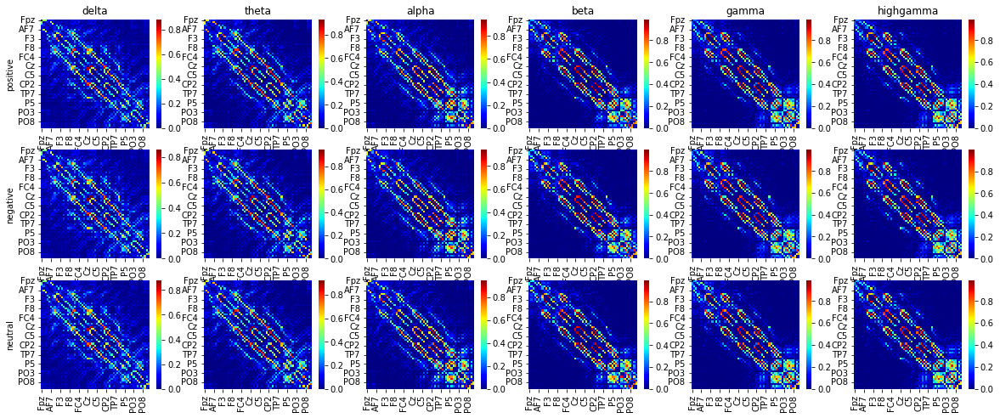

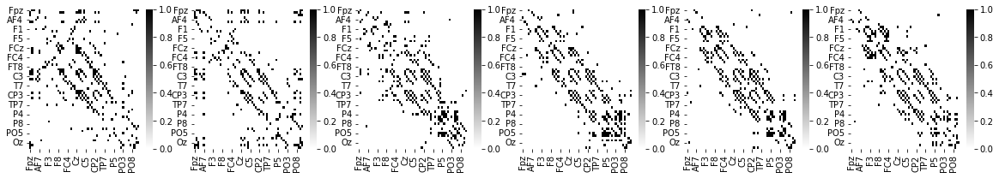

In [39]:

'''
mean map 그려보기
'''
bandfreq = [[0,5,'delta'],[5,9,'theta'],[9,15,'alpha'],[15,32,'beta'],[32,52,'gamma'],[52,83,'highgamma']]
Valence = [['positive',708],['negative',696],['neutral',639]]
for val in Valence:
    for band in bandfreq:
        globals()['{}_{}_mean_mst'.format(val[0], band[2])] =[]

for fr in bandfreq:
    for num in range(globals()['positive_{}_EEG'.format(fr[2])].shape[0]): # Positive Length:
        globals()['positive_{}_mean_mst'.format(fr[2])].append(globals()['Positive_{}_{}_corrcoef_Matrix_binarize'.format(fr[2], num)])
    for num in range(globals()['negative_{}_EEG'.format(fr[2])].shape[0]): # Negative Length:
        globals()['negative_{}_mean_mst'.format(fr[2])].append(globals()['Negative_{}_{}_corrcoef_Matrix_binarize'.format(fr[2],num)]) 
    for num in range(globals()['neutral_{}_EEG'.format(fr[2])].shape[0]): # Neutral Length:
        globals()['neutral_{}_mean_mst'.format(fr[2])].append(globals()['Neutral_{}_{}_corrcoef_Matrix_binarize'.format(fr[2],num)])

for val in Valence:
    for band in bandfreq:
        globals()['{}_{}_mean_mst'.format(val[0], band[2])] = np.mean(np.array(globals()['{}_{}_mean_mst'.format(val[0], band[2])]),axis=0)

        
for fr in bandfreq:
    for num in range(globals()['positive_{}_EEG'.format(fr[2])].shape[0]): # Positive Length:
        globals()['Positive_{}_{}_corrcoef_Matrix_binarize'.format(fr[2], num)][np.where(globals()['Positive_{}_{}_corrcoef_Matrix_binarize'.format(fr[2], num)]>0)]=1
    for num in range(globals()['negative_{}_EEG'.format(fr[2])].shape[0]): # Negative Length:
        globals()['Negative_{}_{}_corrcoef_Matrix_binarize'.format(fr[2], num)][np.where(globals()['Negative_{}_{}_corrcoef_Matrix_binarize'.format(fr[2], num)]>0)]=1
    for num in range(globals()['neutral_{}_EEG'.format(fr[2])].shape[0]): # Neutral Length:
        globals()['Neutral_{}_{}_corrcoef_Matrix_binarize'.format(fr[2], num)][np.where(globals()['Neutral_{}_{}_corrcoef_Matrix_binarize'.format(fr[2], num)]>0)]=1

fig, axes = plt.subplots(3,6,figsize=(20,8))
for i, val in enumerate(Valence):
    for q, band in enumerate(bandfreq):
        a= pd.DataFrame(globals()['{}_{}_mean_mst'.format(val[0], band[2])], columns = ch_names, index = ch_names)
        
        sns.heatmap(a,cmap='jet',ax = axes[i][q])
        if i == 0:
            axes[i][q].set_title(band[2])
        if q ==0:
            axes[i][q].set_ylabel(val[0])

            
            
fig, axes = plt.subplots(1,6,figsize=(20,3))
color_map = plt.cm.get_cmap('gray')
reversed_color_map = color_map.reversed()
vale = ['Positive','Neutral', 'Negative']
band = ['delta','theta','alpha', 'beta','gamma','highgamma']
for val in vale:
    for bd in band:
        globals()["{}_{}".format(val, bd)] = pd.DataFrame(globals()["{}_{}_0_corrcoef_Matrix_binarize".format(val, bd)],columns = ch_names, index = ch_names)

for i, bd in enumerate(band):
    sns.heatmap(globals()["Positive_{}".format(bd)],cmap=reversed_color_map,ax = axes[i])

In [226]:

'''
CP
'''
'''
Optain distance matrix
'''
vale = ['Positive','Neutral', 'Negative']
band = ['delta','theta','alpha', 'beta','gamma','highgamma']
leng = [708,639,696]
#bandfreq = [[0,2,'delta'],[3,4,'theta'],[5,6,'alpha'],[7,15,'beta'],[16,25,'gamma'],[52, 83, 'highgamma']]
#Valence = [['positive',708],['negative',696],['neutral',639]]
for val in vale:
    for q in band:
        globals()['C_P_{}_{}'.format(val, q)] = []

_, Dim = bc.distance.breadthdist(Positive_delta_1_corrcoef_Matrix_binarize)
bc.distance.charpath(Dim)[0]
for ind, a in enumerate(leng):
    for i in range(a):
        for q in band:
            globals()['C_P_{}_{}'.format(vale[ind],q)].append(bc.distance.charpath(bc.distance.distance_bin(globals()['{}_{}_{}_corrcoef_Matrix_binarize'.format(vale[ind],q, i)]), include_infinite=False)[0])

Text(0, 0.5, 'Characteristic path length')

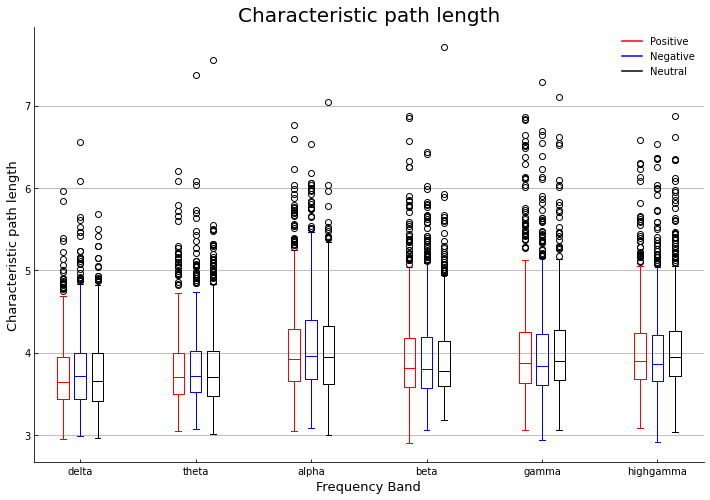

In [227]:

def set_box_color(bp, color):
    plt.setp(bp['boxes'], color=color)
    plt.setp(bp['whiskers'], color=color)
    plt.setp(bp['caps'], color=color)
    plt.setp(bp['medians'], color=color)

raw3_data ={
    'delta':C_P_Positive_delta,
    'theta':C_P_Positive_theta,
    'alpha':C_P_Positive_alpha,
    'beta':C_P_Positive_beta,
    'gamma':C_P_Positive_gamma,
    'highgamma':C_P_Positive_highgamma
}


raw4_data ={
    'delta':C_P_Negative_delta,
    'theta':C_P_Negative_theta,
    'alpha':C_P_Negative_alpha,
    'beta':C_P_Negative_beta,
    'gamma':C_P_Negative_gamma,
    'highgamma':C_P_Negative_highgamma
}


raw5_data ={
    'delta':C_P_Neutral_delta,
    'theta':C_P_Neutral_theta,
    'alpha':C_P_Neutral_alpha,
    'beta':C_P_Neutral_beta,
    'gamma':C_P_Neutral_gamma,
    'highgamma':C_P_Neutral_highgamma
}


positive_C_P_df = pd.DataFrame(raw3_data)
negative_C_P_df = pd.DataFrame(raw4_data)
neutral_C_P_df = pd.DataFrame(raw5_data)

plt.figure(figsize=(12,8))
ticks=['delta','theta', 'alpha','beta','gamma','highgamma']


range(0,len(ticks))
bpl = positive_C_P_df.boxplot(column=['delta',
                                    'theta', 'alpha','beta', 'gamma','highgamma'],grid=False,color='red',
                                  positions=np.array(range(6))*2.0-0.3,widths=0.2)

bpr = negative_C_P_df.boxplot(column=['delta',
                                    'theta', 'alpha','beta', 'gamma','highgamma'],grid=False ,color='blue',
                                  positions=np.array(range(6))*2.0,widths=0.2)
bps = neutral_C_P_df.boxplot(column=['delta',
                                    'theta', 'alpha','beta', 'gamma','highgamma'],grid=False ,color='black',
                                  positions=np.array(range(6))*2.0+0.3,widths=0.2)

plt.xticks(range(0, len(ticks) * 2, 2), ticks)
plt.plot([], c='red', label='Positive')
plt.plot([], c='blue', label='Negative')
plt.plot([], c='black', label='Neutral')
plt.legend(edgecolor='white')
plt.gca().spines[['top', 'right']].set_visible(False)
plt.tick_params(axis='x', direction='in', top=False)
plt.tick_params(axis='y', direction='in', top=False)
plt.grid(True, axis='y')
#plt.ylim(1.6,2.6)
plt.title("Characteristic path length",fontsize=20)
plt.xlabel("Frequency Band",fontsize=13)
plt.ylabel("Characteristic path length",fontsize=13)
#plt.savefig("Characteristic path length.svg",bbox_inches='tight')

In [228]:
'''

violin plot data 정리

'''
positive_val = []
negative_val = []
neutral_val = []

val = ['positive','negative','neutral']
band = ['delta','theta','alpha','beta','gamma','highgamma']

for v in val:
    for b in band:
        globals()['{}_{}'.format(v,b)] =[]


for i in range(708):
    positive_val.append("Positive")
    for b in band:
        globals()['positive_{}'.format(b)].append(b)
        
for i in range(696):
    negative_val.append("Negative")
    for b in band:
        globals()['negative_{}'.format(b)].append(b)

for i in range(639):
    neutral_val.append("Neutral")
    for b in band:
        globals()['neutral_{}'.format(b)].append(b)
a =[]
for v in val:
    for b in band:
        globals()['{}_{}_C_P_df'.format(v,b)] = pd.DataFrame(globals()['{}_C_P_df'.format(v)][b])
        globals()['{}_{}_C_P_df'.format(v,b)].columns = ['value']
        globals()['{}_{}_C_P_df'.format(v,b)]['band'] = globals()['{}_{}'.format(v, b)]
        globals()['{}_{}_C_P_df'.format(v,b)]['valence'] = globals()['{}_val'.format(v)]
        a.append(globals()['{}_{}_C_P_df'.format(v,b)])
C_P_df = pd.concat(a)
C_P_df

,value,band,valence
0,3.400935,delta,Positive
1,3.295733,delta,Positive
2,3.327878,delta,Positive
3,3.654588,delta,Positive
4,3.249562,delta,Positive
...,...,...,...
634,4.088837,highgamma,Neutral
635,3.843951,highgamma,Neutral
636,4.088837,highgamma,Neutral
637,4.175921,highgamma,Neutral


<AxesSubplot:title={'center':'Characteristic path length'}, xlabel='band', ylabel='value'>

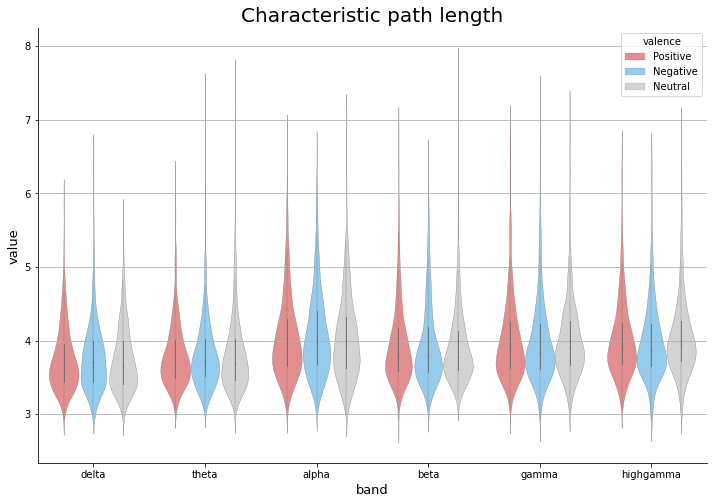

In [229]:
plt.figure(figsize=(12,8))
my_pal = {"Positive": "lightcoral", "Negative": "lightskyblue","Neutral": "lightgray"}
plt.gca().spines[['top', 'right']].set_visible(False)
plt.xlabel("Frequency Band",fontsize=13)
plt.ylabel("Characteristic path length",fontsize=13)
plt.grid(True, axis='y')
plt.title("Characteristic path length",fontsize=20)
sns.violinplot(data = C_P_df, x = 'band', y = 'value' ,hue = 'valence', grid=False , width=0.8,palette = my_pal,linewidth = 0.3)

In [230]:
'''
Calculate global Effeciency

'''

for val in vale:
    for q in band:
        globals()['G_E_{}_{}'.format(val, q)] = []

# calculate Betweenness Centrality
for ind, a in enumerate(leng):
    for i in range(a):
        for q in band:
            globals()['G_E_{}_{}'.format(vale[ind],q)].append(bc.distance.efficiency_bin(globals()['{}_{}_{}_corrcoef_Matrix_binarize'.format(vale[ind],q, i)], local =False))

            

Text(0, 0.5, 'Global Effeciency')

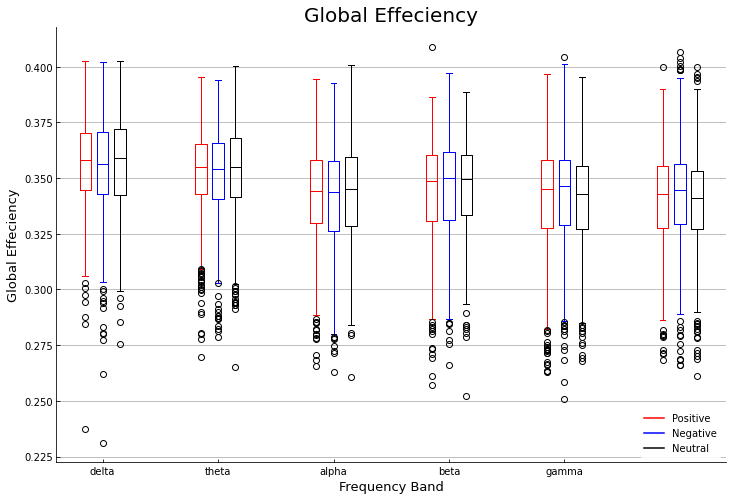

In [232]:

def set_box_color(bp, color):
    plt.setp(bp['boxes'], color=color)
    plt.setp(bp['whiskers'], color=color)
    plt.setp(bp['caps'], color=color)
    plt.setp(bp['medians'], color=color)

raw6_data ={
    'delta':G_E_Positive_delta,
    'theta':G_E_Positive_theta,
    'alpha':G_E_Positive_alpha,
    'beta':G_E_Positive_beta,
    'gamma':G_E_Positive_gamma,
    'highgamma':G_E_Positive_highgamma
}


raw7_data ={
    'delta':G_E_Negative_delta,
    'theta':G_E_Negative_theta,
    'alpha':G_E_Negative_alpha,
    'beta':G_E_Negative_beta,
    'gamma':G_E_Negative_gamma,
    'highgamma':G_E_Negative_highgamma
}


raw8_data ={
    'delta':G_E_Neutral_delta,
    'theta':G_E_Neutral_theta,
    'alpha':G_E_Neutral_alpha,
    'beta':G_E_Neutral_beta,
    'gamma':G_E_Neutral_gamma,
    'highgamma':G_E_Neutral_highgamma
}





positive_G_E_df = pd.DataFrame(raw6_data)
negative_G_E_df = pd.DataFrame(raw7_data)
neutral_G_E_df = pd.DataFrame(raw8_data)


plt.figure(figsize=(12,8))
ticks=['delta','theta', 'alpha','beta','gamma']


range(0,len(ticks))
bpl = positive_G_E_df.boxplot(column=['delta',
                                    'theta', 'alpha','beta', 'gamma','highgamma'],grid=False,color='red',
                                  positions=np.array(range(6))*2.0-0.3,widths=0.2)

bpr = negative_G_E_df.boxplot(column=['delta',
                                    'theta', 'alpha','beta', 'gamma','highgamma'],grid=False ,color='blue',
                                  positions=np.array(range(6))*2.0+0.0,widths=0.2)
bps = neutral_G_E_df.boxplot(column=['delta',
                                    'theta', 'alpha','beta', 'gamma','highgamma'],grid=False ,color='black',
                                  positions=np.array(range(6))*2.0+0.3,widths=0.2)


plt.xticks(range(0, len(ticks) * 2, 2), ticks)
plt.plot([], c='red', label='Positive')
plt.plot([], c='blue', label='Negative')
plt.plot([], c='black', label='Neutral')

plt.legend(edgecolor='white')
plt.gca().spines[['top', 'right']].set_visible(False)
plt.tick_params(axis='x', direction='in', top=False)
plt.tick_params(axis='y', direction='in', top=False)
plt.grid(True, axis='y')
#plt.ylim(0.46,0.64)
plt.title("Global Effeciency",fontsize=20)
plt.xlabel("Frequency Band",fontsize=13)
plt.ylabel("Global Effeciency",fontsize=13)

#plt.savefig("Global Effeciency.svg",bbox_inches='tight')

In [233]:
'''

violin plot data 정리

'''
positive_val = []
negative_val = []
neutral_val = []

val = ['positive','negative','neutral']
band = ['delta','theta','alpha','beta','gamma','highgamma']

for v in val:
    for b in band:
        globals()['{}_{}'.format(v,b)] =[]


for i in range(708):
    positive_val.append("Positive")
    for b in band:
        globals()['positive_{}'.format(b)].append(b)
        
for i in range(696):
    negative_val.append("Negative")
    for b in band:
        globals()['negative_{}'.format(b)].append(b)

for i in range(639):
    neutral_val.append("Neutral")
    for b in band:
        globals()['neutral_{}'.format(b)].append(b)
a =[]
for v in val:
    for b in band:
        globals()['{}_{}_G_E_df'.format(v,b)] = pd.DataFrame(globals()['{}_G_E_df'.format(v)][b])
        globals()['{}_{}_G_E_df'.format(v,b)].columns = ['value']
        globals()['{}_{}_G_E_df'.format(v,b)]['band'] = globals()['{}_{}'.format(v, b)]
        globals()['{}_{}_G_E_df'.format(v,b)]['valence'] = globals()['{}_val'.format(v)]
        a.append(globals()['{}_{}_G_E_df'.format(v,b)])

G_E_df = pd.concat(a)

Text(0.5, 1.0, 'Global Effeciency')

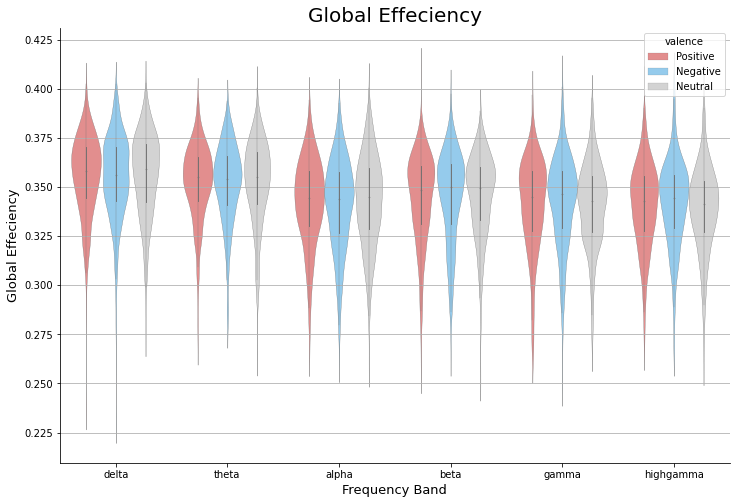

In [234]:
import pingouin as pg

plt.figure(figsize=(12,8))
sns.violinplot(data = G_E_df, x = 'band', y = 'value' ,hue = 'valence', grid=False ,palette=my_pal ,width=0.8,linewidth =0.3)
my_pal = {"Positive": "lightcoral", "Negative": "lightskyblue","Neutral": "lightgray"}
plt.gca().spines[['top', 'right']].set_visible(False)
plt.xlabel("Frequency Band",fontsize=13)
plt.ylabel("Global Effeciency",fontsize=13)
plt.grid(True, axis='y')
plt.title("Global Effeciency",fontsize=20)

In [236]:
'''
ANOVA TEST
'''

bands = ['delta','theta','alpha', 'beta','gamma','highgamma']

print("Characteristic path length")
for band in bands:
    print(band)
    print(pg.welch_anova(data = C_P_df[C_P_df['band']==band], dv = 'value' ,between ='valence'))
    
#plt.kdeplot(C_P_df[C_P_df['band']=='theta'])

print("Global Effeciency")
for band in bands:
    print(band)
    print(pg.welch_anova(data = G_E_df[G_E_df['band']==band], dv = 'value' ,between ='valence'))

Characteristic path length
delta
    Source  ddof1        ddof2         F     p-unc       np2
0  valence      2  1351.874709  0.813328  0.443597  0.000831
theta
    Source  ddof1        ddof2        F     p-unc       np2
0  valence      2  1344.782315  0.26764  0.765224  0.000248
alpha
    Source  ddof1        ddof2         F     p-unc       np2
0  valence      2  1356.330216  2.075297  0.125918  0.002064
beta
    Source  ddof1        ddof2         F     p-unc       np2
0  valence      2  1359.916942  1.423583  0.241208  0.001299
gamma
    Source  ddof1        ddof2         F     p-unc       np2
0  valence      2  1359.439322  0.796427  0.451147  0.000811
highgamma
    Source  ddof1        ddof2         F     p-unc       np2
0  valence      2  1349.361044  2.653637  0.070762  0.002678
Global Effeciency
delta
    Source  ddof1        ddof2         F     p-unc       np2
0  valence      2  1351.276025  0.586178  0.556591  0.000595
theta
    Source  ddof1        ddof2         F     p-unc  

In [237]:
'''
사후분석
'''

print(pg.pairwise_gameshowell(data = G_E_df[G_E_df['band']=='highgamma'], dv = 'value' ,between ='valence'))

          A         B   mean(A)   mean(B)      diff        se         T  \
0  Negative   Neutral  0.342210  0.338888  0.003321  0.001208  2.749189   
1  Negative  Positive  0.342210  0.340427  0.001783  0.001170  1.523421   
2   Neutral  Positive  0.338888  0.340427 -0.001538  0.001185 -1.298373   

            df      pval    hedges  
0  1327.222556  0.016664  0.150538  
1  1398.597108  0.280191  0.081274  
2  1327.349697  0.396322 -0.070807  


# CC 

In [238]:

vale = ['Positive','Neutral', 'Negative']
band = ['delta','theta','alpha', 'beta','gamma','highgamma']
leng = [708,639,696]


for val in vale:
    for bd in band:
        globals()['clu_{}_{}'.format(val, bd)]=[]

# calculate Clustering Coefficient
for i in range(leng[0]):
    for q in band:
        globals()['clu_Positive_{}'.format(q)].append(bc.clustering.clustering_coef_wu(globals()['Positive_{}_{}_corrcoef_Matrix_binarize'.format(q, i)]))

for i in range(leng[1]):
    for q in band:
        globals()['clu_Neutral_{}'.format(q)].append(bc.clustering.clustering_coef_wu(globals()['Neutral_{}_{}_corrcoef_Matrix_binarize'.format(q, i)]))

for i in range(leng[2]):
    for q in band:
        globals()['clu_Negative_{}'.format(q)].append(bc.clustering.clustering_coef_wu(globals()['Negative_{}_{}_corrcoef_Matrix_binarize'.format(q, i)]))

In [243]:
vale = ['Positive','Neutral', 'Negative']
band = ['delta','theta','alpha', 'beta','gamma','highgamma']
leng = [708,639,696]

for val in vale:
    for bd in band:
        globals()['clu_{}_{}_df'.format(val, bd)]=pd.DataFrame(globals()['clu_{}_{}'.format(val, bd)],columns= ch_names)

In [244]:
band = ['delta','theta','alpha', 'beta','gamma','highgamma']
val =['Positive','Neutral','Negative']
Positive_val = []
Negative_val = []
Neutral_val = []
leng = [708, 639, 696] # positive, neutral, negative'

for v in val:
    for b in band:
        globals()['{}_{}'.format(v,b)] =[]


for b in band:    
    for i in range(708):
        globals()['Positive_{}'.format(b)].append(b)
    
for b in band:    
    for i in range(639):
        globals()['Neutral_{}'.format(b)].append(b)

for b in band:    
    for i in range(696):
        globals()['Negative_{}'.format(b)].append(b)
  
        
###################################################

for i in range(708):
    Positive_val.append('Positive')
    
for i in range(639):
    Neutral_val.append('Neutral')

for i in range(696):
    Negative_val.append('Negative')
        
############################################################        


for va in val:
    for ch in ch_names:
        globals()['{}_{}'.format(va, ch)] = []
    
for i in range(leng[0]): #positive leng
    for ch in ch_names: 
        globals()['{}_{}'.format(val[0],ch)].append(ch)

for i in range(leng[1]): #negative leng
    for ch in ch_names: 
        globals()['{}_{}'.format(val[1],ch)].append(ch)
        
for i in range(leng[2]): #neutral leng
    for ch in ch_names: 
        globals()['{}_{}'.format(val[2],ch)].append(ch)

        
#globals()['clu_{}_{}_df'.format(v,b)][ch]


a=[]
for v in val:
    for b in band:    
        for ch in ch_names:
            my_df = pd.DataFrame(globals()['clu_{}_{}_df'.format(v,b)][ch])
            my_df.columns =['value']
            my_df['ch'] = globals()['{}_{}'.format(v,ch)]
            my_df['band'] = globals()['{}_{}'.format(v,b)]
            my_df['valence']=globals()['{}_val'.format(v)]
            a.append(my_df)
            

In [245]:
C_C = pd.concat(a)
C_C

,value,ch,band,valence
0,0.305556,Fpz,delta,Positive
1,0.222222,Fpz,delta,Positive
2,0.333333,Fpz,delta,Positive
3,0.142857,Fpz,delta,Positive
4,0.466667,Fpz,delta,Positive
...,...,...,...,...
691,0.611111,O2,highgamma,Negative
692,0.523810,O2,highgamma,Negative
693,0.571429,O2,highgamma,Negative
694,0.500000,O2,highgamma,Negative


In [247]:
import mne
a = mne.channels.make_standard_montage("standard_1020")
std_loc = mne.channels.DigMontage.get_positions(a)
std_loc = std_loc['ch_pos']
locc = {}
for ch in ch_names:
    locc[ch]= std_loc[ch]

'''
전극위치구성
'''
custom = mne.channels.make_dig_montage(ch_pos = locc)
custom_info = mne.create_info(ch_names=custom.ch_names, sfreq=1.,
                            ch_types='eeg')
data = np.random.normal(size=(59, 1)) * 1e-6
custom_evoked = mne.EvokedArray(data, custom_info)
custom_evoked.set_montage(custom)
vale = ['Positive','Neutral', 'Negative']
band = ['delta','theta','alpha', 'beta','gamma','highgamma']
for val in vale:
    for bd in band:
        globals()['mean_clu_{}_{}_df'.format(val, bd)]= np.array(globals()['clu_{}_{}_df'.format(val, bd)].mean())

C:\Users\hyejeong\AppData\Local\Temp/ipykernel_3164/3240046546.py:22: RuntimeWarning: Fiducial point nasion not found, assuming identity unknown to head transformation
  custom_evoked.set_montage(custom)


In [248]:
vmin=100000
vmax = 0
for i, val in enumerate(vale):
    for q, ba in enumerate(band):
        vmin = min(vmin, min(globals()['mean_clu_{}_{}_df'.format(val, ba)]))
        vmax = max(vmax, max(globals()['mean_clu_{}_{}_df'.format(val, ba)]))

Text(0.5, 1.02, 'Clustering coefficient')

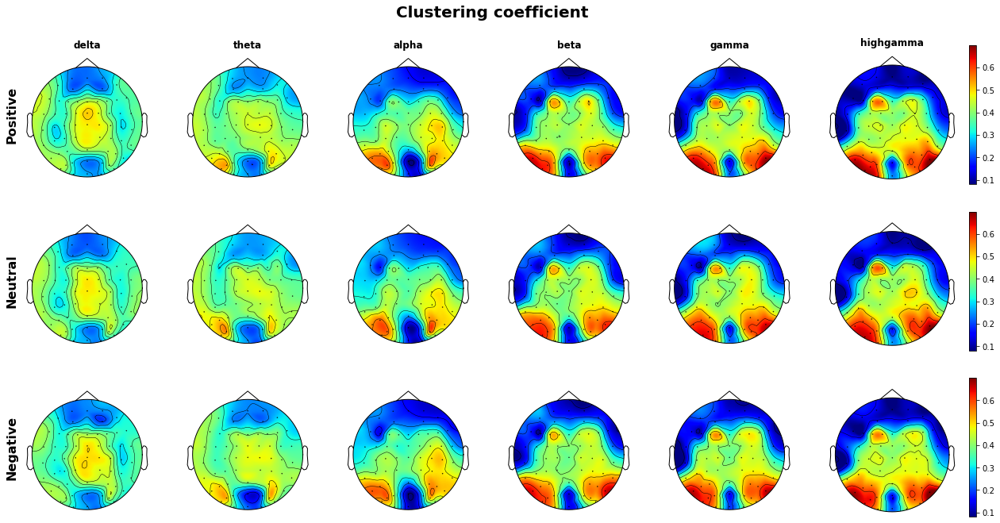

In [250]:
import numpy as np
import mne
fig, ax = plt.subplots(nrows=3,ncols=6, figsize=(22, 10), gridspec_kw={'width_ratios': [12, 12,12,12,12,15.5]},
                       sharex=True, sharey=True)
np.random.seed(1)
for i, val in enumerate(vale):
    for q, ba in enumerate(band):
        s = mne.viz.plot_topomap(globals()['mean_clu_{}_{}_df'.format(val, ba)], custom_evoked.info, axes=ax[i][q],show=False,cmap ='jet',names = ch_names, 
                                 sphere = 0.108,vmin=vmin, vmax=vmax)
        if i == 0:
            ax[i][q].set_title(ba,fontweight='bold')
        if q ==0:
            ax[i][q].set_ylabel(val,fontweight='bold',fontsize=16)  
        if q == 5:
            mynorm = plt.Normalize(vmin=vmin, vmax=vmax)
            sm = plt.cm.ScalarMappable(cmap='jet', norm=mynorm)
            sm_= plt.colorbar(sm, ax = ax[i][q])
plt.suptitle("Clustering coefficient",fontweight='bold', fontsize=20, y = 1.02)

In [251]:
'''
Example Betweenness Centrality
return N*1
'''

vale = ['Positive','Neutral', 'Negative']
band = ['delta','theta','alpha', 'beta','gamma','highgamma']
leng = [708,639,696]

for val in vale:
    for q in band:
        globals()['B_C_{}_{}'.format(val, q)] = []

# calculate Betweenness Centrality
for ind, a in enumerate(leng):
    for i in range(a):
        for q in band:
            globals()['B_C_{}_{}'.format(vale[ind],q)].append(bc.centrality.betweenness_bin(globals()['{}_{}_{}_corrcoef_Matrix_binarize'.format(vale[ind],q, i)]))

In [252]:
for val in vale:
    for q in band:
        globals()['B_C_{}_{}_df'.format(val, q)] = pd.DataFrame(globals()['B_C_{}_{}'.format(val, q)],columns= ch_names)

In [253]:
val =['Positive','Neutral','Negative']
Positive_val = []
Negative_val = []
Neutral_val = []
leng = [708, 639, 696] # positive, neutral, negative'

for v in val:
    for b in band:
        globals()['{}_{}'.format(v,b)] =[]


for b in band:    
    for i in range(708):
        globals()['Positive_{}'.format(b)].append(b)
    
for b in band:    
    for i in range(639):
        globals()['Neutral_{}'.format(b)].append(b)

for b in band:    
    for i in range(696):
        globals()['Negative_{}'.format(b)].append(b)
  
        
###################################################

for i in range(708):
    Positive_val.append('Positive')
    
for i in range(639):
    Neutral_val.append('Neutral')

for i in range(696):
    Negative_val.append('Negative')
        
############################################################        


for va in val:
    for ch in ch_names:
        globals()['{}_{}'.format(va, ch)] = []
    
for i in range(leng[0]): #positive leng
    for ch in ch_names: 
        globals()['{}_{}'.format(val[0],ch)].append(ch)

for i in range(leng[1]): #negative leng
    for ch in ch_names: 
        globals()['{}_{}'.format(val[1],ch)].append(ch)
        
for i in range(leng[2]): #neutral leng
    for ch in ch_names: 
        globals()['{}_{}'.format(val[2],ch)].append(ch)

        
#globals()['clu_{}_{}_df'.format(v,b)][ch]


a=[]
for v in val:
    for b in band:    
        for ch in ch_names:
            my_df = pd.DataFrame(globals()['B_C_{}_{}_df'.format(v, b)][ch])
            my_df.columns =['value']
            my_df['ch'] = globals()['{}_{}'.format(v,ch)]
            my_df['band'] = globals()['{}_{}'.format(v,b)]
            my_df['valence']=globals()['{}_val'.format(v)]
            a.append(my_df)
            

In [254]:
B_C = pd.concat(a)
B_C

,value,ch,band,valence
0,416.372594,Fpz,delta,Positive
1,524.801749,Fpz,delta,Positive
2,599.385459,Fpz,delta,Positive
3,467.792215,Fpz,delta,Positive
4,56.497733,Fpz,delta,Positive
...,...,...,...,...
691,283.876228,O2,highgamma,Negative
692,96.349112,O2,highgamma,Negative
693,191.489177,O2,highgamma,Negative
694,226.200000,O2,highgamma,Negative


In [255]:
vale = ['Positive','Neutral', 'Negative']
band = ['delta','theta','alpha', 'beta','gamma','highgamma']
for val in vale:
    for bd in band:
        globals()['mean_B_C_{}_{}_df'.format(val, bd)]= np.array(globals()['B_C_{}_{}_df'.format(val, bd)].mean())

In [256]:
vmin=100000
vmax = 0
print(band)
for i, val in enumerate(vale):
    for q, ba in enumerate(band):
        vmin = min(vmin, min(globals()['mean_B_C_{}_{}_df'.format(val, ba)]))
        vmax = max(vmax, max(globals()['mean_B_C_{}_{}_df'.format(val, ba)]))

['delta', 'theta', 'alpha', 'beta', 'gamma', 'highgamma']


Text(0.5, 1.02, 'Betweenness Centrality')

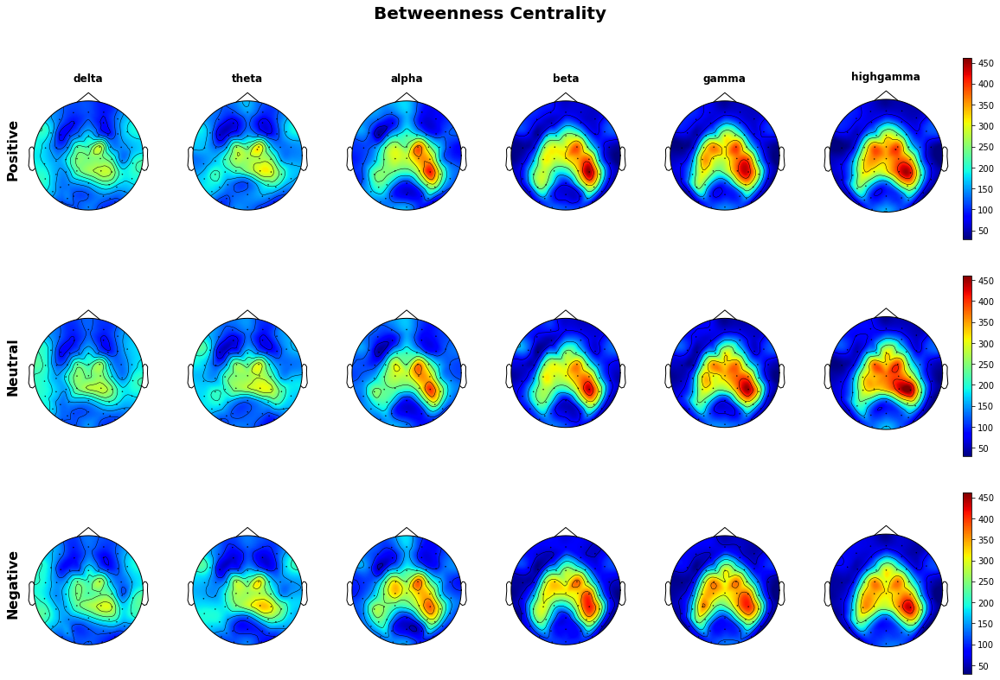

In [258]:
import numpy as np
import mne

fig, ax = plt.subplots(nrows=3,ncols=6, figsize=(20, 12), sharex=True, sharey=True
                      ,gridspec_kw={'width_ratios': [12, 12,12,12,12,15.5]})
#np.random.seed(1)

for i, val in enumerate(vale):
    for q, ba in enumerate(band):
        mne.viz.plot_topomap(globals()['mean_B_C_{}_{}_df'.format(val, ba)], custom_evoked.info, axes=ax[i][q],show=False,cmap ='jet', 
                             sphere = 0.108,names = ch_names,show_names =False,vmin=vmin, vmax=vmax)
        if i == 0:
            ax[i][q].set_title(ba,fontweight='bold')
        if q ==0:
            ax[i][q].set_ylabel(val,fontweight='bold',fontsize=16)
        if q == 5:
            mynorm = plt.Normalize(vmin=vmin, vmax=vmax)
            sm = plt.cm.ScalarMappable(cmap='jet', norm=mynorm)
            sm_= plt.colorbar(sm, ax = ax[i][q])            
plt.suptitle("Betweenness Centrality",fontweight='bold', fontsize=20,y = 1.02)
#plt.savefig("Betweenness_Centrality_topomap",dpi  = 600) 

In [259]:
'''
Example NodeDegree
return N*1
'''

vale = ['Positive','Neutral', 'Negative']
band = ['delta','theta','alpha', 'beta','gamma','highgamma']
leng = [708,639,696]
from brainconn import degree, utils

for val in vale:
    for q in band:
        globals()['N_D_{}_{}'.format(val, q)] = []

# calculate Betweenness Centrality
for ind, a in enumerate(leng):
    for i in range(a):
        for q in band:
            globals()['N_D_{}_{}'.format(vale[ind],q)].append(degree.degrees_und(globals()['{}_{}_{}_corrcoef_Matrix_binarize'.format(vale[ind],q, i)]))

In [260]:
for val in vale:
    for q in band:
        globals()['N_D_{}_{}_df'.format(val, q)] = pd.DataFrame(globals()['N_D_{}_{}'.format(val, q)],columns= ch_names)

In [261]:
val =['Positive','Neutral','Negative']
Positive_val = []
Negative_val = []
Neutral_val = []
leng = [708, 639, 696] # positive, neutral, negative'

for v in val:
    for b in band:
        globals()['{}_{}'.format(v,b)] =[]


for b in band:    
    for i in range(708):
        globals()['Positive_{}'.format(b)].append(b)
    
for b in band:    
    for i in range(639):
        globals()['Neutral_{}'.format(b)].append(b)

for b in band:    
    for i in range(696):
        globals()['Negative_{}'.format(b)].append(b)
  
        
###################################################

for i in range(708):
    Positive_val.append('Positive')
    
for i in range(639):
    Neutral_val.append('Neutral')

for i in range(696):
    Negative_val.append('Negative')
        
############################################################        


for va in val:
    for ch in ch_names:
        globals()['{}_{}'.format(va, ch)] = []
    
for i in range(leng[0]): #positive leng
    for ch in ch_names: 
        globals()['{}_{}'.format(val[0],ch)].append(ch)

for i in range(leng[1]): #negative leng
    for ch in ch_names: 
        globals()['{}_{}'.format(val[1],ch)].append(ch)
        
for i in range(leng[2]): #neutral leng
    for ch in ch_names: 
        globals()['{}_{}'.format(val[2],ch)].append(ch)

        
#globals()['clu_{}_{}_df'.format(v,b)][ch]


a=[]
for v in val:
    for b in band:    
        for ch in ch_names:
            my_df = pd.DataFrame(globals()['N_D_{}_{}_df'.format(v, b)][ch])
            my_df.columns =['value']
            my_df['ch'] = globals()['{}_{}'.format(v,ch)]
            my_df['band'] = globals()['{}_{}'.format(v,b)]
            my_df['valence']=globals()['{}_val'.format(v)]
            a.append(my_df)

In [262]:
N_D = pd.concat(a)

In [263]:
for val in vale:
    for q in band:
        globals()['mean_N_D_{}_{}_df'.format(val, q)] = globals()['N_D_{}_{}_df'.format(val, q)].mean()

In [264]:
vmin=100000
vmax = 0
for i, val in enumerate(vale):
    for q, ba in enumerate(band):
        vmin = min(vmin, min(globals()['mean_N_D_{}_{}_df'.format(val, ba)]))
        vmax = max(vmax, max(globals()['mean_N_D_{}_{}_df'.format(val, ba)]))

Text(0.5, 1.02, 'Node Degree')

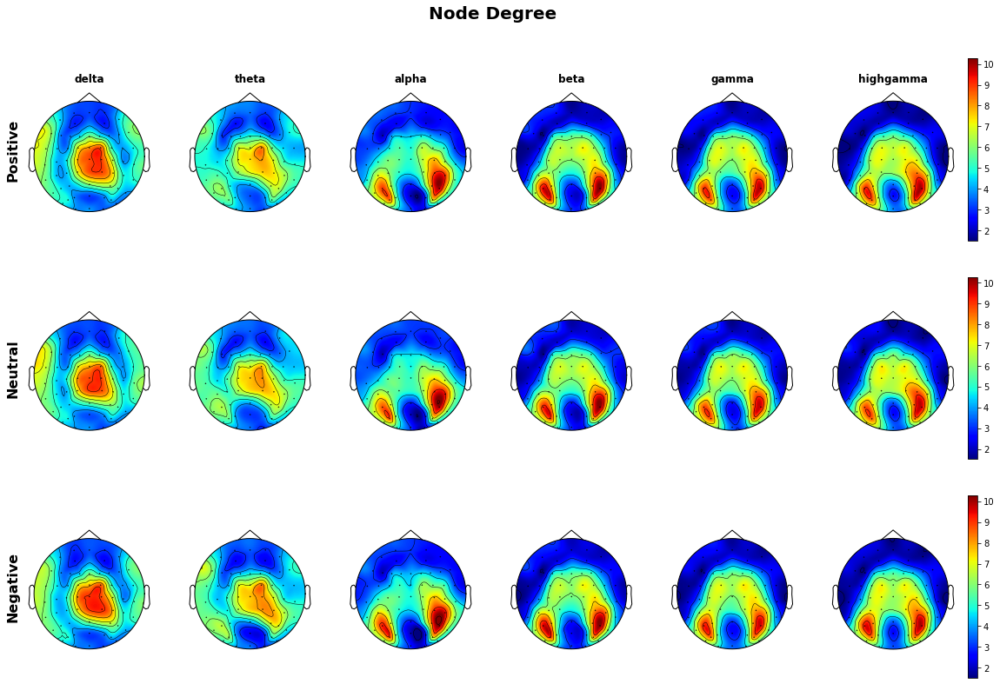

In [266]:

import numpy as np
import mne
vmin=100000
vmax = 0
for i, val in enumerate(vale):
    for q, ba in enumerate(band):
        vmin = min(vmin, min(globals()['mean_N_D_{}_{}_df'.format(val, ba)]))
        vmax = max(vmax, max(globals()['mean_N_D_{}_{}_df'.format(val, ba)]))
fig, ax = plt.subplots(nrows=3,ncols=6, figsize=(20, 12), gridspec_kw={'width_ratios': [12, 12,12,12,12,15.05]},
                       sharex=True, sharey=True)
np.random.seed(1)

for i, val in enumerate(vale):
    for q, ba in enumerate(band):
        mne.viz.plot_topomap(globals()['mean_N_D_{}_{}_df'.format(val, ba)], custom_evoked.info, axes=ax[i][q],show=False,cmap ='jet',
                             sphere = 0.108,vmin=vmin, vmax=vmax)
        if i == 0:
            ax[i][q].set_title(ba,fontweight='bold')
        if q ==0:
            ax[i][q].set_ylabel(val,fontweight='bold',fontsize=16)
        
        if q == 5:
            mynorm = plt.Normalize(vmin=vmin, vmax=vmax)
            sm = plt.cm.ScalarMappable(cmap='jet', norm=mynorm)
            sm_= plt.colorbar(sm, ax = ax[i][q])
plt.suptitle("Node Degree",fontweight='bold', fontsize=20,y = 1.02)


#plt.savefig("Node_Degree_topomap",dpi  = 600) 

In [267]:
'''
Calculate local Effeciency

'''

vale = ['Positive','Neutral', 'Negative']
band = ['delta','theta','alpha', 'beta','gamma','highgamma']
for val in vale:
    for q in band:
        globals()['L_E_{}_{}'.format(val, q)] = []

# calculate Betweenness Centrality
for ind, a in enumerate(leng):
    for i in range(a):
        for q in band:
            globals()['L_E_{}_{}'.format(vale[ind],q)].append(bc.distance.efficiency_bin(globals()['{}_{}_{}_corrcoef_Matrix_binarize'.format(vale[ind],q, i)], local =True))

['delta', 'theta', 'alpha', 'beta', 'gamma', 'highgamma']


In [268]:
for val in vale:
    for q in band:
        globals()['L_E_{}_{}_df'.format(val, q)] = pd.DataFrame(globals()['L_E_{}_{}'.format(val, q)],columns= ch_names)

In [269]:
val =['Positive','Neutral','Negative']
Positive_val = []
Negative_val = []
Neutral_val = []
leng = [708, 639, 696] # positive, neutral, negative'

for v in val:
    for b in band:
        globals()['{}_{}'.format(v,b)] =[]


for b in band:    
    for i in range(708):
        globals()['Positive_{}'.format(b)].append(b)
    
for b in band:    
    for i in range(639):
        globals()['Neutral_{}'.format(b)].append(b)

for b in band:    
    for i in range(696):
        globals()['Negative_{}'.format(b)].append(b)
  
        
###################################################

for i in range(708):
    Positive_val.append('Positive')
    
for i in range(639):
    Neutral_val.append('Neutral')

for i in range(696):
    Negative_val.append('Negative')
        
############################################################        


for va in val:
    for ch in ch_names:
        globals()['{}_{}'.format(va, ch)] = []
    
for i in range(leng[0]): #positive leng
    for ch in ch_names: 
        globals()['{}_{}'.format(val[0],ch)].append(ch)

for i in range(leng[1]): #negative leng
    for ch in ch_names: 
        globals()['{}_{}'.format(val[1],ch)].append(ch)
        
for i in range(leng[2]): #neutral leng
    for ch in ch_names: 
        globals()['{}_{}'.format(val[2],ch)].append(ch)

        
#globals()['clu_{}_{}_df'.format(v,b)][ch]


a=[]
for v in val:
    for b in band:    
        for ch in ch_names:
            my_df = pd.DataFrame(globals()['L_E_{}_{}_df'.format(v, b)][ch])
            my_df.columns =['value']
            my_df['ch'] = globals()['{}_{}'.format(v,ch)]
            my_df['band'] = globals()['{}_{}'.format(v,b)]
            my_df['valence']=globals()['{}_val'.format(v)]
            a.append(my_df)

In [270]:
L_E = pd.concat(a)

In [271]:
vale = ['Positive','Neutral', 'Negative']
band = ['delta','theta','alpha', 'beta','gamma','highgamma']
for val in vale:
    for q in band:
        globals()['mean_L_E_{}_{}_df'.format(val, q)] = globals()['L_E_{}_{}_df'.format(val, q)].mean()

Text(0.5, 1.02, 'Local Effeciency')

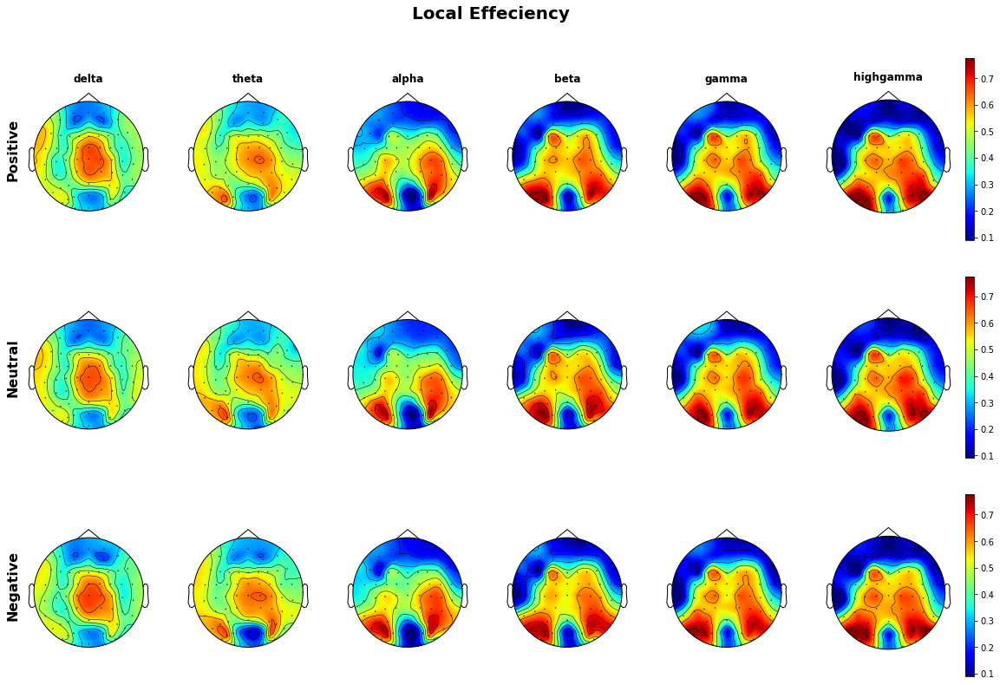

In [272]:
import numpy as np
import mne
vmin=100000
vmax = 0
for i, val in enumerate(vale):
    for q, ba in enumerate(band):
        vmin = min(vmin, min(globals()['mean_L_E_{}_{}_df'.format(val, ba)]))
        vmax = max(vmax, max(globals()['mean_L_E_{}_{}_df'.format(val, ba)]))
fig, ax = plt.subplots(nrows=3,ncols=6, figsize=(20, 12), gridspec_kw={'width_ratios': [12, 12,12,12,12,15.5]},
                       sharex=True, sharey=True)
np.random.seed(1)

for i, val in enumerate(vale):
    for q, ba in enumerate(band):
        mne.viz.plot_topomap(globals()['mean_L_E_{}_{}_df'.format(val, ba)], custom_evoked.info, axes=ax[i][q],show=False,cmap ='jet',
                             sphere = 0.108,vmin=vmin,vmax=vmax)
        if i == 0:
            ax[i][q].set_title(ba,fontweight='bold')
        if q ==0:
            ax[i][q].set_ylabel(val,fontweight='bold',fontsize=16)
        if q == 5:
            mynorm = plt.Normalize(vmin=vmin, vmax=vmax)
            sm = plt.cm.ScalarMappable(cmap='jet', norm=mynorm)
            sm_= plt.colorbar(sm, ax = ax[i][q])

plt.suptitle("Local Effeciency",fontweight='bold', fontsize=20,y = 1.02)
#plt.savefig("Local_Effeciency_topomap",dpi  = 600)

In [273]:
vale = ['Positive','Neutral', 'Negative']
band = ['delta','theta','alpha', 'beta','gamma','highgamma']
leng = [708,639,696]

for val in vale:
    for q in band:
        globals()['E_V_{}_{}'.format(val, q)] = []

# calculate Betweenness Centrality
for ind, a in enumerate(leng):
    for i in range(a):
        for q in band:
            globals()['E_V_{}_{}'.format(vale[ind],q)].append(bc.centrality.eigenvector_centrality_und(globals()['{}_{}_{}_corrcoef_Matrix_binarize'.format(vale[ind],q, i)]))

In [274]:
for val in vale:
    for q in band:
        globals()['E_V_{}_{}_df'.format(val, q)] = pd.DataFrame(globals()['E_V_{}_{}'.format(val, q)],columns= ch_names)
        
for val in vale:
    for q in band:
        globals()['mean_E_V_{}_{}_df'.format(val, q)] = globals()['E_V_{}_{}_df'.format(val, q)].mean()
vmin=100000
vmax = 0
for i, val in enumerate(vale):
    for q, ba in enumerate(band):
        vmin = min(vmin, min(globals()['mean_E_V_{}_{}_df'.format(val, ba)]))
        vmax = max(vmax, max(globals()['mean_E_V_{}_{}_df'.format(val, ba)]))

Text(0.5, 1.02, 'Eigenvector centrality')

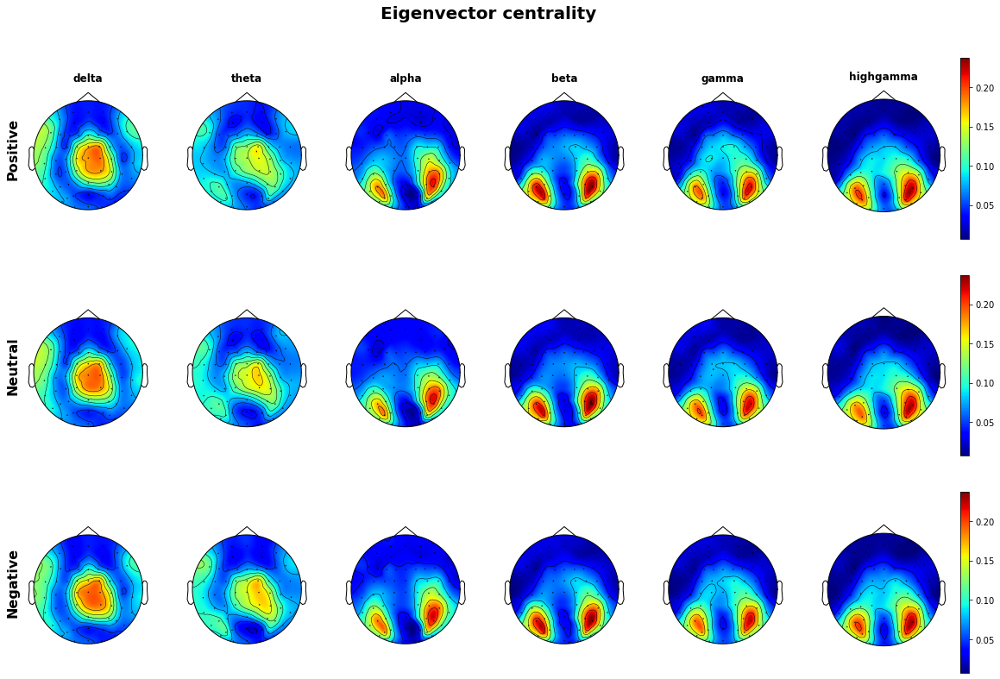

In [275]:
import numpy as np
import mne

fig, ax = plt.subplots(nrows=3,ncols=6, figsize=(20, 12),gridspec_kw={'width_ratios': [12, 12,12,12,12,15.5]},
                       sharex=True, sharey=True)
np.random.seed(1)

for i, val in enumerate(vale):
    for q, ba in enumerate(band):
        mne.viz.plot_topomap(globals()['mean_E_V_{}_{}_df'.format(val, ba)], custom_evoked.info, axes=ax[i][q],show=False,cmap ='jet',
                            sphere = 0.108,vmin=vmin, vmax=vmax)
        if i == 0:
            ax[i][q].set_title(ba,fontweight='bold')
        if q ==0:
            ax[i][q].set_ylabel(val,fontweight='bold',fontsize=16)
        if q == 5:
            mynorm = plt.Normalize(vmin=vmin, vmax=vmax)
            sm = plt.cm.ScalarMappable(cmap='jet', norm=mynorm)
            sm_= plt.colorbar(sm, ax = ax[i][q])
            
plt.suptitle("Eigenvector centrality",fontweight='bold', fontsize=20, y=1.02)
#plt.savefig("Eigenvector_centrality_topomap",dpi  = 600) 

In [276]:
val =['Positive','Neutral','Negative']
Positive_val = []
Negative_val = []
Neutral_val = []
leng = [708, 639, 696] # positive, neutral, negative'

for v in val:
    for b in band:
        globals()['{}_{}'.format(v,b)] =[]


for b in band:    
    for i in range(708):
        globals()['Positive_{}'.format(b)].append(b)
    
for b in band:    
    for i in range(639):
        globals()['Neutral_{}'.format(b)].append(b)

for b in band:    
    for i in range(696):
        globals()['Negative_{}'.format(b)].append(b)
  
        
###################################################

for i in range(708):
    Positive_val.append('Positive')
    
for i in range(639):
    Neutral_val.append('Neutral')

for i in range(696):
    Negative_val.append('Negative')
        
############################################################        


for va in val:
    for ch in ch_names:
        globals()['{}_{}'.format(va, ch)] = []
    
for i in range(leng[0]): #positive leng
    for ch in ch_names: 
        globals()['{}_{}'.format(val[0],ch)].append(ch)

for i in range(leng[1]): #negative leng
    for ch in ch_names: 
        globals()['{}_{}'.format(val[1],ch)].append(ch)
        
for i in range(leng[2]): #neutral leng
    for ch in ch_names: 
        globals()['{}_{}'.format(val[2],ch)].append(ch)

        
#globals()['clu_{}_{}_df'.format(v,b)][ch]


a=[]
for v in val:
    for b in band:    
        for ch in ch_names:
            my_df = pd.DataFrame(globals()['E_V_{}_{}_df'.format(v, b)][ch])
            #my_df = globals()['E_V_{}_{}_df'.format(v, b)][ch]
            my_df.columns =['value']
            my_df['ch'] = globals()['{}_{}'.format(v,ch)]
            my_df['band'] = globals()['{}_{}'.format(v,b)]
            my_df['valence']=globals()['{}_val'.format(v)]
            a.append(my_df)

In [277]:
E_V = pd.concat(a)

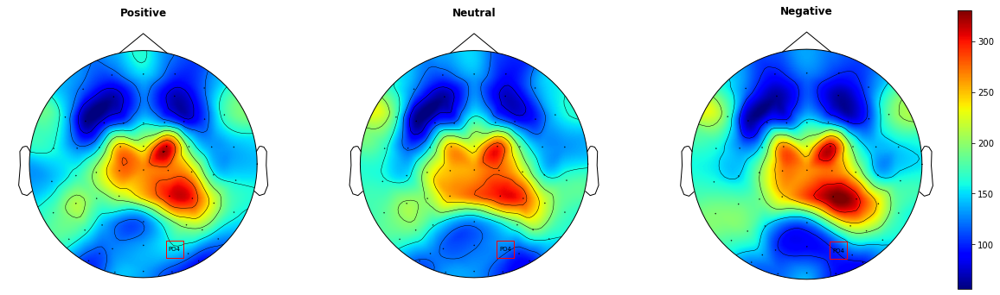

In [278]:
'''
theta': {'PO4': 0.0283988571372914} channel 세부 plot

'''
mask=[]
for ch in ch_names:
    if ch == 'PO4':
        mask.append(True)
    else:
        mask.append(False)

import numpy as np
import mne
indcate = np.array(['PO4'])
mark = dict(marker='s', markeredgecolor='red',linewidth=0, markersize=20,fillstyle='none')
fig, ax = plt.subplots(nrows=1,ncols=3, figsize=(20, 10), gridspec_kw={'width_ratios': [12, 12,13.3]},
                       sharex=True, sharey=True)
np.random.seed(1)
vmin=1000000
vmax=0
for i, val in enumerate(vale):
    vmin =min(min(globals()['mean_B_C_{}_{}_df'.format(val, 'theta')]),vmin)
    vmax =max(max(globals()['mean_B_C_{}_{}_df'.format(val, 'theta')]),vmax)


for i, val in enumerate(vale):
        mne.viz.plot_topomap(globals()['mean_B_C_{}_{}_df'.format(val, 'theta')], custom_evoked.info, axes=ax[i],show=False,cmap ='jet', sphere = 0.108
                            ,names = ch_names, mask=np.array(mask), mask_params=mark, show_names = True,vmin=vmin,vmax=vmax)
        ax[i].set_title(val,fontweight='bold')
    
    
mynorm = plt.Normalize(vmin=vmin,vmax=vmax)
sm = plt.cm.ScalarMappable(cmap='jet', norm=mynorm)
sm_= plt.colorbar(sm,fraction=0.046, pad=0.04)
            
#plt.suptitle("Node Degree",fontweight='bold', fontsize=20)
#plt.savefig("Node_Degree_topomap",dpi  = 600) 

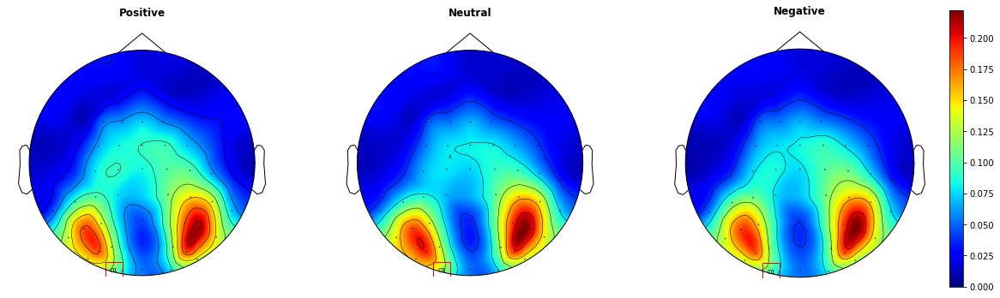

In [279]:
'''
gamma: {'O1': 0.0283988571372914} channel 세부 plot

'''
mask=[]
for ch in ch_names:
    if ch == 'O1':
        mask.append(True)
    else:
        mask.append(False)

import numpy as np
import mne
indcate = np.array(['O1'])
mark = dict(marker='s', markeredgecolor='red',linewidth=0, markersize=20,fillstyle='none')
fig, ax = plt.subplots(nrows=1,ncols=3, figsize=(20, 10), gridspec_kw={'width_ratios': [12, 12,13.3]},
                       sharex=True, sharey=True)
np.random.seed(1)
vmin=1000000
vmax=0
for i, val in enumerate(vale):
    vmin =min(min(globals()['mean_E_V_{}_{}_df'.format(val, 'gamma')]),vmin)
    vmax =max(max(globals()['mean_E_V_{}_{}_df'.format(val, 'gamma')]),vmax)


for i, val in enumerate(vale):
        mne.viz.plot_topomap(globals()['mean_E_V_{}_{}_df'.format(val, 'gamma')], custom_evoked.info, axes=ax[i],show=False,cmap ='jet', sphere = 0.108
                            ,names = ch_names, mask=np.array(mask), mask_params=mark, show_names = True,vmin=0,vmax=vmax)
        ax[i].set_title(val,fontweight='bold')
    
    
mynorm = plt.Normalize(vmin=0,vmax=vmax)
sm = plt.cm.ScalarMappable(cmap='jet', norm=mynorm)
sm_= plt.colorbar(sm,fraction=0.046, pad=0.04)
            
#plt.suptitle("Node Degree",fontweight='bold', fontsize=20)
#plt.savefig("Node_Degree_topomap",dpi  = 600) 

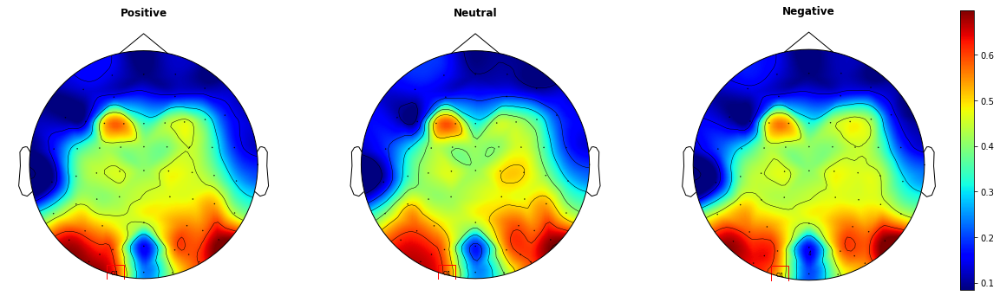

In [297]:
'''
highgamma': {'O1': 0.0283988571372914} channel 세부 plot

'''
mask=[]
for ch in ch_names:
    if ch == 'O1':
        mask.append(True)
    else:
        mask.append(False)
import numpy as np
import mne
indcate = np.array(['O1'])
mark = dict(marker='s', markeredgecolor='red',linewidth=0, markersize=20,fillstyle='none')
fig, ax = plt.subplots(nrows=1,ncols=3, figsize=(20, 10), gridspec_kw={'width_ratios': [12, 12,13.3]},
                       sharex=True, sharey=True)
np.random.seed(1)
vmin=1000000
vmax=0
for i, val in enumerate(vale):
    vmin =min(min(globals()['mean_clu_{}_{}_df'.format(val, 'highgamma')]),vmin)
    vmax =max(max(globals()['mean_clu_{}_{}_df'.format(val, 'highgamma')]),vmax)
for i, val in enumerate(vale):
        mne.viz.plot_topomap(globals()['mean_clu_{}_{}_df'.format(val, 'highgamma')], custom_evoked.info, axes=ax[i],show=False,cmap ='jet', sphere = 0.108
                            ,names = ch_names, mask=np.array(mask), mask_params=mark, show_names = True,vmin=vmin,vmax=vmax)
        ax[i].set_title(val,fontweight='bold')
mynorm = plt.Normalize(vmin=vmin,vmax=vmax)
sm = plt.cm.ScalarMappable(cmap='jet', norm=mynorm)
sm_= plt.colorbar(sm,fraction=0.046, pad=0.04)
#plt.suptitle("Node Degree",fontweight='bold', fontsize=20)
#plt.savefig("Node_Degree_topomap",dpi  = 600) 

In [298]:
pw = pg.pairwise_gameshowell(data = B_C.loc[(B_C['band']=='theta') & (B_C['ch']=='PO4')], dv = 'value' ,between ='valence')
print(pw)
pw = pg.pairwise_gameshowell(data = C_C.loc[(C_C['band']=='highgamma') & (C_C['ch']=='O1')], dv = 'value' ,between ='valence')
print(pw)
pw = pg.pairwise_gameshowell(data = E_V.loc[(E_V['band']=='gamma') & (E_V['ch']=='O1')], dv = 'value' ,between ='valence')
print(pw)

          A         B   mean(A)   mean(B)      diff        se         T  \
0  Negative   Neutral  0.436670  0.394526  0.042144  0.015321  2.750765   
1  Negative  Positive  0.436670  0.445687 -0.009017  0.014799 -0.609299   
2   Neutral  Positive  0.394526  0.445687 -0.051161  0.014979 -3.415572   

            df      pval    hedges  
0  1327.276806  0.016587  0.150624  
1  1397.632925  0.815064 -0.032506  
2  1325.412225  0.001895 -0.186268  
          A         B   mean(A)   mean(B)      diff        se         T  \
0  Negative   Neutral  0.513429  0.572342 -0.058913  0.018265 -3.225509   
1  Negative  Positive  0.513429  0.612310 -0.098881  0.017800 -5.555201   
2   Neutral  Positive  0.572342  0.612310 -0.039968  0.016810 -2.377658   

            df          pval    hedges  
0  1328.219368  3.684043e-03 -0.176620  
1  1362.784674  9.979417e-08 -0.296367  
2  1328.688724  4.617856e-02 -0.129665  


In [284]:
'''
통계분석
CC

'''
import pingouin as pg

band = ['delta','theta','alpha', 'beta','gamma','highgamma']
cc_anova = {'delta':{},'theta':{},'alpha':{},'beta':{},'gamma':{},'highgamma':{}} #Negative - Neutral {band: {ch : p-value}}
cc_Ttest = {'delta':{},'theta':{},'alpha':{},'beta':{},'gamma':{},'highgamma':{}}

for b in band:
    for ch in ch_names:
        #ANOVA 적용
        a = pg.welch_anova(data = C_C.loc[(C_C['band']==b) & (C_C['ch']==ch)], dv = 'value' ,between ='valence')
        if a['p-unc'][0] < 0.05:
            pw = pg.pairwise_gameshowell(data = C_C.loc[(C_C['band']==b) & (C_C['ch']==ch)], dv = 'value' ,between ='valence')
            pwtest = {'A': pw['pval'][0],'B': pw['pval'][1],'C': pw['pval'][2]}
            cc_anova[b][ch] = pwtest
            ccT = {}
            
            if pw['pval'][0] < 0.05:
                ccT['A'] = pw['T'][0]
            else:
                ccT['A'] = 0
            
            if pw['pval'][1] < 0.05:
                ccT['B'] = pw['T'][1]
            else:
                ccT['B'] = 0
            
            if pw['pval'][2] < 0.05:
                ccT['C'] = pw['T'][2]
            else:
                ccT['C'] = 0
                
            cc_Ttest[b][ch] = ccT
            
        elif a['p-unc'][0] > 0.05:
            ttest = {'A':0,'B':0,'C':0}
            cc_Ttest[b][ch] = ttest
    

In [285]:
'''

BC

'''


band = ['delta','theta','alpha', 'beta','gamma','highgamma']
bc_anova = {'delta':{},'theta':{},'alpha':{},'beta':{},'gamma':{},'highgamma':{}} #Negative - Neutral {band: {ch : p-value}}
bc_Ttest = {'delta':{},'theta':{},'alpha':{},'beta':{},'gamma':{},'highgamma':{}}


for b in band:
    for ch in ch_names:
        #ANOVA 적용
        a = pg.welch_anova(data = B_C.loc[(B_C['band']==b) & (B_C['ch']==ch)], dv = 'value' ,between ='valence')
        if a['p-unc'][0] < 0.05:
            pw = pg.pairwise_gameshowell(data = B_C.loc[(B_C['band']==b) & (B_C['ch']==ch)], dv = 'value' ,between ='valence')
            pwtest = {'A': pw['pval'][0],'B': pw['pval'][1],'C': pw['pval'][2]}
            bc_anova[b][ch] = pwtest
            ccT = {}
            
            if pw['pval'][0] < 0.05:
                ccT['A'] = pw['T'][0]
            else:
                ccT['A'] = 0
            
            if pw['pval'][1] < 0.05:
                ccT['B'] = pw['T'][1]
            else:
                ccT['B'] = 0
            
            if pw['pval'][2] < 0.05:
                ccT['C'] = pw['T'][2]
            else:
                ccT['C'] = 0
                
            bc_Ttest[b][ch] = ccT

            
        elif a['p-unc'][0] > 0.05:
            ttest = {'A':0,'B':0,'C':0}
            bc_Ttest[b][ch] = ttest
    

In [286]:
'''

ND


'''

band = ['delta','theta','alpha', 'beta','gamma','highgamma']
nd_anova = {'delta':{},'theta':{},'alpha':{},'beta':{},'gamma':{},'highgamma':{}} #Negative - Neutral {band: {ch : p-value}}
nd_Ttest = {'delta':{},'theta':{},'alpha':{},'beta':{},'gamma':{},'highgamma':{}}


for b in band:
    for ch in ch_names:
        #ANOVA 적용
        a = pg.welch_anova(data = N_D.loc[(N_D['band']==b) & (N_D['ch']==ch)], dv = 'value' ,between ='valence')
        if a['p-unc'][0] < 0.05:
            pw = pg.pairwise_gameshowell(data = N_D.loc[(N_D['band']==b) & (N_D['ch']==ch)], dv = 'value' ,between ='valence')
            pwtest = {'A': pw['pval'][0],'B': pw['pval'][1],'C': pw['pval'][2]}
            nd_anova[b][ch] = pwtest
            ccT = {}
            
            if pw['pval'][0] < 0.05:
                ccT['A'] = pw['T'][0]
            else:
                ccT['A'] = 0
            
            if pw['pval'][1] < 0.05:
                ccT['B'] = pw['T'][1]
            else:
                ccT['B'] = 0
            
            if pw['pval'][2] < 0.05:
                ccT['C'] = pw['T'][2]
            else:
                ccT['C'] = 0
                
            nd_Ttest[b][ch] = ccT

            
        elif a['p-unc'][0] > 0.05:
            ttest = {'A':0,'B':0,'C':0}
            nd_Ttest[b][ch] = ttest
    

In [287]:
'''
LE

'''

band = ['delta','theta','alpha', 'beta','gamma','highgamma']
le_anova = {'delta':{},'theta':{},'alpha':{},'beta':{},'gamma':{},'highgamma':{}} #Negative - Neutral {band: {ch : p-value}}
le_Ttest = {'delta':{},'theta':{},'alpha':{},'beta':{},'gamma':{},'highgamma':{}}

for b in band:
    for ch in ch_names:
        #ANOVA 적용
        a = pg.welch_anova(data = L_E.loc[(L_E['band']==b) & (L_E['ch']==ch)], dv = 'value' ,between ='valence')
        if a['p-unc'][0] < 0.05:
            pw = pg.pairwise_gameshowell(data = L_E.loc[(L_E['band']==b) & (L_E['ch']==ch)], dv = 'value' ,between ='valence')
            pwtest = {'A': pw['pval'][0],'B': pw['pval'][1],'C': pw['pval'][2]}
            le_anova[b][ch] = pwtest
            ccT = {}
            
            if pw['pval'][0] < 0.05:
                ccT['A'] = pw['T'][0]
            else:
                ccT['A'] = 0
            
            if pw['pval'][1] < 0.05:
                ccT['B'] = pw['T'][1]
            else:
                ccT['B'] = 0
            
            if pw['pval'][2] < 0.05:
                ccT['C'] = pw['T'][2]
            else:
                ccT['C'] = 0
                
            le_Ttest[b][ch] = ccT

            
        elif a['p-unc'][0] > 0.05:
            ttest = {'A':0,'B':0,'C':0}
            le_Ttest[b][ch] = ttest
    

In [288]:
'''
EV

'''
band = ['delta','theta','alpha', 'beta','gamma','highgamma']
ev_anova = {'delta':{},'theta':{},'alpha':{},'beta':{},'gamma':{},'highgamma':{}} #Negative - Neutral {band: {ch : p-value}}
ev_Ttest = {'delta':{},'theta':{},'alpha':{},'beta':{},'gamma':{},'highgamma':{}}

for b in band:
    for ch in ch_names:
        #ANOVA 적용
        a = pg.welch_anova(data = E_V.loc[(E_V['band']==b) & (E_V['ch']==ch)], dv = 'value' ,between ='valence')
        if a['p-unc'][0] < 0.05:
            pw = pg.pairwise_gameshowell(data = E_V.loc[(E_V['band']==b) & (E_V['ch']==ch)], dv = 'value' ,between ='valence')
            pwtest = {'A': pw['pval'][0],'B': pw['pval'][1],'C': pw['pval'][2]}
            ev_anova[b][ch] = pwtest
            ccT = {}
            
            if pw['pval'][0] < 0.05:
                ccT['A'] = pw['T'][0]
            else:
                ccT['A'] = 0
            
            if pw['pval'][1] < 0.05:
                ccT['B'] = pw['T'][1]
            else:
                ccT['B'] = 0
            
            if pw['pval'][2] < 0.05:
                ccT['C'] = pw['T'][2]
            else:
                ccT['C'] = 0
                
            ev_Ttest[b][ch] = ccT

            
        elif a['p-unc'][0] > 0.05:
            ttest = {'A':0,'B':0,'C':0}
            ev_Ttest[b][ch] = ttest
    

In [293]:
def ff1(a):
    if a<0.01 and a>0.001:
        plt.annotate('**', xy=(0.58, 0.8), xycoords='axes fraction',color='red',fontsize=20) # neg-neu
    elif a<0.001:
        plt.annotate('***', xy=(0.58, 0.8), xycoords='axes fraction',color='red',fontsize=20) # neg-neu
    else:
        plt.annotate('*', xy=(0.58, 0.8), xycoords='axes fraction',color='red',fontsize=20) # neg-neu

    
def ff2(a):
    if a<0.01 and a>0.001:
        plt.annotate('┌───**───┐', xy=(0.31, 1), xycoords='axes fraction',color='red',fontsize=20) # pos-neg
    elif a<0.001:
        plt.annotate('┌───***──┐', xy=(0.31, 1), xycoords='axes fraction',color='red',fontsize=20) # pos-neg
    else:
        plt.annotate('┌────*───┐', xy=(0.31, 1), xycoords='axes fraction',color='red',fontsize=20) # pos-neg

        
def ff3(a):
    if a<0.01 and a>0.001:
        plt.annotate('**', xy=(0.39, 0.8), xycoords='axes fraction',color='red',fontsize=20) # pos-neu
    elif a<0.001:
        plt.annotate('***', xy=(0.39, 0.8), xycoords='axes fraction',color='red',fontsize=20) # pos-neu
    else:
        plt.annotate('*', xy=(0.39, 0.8), xycoords='axes fraction',color='red',fontsize=20) # pos-neu

    

In [290]:
band = ['delta','theta','alpha', 'beta','gamma', 'highgamma']
leng =0
for bd in band:
    leng += len(list(cc_anova[bd].keys()))
print(leng)

66


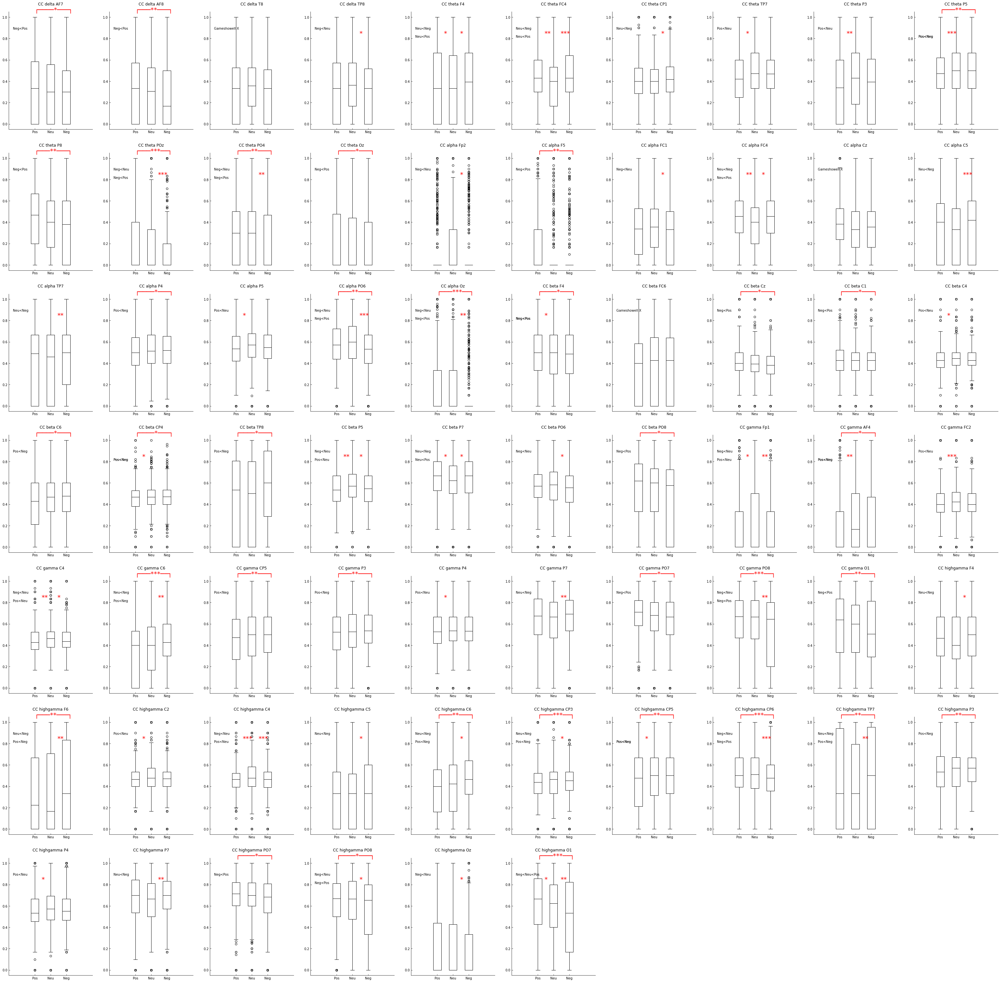

In [295]:
band = ['delta','theta','alpha', 'beta','gamma', 'highgamma']
sub = 1
plt.figure(figsize=(55, 55))
for i, bd in enumerate(band):
    a = list(cc_anova[bd].keys())
    for q, ch in enumerate(a):
        data = C_C.loc[(C_C['band']==bd) & (C_C['ch']==ch)]

        plt.subplot(7,10,sub)
        
        bpl =pd.DataFrame(data[data['valence']=='Positive']).boxplot(grid=False,color = 'k',widths=0.15,positions=np.array(range(1))*2.0-0.3)
        bps = pd.DataFrame(data[data['valence']=='Neutral']).boxplot(grid=False ,color = 'k',widths=0.15,positions=np.array(range(1))*2.0)
        bpr = pd.DataFrame(data[data['valence']=='Negative']).boxplot(grid=False ,color = 'k',widths=0.15,positions=np.array(range(1))*2.0+0.3)

        plt.xticks([-0.3,0,0.3], ['Pos','Neu',  'Neg'])
        plt.gca().spines[['top', 'right']].set_visible(False)
        plt.tick_params(axis='x', direction='in', top=False)
        plt.tick_params(axis='y', direction='in', top=False)
        count =0
        
        if cc_anova[bd][ch]['A']<0.05:
            count += 1
            ff1(cc_anova[bd][ch]['A'])
            
        if cc_anova[bd][ch]['B']<0.05:
            count += 1 
            ff2(cc_anova[bd][ch]['B'])
            
        if cc_anova[bd][ch]['C']<0.05:
            count += 1
            ff3(cc_anova[bd][ch]['C'])     
            
            
        if cc_anova[bd][ch]['A']>0.05 and cc_anova[bd][ch]['B']>0.05 and cc_anova[bd][ch]['C']>0.05:
            plt.annotate('Gameshowell X', xy=(0.05, 0.85), xycoords='axes fraction')
            
        pos =np.mean(data[data['valence']=='Positive']['value'])
        neg = np.mean(data[data['valence']=='Negative']['value'])
        neu = np.mean(data[data['valence']=='Neutral']['value'])
        
        
        if cc_anova[bd][ch]['A']<0.05:
            if count == 1:
                if neg<neu:
                    plt.annotate('Neg<Neu', xy=(0.05, 0.85), xycoords='axes fraction')
                else:
                    plt.annotate('Neu<Neg', xy=(0.05, 0.85), xycoords='axes fraction')
                    
            if count == 2:
                if neg<neu:
                    plt.annotate('Neg<Neu', xy=(0.05, 0.85), xycoords='axes fraction')
                else:
                    plt.annotate('Neu<Neg', xy=(0.05, 0.85), xycoords='axes fraction')
                    
            elif count == 3:
                if pos<neg<neu:
                     plt.annotate('Pos<Neg<Neu', xy=(0.05, 0.85), xycoords='axes fraction')
                elif pos<neu<neg:
                    plt.annotate('Pos<Neu<Neg', xy=(0.05, 0.85), xycoords='axes fraction')
                elif neg<neu<pos:
                    plt.annotate('Neg<Neu<Pos', xy=(0.05, 0.85), xycoords='axes fraction')
                elif neg<pos<neu:
                    plt.annotate('Neg<Pos<Neu', xy=(0.05, 0.85), xycoords='axes fraction')
                elif neu<pos<neg:
                    plt.annotate('Neu<Pos<Neg', xy=(0.05, 0.85), xycoords='axes fraction')
                elif neu<neg<pos:
                    plt.annotate('Neu<Neg<Pos', xy=(0.05, 0.85), xycoords='axes fraction')
                
                
        if cc_anova[bd][ch]['B']<0.05:
            if count == 1:
                if pos<neg:
                    plt.annotate('Pos<Neg', xy=(0.05, 0.85), xycoords='axes fraction')
                else:
                    plt.annotate('Neg<Pos', xy=(0.05, 0.85), xycoords='axes fraction')
            if count == 2:
                if pos<neg:
                    plt.annotate('Pos<Neg', xy=(0.05, 0.78), xycoords='axes fraction')
                else:
                    plt.annotate('Neg<Pos', xy=(0.05, 0.78), xycoords='axes fraction')
        
        
        if cc_anova[bd][ch]['C']<0.05:
            if count == 1:
                if pos<neu:
                    plt.annotate('Pos<Neu', xy=(0.05, 0.85), xycoords='axes fraction')
                else:
                    plt.annotate('Neu<Pos', xy=(0.05, 0.85), xycoords='axes fraction')
                    
                    
            if count == 2:
                if pos<neu:
                    plt.annotate('Pos<Neu', xy=(0.05, 0.78), xycoords='axes fraction')
                else:
                    plt.annotate('Neu<Pos', xy=(0.05, 0.78), xycoords='axes fraction')
                
        plt.title("CC {} {}".format(bd,ch), pad=20)
        sub+=1

plt.savefig("COH_CC.jpg", dpi= 600,bbox_inches='tight') 


In [301]:
band = ['delta','theta','alpha', 'beta','gamma','highgamma']
leng =0
for bd in band:
    leng += len(list(bc_anova[bd].keys()))
print(leng)

75


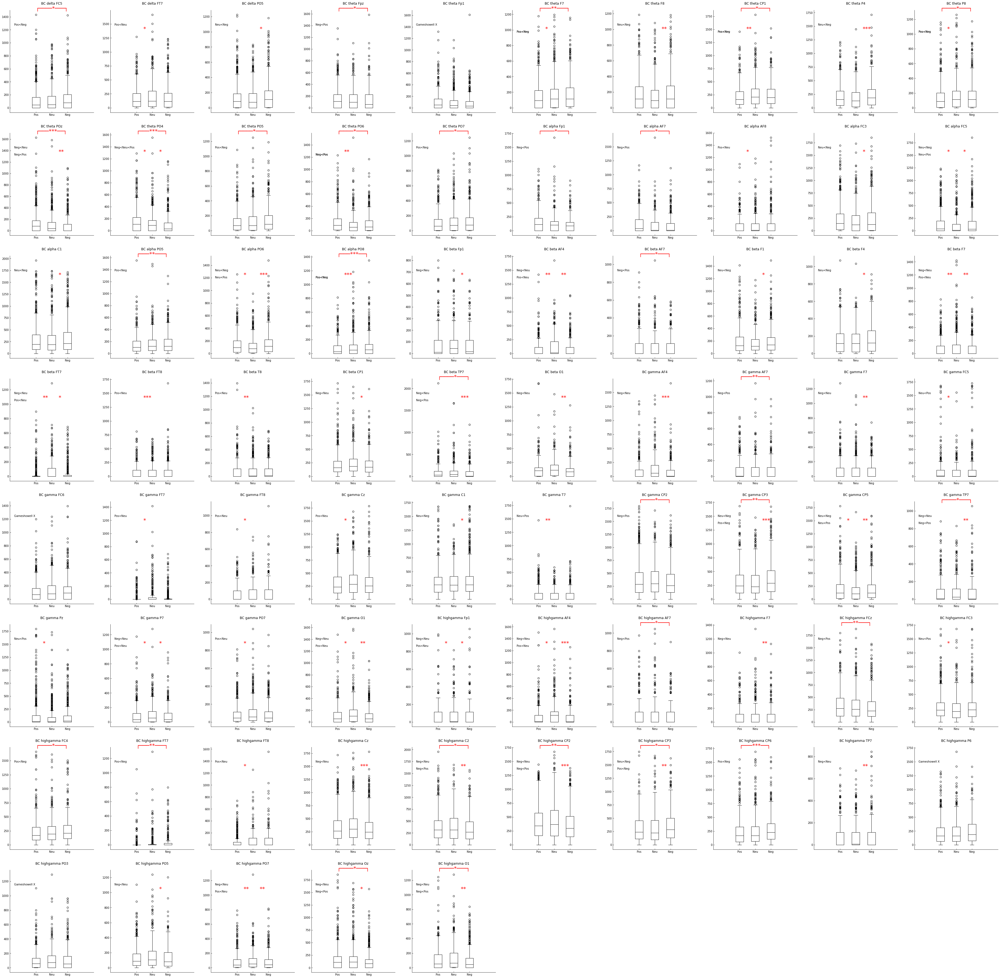

In [308]:
band = ['delta','theta','alpha', 'beta','gamma','highgamma']
sub = 1
plt.figure(figsize=(65, 65))
for bd in band:
    a = list(bc_anova[bd].keys())
    for ch in a:
        plt.subplot(8,10,sub)
        data = B_C.loc[(B_C['band']==bd) & (B_C['ch']==ch)]
        
        bpl =pd.DataFrame(data[data['valence']=='Positive']).boxplot(grid=False,color = 'k',widths=0.15,positions=np.array(range(1))*2.0-0.3)
        bps = pd.DataFrame(data[data['valence']=='Neutral']).boxplot(grid=False ,color = 'k',widths=0.15,positions=np.array(range(1))*2.0)
        bpr = pd.DataFrame(data[data['valence']=='Negative']).boxplot(grid=False ,color = 'k',widths=0.15,positions=np.array(range(1))*2.0+0.3)

        plt.xticks([-0.3,0,0.3], ['Pos','Neu',  'Neg'])
        plt.gca().spines[['top', 'right']].set_visible(False)
        plt.tick_params(axis='x', direction='in', top=False)
        plt.tick_params(axis='y', direction='in', top=False)
        count =0
        
        if bc_anova[bd][ch]['A']<0.05:
            count += 1
            ff1(bc_anova[bd][ch]['A'])
            
        if bc_anova[bd][ch]['B']<0.05:
            count += 1
            ff2(bc_anova[bd][ch]['B'])
            
        if bc_anova[bd][ch]['C']<0.05:
            count += 1
            ff3(bc_anova[bd][ch]['C'])
            
        if bc_anova[bd][ch]['A']>0.05 and bc_anova[bd][ch]['B']>0.05 and bc_anova[bd][ch]['C']>0.05:
            plt.annotate('Gameshowell X', xy=(0.05, 0.85), xycoords='axes fraction')
            
        pos =np.mean(data[data['valence']=='Positive']['value'])
        neg = np.mean(data[data['valence']=='Negative']['value'])
        neu = np.mean(data[data['valence']=='Neutral']['value'])
        
        
        if bc_anova[bd][ch]['A']<0.05:
            if count == 1:
                if neg<neu:
                    plt.annotate('Neg<Neu', xy=(0.05, 0.85), xycoords='axes fraction')
                else:
                    plt.annotate('Neu<Neg', xy=(0.05, 0.85), xycoords='axes fraction')
                    
            if count == 2:
                if neg<neu:
                    plt.annotate('Neg<Neu', xy=(0.05, 0.85), xycoords='axes fraction')
                else:
                    plt.annotate('Neu<Neg', xy=(0.05, 0.85), xycoords='axes fraction')
                    
            elif count == 3:
                if pos<neg<neu:
                     plt.annotate('Pos<Neg<Neu', xy=(0.05, 0.85), xycoords='axes fraction')
                elif pos<neu<neg:
                    plt.annotate('Pos<Neu<Neg', xy=(0.05, 0.85), xycoords='axes fraction')
                elif neg<neu<pos:
                    plt.annotate('Neg<Neu<Pos', xy=(0.05, 0.85), xycoords='axes fraction')
                elif neg<pos<neu:
                    plt.annotate('Neg<Pos<Neu', xy=(0.05, 0.85), xycoords='axes fraction')
                elif neu<pos<neg:
                    plt.annotate('Neu<Pos<Neg', xy=(0.05, 0.85), xycoords='axes fraction')
                elif neu<neg<pos:
                    plt.annotate('Neu<Neg<Pos', xy=(0.05, 0.85), xycoords='axes fraction')
                
                
        if bc_anova[bd][ch]['B']<0.05:
            if count == 1:
                if pos<neg:
                    plt.annotate('Pos<Neg', xy=(0.05, 0.85), xycoords='axes fraction')
                else:
                    plt.annotate('Neg<Pos', xy=(0.05, 0.85), xycoords='axes fraction')
            if count == 2:
                if pos<neg:
                    plt.annotate('Pos<Neg', xy=(0.05, 0.78), xycoords='axes fraction')
                else:
                    plt.annotate('Neg<Pos', xy=(0.05, 0.78), xycoords='axes fraction')
        
        
        if bc_anova[bd][ch]['C']<0.05:
            if count == 1:
                if pos<neu:
                    plt.annotate('Pos<Neu', xy=(0.05, 0.85), xycoords='axes fraction')
                else:
                    plt.annotate('Neu<Pos', xy=(0.05, 0.85), xycoords='axes fraction')
                    
                    
            if count == 2:
                if pos<neu:
                    plt.annotate('Pos<Neu', xy=(0.05, 0.78), xycoords='axes fraction')
                else:
                    plt.annotate('Neu<Pos', xy=(0.05, 0.78), xycoords='axes fraction')
                
        plt.title("BC {} {}".format(bd,ch), pad=20)
        sub += 1

plt.savefig("COH_BC.jpg", dpi= 600,bbox_inches='tight')

In [309]:
band = ['delta','theta','alpha', 'beta','gamma','highgamma']
leng =0
for bd in band:
    leng += len(list(nd_anova[bd].keys()))
print(leng)

101


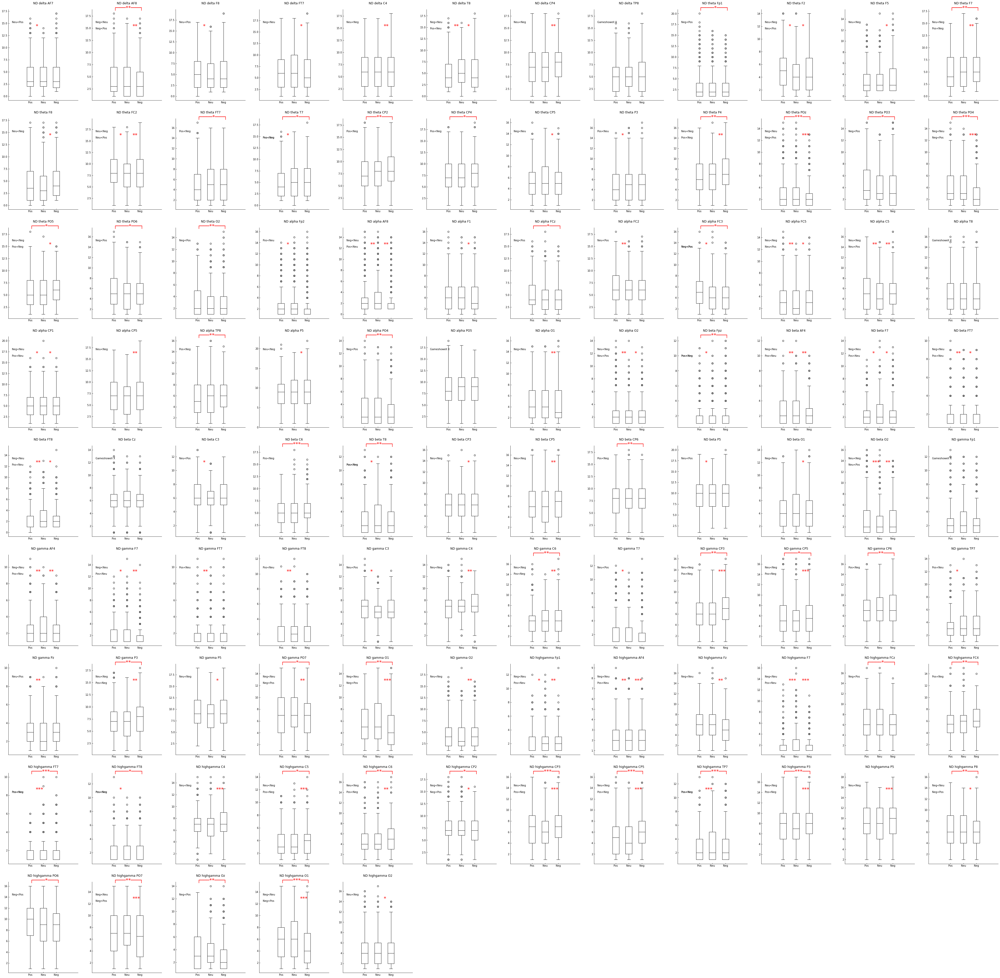

In [311]:
band = ['delta','theta','alpha', 'beta','gamma','highgamma']
sub = 1
plt.figure(figsize=(70, 70))
for bd in band:
    a = list(nd_anova[bd].keys())
    for ch in a:
        data = N_D.loc[(N_D['band']==bd) & (N_D['ch']==ch)]
        plt.subplot(9,12,sub)
        bpl =pd.DataFrame(data[data['valence']=='Positive']).boxplot(grid=False,color = 'k',widths=0.15,positions=np.array(range(1))*2.0-0.3)
        bps = pd.DataFrame(data[data['valence']=='Neutral']).boxplot(grid=False ,color = 'k',widths=0.15,positions=np.array(range(1))*2.0)
        bpr = pd.DataFrame(data[data['valence']=='Negative']).boxplot(grid=False ,color = 'k',widths=0.15,positions=np.array(range(1))*2.0+0.3)

        plt.xticks([-0.3,0,0.3], ['Pos','Neu',  'Neg'])
        plt.gca().spines[['top', 'right']].set_visible(False)
        plt.tick_params(axis='x', direction='in', top=False)
        plt.tick_params(axis='y', direction='in', top=False)
        count =0
        
        if nd_anova[bd][ch]['A']<0.05:
            count += 1
            ff1(nd_anova[bd][ch]['A'])   
            
        if nd_anova[bd][ch]['B']<0.05:
            count += 1 
            ff2(nd_anova[bd][ch]['B'])  
            
        if nd_anova[bd][ch]['C']<0.05:
            count += 1
            ff3(nd_anova[bd][ch]['C']) 
            
        if nd_anova[bd][ch]['A']>0.05 and nd_anova[bd][ch]['B']>0.05 and nd_anova[bd][ch]['C']>0.05:
            plt.annotate('Gameshowell X', xy=(0.05, 0.85), xycoords='axes fraction')
            
        pos = np.mean(data[data['valence']=='Positive']['value'])
        neg = np.mean(data[data['valence']=='Negative']['value'])
        neu = np.mean(data[data['valence']=='Neutral']['value'])
        
        
        if nd_anova[bd][ch]['A']<0.05:
            if count == 1:
                if neg<neu:
                    plt.annotate('Neg<Neu', xy=(0.05, 0.85), xycoords='axes fraction')
                else:
                    plt.annotate('Neu<Neg', xy=(0.05, 0.85), xycoords='axes fraction')
                    
            if count == 2:
                if neg<neu:
                    plt.annotate('Neg<Neu', xy=(0.05, 0.85), xycoords='axes fraction')
                else:
                    plt.annotate('Neu<Neg', xy=(0.05, 0.85), xycoords='axes fraction')
                    
            elif count == 3:
                if pos<neg<neu:
                     plt.annotate('Pos<Neg<Neu', xy=(0.05, 0.85), xycoords='axes fraction')
                elif pos<neu<neg:
                    plt.annotate('Pos<Neu<Neg', xy=(0.05, 0.85), xycoords='axes fraction')
                elif neg<neu<pos:
                    plt.annotate('Neg<Neu<Pos', xy=(0.05, 0.85), xycoords='axes fraction')
                elif neg<pos<neu:
                    plt.annotate('Neg<Pos<Neu', xy=(0.05, 0.85), xycoords='axes fraction')
                elif neu<pos<neg:
                    plt.annotate('Neu<Pos<Neg', xy=(0.05, 0.85), xycoords='axes fraction')
                elif neu<neg<pos:
                    plt.annotate('Neu<Neg<Pos', xy=(0.05, 0.85), xycoords='axes fraction')
                
                
        if nd_anova[bd][ch]['B']<0.05:
            if count == 1:
                if pos<neg:
                    plt.annotate('Pos<Neg', xy=(0.05, 0.85), xycoords='axes fraction')
                else:
                    plt.annotate('Neg<Pos', xy=(0.05, 0.85), xycoords='axes fraction')
            if count == 2:
                if pos<neg:
                    plt.annotate('Pos<Neg', xy=(0.05, 0.78), xycoords='axes fraction')
                else:
                    plt.annotate('Neg<Pos', xy=(0.05, 0.78), xycoords='axes fraction')
        
        
        if nd_anova[bd][ch]['C']<0.05:
            if count == 1:
                if pos<neu:
                    plt.annotate('Pos<Neu', xy=(0.05, 0.85), xycoords='axes fraction')
                else:
                    plt.annotate('Neu<Pos', xy=(0.05, 0.85), xycoords='axes fraction')
                    
            if count == 2:
                if pos<neu:
                    plt.annotate('Pos<Neu', xy=(0.05, 0.78), xycoords='axes fraction')
                else:
                    plt.annotate('Neu<Pos', xy=(0.05, 0.78), xycoords='axes fraction')
        plt.title("ND {} {}".format(bd,ch), pad=20)
        sub += 1

plt.savefig("COH_ND.jpg", dpi= 600,bbox_inches='tight')

In [315]:
band = ['delta','theta','alpha', 'beta','gamma','highgamma']
leng =0
for bd in band:
    leng += len(list(le_anova[bd].keys()))
print(leng)

72


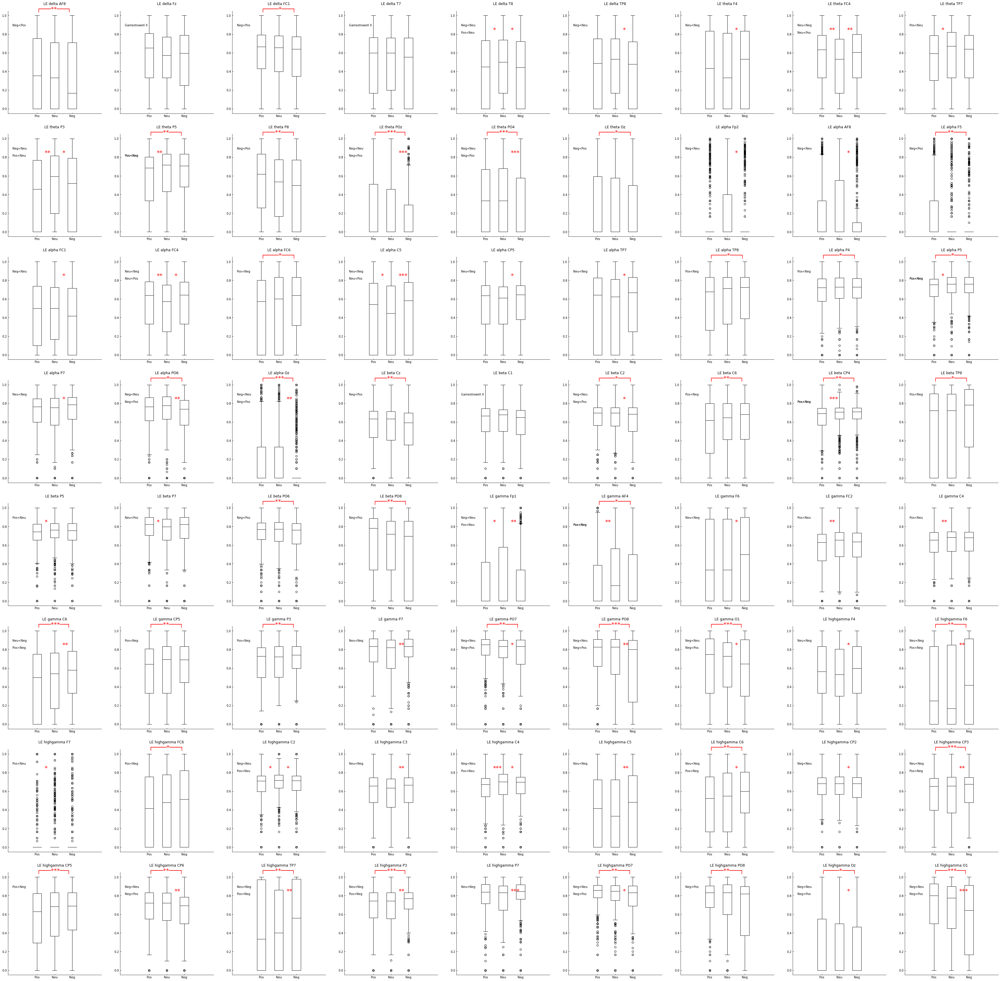

In [319]:
band = ['delta','theta','alpha', 'beta','gamma','highgamma']
sub = 1
plt.figure(figsize=(60, 60))
for bd in band:
    a = list(le_anova[bd].keys())
    for ch in a:
        plt.subplot(8,9,sub)
        data =L_E.loc[(L_E['band']==bd) & (L_E['ch']==ch)]
        bpl =pd.DataFrame(data[data['valence']=='Positive']).boxplot(grid=False,color = 'k',widths=0.15,positions=np.array(range(1))*2.0-0.3)
        bps = pd.DataFrame(data[data['valence']=='Neutral']).boxplot(grid=False ,color = 'k',widths=0.15,positions=np.array(range(1))*2.0)
        bpr = pd.DataFrame(data[data['valence']=='Negative']).boxplot(grid=False ,color = 'k',widths=0.15,positions=np.array(range(1))*2.0+0.3)

        plt.xticks([-0.3,0,0.3], ['Pos','Neu',  'Neg'])
        plt.gca().spines[['top', 'right']].set_visible(False)
        plt.tick_params(axis='x', direction='in', top=False)
        plt.tick_params(axis='y', direction='in', top=False)
        count =0
        
        if le_anova[bd][ch]['A']<0.05:
            count += 1
            ff1(le_anova[bd][ch]['A'])
            
        if le_anova[bd][ch]['B']<0.05:
            count += 1 
            ff2(le_anova[bd][ch]['B'])           
            
        if le_anova[bd][ch]['C']<0.05:
            count += 1
            ff3(le_anova[bd][ch]['C'])       
            
        if le_anova[bd][ch]['A']>0.05 and le_anova[bd][ch]['B']>0.05 and le_anova[bd][ch]['C']>0.05:
            plt.annotate('Gameshowell X', xy=(0.05, 0.85), xycoords='axes fraction')
            
        pos =np.mean(data[data['valence']=='Positive']['value'])
        neg = np.mean(data[data['valence']=='Negative']['value'])
        neu = np.mean(data[data['valence']=='Neutral']['value'])
        
        if le_anova[bd][ch]['A']<0.05:
            if count == 1:
                if neg<neu:
                    plt.annotate('Neg<Neu', xy=(0.05, 0.85), xycoords='axes fraction')
                else:
                    plt.annotate('Neu<Neg', xy=(0.05, 0.85), xycoords='axes fraction')
                    
            if count == 2:
                if neg<neu:
                    plt.annotate('Neg<Neu', xy=(0.05, 0.85), xycoords='axes fraction')
                else:
                    plt.annotate('Neu<Neg', xy=(0.05, 0.85), xycoords='axes fraction')
                    
            elif count == 3:
                if pos<neg<neu:
                     plt.annotate('Pos<Neg<Neu', xy=(0.05, 0.85), xycoords='axes fraction')
                elif pos<neu<neg:
                    plt.annotate('Pos<Neu<Neg', xy=(0.05, 0.85), xycoords='axes fraction')
                elif neg<neu<pos:
                    plt.annotate('Neg<Neu<Pos', xy=(0.05, 0.85), xycoords='axes fraction')
                elif neg<pos<neu:
                    plt.annotate('Neg<Pos<Neu', xy=(0.05, 0.85), xycoords='axes fraction')
                elif neu<pos<neg:
                    plt.annotate('Neu<Pos<Neg', xy=(0.05, 0.85), xycoords='axes fraction')
                elif neu<neg<pos:
                    plt.annotate('Neu<Neg<Pos', xy=(0.05, 0.85), xycoords='axes fraction')
                
        if le_anova[bd][ch]['B']<0.05:
            if count == 1:
                if pos<neg:
                    plt.annotate('Pos<Neg', xy=(0.05, 0.85), xycoords='axes fraction')
                else:
                    plt.annotate('Neg<Pos', xy=(0.05, 0.85), xycoords='axes fraction')
            if count == 2:
                if pos<neg:
                    plt.annotate('Pos<Neg', xy=(0.05, 0.78), xycoords='axes fraction')
                else:
                    plt.annotate('Neg<Pos', xy=(0.05, 0.78), xycoords='axes fraction')
        
        if le_anova[bd][ch]['C']<0.05:
            if count == 1:
                if pos<neu:
                    plt.annotate('Pos<Neu', xy=(0.05, 0.85), xycoords='axes fraction')
                else:
                    plt.annotate('Neu<Pos', xy=(0.05, 0.85), xycoords='axes fraction')
                    
            if count == 2:
                if pos<neu:
                    plt.annotate('Pos<Neu', xy=(0.05, 0.78), xycoords='axes fraction')
                else:
                    plt.annotate('Neu<Pos', xy=(0.05, 0.78), xycoords='axes fraction')
                
        plt.title("LE {} {}".format(bd,ch), pad=20)
        sub += 1

plt.savefig("COH_LE.jpg", dpi= 600,bbox_inches='tight')

In [320]:
band = ['delta','theta','alpha', 'beta','gamma', 'highgamma']
leng =0
for bd in band:
    leng += len(list(ev_anova[bd].keys()))
print(leng)

56


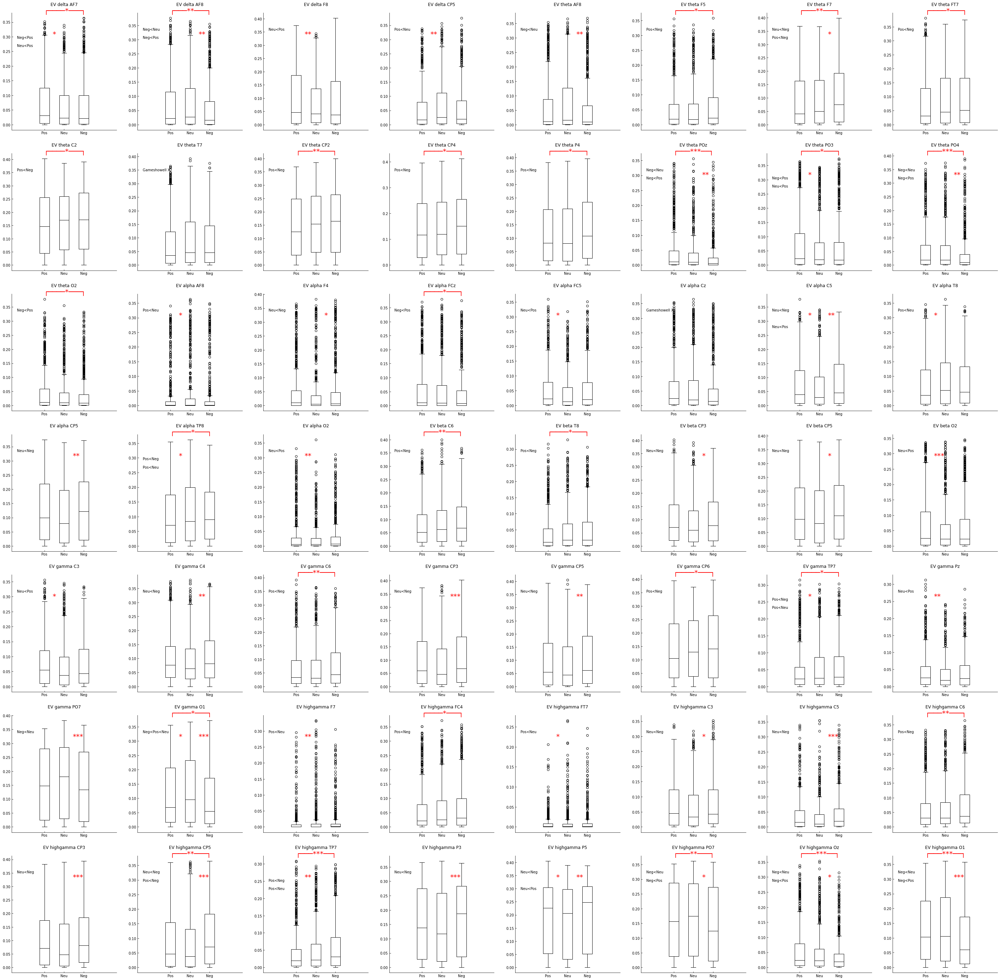

In [322]:
band = ['delta','theta','alpha', 'beta','gamma','highgamma']
sub = 1
plt.figure(figsize=(50, 50))

for bd in band:
    a = list(ev_anova[bd].keys())
    for ch in a:
        data = E_V.loc[(E_V['band']==bd) & (E_V['ch']==ch)]
        plt.subplot(7,8,sub)
        bpl =pd.DataFrame(data[data['valence']=='Positive']).boxplot(grid=False,color = 'k',widths=0.15,positions=np.array(range(1))*2.0-0.3)
        bps = pd.DataFrame(data[data['valence']=='Neutral']).boxplot(grid=False ,color = 'k',widths=0.15,positions=np.array(range(1))*2.0)
        bpr = pd.DataFrame(data[data['valence']=='Negative']).boxplot(grid=False ,color = 'k',widths=0.15,positions=np.array(range(1))*2.0+0.3)

        plt.xticks([-0.3,0,0.3], ['Pos','Neu',  'Neg'])
        plt.gca().spines[['top', 'right']].set_visible(False)
        plt.tick_params(axis='x', direction='in', top=False)
        plt.tick_params(axis='y', direction='in', top=False)
        count =0
        
        if ev_anova[bd][ch]['A']<0.05:
            count += 1
            ff1(ev_anova[bd][ch]['A'])
            
        if ev_anova[bd][ch]['B']<0.05:
            count += 1 
            ff2(ev_anova[bd][ch]['B'])
        if ev_anova[bd][ch]['C']<0.05:
            count += 1
            ff3(ev_anova[bd][ch]['C'])
            
            
        if ev_anova[bd][ch]['A']>0.05 and ev_anova[bd][ch]['B']>0.05 and ev_anova[bd][ch]['C']>0.05:
            plt.annotate('Gameshowell X', xy=(0.05, 0.85), xycoords='axes fraction')
            
        pos =np.mean(data[data['valence']=='Positive']['value'])
        neg = np.mean(data[data['valence']=='Negative']['value'])
        neu = np.mean(data[data['valence']=='Neutral']['value'])
        
        
        if ev_anova[bd][ch]['A']<0.05:
            if count == 1:
                if neg<neu:
                    plt.annotate('Neg<Neu', xy=(0.05, 0.85), xycoords='axes fraction')
                else:
                    plt.annotate('Neu<Neg', xy=(0.05, 0.85), xycoords='axes fraction')
                    
            if count == 2:
                if neg<neu:
                    plt.annotate('Neg<Neu', xy=(0.05, 0.85), xycoords='axes fraction')
                else:
                    plt.annotate('Neu<Neg', xy=(0.05, 0.85), xycoords='axes fraction')
                    
            elif count == 3:
                if pos<neg<neu:
                     plt.annotate('Pos<Neg<Neu', xy=(0.05, 0.85), xycoords='axes fraction')
                elif pos<neu<neg:
                    plt.annotate('Pos<Neu<Neg', xy=(0.05, 0.85), xycoords='axes fraction')
                elif neg<neu<pos:
                    plt.annotate('Neg<Neu<Pos', xy=(0.05, 0.85), xycoords='axes fraction')
                elif neg<pos<neu:
                    plt.annotate('Neg<Pos<Neu', xy=(0.05, 0.85), xycoords='axes fraction')
                elif neu<pos<neg:
                    plt.annotate('Neu<Pos<Neg', xy=(0.05, 0.85), xycoords='axes fraction')
                elif neu<neg<pos:
                    plt.annotate('Neu<Neg<Pos', xy=(0.05, 0.85), xycoords='axes fraction')
                
                
        if ev_anova[bd][ch]['B']<0.05:
            if count == 1:
                if pos<neg:
                    plt.annotate('Pos<Neg', xy=(0.05, 0.85), xycoords='axes fraction')
                else:
                    plt.annotate('Neg<Pos', xy=(0.05, 0.85), xycoords='axes fraction')
            if count == 2:
                if pos<neg:
                    plt.annotate('Pos<Neg', xy=(0.05, 0.78), xycoords='axes fraction')
                else:
                    plt.annotate('Neg<Pos', xy=(0.05, 0.78), xycoords='axes fraction')
        
        
        if ev_anova[bd][ch]['C']<0.05:
            if count == 1:
                if pos<neu:
                    plt.annotate('Pos<Neu', xy=(0.05, 0.85), xycoords='axes fraction')
                else:
                    plt.annotate('Neu<Pos', xy=(0.05, 0.85), xycoords='axes fraction')
                    
                    
            if count == 2:
                if pos<neu:
                    plt.annotate('Pos<Neu', xy=(0.05, 0.71), xycoords='axes fraction')
                else:
                    plt.annotate('Neu<Pos', xy=(0.05, 0.71), xycoords='axes fraction')
        plt.title("EV {} {}".format(bd,ch), pad=20)
        sub += 1
plt.savefig("COH_EV.jpg", dpi= 600,bbox_inches='tight')

In [323]:
'''
T-map
'''

group = ['A', 'B', 'C']
graph = ['cc','bc','nd','le','ev']
band = ['delta','theta','alpha', 'beta','gamma','highgamma']


for gr in graph:
    for g in group:
        for bd in band:
            globals()['{}_{}_{}'.format(gr, g, bd)]=[]

            for ch in ch_names:
                globals()['{}_{}_{}'.format(gr, g, bd)].append(globals()['{}_Ttest'.format(gr)][bd][ch][g])

Text(0.5, 1.02, 'Clustering Coefficient T-value')

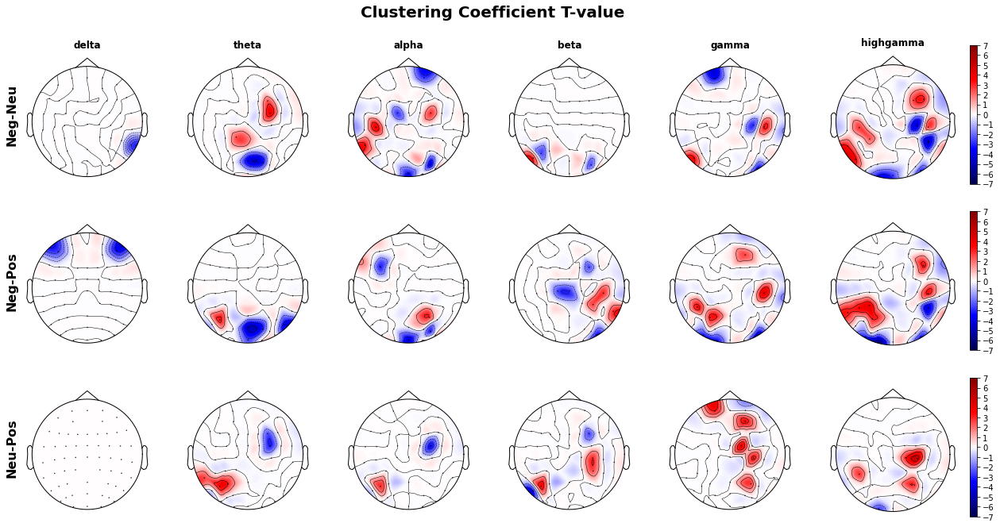

In [325]:
import numpy as np
import mne

fig, ax = plt.subplots(nrows=3,ncols=6, figsize=(22, 10),gridspec_kw={'width_ratios': [12, 12,12,12,12,15.5]},
                       sharex=True, sharey=True)
np.random.seed(1)

group = ['A', 'B', 'C']
graph = ['cc','bc','nd','le','ev']
band = ['delta','theta','alpha', 'beta','gamma','highgamma']
a = ['Neg-Neu','Neg-Pos','Neu-Pos']

vmin=1000000
vmax=-100000

    
for i, g in enumerate(group):
    for q, bd in enumerate(band):
        
        vmin=1000000
        vmax=-100000
        vmin =min(min(globals()['cc_{}_{}'.format(g, bd)]), vmin)
        vmax =max(max(globals()['cc_{}_{}'.format(g, bd)]), vmax)
        
        
        mne.viz.plot_topomap(globals()['cc_{}_{}'.format(g, bd)], custom_evoked.info, axes=ax[i][q],show=False,cmap ='seismic',
                            sphere = 0.108,vmin= -7, vmax=7)
        if i == 0:
            ax[i][q].set_title(bd,fontweight='bold')
        if q ==0:
            ax[i][q].set_ylabel(a[i],fontweight='bold',fontsize=16)
        if q == 5:
            mynorm = plt.Normalize(vmin = -7, vmax = 7)
            sm = plt.cm.ScalarMappable(cmap='seismic', norm=mynorm)
            sm_= plt.colorbar(sm, ax = ax[i][q],ticks=[-7,-6,-5,-4,-3,-2,-1,0,1,2,3,4,5,6,7])
                        
plt.suptitle("Clustering Coefficient T-value",fontweight='bold', fontsize=20, y=1.02)
#plt.savefig("Eigenvector_centrality_topomap",dpi  = 600) 

Text(0.5, 1.02, 'Betweenness Centrality T-value')

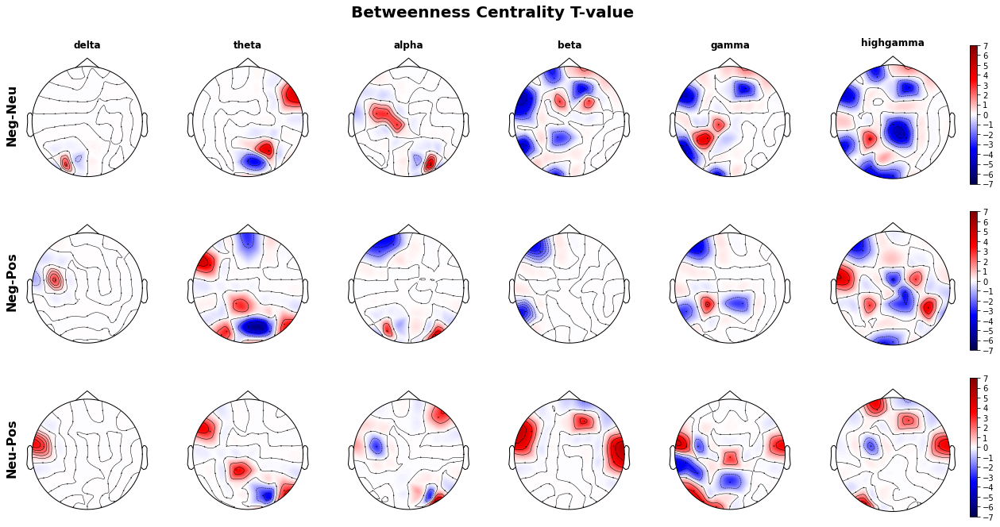

In [326]:
import numpy as np
import mne


fig, ax = plt.subplots(nrows=3,ncols=6, figsize=(22, 10),gridspec_kw={'width_ratios': [12, 12,12,12,12,15.5]},
                       sharex=True, sharey=True)
np.random.seed(1)

group = ['A', 'B', 'C']
graph = ['cc','bc','nd','le','ev']
band = ['delta','theta','alpha', 'beta','gamma','highgamma']
a = ['Neg-Neu','Neg-Pos','Neu-Pos']

vmin=1000000
vmax=-100000

    
for i, g in enumerate(group):
    for q, bd in enumerate(band):
        
        vmin=1000000
        vmax=-100000
        vmin =min(min(globals()['bc_{}_{}'.format(g, bd)]), vmin)
        vmax =max(max(globals()['bc_{}_{}'.format(g, bd)]), vmax)
        
        
        mne.viz.plot_topomap(globals()['bc_{}_{}'.format(g, bd)], custom_evoked.info, axes=ax[i][q],show=False,cmap ='seismic',
                            sphere = 0.108,vmin= -7, vmax=7)
        if i == 0:
            ax[i][q].set_title(bd,fontweight='bold')
        if q ==0:
            ax[i][q].set_ylabel(a[i],fontweight='bold',fontsize=16)
        if q == 5:
            mynorm = plt.Normalize(vmin = -7, vmax = 7)
            sm = plt.cm.ScalarMappable(cmap='seismic', norm=mynorm)
            sm_= plt.colorbar(sm, ax = ax[i][q],ticks=[-7,-6,-5,-4,-3,-2,-1,0,1,2,3,4,5,6,7])
                        
plt.suptitle("Betweenness Centrality T-value",fontweight='bold', fontsize=20, y=1.02)
#plt.savefig("Eigenvector_centrality_topomap",dpi  = 600) 

Text(0.5, 1.02, 'Node Degree T-value')

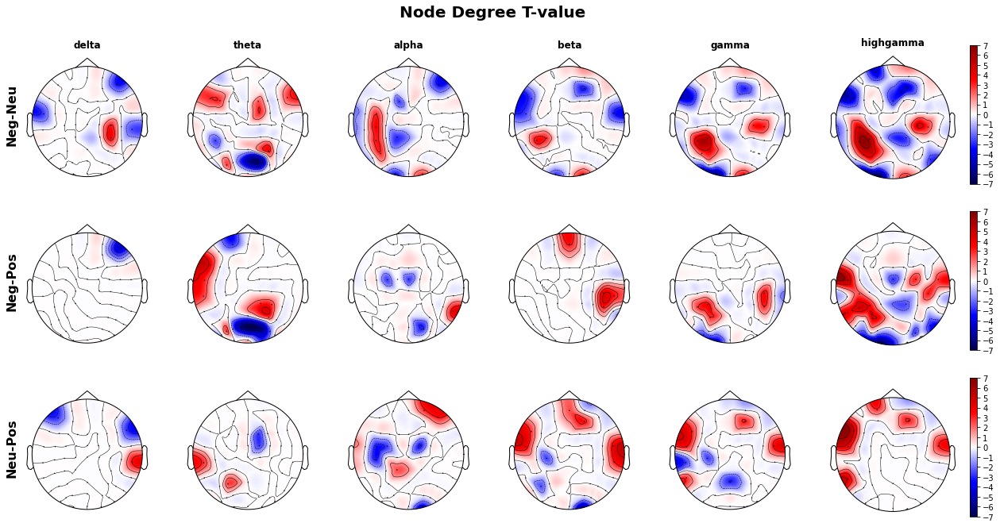

In [327]:
import numpy as np
import mne

fig, ax = plt.subplots(nrows=3,ncols=6, figsize=(22, 10),gridspec_kw={'width_ratios': [12, 12,12,12,12,15.5]},
                       sharex=True, sharey=True)
np.random.seed(1)

group = ['A', 'B', 'C']
graph = ['cc','bc','nd','le','ev']
band = ['delta','theta','alpha', 'beta','gamma','highgamma']
a = ['Neg-Neu','Neg-Pos','Neu-Pos']


vmin=1000000
vmax=-100000

    
for i, g in enumerate(group):
    for q, bd in enumerate(band):
        
        vmin=1000000
        vmax=-100000
        vmin =min(min(globals()['nd_{}_{}'.format(g, bd)]), vmin)
        vmax =max(max(globals()['nd_{}_{}'.format(g, bd)]), vmax)
        
        
        mne.viz.plot_topomap(globals()['nd_{}_{}'.format(g, bd)], custom_evoked.info, axes=ax[i][q],show=False,cmap ='seismic',
                            sphere = 0.108,vmin= -7, vmax=7)
        if i == 0:
            ax[i][q].set_title(bd,fontweight='bold')
        if q ==0:
            ax[i][q].set_ylabel(a[i],fontweight='bold',fontsize=16)
        if q == 5:
            mynorm = plt.Normalize(vmin = -7, vmax = 7)
            sm = plt.cm.ScalarMappable(cmap='seismic', norm=mynorm)
            sm_= plt.colorbar(sm, ax = ax[i][q],ticks=[-7,-6,-5,-4,-3,-2,-1,0,1,2,3,4,5,6,7])
                        
plt.suptitle("Node Degree T-value",fontweight='bold', fontsize=20, y=1.02)
#plt.savefig("Eigenvector_centrality_topomap",dpi  = 600) 

Text(0.5, 1.02, 'Local Efficiency T-value')

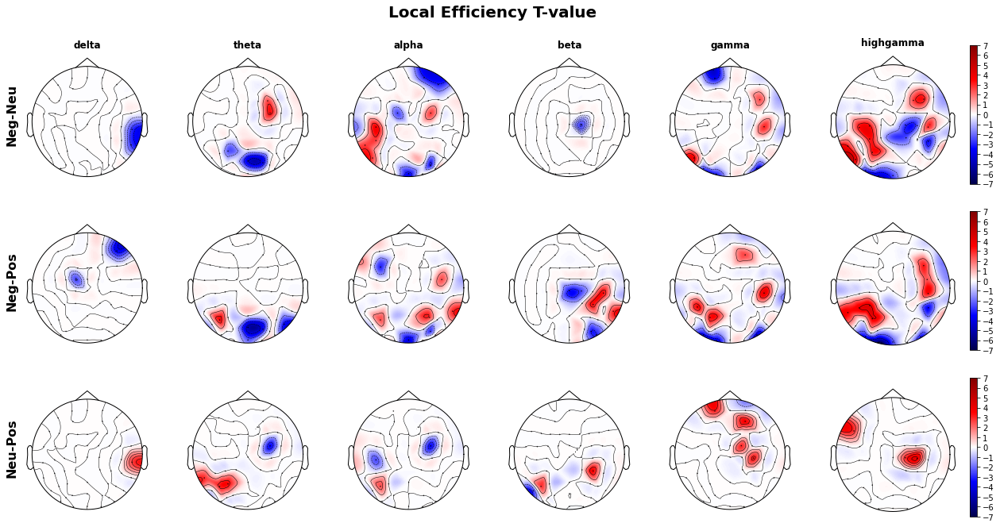

In [328]:
import numpy as np
import mne

fig, ax = plt.subplots(nrows=3,ncols=6, figsize=(22, 10),gridspec_kw={'width_ratios': [12, 12,12,12,12,15.5]},
                       sharex=True, sharey=True)
np.random.seed(1)

group = ['A', 'B', 'C']
graph = ['cc','bc','nd','le','ev']
band = ['delta','theta','alpha', 'beta','gamma','highgamma']
a = ['Neg-Neu','Neg-Pos','Neu-Pos']

vmin=1000000
vmax=-100000

    
for i, g in enumerate(group):
    for q, bd in enumerate(band):
        
        vmin=1000000
        vmax=-100000
        vmin =min(min(globals()['le_{}_{}'.format(g, bd)]), vmin)
        vmax =max(max(globals()['le_{}_{}'.format(g, bd)]), vmax)
        
        
        mne.viz.plot_topomap(globals()['le_{}_{}'.format(g, bd)], custom_evoked.info, axes=ax[i][q],show=False,cmap ='seismic',
                            sphere = 0.108,vmin= -7, vmax=7)
        if i == 0:
            ax[i][q].set_title(bd,fontweight='bold')
        if q ==0:
            ax[i][q].set_ylabel(a[i],fontweight='bold',fontsize=16)
        if q == 5:
            mynorm = plt.Normalize(vmin = -7, vmax =7)
            sm = plt.cm.ScalarMappable(cmap='seismic', norm=mynorm)
            sm_= plt.colorbar(sm, ax = ax[i][q],ticks=[-7,-6,-5,-4,-3,-2,-1,0,1,2,3,4,5,6,7])
                        
plt.suptitle("Local Efficiency T-value",fontweight='bold', fontsize=20, y=1.02)
#plt.savefig("Eigenvector_centrality_topomap",dpi  = 600) 

Text(0.5, 1.02, 'Eigenvector Centrality T-value')

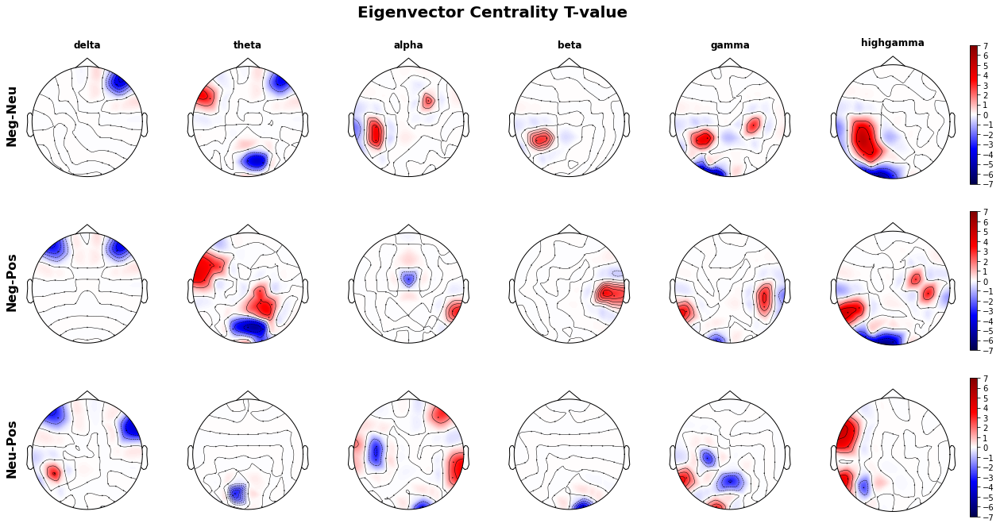

In [329]:
import numpy as np
import mne


fig, ax = plt.subplots(nrows=3,ncols=6, figsize=(22, 10),gridspec_kw={'width_ratios': [12, 12,12,12,12,15.5]},
                       sharex=True, sharey=True)
np.random.seed(1)

group = ['A', 'B', 'C']
graph = ['cc','bc','nd','le','ev']
band = ['delta','theta','alpha', 'beta','gamma','highgamma']
a = ['Neg-Neu','Neg-Pos','Neu-Pos']


vmin=1000000
vmax=-100000

    
for i, g in enumerate(group):
    for q, bd in enumerate(band):
        
        vmin=1000000
        vmax=-100000
        vmin =min(min(globals()['ev_{}_{}'.format(g, bd)]), vmin)
        vmax =max(max(globals()['ev_{}_{}'.format(g, bd)]), vmax)
        
        
        mne.viz.plot_topomap(globals()['ev_{}_{}'.format(g, bd)], custom_evoked.info, axes=ax[i][q],show=False,cmap ='seismic',
                            sphere = 0.108,vmin= -7, vmax=7)
        if i == 0:
            ax[i][q].set_title(bd,fontweight='bold')
        if q ==0:
            ax[i][q].set_ylabel(a[i],fontweight='bold',fontsize=16)
        if q == 5:
            mynorm = plt.Normalize(vmin = -7, vmax = 7)
            sm = plt.cm.ScalarMappable(cmap='seismic', norm=mynorm)
            sm_= plt.colorbar(sm, ax = ax[i][q],ticks=[-7,-6,-5,-4,-3,-2,-1,0,1,2,3,4,5,6,7])
                        
plt.suptitle("Eigenvector Centrality T-value",fontweight='bold', fontsize=20, y=1.02)
#plt.savefig("Eigenvector_centrality_topomap",dpi  = 600) 

# Calculating small worldness 

small worldness is calculated below formula.

### SW = (C/Cr) / (L/Lr) 
1. C is clustering coefficient, L is characteristic path length.  
2. Cr is clustering coefficient of randomized Network, caculated by mean of 100 times iteration. 
3. Lr is characteristic path length of radomized Network, calculated by mean of 100 times iteration.  

>> https://link.springer.com/article/10.1007/s00429-015-1035-6
>> https://www.sciencedirect.com/science/article/pii/S1053811916304359

In [ ]:

def check(mat):
    a = np.triu(mat)
    a += a.T - np.diag(a.diagonal())
    leng = len(mat[0])
    
    per = 0
    for i in range(leng):
        for j in range(leng):
            if a[i][j]==mat[i][j]:
                per += 1
    return per/(leng*leng)
for fr in bandfreq:
    percent = 0
    for num in range(globals()['positive_{}_EEG'.format(fr[2])].shape[0]): # Positive Length:
        percent += check(globals()['Positive_{}_{}_corrcoef_Matrix_binarize'.format(fr[2], num)])
    print('Positive_{}_corrcoef_Matrix_binarize'.format(fr[2]),"accuracy is ",percent/708)
        
for fr in bandfreq:
    percent = 0
    for num in range(globals()['negative_{}_EEG'.format(fr[2])].shape[0]): 
        percent += check(globals()['Negative_{}_{}_corrcoef_Matrix_binarize'.format(fr[2], num)])
    print('Negative_{}_corrcoef_Matrix_binarize'.format(fr[2]),"accuracy is ",percent/696)
    
for fr in bandfreq:
    percent = 0
    for num in range(globals()['neutral_{}_EEG'.format(fr[2])].shape[0]): 
        percent += check(globals()['Neutral_{}_{}_corrcoef_Matrix_binarize'.format(fr[2], num)])
    print('Neutral_{}_corrcoef_Matrix_binarize'.format(fr[2]),"accuracy is ",percent/639)

In [347]:
'''
Example
'''

a = np.array(clu_Positive_delta)
b = a[707]
b.mean()
ex =Positive_delta_0_corrcoef_Matrix_binarize
ex1 = bc.reference.randmio_und_connected(ex, 1)
ex1000 = bc.reference.randmio_und_connected(ex, 1000)

In [370]:
'''
Random Network 생성
'''
current_time = datetime.now()
print(current_time)
start = time.time()

bandfreq = [[0,5,'delta'],[5,9,'theta'],[9,15,'alpha'],[15,32,'beta'],[32,52,'gamma'],[52,83,'highgamma']]

not_connect =[]
for fr in bandfreq:
    for num in range(708): # Positive Length:
        _, csize = bc.clustering.get_components(globals()['Positive_{}_{}_corrcoef_Matrix_binarize'.format(fr[2], num)])
        if len(csize)>1:
            not_connect.append(['Positive_{}_{}'.format(fr[2], num)])
        else:
            globals()['Positive_{}_{}_random'.format(fr[2], num)] = bc.reference.randmio_und_connected(globals()['Positive_{}_{}_corrcoef_Matrix_binarize'.format(fr[2], num)],100)[0]
    print("Positive",fr[2],"is done")

for fr in bandfreq:
    for num in range(696): #Negative Length
        _, csize = bc.clustering.get_components(globals()['Negative_{}_{}_corrcoef_Matrix_binarize'.format(fr[2], num)])
        if len(csize)>1:
            not_connect.append(['Negative_{}_{}'.format(fr[2], num)])
        else:
            globals()['Negative_{}_{}_random'.format(fr[2], num)] = bc.reference.randmio_und_connected(globals()['Negative_{}_{}_corrcoef_Matrix_binarize'.format(fr[2], num)],100)[0]
    print("Negative",fr[2],"is done")

for fr in bandfreq:
    for num in range(639): #Neutral Length
        _, csize = bc.clustering.get_components(globals()['Neutral_{}_{}_corrcoef_Matrix_binarize'.format(fr[2], num)])
        if len(csize)>1:
            not_connect.append(['Neutral_{}_{}'.format(fr[2], num)])
        else:
            globals()['Neutral_{}_{}_random'.format(fr[2], num)] = bc.reference.randmio_und_connected(globals()['Neutral_{}_{}_corrcoef_Matrix_binarize'.format(fr[2], num)],100)[0]
    print("Neutral",fr[2],"is done")

print("time :", ((time.time() - start)/60)/60 ,"hours")
current_time = datetime.now()
print(current_time)

2022-06-01 16:32:22.867613
Positive delta is done
Positive theta is done
Positive alpha is done
Positive beta is done
Positive gamma is done
Positive highgamma is done
Negative delta is done
Negative theta is done
Negative alpha is done
Negative beta is done
Negative gamma is done
Negative highgamma is done
Neutral delta is done
Neutral theta is done
Neutral alpha is done
Neutral beta is done
Neutral gamma is done
Neutral highgamma is done
time : 1.502288712925381 hours
2022-06-01 18:02:31.106980


In [382]:
not__connect =[]
for i in not_connect:
    not__connect.append(i[0])

<AxesSubplot:>

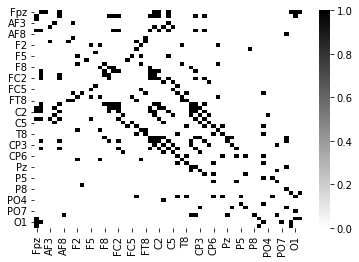

In [371]:
Positive_delta = pd.DataFrame(Positive_delta_0_corrcoef_Matrix_binarize, columns = ch_names, index = ch_names)
sns.heatmap(Positive_delta,cmap=reversed_color_map)

<AxesSubplot:>

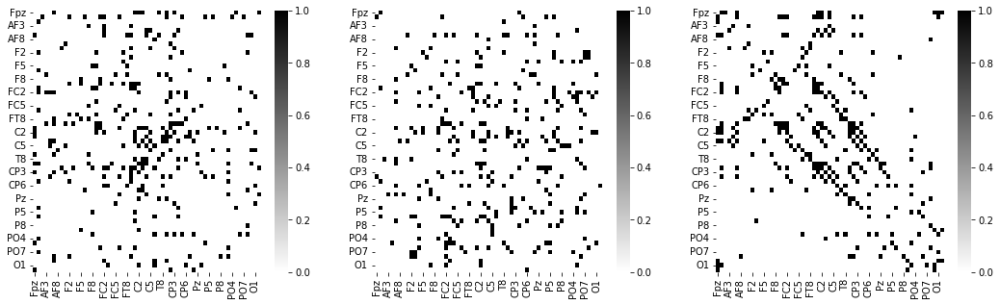

In [374]:
ex1 = bc.reference.randmio_und_connected(ex, 1)
ex1000 = Negative_alpha_299_random
Positive_delta = pd.DataFrame(Positive_delta_0_corrcoef_Matrix_binarize, columns = ch_names, index = ch_names)


fig, ax = plt.subplots(nrows=1,ncols=3, figsize=(18, 5))


e1 = pd.DataFrame(ex1[0], columns = ch_names, index = ch_names)
e1000 = pd.DataFrame(ex1000, columns = ch_names, index = ch_names)

sns.heatmap(e1, cmap=reversed_color_map, ax = ax[0])
sns.heatmap(e1000 ,cmap=reversed_color_map, ax = ax[1])
sns.heatmap(Positive_delta,cmap=reversed_color_map, ax = ax[2])


In [388]:
len(not__connect)

47

In [385]:
# Random network
band = ['delta','theta','alpha','beta','gamma','highgamma']
leng = [708, 696, 639]

# Calculated clustering coefficient
C_C_random = [] #12258개의 CC값

for i in range(leng[0]):
    for q in band:
        if 'Positive_{}_{}'.format(q,i) in not__connect:
            pass
        else:
            C_C_random.append(np.mean(bc.clustering.clustering_coef_bu(globals()['Positive_{}_{}_random'.format(q,i)])))

for i in range(leng[1]):
    for q in band:
        if 'Negative_{}_{}'.format(q,i) in not__connect:
            pass
        else:
            C_C_random.append(np.mean(bc.clustering.clustering_coef_bu(globals()['Negative_{}_{}_random'.format(q,i)])))

for i in range(leng[2]):
    for q in band:
        if 'Neutral_{}_{}'.format(q,i) in not__connect:
            pass
        else:
            C_C_random.append(np.mean(bc.clustering.clustering_coef_bu(globals()['Neutral_{}_{}_random'.format(q,i)])))

In [390]:
len(C_C_random) + 47
(708+696+639)*6

12258

In [391]:
#random network

#Calculated characteristic path length
C_P_random=[] #12278개의 CP값

for i in range(leng[0]):
    for q in band:
        if 'Positive_{}_{}'.format(q,i) in not__connect:
            pass
        else:
            C_P_random.append(bc.distance.charpath(bc.distance.distance_bin(globals()['Positive_{}_{}_random'.format(q,i)]), include_infinite=False)[0])

for i in range(leng[1]):
    for q in band:
        if 'Negative_{}_{}'.format(q,i) in not__connect:
            pass
        else:
            C_P_random.append(bc.distance.charpath(bc.distance.distance_bin(globals()['Negative_{}_{}_random'.format(q,i)]), include_infinite=False)[0])
            
for i in range(leng[2]):
    for q in band:
        if 'Neutral_{}_{}'.format(q,i) in not__connect:
            pass
        else:
            C_P_random.append(bc.distance.charpath(bc.distance.distance_bin(globals()['Neutral_{}_{}_random'.format(q,i)]), include_infinite=False)[0])


In [392]:
Cr = np.mean(C_C_random)
Lr = np.mean(C_P_random)

In [422]:
## Calculating global clustering coefficient (Mean)
vale = ['Positive','Neutral', 'Negative']
band = ['delta','theta','alpha', 'beta','gamma','highgamma']
leng = [708, 639, 696]
for val in vale:
    for bd in band:
        globals()['C_C_{}_{}'.format(val, bd)] = []
        
for i, val in enumerate(vale):
    for bd in band:
        for q in range(leng[i]):
            globals()['C_C_{}_{}'.format(val, bd)].append(np.mean(globals()['clu_{}_{}'.format(val, bd)][q]))

In [433]:
'''
Calculating Small Worldness

'''
vale = ['Positive','Neutral', 'Negative']
band = ['delta','theta','alpha', 'beta','gamma','highgamma']
leng = [708, 639, 696]


for i, val in enumerate(vale):
    for bd in band:
        globals()['S_W_{}_{}'.format(val, bd)] = []


for i, val in enumerate(vale):
    for bd in band:
        for q in range(leng[i]):
            C = globals()['C_C_{}_{}'.format(val, bd)][q]/Cr
            L = globals()['C_P_{}_{}'.format(val, bd)][q]/Lr
            globals()['S_W_{}_{}'.format(val, bd)].append(C/L)


Text(0, 0.5, 'Small Worldness')

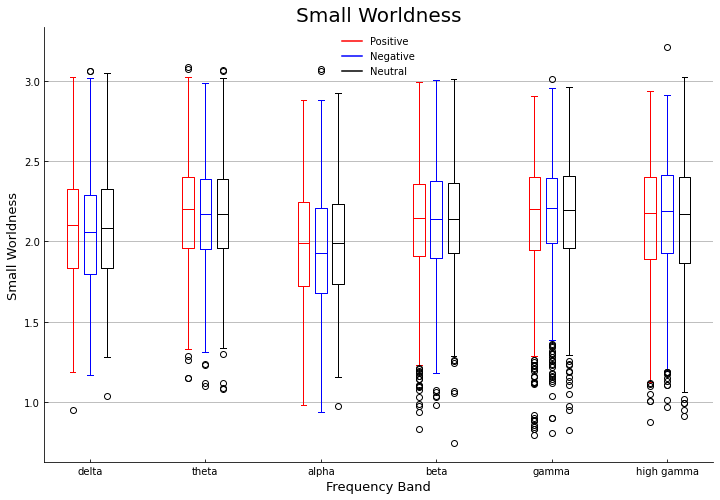

In [441]:
def set_box_color(bp, color):
    plt.setp(bp['boxes'], color=color)
    plt.setp(bp['whiskers'], color=color)
    plt.setp(bp['caps'], color=color)
    plt.setp(bp['medians'], color=color)

raw6_data ={
    'delta':S_W_Positive_delta,
    'theta':S_W_Positive_theta,
    'alpha':S_W_Positive_alpha,
    'beta':S_W_Positive_beta,
    'gamma':S_W_Positive_gamma,
    'highgamma':S_W_Positive_highgamma
}


raw7_data ={
    'delta':S_W_Negative_delta,
    'theta':S_W_Negative_theta,
    'alpha':S_W_Negative_alpha,
    'beta':S_W_Negative_beta,
    'gamma':S_W_Negative_gamma,
    'highgamma':S_W_Negative_highgamma
}


raw8_data ={
    'delta':S_W_Neutral_delta,
    'theta':S_W_Neutral_theta,
    'alpha':S_W_Neutral_alpha,
    'beta':S_W_Neutral_beta,
    'gamma':S_W_Neutral_gamma,
    'highgamma':S_W_Neutral_highgamma
}





positive_S_W_df = pd.DataFrame(raw6_data)
negative_S_W_df = pd.DataFrame(raw7_data)
neutral_S_W_df = pd.DataFrame(raw8_data)


plt.figure(figsize=(12,8))
ticks=['delta','theta', 'alpha','beta','gamma', 'high gamma']


range(0,len(ticks))
bpl = positive_S_W_df.boxplot(column=['delta',
                                    'theta', 'alpha','beta', 'gamma','highgamma'],grid=False,color='red',
                                  positions=np.array(range(6))*2.0-0.3,widths=0.2)

bpr = negative_S_W_df.boxplot(column=['delta',
                                    'theta', 'alpha','beta', 'gamma','highgamma'],grid=False ,color='blue',
                                  positions=np.array(range(6))*2.0+0.0,widths=0.2)
bps = neutral_S_W_df.boxplot(column=['delta',
                                    'theta', 'alpha','beta', 'gamma','highgamma'],grid=False ,color='black',
                                  positions=np.array(range(6))*2.0+0.3,widths=0.2)


plt.xticks(range(0, len(ticks) * 2, 2), ticks)
plt.plot([], c='red', label='Positive')
plt.plot([], c='blue', label='Negative')
plt.plot([], c='black', label='Neutral')

plt.legend(edgecolor='white')
plt.gca().spines[['top', 'right']].set_visible(False)
plt.tick_params(axis='x', direction='in', top=False)
plt.tick_params(axis='y', direction='in', top=False)
plt.grid(True, axis='y')
#plt.ylim(0.46,0.64)
plt.title("Small Worldness",fontsize=20)
plt.xlabel("Frequency Band",fontsize=13)
plt.ylabel("Small Worldness",fontsize=13)

In [444]:


'''

violin plot data 정리

'''


positive_val = []
negative_val = []
neutral_val = []

val = ['positive','negative','neutral']
band = ['delta','theta','alpha','beta','gamma','highgamma']

for v in val:
    for b in band:
        globals()['{}_{}'.format(v,b)] =[]


for i in range(708):
    positive_val.append("Positive")
    for b in band:
        globals()['positive_{}'.format(b)].append(b)
        
for i in range(696):
    negative_val.append("Negative")
    for b in band:
        globals()['negative_{}'.format(b)].append(b)

for i in range(639):
    neutral_val.append("Neutral")
    for b in band:
        globals()['neutral_{}'.format(b)].append(b)


a =[]

for v in val:
    for b in band:
        globals()['{}_{}_S_W_df'.format(v,b)] = pd.DataFrame(globals()['{}_S_W_df'.format(v)][b])
        globals()['{}_{}_S_W_df'.format(v,b)].columns = ['value']
        globals()['{}_{}_S_W_df'.format(v,b)]['band'] = globals()['{}_{}'.format(v, b)]
        globals()['{}_{}_S_W_df'.format(v,b)]['valence'] = globals()['{}_val'.format(v)]
        a.append(globals()['{}_{}_S_W_df'.format(v,b)])


S_W_df = pd.concat(a)

Text(0.5, 1.0, 'Small Worldness')

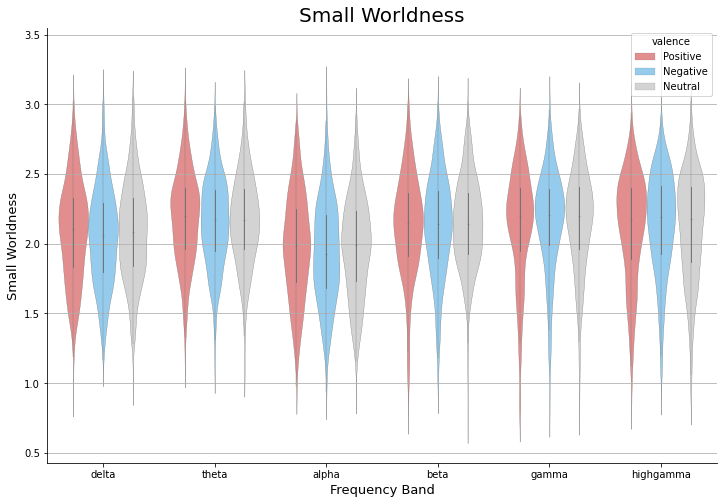

In [445]:
import pingouin as pg

plt.figure(figsize=(12,8))
sns.violinplot(data = S_W_df, x = 'band', y = 'value' ,hue = 'valence', grid=False ,palette=my_pal ,width=0.8,linewidth =0.3)
my_pal = {"Positive": "lightcoral", "Negative": "lightskyblue","Neutral": "lightgray"}
plt.gca().spines[['top', 'right']].set_visible(False)
plt.xlabel("Frequency Band",fontsize=13)
plt.ylabel("Small Worldness",fontsize=13)
plt.grid(True, axis='y')
plt.title("Small Worldness",fontsize=20)


In [446]:
bands = ['delta','theta','alpha', 'beta','gamma','highgamma']

print("Small Worldness")
for band in bands:
    print(band)
    print(pg.welch_anova(data = S_W_df[S_W_df['band']==band], dv = 'value' ,between ='valence'))

Small Worldness
delta
    Source  ddof1        ddof2        F     p-unc       np2
0  valence      2  1354.153323  2.84248  0.058629  0.002747
theta
    Source  ddof1       ddof2         F     p-unc      np2
0  valence      2  1354.30779  1.041433  0.353231  0.00102
alpha
    Source  ddof1        ddof2         F     p-unc       np2
0  valence      2  1356.874263  2.754382  0.064004  0.002693
beta
    Source  ddof1        ddof2         F     p-unc       np2
0  valence      2  1359.838466  0.818697  0.441223  0.000734
gamma
    Source  ddof1        ddof2         F     p-unc       np2
0  valence      2  1356.551221  1.238567  0.290127  0.001289
highgamma
    Source  ddof1        ddof2         F     p-unc       np2
0  valence      2  1352.076195  1.798413  0.165957  0.001708


In [448]:
print(pg.pairwise_gameshowell(data = S_W_df[S_W_df['band']=='delta'], dv = 'value' ,between ='valence'))

          A         B   mean(A)   mean(B)      diff        se         T  \
0  Negative   Neutral  2.048128  2.086622 -0.038494  0.019069 -2.018682   
1  Negative  Positive  2.048128  2.087161 -0.039033  0.018715 -2.085682   
2   Neutral  Positive  2.086622  2.087161 -0.000539  0.019231 -0.028046   

            df      pval    hedges  
0  1320.645073  0.108106 -0.110537  
1  1401.881696  0.093153 -0.111270  
2  1334.762268  0.999566 -0.001529  
